# Cat Breed Classification Using Convolutional Neural Networks

## Import the modules

Import the required modules, and check the installed versions.

In [2]:
import shutil
import os
import re
import copy
import random
import time
import sys
import base64
from glob import glob
from PIL import Image

import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sn

import tqdm
from tqdm.notebook import tqdm as tqdm_notebook

import torch
import torchvision
import torchvision.transforms as transforms
import torchvision.datasets as datasets
import torch.nn as nn

import sklearn
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import KFold
from sklearn.model_selection import ParameterGrid
from sklearn.metrics import confusion_matrix

os.environ['CUDA_LAUNCH_BLOCKING'] = "0" # to get stacttrace details

print('torch=='+torch.__version__)
print('torchvision=='+torchvision.__version__)
print('numpy=='+np.__version__)
print('pandas=='+pd.__version__)
print('matplotlib=='+mpl.__version__)
print('tqdm=='+tqdm.__version__)
print('sklearn=='+sklearn.__version__)
print('seaborn=='+sn.__version__)

torch==2.0.1+cu117
torchvision==0.15.2+cu117
numpy==1.26.1
pandas==2.1.3
matplotlib==3.8.1
tqdm==4.66.1
sklearn==1.3.1
seaborn==0.13.1


## Filter out dog images

Delete any file which doesn't have cat breed in its name.

In [19]:
!find ../data/images/* -type f ! -regex  '\(.*Abyssinian.*\|.*Bengal.*\|.*Birman.*\|.*Bombay.*\|.*British_Shorthair.*\|.*Egyptian_Mau.*\|.*Maine_Coon.*\|.*Persian.*\|.*Ragdoll.*\|.*Russian_Blue.*\|.*Siamese.*\|.*Sphynx.*\)$' -delete

##  Filter out non-jpg images

Delete any file which is not in jpg format.

In [20]:
!find ../data/images/* ! -regex '\(.*jpg\)$' -delete

## Load & split dataset

Load the provided metadata of the dataset, and split the images into 'train' & 'test' folder based on the metadata.

### Load list of training data

In [21]:
# breed id and name mapping
breeds = {
        1 : 'Abyssinian',
        2 : 'Bengal',
        3 : 'Birman',
        4 : 'Bombay',
        5 : 'British_Shorthair',
        6 : 'Egyptian_Mau',
        7 : 'Maine_Coon',
        8 : 'Persian',
        9 : 'Ragdoll',
        10 : 'Russian_Blue',
        11 : 'Siamese',
        12 : 'Sphynx'        
    }


In [22]:
train_df = pd.read_csv('../data/annotations/trainval.txt', header=None, sep=' ')
train_df = train_df.iloc[(train_df.iloc[:,2] == 1).values,[0,3]] # filter only cat with file_name and breed columns
train_df = train_df.rename(columns={0 : 'file_name', 3:'breed'})
train_df['breed_name'] = train_df['breed'].map(breeds)
train_df.drop_duplicates(keep=False,inplace=True) # drop duplicates if any
 
print(len(train_df))
train_df.head(5)

1188


,file_name,breed,breed_name
0,Abyssinian_100,1,Abyssinian
1,Abyssinian_101,1,Abyssinian
2,Abyssinian_102,1,Abyssinian
3,Abyssinian_103,1,Abyssinian
4,Abyssinian_104,1,Abyssinian


### Class distribution of training data

Look into the class distribution to see how balanced or unbalanced the data is.

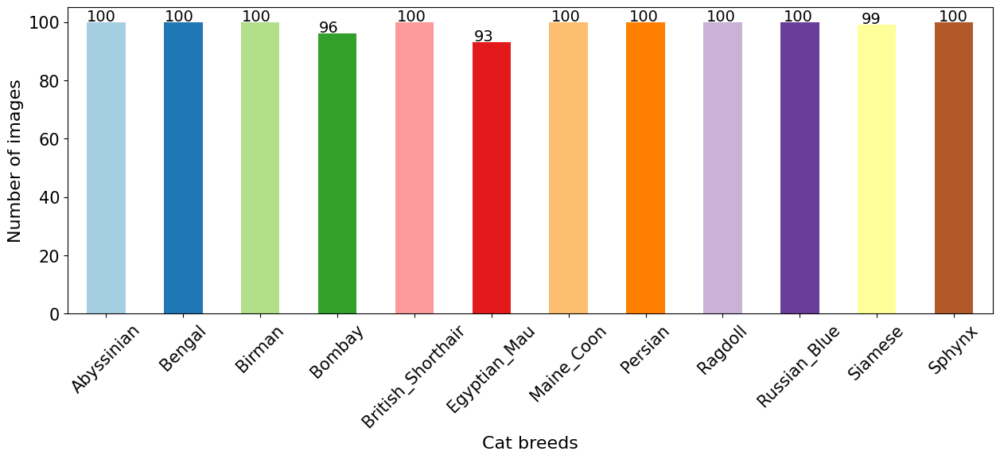

In [23]:
fig, ax = plt.subplots()

train_df['breed'].value_counts().loc[list(range(1,13))].plot(kind="bar", ax=ax, figsize=(15,5), color=plt.cm.Paired(np.arange(len(train_df))))

ax.set_xticklabels(list(breeds.values()), rotation=45)
ax.tick_params(axis='both', which='major', labelsize=15)
ax.set_xlabel('Cat breeds', fontsize=16)
ax.set_ylabel('Number of images', fontsize=16)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.005, p.get_height() * 1.005),size=14)

#### Load list of testing data

In [24]:
test_df = pd.read_csv('../data/annotations/test.txt', header=None, sep=' ')
test_df = test_df.iloc[(test_df.iloc[:,2] == 1).values,[0,3]] # filter only cat with file_name and breed columns
test_df = test_df.rename(columns={0 : 'file_name', 3:'breed'})
test_df['breed_name'] = test_df['breed'].map(breeds)
test_df.drop_duplicates(keep=False,inplace=True) # drop duplicates if any

print(len(test_df))
test_df.head(5)

1183


,file_name,breed,breed_name
0,Abyssinian_201,1,Abyssinian
1,Abyssinian_202,1,Abyssinian
2,Abyssinian_204,1,Abyssinian
3,Abyssinian_205,1,Abyssinian
4,Abyssinian_206,1,Abyssinian


### Class distribution of testing data

Look into the class distribution to see how balanced or unbalanced the data is.

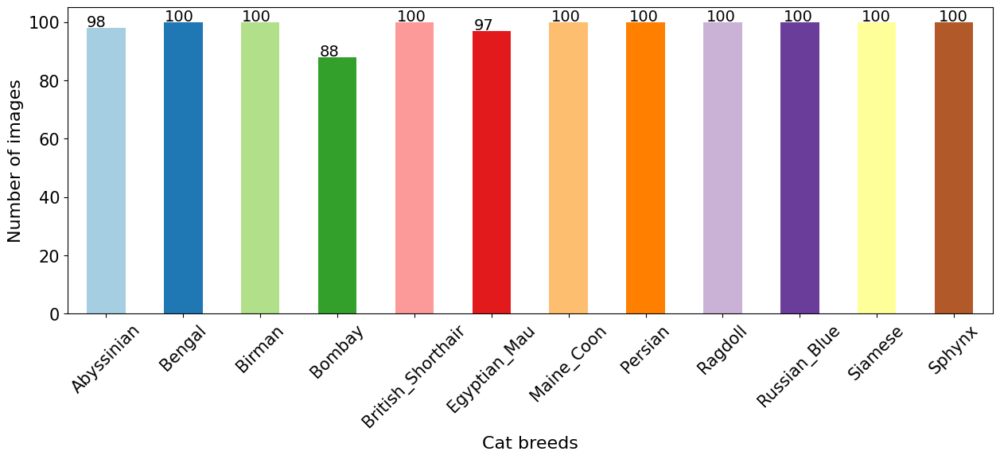

In [25]:
fig, ax = plt.subplots()

test_df['breed'].value_counts().loc[list(range(1,13))].plot(kind="bar", ax=ax, figsize=(15,5), color=plt.cm.Paired(np.arange(len(test_df))))

ax.set_xticklabels(list(breeds.values()), rotation=45)
ax.tick_params(axis='both', which='major', labelsize=15)
ax.set_xlabel('Cat breeds', fontsize=16)
ax.set_ylabel('Number of images', fontsize=16)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.005, p.get_height() * 1.005),size=14)

### Split into training and testing data

The images are splitted into 'train' and 'test' folders based on the provided metadata.

#### Create the folders

In [26]:
!mkdir ../data/train
!mkdir ../data/test

#### Move the images to the respective folders

In [27]:
def move_images(source, destination, df):
    for index, row in df.iterrows():
        source_path = source+row['file_name']+'.jpg'
        destination_path = destination+row['breed_name']
        if not os.path.exists(destination_path):
            os.makedirs(destination_path)
        try:
            shutil.move(source_path,destination_path)
        except Exception as e:
            print('error :',e)


move_images('../data/images/','../data/train/',train_df)
move_images('../data/images/','../data/test/',test_df)

Just to make sure all the images have been moved, check count of images in both of the training and testing folder:

In [28]:
!ls ../data/train/*/* | wc -l
!ls ../data/test/*/* | wc -l


1188
1183


FYI, there are some images remaining which are not used either for training and testing. We will ignore the images as it is expected (the images were also not used on the previous study in a paper entitled "Cats and Dogs").

In [30]:
# unused images
!ls ../data/images/* | wc -l

29


## Set the random seed for reproducibility

In [2]:
def seed_torch(seed=1029):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    #torch.cuda.manual_seed_all(seed) # if you are using multi-GPU.
    torch.backends.cudnn.benchmark = False
    torch.backends.cudnn.deterministic = True

seed_torch(42)

## Set device to GPU if available

Warning: this notebook was executed & tested using GPU. So please make sure the GPU is available to avoid unexpected error.

In [5]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


## Utils functions

The functions which are used across model building and evaluation.

In [2]:
def accuracy(output, target, topk=(1,)):
    """Computes the accuracy over the k top predictions for the specified values of k
    
    source: https://github.com/pytorch/examples/blob/master/imagenet/main.py"""
    with torch.no_grad():
        maxk = max(topk)
        batch_size = target.size(0)

        _, pred = output.topk(maxk, 1, True, True)
        pred = pred.t()
        correct = pred.eq(target.view(1, -1).expand_as(pred))

        res = []
        for k in topk:
            correct_k = correct[:k].reshape(-1).float().sum(0, keepdim=True)
            res.append(correct_k.mul_(100.0 / batch_size))
        return res

def save_model_state(model, path):
    torch.save(model.state_dict(), path)

def load_model_state(model, path):
    model.load_state_dict(torch.load(path))
    model = model.to(device)
    return model

def get_cv_result_per_epoch(history):
    """Computes the accuracy & loss of cross validation per epoch"""
    cv_results = []

    for i,history_per_fold in enumerate(history):
        cv_result_per_epoch = []
        for j in range(len(history_per_fold[0])):
            cv_train_acc = 0.0
            cv_train_loss = 0.0
            cv_valid_acc = 0.0
            cv_valid_loss = 0.0
            cv_train_data_size = 0
            cv_valid_data_size = 0

            for k,history_per_epoch in enumerate(history_per_fold):
                cv_train_acc += history_per_epoch[j]['avg_train_acc']*history_per_epoch[j]['train_data_size']
                cv_train_loss += history_per_epoch[j]['avg_train_loss']*history_per_epoch[j]['train_data_size']
                cv_valid_acc += history_per_epoch[j]['avg_valid_acc']*history_per_epoch[j]['valid_data_size']
                cv_valid_loss += history_per_epoch[j]['avg_valid_loss']*history_per_epoch[j]['valid_data_size']
                cv_train_data_size += history_per_epoch[j]['train_data_size']
                cv_valid_data_size += history_per_epoch[j]['valid_data_size']

            cv_result_per_epoch.append({
                'params' : history_per_epoch[0]['params'],
                'epoch' : j+1,
                'cv_train_acc' : cv_train_acc/float(cv_train_data_size),
                'cv_train_loss' : cv_train_loss/float(cv_train_data_size),
                'cv_valid_acc' : cv_valid_acc/float(cv_valid_data_size),
                'cv_valid_loss' : cv_valid_loss/float(cv_valid_data_size)
            })
        cv_results.append(cv_result_per_epoch)
  
    return cv_results
            
def get_best_cv_result(cv_history):
    """Return the best cross validation result with respect to the validation loss."""

    # generate cross validation results per epoch
    cv_results = get_cv_result_per_epoch(cv_history)
    
    best_cv_result = {}
    for cv_result_per_epoch in cv_results:
        for cv_result in cv_result_per_epoch:
            if not best_cv_result or cv_result['cv_valid_loss'] < best_cv_result['cv_valid_loss']:
                best_cv_result = cv_result

    return best_cv_result


def plot_cv_result(cv_history):
    """Plot the cross validation accuracy and loss for each of the tuned hyperparameters".
    It is necessary to update this function if the number of hyperparameter combinations
    being tuned are not equal to 4"""
    
    # TODO make this function more dynamic wrt the number of hyperparameter combinations
    
    # generate cross validation results per epoch
    cv_results = get_cv_result_per_epoch(cv_history)

    plot_params = []
    plot_valid_loss = []
    plot_valid_acc = []

    for cv_result in cv_results:
        plot_params.append(cv_result[0]['params'])
        plot_valid_loss.append([val['cv_valid_loss'] for val in cv_result ])
        plot_valid_acc.append([val['cv_valid_acc'] for val in cv_result ])

    x = np.arange(1,len(plot_valid_loss[0])+1)    

    print('\n------------ Validation loss per epoch ------------')

    for i in range(len(plot_valid_loss)):
        plt.plot(x,plot_valid_loss[i],label=plot_params[i])
    plt.legend(loc="upper right")  
    plt.xlabel('epochs')
    plt.ylabel('loss')
    plt.show()

    fig, ax = plt.subplots(2, 2,figsize=(15,9))

    ax[0,0].plot(x,plot_valid_loss[0],label=plot_params[0])    
    ax[0,0].plot(x,plot_valid_loss[1],label=plot_params[1])
    ax[0,0].legend(loc="upper right")
    ax[0,0].set_ylabel('loss')
    ax[0,0].set_xlabel('epochs')

    ax[0,1].plot(x,plot_valid_loss[2],label=plot_params[2])    
    ax[0,1].plot(x,plot_valid_loss[3],label=plot_params[3])
    ax[0,1].legend(loc="upper right")
    ax[0,1].set_ylabel('loss')
    ax[0,1].set_xlabel('epochs')

    ax[1,0].plot(x,plot_valid_loss[0],label=plot_params[0])    
    ax[1,0].plot(x,plot_valid_loss[2],label=plot_params[2])
    ax[1,0].legend(loc="upper right")
    ax[1,0].set_ylabel('loss')
    ax[1,0].set_xlabel('epochs')

    ax[1,1].plot(x,plot_valid_loss[1],label=plot_params[1])    
    ax[1,1].plot(x,plot_valid_loss[3],label=plot_params[3])
    ax[1,1].legend(loc="upper right")
    ax[1,1].set_ylabel('loss')
    ax[1,1].set_xlabel('epochs')

    plt.show()

    print('\n------------ Validation accuracy per epoch at ------------')

    for i in range(len(plot_valid_acc)):
        plt.plot(x,plot_valid_acc[i],label=plot_params[i])
    plt.legend(loc="lower right")
    plt.xlabel('epochs')
    plt.ylabel('accuracy')
    plt.show()

    fig, ax = plt.subplots(2, 2,figsize=(15,9))

    ax[0,0].plot(x,plot_valid_acc[0],label=plot_params[0])    
    ax[0,0].plot(x,plot_valid_acc[1],label=plot_params[1])
    ax[0,0].legend(loc="lower right")
    ax[0,0].set_ylabel('accuracy')
    ax[0,0].set_xlabel('epochs')

    ax[0,1].plot(x,plot_valid_acc[2],label=plot_params[2])    
    ax[0,1].plot(x,plot_valid_acc[3],label=plot_params[3])
    ax[0,1].legend(loc="lower right")
    ax[0,1].set_ylabel('accuracy')
    ax[0,1].set_xlabel('epochs')

    ax[1,0].plot(x,plot_valid_acc[0],label=plot_params[0])    
    ax[1,0].plot(x,plot_valid_acc[2],label=plot_params[2])
    ax[1,0].legend(loc="lower right")
    ax[1,0].set_ylabel('accuracy')
    ax[1,0].set_xlabel('epochs')

    ax[1,1].plot(x,plot_valid_acc[1],label=plot_params[1])    
    ax[1,1].plot(x,plot_valid_acc[3],label=plot_params[3])
    ax[1,1].legend(loc="lower right")
    ax[1,1].set_ylabel('accuracy')
    ax[1,1].set_xlabel('epochs')

    plt.show()
    
def plot_train_result(train_history):
    """Plot the training loss and the training accuracy of the retrained model"""
    plot_params = []
    plot_train_loss = []
    plot_train_acc = []

    x = np.arange(1, len(train_history)+1)

    for hist in train_history:
        plot_train_loss.append(hist['avg_train_loss'])
        plot_train_acc.append(hist['avg_train_acc']*100)

    plt.plot(x,plot_train_loss)
    plt.xlabel('epochs')
    plt.ylabel('loss')
    plt.title('Training loss')
    plt.show()

    plt.plot(x,plot_train_acc)
    plt.xlabel('epochs')
    plt.ylabel('accuracy')
    plt.title('Training accuracy')
    plt.show()

## Load and transform images

Load the images, and transform the images in order to use pretrained model for transfer learning.

In [10]:
# the expected normalization by the pretrained model
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])

# transforms for the images (without augmentation)
# here, both train and test have the same transformation
image_transforms = { 
    'train': transforms.Compose([
        transforms.Resize(size=256),
        transforms.CenterCrop(size=224),
        transforms.ToTensor(),
        normalize
    ]),
    'test': transforms.Compose([
        transforms.Resize(size=256),
        transforms.CenterCrop(size=224),
        transforms.ToTensor(),
        normalize
    ])
}

# transforms with augmentation on the training data
augmented_image_transforms = { 
    'train': transforms.Compose([
        transforms.Resize(size=256),
        transforms.CenterCrop(size=224),
        transforms.RandomHorizontalFlip(),
        transforms.ColorJitter(brightness=0.2, contrast=0.2),
        transforms.ToTensor(),
        normalize
    ]),
    'test': transforms.Compose([
        transforms.Resize(size=256),
        transforms.CenterCrop(size=224),
        transforms.ToTensor(),
        normalize
    ])
}
 
# train and test directory paths
train_directory = '../data/train'
test_directory = '../data/test'
 
# load data from folders
data = {
    'train': datasets.ImageFolder(root=train_directory), # transforms applied in the cross validation later
    'test': datasets.ImageFolder(root=test_directory, transform=image_transforms['test'])
}

# mapping class index to class name
idx_to_class = {val: key for key, val in data['test'].class_to_idx.items()}

# needed for StratifiedKFold
train_images = [d[0] for d in tqdm_notebook(data['train'], desc='train_images')]
train_labels = [d[1] for d in tqdm_notebook(data['train'], desc='train_labels')]

train_images:   0%|          | 0/1188 [00:00<?, ?it/s]

train_labels:   0%|          | 0/1188 [00:00<?, ?it/s]

### Visualize sample of transformed image 

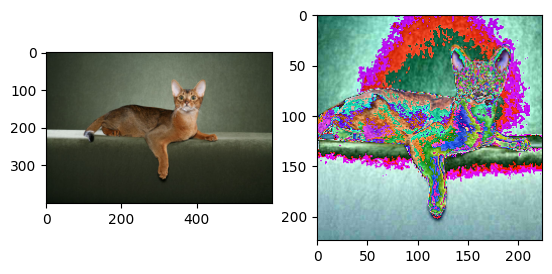

In [35]:
# resized, cropped, normalized image

to_pil = torchvision.transforms.ToPILImage()

ori_img = data['train'][0][0]
trans_img = to_pil(image_transforms['train'](ori_img))

f, axarr = plt.subplots(1,2)
axarr[0].imshow(ori_img)
axarr[1].imshow(trans_img)

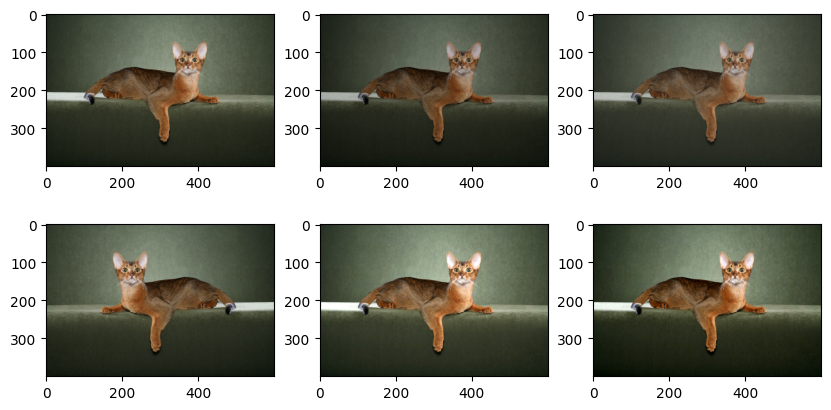

In [36]:
# flipped, modified brightness, modified contrast 

horizontal_flip = transforms.RandomHorizontalFlip(p=1)
darken = transforms.ColorJitter(brightness=(0.8,0.8))
brighten = transforms.ColorJitter(brightness=(1.2,1.2))
dec_contrast = transforms.ColorJitter(contrast=(0.8,0.8)) # decrease contrast
inc_contrast = transforms.ColorJitter(contrast=(1.2,1.2)) # increase contrast

ori_img = data['train'][0][0]
flip_img = horizontal_flip(ori_img)
dark_img = darken(ori_img)
bright_img = brighten(ori_img)
dec_con_img = dec_contrast(ori_img)
inc_con_img = inc_contrast(ori_img)

f, axarr = plt.subplots(2,3, figsize=(10,5))
axarr[0,0].imshow(ori_img)
axarr[0,1].imshow(dark_img)
axarr[0,2].imshow(dec_con_img)
axarr[1,0].imshow(flip_img)
axarr[1,1].imshow(bright_img)
axarr[1,2].imshow(inc_con_img)

## Grid Search & Cross Validation function

In [6]:
def grid_search_cv(model, k_fold=5, epochs=10, hyperparameters={'batch_size':[32,64],'learning_rate' : [1e-03, 1e-04]},transforms=image_transforms):
    """Performs hyperparameter tuning with grid search, and evaluates the models using cross validation"""
    
    # split the data into k folds, for cross validation
    kFold = StratifiedKFold(n_splits = k_fold, shuffle = True, random_state = 42)
    
    # for grid search
    param_grid = ParameterGrid(hyperparameters)

    # loss function
    loss_criterion = nn.NLLLoss()

    # to store the results for plotting
    history_per_param = []
    
    for i_params, params in enumerate(param_grid):
        hyperparameter_start = time.time()
        
        bs = params['batch_size']
        lr = params['learning_rate']
        print('Hyperparameters {}/{} > bs: {} - lr: {}'.format(i_params+1, len(list(param_grid)), bs, lr))
        
        cv_train_loss = 0.0
        cv_valid_loss = 0.0
        cv_train_acc = 0.0
        cv_valid_acc = 0.0

        history_per_fold = []
        
        for i_fold, (train_idx, valid_idx) in enumerate(kFold.split(train_images, train_labels)):
            fold_start = time.time()

            # reset the state of the model
            model.load_state_dict(init_state)
        
            # recreate the Adam optimizer 
            optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad,model.parameters()), lr=lr)

            train_data_size = len(train_idx)
            valid_data_size = len(valid_idx)

            print('Fold {}/{} > training data size: {} - validation data size: {}'.format(i_fold+1,k_fold,train_data_size,valid_data_size))

            # apply the transforms, and create list of tuple image and label
            train_ds = [(transforms['train'](train_images[i]), train_labels[i]) for i in train_idx]
            valid_ds = [(transforms['test'](train_images[i]), train_labels[i]) for i in valid_idx]

            # data loader for mini-batch iteration
            train_data_loader = torch.utils.data.DataLoader(train_ds, batch_size=bs, shuffle=True)
            valid_data_loader = torch.utils.data.DataLoader(valid_ds, batch_size=bs, shuffle=True)

            history_per_epoch = []
            
            for epoch in range(epochs):
                epoch_start = time.time()
                print("\nEpoch {}/{}".format(epoch+1, epochs))
                
                # set to training mode
                model.train()

                # loss and accuracy within the epoch
                train_loss = 0.0
                train_acc = 0.0
                valid_loss = 0.0
                valid_acc = 0.0

                for i, (inputs, labels) in enumerate(train_data_loader):

                    # put inputs and labels to GPU if available
                    inputs = inputs.to(device)
                    labels = labels.to(device)

                    # clean existing gradients
                    optimizer.zero_grad()

                    # forward pass
                    outputs = model(inputs)

                    # compute loss
                    loss = loss_criterion(outputs, labels)

                    # backpropagate the gradients
                    loss.backward()

                    # update the parameters
                    optimizer.step()

                    # compute the total loss in the batch, and add to train_loss
                    train_loss += loss.item() * inputs.size(0)

                    # compute the accuracy
                    ret, predictions = torch.max(outputs.data, 1)
                    correct_counts = predictions.eq(labels.data.view_as(predictions))
                    acc = torch.mean(correct_counts.type(torch.FloatTensor))

                    # compute total accuracy in the batch and add to train_acc
                    train_acc += acc.item() * inputs.size(0)

                    print("Training Batch {:03d} > loss: {} - acc: {}".format(i, loss.item(), acc.item()))

                # validation
                with torch.no_grad():

                    # set to evaluation mode
                    model.eval()

                    for j, (inputs, labels) in enumerate(valid_data_loader):
                        
                        # put inputs and labels to GPU if available
                        inputs = inputs.to(device)
                        labels = labels.to(device)

                        # forward pass
                        outputs = model(inputs)

                        # compute loss
                        loss = loss_criterion(outputs, labels)

                        # compute the total loss in the batch, and add to valid_loss
                        valid_loss += loss.item() * inputs.size(0)

                        # calculate validation accuracy
                        ret, predictions = torch.max(outputs.data, 1)
                        correct_counts = predictions.eq(labels.data.view_as(predictions))
                        acc = torch.mean(correct_counts.type(torch.FloatTensor))

                        # compute total accuracy in the batch and add valid_acc
                        valid_acc += acc.item() * inputs.size(0)

                        print("Validation Batch {:03d} > valid_loss: {}, valid_acc: {}".format(j, loss.item(), acc.item()))

                # compute average training loss and training accuracy
                avg_train_loss = train_loss/float(train_data_size) 
                avg_train_acc = train_acc/float(train_data_size)

                # compute average training loss and training accuracy
                avg_valid_loss = valid_loss/float(valid_data_size) 
                avg_valid_acc = valid_acc/float(valid_data_size)

                history_per_epoch.append({
                                'params' : params,
                                'avg_train_loss': avg_train_loss,
                                'avg_valid_loss': avg_valid_loss,
                                'avg_train_acc': avg_train_acc,
                                'avg_valid_acc':avg_valid_acc,
                                'train_data_size':train_data_size,
                                'valid_data_size':valid_data_size
                                })

                epoch_end = time.time()

                print("End Epoch {}/{} > loss: {} - acc: {}% - valid_loss: {} - valid_acc: {}% - Time: {:.4f}s".format(epoch+1, epochs, avg_train_loss, avg_train_acc*100, avg_valid_loss, avg_valid_acc*100, epoch_end-epoch_start))
            
            history_per_fold.append(history_per_epoch)

            cv_train_loss += avg_train_loss
            cv_valid_loss += avg_valid_loss
            cv_train_acc += avg_train_acc
            cv_valid_acc += avg_valid_acc

            fold_end = time.time()
            print("End Fold {}/{} > time: {:.4f}s\n".format(i_fold+1, k_fold, fold_end - fold_start))
        
        history_per_param.append(history_per_fold)

        hyperparameter_end = time.time()

        print('End Hyperparameters {}/{} > bs: {} - lr: {} - time: {:.4f}s'.format(i_params+1, len(list(param_grid)), bs, lr, hyperparameter_end - hyperparameter_start))
        print('                       > loss: {} - acc: {}% - valid_loss: {} - valid_acc: {}% - Time: {:.4f}s\n'.format(cv_train_loss/k_fold, (cv_train_acc/k_fold)*100, cv_valid_loss/k_fold, (cv_valid_acc/k_fold)*100, hyperparameter_end-hyperparameter_start))
    return history_per_param

## Train function

In [7]:
def train(model, epochs, bs=32, lr=0.001,init_state=None, transforms=image_transforms):
    ''' train the model on the full training data with the best param'''

    # set the state of the model if defined
    if init_state is not None:
        model.load_state_dict(init_state)

    # adam optimizer
    optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad,model.parameters()), lr=lr)

    # loss function
    loss_criterion = nn.NLLLoss()
    
    # transform the train images
    train_ds_transformed = datasets.ImageFolder(root=train_directory, transform=transforms['train'])
    train_data_size = len(train_ds_transformed)

    print('Training > training data size: {}'.format(train_data_size))

    # data loader for mini batch iteration
    train_data_loader = torch.utils.data.DataLoader(train_ds_transformed, batch_size=bs, shuffle=True)

    train_start = time.time()

    history_per_epoch = []
    
    for epoch in range(epochs):
        epoch_start = time.time()

        print("\nEpoch {}/{}".format(epoch+1, epochs))
        
        # set to training mode
        model.train()

        # loss and accuracy within the epoch
        train_loss = 0.0
        train_acc = 0.0

        for i, (inputs, labels) in enumerate(tqdm_notebook(train_data_loader,desc='Training')):

            # put the inputs and labels to GPU if available
            inputs = inputs.to(device)
            labels = labels.to(device)

            # clean existing gradients
            optimizer.zero_grad()

            # forward pass
            outputs = model(inputs)

            # compute loss
            loss = loss_criterion(outputs, labels)

            # backpropagate the gradients
            loss.backward()

            # update the parameters
            optimizer.step()

            # compute the total loss in the batch, and add to train_loss
            train_loss += loss.item() * inputs.size(0)

            # compute the accuracy
            ret, predictions = torch.max(outputs.data, 1)
            correct_counts = predictions.eq(labels.data.view_as(predictions))
            acc = torch.mean(correct_counts.type(torch.FloatTensor))

            # compute total accuracy in the batch, and add to train_acc
            train_acc += acc.item() * inputs.size(0)
        
        # compute average training loss and training accuracy
        avg_train_loss = train_loss/train_data_size 
        avg_train_acc = train_acc/float(train_data_size)

        history_per_epoch.append({
                        'avg_train_loss': avg_train_loss,
                        'avg_train_acc': avg_train_acc
                        })

        epoch_end = time.time()

        print("End Epoch {}/{} > loss: {:.4f} - acc: {:.4f}% - Time: {:.4f}s".format(epoch+1, epochs, avg_train_loss, avg_train_acc*100, epoch_end-epoch_start))

    train_end = time.time()
    print("End Train > time: {:.4f}s\n".format(train_end - train_start))
    return (model,history_per_epoch)

## Test function

In [8]:
def test(model, calc_top3_acc=False):
    """evaluate the model and return some metrics. set calc_top3_acc to True to compute the top 3 acc"""
    test_data_size = len(data['test'])
    print('Test data size :', test_data_size,'\n')

    # data loader for mini-batch iteration
    test_data_loader = torch.utils.data.DataLoader(data['test'], batch_size=32, shuffle=True)

    # loss function
    loss_criterion = nn.NLLLoss()
    
    test_start = time.time()
    with torch.no_grad():

        # set to evaluation mode
        model.eval()

        test_loss = 0.0
        test_acc = 0.0
        test_top3_acc = 0.0
        
        # for generating confusion matrix
        all_labels = []
        all_predictions = []

        for j, (inputs, labels) in enumerate(tqdm_notebook(test_data_loader,  desc='Testing', file=sys.stdout)):
            # put the inputs and labels to GPU if available
            inputs = inputs.to(device)
            labels = labels.to(device)

            # forward pass
            outputs = model(inputs)

            # compute loss
            loss = loss_criterion(outputs, labels)

            # compute the total loss in the batch, and add to test_loss
            test_loss += loss.item() * inputs.size(0)

            # calculate test accuracy
            ret, predictions = torch.max(outputs.data, 1)
            correct_counts = predictions.eq(labels.data.view_as(predictions))        
            acc = torch.mean(correct_counts.type(torch.FloatTensor))
            
            # compute total accuracy in the batch, and add to test_acc
            test_acc += acc.item() * inputs.size(0)

            # store the labels and predictions
            all_labels.extend(labels.tolist())
            all_predictions.extend(predictions.tolist())

            if calc_top3_acc:
                top3_acc= accuracy(outputs, labels, topk=(3,))
                test_top3_acc += top3_acc[0][0].item() * inputs.size(0)


    # compute average loss and accuracy
    avg_test_loss = test_loss/test_data_size 
    avg_test_acc = test_acc/float(test_data_size)

    # compute average top 3 accuracy
    avg_test_top3_acc = 0.0
    if calc_top3_acc:
        avg_test_top3_acc= test_top3_acc/float(test_data_size)

    # generate confusion matrix
    cm = confusion_matrix(all_labels, all_predictions, labels=list(data['test'].class_to_idx.values()))

    test_end = time.time()
    print('\nResult > loss: {:.4f} - acc: {:.4f}% - time: {:.4f}s\n'.format(avg_test_loss, avg_test_acc*100, test_end - test_start))

    if calc_top3_acc:
        print('\nResult > top3_acc: {:.4f}% \n'.format(avg_test_top3_acc))
    
    return (avg_test_loss, avg_test_acc, cm, avg_test_top3_acc)

## Simple CNN (without transfer Learning)

### Build the network

In [9]:
class Flatten(torch.nn.Module):
    '''to flatten convolutional layer outputs'''
    def forward(self, x):
        batch_size = x.shape[0]
        return x.view(batch_size, -1)
    
# build the simple CNN   
simpleCNN = nn.Sequential(
    nn.Conv2d(in_channels=3, out_channels=64, kernel_size=5, stride=1, padding=2),
    nn.ReLU(),
    nn.MaxPool2d(kernel_size=2),
    Flatten(),
    nn.Dropout(p=0.5),
    nn.Linear(64*112*112, 12),
    nn.LogSoftmax(dim=1) # For using NLLLoss()
)

# move the model to a device
simpleCNN = simpleCNN.to(device)

# copy initial state, used for retraining later
init_state = copy.deepcopy(simpleCNN.state_dict())

### Perfom grid search & cross validation 

In [41]:
cv_history = grid_search_cv(simpleCNN, k_fold=5, epochs=50, hyperparameters={'batch_size':[32,64],'learning_rate' : [1e-03, 1e-04]})

Hyperparameters 1/4 > bs: 32 - lr: 0.001
Fold 1/5 > training data size: 950 - validation data size: 238

Epoch 1/50
Training Batch 000 > loss: 2.567166328430176 - acc: 0.03125
Training Batch 001 > loss: 138.22103881835938 - acc: 0.09375
Training Batch 002 > loss: 154.16917419433594 - acc: 0.21875
Training Batch 003 > loss: 173.2021026611328 - acc: 0.15625
Training Batch 004 > loss: 161.1365966796875 - acc: 0.125
Training Batch 005 > loss: 147.01417541503906 - acc: 0.0625
Training Batch 006 > loss: 142.24734497070312 - acc: 0.09375
Training Batch 007 > loss: 140.355224609375 - acc: 0.15625
Training Batch 008 > loss: 86.27371978759766 - acc: 0.125
Training Batch 009 > loss: 119.36823272705078 - acc: 0.03125
Training Batch 010 > loss: 143.02708435058594 - acc: 0.0
Training Batch 011 > loss: 124.34947204589844 - acc: 0.03125
Training Batch 012 > loss: 73.38847351074219 - acc: 0.15625
Training Batch 013 > loss: 85.55801391601562 - acc: 0.15625
Training Batch 014 > loss: 101.50773620605469 -

Training Batch 016 > loss: 0.00025969743728637695 - acc: 1.0
Training Batch 017 > loss: 0.0038776397705078125 - acc: 1.0
Training Batch 018 > loss: 0.013038992881774902 - acc: 1.0
Training Batch 019 > loss: 0.0013163089752197266 - acc: 1.0
Training Batch 020 > loss: 0.021242499351501465 - acc: 1.0
Training Batch 021 > loss: 0.13538825511932373 - acc: 0.96875
Training Batch 022 > loss: 0.16254901885986328 - acc: 0.9375
Training Batch 023 > loss: 0.03992772102355957 - acc: 0.96875
Training Batch 024 > loss: 0.002075374126434326 - acc: 1.0
Training Batch 025 > loss: 0.08201813697814941 - acc: 0.96875
Training Batch 026 > loss: 0.05799591541290283 - acc: 0.96875
Training Batch 027 > loss: 0.18458247184753418 - acc: 0.96875
Training Batch 028 > loss: 0.005402565002441406 - acc: 1.0
Training Batch 029 > loss: 1.6348702729374054e-06 - acc: 1.0
Validation Batch 000 > valid_loss: 8.521538734436035, valid_acc: 0.21875
Validation Batch 001 > valid_loss: 10.434109687805176, valid_acc: 0.15625
Vali

Training Batch 026 > loss: 0.40088963508605957 - acc: 0.9375
Training Batch 027 > loss: 0.16782736778259277 - acc: 0.9375
Training Batch 028 > loss: 0.1603306531906128 - acc: 0.9375
Training Batch 029 > loss: 0.0794328972697258 - acc: 0.9523809552192688
Validation Batch 000 > valid_loss: 6.496349334716797, valid_acc: 0.34375
Validation Batch 001 > valid_loss: 8.56808853149414, valid_acc: 0.1875
Validation Batch 002 > valid_loss: 6.91614294052124, valid_acc: 0.28125
Validation Batch 003 > valid_loss: 6.347784519195557, valid_acc: 0.375
Validation Batch 004 > valid_loss: 7.956512451171875, valid_acc: 0.25
Validation Batch 005 > valid_loss: 8.540193557739258, valid_acc: 0.21875
Validation Batch 006 > valid_loss: 9.255617141723633, valid_acc: 0.25
Validation Batch 007 > valid_loss: 8.553343772888184, valid_acc: 0.0
End Epoch 10/50 > loss: 0.05779858260907162 - acc: 98.63013699258215% - valid_loss: 7.777749739930221 - valid_acc: 25.523012552301257% - Time: 3.6869s

Epoch 11/50
Training Batc

Training Batch 000 > loss: 0.06700873374938965 - acc: 0.96875
Training Batch 001 > loss: 0.31565558910369873 - acc: 0.875
Training Batch 002 > loss: 0.5868661403656006 - acc: 0.90625
Training Batch 003 > loss: 0.5139939785003662 - acc: 0.9375
Training Batch 004 > loss: 0.0031430721282958984 - acc: 1.0
Training Batch 005 > loss: 0.18540620803833008 - acc: 0.9375
Training Batch 006 > loss: 0.43825453519821167 - acc: 0.9375
Training Batch 007 > loss: 0.0008028745651245117 - acc: 1.0
Training Batch 008 > loss: 0.028820276260375977 - acc: 0.96875
Training Batch 009 > loss: 0.3308591842651367 - acc: 0.9375
Training Batch 010 > loss: 0.03278559446334839 - acc: 0.96875
Training Batch 011 > loss: 0.9545280933380127 - acc: 0.84375
Training Batch 012 > loss: 0.1751258373260498 - acc: 0.9375
Training Batch 013 > loss: 0.007027029991149902 - acc: 1.0
Training Batch 014 > loss: 0.18201839923858643 - acc: 0.9375
Training Batch 015 > loss: 0.4045019745826721 - acc: 0.96875
Training Batch 016 > loss: 0

Training Batch 008 > loss: 1.7990189790725708 - acc: 0.875
Training Batch 009 > loss: 0.6159971952438354 - acc: 0.875
Training Batch 010 > loss: 0.03479814529418945 - acc: 0.96875
Training Batch 011 > loss: 0.002864837646484375 - acc: 1.0
Training Batch 012 > loss: 0.4560568332672119 - acc: 0.90625
Training Batch 013 > loss: 0.2611933946609497 - acc: 0.9375
Training Batch 014 > loss: 0.02265608310699463 - acc: 1.0
Training Batch 015 > loss: 0.004697203636169434 - acc: 1.0
Training Batch 016 > loss: 1.300132155418396 - acc: 0.875
Training Batch 017 > loss: 0.26942741870880127 - acc: 0.90625
Training Batch 018 > loss: 0.2982553243637085 - acc: 0.96875
Training Batch 019 > loss: 0.2836241126060486 - acc: 0.9375
Training Batch 020 > loss: 0.4015953540802002 - acc: 0.90625
Training Batch 021 > loss: 0.4523613452911377 - acc: 0.9375
Training Batch 022 > loss: 0.22832238674163818 - acc: 0.9375
Training Batch 023 > loss: 0.2746925354003906 - acc: 0.9375
Training Batch 024 > loss: 0.06881189346

Training Batch 016 > loss: 3.4570693969726562e-06 - acc: 1.0
Training Batch 017 > loss: 0.7440963983535767 - acc: 0.9375
Training Batch 018 > loss: 0.0014859437942504883 - acc: 1.0
Training Batch 019 > loss: 0.07886850833892822 - acc: 0.96875
Training Batch 020 > loss: 1.0748341083526611 - acc: 0.875
Training Batch 021 > loss: 0.773679256439209 - acc: 0.9375
Training Batch 022 > loss: 0.9613598585128784 - acc: 0.96875
Training Batch 023 > loss: 0.8813693523406982 - acc: 0.875
Training Batch 024 > loss: 0.6091930270195007 - acc: 0.9375
Training Batch 025 > loss: 0.4483708143234253 - acc: 0.96875
Training Batch 026 > loss: 0.6455693244934082 - acc: 0.96875
Training Batch 027 > loss: 0.1862102746963501 - acc: 0.96875
Training Batch 028 > loss: 0.6936618089675903 - acc: 0.96875
Training Batch 029 > loss: 2.077812671661377 - acc: 0.8571428656578064
Validation Batch 000 > valid_loss: 23.8924617767334, valid_acc: 0.0625
Validation Batch 001 > valid_loss: 19.657039642333984, valid_acc: 0.3125


Training Batch 024 > loss: 0.11687660217285156 - acc: 0.96875
Training Batch 025 > loss: 0.009786844253540039 - acc: 1.0
Training Batch 026 > loss: 7.236003875732422e-05 - acc: 1.0
Training Batch 027 > loss: 0.37286800146102905 - acc: 0.9375
Training Batch 028 > loss: 0.1230231523513794 - acc: 0.96875
Training Batch 029 > loss: 0.04642341285943985 - acc: 0.9523809552192688
Validation Batch 000 > valid_loss: 13.01241683959961, valid_acc: 0.25
Validation Batch 001 > valid_loss: 15.562115669250488, valid_acc: 0.3125
Validation Batch 002 > valid_loss: 15.242753028869629, valid_acc: 0.21875
Validation Batch 003 > valid_loss: 16.108861923217773, valid_acc: 0.3125
Validation Batch 004 > valid_loss: 17.8294734954834, valid_acc: 0.1875
Validation Batch 005 > valid_loss: 17.476200103759766, valid_acc: 0.1875
Validation Batch 006 > valid_loss: 14.213372230529785, valid_acc: 0.28125
Validation Batch 007 > valid_loss: 15.180150985717773, valid_acc: 0.2666666805744171
End Epoch 23/50 > loss: 0.15719

Training Batch 000 > loss: 1.1324882507324219e-05 - acc: 1.0
Training Batch 001 > loss: 5.960464477539062e-07 - acc: 1.0
Training Batch 002 > loss: 0.00014930963516235352 - acc: 1.0
Training Batch 003 > loss: 0.0004994869232177734 - acc: 1.0
Training Batch 004 > loss: 4.76837158203125e-07 - acc: 1.0
Training Batch 005 > loss: 0.0 - acc: 1.0
Training Batch 006 > loss: 3.62396240234375e-05 - acc: 1.0
Training Batch 007 > loss: 0.009043335914611816 - acc: 1.0
Training Batch 008 > loss: 4.76837158203125e-07 - acc: 1.0
Training Batch 009 > loss: 0.006022453308105469 - acc: 1.0
Training Batch 010 > loss: 9.5367431640625e-06 - acc: 1.0
Training Batch 011 > loss: 2.3126602172851562e-05 - acc: 1.0
Training Batch 012 > loss: 1.1920928955078125e-07 - acc: 1.0
Training Batch 013 > loss: 0.0 - acc: 1.0
Training Batch 014 > loss: 5.245208740234375e-06 - acc: 1.0
Training Batch 015 > loss: 2.2649765014648438e-06 - acc: 1.0
Training Batch 016 > loss: 0.0 - acc: 1.0
Training Batch 017 > loss: 4.7683715

Training Batch 018 > loss: 3.5881996154785156e-05 - acc: 1.0
Training Batch 019 > loss: 2.1457672119140625e-06 - acc: 1.0
Training Batch 020 > loss: 5.960464477539062e-07 - acc: 1.0
Training Batch 021 > loss: 1.1920928955078125e-07 - acc: 1.0
Training Batch 022 > loss: 1.0609626770019531e-05 - acc: 1.0
Training Batch 023 > loss: 1.4781951904296875e-05 - acc: 1.0
Training Batch 024 > loss: 6.258487701416016e-06 - acc: 1.0
Training Batch 025 > loss: 0.00017881393432617188 - acc: 1.0
Training Batch 026 > loss: 0.0 - acc: 1.0
Training Batch 027 > loss: 3.790855407714844e-05 - acc: 1.0
Training Batch 028 > loss: 0.0 - acc: 1.0
Training Batch 029 > loss: 0.0 - acc: 1.0
Validation Batch 000 > valid_loss: 18.449831008911133, valid_acc: 0.21875
Validation Batch 001 > valid_loss: 14.893180847167969, valid_acc: 0.21875
Validation Batch 002 > valid_loss: 10.841193199157715, valid_acc: 0.40625
Validation Batch 003 > valid_loss: 11.909539222717285, valid_acc: 0.3125
Validation Batch 004 > valid_loss

Training Batch 000 > loss: 0.0 - acc: 1.0
Training Batch 001 > loss: 0.0 - acc: 1.0
Training Batch 002 > loss: 2.0265579223632812e-06 - acc: 1.0
Training Batch 003 > loss: 0.0 - acc: 1.0
Training Batch 004 > loss: 3.5762786865234375e-07 - acc: 1.0
Training Batch 005 > loss: 5.960464477539062e-07 - acc: 1.0
Training Batch 006 > loss: 1.3113021850585938e-05 - acc: 1.0
Training Batch 007 > loss: 0.0 - acc: 1.0
Training Batch 008 > loss: 7.152557373046875e-07 - acc: 1.0
Training Batch 009 > loss: 0.0 - acc: 1.0
Training Batch 010 > loss: 1.1920928955078125e-07 - acc: 1.0
Training Batch 011 > loss: 9.5367431640625e-07 - acc: 1.0
Training Batch 012 > loss: 3.5762786865234375e-06 - acc: 1.0
Training Batch 013 > loss: 1.049041748046875e-05 - acc: 1.0
Training Batch 014 > loss: 7.152557373046875e-07 - acc: 1.0
Training Batch 015 > loss: 2.2649765014648438e-06 - acc: 1.0
Training Batch 016 > loss: 1.1920928955078125e-07 - acc: 1.0
Training Batch 017 > loss: 0.0 - acc: 1.0
Training Batch 018 > lo

Training Batch 020 > loss: 0.0 - acc: 1.0
Training Batch 021 > loss: 1.1920928955078125e-07 - acc: 1.0
Training Batch 022 > loss: 9.5367431640625e-07 - acc: 1.0
Training Batch 023 > loss: 2.384185791015625e-07 - acc: 1.0
Training Batch 024 > loss: 0.0 - acc: 1.0
Training Batch 025 > loss: 0.00014966726303100586 - acc: 1.0
Training Batch 026 > loss: 4.76837158203125e-07 - acc: 1.0
Training Batch 027 > loss: 2.1457672119140625e-06 - acc: 1.0
Training Batch 028 > loss: 0.0 - acc: 1.0
Training Batch 029 > loss: 6.5394810917496216e-06 - acc: 1.0
Validation Batch 000 > valid_loss: 14.518065452575684, valid_acc: 0.25
Validation Batch 001 > valid_loss: 14.264914512634277, valid_acc: 0.25
Validation Batch 002 > valid_loss: 13.457537651062012, valid_acc: 0.3125
Validation Batch 003 > valid_loss: 17.740455627441406, valid_acc: 0.15625
Validation Batch 004 > valid_loss: 8.994376182556152, valid_acc: 0.3125
Validation Batch 005 > valid_loss: 17.29205894470215, valid_acc: 0.25
Validation Batch 006 >

Training Batch 000 > loss: 1.1920928955078125e-06 - acc: 1.0
Training Batch 001 > loss: 0.0 - acc: 1.0
Training Batch 002 > loss: 2.9146671295166016e-05 - acc: 1.0
Training Batch 003 > loss: 7.748603820800781e-07 - acc: 1.0
Training Batch 004 > loss: 0.0 - acc: 1.0
Training Batch 005 > loss: 9.5367431640625e-07 - acc: 1.0
Training Batch 006 > loss: 5.7220458984375e-06 - acc: 1.0
Training Batch 007 > loss: 2.384185791015625e-07 - acc: 1.0
Training Batch 008 > loss: 3.0994415283203125e-06 - acc: 1.0
Training Batch 009 > loss: 4.887580871582031e-06 - acc: 1.0
Training Batch 010 > loss: 4.410743713378906e-05 - acc: 1.0
Training Batch 011 > loss: 2.384185791015625e-07 - acc: 1.0
Training Batch 012 > loss: 2.384185791015625e-06 - acc: 1.0
Training Batch 013 > loss: 2.562999725341797e-05 - acc: 1.0
Training Batch 014 > loss: 0.0 - acc: 1.0
Training Batch 015 > loss: 1.1920928955078125e-07 - acc: 1.0
Training Batch 016 > loss: 3.5762786865234375e-07 - acc: 1.0
Training Batch 017 > loss: 0.0 - 

Training Batch 020 > loss: 0.0 - acc: 1.0
Training Batch 021 > loss: 0.0 - acc: 1.0
Training Batch 022 > loss: 1.6689300537109375e-06 - acc: 1.0
Training Batch 023 > loss: 3.5762786865234375e-06 - acc: 1.0
Training Batch 024 > loss: 9.5367431640625e-07 - acc: 1.0
Training Batch 025 > loss: 0.0 - acc: 1.0
Training Batch 026 > loss: 3.5762786865234375e-07 - acc: 1.0
Training Batch 027 > loss: 0.0 - acc: 1.0
Training Batch 028 > loss: 9.5367431640625e-07 - acc: 1.0
Training Batch 029 > loss: 0.0 - acc: 1.0
Validation Batch 000 > valid_loss: 14.776418685913086, valid_acc: 0.25
Validation Batch 001 > valid_loss: 9.939407348632812, valid_acc: 0.4375
Validation Batch 002 > valid_loss: 13.752838134765625, valid_acc: 0.28125
Validation Batch 003 > valid_loss: 13.407203674316406, valid_acc: 0.21875
Validation Batch 004 > valid_loss: 15.076932907104492, valid_acc: 0.28125
Validation Batch 005 > valid_loss: 12.17890739440918, valid_acc: 0.21875
Validation Batch 006 > valid_loss: 14.860779762268066

Training Batch 000 > loss: 0.0 - acc: 1.0
Training Batch 001 > loss: 0.0 - acc: 1.0
Training Batch 002 > loss: 0.0 - acc: 1.0
Training Batch 003 > loss: 3.5762786865234375e-06 - acc: 1.0
Training Batch 004 > loss: 3.337860107421875e-06 - acc: 1.0
Training Batch 005 > loss: 1.2516975402832031e-05 - acc: 1.0
Training Batch 006 > loss: 7.152557373046875e-07 - acc: 1.0
Training Batch 007 > loss: 1.7881393432617188e-06 - acc: 1.0
Training Batch 008 > loss: 4.76837158203125e-07 - acc: 1.0
Training Batch 009 > loss: 4.887580871582031e-06 - acc: 1.0
Training Batch 010 > loss: 3.4332275390625e-05 - acc: 1.0
Training Batch 011 > loss: 8.940696716308594e-06 - acc: 1.0
Training Batch 012 > loss: 1.1920928955078125e-07 - acc: 1.0
Training Batch 013 > loss: 1.4781951904296875e-05 - acc: 1.0
Training Batch 014 > loss: 4.76837158203125e-07 - acc: 1.0
Training Batch 015 > loss: 2.384185791015625e-07 - acc: 1.0
Training Batch 016 > loss: 0.0 - acc: 1.0
Training Batch 017 > loss: 0.0 - acc: 1.0
Training 

Training Batch 019 > loss: 37.725929260253906 - acc: 0.09375
Training Batch 020 > loss: 39.0249137878418 - acc: 0.09375
Training Batch 021 > loss: 31.325721740722656 - acc: 0.125
Training Batch 022 > loss: 32.909912109375 - acc: 0.09375
Training Batch 023 > loss: 22.64433479309082 - acc: 0.1875
Training Batch 024 > loss: 26.3916072845459 - acc: 0.21875
Training Batch 025 > loss: 21.73588752746582 - acc: 0.28125
Training Batch 026 > loss: 24.21065902709961 - acc: 0.1875
Training Batch 027 > loss: 15.530559539794922 - acc: 0.15625
Training Batch 028 > loss: 27.60700035095215 - acc: 0.15625
Training Batch 029 > loss: 27.96453285217285 - acc: 0.09090909361839294
Validation Batch 000 > valid_loss: 24.05792999267578, valid_acc: 0.0625
Validation Batch 001 > valid_loss: 19.224098205566406, valid_acc: 0.15625
Validation Batch 002 > valid_loss: 21.815813064575195, valid_acc: 0.1875
Validation Batch 003 > valid_loss: 25.740612030029297, valid_acc: 0.0625
Validation Batch 004 > valid_loss: 16.957

Validation Batch 000 > valid_loss: 7.0647430419921875, valid_acc: 0.21875
Validation Batch 001 > valid_loss: 6.82177734375, valid_acc: 0.25
Validation Batch 002 > valid_loss: 6.897862434387207, valid_acc: 0.34375
Validation Batch 003 > valid_loss: 5.979099273681641, valid_acc: 0.375
Validation Batch 004 > valid_loss: 10.52271842956543, valid_acc: 0.28125
Validation Batch 005 > valid_loss: 9.185975074768066, valid_acc: 0.21875
Validation Batch 006 > valid_loss: 8.27580451965332, valid_acc: 0.28125
Validation Batch 007 > valid_loss: 9.140774726867676, valid_acc: 0.2857142984867096
End Epoch 4/50 > loss: 0.42693694604070564 - acc: 90.42105269432068% - valid_loss: 7.898765588007054 - valid_acc: 28.151260579333588% - Time: 3.6815s

Epoch 5/50
Training Batch 000 > loss: 0.0002391338348388672 - acc: 1.0
Training Batch 001 > loss: 0.048574209213256836 - acc: 0.96875
Training Batch 002 > loss: 0.17605412006378174 - acc: 0.875
Training Batch 003 > loss: 0.4454153776168823 - acc: 0.9375
Training 

Training Batch 001 > loss: 0.01612114906311035 - acc: 1.0
Training Batch 002 > loss: 0.0627431869506836 - acc: 0.96875
Training Batch 003 > loss: 0.28844380378723145 - acc: 0.96875
Training Batch 004 > loss: 0.06662940979003906 - acc: 0.96875
Training Batch 005 > loss: 0.004878401756286621 - acc: 1.0
Training Batch 006 > loss: 0.0966346263885498 - acc: 0.96875
Training Batch 007 > loss: 0.012323379516601562 - acc: 1.0
Training Batch 008 > loss: 0.3289449214935303 - acc: 0.90625
Training Batch 009 > loss: 0.0684812068939209 - acc: 0.96875
Training Batch 010 > loss: 0.003985881805419922 - acc: 1.0
Training Batch 011 > loss: 0.00895625352859497 - acc: 1.0
Training Batch 012 > loss: 0.0555109977722168 - acc: 0.96875
Training Batch 013 > loss: 0.0004878044128417969 - acc: 1.0
Training Batch 014 > loss: 0.3752514123916626 - acc: 0.90625
Training Batch 015 > loss: 0.02400219440460205 - acc: 1.0
Training Batch 016 > loss: 0.021900057792663574 - acc: 1.0
Training Batch 017 > loss: 0.01519155502

Training Batch 011 > loss: 0.0018857717514038086 - acc: 1.0
Training Batch 012 > loss: 0.05813699960708618 - acc: 0.96875
Training Batch 013 > loss: 0.25271791219711304 - acc: 0.9375
Training Batch 014 > loss: 0.7376713752746582 - acc: 0.84375
Training Batch 015 > loss: 0.04417741298675537 - acc: 0.96875
Training Batch 016 > loss: 0.037831664085388184 - acc: 1.0
Training Batch 017 > loss: 0.06584715843200684 - acc: 0.96875
Training Batch 018 > loss: 0.36948704719543457 - acc: 0.90625
Training Batch 019 > loss: 0.7443504333496094 - acc: 0.90625
Training Batch 020 > loss: 0.1910419464111328 - acc: 0.9375
Training Batch 021 > loss: 0.02681100368499756 - acc: 0.96875
Training Batch 022 > loss: 0.10197043418884277 - acc: 0.9375
Training Batch 023 > loss: 1.1897039413452148 - acc: 0.90625
Training Batch 024 > loss: 0.0555415153503418 - acc: 0.96875
Training Batch 025 > loss: 0.07776176929473877 - acc: 0.96875
Training Batch 026 > loss: 0.16367769241333008 - acc: 0.96875
Training Batch 027 > 

Training Batch 019 > loss: 0.020711064338684082 - acc: 1.0
Training Batch 020 > loss: 0.05943441390991211 - acc: 0.96875
Training Batch 021 > loss: 9.250640869140625e-05 - acc: 1.0
Training Batch 022 > loss: 0.004478931427001953 - acc: 1.0
Training Batch 023 > loss: 0.0003478527069091797 - acc: 1.0
Training Batch 024 > loss: 0.00011324882507324219 - acc: 1.0
Training Batch 025 > loss: 0.03963327407836914 - acc: 0.96875
Training Batch 026 > loss: 0.012299060821533203 - acc: 1.0
Training Batch 027 > loss: 0.009720683097839355 - acc: 1.0
Training Batch 028 > loss: 0.015832066535949707 - acc: 1.0
Training Batch 029 > loss: 0.0031329067423939705 - acc: 1.0
Validation Batch 000 > valid_loss: 8.33629035949707, valid_acc: 0.21875
Validation Batch 001 > valid_loss: 6.920719623565674, valid_acc: 0.25
Validation Batch 002 > valid_loss: 6.369253158569336, valid_acc: 0.375
Validation Batch 003 > valid_loss: 8.7259521484375, valid_acc: 0.3125
Validation Batch 004 > valid_loss: 7.11668586730957, vali

Validation Batch 000 > valid_loss: 8.310531616210938, valid_acc: 0.3125
Validation Batch 001 > valid_loss: 7.329191207885742, valid_acc: 0.25
Validation Batch 002 > valid_loss: 9.895092010498047, valid_acc: 0.25
Validation Batch 003 > valid_loss: 9.985897064208984, valid_acc: 0.1875
Validation Batch 004 > valid_loss: 6.429487705230713, valid_acc: 0.3125
Validation Batch 005 > valid_loss: 7.987141132354736, valid_acc: 0.34375
Validation Batch 006 > valid_loss: 7.833066463470459, valid_acc: 0.28125
Validation Batch 007 > valid_loss: 7.324435234069824, valid_acc: 0.2857142984867096
End Epoch 17/50 > loss: 0.013569392154060647 - acc: 99.57894736842105% - valid_loss: 8.198298838960023 - valid_acc: 27.7310925121067% - Time: 3.6881s

Epoch 18/50
Training Batch 000 > loss: 0.00032126903533935547 - acc: 1.0
Training Batch 001 > loss: 3.1948089599609375e-05 - acc: 1.0
Training Batch 002 > loss: 5.125999450683594e-05 - acc: 1.0
Training Batch 003 > loss: 0.00018739700317382812 - acc: 1.0
Training

Training Batch 001 > loss: 0.15583086013793945 - acc: 0.96875
Training Batch 002 > loss: 0.0008275508880615234 - acc: 1.0
Training Batch 003 > loss: 0.00103759765625 - acc: 1.0
Training Batch 004 > loss: 0.005648612976074219 - acc: 1.0
Training Batch 005 > loss: 0.01789402961730957 - acc: 1.0
Training Batch 006 > loss: 0.016702771186828613 - acc: 1.0
Training Batch 007 > loss: 0.5478146076202393 - acc: 0.875
Training Batch 008 > loss: 0.00031447410583496094 - acc: 1.0
Training Batch 009 > loss: 0.053530097007751465 - acc: 0.96875
Training Batch 010 > loss: 1.52587890625e-05 - acc: 1.0
Training Batch 011 > loss: 0.0008418560028076172 - acc: 1.0
Training Batch 012 > loss: 0.0076541900634765625 - acc: 1.0
Training Batch 013 > loss: 0.5838912725448608 - acc: 0.9375
Training Batch 014 > loss: 0.2758779525756836 - acc: 0.90625
Training Batch 015 > loss: 0.0004367828369140625 - acc: 1.0
Training Batch 016 > loss: 0.002760648727416992 - acc: 1.0
Training Batch 017 > loss: 0.0001207590103149414

Training Batch 011 > loss: 1.1380873918533325 - acc: 0.9375
Training Batch 012 > loss: 0.7520014047622681 - acc: 0.875
Training Batch 013 > loss: 2.68800687789917 - acc: 0.71875
Training Batch 014 > loss: 1.8216755390167236 - acc: 0.8125
Training Batch 015 > loss: 1.9881197214126587 - acc: 0.8125
Training Batch 016 > loss: 1.4665578603744507 - acc: 0.8125
Training Batch 017 > loss: 1.9376802444458008 - acc: 0.8125
Training Batch 018 > loss: 0.21266567707061768 - acc: 0.96875
Training Batch 019 > loss: 0.46811622381210327 - acc: 0.9375
Training Batch 020 > loss: 3.9197463989257812 - acc: 0.625
Training Batch 021 > loss: 1.2288777828216553 - acc: 0.90625
Training Batch 022 > loss: 3.136857748031616 - acc: 0.84375
Training Batch 023 > loss: 6.650796413421631 - acc: 0.6875
Training Batch 024 > loss: 1.9745221138000488 - acc: 0.78125
Training Batch 025 > loss: 1.441684365272522 - acc: 0.875
Training Batch 026 > loss: 2.431891918182373 - acc: 0.75
Training Batch 027 > loss: 2.634938240051269

Training Batch 021 > loss: 1.996755599975586e-05 - acc: 1.0
Training Batch 022 > loss: 0.13668155670166016 - acc: 0.96875
Training Batch 023 > loss: 0.38737499713897705 - acc: 0.9375
Training Batch 024 > loss: 8.344650268554688e-07 - acc: 1.0
Training Batch 025 > loss: 0.17042791843414307 - acc: 0.96875
Training Batch 026 > loss: 0.400618314743042 - acc: 0.9375
Training Batch 027 > loss: 0.0051844120025634766 - acc: 1.0
Training Batch 028 > loss: 0.864246129989624 - acc: 0.9375
Training Batch 029 > loss: 0.00017634304822422564 - acc: 1.0
Validation Batch 000 > valid_loss: 17.12407875061035, valid_acc: 0.34375
Validation Batch 001 > valid_loss: 18.79218864440918, valid_acc: 0.25
Validation Batch 002 > valid_loss: 19.96798324584961, valid_acc: 0.28125
Validation Batch 003 > valid_loss: 16.17086410522461, valid_acc: 0.34375
Validation Batch 004 > valid_loss: 17.493186950683594, valid_acc: 0.28125
Validation Batch 005 > valid_loss: 24.851444244384766, valid_acc: 0.125
Validation Batch 006 

Validation Batch 005 > valid_loss: 19.038738250732422, valid_acc: 0.28125
Validation Batch 006 > valid_loss: 12.163297653198242, valid_acc: 0.40625
Validation Batch 007 > valid_loss: 11.733184814453125, valid_acc: 0.3571428656578064
End Epoch 30/50 > loss: 0.1983975298781144 - acc: 97.57894733077602% - valid_loss: 16.523342613412552 - valid_acc: 27.731092487062725% - Time: 3.6742s

Epoch 31/50
Training Batch 000 > loss: 0.0029615163803100586 - acc: 1.0
Training Batch 001 > loss: 0.010401487350463867 - acc: 1.0
Training Batch 002 > loss: 0.09438300132751465 - acc: 0.96875
Training Batch 003 > loss: 8.344650268554688e-07 - acc: 1.0
Training Batch 004 > loss: 0.0 - acc: 1.0
Training Batch 005 > loss: 1.2874603271484375e-05 - acc: 1.0
Training Batch 006 > loss: 0.01455700397491455 - acc: 1.0
Training Batch 007 > loss: 0.0 - acc: 1.0
Training Batch 008 > loss: 5.805492401123047e-05 - acc: 1.0
Training Batch 009 > loss: 0.0061157941818237305 - acc: 1.0
Training Batch 010 > loss: 0.0442091226

Training Batch 007 > loss: 0.00019788742065429688 - acc: 1.0
Training Batch 008 > loss: 0.00047469139099121094 - acc: 1.0
Training Batch 009 > loss: 0.009710192680358887 - acc: 1.0
Training Batch 010 > loss: 2.384185791015625e-06 - acc: 1.0
Training Batch 011 > loss: 0.00034487247467041016 - acc: 1.0
Training Batch 012 > loss: 0.0 - acc: 1.0
Training Batch 013 > loss: 1.9073486328125e-06 - acc: 1.0
Training Batch 014 > loss: 9.5367431640625e-07 - acc: 1.0
Training Batch 015 > loss: 4.5299530029296875e-06 - acc: 1.0
Training Batch 016 > loss: 3.802776336669922e-05 - acc: 1.0
Training Batch 017 > loss: 0.38617265224456787 - acc: 0.96875
Training Batch 018 > loss: 0.008866667747497559 - acc: 1.0
Training Batch 019 > loss: 0.10570549964904785 - acc: 0.9375
Training Batch 020 > loss: 0.00019657611846923828 - acc: 1.0
Training Batch 021 > loss: 0.0 - acc: 1.0
Training Batch 022 > loss: 0.00679171085357666 - acc: 1.0
Training Batch 023 > loss: 2.002716064453125e-05 - acc: 1.0
Training Batch 0

Training Batch 019 > loss: 0.03542351722717285 - acc: 0.96875
Training Batch 020 > loss: 0.2675475478172302 - acc: 0.96875
Training Batch 021 > loss: 3.5762786865234375e-07 - acc: 1.0
Training Batch 022 > loss: 0.0 - acc: 1.0
Training Batch 023 > loss: 0.1216006875038147 - acc: 0.96875
Training Batch 024 > loss: 0.0034945011138916016 - acc: 1.0
Training Batch 025 > loss: 8.344650268554688e-07 - acc: 1.0
Training Batch 026 > loss: 1.5497207641601562e-06 - acc: 1.0
Training Batch 027 > loss: 0.00019371509552001953 - acc: 1.0
Training Batch 028 > loss: 8.344650268554688e-07 - acc: 1.0
Training Batch 029 > loss: 1.7339533542326535e-06 - acc: 1.0
Validation Batch 000 > valid_loss: 18.35968780517578, valid_acc: 0.28125
Validation Batch 001 > valid_loss: 22.39217185974121, valid_acc: 0.1875
Validation Batch 002 > valid_loss: 22.2479190826416, valid_acc: 0.21875
Validation Batch 003 > valid_loss: 22.279890060424805, valid_acc: 0.25
Validation Batch 004 > valid_loss: 12.601105690002441, valid_a

Training Batch 001 > loss: 0.0 - acc: 1.0
Training Batch 002 > loss: 1.811981201171875e-05 - acc: 1.0
Training Batch 003 > loss: 0.0 - acc: 1.0
Training Batch 004 > loss: 8.559226989746094e-05 - acc: 1.0
Training Batch 005 > loss: 0.0 - acc: 1.0
Training Batch 006 > loss: 2.0265579223632812e-06 - acc: 1.0
Training Batch 007 > loss: 0.0 - acc: 1.0
Training Batch 008 > loss: 1.0728836059570312e-06 - acc: 1.0
Training Batch 009 > loss: 0.0 - acc: 1.0
Training Batch 010 > loss: 0.0 - acc: 1.0
Training Batch 011 > loss: 6.556510925292969e-06 - acc: 1.0
Training Batch 012 > loss: 0.0 - acc: 1.0
Training Batch 013 > loss: 0.0002582073211669922 - acc: 1.0
Training Batch 014 > loss: 5.054473876953125e-05 - acc: 1.0
Training Batch 015 > loss: 2.6226043701171875e-06 - acc: 1.0
Training Batch 016 > loss: 4.9591064453125e-05 - acc: 1.0
Training Batch 017 > loss: 0.00020241737365722656 - acc: 1.0
Training Batch 018 > loss: 0.0 - acc: 1.0
Training Batch 019 > loss: 0.0 - acc: 1.0
Training Batch 020 >

Validation Batch 000 > valid_loss: 21.47718620300293, valid_acc: 0.125
Validation Batch 001 > valid_loss: 22.302753448486328, valid_acc: 0.28125
Validation Batch 002 > valid_loss: 15.230422973632812, valid_acc: 0.3125
Validation Batch 003 > valid_loss: 16.93166160583496, valid_acc: 0.3125
Validation Batch 004 > valid_loss: 13.118673324584961, valid_acc: 0.3125
Validation Batch 005 > valid_loss: 16.7313289642334, valid_acc: 0.28125
Validation Batch 006 > valid_loss: 16.77044677734375, valid_acc: 0.25
Validation Batch 007 > valid_loss: 11.866183280944824, valid_acc: 0.2142857164144516
End Epoch 44/50 > loss: 0.00023251985248766449 - acc: 100.0% - valid_loss: 17.176998787567396 - valid_acc: 26.470588247816103% - Time: 3.7095s

Epoch 45/50
Training Batch 000 > loss: 0.0 - acc: 1.0
Training Batch 001 > loss: 2.9206275939941406e-06 - acc: 1.0
Training Batch 002 > loss: 5.364418029785156e-07 - acc: 1.0
Training Batch 003 > loss: 1.823902130126953e-05 - acc: 1.0
Training Batch 004 > loss: 4.17

Training Batch 019 > loss: 1.6689300537109375e-06 - acc: 1.0
Training Batch 020 > loss: 0.0 - acc: 1.0
Training Batch 021 > loss: 0.0 - acc: 1.0
Training Batch 022 > loss: 0.0 - acc: 1.0
Training Batch 023 > loss: 0.0 - acc: 1.0
Training Batch 024 > loss: 0.0 - acc: 1.0
Training Batch 025 > loss: 0.0 - acc: 1.0
Training Batch 026 > loss: 0.0 - acc: 1.0
Training Batch 027 > loss: 0.0 - acc: 1.0
Training Batch 028 > loss: 0.0 - acc: 1.0
Training Batch 029 > loss: 0.0 - acc: 1.0
Validation Batch 000 > valid_loss: 18.658777236938477, valid_acc: 0.15625
Validation Batch 001 > valid_loss: 15.317724227905273, valid_acc: 0.34375
Validation Batch 002 > valid_loss: 15.926101684570312, valid_acc: 0.4375
Validation Batch 003 > valid_loss: 15.639498710632324, valid_acc: 0.25
Validation Batch 004 > valid_loss: 14.249935150146484, valid_acc: 0.25
Validation Batch 005 > valid_loss: 16.614736557006836, valid_acc: 0.28125
Validation Batch 006 > valid_loss: 21.30821418762207, valid_acc: 0.125
Validation 

Training Batch 001 > loss: 17.6304988861084 - acc: 0.375
Training Batch 002 > loss: 17.380146026611328 - acc: 0.125
Training Batch 003 > loss: 9.69404125213623 - acc: 0.53125
Training Batch 004 > loss: 11.80224609375 - acc: 0.40625
Training Batch 005 > loss: 12.456439018249512 - acc: 0.1875
Training Batch 006 > loss: 9.849550247192383 - acc: 0.46875
Training Batch 007 > loss: 12.408378601074219 - acc: 0.40625
Training Batch 008 > loss: 7.489446640014648 - acc: 0.34375
Training Batch 009 > loss: 6.460597515106201 - acc: 0.4375
Training Batch 010 > loss: 9.851173400878906 - acc: 0.4375
Training Batch 011 > loss: 10.768725395202637 - acc: 0.3125
Training Batch 012 > loss: 5.886013031005859 - acc: 0.5
Training Batch 013 > loss: 5.635905742645264 - acc: 0.5625
Training Batch 014 > loss: 8.051753044128418 - acc: 0.4375
Training Batch 015 > loss: 5.1703033447265625 - acc: 0.46875
Training Batch 016 > loss: 8.829782485961914 - acc: 0.4375
Training Batch 017 > loss: 3.5059590339660645 - acc: 0.

Training Batch 011 > loss: 0.0101698637008667 - acc: 1.0
Training Batch 012 > loss: 0.027317285537719727 - acc: 1.0
Training Batch 013 > loss: 0.08206331729888916 - acc: 0.96875
Training Batch 014 > loss: 0.7987091541290283 - acc: 0.875
Training Batch 015 > loss: 0.5775555372238159 - acc: 0.90625
Training Batch 016 > loss: 0.08911740779876709 - acc: 0.96875
Training Batch 017 > loss: 0.022005081176757812 - acc: 1.0
Training Batch 018 > loss: 0.47849929332733154 - acc: 0.84375
Training Batch 019 > loss: 0.4581843614578247 - acc: 0.9375
Training Batch 020 > loss: 0.057744741439819336 - acc: 0.96875
Training Batch 021 > loss: 0.293475866317749 - acc: 0.9375
Training Batch 022 > loss: 0.0825721025466919 - acc: 0.96875
Training Batch 023 > loss: 0.38851022720336914 - acc: 0.875
Training Batch 024 > loss: 0.1888260841369629 - acc: 0.9375
Training Batch 025 > loss: 0.5079982280731201 - acc: 0.96875
Training Batch 026 > loss: 0.0032068490982055664 - acc: 1.0
Training Batch 027 > loss: 0.096396

Training Batch 021 > loss: 0.0929027795791626 - acc: 0.96875
Training Batch 022 > loss: 0.05077171325683594 - acc: 0.96875
Training Batch 023 > loss: 0.004769682884216309 - acc: 1.0
Training Batch 024 > loss: 0.1347419023513794 - acc: 0.96875
Training Batch 025 > loss: 0.05510842800140381 - acc: 0.96875
Training Batch 026 > loss: 0.3515676259994507 - acc: 0.96875
Training Batch 027 > loss: 0.002591371536254883 - acc: 1.0
Training Batch 028 > loss: 0.0076787471771240234 - acc: 1.0
Training Batch 029 > loss: 0.00379631738178432 - acc: 1.0
Validation Batch 000 > valid_loss: 7.816023826599121, valid_acc: 0.15625
Validation Batch 001 > valid_loss: 7.122623920440674, valid_acc: 0.375
Validation Batch 002 > valid_loss: 8.582304954528809, valid_acc: 0.1875
Validation Batch 003 > valid_loss: 7.171918869018555, valid_acc: 0.28125
Validation Batch 004 > valid_loss: 5.6874589920043945, valid_acc: 0.40625
Validation Batch 005 > valid_loss: 8.652212142944336, valid_acc: 0.21875
Validation Batch 006 

Validation Batch 000 > valid_loss: 5.915306091308594, valid_acc: 0.28125
Validation Batch 001 > valid_loss: 9.158646583557129, valid_acc: 0.09375
Validation Batch 002 > valid_loss: 8.287164688110352, valid_acc: 0.21875
Validation Batch 003 > valid_loss: 9.879383087158203, valid_acc: 0.1875
Validation Batch 004 > valid_loss: 7.917356491088867, valid_acc: 0.375
Validation Batch 005 > valid_loss: 5.705079078674316, valid_acc: 0.375
Validation Batch 006 > valid_loss: 8.943319320678711, valid_acc: 0.3125
Validation Batch 007 > valid_loss: 6.161721706390381, valid_acc: 0.5
End Epoch 11/50 > loss: 0.036820152684108744 - acc: 98.8421052631579% - valid_loss: 7.8658162806214404 - valid_acc: 27.73109243697479% - Time: 3.7008s

Epoch 12/50
Training Batch 000 > loss: 0.00023627281188964844 - acc: 1.0
Training Batch 001 > loss: 0.038050055503845215 - acc: 0.96875
Training Batch 002 > loss: 0.0008295774459838867 - acc: 1.0
Training Batch 003 > loss: 0.11995482444763184 - acc: 0.96875
Training Batch 0

Training Batch 001 > loss: 0.0010824203491210938 - acc: 1.0
Training Batch 002 > loss: 0.24957704544067383 - acc: 0.96875
Training Batch 003 > loss: 0.0064737796783447266 - acc: 1.0
Training Batch 004 > loss: 0.0009435415267944336 - acc: 1.0
Training Batch 005 > loss: 0.003186464309692383 - acc: 1.0
Training Batch 006 > loss: 0.0006264448165893555 - acc: 1.0
Training Batch 007 > loss: 0.005960345268249512 - acc: 1.0
Training Batch 008 > loss: 0.0032378435134887695 - acc: 1.0
Training Batch 009 > loss: 0.005599021911621094 - acc: 1.0
Training Batch 010 > loss: 0.0073871612548828125 - acc: 1.0
Training Batch 011 > loss: 0.00562286376953125 - acc: 1.0
Training Batch 012 > loss: 0.019634604454040527 - acc: 1.0
Training Batch 013 > loss: 0.01926124095916748 - acc: 1.0
Training Batch 014 > loss: 0.00019109249114990234 - acc: 1.0
Training Batch 015 > loss: 0.02075791358947754 - acc: 1.0
Training Batch 016 > loss: 0.0004030466079711914 - acc: 1.0
Training Batch 017 > loss: 0.000591158866882324

Training Batch 011 > loss: 3.886222839355469e-05 - acc: 1.0
Training Batch 012 > loss: 9.453296661376953e-05 - acc: 1.0
Training Batch 013 > loss: 7.68899917602539e-05 - acc: 1.0
Training Batch 014 > loss: 3.3736228942871094e-05 - acc: 1.0
Training Batch 015 > loss: 3.612041473388672e-05 - acc: 1.0
Training Batch 016 > loss: 7.510185241699219e-06 - acc: 1.0
Training Batch 017 > loss: 3.647804260253906e-05 - acc: 1.0
Training Batch 018 > loss: 3.731250762939453e-05 - acc: 1.0
Training Batch 019 > loss: 6.508827209472656e-05 - acc: 1.0
Training Batch 020 > loss: 9.500980377197266e-05 - acc: 1.0
Training Batch 021 > loss: 8.106231689453125e-05 - acc: 1.0
Training Batch 022 > loss: 7.462501525878906e-05 - acc: 1.0
Training Batch 023 > loss: 2.6345252990722656e-05 - acc: 1.0
Training Batch 024 > loss: 7.748603820800781e-06 - acc: 1.0
Training Batch 025 > loss: 0.00038242340087890625 - acc: 1.0
Training Batch 026 > loss: 6.0439109802246094e-05 - acc: 1.0
Training Batch 027 > loss: 8.04662704

Training Batch 021 > loss: 0.00015437602996826172 - acc: 1.0
Training Batch 022 > loss: 3.612041473388672e-05 - acc: 1.0
Training Batch 023 > loss: 3.6835670471191406e-05 - acc: 1.0
Training Batch 024 > loss: 1.3589859008789062e-05 - acc: 1.0
Training Batch 025 > loss: 3.24249267578125e-05 - acc: 1.0
Training Batch 026 > loss: 6.866455078125e-05 - acc: 1.0
Training Batch 027 > loss: 1.0371208190917969e-05 - acc: 1.0
Training Batch 028 > loss: 8.237361907958984e-05 - acc: 1.0
Training Batch 029 > loss: 1.6125764886965044e-05 - acc: 1.0
Validation Batch 000 > valid_loss: 5.470563888549805, valid_acc: 0.46875
Validation Batch 001 > valid_loss: 6.694272518157959, valid_acc: 0.28125
Validation Batch 002 > valid_loss: 8.030364990234375, valid_acc: 0.21875
Validation Batch 003 > valid_loss: 8.039719581604004, valid_acc: 0.21875
Validation Batch 004 > valid_loss: 7.1132121086120605, valid_acc: 0.21875
Validation Batch 005 > valid_loss: 7.102755546569824, valid_acc: 0.25
Validation Batch 006 > 

Validation Batch 000 > valid_loss: 5.809676647186279, valid_acc: 0.3125
Validation Batch 001 > valid_loss: 6.148014068603516, valid_acc: 0.375
Validation Batch 002 > valid_loss: 6.406269073486328, valid_acc: 0.34375
Validation Batch 003 > valid_loss: 6.897093772888184, valid_acc: 0.21875
Validation Batch 004 > valid_loss: 9.748957633972168, valid_acc: 0.1875
Validation Batch 005 > valid_loss: 6.578406810760498, valid_acc: 0.25
Validation Batch 006 > valid_loss: 7.445234775543213, valid_acc: 0.25
Validation Batch 007 > valid_loss: 3.796027660369873, valid_acc: 0.2857142984867096
End Epoch 24/50 > loss: 4.639073421314702e-05 - acc: 100.0% - valid_loss: 6.816055782702791 - valid_acc: 27.7310925121067% - Time: 3.7090s

Epoch 25/50
Training Batch 000 > loss: 0.00012683868408203125 - acc: 1.0
Training Batch 001 > loss: 4.470348358154297e-05 - acc: 1.0
Training Batch 002 > loss: 1.728534698486328e-05 - acc: 1.0
Training Batch 003 > loss: 4.374980926513672e-05 - acc: 1.0
Training Batch 004 > l

Training Batch 001 > loss: 1.823902130126953e-05 - acc: 1.0
Training Batch 002 > loss: 0.00010693073272705078 - acc: 1.0
Training Batch 003 > loss: 0.00012671947479248047 - acc: 1.0
Training Batch 004 > loss: 1.2755393981933594e-05 - acc: 1.0
Training Batch 005 > loss: 8.392333984375e-05 - acc: 1.0
Training Batch 006 > loss: 6.29425048828125e-05 - acc: 1.0
Training Batch 007 > loss: 0.0001226663589477539 - acc: 1.0
Training Batch 008 > loss: 2.0623207092285156e-05 - acc: 1.0
Training Batch 009 > loss: 8.893013000488281e-05 - acc: 1.0
Training Batch 010 > loss: 7.271766662597656e-06 - acc: 1.0
Training Batch 011 > loss: 1.1563301086425781e-05 - acc: 1.0
Training Batch 012 > loss: 3.147125244140625e-05 - acc: 1.0
Training Batch 013 > loss: 8.225440979003906e-06 - acc: 1.0
Training Batch 014 > loss: 1.823902130126953e-05 - acc: 1.0
Training Batch 015 > loss: 1.8358230590820312e-05 - acc: 1.0
Training Batch 016 > loss: 2.4437904357910156e-05 - acc: 1.0
Training Batch 017 > loss: 1.41859054

Training Batch 011 > loss: 1.1324882507324219e-05 - acc: 1.0
Training Batch 012 > loss: 6.663799285888672e-05 - acc: 1.0
Training Batch 013 > loss: 1.1444091796875e-05 - acc: 1.0
Training Batch 014 > loss: 1.2040138244628906e-05 - acc: 1.0
Training Batch 015 > loss: 2.86102294921875e-05 - acc: 1.0
Training Batch 016 > loss: 3.7550926208496094e-05 - acc: 1.0
Training Batch 017 > loss: 6.079673767089844e-06 - acc: 1.0
Training Batch 018 > loss: 0.00015151500701904297 - acc: 1.0
Training Batch 019 > loss: 1.8715858459472656e-05 - acc: 1.0
Training Batch 020 > loss: 5.125999450683594e-06 - acc: 1.0
Training Batch 021 > loss: 7.748603820800781e-06 - acc: 1.0
Training Batch 022 > loss: 4.553794860839844e-05 - acc: 1.0
Training Batch 023 > loss: 2.396106719970703e-05 - acc: 1.0
Training Batch 024 > loss: 8.428096771240234e-05 - acc: 1.0
Training Batch 025 > loss: 5.733966827392578e-05 - acc: 1.0
Training Batch 026 > loss: 5.1140785217285156e-05 - acc: 1.0
Training Batch 027 > loss: 4.17232513

Training Batch 021 > loss: 5.507469177246094e-05 - acc: 1.0
Training Batch 022 > loss: 4.8279762268066406e-05 - acc: 1.0
Training Batch 023 > loss: 4.0411949157714844e-05 - acc: 1.0
Training Batch 024 > loss: 1.5974044799804688e-05 - acc: 1.0
Training Batch 025 > loss: 4.0531158447265625e-06 - acc: 1.0
Training Batch 026 > loss: 2.5033950805664062e-05 - acc: 1.0
Training Batch 027 > loss: 5.0187110900878906e-05 - acc: 1.0
Training Batch 028 > loss: 4.9591064453125e-05 - acc: 1.0
Training Batch 029 > loss: 5.895441063330509e-06 - acc: 1.0
Validation Batch 000 > valid_loss: 5.735912322998047, valid_acc: 0.34375
Validation Batch 001 > valid_loss: 5.25759220123291, valid_acc: 0.28125
Validation Batch 002 > valid_loss: 7.330234527587891, valid_acc: 0.3125
Validation Batch 003 > valid_loss: 8.023551940917969, valid_acc: 0.25
Validation Batch 004 > valid_loss: 6.10498046875, valid_acc: 0.3125
Validation Batch 005 > valid_loss: 7.3204450607299805, valid_acc: 0.21875
Validation Batch 006 > vali

Validation Batch 000 > valid_loss: 6.641551971435547, valid_acc: 0.1875
Validation Batch 001 > valid_loss: 7.744296550750732, valid_acc: 0.1875
Validation Batch 002 > valid_loss: 7.460378646850586, valid_acc: 0.21875
Validation Batch 003 > valid_loss: 6.791871547698975, valid_acc: 0.28125
Validation Batch 004 > valid_loss: 6.073697090148926, valid_acc: 0.34375
Validation Batch 005 > valid_loss: 7.707655429840088, valid_acc: 0.34375
Validation Batch 006 > valid_loss: 5.877201080322266, valid_acc: 0.21875
Validation Batch 007 > valid_loss: 5.298119068145752, valid_acc: 0.5714285969734192
End Epoch 37/50 > loss: 3.169009559267005e-05 - acc: 100.0% - valid_loss: 6.805321601258607 - valid_acc: 27.31092452001171% - Time: 3.6894s

Epoch 38/50
Training Batch 000 > loss: 4.887580871582031e-06 - acc: 1.0
Training Batch 001 > loss: 1.8715858459472656e-05 - acc: 1.0
Training Batch 002 > loss: 7.62939453125e-06 - acc: 1.0
Training Batch 003 > loss: 5.602836608886719e-06 - acc: 1.0
Training Batch 00

Training Batch 001 > loss: 2.5391578674316406e-05 - acc: 1.0
Training Batch 002 > loss: 8.058547973632812e-05 - acc: 1.0
Training Batch 003 > loss: 1.0728836059570312e-05 - acc: 1.0
Training Batch 004 > loss: 1.0251998901367188e-05 - acc: 1.0
Training Batch 005 > loss: 7.355213165283203e-05 - acc: 1.0
Training Batch 006 > loss: 5.4836273193359375e-06 - acc: 1.0
Training Batch 007 > loss: 5.435943603515625e-05 - acc: 1.0
Training Batch 008 > loss: 3.635883331298828e-05 - acc: 1.0
Training Batch 009 > loss: 4.649162292480469e-05 - acc: 1.0
Training Batch 010 > loss: 3.5762786865234375e-05 - acc: 1.0
Training Batch 011 > loss: 7.939338684082031e-05 - acc: 1.0
Training Batch 012 > loss: 1.1324882507324219e-05 - acc: 1.0
Training Batch 013 > loss: 5.841255187988281e-06 - acc: 1.0
Training Batch 014 > loss: 1.33514404296875e-05 - acc: 1.0
Training Batch 015 > loss: 1.1086463928222656e-05 - acc: 1.0
Training Batch 016 > loss: 1.2755393981933594e-05 - acc: 1.0
Training Batch 017 > loss: 7.3909

Training Batch 011 > loss: 3.0875205993652344e-05 - acc: 1.0
Training Batch 012 > loss: 1.4185905456542969e-05 - acc: 1.0
Training Batch 013 > loss: 2.872943878173828e-05 - acc: 1.0
Training Batch 014 > loss: 4.649162292480469e-06 - acc: 1.0
Training Batch 015 > loss: 2.09808349609375e-05 - acc: 1.0
Training Batch 016 > loss: 4.172325134277344e-06 - acc: 1.0
Training Batch 017 > loss: 1.8477439880371094e-05 - acc: 1.0
Training Batch 018 > loss: 1.0848045349121094e-05 - acc: 1.0
Training Batch 019 > loss: 0.0001068115234375 - acc: 1.0
Training Batch 020 > loss: 1.71661376953125e-05 - acc: 1.0
Training Batch 021 > loss: 3.5762786865234375e-06 - acc: 1.0
Training Batch 022 > loss: 1.6570091247558594e-05 - acc: 1.0
Training Batch 023 > loss: 3.147125244140625e-05 - acc: 1.0
Training Batch 024 > loss: 6.556510925292969e-06 - acc: 1.0
Training Batch 025 > loss: 2.3603439331054688e-05 - acc: 1.0
Training Batch 026 > loss: 7.748603820800781e-06 - acc: 1.0
Training Batch 027 > loss: 2.944469451

Training Batch 021 > loss: 3.6954879760742188e-06 - acc: 1.0
Training Batch 022 > loss: 2.09808349609375e-05 - acc: 1.0
Training Batch 023 > loss: 7.414817810058594e-05 - acc: 1.0
Training Batch 024 > loss: 2.491474151611328e-05 - acc: 1.0
Training Batch 025 > loss: 2.6226043701171875e-05 - acc: 1.0
Training Batch 026 > loss: 5.245208740234375e-06 - acc: 1.0
Training Batch 027 > loss: 2.574920654296875e-05 - acc: 1.0
Training Batch 028 > loss: 4.7206878662109375e-05 - acc: 1.0
Training Batch 029 > loss: 1.4738602658326272e-05 - acc: 1.0
Validation Batch 000 > valid_loss: 5.918642997741699, valid_acc: 0.25
Validation Batch 001 > valid_loss: 6.5532965660095215, valid_acc: 0.25
Validation Batch 002 > valid_loss: 7.482531547546387, valid_acc: 0.21875
Validation Batch 003 > valid_loss: 7.996824264526367, valid_acc: 0.3125
Validation Batch 004 > valid_loss: 5.23936128616333, valid_acc: 0.3125
Validation Batch 005 > valid_loss: 8.516730308532715, valid_acc: 0.1875
Validation Batch 006 > valid

Validation Batch 005 > valid_loss: 6.326056480407715, valid_acc: 0.28125
Validation Batch 006 > valid_loss: 5.851753234863281, valid_acc: 0.34375
Validation Batch 007 > valid_loss: 9.401649475097656, valid_acc: 0.3571428656578064
End Epoch 50/50 > loss: 2.2952431126644736e-05 - acc: 100.0% - valid_loss: 6.800421963218882 - valid_acc: 27.310924419835835% - Time: 3.6886s
End Fold 3/5 > time: 188.4140s

Fold 4/5 > training data size: 951 - validation data size: 237

Epoch 1/50
Training Batch 000 > loss: 2.5648012161254883 - acc: 0.03125
Training Batch 001 > loss: 91.61363220214844 - acc: 0.125
Training Batch 002 > loss: 150.45867919921875 - acc: 0.0625
Training Batch 003 > loss: 145.27764892578125 - acc: 0.09375
Training Batch 004 > loss: 120.04425048828125 - acc: 0.09375
Training Batch 005 > loss: 70.93524169921875 - acc: 0.21875
Training Batch 006 > loss: 79.50093078613281 - acc: 0.25
Training Batch 007 > loss: 76.14891052246094 - acc: 0.15625
Training Batch 008 > loss: 50.1135025024414

Training Batch 003 > loss: 0.1469559669494629 - acc: 0.9375
Training Batch 004 > loss: 0.6111313700675964 - acc: 0.90625
Training Batch 005 > loss: 0.3337847590446472 - acc: 0.9375
Training Batch 006 > loss: 0.15544581413269043 - acc: 0.90625
Training Batch 007 > loss: 0.2153637409210205 - acc: 0.90625
Training Batch 008 > loss: 0.5948138236999512 - acc: 0.8125
Training Batch 009 > loss: 1.036109209060669 - acc: 0.75
Training Batch 010 > loss: 0.7231608033180237 - acc: 0.875
Training Batch 011 > loss: 0.3246026039123535 - acc: 0.875
Training Batch 012 > loss: 0.5682530999183655 - acc: 0.90625
Training Batch 013 > loss: 0.3360971212387085 - acc: 0.875
Training Batch 014 > loss: 1.1430109739303589 - acc: 0.8125
Training Batch 015 > loss: 0.3047213554382324 - acc: 0.875
Training Batch 016 > loss: 1.109277606010437 - acc: 0.8125
Training Batch 017 > loss: 1.1831265687942505 - acc: 0.9375
Training Batch 018 > loss: 0.7352471351623535 - acc: 0.875
Training Batch 019 > loss: 0.872645199298858

Training Batch 012 > loss: 0.6373637318611145 - acc: 0.875
Training Batch 013 > loss: 0.2051507830619812 - acc: 0.90625
Training Batch 014 > loss: 0.008724093437194824 - acc: 1.0
Training Batch 015 > loss: 0.06319653987884521 - acc: 0.96875
Training Batch 016 > loss: 0.5204592943191528 - acc: 0.90625
Training Batch 017 > loss: 1.0360910892486572 - acc: 0.90625
Training Batch 018 > loss: 0.3117336630821228 - acc: 0.96875
Training Batch 019 > loss: 0.15109467506408691 - acc: 0.9375
Training Batch 020 > loss: 0.6127929091453552 - acc: 0.84375
Training Batch 021 > loss: 0.6140896081924438 - acc: 0.84375
Training Batch 022 > loss: 0.0021854639053344727 - acc: 1.0
Training Batch 023 > loss: 0.4774974584579468 - acc: 0.84375
Training Batch 024 > loss: 0.7248381972312927 - acc: 0.875
Training Batch 025 > loss: 0.47908270359039307 - acc: 0.90625
Training Batch 026 > loss: 0.1666061282157898 - acc: 0.9375
Training Batch 027 > loss: 1.4005887508392334 - acc: 0.84375
Training Batch 028 > loss: 0.0

Training Batch 022 > loss: 0.26783812046051025 - acc: 0.9375
Training Batch 023 > loss: 0.007287859916687012 - acc: 1.0
Training Batch 024 > loss: 0.05714362859725952 - acc: 0.96875
Training Batch 025 > loss: 0.05938839912414551 - acc: 0.96875
Training Batch 026 > loss: 0.009790182113647461 - acc: 1.0
Training Batch 027 > loss: 0.0003514289855957031 - acc: 1.0
Training Batch 028 > loss: 0.0006468296051025391 - acc: 1.0
Training Batch 029 > loss: 0.007767055183649063 - acc: 1.0
Validation Batch 000 > valid_loss: 7.687744140625, valid_acc: 0.21875
Validation Batch 001 > valid_loss: 9.240569114685059, valid_acc: 0.1875
Validation Batch 002 > valid_loss: 13.452878952026367, valid_acc: 0.125
Validation Batch 003 > valid_loss: 7.742262840270996, valid_acc: 0.34375
Validation Batch 004 > valid_loss: 8.76344108581543, valid_acc: 0.15625
Validation Batch 005 > valid_loss: 7.272365570068359, valid_acc: 0.3125
Validation Batch 006 > valid_loss: 11.495037078857422, valid_acc: 0.1875
Validation Bat

Validation Batch 002 > valid_loss: 11.304159164428711, valid_acc: 0.09375
Validation Batch 003 > valid_loss: 9.737215042114258, valid_acc: 0.28125
Validation Batch 004 > valid_loss: 11.401535034179688, valid_acc: 0.15625
Validation Batch 005 > valid_loss: 5.892786502838135, valid_acc: 0.375
Validation Batch 006 > valid_loss: 13.056398391723633, valid_acc: 0.0625
Validation Batch 007 > valid_loss: 10.508035659790039, valid_acc: 0.23076923191547394
End Epoch 13/50 > loss: 0.23541419363172272 - acc: 95.68874873573472% - valid_loss: 10.034918362581276 - valid_acc: 21.09704641978952% - Time: 3.6873s

Epoch 14/50
Training Batch 000 > loss: 0.0001327991485595703 - acc: 1.0
Training Batch 001 > loss: 2.5272369384765625e-05 - acc: 1.0
Training Batch 002 > loss: 0.0007401704788208008 - acc: 1.0
Training Batch 003 > loss: 0.02389734983444214 - acc: 1.0
Training Batch 004 > loss: 0.42103898525238037 - acc: 0.9375
Training Batch 005 > loss: 0.14469420909881592 - acc: 0.96875
Training Batch 006 > lo

Training Batch 000 > loss: 0.2761085629463196 - acc: 0.96875
Training Batch 001 > loss: 0.18585515022277832 - acc: 0.96875
Training Batch 002 > loss: 0.17997974157333374 - acc: 0.96875
Training Batch 003 > loss: 7.236003875732422e-05 - acc: 1.0
Training Batch 004 > loss: 0.041832029819488525 - acc: 0.96875
Training Batch 005 > loss: 7.510185241699219e-05 - acc: 1.0
Training Batch 006 > loss: 0.0008693933486938477 - acc: 1.0
Training Batch 007 > loss: 0.06420528888702393 - acc: 0.96875
Training Batch 008 > loss: 0.2413020133972168 - acc: 0.9375
Training Batch 009 > loss: 0.11432164907455444 - acc: 0.96875
Training Batch 010 > loss: 0.00018900632858276367 - acc: 1.0
Training Batch 011 > loss: 0.000995934009552002 - acc: 1.0
Training Batch 012 > loss: 0.0004900693893432617 - acc: 1.0
Training Batch 013 > loss: 0.1293480396270752 - acc: 0.96875
Training Batch 014 > loss: 0.0002765655517578125 - acc: 1.0
Training Batch 015 > loss: 0.021162569522857666 - acc: 1.0
Training Batch 016 > loss: 0

Training Batch 010 > loss: 0.0004214644432067871 - acc: 1.0
Training Batch 011 > loss: 0.0 - acc: 1.0
Training Batch 012 > loss: 5.245208740234375e-06 - acc: 1.0
Training Batch 013 > loss: 6.258487701416016e-06 - acc: 1.0
Training Batch 014 > loss: 9.5367431640625e-07 - acc: 1.0
Training Batch 015 > loss: 0.003638029098510742 - acc: 1.0
Training Batch 016 > loss: 0.013503074645996094 - acc: 1.0
Training Batch 017 > loss: 8.225440979003906e-05 - acc: 1.0
Training Batch 018 > loss: 2.6106834411621094e-05 - acc: 1.0
Training Batch 019 > loss: 0.15406441688537598 - acc: 0.96875
Training Batch 020 > loss: 4.172325134277344e-06 - acc: 1.0
Training Batch 021 > loss: 0.00025093555450439453 - acc: 1.0
Training Batch 022 > loss: 4.297494888305664e-05 - acc: 1.0
Training Batch 023 > loss: 3.0994415283203125e-05 - acc: 1.0
Training Batch 024 > loss: 0.22867316007614136 - acc: 0.96875
Training Batch 025 > loss: 0.0008435249328613281 - acc: 1.0
Training Batch 026 > loss: 2.0265579223632812e-06 - acc

Training Batch 020 > loss: 5.9604644775390625e-06 - acc: 1.0
Training Batch 021 > loss: 0.00022912025451660156 - acc: 1.0
Training Batch 022 > loss: 2.682209014892578e-05 - acc: 1.0
Training Batch 023 > loss: 1.0609626770019531e-05 - acc: 1.0
Training Batch 024 > loss: 4.76837158203125e-07 - acc: 1.0
Training Batch 025 > loss: 2.384185791015625e-07 - acc: 1.0
Training Batch 026 > loss: 0.0011451244354248047 - acc: 1.0
Training Batch 027 > loss: 1.5497207641601562e-06 - acc: 1.0
Training Batch 028 > loss: 9.5367431640625e-06 - acc: 1.0
Training Batch 029 > loss: 0.0 - acc: 1.0
Validation Batch 000 > valid_loss: 8.764313697814941, valid_acc: 0.3125
Validation Batch 001 > valid_loss: 8.200963973999023, valid_acc: 0.3125
Validation Batch 002 > valid_loss: 11.114518165588379, valid_acc: 0.15625
Validation Batch 003 > valid_loss: 10.841415405273438, valid_acc: 0.15625
Validation Batch 004 > valid_loss: 10.187594413757324, valid_acc: 0.25
Validation Batch 005 > valid_loss: 10.195441246032715,

Validation Batch 002 > valid_loss: 10.044881820678711, valid_acc: 0.125
Validation Batch 003 > valid_loss: 9.736947059631348, valid_acc: 0.15625
Validation Batch 004 > valid_loss: 9.503252983093262, valid_acc: 0.21875
Validation Batch 005 > valid_loss: 9.604432106018066, valid_acc: 0.28125
Validation Batch 006 > valid_loss: 7.541831970214844, valid_acc: 0.375
Validation Batch 007 > valid_loss: 9.503173828125, valid_acc: 0.23076923191547394
End Epoch 26/50 > loss: 2.7549254280034176e-05 - acc: 100.0% - valid_loss: 9.461142624480814 - valid_acc: 23.628691989409774% - Time: 3.6891s

Epoch 27/50
Training Batch 000 > loss: 8.940696716308594e-06 - acc: 1.0
Training Batch 001 > loss: 8.344650268554688e-07 - acc: 1.0
Training Batch 002 > loss: 9.5367431640625e-07 - acc: 1.0
Training Batch 003 > loss: 4.172325134277344e-07 - acc: 1.0
Training Batch 004 > loss: 1.1324882507324219e-06 - acc: 1.0
Training Batch 005 > loss: 2.5212764739990234e-05 - acc: 1.0
Training Batch 006 > loss: 1.549720764160

Training Batch 000 > loss: 7.033348083496094e-06 - acc: 1.0
Training Batch 001 > loss: 4.76837158203125e-07 - acc: 1.0
Training Batch 002 > loss: 2.0265579223632812e-06 - acc: 1.0
Training Batch 003 > loss: 3.993511199951172e-06 - acc: 1.0
Training Batch 004 > loss: 0.0 - acc: 1.0
Training Batch 005 > loss: 6.949901580810547e-05 - acc: 1.0
Training Batch 006 > loss: 3.5762786865234375e-07 - acc: 1.0
Training Batch 007 > loss: 5.7220458984375e-06 - acc: 1.0
Training Batch 008 > loss: 5.841255187988281e-06 - acc: 1.0
Training Batch 009 > loss: 8.463859558105469e-06 - acc: 1.0
Training Batch 010 > loss: 3.790855407714844e-05 - acc: 1.0
Training Batch 011 > loss: 2.384185791015625e-07 - acc: 1.0
Training Batch 012 > loss: 1.9669532775878906e-05 - acc: 1.0
Training Batch 013 > loss: 0.0 - acc: 1.0
Training Batch 014 > loss: 4.76837158203125e-07 - acc: 1.0
Training Batch 015 > loss: 3.5762786865234375e-07 - acc: 1.0
Training Batch 016 > loss: 1.7881393432617188e-06 - acc: 1.0
Training Batch 

Training Batch 012 > loss: 4.291534423828125e-06 - acc: 1.0
Training Batch 013 > loss: 3.510713577270508e-05 - acc: 1.0
Training Batch 014 > loss: 1.0728836059570312e-06 - acc: 1.0
Training Batch 015 > loss: 4.76837158203125e-07 - acc: 1.0
Training Batch 016 > loss: 2.4437904357910156e-06 - acc: 1.0
Training Batch 017 > loss: 3.5762786865234375e-07 - acc: 1.0
Training Batch 018 > loss: 1.1324882507324219e-06 - acc: 1.0
Training Batch 019 > loss: 0.0 - acc: 1.0
Training Batch 020 > loss: 5.364418029785156e-06 - acc: 1.0
Training Batch 021 > loss: 1.0013580322265625e-05 - acc: 1.0
Training Batch 022 > loss: 7.62939453125e-06 - acc: 1.0
Training Batch 023 > loss: 1.1920928955078125e-06 - acc: 1.0
Training Batch 024 > loss: 1.0728836059570312e-06 - acc: 1.0
Training Batch 025 > loss: 2.384185791015625e-07 - acc: 1.0
Training Batch 026 > loss: 1.1324882507324219e-06 - acc: 1.0
Training Batch 027 > loss: 1.1920928955078125e-06 - acc: 1.0
Training Batch 028 > loss: 1.0371208190917969e-05 - ac

Training Batch 024 > loss: 3.4570693969726562e-06 - acc: 1.0
Training Batch 025 > loss: 0.00016826391220092773 - acc: 1.0
Training Batch 026 > loss: 3.5762786865234375e-06 - acc: 1.0
Training Batch 027 > loss: 0.0 - acc: 1.0
Training Batch 028 > loss: 7.152557373046875e-07 - acc: 1.0
Training Batch 029 > loss: 3.317128118851542e-07 - acc: 1.0
Validation Batch 000 > valid_loss: 8.769474029541016, valid_acc: 0.28125
Validation Batch 001 > valid_loss: 13.131022453308105, valid_acc: 0.125
Validation Batch 002 > valid_loss: 8.645895004272461, valid_acc: 0.25
Validation Batch 003 > valid_loss: 7.877047538757324, valid_acc: 0.25
Validation Batch 004 > valid_loss: 8.951741218566895, valid_acc: 0.25
Validation Batch 005 > valid_loss: 10.52962875366211, valid_acc: 0.25
Validation Batch 006 > valid_loss: 8.974474906921387, valid_acc: 0.25
Validation Batch 007 > valid_loss: 6.93218994140625, valid_acc: 0.3076923191547394
End Epoch 36/50 > loss: 1.1233501253969424e-05 - acc: 100.0% - valid_loss: 9.

Training Batch 000 > loss: 4.649162292480469e-06 - acc: 1.0
Training Batch 001 > loss: 4.76837158203125e-07 - acc: 1.0
Training Batch 002 > loss: 2.0265579223632812e-06 - acc: 1.0
Training Batch 003 > loss: 2.0265579223632812e-06 - acc: 1.0
Training Batch 004 > loss: 1.6689300537109375e-06 - acc: 1.0
Training Batch 005 > loss: 3.135204315185547e-05 - acc: 1.0
Training Batch 006 > loss: 0.0 - acc: 1.0
Training Batch 007 > loss: 1.6689300537109375e-06 - acc: 1.0
Training Batch 008 > loss: 1.5497207641601562e-06 - acc: 1.0
Training Batch 009 > loss: 0.0 - acc: 1.0
Training Batch 010 > loss: 6.020069122314453e-06 - acc: 1.0
Training Batch 011 > loss: 1.1920928955078125e-07 - acc: 1.0
Training Batch 012 > loss: 7.510185241699219e-06 - acc: 1.0
Training Batch 013 > loss: 1.0251998901367188e-05 - acc: 1.0
Training Batch 014 > loss: 1.6689300537109375e-06 - acc: 1.0
Training Batch 015 > loss: 5.245208740234375e-06 - acc: 1.0
Training Batch 016 > loss: 2.6226043701171875e-06 - acc: 1.0
Training

Training Batch 014 > loss: 4.76837158203125e-07 - acc: 1.0
Training Batch 015 > loss: 1.430511474609375e-06 - acc: 1.0
Training Batch 016 > loss: 2.658367156982422e-05 - acc: 1.0
Training Batch 017 > loss: 0.0 - acc: 1.0
Training Batch 018 > loss: 4.887580871582031e-06 - acc: 1.0
Training Batch 019 > loss: 1.239776611328125e-05 - acc: 1.0
Training Batch 020 > loss: 4.172325134277344e-06 - acc: 1.0
Training Batch 021 > loss: 2.1755695343017578e-05 - acc: 1.0
Training Batch 022 > loss: 0.0001404881477355957 - acc: 1.0
Training Batch 023 > loss: 1.1920928955078125e-07 - acc: 1.0
Training Batch 024 > loss: 1.1920928955078125e-07 - acc: 1.0
Training Batch 025 > loss: 0.0 - acc: 1.0
Training Batch 026 > loss: 0.0 - acc: 1.0
Training Batch 027 > loss: 1.0967254638671875e-05 - acc: 1.0
Training Batch 028 > loss: 1.1920928955078125e-06 - acc: 1.0
Training Batch 029 > loss: 2.1561331777775194e-06 - acc: 1.0
Validation Batch 000 > valid_loss: 10.540840148925781, valid_acc: 0.15625
Validation Batc

Training Batch 028 > loss: 3.3974647521972656e-06 - acc: 1.0
Training Batch 029 > loss: 4.975692036168766e-07 - acc: 1.0
Validation Batch 000 > valid_loss: 10.376774787902832, valid_acc: 0.1875
Validation Batch 001 > valid_loss: 9.913171768188477, valid_acc: 0.25
Validation Batch 002 > valid_loss: 12.215764999389648, valid_acc: 0.21875
Validation Batch 003 > valid_loss: 10.45112419128418, valid_acc: 0.15625
Validation Batch 004 > valid_loss: 6.645106792449951, valid_acc: 0.375
Validation Batch 005 > valid_loss: 7.308413505554199, valid_acc: 0.3125
Validation Batch 006 > valid_loss: 9.31086540222168, valid_acc: 0.25
Validation Batch 007 > valid_loss: 7.925915241241455, valid_acc: 0.23076923191547394
End Epoch 46/50 > loss: 4.027293432780035e-06 - acc: 100.0% - valid_loss: 9.376016811982488 - valid_acc: 24.8945147742199% - Time: 3.6891s

Epoch 47/50
Training Batch 000 > loss: 8.344650268554688e-07 - acc: 1.0
Training Batch 001 > loss: 1.0728836059570312e-06 - acc: 1.0
Training Batch 002 

Training Batch 000 > loss: 0.0 - acc: 1.0
Training Batch 001 > loss: 7.62939453125e-06 - acc: 1.0
Training Batch 002 > loss: 2.384185791015625e-07 - acc: 1.0
Training Batch 003 > loss: 1.7881393432617188e-06 - acc: 1.0
Training Batch 004 > loss: 1.0728836059570312e-06 - acc: 1.0
Training Batch 005 > loss: 1.1920928955078125e-07 - acc: 1.0
Training Batch 006 > loss: 7.987022399902344e-06 - acc: 1.0
Training Batch 007 > loss: 5.781650543212891e-06 - acc: 1.0
Training Batch 008 > loss: 2.205371856689453e-06 - acc: 1.0
Training Batch 009 > loss: 1.7881393432617188e-06 - acc: 1.0
Training Batch 010 > loss: 4.76837158203125e-07 - acc: 1.0
Training Batch 011 > loss: 9.5367431640625e-07 - acc: 1.0
Training Batch 012 > loss: 2.384185791015625e-07 - acc: 1.0
Training Batch 013 > loss: 1.1920928955078125e-06 - acc: 1.0
Training Batch 014 > loss: 3.5762786865234375e-07 - acc: 1.0
Training Batch 015 > loss: 1.4781951904296875e-05 - acc: 1.0
Training Batch 016 > loss: 3.4570693969726562e-06 - acc: 1

Training Batch 010 > loss: 1.0933903455734253 - acc: 0.90625
Training Batch 011 > loss: 2.342989921569824 - acc: 0.625
Training Batch 012 > loss: 1.1146868467330933 - acc: 0.75
Training Batch 013 > loss: 1.0212628841400146 - acc: 0.8125
Training Batch 014 > loss: 0.6376346349716187 - acc: 0.84375
Training Batch 015 > loss: 1.0632942914962769 - acc: 0.8125
Training Batch 016 > loss: 2.9712014198303223 - acc: 0.71875
Training Batch 017 > loss: 2.719517707824707 - acc: 0.6875
Training Batch 018 > loss: 1.3998093605041504 - acc: 0.84375
Training Batch 019 > loss: 0.9008967280387878 - acc: 0.8125
Training Batch 020 > loss: 2.2132763862609863 - acc: 0.71875
Training Batch 021 > loss: 1.6818962097167969 - acc: 0.78125
Training Batch 022 > loss: 2.3307783603668213 - acc: 0.8125
Training Batch 023 > loss: 2.4246599674224854 - acc: 0.6875
Training Batch 024 > loss: 2.541201591491699 - acc: 0.65625
Training Batch 025 > loss: 2.607877731323242 - acc: 0.6875
Training Batch 026 > loss: 1.39927697181

Training Batch 020 > loss: 0.04880833625793457 - acc: 0.96875
Training Batch 021 > loss: 0.04317152500152588 - acc: 0.96875
Training Batch 022 > loss: 0.00216519832611084 - acc: 1.0
Training Batch 023 > loss: 0.1509791612625122 - acc: 0.9375
Training Batch 024 > loss: 0.024628520011901855 - acc: 1.0
Training Batch 025 > loss: 0.01119321584701538 - acc: 1.0
Training Batch 026 > loss: 0.007780253887176514 - acc: 1.0
Training Batch 027 > loss: 0.012723803520202637 - acc: 1.0
Training Batch 028 > loss: 0.01584702730178833 - acc: 1.0
Training Batch 029 > loss: 0.11402098089456558 - acc: 0.9583333134651184
Validation Batch 000 > valid_loss: 8.393802642822266, valid_acc: 0.25
Validation Batch 001 > valid_loss: 10.483366966247559, valid_acc: 0.3125
Validation Batch 002 > valid_loss: 9.480657577514648, valid_acc: 0.21875
Validation Batch 003 > valid_loss: 7.712445259094238, valid_acc: 0.28125
Validation Batch 004 > valid_loss: 9.238781929016113, valid_acc: 0.25
Validation Batch 005 > valid_loss

Validation Batch 002 > valid_loss: 8.741474151611328, valid_acc: 0.28125
Validation Batch 003 > valid_loss: 8.665846824645996, valid_acc: 0.28125
Validation Batch 004 > valid_loss: 8.359455108642578, valid_acc: 0.3125
Validation Batch 005 > valid_loss: 10.57321548461914, valid_acc: 0.125
Validation Batch 006 > valid_loss: 7.568422317504883, valid_acc: 0.3125
Validation Batch 007 > valid_loss: 5.9980292320251465, valid_acc: 0.25
End Epoch 9/50 > loss: 0.1321756719541149 - acc: 97.58403356335744% - valid_loss: 8.706365043834104 - valid_acc: 25.0% - Time: 3.6936s

Epoch 10/50
Training Batch 000 > loss: 0.06951391696929932 - acc: 0.96875
Training Batch 001 > loss: 0.10167717933654785 - acc: 0.96875
Training Batch 002 > loss: 0.17810070514678955 - acc: 0.96875
Training Batch 003 > loss: 0.20797091722488403 - acc: 0.96875
Training Batch 004 > loss: 0.059862375259399414 - acc: 0.96875
Training Batch 005 > loss: 0.012218117713928223 - acc: 1.0
Training Batch 006 > loss: 9.644031524658203e-05 -

Training Batch 000 > loss: 7.253885269165039e-05 - acc: 1.0
Training Batch 001 > loss: 4.76837158203125e-06 - acc: 1.0
Training Batch 002 > loss: 2.676248550415039e-05 - acc: 1.0
Training Batch 003 > loss: 1.2159347534179688e-05 - acc: 1.0
Training Batch 004 > loss: 9.870529174804688e-05 - acc: 1.0
Training Batch 005 > loss: 0.0019211769104003906 - acc: 1.0
Training Batch 006 > loss: 3.898143768310547e-05 - acc: 1.0
Training Batch 007 > loss: 0.001451730728149414 - acc: 1.0
Training Batch 008 > loss: 0.18976765871047974 - acc: 0.9375
Training Batch 009 > loss: 0.0005309581756591797 - acc: 1.0
Training Batch 010 > loss: 0.03177082538604736 - acc: 0.96875
Training Batch 011 > loss: 0.0017454028129577637 - acc: 1.0
Training Batch 012 > loss: 0.0646812915802002 - acc: 0.96875
Training Batch 013 > loss: 0.049512624740600586 - acc: 0.96875
Training Batch 014 > loss: 0.00023639202117919922 - acc: 1.0
Training Batch 015 > loss: 2.658367156982422e-05 - acc: 1.0
Training Batch 016 > loss: 0.0505

Training Batch 010 > loss: 0.019122719764709473 - acc: 1.0
Training Batch 011 > loss: 1.1086463928222656e-05 - acc: 1.0
Training Batch 012 > loss: 0.0035382509231567383 - acc: 1.0
Training Batch 013 > loss: 4.76837158203125e-06 - acc: 1.0
Training Batch 014 > loss: 0.02978372573852539 - acc: 0.96875
Training Batch 015 > loss: 0.00015038251876831055 - acc: 1.0
Training Batch 016 > loss: 0.000213623046875 - acc: 1.0
Training Batch 017 > loss: 0.0033931732177734375 - acc: 1.0
Training Batch 018 > loss: 4.112720489501953e-05 - acc: 1.0
Training Batch 019 > loss: 0.046631693840026855 - acc: 0.96875
Training Batch 020 > loss: 0.03164243698120117 - acc: 0.96875
Training Batch 021 > loss: 0.04210329055786133 - acc: 0.96875
Training Batch 022 > loss: 2.9206275939941406e-05 - acc: 1.0
Training Batch 023 > loss: 0.00018298625946044922 - acc: 1.0
Training Batch 024 > loss: 0.012155771255493164 - acc: 1.0
Training Batch 025 > loss: 0.0001717209815979004 - acc: 1.0
Training Batch 026 > loss: 0.02909

Training Batch 020 > loss: 6.008148193359375e-05 - acc: 1.0
Training Batch 021 > loss: 0.0005563497543334961 - acc: 1.0
Training Batch 022 > loss: 0.0004996061325073242 - acc: 1.0
Training Batch 023 > loss: 6.109476089477539e-05 - acc: 1.0
Training Batch 024 > loss: 2.1696090698242188e-05 - acc: 1.0
Training Batch 025 > loss: 0.00021731853485107422 - acc: 1.0
Training Batch 026 > loss: 3.528594970703125e-05 - acc: 1.0
Training Batch 027 > loss: 3.147125244140625e-05 - acc: 1.0
Training Batch 028 > loss: 5.245208740234375e-06 - acc: 1.0
Training Batch 029 > loss: 1.1603037819440942e-05 - acc: 1.0
Validation Batch 000 > valid_loss: 8.205937385559082, valid_acc: 0.25
Validation Batch 001 > valid_loss: 6.706343173980713, valid_acc: 0.25
Validation Batch 002 > valid_loss: 7.965446472167969, valid_acc: 0.1875
Validation Batch 003 > valid_loss: 8.172234535217285, valid_acc: 0.21875
Validation Batch 004 > valid_loss: 7.969358921051025, valid_acc: 0.34375
Validation Batch 005 > valid_loss: 6.52

Validation Batch 002 > valid_loss: 9.347358703613281, valid_acc: 0.34375
Validation Batch 003 > valid_loss: 7.191977024078369, valid_acc: 0.21875
Validation Batch 004 > valid_loss: 8.446702003479004, valid_acc: 0.21875
Validation Batch 005 > valid_loss: 6.836580753326416, valid_acc: 0.40625
Validation Batch 006 > valid_loss: 7.091871738433838, valid_acc: 0.1875
Validation Batch 007 > valid_loss: 4.410508632659912, valid_acc: 0.5
End Epoch 22/50 > loss: 4.892790015479217e-05 - acc: 100.0% - valid_loss: 7.577797784643658 - valid_acc: 26.69491525423729% - Time: 3.6907s

Epoch 23/50
Training Batch 000 > loss: 0.00012558698654174805 - acc: 1.0
Training Batch 001 > loss: 5.59687614440918e-05 - acc: 1.0
Training Batch 002 > loss: 3.0040740966796875e-05 - acc: 1.0
Training Batch 003 > loss: 1.1920928955078125e-06 - acc: 1.0
Training Batch 004 > loss: 8.58306884765625e-06 - acc: 1.0
Training Batch 005 > loss: 0.00010991096496582031 - acc: 1.0
Training Batch 006 > loss: 3.814697265625e-06 - acc:

Training Batch 000 > loss: 7.152557373046875e-06 - acc: 1.0
Training Batch 001 > loss: 3.6597251892089844e-05 - acc: 1.0
Training Batch 002 > loss: 7.271766662597656e-06 - acc: 1.0
Training Batch 003 > loss: 4.941225051879883e-05 - acc: 1.0
Training Batch 004 > loss: 1.0251998901367188e-05 - acc: 1.0
Training Batch 005 > loss: 9.894371032714844e-06 - acc: 1.0
Training Batch 006 > loss: 8.422136306762695e-05 - acc: 1.0
Training Batch 007 > loss: 4.76837158203125e-06 - acc: 1.0
Training Batch 008 > loss: 1.0728836059570312e-06 - acc: 1.0
Training Batch 009 > loss: 2.1338462829589844e-05 - acc: 1.0
Training Batch 010 > loss: 3.4928321838378906e-05 - acc: 1.0
Training Batch 011 > loss: 1.4781951904296875e-05 - acc: 1.0
Training Batch 012 > loss: 2.8312206268310547e-05 - acc: 1.0
Training Batch 013 > loss: 5.638599395751953e-05 - acc: 1.0
Training Batch 014 > loss: 4.5299530029296875e-06 - acc: 1.0
Training Batch 015 > loss: 2.4080276489257812e-05 - acc: 1.0
Training Batch 016 > loss: 4.041

Training Batch 010 > loss: 1.7642974853515625e-05 - acc: 1.0
Training Batch 011 > loss: 1.3113021850585938e-06 - acc: 1.0
Training Batch 012 > loss: 3.719329833984375e-05 - acc: 1.0
Training Batch 013 > loss: 6.9141387939453125e-06 - acc: 1.0
Training Batch 014 > loss: 3.337860107421875e-06 - acc: 1.0
Training Batch 015 > loss: 7.271766662597656e-06 - acc: 1.0
Training Batch 016 > loss: 2.9206275939941406e-05 - acc: 1.0
Training Batch 017 > loss: 5.602836608886719e-06 - acc: 1.0
Training Batch 018 > loss: 9.417533874511719e-06 - acc: 1.0
Training Batch 019 > loss: 0.00010919570922851562 - acc: 1.0
Training Batch 020 > loss: 7.152557373046875e-06 - acc: 1.0
Training Batch 021 > loss: 1.3113021850585938e-06 - acc: 1.0
Training Batch 022 > loss: 2.396106719970703e-05 - acc: 1.0
Training Batch 023 > loss: 2.8252601623535156e-05 - acc: 1.0
Training Batch 024 > loss: 2.4974346160888672e-05 - acc: 1.0
Training Batch 025 > loss: 4.7326087951660156e-05 - acc: 1.0
Training Batch 026 > loss: 1.45

Training Batch 020 > loss: 1.9550323486328125e-05 - acc: 1.0
Training Batch 021 > loss: 0.00017625093460083008 - acc: 1.0
Training Batch 022 > loss: 2.300739288330078e-05 - acc: 1.0
Training Batch 023 > loss: 3.5762786865234375e-07 - acc: 1.0
Training Batch 024 > loss: 1.3709068298339844e-05 - acc: 1.0
Training Batch 025 > loss: 6.4373016357421875e-06 - acc: 1.0
Training Batch 026 > loss: 9.894371032714844e-06 - acc: 1.0
Training Batch 027 > loss: 8.940696716308594e-06 - acc: 1.0
Training Batch 028 > loss: 5.960464477539062e-07 - acc: 1.0
Training Batch 029 > loss: 9.822845458984375e-05 - acc: 1.0
Validation Batch 000 > valid_loss: 6.610682964324951, valid_acc: 0.28125
Validation Batch 001 > valid_loss: 6.533085823059082, valid_acc: 0.375
Validation Batch 002 > valid_loss: 6.701967239379883, valid_acc: 0.375
Validation Batch 003 > valid_loss: 8.093114852905273, valid_acc: 0.21875
Validation Batch 004 > valid_loss: 8.439386367797852, valid_acc: 0.21875
Validation Batch 005 > valid_loss:

Validation Batch 002 > valid_loss: 9.487071990966797, valid_acc: 0.28125
Validation Batch 003 > valid_loss: 6.770479679107666, valid_acc: 0.3125
Validation Batch 004 > valid_loss: 8.028251647949219, valid_acc: 0.1875
Validation Batch 005 > valid_loss: 6.381570339202881, valid_acc: 0.375
Validation Batch 006 > valid_loss: 8.152050971984863, valid_acc: 0.25
Validation Batch 007 > valid_loss: 7.234795093536377, valid_acc: 0.25
End Epoch 35/50 > loss: 2.0361748062262014e-05 - acc: 100.0% - valid_loss: 7.297394922224142 - valid_acc: 27.966101694915253% - Time: 3.7055s

Epoch 36/50
Training Batch 000 > loss: 3.5762786865234375e-07 - acc: 1.0
Training Batch 001 > loss: 2.4199485778808594e-05 - acc: 1.0
Training Batch 002 > loss: 1.1920928955078125e-07 - acc: 1.0
Training Batch 003 > loss: 1.8835067749023438e-05 - acc: 1.0
Training Batch 004 > loss: 2.2292137145996094e-05 - acc: 1.0
Training Batch 005 > loss: 7.271766662597656e-06 - acc: 1.0
Training Batch 006 > loss: 2.09808349609375e-05 - ac

Training Batch 000 > loss: 3.5762786865234375e-06 - acc: 1.0
Training Batch 001 > loss: 1.7762184143066406e-05 - acc: 1.0
Training Batch 002 > loss: 2.9802322387695312e-06 - acc: 1.0
Training Batch 003 > loss: 6.860494613647461e-05 - acc: 1.0
Training Batch 004 > loss: 1.33514404296875e-05 - acc: 1.0
Training Batch 005 > loss: 1.2755393981933594e-05 - acc: 1.0
Training Batch 006 > loss: 2.7060508728027344e-05 - acc: 1.0
Training Batch 007 > loss: 4.291534423828125e-06 - acc: 1.0
Training Batch 008 > loss: 2.372264862060547e-05 - acc: 1.0
Training Batch 009 > loss: 1.0728836059570312e-06 - acc: 1.0
Training Batch 010 > loss: 1.0728836059570312e-06 - acc: 1.0
Training Batch 011 > loss: 8.225440979003906e-06 - acc: 1.0
Training Batch 012 > loss: 9.179115295410156e-06 - acc: 1.0
Training Batch 013 > loss: 7.033348083496094e-06 - acc: 1.0
Training Batch 014 > loss: 4.887580871582031e-06 - acc: 1.0
Training Batch 015 > loss: 4.0531158447265625e-06 - acc: 1.0
Training Batch 016 > loss: 1.2457

Training Batch 010 > loss: 9.298324584960938e-06 - acc: 1.0
Training Batch 011 > loss: 7.987022399902344e-06 - acc: 1.0
Training Batch 012 > loss: 1.9073486328125e-06 - acc: 1.0
Training Batch 013 > loss: 6.973743438720703e-06 - acc: 1.0
Training Batch 014 > loss: 3.719329833984375e-05 - acc: 1.0
Training Batch 015 > loss: 6.67572021484375e-06 - acc: 1.0
Training Batch 016 > loss: 4.410743713378906e-06 - acc: 1.0
Training Batch 017 > loss: 6.079673767089844e-06 - acc: 1.0
Training Batch 018 > loss: 6.198883056640625e-06 - acc: 1.0
Training Batch 019 > loss: 2.7298927307128906e-05 - acc: 1.0
Training Batch 020 > loss: 5.245208740234375e-06 - acc: 1.0
Training Batch 021 > loss: 5.245208740234375e-06 - acc: 1.0
Training Batch 022 > loss: 4.172325134277344e-06 - acc: 1.0
Training Batch 023 > loss: 6.794929504394531e-06 - acc: 1.0
Training Batch 024 > loss: 6.556510925292969e-06 - acc: 1.0
Training Batch 025 > loss: 1.4066696166992188e-05 - acc: 1.0
Training Batch 026 > loss: 8.404254913330

Training Batch 020 > loss: 4.0411949157714844e-05 - acc: 1.0
Training Batch 021 > loss: 9.775161743164062e-06 - acc: 1.0
Training Batch 022 > loss: 7.867813110351562e-06 - acc: 1.0
Training Batch 023 > loss: 8.106231689453125e-06 - acc: 1.0
Training Batch 024 > loss: 1.7881393432617188e-05 - acc: 1.0
Training Batch 025 > loss: 4.0531158447265625e-06 - acc: 1.0
Training Batch 026 > loss: 1.3113021850585938e-06 - acc: 1.0
Training Batch 027 > loss: 4.6372413635253906e-05 - acc: 1.0
Training Batch 028 > loss: 7.450580596923828e-05 - acc: 1.0
Training Batch 029 > loss: 2.193450927734375e-05 - acc: 1.0
Validation Batch 000 > valid_loss: 7.6615447998046875, valid_acc: 0.1875
Validation Batch 001 > valid_loss: 5.032473087310791, valid_acc: 0.3125
Validation Batch 002 > valid_loss: 8.023836135864258, valid_acc: 0.25
Validation Batch 003 > valid_loss: 6.8977179527282715, valid_acc: 0.4375
Validation Batch 004 > valid_loss: 7.2911224365234375, valid_acc: 0.28125
Validation Batch 005 > valid_loss

Validation Batch 002 > valid_loss: 8.293562889099121, valid_acc: 0.3125
Validation Batch 003 > valid_loss: 6.5076422691345215, valid_acc: 0.28125
Validation Batch 004 > valid_loss: 6.298806190490723, valid_acc: 0.25
Validation Batch 005 > valid_loss: 6.305541038513184, valid_acc: 0.21875
Validation Batch 006 > valid_loss: 7.9386138916015625, valid_acc: 0.3125
Validation Batch 007 > valid_loss: 10.75655460357666, valid_acc: 0.1666666716337204
End Epoch 48/50 > loss: 1.086908225199998e-05 - acc: 100.0% - valid_loss: 7.205835552538856 - valid_acc: 29.237288160849427% - Time: 3.7121s

Epoch 49/50
Training Batch 000 > loss: 2.5033950805664062e-06 - acc: 1.0
Training Batch 001 > loss: 3.2186508178710938e-06 - acc: 1.0
Training Batch 002 > loss: 6.556510925292969e-06 - acc: 1.0
Training Batch 003 > loss: 9.5367431640625e-06 - acc: 1.0
Training Batch 004 > loss: 3.5762786865234375e-07 - acc: 1.0
Training Batch 005 > loss: 1.2755393981933594e-05 - acc: 1.0
Training Batch 006 > loss: 5.555152893

Training Batch 001 > loss: 5.509942531585693 - acc: 0.25
Training Batch 002 > loss: 3.0334081649780273 - acc: 0.375
Training Batch 003 > loss: 2.804248571395874 - acc: 0.40625
Training Batch 004 > loss: 3.9060330390930176 - acc: 0.4375
Training Batch 005 > loss: 3.9585869312286377 - acc: 0.5
Training Batch 006 > loss: 2.6887035369873047 - acc: 0.4375
Training Batch 007 > loss: 3.2762467861175537 - acc: 0.4375
Training Batch 008 > loss: 2.2508599758148193 - acc: 0.4375
Training Batch 009 > loss: 2.4684739112854004 - acc: 0.3125
Training Batch 010 > loss: 2.1748666763305664 - acc: 0.46875
Training Batch 011 > loss: 2.254481315612793 - acc: 0.5
Training Batch 012 > loss: 3.35189151763916 - acc: 0.34375
Training Batch 013 > loss: 3.5022380352020264 - acc: 0.375
Training Batch 014 > loss: 2.422543525695801 - acc: 0.40625
Training Batch 015 > loss: 2.4639036655426025 - acc: 0.46875
Training Batch 016 > loss: 2.2218265533447266 - acc: 0.40625
Training Batch 017 > loss: 2.6673085689544678 - ac

Training Batch 011 > loss: 0.3738809823989868 - acc: 0.96875
Training Batch 012 > loss: 0.4008501470088959 - acc: 0.84375
Training Batch 013 > loss: 0.1286696344614029 - acc: 0.96875
Training Batch 014 > loss: 0.22408512234687805 - acc: 0.9375
Training Batch 015 > loss: 0.1747526228427887 - acc: 0.96875
Training Batch 016 > loss: 0.3170890808105469 - acc: 0.875
Training Batch 017 > loss: 0.1989259421825409 - acc: 0.96875
Training Batch 018 > loss: 0.209612637758255 - acc: 0.96875
Training Batch 019 > loss: 0.17791564762592316 - acc: 0.96875
Training Batch 020 > loss: 0.347450315952301 - acc: 0.90625
Training Batch 021 > loss: 0.35331520438194275 - acc: 0.84375
Training Batch 022 > loss: 0.23378802835941315 - acc: 0.90625
Training Batch 023 > loss: 0.13478176295757294 - acc: 1.0
Training Batch 024 > loss: 0.26625046133995056 - acc: 0.90625
Training Batch 025 > loss: 0.1737075001001358 - acc: 0.96875
Training Batch 026 > loss: 0.28126704692840576 - acc: 0.9375
Training Batch 027 > loss: 

Training Batch 023 > loss: 0.04290315508842468 - acc: 1.0
Training Batch 024 > loss: 0.03995278477668762 - acc: 1.0
Training Batch 025 > loss: 0.046065762639045715 - acc: 1.0
Training Batch 026 > loss: 0.030390426516532898 - acc: 1.0
Training Batch 027 > loss: 0.05464458465576172 - acc: 1.0
Training Batch 028 > loss: 0.03353738784790039 - acc: 1.0
Training Batch 029 > loss: 0.048715680837631226 - acc: 1.0
Validation Batch 000 > valid_loss: 2.6406970024108887, valid_acc: 0.28125
Validation Batch 001 > valid_loss: 2.1053686141967773, valid_acc: 0.375
Validation Batch 002 > valid_loss: 3.075779914855957, valid_acc: 0.375
Validation Batch 003 > valid_loss: 2.373858690261841, valid_acc: 0.40625
Validation Batch 004 > valid_loss: 3.680126905441284, valid_acc: 0.375
Validation Batch 005 > valid_loss: 2.684187412261963, valid_acc: 0.25
Validation Batch 006 > valid_loss: 3.3503801822662354, valid_acc: 0.1875
Validation Batch 007 > valid_loss: 2.4178102016448975, valid_acc: 0.3333333432674408
En

Validation Batch 005 > valid_loss: 2.2165820598602295, valid_acc: 0.46875
Validation Batch 006 > valid_loss: 3.1585512161254883, valid_acc: 0.28125
Validation Batch 007 > valid_loss: 2.5963633060455322, valid_acc: 0.3333333432674408
End Epoch 11/50 > loss: 0.021249360590388074 - acc: 100.0% - valid_loss: 2.839187876449968 - valid_acc: 30.54393311674126% - Time: 3.7035s

Epoch 12/50
Training Batch 000 > loss: 0.019009992480278015 - acc: 1.0
Training Batch 001 > loss: 0.023470252752304077 - acc: 1.0
Training Batch 002 > loss: 0.016699358820915222 - acc: 1.0
Training Batch 003 > loss: 0.018795087933540344 - acc: 1.0
Training Batch 004 > loss: 0.017450615763664246 - acc: 1.0
Training Batch 005 > loss: 0.021493732929229736 - acc: 1.0
Training Batch 006 > loss: 0.01146399974822998 - acc: 1.0
Training Batch 007 > loss: 0.017583519220352173 - acc: 1.0
Training Batch 008 > loss: 0.014981582760810852 - acc: 1.0
Training Batch 009 > loss: 0.019549354910850525 - acc: 1.0
Training Batch 010 > loss:

Training Batch 005 > loss: 0.010197713971138 - acc: 1.0
Training Batch 006 > loss: 0.01377461850643158 - acc: 1.0
Training Batch 007 > loss: 0.009746283292770386 - acc: 1.0
Training Batch 008 > loss: 0.012146279215812683 - acc: 1.0
Training Batch 009 > loss: 0.012595385313034058 - acc: 1.0
Training Batch 010 > loss: 0.010945528745651245 - acc: 1.0
Training Batch 011 > loss: 0.013717159628868103 - acc: 1.0
Training Batch 012 > loss: 0.010061368346214294 - acc: 1.0
Training Batch 013 > loss: 0.011851564049720764 - acc: 1.0
Training Batch 014 > loss: 0.010836049914360046 - acc: 1.0
Training Batch 015 > loss: 0.011567607522010803 - acc: 1.0
Training Batch 016 > loss: 0.009645894169807434 - acc: 1.0
Training Batch 017 > loss: 0.01202934980392456 - acc: 1.0
Training Batch 018 > loss: 0.010240033268928528 - acc: 1.0
Training Batch 019 > loss: 0.009532257914543152 - acc: 1.0
Training Batch 020 > loss: 0.017103061079978943 - acc: 1.0
Training Batch 021 > loss: 0.01190367341041565 - acc: 1.0
Tra

Training Batch 017 > loss: 0.01179574429988861 - acc: 1.0
Training Batch 018 > loss: 0.009798705577850342 - acc: 1.0
Training Batch 019 > loss: 0.009776204824447632 - acc: 1.0
Training Batch 020 > loss: 0.010104015469551086 - acc: 1.0
Training Batch 021 > loss: 0.010263845324516296 - acc: 1.0
Training Batch 022 > loss: 0.009470343589782715 - acc: 1.0
Training Batch 023 > loss: 0.013450190424919128 - acc: 1.0
Training Batch 024 > loss: 0.009564951062202454 - acc: 1.0
Training Batch 025 > loss: 0.0105513334274292 - acc: 1.0
Training Batch 026 > loss: 0.008213639259338379 - acc: 1.0
Training Batch 027 > loss: 0.012051492929458618 - acc: 1.0
Training Batch 028 > loss: 0.007234781980514526 - acc: 1.0
Training Batch 029 > loss: 0.009551570750772953 - acc: 1.0
Validation Batch 000 > valid_loss: 3.365893602371216, valid_acc: 0.28125
Validation Batch 001 > valid_loss: 2.518881320953369, valid_acc: 0.4375
Validation Batch 002 > valid_loss: 2.6090991497039795, valid_acc: 0.28125
Validation Batch 

Validation Batch 000 > valid_loss: 3.0691823959350586, valid_acc: 0.28125
Validation Batch 001 > valid_loss: 2.4660797119140625, valid_acc: 0.4375
Validation Batch 002 > valid_loss: 2.5718815326690674, valid_acc: 0.34375
Validation Batch 003 > valid_loss: 3.55120587348938, valid_acc: 0.21875
Validation Batch 004 > valid_loss: 3.0554308891296387, valid_acc: 0.28125
Validation Batch 005 > valid_loss: 3.7746682167053223, valid_acc: 0.1875
Validation Batch 006 > valid_loss: 2.4990153312683105, valid_acc: 0.3125
Validation Batch 007 > valid_loss: 3.276197910308838, valid_acc: 0.3333333432674408
End Epoch 21/50 > loss: 0.007495881141692368 - acc: 100.0% - valid_loss: 3.015656130084433 - valid_acc: 29.70711303305925% - Time: 3.7002s

Epoch 22/50
Training Batch 000 > loss: 0.009389713406562805 - acc: 1.0
Training Batch 001 > loss: 0.005501925945281982 - acc: 1.0
Training Batch 002 > loss: 0.007845059037208557 - acc: 1.0
Training Batch 003 > loss: 0.0048916637897491455 - acc: 1.0
Training Batch

Training Batch 001 > loss: 0.005775272846221924 - acc: 1.0
Training Batch 002 > loss: 0.00475195050239563 - acc: 1.0
Training Batch 003 > loss: 0.006351679563522339 - acc: 1.0
Training Batch 004 > loss: 0.005567610263824463 - acc: 1.0
Training Batch 005 > loss: 0.005645036697387695 - acc: 1.0
Training Batch 006 > loss: 0.0053504109382629395 - acc: 1.0
Training Batch 007 > loss: 0.005995899438858032 - acc: 1.0
Training Batch 008 > loss: 0.007933497428894043 - acc: 1.0
Training Batch 009 > loss: 0.0061288923025131226 - acc: 1.0
Training Batch 010 > loss: 0.005393624305725098 - acc: 1.0
Training Batch 011 > loss: 0.007295489311218262 - acc: 1.0
Training Batch 012 > loss: 0.00687117874622345 - acc: 1.0
Training Batch 013 > loss: 0.005012154579162598 - acc: 1.0
Training Batch 014 > loss: 0.007285654544830322 - acc: 1.0
Training Batch 015 > loss: 0.008076220750808716 - acc: 1.0
Training Batch 016 > loss: 0.004583448171615601 - acc: 1.0
Training Batch 017 > loss: 0.004779219627380371 - acc: 1

Training Batch 013 > loss: 0.00374758243560791 - acc: 1.0
Training Batch 014 > loss: 0.003985390067100525 - acc: 1.0
Training Batch 015 > loss: 0.005113661289215088 - acc: 1.0
Training Batch 016 > loss: 0.007805675268173218 - acc: 1.0
Training Batch 017 > loss: 0.005769133567810059 - acc: 1.0
Training Batch 018 > loss: 0.00440119206905365 - acc: 1.0
Training Batch 019 > loss: 0.005275309085845947 - acc: 1.0
Training Batch 020 > loss: 0.0052416324615478516 - acc: 1.0
Training Batch 021 > loss: 0.0038568824529647827 - acc: 1.0
Training Batch 022 > loss: 0.004746824502944946 - acc: 1.0
Training Batch 023 > loss: 0.006589263677597046 - acc: 1.0
Training Batch 024 > loss: 0.0035450756549835205 - acc: 1.0
Training Batch 025 > loss: 0.005400329828262329 - acc: 1.0
Training Batch 026 > loss: 0.005889922380447388 - acc: 1.0
Training Batch 027 > loss: 0.005150854587554932 - acc: 1.0
Training Batch 028 > loss: 0.004288926720619202 - acc: 1.0
Training Batch 029 > loss: 0.004895119462162256 - acc: 

Training Batch 025 > loss: 0.0036535263061523438 - acc: 1.0
Training Batch 026 > loss: 0.0036453455686569214 - acc: 1.0
Training Batch 027 > loss: 0.00413087010383606 - acc: 1.0
Training Batch 028 > loss: 0.004375368356704712 - acc: 1.0
Training Batch 029 > loss: 0.004144986625760794 - acc: 1.0
Validation Batch 000 > valid_loss: 2.626263380050659, valid_acc: 0.3125
Validation Batch 001 > valid_loss: 2.497321367263794, valid_acc: 0.40625
Validation Batch 002 > valid_loss: 3.1420791149139404, valid_acc: 0.28125
Validation Batch 003 > valid_loss: 3.442620038986206, valid_acc: 0.34375
Validation Batch 004 > valid_loss: 2.7089056968688965, valid_acc: 0.34375
Validation Batch 005 > valid_loss: 3.5502939224243164, valid_acc: 0.21875
Validation Batch 006 > valid_loss: 3.9225540161132812, valid_acc: 0.21875
Validation Batch 007 > valid_loss: 3.642688274383545, valid_acc: 0.3333333432674408
End Epoch 31/50 > loss: 0.004279624552488547 - acc: 100.0% - valid_loss: 3.159504289906394 - valid_acc: 30

Validation Batch 005 > valid_loss: 3.067333698272705, valid_acc: 0.3125
Validation Batch 006 > valid_loss: 2.667841672897339, valid_acc: 0.3125
Validation Batch 007 > valid_loss: 3.0485804080963135, valid_acc: 0.3333333432674408
End Epoch 34/50 > loss: 0.003650913499069996 - acc: 100.0% - valid_loss: 3.172565762467963 - valid_acc: 31.79916324226427% - Time: 3.7015s

Epoch 35/50
Training Batch 000 > loss: 0.002391129732131958 - acc: 1.0
Training Batch 001 > loss: 0.004878103733062744 - acc: 1.0
Training Batch 002 > loss: 0.0027285218238830566 - acc: 1.0
Training Batch 003 > loss: 0.0042804330587387085 - acc: 1.0
Training Batch 004 > loss: 0.004117399454116821 - acc: 1.0
Training Batch 005 > loss: 0.0043098777532577515 - acc: 1.0
Training Batch 006 > loss: 0.0033218860626220703 - acc: 1.0
Training Batch 007 > loss: 0.003740638494491577 - acc: 1.0
Training Batch 008 > loss: 0.002899467945098877 - acc: 1.0
Training Batch 009 > loss: 0.0034127235412597656 - acc: 1.0
Training Batch 010 > los

Training Batch 005 > loss: 0.003891989588737488 - acc: 1.0
Training Batch 006 > loss: 0.003006190061569214 - acc: 1.0
Training Batch 007 > loss: 0.002694845199584961 - acc: 1.0
Training Batch 008 > loss: 0.002993643283843994 - acc: 1.0
Training Batch 009 > loss: 0.0029264986515045166 - acc: 1.0
Training Batch 010 > loss: 0.0020569264888763428 - acc: 1.0
Training Batch 011 > loss: 0.002152472734451294 - acc: 1.0
Training Batch 012 > loss: 0.002428710460662842 - acc: 1.0
Training Batch 013 > loss: 0.003476738929748535 - acc: 1.0
Training Batch 014 > loss: 0.0027941763401031494 - acc: 1.0
Training Batch 015 > loss: 0.002650320529937744 - acc: 1.0
Training Batch 016 > loss: 0.003930017352104187 - acc: 1.0
Training Batch 017 > loss: 0.0028475522994995117 - acc: 1.0
Training Batch 018 > loss: 0.0036256909370422363 - acc: 1.0
Training Batch 019 > loss: 0.0026911497116088867 - acc: 1.0
Training Batch 020 > loss: 0.003804802894592285 - acc: 1.0
Training Batch 021 > loss: 0.003004014492034912 - 

Training Batch 015 > loss: 0.002699434757232666 - acc: 1.0
Training Batch 016 > loss: 0.0022899210453033447 - acc: 1.0
Training Batch 017 > loss: 0.002246171236038208 - acc: 1.0
Training Batch 018 > loss: 0.0031142830848693848 - acc: 1.0
Training Batch 019 > loss: 0.002841740846633911 - acc: 1.0
Training Batch 020 > loss: 0.0024900436401367188 - acc: 1.0
Training Batch 021 > loss: 0.0027199983596801758 - acc: 1.0
Training Batch 022 > loss: 0.002841740846633911 - acc: 1.0
Training Batch 023 > loss: 0.0016686320304870605 - acc: 1.0
Training Batch 024 > loss: 0.0028814077377319336 - acc: 1.0
Training Batch 025 > loss: 0.0026594698429107666 - acc: 1.0
Training Batch 026 > loss: 0.0029613077640533447 - acc: 1.0
Training Batch 027 > loss: 0.0018135905265808105 - acc: 1.0
Training Batch 028 > loss: 0.0026432275772094727 - acc: 1.0
Training Batch 029 > loss: 0.0030545280314981937 - acc: 1.0
Validation Batch 000 > valid_loss: 3.0925869941711426, valid_acc: 0.1875
Validation Batch 001 > valid_lo

Training Batch 027 > loss: 0.0016810297966003418 - acc: 1.0
Training Batch 028 > loss: 0.0026302337646484375 - acc: 1.0
Training Batch 029 > loss: 0.0021865935996174812 - acc: 1.0
Validation Batch 000 > valid_loss: 3.530334949493408, valid_acc: 0.4375
Validation Batch 001 > valid_loss: 3.7255361080169678, valid_acc: 0.25
Validation Batch 002 > valid_loss: 4.113260746002197, valid_acc: 0.15625
Validation Batch 003 > valid_loss: 3.505260705947876, valid_acc: 0.28125
Validation Batch 004 > valid_loss: 2.7846407890319824, valid_acc: 0.40625
Validation Batch 005 > valid_loss: 3.2977583408355713, valid_acc: 0.1875
Validation Batch 006 > valid_loss: 2.5553066730499268, valid_acc: 0.375
Validation Batch 007 > valid_loss: 2.5082194805145264, valid_acc: 0.20000000298023224
End Epoch 44/50 > loss: 0.002333214964807913 - acc: 100.0% - valid_loss: 3.305483005036869 - valid_acc: 29.28870294757468% - Time: 3.7074s

Epoch 45/50
Training Batch 000 > loss: 0.0021148324012756348 - acc: 1.0
Training Batch

Training Batch 001 > loss: 0.0018991827964782715 - acc: 1.0
Training Batch 002 > loss: 0.001767277717590332 - acc: 1.0
Training Batch 003 > loss: 0.0024758875370025635 - acc: 1.0
Training Batch 004 > loss: 0.0018273591995239258 - acc: 1.0
Training Batch 005 > loss: 0.001758873462677002 - acc: 1.0
Training Batch 006 > loss: 0.0016749203205108643 - acc: 1.0
Training Batch 007 > loss: 0.0018987953662872314 - acc: 1.0
Training Batch 008 > loss: 0.0019502341747283936 - acc: 1.0
Training Batch 009 > loss: 0.0022384822368621826 - acc: 1.0
Training Batch 010 > loss: 0.0017088055610656738 - acc: 1.0
Training Batch 011 > loss: 0.002510279417037964 - acc: 1.0
Training Batch 012 > loss: 0.0021332502365112305 - acc: 1.0
Training Batch 013 > loss: 0.0021124184131622314 - acc: 1.0
Training Batch 014 > loss: 0.001729726791381836 - acc: 1.0
Training Batch 015 > loss: 0.0019331276416778564 - acc: 1.0
Training Batch 016 > loss: 0.0015077292919158936 - acc: 1.0
Training Batch 017 > loss: 0.002259761095046

Training Batch 011 > loss: 16.72943878173828 - acc: 0.15625
Training Batch 012 > loss: 17.163097381591797 - acc: 0.21875
Training Batch 013 > loss: 14.27841854095459 - acc: 0.1875
Training Batch 014 > loss: 17.446447372436523 - acc: 0.03125
Training Batch 015 > loss: 14.422256469726562 - acc: 0.21875
Training Batch 016 > loss: 14.21407413482666 - acc: 0.21875
Training Batch 017 > loss: 13.306038856506348 - acc: 0.21875
Training Batch 018 > loss: 11.438700675964355 - acc: 0.15625
Training Batch 019 > loss: 11.932988166809082 - acc: 0.125
Training Batch 020 > loss: 10.873517990112305 - acc: 0.15625
Training Batch 021 > loss: 11.566173553466797 - acc: 0.15625
Training Batch 022 > loss: 8.763578414916992 - acc: 0.09375
Training Batch 023 > loss: 7.7281413078308105 - acc: 0.1875
Training Batch 024 > loss: 7.90027379989624 - acc: 0.25
Training Batch 025 > loss: 8.213447570800781 - acc: 0.21875
Training Batch 026 > loss: 8.58207893371582 - acc: 0.15625
Training Batch 027 > loss: 9.71433067321

Training Batch 021 > loss: 0.42815902829170227 - acc: 0.90625
Training Batch 022 > loss: 0.4719841480255127 - acc: 0.84375
Training Batch 023 > loss: 0.22552263736724854 - acc: 0.9375
Training Batch 024 > loss: 0.7591009736061096 - acc: 0.71875
Training Batch 025 > loss: 0.4842150807380676 - acc: 0.875
Training Batch 026 > loss: 0.4991340935230255 - acc: 0.84375
Training Batch 027 > loss: 0.550382137298584 - acc: 0.8125
Training Batch 028 > loss: 0.45019078254699707 - acc: 0.84375
Training Batch 029 > loss: 0.3679616153240204 - acc: 0.9090909361839294
Validation Batch 000 > valid_loss: 3.397782325744629, valid_acc: 0.15625
Validation Batch 001 > valid_loss: 3.4899754524230957, valid_acc: 0.25
Validation Batch 002 > valid_loss: 3.246520519256592, valid_acc: 0.25
Validation Batch 003 > valid_loss: 2.0819480419158936, valid_acc: 0.4375
Validation Batch 004 > valid_loss: 2.588148832321167, valid_acc: 0.34375
Validation Batch 005 > valid_loss: 2.117330551147461, valid_acc: 0.34375
Validatio

Validation Batch 005 > valid_loss: 3.5062897205352783, valid_acc: 0.15625
Validation Batch 006 > valid_loss: 3.423767328262329, valid_acc: 0.15625
Validation Batch 007 > valid_loss: 3.799555540084839, valid_acc: 0.1428571492433548
End Epoch 7/50 > loss: 0.08843594809896067 - acc: 99.68421052631578% - valid_loss: 2.94123490317529 - valid_acc: 26.05042020563318% - Time: 3.6953s

Epoch 8/50
Training Batch 000 > loss: 0.03852313756942749 - acc: 1.0
Training Batch 001 > loss: 0.045556485652923584 - acc: 1.0
Training Batch 002 > loss: 0.10394856333732605 - acc: 1.0
Training Batch 003 > loss: 0.04300367832183838 - acc: 1.0
Training Batch 004 > loss: 0.0396822988986969 - acc: 1.0
Training Batch 005 > loss: 0.05356374382972717 - acc: 1.0
Training Batch 006 > loss: 0.08821573853492737 - acc: 1.0
Training Batch 007 > loss: 0.04559922218322754 - acc: 1.0
Training Batch 008 > loss: 0.056222379207611084 - acc: 1.0
Training Batch 009 > loss: 0.044171690940856934 - acc: 1.0
Training Batch 010 > loss: 

Training Batch 007 > loss: 0.020227879285812378 - acc: 1.0
Training Batch 008 > loss: 0.027646422386169434 - acc: 1.0
Training Batch 009 > loss: 0.021147727966308594 - acc: 1.0
Training Batch 010 > loss: 0.024886488914489746 - acc: 1.0
Training Batch 011 > loss: 0.02022835612297058 - acc: 1.0
Training Batch 012 > loss: 0.01837855577468872 - acc: 1.0
Training Batch 013 > loss: 0.025606870651245117 - acc: 1.0
Training Batch 014 > loss: 0.022934436798095703 - acc: 1.0
Training Batch 015 > loss: 0.01505020260810852 - acc: 1.0
Training Batch 016 > loss: 0.018229901790618896 - acc: 1.0
Training Batch 017 > loss: 0.01660597324371338 - acc: 1.0
Training Batch 018 > loss: 0.02127036452293396 - acc: 1.0
Training Batch 019 > loss: 0.01719602942466736 - acc: 1.0
Training Batch 020 > loss: 0.022920310497283936 - acc: 1.0
Training Batch 021 > loss: 0.02623695135116577 - acc: 1.0
Training Batch 022 > loss: 0.020289361476898193 - acc: 1.0
Training Batch 023 > loss: 0.02220270037651062 - acc: 1.0
Train

Training Batch 019 > loss: 0.015295535326004028 - acc: 1.0
Training Batch 020 > loss: 0.015325456857681274 - acc: 1.0
Training Batch 021 > loss: 0.019890278577804565 - acc: 1.0
Training Batch 022 > loss: 0.012724459171295166 - acc: 1.0
Training Batch 023 > loss: 0.012515157461166382 - acc: 1.0
Training Batch 024 > loss: 0.015764087438583374 - acc: 1.0
Training Batch 025 > loss: 0.012003421783447266 - acc: 1.0
Training Batch 026 > loss: 0.019130051136016846 - acc: 1.0
Training Batch 027 > loss: 0.017874568700790405 - acc: 1.0
Training Batch 028 > loss: 0.015278548002243042 - acc: 1.0
Training Batch 029 > loss: 0.012470331974327564 - acc: 1.0
Validation Batch 000 > valid_loss: 3.181352376937866, valid_acc: 0.21875
Validation Batch 001 > valid_loss: 2.401901960372925, valid_acc: 0.375
Validation Batch 002 > valid_loss: 2.694767713546753, valid_acc: 0.25
Validation Batch 003 > valid_loss: 3.561209201812744, valid_acc: 0.25
Validation Batch 004 > valid_loss: 2.256045341491699, valid_acc: 0.

Validation Batch 005 > valid_loss: 2.7716867923736572, valid_acc: 0.3125
Validation Batch 006 > valid_loss: 2.3020055294036865, valid_acc: 0.46875
Validation Batch 007 > valid_loss: 4.09303617477417, valid_acc: 0.0714285746216774
End Epoch 17/50 > loss: 0.010957757050269528 - acc: 100.0% - valid_loss: 2.9623097692217146 - valid_acc: 29.41176472466533% - Time: 3.6896s

Epoch 18/50
Training Batch 000 > loss: 0.011407852172851562 - acc: 1.0
Training Batch 001 > loss: 0.01042124629020691 - acc: 1.0
Training Batch 002 > loss: 0.009871959686279297 - acc: 1.0
Training Batch 003 > loss: 0.008836895227432251 - acc: 1.0
Training Batch 004 > loss: 0.00995299220085144 - acc: 1.0
Training Batch 005 > loss: 0.010663330554962158 - acc: 1.0
Training Batch 006 > loss: 0.007649898529052734 - acc: 1.0
Training Batch 007 > loss: 0.009041815996170044 - acc: 1.0
Training Batch 008 > loss: 0.009857654571533203 - acc: 1.0
Training Batch 009 > loss: 0.0085982084274292 - acc: 1.0
Training Batch 010 > loss: 0.00

Training Batch 005 > loss: 0.009353965520858765 - acc: 1.0
Training Batch 006 > loss: 0.008865773677825928 - acc: 1.0
Training Batch 007 > loss: 0.008906066417694092 - acc: 1.0
Training Batch 008 > loss: 0.009410381317138672 - acc: 1.0
Training Batch 009 > loss: 0.00707891583442688 - acc: 1.0
Training Batch 010 > loss: 0.008304417133331299 - acc: 1.0
Training Batch 011 > loss: 0.00897398591041565 - acc: 1.0
Training Batch 012 > loss: 0.005785197019577026 - acc: 1.0
Training Batch 013 > loss: 0.007388591766357422 - acc: 1.0
Training Batch 014 > loss: 0.008635103702545166 - acc: 1.0
Training Batch 015 > loss: 0.008100777864456177 - acc: 1.0
Training Batch 016 > loss: 0.008151113986968994 - acc: 1.0
Training Batch 017 > loss: 0.008206427097320557 - acc: 1.0
Training Batch 018 > loss: 0.006524443626403809 - acc: 1.0
Training Batch 019 > loss: 0.00686269998550415 - acc: 1.0
Training Batch 020 > loss: 0.006216496229171753 - acc: 1.0
Training Batch 021 > loss: 0.009463250637054443 - acc: 1.0


Training Batch 017 > loss: 0.007170587778091431 - acc: 1.0
Training Batch 018 > loss: 0.007242709398269653 - acc: 1.0
Training Batch 019 > loss: 0.005790442228317261 - acc: 1.0
Training Batch 020 > loss: 0.0093594491481781 - acc: 1.0
Training Batch 021 > loss: 0.00662502646446228 - acc: 1.0
Training Batch 022 > loss: 0.006171494722366333 - acc: 1.0
Training Batch 023 > loss: 0.004892110824584961 - acc: 1.0
Training Batch 024 > loss: 0.004980355501174927 - acc: 1.0
Training Batch 025 > loss: 0.0062964558601379395 - acc: 1.0
Training Batch 026 > loss: 0.007223457098007202 - acc: 1.0
Training Batch 027 > loss: 0.0067459940910339355 - acc: 1.0
Training Batch 028 > loss: 0.006758242845535278 - acc: 1.0
Training Batch 029 > loss: 0.004941853694617748 - acc: 1.0
Validation Batch 000 > valid_loss: 3.0363380908966064, valid_acc: 0.375
Validation Batch 001 > valid_loss: 2.8921828269958496, valid_acc: 0.34375
Validation Batch 002 > valid_loss: 2.679468870162964, valid_acc: 0.25
Validation Batch 0

Validation Batch 000 > valid_loss: 2.993981122970581, valid_acc: 0.28125
Validation Batch 001 > valid_loss: 2.5195915699005127, valid_acc: 0.3125
Validation Batch 002 > valid_loss: 3.740927219390869, valid_acc: 0.21875
Validation Batch 003 > valid_loss: 2.822469711303711, valid_acc: 0.3125
Validation Batch 004 > valid_loss: 3.1822030544281006, valid_acc: 0.25
Validation Batch 005 > valid_loss: 3.904721736907959, valid_acc: 0.21875
Validation Batch 006 > valid_loss: 2.943183660507202, valid_acc: 0.28125
Validation Batch 007 > valid_loss: 2.1083266735076904, valid_acc: 0.5
End Epoch 27/50 > loss: 0.005538451546116879 - acc: 100.0% - valid_loss: 3.096399461521822 - valid_acc: 28.15126050420168% - Time: 3.6864s

Epoch 28/50
Training Batch 000 > loss: 0.004663795232772827 - acc: 1.0
Training Batch 001 > loss: 0.00562518835067749 - acc: 1.0
Training Batch 002 > loss: 0.00576406717300415 - acc: 1.0
Training Batch 003 > loss: 0.005279809236526489 - acc: 1.0
Training Batch 004 > loss: 0.0054299

Training Batch 001 > loss: 0.003857433795928955 - acc: 1.0
Training Batch 002 > loss: 0.0038071274757385254 - acc: 1.0
Training Batch 003 > loss: 0.004673391580581665 - acc: 1.0
Training Batch 004 > loss: 0.004985511302947998 - acc: 1.0
Training Batch 005 > loss: 0.004338473081588745 - acc: 1.0
Training Batch 006 > loss: 0.003885209560394287 - acc: 1.0
Training Batch 007 > loss: 0.003571927547454834 - acc: 1.0
Training Batch 008 > loss: 0.004138529300689697 - acc: 1.0
Training Batch 009 > loss: 0.004192531108856201 - acc: 1.0
Training Batch 010 > loss: 0.005610167980194092 - acc: 1.0
Training Batch 011 > loss: 0.004195511341094971 - acc: 1.0
Training Batch 012 > loss: 0.004009068012237549 - acc: 1.0
Training Batch 013 > loss: 0.004042178392410278 - acc: 1.0
Training Batch 014 > loss: 0.005279719829559326 - acc: 1.0
Training Batch 015 > loss: 0.0037246644496917725 - acc: 1.0
Training Batch 016 > loss: 0.005087852478027344 - acc: 1.0
Training Batch 017 > loss: 0.004361271858215332 - acc:

Training Batch 013 > loss: 0.0030816495418548584 - acc: 1.0
Training Batch 014 > loss: 0.0034862160682678223 - acc: 1.0
Training Batch 015 > loss: 0.005053192377090454 - acc: 1.0
Training Batch 016 > loss: 0.0038127005100250244 - acc: 1.0
Training Batch 017 > loss: 0.002873659133911133 - acc: 1.0
Training Batch 018 > loss: 0.00529932975769043 - acc: 1.0
Training Batch 019 > loss: 0.003622978925704956 - acc: 1.0
Training Batch 020 > loss: 0.004010707139968872 - acc: 1.0
Training Batch 021 > loss: 0.005255281925201416 - acc: 1.0
Training Batch 022 > loss: 0.003945529460906982 - acc: 1.0
Training Batch 023 > loss: 0.004042208194732666 - acc: 1.0
Training Batch 024 > loss: 0.004109472036361694 - acc: 1.0
Training Batch 025 > loss: 0.0037896335124969482 - acc: 1.0
Training Batch 026 > loss: 0.003802359104156494 - acc: 1.0
Training Batch 027 > loss: 0.0029459893703460693 - acc: 1.0
Training Batch 028 > loss: 0.003684699535369873 - acc: 1.0
Training Batch 029 > loss: 0.003108198055997491 - ac

Training Batch 025 > loss: 0.0025160908699035645 - acc: 1.0
Training Batch 026 > loss: 0.00401732325553894 - acc: 1.0
Training Batch 027 > loss: 0.0032792091369628906 - acc: 1.0
Training Batch 028 > loss: 0.0026457607746124268 - acc: 1.0
Training Batch 029 > loss: 0.002787069883197546 - acc: 1.0
Validation Batch 000 > valid_loss: 2.527918815612793, valid_acc: 0.40625
Validation Batch 001 > valid_loss: 3.2679615020751953, valid_acc: 0.21875
Validation Batch 002 > valid_loss: 3.7606256008148193, valid_acc: 0.3125
Validation Batch 003 > valid_loss: 3.2987074851989746, valid_acc: 0.3125
Validation Batch 004 > valid_loss: 3.7060189247131348, valid_acc: 0.25
Validation Batch 005 > valid_loss: 3.3112573623657227, valid_acc: 0.34375
Validation Batch 006 > valid_loss: 3.320995330810547, valid_acc: 0.25
Validation Batch 007 > valid_loss: 1.7254621982574463, valid_acc: 0.1428571492433548
End Epoch 37/50 > loss: 0.0033360933012476094 - acc: 100.0% - valid_loss: 3.219949543976984 - valid_acc: 28.99

Validation Batch 005 > valid_loss: 3.6470091342926025, valid_acc: 0.25
Validation Batch 006 > valid_loss: 3.207597017288208, valid_acc: 0.25
Validation Batch 007 > valid_loss: 3.3905959129333496, valid_acc: 0.2142857164144516
End Epoch 40/50 > loss: 0.0028987874458298872 - acc: 100.0% - valid_loss: 3.2390318037081167 - valid_acc: 28.151260516723664% - Time: 3.6808s

Epoch 41/50
Training Batch 000 > loss: 0.0020880401134490967 - acc: 1.0
Training Batch 001 > loss: 0.0027285516262054443 - acc: 1.0
Training Batch 002 > loss: 0.002566725015640259 - acc: 1.0
Training Batch 003 > loss: 0.0030163228511810303 - acc: 1.0
Training Batch 004 > loss: 0.0031854212284088135 - acc: 1.0
Training Batch 005 > loss: 0.0036996304988861084 - acc: 1.0
Training Batch 006 > loss: 0.0023050010204315186 - acc: 1.0
Training Batch 007 > loss: 0.003332793712615967 - acc: 1.0
Training Batch 008 > loss: 0.0023855268955230713 - acc: 1.0
Training Batch 009 > loss: 0.0034020543098449707 - acc: 1.0
Training Batch 010 > 

Training Batch 005 > loss: 0.002213895320892334 - acc: 1.0
Training Batch 006 > loss: 0.002630949020385742 - acc: 1.0
Training Batch 007 > loss: 0.0019657909870147705 - acc: 1.0
Training Batch 008 > loss: 0.002873450517654419 - acc: 1.0
Training Batch 009 > loss: 0.0021344423294067383 - acc: 1.0
Training Batch 010 > loss: 0.0027076005935668945 - acc: 1.0
Training Batch 011 > loss: 0.0024476349353790283 - acc: 1.0
Training Batch 012 > loss: 0.0021613240242004395 - acc: 1.0
Training Batch 013 > loss: 0.0029036402702331543 - acc: 1.0
Training Batch 014 > loss: 0.002722829580307007 - acc: 1.0
Training Batch 015 > loss: 0.0022658705711364746 - acc: 1.0
Training Batch 016 > loss: 0.0023651719093322754 - acc: 1.0
Training Batch 017 > loss: 0.002334028482437134 - acc: 1.0
Training Batch 018 > loss: 0.0022736191749572754 - acc: 1.0
Training Batch 019 > loss: 0.00214424729347229 - acc: 1.0
Training Batch 020 > loss: 0.0023717880249023438 - acc: 1.0
Training Batch 021 > loss: 0.002328366041183471

Training Batch 017 > loss: 0.002194643020629883 - acc: 1.0
Training Batch 018 > loss: 0.0023941397666931152 - acc: 1.0
Training Batch 019 > loss: 0.0020881295204162598 - acc: 1.0
Training Batch 020 > loss: 0.002177715301513672 - acc: 1.0
Training Batch 021 > loss: 0.0021844804286956787 - acc: 1.0
Training Batch 022 > loss: 0.002282261848449707 - acc: 1.0
Training Batch 023 > loss: 0.0021543800830841064 - acc: 1.0
Training Batch 024 > loss: 0.0025636255741119385 - acc: 1.0
Training Batch 025 > loss: 0.0028301477432250977 - acc: 1.0
Training Batch 026 > loss: 0.0024971365928649902 - acc: 1.0
Training Batch 027 > loss: 0.002525925636291504 - acc: 1.0
Training Batch 028 > loss: 0.0018948614597320557 - acc: 1.0
Training Batch 029 > loss: 0.0019175789784640074 - acc: 1.0
Validation Batch 000 > valid_loss: 4.490275859832764, valid_acc: 0.21875
Validation Batch 001 > valid_loss: 3.657335042953491, valid_acc: 0.15625
Validation Batch 002 > valid_loss: 2.521618127822876, valid_acc: 0.40625
Valid

Validation Batch 000 > valid_loss: 2.934675693511963, valid_acc: 0.375
Validation Batch 001 > valid_loss: 3.163708448410034, valid_acc: 0.25
Validation Batch 002 > valid_loss: 3.5552594661712646, valid_acc: 0.21875
Validation Batch 003 > valid_loss: 3.2093682289123535, valid_acc: 0.375
Validation Batch 004 > valid_loss: 2.9347145557403564, valid_acc: 0.3125
Validation Batch 005 > valid_loss: 3.6929566860198975, valid_acc: 0.25
Validation Batch 006 > valid_loss: 3.5253148078918457, valid_acc: 0.25
Validation Batch 007 > valid_loss: 4.405126571655273, valid_acc: 0.0714285746216774
End Epoch 50/50 > loss: 0.002003421785407945 - acc: 100.0% - valid_loss: 3.353713043597566 - valid_acc: 27.731092455757768% - Time: 3.6906s
End Fold 2/5 > time: 187.9853s

Fold 3/5 > training data size: 950 - validation data size: 238

Epoch 1/50
Training Batch 000 > loss: 2.67313551902771 - acc: 0.0
Training Batch 001 > loss: 6.137902736663818 - acc: 0.125
Training Batch 002 > loss: 17.43620491027832 - acc: 0.

Training Batch 001 > loss: 0.35422760248184204 - acc: 0.875
Training Batch 002 > loss: 0.5300785899162292 - acc: 0.71875
Training Batch 003 > loss: 0.5265447497367859 - acc: 0.875
Training Batch 004 > loss: 0.671034038066864 - acc: 0.75
Training Batch 005 > loss: 0.7308538556098938 - acc: 0.8125
Training Batch 006 > loss: 0.7113426327705383 - acc: 0.8125
Training Batch 007 > loss: 0.39777469635009766 - acc: 0.84375
Training Batch 008 > loss: 0.48402488231658936 - acc: 0.875
Training Batch 009 > loss: 0.5277941823005676 - acc: 0.875
Training Batch 010 > loss: 0.9830721616744995 - acc: 0.71875
Training Batch 011 > loss: 1.4377195835113525 - acc: 0.5625
Training Batch 012 > loss: 1.1184409856796265 - acc: 0.6875
Training Batch 013 > loss: 0.3931049406528473 - acc: 0.84375
Training Batch 014 > loss: 0.6474713683128357 - acc: 0.84375
Training Batch 015 > loss: 0.8282294273376465 - acc: 0.75
Training Batch 016 > loss: 0.8442376852035522 - acc: 0.75
Training Batch 017 > loss: 1.42473745346069

Training Batch 011 > loss: 0.05255720019340515 - acc: 1.0
Training Batch 012 > loss: 0.10803768038749695 - acc: 1.0
Training Batch 013 > loss: 0.08402633666992188 - acc: 1.0
Training Batch 014 > loss: 0.06267330050468445 - acc: 1.0
Training Batch 015 > loss: 0.05190129578113556 - acc: 1.0
Training Batch 016 > loss: 0.08714410662651062 - acc: 1.0
Training Batch 017 > loss: 0.076236292719841 - acc: 1.0
Training Batch 018 > loss: 0.07762035727500916 - acc: 1.0
Training Batch 019 > loss: 0.05615651607513428 - acc: 1.0
Training Batch 020 > loss: 0.06679315865039825 - acc: 1.0
Training Batch 021 > loss: 0.0696215033531189 - acc: 1.0
Training Batch 022 > loss: 0.04125656187534332 - acc: 1.0
Training Batch 023 > loss: 0.04775308072566986 - acc: 1.0
Training Batch 024 > loss: 0.07350055873394012 - acc: 1.0
Training Batch 025 > loss: 0.18700040876865387 - acc: 0.9375
Training Batch 026 > loss: 0.036513105034828186 - acc: 1.0
Training Batch 027 > loss: 0.07532335817813873 - acc: 1.0
Training Batc

Training Batch 023 > loss: 0.021138697862625122 - acc: 1.0
Training Batch 024 > loss: 0.017338111996650696 - acc: 1.0
Training Batch 025 > loss: 0.025083526968955994 - acc: 1.0
Training Batch 026 > loss: 0.02475491166114807 - acc: 1.0
Training Batch 027 > loss: 0.026502296328544617 - acc: 1.0
Training Batch 028 > loss: 0.02677042782306671 - acc: 1.0
Training Batch 029 > loss: 0.012966740876436234 - acc: 1.0
Validation Batch 000 > valid_loss: 2.6698687076568604, valid_acc: 0.28125
Validation Batch 001 > valid_loss: 2.5750913619995117, valid_acc: 0.28125
Validation Batch 002 > valid_loss: 2.6857359409332275, valid_acc: 0.15625
Validation Batch 003 > valid_loss: 3.4695041179656982, valid_acc: 0.1875
Validation Batch 004 > valid_loss: 2.8206820487976074, valid_acc: 0.25
Validation Batch 005 > valid_loss: 2.6121346950531006, valid_acc: 0.25
Validation Batch 006 > valid_loss: 3.1935768127441406, valid_acc: 0.15625
Validation Batch 007 > valid_loss: 2.872093915939331, valid_acc: 0.35714286565

Validation Batch 005 > valid_loss: 3.44415020942688, valid_acc: 0.125
Validation Batch 006 > valid_loss: 2.740363359451294, valid_acc: 0.28125
Validation Batch 007 > valid_loss: 3.263806104660034, valid_acc: 0.0
End Epoch 13/50 > loss: 0.014394267742571078 - acc: 100.0% - valid_loss: 2.9561531102957845 - valid_acc: 23.10924369747899% - Time: 3.7287s

Epoch 14/50
Training Batch 000 > loss: 0.012494802474975586 - acc: 1.0
Training Batch 001 > loss: 0.010269880294799805 - acc: 1.0
Training Batch 002 > loss: 0.013427197933197021 - acc: 1.0
Training Batch 003 > loss: 0.010553821921348572 - acc: 1.0
Training Batch 004 > loss: 0.0103532075881958 - acc: 1.0
Training Batch 005 > loss: 0.011578023433685303 - acc: 1.0
Training Batch 006 > loss: 0.010485425591468811 - acc: 1.0
Training Batch 007 > loss: 0.01769043505191803 - acc: 1.0
Training Batch 008 > loss: 0.014563634991645813 - acc: 1.0
Training Batch 009 > loss: 0.01687358319759369 - acc: 1.0
Training Batch 010 > loss: 0.013626247644424438 -

Training Batch 007 > loss: 0.011262625455856323 - acc: 1.0
Training Batch 008 > loss: 0.007976263761520386 - acc: 1.0
Training Batch 009 > loss: 0.009199261665344238 - acc: 1.0
Training Batch 010 > loss: 0.009777218103408813 - acc: 1.0
Training Batch 011 > loss: 0.009344205260276794 - acc: 1.0
Training Batch 012 > loss: 0.008582189679145813 - acc: 1.0
Training Batch 013 > loss: 0.008877351880073547 - acc: 1.0
Training Batch 014 > loss: 0.011047780513763428 - acc: 1.0
Training Batch 015 > loss: 0.00939805805683136 - acc: 1.0
Training Batch 016 > loss: 0.012851908802986145 - acc: 1.0
Training Batch 017 > loss: 0.012125208973884583 - acc: 1.0
Training Batch 018 > loss: 0.010078772902488708 - acc: 1.0
Training Batch 019 > loss: 0.009015917778015137 - acc: 1.0
Training Batch 020 > loss: 0.00832754373550415 - acc: 1.0
Training Batch 021 > loss: 0.010479852557182312 - acc: 1.0
Training Batch 022 > loss: 0.010749444365501404 - acc: 1.0
Training Batch 023 > loss: 0.011372953653335571 - acc: 1.0

Training Batch 019 > loss: 0.009530290961265564 - acc: 1.0
Training Batch 020 > loss: 0.010242834687232971 - acc: 1.0
Training Batch 021 > loss: 0.008321493864059448 - acc: 1.0
Training Batch 022 > loss: 0.006399393081665039 - acc: 1.0
Training Batch 023 > loss: 0.007919520139694214 - acc: 1.0
Training Batch 024 > loss: 0.007109612226486206 - acc: 1.0
Training Batch 025 > loss: 0.007005035877227783 - acc: 1.0
Training Batch 026 > loss: 0.0070771723985672 - acc: 1.0
Training Batch 027 > loss: 0.009845823049545288 - acc: 1.0
Training Batch 028 > loss: 0.007241696119308472 - acc: 1.0
Training Batch 029 > loss: 0.007537364959716797 - acc: 1.0
Validation Batch 000 > valid_loss: 2.2417917251586914, valid_acc: 0.25
Validation Batch 001 > valid_loss: 3.0313076972961426, valid_acc: 0.28125
Validation Batch 002 > valid_loss: 2.958881378173828, valid_acc: 0.28125
Validation Batch 003 > valid_loss: 3.569833755493164, valid_acc: 0.1875
Validation Batch 004 > valid_loss: 3.2461063861846924, valid_ac

Validation Batch 005 > valid_loss: 3.2554967403411865, valid_acc: 0.3125
Validation Batch 006 > valid_loss: 3.1179301738739014, valid_acc: 0.21875
Validation Batch 007 > valid_loss: 2.4615142345428467, valid_acc: 0.2857142984867096
End Epoch 23/50 > loss: 0.0063746246519057375 - acc: 100.0% - valid_loss: 3.1216411530470647 - valid_acc: 21.848739570930224% - Time: 3.6912s

Epoch 24/50
Training Batch 000 > loss: 0.0066825151443481445 - acc: 1.0
Training Batch 001 > loss: 0.005428999662399292 - acc: 1.0
Training Batch 002 > loss: 0.007590636610984802 - acc: 1.0
Training Batch 003 > loss: 0.006457597017288208 - acc: 1.0
Training Batch 004 > loss: 0.006265074014663696 - acc: 1.0
Training Batch 005 > loss: 0.005867987871170044 - acc: 1.0
Training Batch 006 > loss: 0.005291640758514404 - acc: 1.0
Training Batch 007 > loss: 0.007614463567733765 - acc: 1.0
Training Batch 008 > loss: 0.006514504551887512 - acc: 1.0
Training Batch 009 > loss: 0.006770074367523193 - acc: 1.0
Training Batch 010 > l

Training Batch 005 > loss: 0.005543142557144165 - acc: 1.0
Training Batch 006 > loss: 0.004863724112510681 - acc: 1.0
Training Batch 007 > loss: 0.0038258135318756104 - acc: 1.0
Training Batch 008 > loss: 0.005326449871063232 - acc: 1.0
Training Batch 009 > loss: 0.0039598941802978516 - acc: 1.0
Training Batch 010 > loss: 0.004791572690010071 - acc: 1.0
Training Batch 011 > loss: 0.005179122090339661 - acc: 1.0
Training Batch 012 > loss: 0.0038814544677734375 - acc: 1.0
Training Batch 013 > loss: 0.004278600215911865 - acc: 1.0
Training Batch 014 > loss: 0.005326598882675171 - acc: 1.0
Training Batch 015 > loss: 0.005409061908721924 - acc: 1.0
Training Batch 016 > loss: 0.005192488431930542 - acc: 1.0
Training Batch 017 > loss: 0.00417405366897583 - acc: 1.0
Training Batch 018 > loss: 0.005024164915084839 - acc: 1.0
Training Batch 019 > loss: 0.00527055561542511 - acc: 1.0
Training Batch 020 > loss: 0.004884079098701477 - acc: 1.0
Training Batch 021 > loss: 0.004899024963378906 - acc: 

Training Batch 017 > loss: 0.0034242570400238037 - acc: 1.0
Training Batch 018 > loss: 0.003921806812286377 - acc: 1.0
Training Batch 019 > loss: 0.004150807857513428 - acc: 1.0
Training Batch 020 > loss: 0.004254639148712158 - acc: 1.0
Training Batch 021 > loss: 0.0037854909896850586 - acc: 1.0
Training Batch 022 > loss: 0.005163997411727905 - acc: 1.0
Training Batch 023 > loss: 0.004130423069000244 - acc: 1.0
Training Batch 024 > loss: 0.004639983177185059 - acc: 1.0
Training Batch 025 > loss: 0.003848344087600708 - acc: 1.0
Training Batch 026 > loss: 0.004440218210220337 - acc: 1.0
Training Batch 027 > loss: 0.004893973469734192 - acc: 1.0
Training Batch 028 > loss: 0.004172533750534058 - acc: 1.0
Training Batch 029 > loss: 0.003973787650465965 - acc: 1.0
Validation Batch 000 > valid_loss: 3.1300008296966553, valid_acc: 0.3125
Validation Batch 001 > valid_loss: 2.9962058067321777, valid_acc: 0.28125
Validation Batch 002 > valid_loss: 4.028153896331787, valid_acc: 0.15625
Validation 

Validation Batch 000 > valid_loss: 3.193758964538574, valid_acc: 0.1875
Validation Batch 001 > valid_loss: 3.3027327060699463, valid_acc: 0.15625
Validation Batch 002 > valid_loss: 3.401571273803711, valid_acc: 0.3125
Validation Batch 003 > valid_loss: 3.508848190307617, valid_acc: 0.1875
Validation Batch 004 > valid_loss: 3.218151807785034, valid_acc: 0.21875
Validation Batch 005 > valid_loss: 3.223902940750122, valid_acc: 0.15625
Validation Batch 006 > valid_loss: 3.04154109954834, valid_acc: 0.21875
Validation Batch 007 > valid_loss: 2.819164276123047, valid_acc: 0.3571428656578064
End Epoch 33/50 > loss: 0.0036066818227501293 - acc: 100.0% - valid_loss: 3.2435484172917213 - valid_acc: 21.428571478659368% - Time: 3.6923s

Epoch 34/50
Training Batch 000 > loss: 0.003245800733566284 - acc: 1.0
Training Batch 001 > loss: 0.0035921335220336914 - acc: 1.0
Training Batch 002 > loss: 0.0030345618724823 - acc: 1.0
Training Batch 003 > loss: 0.0027892887592315674 - acc: 1.0
Training Batch 00

Training Batch 001 > loss: 0.003048330545425415 - acc: 1.0
Training Batch 002 > loss: 0.0028836429119110107 - acc: 1.0
Training Batch 003 > loss: 0.0024521350860595703 - acc: 1.0
Training Batch 004 > loss: 0.0024409890174865723 - acc: 1.0
Training Batch 005 > loss: 0.002063065767288208 - acc: 1.0
Training Batch 006 > loss: 0.0030654966831207275 - acc: 1.0
Training Batch 007 > loss: 0.0031634867191314697 - acc: 1.0
Training Batch 008 > loss: 0.003064393997192383 - acc: 1.0
Training Batch 009 > loss: 0.002895563840866089 - acc: 1.0
Training Batch 010 > loss: 0.0029801130294799805 - acc: 1.0
Training Batch 011 > loss: 0.0032870322465896606 - acc: 1.0
Training Batch 012 > loss: 0.003216654062271118 - acc: 1.0
Training Batch 013 > loss: 0.0033192038536071777 - acc: 1.0
Training Batch 014 > loss: 0.003240048885345459 - acc: 1.0
Training Batch 015 > loss: 0.003292769193649292 - acc: 1.0
Training Batch 016 > loss: 0.0033933520317077637 - acc: 1.0
Training Batch 017 > loss: 0.003009200096130371

Training Batch 013 > loss: 0.0030954480171203613 - acc: 1.0
Training Batch 014 > loss: 0.002681136131286621 - acc: 1.0
Training Batch 015 > loss: 0.0028314143419265747 - acc: 1.0
Training Batch 016 > loss: 0.002680659294128418 - acc: 1.0
Training Batch 017 > loss: 0.0034170150756835938 - acc: 1.0
Training Batch 018 > loss: 0.0027467012405395508 - acc: 1.0
Training Batch 019 > loss: 0.0019754618406295776 - acc: 1.0
Training Batch 020 > loss: 0.0022104084491729736 - acc: 1.0
Training Batch 021 > loss: 0.002596229314804077 - acc: 1.0
Training Batch 022 > loss: 0.002631068229675293 - acc: 1.0
Training Batch 023 > loss: 0.0024552643299102783 - acc: 1.0
Training Batch 024 > loss: 0.0027848780155181885 - acc: 1.0
Training Batch 025 > loss: 0.002512708306312561 - acc: 1.0
Training Batch 026 > loss: 0.002979874610900879 - acc: 1.0
Training Batch 027 > loss: 0.002723321318626404 - acc: 1.0
Training Batch 028 > loss: 0.0029640793800354004 - acc: 1.0
Training Batch 029 > loss: 0.002196788787841797

Training Batch 023 > loss: 0.0020807981491088867 - acc: 1.0
Training Batch 024 > loss: 0.002190917730331421 - acc: 1.0
Training Batch 025 > loss: 0.002069324254989624 - acc: 1.0
Training Batch 026 > loss: 0.002211332321166992 - acc: 1.0
Training Batch 027 > loss: 0.0033275485038757324 - acc: 1.0
Training Batch 028 > loss: 0.002159416675567627 - acc: 1.0
Training Batch 029 > loss: 0.0021308118011802435 - acc: 1.0
Validation Batch 000 > valid_loss: 3.651364326477051, valid_acc: 0.15625
Validation Batch 001 > valid_loss: 2.838865041732788, valid_acc: 0.28125
Validation Batch 002 > valid_loss: 3.2680368423461914, valid_acc: 0.15625
Validation Batch 003 > valid_loss: 3.9980061054229736, valid_acc: 0.125
Validation Batch 004 > valid_loss: 3.740049123764038, valid_acc: 0.21875
Validation Batch 005 > valid_loss: 3.260782480239868, valid_acc: 0.25
Validation Batch 006 > valid_loss: 2.8205759525299072, valid_acc: 0.25
Validation Batch 007 > valid_loss: 2.9788529872894287, valid_acc: 0.2857142984

Validation Batch 005 > valid_loss: 3.19793438911438, valid_acc: 0.28125
Validation Batch 006 > valid_loss: 3.933556318283081, valid_acc: 0.125
Validation Batch 007 > valid_loss: 2.421893835067749, valid_acc: 0.4285714328289032
End Epoch 46/50 > loss: 0.0020692112559060516 - acc: 100.0% - valid_loss: 3.3967901137696597 - valid_acc: 22.26890758806918% - Time: 3.6913s

Epoch 47/50
Training Batch 000 > loss: 0.0015860795974731445 - acc: 1.0
Training Batch 001 > loss: 0.001769721508026123 - acc: 1.0
Training Batch 002 > loss: 0.0017255842685699463 - acc: 1.0
Training Batch 003 > loss: 0.0017254054546356201 - acc: 1.0
Training Batch 004 > loss: 0.001730203628540039 - acc: 1.0
Training Batch 005 > loss: 0.0020146965980529785 - acc: 1.0
Training Batch 006 > loss: 0.0023694634437561035 - acc: 1.0
Training Batch 007 > loss: 0.002157270908355713 - acc: 1.0
Training Batch 008 > loss: 0.0016934871673583984 - acc: 1.0
Training Batch 009 > loss: 0.0018678605556488037 - acc: 1.0
Training Batch 010 > l

Training Batch 005 > loss: 0.0019290149211883545 - acc: 1.0
Training Batch 006 > loss: 0.0019572973251342773 - acc: 1.0
Training Batch 007 > loss: 0.0020522475242614746 - acc: 1.0
Training Batch 008 > loss: 0.0018029212951660156 - acc: 1.0
Training Batch 009 > loss: 0.0018773674964904785 - acc: 1.0
Training Batch 010 > loss: 0.0027830004692077637 - acc: 1.0
Training Batch 011 > loss: 0.0017372369766235352 - acc: 1.0
Training Batch 012 > loss: 0.0021187812089920044 - acc: 1.0
Training Batch 013 > loss: 0.0020087361335754395 - acc: 1.0
Training Batch 014 > loss: 0.0013362467288970947 - acc: 1.0
Training Batch 015 > loss: 0.0018284916877746582 - acc: 1.0
Training Batch 016 > loss: 0.001793891191482544 - acc: 1.0
Training Batch 017 > loss: 0.0019609034061431885 - acc: 1.0
Training Batch 018 > loss: 0.0017955303192138672 - acc: 1.0
Training Batch 019 > loss: 0.0015872418880462646 - acc: 1.0
Training Batch 020 > loss: 0.0013953447341918945 - acc: 1.0
Training Batch 021 > loss: 0.001408278942

Training Batch 013 > loss: 0.7644228935241699 - acc: 0.75
Training Batch 014 > loss: 0.9443634748458862 - acc: 0.75
Training Batch 015 > loss: 1.6970067024230957 - acc: 0.5
Training Batch 016 > loss: 2.0020644664764404 - acc: 0.40625
Training Batch 017 > loss: 0.8893796801567078 - acc: 0.75
Training Batch 018 > loss: 1.3198742866516113 - acc: 0.5625
Training Batch 019 > loss: 1.3669366836547852 - acc: 0.625
Training Batch 020 > loss: 0.881379246711731 - acc: 0.71875
Training Batch 021 > loss: 0.574906051158905 - acc: 0.8125
Training Batch 022 > loss: 0.8561555743217468 - acc: 0.71875
Training Batch 023 > loss: 0.9201854467391968 - acc: 0.625
Training Batch 024 > loss: 1.6255302429199219 - acc: 0.65625
Training Batch 025 > loss: 1.287987232208252 - acc: 0.53125
Training Batch 026 > loss: 1.3754438161849976 - acc: 0.5
Training Batch 027 > loss: 0.9437192678451538 - acc: 0.625
Training Batch 028 > loss: 1.1016265153884888 - acc: 0.625
Training Batch 029 > loss: 1.4376389980316162 - acc: 0

Training Batch 023 > loss: 0.09322774410247803 - acc: 1.0
Training Batch 024 > loss: 0.16203106939792633 - acc: 0.96875
Training Batch 025 > loss: 0.2165972739458084 - acc: 0.9375
Training Batch 026 > loss: 0.16086740791797638 - acc: 0.96875
Training Batch 027 > loss: 0.20486827194690704 - acc: 0.9375
Training Batch 028 > loss: 0.09031422436237335 - acc: 1.0
Training Batch 029 > loss: 0.10834057629108429 - acc: 1.0
Validation Batch 000 > valid_loss: 3.8113934993743896, valid_acc: 0.25
Validation Batch 001 > valid_loss: 3.396099090576172, valid_acc: 0.21875
Validation Batch 002 > valid_loss: 3.477689504623413, valid_acc: 0.28125
Validation Batch 003 > valid_loss: 3.5886244773864746, valid_acc: 0.25
Validation Batch 004 > valid_loss: 2.796722412109375, valid_acc: 0.21875
Validation Batch 005 > valid_loss: 3.219160795211792, valid_acc: 0.3125
Validation Batch 006 > valid_loss: 3.0338425636291504, valid_acc: 0.34375
Validation Batch 007 > valid_loss: 4.346369743347168, valid_acc: 0.1538461

Training Batch 000 > loss: 0.021188050508499146 - acc: 1.0
Training Batch 001 > loss: 0.03496226668357849 - acc: 1.0
Training Batch 002 > loss: 0.02491028606891632 - acc: 1.0
Training Batch 003 > loss: 0.012024566531181335 - acc: 1.0
Training Batch 004 > loss: 0.02199840545654297 - acc: 1.0
Training Batch 005 > loss: 0.019549742341041565 - acc: 1.0
Training Batch 006 > loss: 0.024333715438842773 - acc: 1.0
Training Batch 007 > loss: 0.014260873198509216 - acc: 1.0
Training Batch 008 > loss: 0.023707345128059387 - acc: 1.0
Training Batch 009 > loss: 0.012296035885810852 - acc: 1.0
Training Batch 010 > loss: 0.02045483887195587 - acc: 1.0
Training Batch 011 > loss: 0.022120743989944458 - acc: 1.0
Training Batch 012 > loss: 0.028386667370796204 - acc: 1.0
Training Batch 013 > loss: 0.032813891768455505 - acc: 1.0
Training Batch 014 > loss: 0.02820006012916565 - acc: 1.0
Training Batch 015 > loss: 0.030561506748199463 - acc: 1.0
Training Batch 016 > loss: 0.02155923843383789 - acc: 1.0
Tra

Training Batch 012 > loss: 0.01408851146697998 - acc: 1.0
Training Batch 013 > loss: 0.016732633113861084 - acc: 1.0
Training Batch 014 > loss: 0.011654943227767944 - acc: 1.0
Training Batch 015 > loss: 0.01552821695804596 - acc: 1.0
Training Batch 016 > loss: 0.017371371388435364 - acc: 1.0
Training Batch 017 > loss: 0.00921967625617981 - acc: 1.0
Training Batch 018 > loss: 0.01328316330909729 - acc: 1.0
Training Batch 019 > loss: 0.020194366574287415 - acc: 1.0
Training Batch 020 > loss: 0.01084396243095398 - acc: 1.0
Training Batch 021 > loss: 0.011081963777542114 - acc: 1.0
Training Batch 022 > loss: 0.013064399361610413 - acc: 1.0
Training Batch 023 > loss: 0.009706616401672363 - acc: 1.0
Training Batch 024 > loss: 0.014719843864440918 - acc: 1.0
Training Batch 025 > loss: 0.012775123119354248 - acc: 1.0
Training Batch 026 > loss: 0.01823657751083374 - acc: 1.0
Training Batch 027 > loss: 0.017651453614234924 - acc: 1.0
Training Batch 028 > loss: 0.015387281775474548 - acc: 1.0
Tra

Training Batch 024 > loss: 0.010084375739097595 - acc: 1.0
Training Batch 025 > loss: 0.010700106620788574 - acc: 1.0
Training Batch 026 > loss: 0.006974369287490845 - acc: 1.0
Training Batch 027 > loss: 0.01171305775642395 - acc: 1.0
Training Batch 028 > loss: 0.010008454322814941 - acc: 1.0
Training Batch 029 > loss: 0.0089629627764225 - acc: 1.0
Validation Batch 000 > valid_loss: 3.6723999977111816, valid_acc: 0.25
Validation Batch 001 > valid_loss: 2.799494504928589, valid_acc: 0.28125
Validation Batch 002 > valid_loss: 2.846595048904419, valid_acc: 0.25
Validation Batch 003 > valid_loss: 2.607797622680664, valid_acc: 0.3125
Validation Batch 004 > valid_loss: 2.5687336921691895, valid_acc: 0.3125
Validation Batch 005 > valid_loss: 3.542881965637207, valid_acc: 0.28125
Validation Batch 006 > valid_loss: 3.0131125450134277, valid_acc: 0.34375
Validation Batch 007 > valid_loss: 1.489990472793579, valid_acc: 0.4615384638309479
End Epoch 16/50 > loss: 0.009690667297906555 - acc: 100.0% 

Training Batch 000 > loss: 0.005323290824890137 - acc: 1.0
Training Batch 001 > loss: 0.006096899509429932 - acc: 1.0
Training Batch 002 > loss: 0.008387714624404907 - acc: 1.0
Training Batch 003 > loss: 0.00567355751991272 - acc: 1.0
Training Batch 004 > loss: 0.0039051175117492676 - acc: 1.0
Training Batch 005 > loss: 0.00832056999206543 - acc: 1.0
Training Batch 006 > loss: 0.00632062554359436 - acc: 1.0
Training Batch 007 > loss: 0.0075457096099853516 - acc: 1.0
Training Batch 008 > loss: 0.005984559655189514 - acc: 1.0
Training Batch 009 > loss: 0.008073374629020691 - acc: 1.0
Training Batch 010 > loss: 0.008949622511863708 - acc: 1.0
Training Batch 011 > loss: 0.006424427032470703 - acc: 1.0
Training Batch 012 > loss: 0.0084095299243927 - acc: 1.0
Training Batch 013 > loss: 0.009854882955551147 - acc: 1.0
Training Batch 014 > loss: 0.007519617676734924 - acc: 1.0
Training Batch 015 > loss: 0.006420642137527466 - acc: 1.0
Training Batch 016 > loss: 0.006755173206329346 - acc: 1.0


Training Batch 012 > loss: 0.0039070844650268555 - acc: 1.0
Training Batch 013 > loss: 0.004655927419662476 - acc: 1.0
Training Batch 014 > loss: 0.005461782217025757 - acc: 1.0
Training Batch 015 > loss: 0.004176527261734009 - acc: 1.0
Training Batch 016 > loss: 0.007338181138038635 - acc: 1.0
Training Batch 017 > loss: 0.006676375865936279 - acc: 1.0
Training Batch 018 > loss: 0.004534795880317688 - acc: 1.0
Training Batch 019 > loss: 0.006573975086212158 - acc: 1.0
Training Batch 020 > loss: 0.005001068115234375 - acc: 1.0
Training Batch 021 > loss: 0.006170123815536499 - acc: 1.0
Training Batch 022 > loss: 0.008200585842132568 - acc: 1.0
Training Batch 023 > loss: 0.006099075078964233 - acc: 1.0
Training Batch 024 > loss: 0.0063988566398620605 - acc: 1.0
Training Batch 025 > loss: 0.00816991925239563 - acc: 1.0
Training Batch 026 > loss: 0.005301833152770996 - acc: 1.0
Training Batch 027 > loss: 0.0066880881786346436 - acc: 1.0
Training Batch 028 > loss: 0.006765127182006836 - acc:

Training Batch 024 > loss: 0.0054693520069122314 - acc: 1.0
Training Batch 025 > loss: 0.003474891185760498 - acc: 1.0
Training Batch 026 > loss: 0.005651324987411499 - acc: 1.0
Training Batch 027 > loss: 0.006846129894256592 - acc: 1.0
Training Batch 028 > loss: 0.0037205517292022705 - acc: 1.0
Training Batch 029 > loss: 0.00528115825727582 - acc: 1.0
Validation Batch 000 > valid_loss: 2.4771671295166016, valid_acc: 0.3125
Validation Batch 001 > valid_loss: 3.3478710651397705, valid_acc: 0.25
Validation Batch 002 > valid_loss: 2.6404457092285156, valid_acc: 0.34375
Validation Batch 003 > valid_loss: 2.7736849784851074, valid_acc: 0.375
Validation Batch 004 > valid_loss: 3.3500373363494873, valid_acc: 0.3125
Validation Batch 005 > valid_loss: 3.3313345909118652, valid_acc: 0.28125
Validation Batch 006 > valid_loss: 3.563178062438965, valid_acc: 0.15625
Validation Batch 007 > valid_loss: 2.5880849361419678, valid_acc: 0.5384615659713745
End Epoch 26/50 > loss: 0.004964929778661606 - acc

Training Batch 000 > loss: 0.003977358341217041 - acc: 1.0
Training Batch 001 > loss: 0.004300594329833984 - acc: 1.0
Training Batch 002 > loss: 0.003634810447692871 - acc: 1.0
Training Batch 003 > loss: 0.004783540964126587 - acc: 1.0
Training Batch 004 > loss: 0.005042165517807007 - acc: 1.0
Training Batch 005 > loss: 0.002626270055770874 - acc: 1.0
Training Batch 006 > loss: 0.0049348920583724976 - acc: 1.0
Training Batch 007 > loss: 0.003692418336868286 - acc: 1.0
Training Batch 008 > loss: 0.0034131109714508057 - acc: 1.0
Training Batch 009 > loss: 0.00373762845993042 - acc: 1.0
Training Batch 010 > loss: 0.004002988338470459 - acc: 1.0
Training Batch 011 > loss: 0.003357231616973877 - acc: 1.0
Training Batch 012 > loss: 0.002948850393295288 - acc: 1.0
Training Batch 013 > loss: 0.002664536237716675 - acc: 1.0
Training Batch 014 > loss: 0.004812955856323242 - acc: 1.0
Training Batch 015 > loss: 0.004286348819732666 - acc: 1.0
Training Batch 016 > loss: 0.003665447235107422 - acc: 

Training Batch 012 > loss: 0.0037470459938049316 - acc: 1.0
Training Batch 013 > loss: 0.0033446550369262695 - acc: 1.0
Training Batch 014 > loss: 0.0030563771724700928 - acc: 1.0
Training Batch 015 > loss: 0.0050566792488098145 - acc: 1.0
Training Batch 016 > loss: 0.005023062229156494 - acc: 1.0
Training Batch 017 > loss: 0.0035538077354431152 - acc: 1.0
Training Batch 018 > loss: 0.0036392509937286377 - acc: 1.0
Training Batch 019 > loss: 0.0032151639461517334 - acc: 1.0
Training Batch 020 > loss: 0.0029354095458984375 - acc: 1.0
Training Batch 021 > loss: 0.0028600096702575684 - acc: 1.0
Training Batch 022 > loss: 0.002361595630645752 - acc: 1.0
Training Batch 023 > loss: 0.004086285829544067 - acc: 1.0
Training Batch 024 > loss: 0.003552734851837158 - acc: 1.0
Training Batch 025 > loss: 0.004264205694198608 - acc: 1.0
Training Batch 026 > loss: 0.0028916597366333008 - acc: 1.0
Training Batch 027 > loss: 0.0035482943058013916 - acc: 1.0
Training Batch 028 > loss: 0.0033493041992187

Training Batch 022 > loss: 0.003504425287246704 - acc: 1.0
Training Batch 023 > loss: 0.003786325454711914 - acc: 1.0
Training Batch 024 > loss: 0.002967536449432373 - acc: 1.0
Training Batch 025 > loss: 0.002475738525390625 - acc: 1.0
Training Batch 026 > loss: 0.0035247504711151123 - acc: 1.0
Training Batch 027 > loss: 0.0027015209197998047 - acc: 1.0
Training Batch 028 > loss: 0.0033479034900665283 - acc: 1.0
Training Batch 029 > loss: 0.0030270451679825783 - acc: 1.0
Validation Batch 000 > valid_loss: 3.091214895248413, valid_acc: 0.34375
Validation Batch 001 > valid_loss: 2.2531204223632812, valid_acc: 0.34375
Validation Batch 002 > valid_loss: 2.669114589691162, valid_acc: 0.40625
Validation Batch 003 > valid_loss: 4.005683422088623, valid_acc: 0.28125
Validation Batch 004 > valid_loss: 3.3888561725616455, valid_acc: 0.28125
Validation Batch 005 > valid_loss: 3.722075939178467, valid_acc: 0.1875
Validation Batch 006 > valid_loss: 3.2249808311462402, valid_acc: 0.15625
Validation 

Validation Batch 002 > valid_loss: 3.047791004180908, valid_acc: 0.1875
Validation Batch 003 > valid_loss: 3.1300878524780273, valid_acc: 0.28125
Validation Batch 004 > valid_loss: 3.0827152729034424, valid_acc: 0.34375
Validation Batch 005 > valid_loss: 3.3947243690490723, valid_acc: 0.25
Validation Batch 006 > valid_loss: 2.4098916053771973, valid_acc: 0.375
Validation Batch 007 > valid_loss: 3.654885768890381, valid_acc: 0.3076923191547394
End Epoch 39/50 > loss: 0.0027495588770392815 - acc: 100.0% - valid_loss: 3.175935397168252 - valid_acc: 29.11392411350701% - Time: 3.6866s

Epoch 40/50
Training Batch 000 > loss: 0.002420961856842041 - acc: 1.0
Training Batch 001 > loss: 0.0025007426738739014 - acc: 1.0
Training Batch 002 > loss: 0.0021704137325286865 - acc: 1.0
Training Batch 003 > loss: 0.0026950836181640625 - acc: 1.0
Training Batch 004 > loss: 0.0029647350311279297 - acc: 1.0
Training Batch 005 > loss: 0.0029368996620178223 - acc: 1.0
Training Batch 006 > loss: 0.002122700214

Training Batch 000 > loss: 0.002460181713104248 - acc: 1.0
Training Batch 001 > loss: 0.0035258829593658447 - acc: 1.0
Training Batch 002 > loss: 0.002586066722869873 - acc: 1.0
Training Batch 003 > loss: 0.0016501247882843018 - acc: 1.0
Training Batch 004 > loss: 0.0021233856678009033 - acc: 1.0
Training Batch 005 > loss: 0.002427816390991211 - acc: 1.0
Training Batch 006 > loss: 0.0018420815467834473 - acc: 1.0
Training Batch 007 > loss: 0.002019733190536499 - acc: 1.0
Training Batch 008 > loss: 0.0025862455368041992 - acc: 1.0
Training Batch 009 > loss: 0.002008974552154541 - acc: 1.0
Training Batch 010 > loss: 0.0023183226585388184 - acc: 1.0
Training Batch 011 > loss: 0.0028963088989257812 - acc: 1.0
Training Batch 012 > loss: 0.002445697784423828 - acc: 1.0
Training Batch 013 > loss: 0.0020698606967926025 - acc: 1.0
Training Batch 014 > loss: 0.002489835023880005 - acc: 1.0
Training Batch 015 > loss: 0.0018647313117980957 - acc: 1.0
Training Batch 016 > loss: 0.002303749322891235

Training Batch 012 > loss: 0.0019455254077911377 - acc: 1.0
Training Batch 013 > loss: 0.00202217698097229 - acc: 1.0
Training Batch 014 > loss: 0.0016011595726013184 - acc: 1.0
Training Batch 015 > loss: 0.002483576536178589 - acc: 1.0
Training Batch 016 > loss: 0.0025817453861236572 - acc: 1.0
Training Batch 017 > loss: 0.002685755491256714 - acc: 1.0
Training Batch 018 > loss: 0.0024513602256774902 - acc: 1.0
Training Batch 019 > loss: 0.0018821954727172852 - acc: 1.0
Training Batch 020 > loss: 0.0023212730884552 - acc: 1.0
Training Batch 021 > loss: 0.0021374523639678955 - acc: 1.0
Training Batch 022 > loss: 0.0022096633911132812 - acc: 1.0
Training Batch 023 > loss: 0.0028202831745147705 - acc: 1.0
Training Batch 024 > loss: 0.0018540620803833008 - acc: 1.0
Training Batch 025 > loss: 0.0019798874855041504 - acc: 1.0
Training Batch 026 > loss: 0.0018680095672607422 - acc: 1.0
Training Batch 027 > loss: 0.0014820098876953125 - acc: 1.0
Training Batch 028 > loss: 0.002619117498397827

Training Batch 022 > loss: 0.0014845728874206543 - acc: 1.0
Training Batch 023 > loss: 0.00151747465133667 - acc: 1.0
Training Batch 024 > loss: 0.0017081201076507568 - acc: 1.0
Training Batch 025 > loss: 0.0025990307331085205 - acc: 1.0
Training Batch 026 > loss: 0.001712501049041748 - acc: 1.0
Training Batch 027 > loss: 0.0014529228210449219 - acc: 1.0
Training Batch 028 > loss: 0.0017375946044921875 - acc: 1.0
Training Batch 029 > loss: 0.001808042055927217 - acc: 1.0
Validation Batch 000 > valid_loss: 3.5858044624328613, valid_acc: 0.1875
Validation Batch 001 > valid_loss: 3.074582099914551, valid_acc: 0.375
Validation Batch 002 > valid_loss: 3.2068676948547363, valid_acc: 0.3125
Validation Batch 003 > valid_loss: 3.082674026489258, valid_acc: 0.34375
Validation Batch 004 > valid_loss: 3.4627325534820557, valid_acc: 0.25
Validation Batch 005 > valid_loss: 3.4664957523345947, valid_acc: 0.3125
Validation Batch 006 > valid_loss: 3.1005921363830566, valid_acc: 0.3125
Validation Batch 

Validation Batch 002 > valid_loss: 3.0254604816436768, valid_acc: 0.40625
Validation Batch 003 > valid_loss: 3.315093994140625, valid_acc: 0.375
Validation Batch 004 > valid_loss: 3.97917103767395, valid_acc: 0.1875
Validation Batch 005 > valid_loss: 3.3393914699554443, valid_acc: 0.3125
Validation Batch 006 > valid_loss: 3.878626823425293, valid_acc: 0.15625
Validation Batch 007 > valid_loss: 4.771459579467773, valid_acc: 0.25
End Epoch 2/50 > loss: 2.9293166509195534 - acc: 38.865546218487395% - valid_loss: 3.604417154344462 - valid_acc: 26.69491525423729% - Time: 3.6970s

Epoch 3/50
Training Batch 000 > loss: 1.6194322109222412 - acc: 0.59375
Training Batch 001 > loss: 1.1838297843933105 - acc: 0.59375
Training Batch 002 > loss: 0.7332884073257446 - acc: 0.75
Training Batch 003 > loss: 1.158715009689331 - acc: 0.71875
Training Batch 004 > loss: 1.3396432399749756 - acc: 0.625
Training Batch 005 > loss: 1.191864013671875 - acc: 0.71875
Training Batch 006 > loss: 0.8717870712280273 - 

Training Batch 000 > loss: 0.1306266337633133 - acc: 0.96875
Training Batch 001 > loss: 0.29996541142463684 - acc: 0.96875
Training Batch 002 > loss: 0.21985965967178345 - acc: 0.96875
Training Batch 003 > loss: 0.23879529535770416 - acc: 0.9375
Training Batch 004 > loss: 0.2995698153972626 - acc: 0.9375
Training Batch 005 > loss: 0.17116214334964752 - acc: 0.96875
Training Batch 006 > loss: 0.2008313685655594 - acc: 0.96875
Training Batch 007 > loss: 0.21428072452545166 - acc: 0.96875
Training Batch 008 > loss: 0.18084076046943665 - acc: 0.96875
Training Batch 009 > loss: 0.1957913339138031 - acc: 0.96875
Training Batch 010 > loss: 0.21292704343795776 - acc: 0.9375
Training Batch 011 > loss: 0.13553571701049805 - acc: 1.0
Training Batch 012 > loss: 0.14630796015262604 - acc: 1.0
Training Batch 013 > loss: 0.21114370226860046 - acc: 0.96875
Training Batch 014 > loss: 0.21155284345149994 - acc: 0.96875
Training Batch 015 > loss: 0.38123077154159546 - acc: 0.84375
Training Batch 016 > lo

Training Batch 012 > loss: 0.043866708874702454 - acc: 1.0
Training Batch 013 > loss: 0.03785553574562073 - acc: 1.0
Training Batch 014 > loss: 0.031363800168037415 - acc: 1.0
Training Batch 015 > loss: 0.034487754106521606 - acc: 1.0
Training Batch 016 > loss: 0.040471091866493225 - acc: 1.0
Training Batch 017 > loss: 0.02469514310359955 - acc: 1.0
Training Batch 018 > loss: 0.04680030047893524 - acc: 1.0
Training Batch 019 > loss: 0.04346419870853424 - acc: 1.0
Training Batch 020 > loss: 0.03078080713748932 - acc: 1.0
Training Batch 021 > loss: 0.03310517966747284 - acc: 1.0
Training Batch 022 > loss: 0.0342174768447876 - acc: 1.0
Training Batch 023 > loss: 0.022096753120422363 - acc: 1.0
Training Batch 024 > loss: 0.04369345307350159 - acc: 1.0
Training Batch 025 > loss: 0.024900764226913452 - acc: 1.0
Training Batch 026 > loss: 0.031424909830093384 - acc: 1.0
Training Batch 027 > loss: 0.048718810081481934 - acc: 1.0
Training Batch 028 > loss: 0.028600990772247314 - acc: 1.0
Traini

Training Batch 024 > loss: 0.02499958872795105 - acc: 1.0
Training Batch 025 > loss: 0.017766311764717102 - acc: 1.0
Training Batch 026 > loss: 0.01940317451953888 - acc: 1.0
Training Batch 027 > loss: 0.01687026023864746 - acc: 1.0
Training Batch 028 > loss: 0.01527521014213562 - acc: 1.0
Training Batch 029 > loss: 0.02132713794708252 - acc: 1.0
Validation Batch 000 > valid_loss: 2.9566214084625244, valid_acc: 0.21875
Validation Batch 001 > valid_loss: 2.1957221031188965, valid_acc: 0.34375
Validation Batch 002 > valid_loss: 3.611661434173584, valid_acc: 0.1875
Validation Batch 003 > valid_loss: 2.472665548324585, valid_acc: 0.3125
Validation Batch 004 > valid_loss: 3.0527915954589844, valid_acc: 0.3125
Validation Batch 005 > valid_loss: 2.070432186126709, valid_acc: 0.5
Validation Batch 006 > valid_loss: 2.8285324573516846, valid_acc: 0.15625
Validation Batch 007 > valid_loss: 1.7338085174560547, valid_acc: 0.6666666865348816
End Epoch 12/50 > loss: 0.017921112164729785 - acc: 100.0%

Training Batch 000 > loss: 0.011328816413879395 - acc: 1.0
Training Batch 001 > loss: 0.012578785419464111 - acc: 1.0
Training Batch 002 > loss: 0.009015381336212158 - acc: 1.0
Training Batch 003 > loss: 0.012817859649658203 - acc: 1.0
Training Batch 004 > loss: 0.0130157470703125 - acc: 1.0
Training Batch 005 > loss: 0.011134207248687744 - acc: 1.0
Training Batch 006 > loss: 0.013958871364593506 - acc: 1.0
Training Batch 007 > loss: 0.014945462346076965 - acc: 1.0
Training Batch 008 > loss: 0.009549498558044434 - acc: 1.0
Training Batch 009 > loss: 0.012247532606124878 - acc: 1.0
Training Batch 010 > loss: 0.013501554727554321 - acc: 1.0
Training Batch 011 > loss: 0.00983092188835144 - acc: 1.0
Training Batch 012 > loss: 0.009402990341186523 - acc: 1.0
Training Batch 013 > loss: 0.010457068681716919 - acc: 1.0
Training Batch 014 > loss: 0.007550150156021118 - acc: 1.0
Training Batch 015 > loss: 0.011847972869873047 - acc: 1.0
Training Batch 016 > loss: 0.010083585977554321 - acc: 1.0


Training Batch 012 > loss: 0.010231852531433105 - acc: 1.0
Training Batch 013 > loss: 0.0062049031257629395 - acc: 1.0
Training Batch 014 > loss: 0.008688092231750488 - acc: 1.0
Training Batch 015 > loss: 0.0074481964111328125 - acc: 1.0
Training Batch 016 > loss: 0.008464962244033813 - acc: 1.0
Training Batch 017 > loss: 0.010441720485687256 - acc: 1.0
Training Batch 018 > loss: 0.008056491613388062 - acc: 1.0
Training Batch 019 > loss: 0.0067420899868011475 - acc: 1.0
Training Batch 020 > loss: 0.007709145545959473 - acc: 1.0
Training Batch 021 > loss: 0.010143831372261047 - acc: 1.0
Training Batch 022 > loss: 0.007201343774795532 - acc: 1.0
Training Batch 023 > loss: 0.009474068880081177 - acc: 1.0
Training Batch 024 > loss: 0.007964149117469788 - acc: 1.0
Training Batch 025 > loss: 0.009631186723709106 - acc: 1.0
Training Batch 026 > loss: 0.009338319301605225 - acc: 1.0
Training Batch 027 > loss: 0.008534222841262817 - acc: 1.0
Training Batch 028 > loss: 0.0063973963260650635 - ac

Training Batch 024 > loss: 0.006307423114776611 - acc: 1.0
Training Batch 025 > loss: 0.009214431047439575 - acc: 1.0
Training Batch 026 > loss: 0.008420318365097046 - acc: 1.0
Training Batch 027 > loss: 0.0059462785720825195 - acc: 1.0
Training Batch 028 > loss: 0.0066089928150177 - acc: 1.0
Training Batch 029 > loss: 0.006190061569213867 - acc: 1.0
Validation Batch 000 > valid_loss: 2.4854326248168945, valid_acc: 0.46875
Validation Batch 001 > valid_loss: 3.210334539413452, valid_acc: 0.25
Validation Batch 002 > valid_loss: 3.1668012142181396, valid_acc: 0.28125
Validation Batch 003 > valid_loss: 3.000739812850952, valid_acc: 0.34375
Validation Batch 004 > valid_loss: 2.4271626472473145, valid_acc: 0.40625
Validation Batch 005 > valid_loss: 3.008972406387329, valid_acc: 0.28125
Validation Batch 006 > valid_loss: 2.635952949523926, valid_acc: 0.28125
Validation Batch 007 > valid_loss: 2.7631118297576904, valid_acc: 0.3333333432674408
End Epoch 22/50 > loss: 0.007071451980526708 - acc:

Training Batch 000 > loss: 0.006419390439987183 - acc: 1.0
Training Batch 001 > loss: 0.006233036518096924 - acc: 1.0
Training Batch 002 > loss: 0.005390852689743042 - acc: 1.0
Training Batch 003 > loss: 0.004580557346343994 - acc: 1.0
Training Batch 004 > loss: 0.0050043463706970215 - acc: 1.0
Training Batch 005 > loss: 0.0057656168937683105 - acc: 1.0
Training Batch 006 > loss: 0.005366027355194092 - acc: 1.0
Training Batch 007 > loss: 0.006336718797683716 - acc: 1.0
Training Batch 008 > loss: 0.0058176517486572266 - acc: 1.0
Training Batch 009 > loss: 0.003995746374130249 - acc: 1.0
Training Batch 010 > loss: 0.007022947072982788 - acc: 1.0
Training Batch 011 > loss: 0.0046239495277404785 - acc: 1.0
Training Batch 012 > loss: 0.004750847816467285 - acc: 1.0
Training Batch 013 > loss: 0.006200462579727173 - acc: 1.0
Training Batch 014 > loss: 0.006244242191314697 - acc: 1.0
Training Batch 015 > loss: 0.005354940891265869 - acc: 1.0
Training Batch 016 > loss: 0.00745430588722229 - acc

Training Batch 012 > loss: 0.004832535982131958 - acc: 1.0
Training Batch 013 > loss: 0.0038143396377563477 - acc: 1.0
Training Batch 014 > loss: 0.00500074028968811 - acc: 1.0
Training Batch 015 > loss: 0.003135174512863159 - acc: 1.0
Training Batch 016 > loss: 0.005346119403839111 - acc: 1.0
Training Batch 017 > loss: 0.0034748613834381104 - acc: 1.0
Training Batch 018 > loss: 0.005657315254211426 - acc: 1.0
Training Batch 019 > loss: 0.004997968673706055 - acc: 1.0
Training Batch 020 > loss: 0.0044591426849365234 - acc: 1.0
Training Batch 021 > loss: 0.003965646028518677 - acc: 1.0
Training Batch 022 > loss: 0.004289954900741577 - acc: 1.0
Training Batch 023 > loss: 0.006039947271347046 - acc: 1.0
Training Batch 024 > loss: 0.004514515399932861 - acc: 1.0
Training Batch 025 > loss: 0.005510270595550537 - acc: 1.0
Training Batch 026 > loss: 0.004415452480316162 - acc: 1.0
Training Batch 027 > loss: 0.004736542701721191 - acc: 1.0
Training Batch 028 > loss: 0.005224257707595825 - acc:

Training Batch 024 > loss: 0.0037157535552978516 - acc: 1.0
Training Batch 025 > loss: 0.004002273082733154 - acc: 1.0
Training Batch 026 > loss: 0.0036260485649108887 - acc: 1.0
Training Batch 027 > loss: 0.003683924674987793 - acc: 1.0
Training Batch 028 > loss: 0.0027039647102355957 - acc: 1.0
Training Batch 029 > loss: 0.004430095199495554 - acc: 1.0
Validation Batch 000 > valid_loss: 3.3151471614837646, valid_acc: 0.21875
Validation Batch 001 > valid_loss: 3.2656972408294678, valid_acc: 0.375
Validation Batch 002 > valid_loss: 3.0644264221191406, valid_acc: 0.34375
Validation Batch 003 > valid_loss: 2.9239919185638428, valid_acc: 0.25
Validation Batch 004 > valid_loss: 2.827005624771118, valid_acc: 0.28125
Validation Batch 005 > valid_loss: 3.324873447418213, valid_acc: 0.25
Validation Batch 006 > valid_loss: 2.1230227947235107, valid_acc: 0.5
Validation Batch 007 > valid_loss: 2.706094741821289, valid_acc: 0.4166666567325592
End Epoch 32/50 > loss: 0.003961048202448282 - acc: 100

Training Batch 000 > loss: 0.003398686647415161 - acc: 1.0
Training Batch 001 > loss: 0.0032898783683776855 - acc: 1.0
Training Batch 002 > loss: 0.002912461757659912 - acc: 1.0
Training Batch 003 > loss: 0.002995222806930542 - acc: 1.0
Training Batch 004 > loss: 0.0042403340339660645 - acc: 1.0
Training Batch 005 > loss: 0.0037559568881988525 - acc: 1.0
Training Batch 006 > loss: 0.00351521372795105 - acc: 1.0
Training Batch 007 > loss: 0.003052651882171631 - acc: 1.0
Training Batch 008 > loss: 0.003483980894088745 - acc: 1.0
Training Batch 009 > loss: 0.002416163682937622 - acc: 1.0
Training Batch 010 > loss: 0.0032849907875061035 - acc: 1.0
Training Batch 011 > loss: 0.003904968500137329 - acc: 1.0
Training Batch 012 > loss: 0.0018196702003479004 - acc: 1.0
Training Batch 013 > loss: 0.00356176495552063 - acc: 1.0
Training Batch 014 > loss: 0.003430873155593872 - acc: 1.0
Training Batch 015 > loss: 0.00389176607131958 - acc: 1.0
Training Batch 016 > loss: 0.0034096240997314453 - acc

Training Batch 012 > loss: 0.0036636292934417725 - acc: 1.0
Training Batch 013 > loss: 0.0030657052993774414 - acc: 1.0
Training Batch 014 > loss: 0.003177732229232788 - acc: 1.0
Training Batch 015 > loss: 0.0027158260345458984 - acc: 1.0
Training Batch 016 > loss: 0.0042178332805633545 - acc: 1.0
Training Batch 017 > loss: 0.0030330419540405273 - acc: 1.0
Training Batch 018 > loss: 0.0031044483184814453 - acc: 1.0
Training Batch 019 > loss: 0.0034769773483276367 - acc: 1.0
Training Batch 020 > loss: 0.0025992095470428467 - acc: 1.0
Training Batch 021 > loss: 0.003629922866821289 - acc: 1.0
Training Batch 022 > loss: 0.0027999281883239746 - acc: 1.0
Training Batch 023 > loss: 0.002678394317626953 - acc: 1.0
Training Batch 024 > loss: 0.003196805715560913 - acc: 1.0
Training Batch 025 > loss: 0.0034399032592773438 - acc: 1.0
Training Batch 026 > loss: 0.002453923225402832 - acc: 1.0
Training Batch 027 > loss: 0.002997279167175293 - acc: 1.0
Training Batch 028 > loss: 0.00292205810546875

Training Batch 024 > loss: 0.0021212100982666016 - acc: 1.0
Training Batch 025 > loss: 0.0019864439964294434 - acc: 1.0
Training Batch 026 > loss: 0.002879530191421509 - acc: 1.0
Training Batch 027 > loss: 0.0024834275245666504 - acc: 1.0
Training Batch 028 > loss: 0.0024272799491882324 - acc: 1.0
Training Batch 029 > loss: 0.002713322639465332 - acc: 1.0
Validation Batch 000 > valid_loss: 2.9354965686798096, valid_acc: 0.4375
Validation Batch 001 > valid_loss: 3.3997156620025635, valid_acc: 0.25
Validation Batch 002 > valid_loss: 3.47546124458313, valid_acc: 0.3125
Validation Batch 003 > valid_loss: 2.5056278705596924, valid_acc: 0.25
Validation Batch 004 > valid_loss: 3.0358359813690186, valid_acc: 0.25
Validation Batch 005 > valid_loss: 3.279851198196411, valid_acc: 0.34375
Validation Batch 006 > valid_loss: 3.175981283187866, valid_acc: 0.34375
Validation Batch 007 > valid_loss: 2.0097532272338867, valid_acc: 0.6666666865348816
End Epoch 42/50 > loss: 0.0025917111324662923 - acc: 1

Training Batch 000 > loss: 0.0024415552616119385 - acc: 1.0
Training Batch 001 > loss: 0.001883774995803833 - acc: 1.0
Training Batch 002 > loss: 0.0025421977043151855 - acc: 1.0
Training Batch 003 > loss: 0.002338409423828125 - acc: 1.0
Training Batch 004 > loss: 0.0021537840366363525 - acc: 1.0
Training Batch 005 > loss: 0.0019288957118988037 - acc: 1.0
Training Batch 006 > loss: 0.0024230778217315674 - acc: 1.0
Training Batch 007 > loss: 0.001712024211883545 - acc: 1.0
Training Batch 008 > loss: 0.001894623041152954 - acc: 1.0
Training Batch 009 > loss: 0.0028939247131347656 - acc: 1.0
Training Batch 010 > loss: 0.002110719680786133 - acc: 1.0
Training Batch 011 > loss: 0.002591162919998169 - acc: 1.0
Training Batch 012 > loss: 0.0023171305656433105 - acc: 1.0
Training Batch 013 > loss: 0.0022409558296203613 - acc: 1.0
Training Batch 014 > loss: 0.0018735826015472412 - acc: 1.0
Training Batch 015 > loss: 0.0018405616283416748 - acc: 1.0
Training Batch 016 > loss: 0.00240740180015563

Training Batch 012 > loss: 0.0022658705711364746 - acc: 1.0
Training Batch 013 > loss: 0.0017893612384796143 - acc: 1.0
Training Batch 014 > loss: 0.0016726553440093994 - acc: 1.0
Training Batch 015 > loss: 0.002072155475616455 - acc: 1.0
Training Batch 016 > loss: 0.0017730891704559326 - acc: 1.0
Training Batch 017 > loss: 0.001977384090423584 - acc: 1.0
Training Batch 018 > loss: 0.0019218027591705322 - acc: 1.0
Training Batch 019 > loss: 0.0018863379955291748 - acc: 1.0
Training Batch 020 > loss: 0.0014792978763580322 - acc: 1.0
Training Batch 021 > loss: 0.002430349588394165 - acc: 1.0
Training Batch 022 > loss: 0.0022640228271484375 - acc: 1.0
Training Batch 023 > loss: 0.0017240941524505615 - acc: 1.0
Training Batch 024 > loss: 0.0025289952754974365 - acc: 1.0
Training Batch 025 > loss: 0.002056032419204712 - acc: 1.0
Training Batch 026 > loss: 0.0017494261264801025 - acc: 1.0
Training Batch 027 > loss: 0.0020821988582611084 - acc: 1.0
Training Batch 028 > loss: 0.002458959817886

Training Batch 012 > loss: 2.3489561080932617 - acc: 0.703125
Training Batch 013 > loss: 3.2255911827087402 - acc: 0.625
Training Batch 014 > loss: 1.7280116081237793 - acc: 0.6792452931404114
Validation Batch 000 > valid_loss: 9.223773956298828, valid_acc: 0.125
Validation Batch 001 > valid_loss: 11.522468566894531, valid_acc: 0.234375
Validation Batch 002 > valid_loss: 12.314752578735352, valid_acc: 0.15625
Validation Batch 003 > valid_loss: 9.382159233093262, valid_acc: 0.19148936867713928
End Epoch 3/50 > loss: 7.616240319009827 - acc: 46.36459436632685% - valid_loss: 10.698180629618497 - valid_acc: 17.573221894487677% - Time: 3.6286s

Epoch 4/50
Training Batch 000 > loss: 3.9346203804016113 - acc: 0.6875
Training Batch 001 > loss: 2.7683260440826416 - acc: 0.671875
Training Batch 002 > loss: 2.593240737915039 - acc: 0.640625
Training Batch 003 > loss: 3.5826148986816406 - acc: 0.609375
Training Batch 004 > loss: 1.2085602283477783 - acc: 0.765625
Training Batch 005 > loss: 2.23145

Training Batch 010 > loss: 0.0023375749588012695 - acc: 1.0
Training Batch 011 > loss: 0.007460892200469971 - acc: 1.0
Training Batch 012 > loss: 0.01141422986984253 - acc: 1.0
Training Batch 013 > loss: 0.0030058622360229492 - acc: 1.0
Training Batch 014 > loss: 0.004888210445642471 - acc: 1.0
Validation Batch 000 > valid_loss: 7.180710315704346, valid_acc: 0.15625
Validation Batch 001 > valid_loss: 6.748373031616211, valid_acc: 0.234375
Validation Batch 002 > valid_loss: 6.550077438354492, valid_acc: 0.359375
Validation Batch 003 > valid_loss: 5.365042209625244, valid_acc: 0.2978723347187042
End Epoch 9/50 > loss: 0.010333789777485664 - acc: 99.68387776606956% - valid_loss: 6.539009515211672 - valid_acc: 25.941422481915943% - Time: 3.6156s

Epoch 10/50
Training Batch 000 > loss: 0.0017960667610168457 - acc: 1.0
Training Batch 001 > loss: 0.012047052383422852 - acc: 1.0
Training Batch 002 > loss: 0.02780604362487793 - acc: 0.984375
Training Batch 003 > loss: 0.0017185807228088379 - ac

Training Batch 011 > loss: 0.0004042387008666992 - acc: 1.0
Training Batch 012 > loss: 0.00021648406982421875 - acc: 1.0
Training Batch 013 > loss: 0.0007964968681335449 - acc: 1.0
Training Batch 014 > loss: 0.0003594452573452145 - acc: 1.0
Validation Batch 000 > valid_loss: 7.011969566345215, valid_acc: 0.21875
Validation Batch 001 > valid_loss: 5.324804306030273, valid_acc: 0.34375
Validation Batch 002 > valid_loss: 5.711697578430176, valid_acc: 0.3125
Validation Batch 003 > valid_loss: 4.208482265472412, valid_acc: 0.38297873735427856
End Epoch 15/50 > loss: 0.0004566783528371142 - acc: 100.0% - valid_loss: 5.660672967902786 - valid_acc: 30.96234337056531% - Time: 3.6384s

Epoch 16/50
Training Batch 000 > loss: 0.00047910213470458984 - acc: 1.0
Training Batch 001 > loss: 0.0004012584686279297 - acc: 1.0
Training Batch 002 > loss: 0.0005176663398742676 - acc: 1.0
Training Batch 003 > loss: 0.0002079010009765625 - acc: 1.0
Training Batch 004 > loss: 8.928775787353516e-05 - acc: 1.0
Tr

Training Batch 012 > loss: 0.00035136938095092773 - acc: 1.0
Training Batch 013 > loss: 0.0002893209457397461 - acc: 1.0
Training Batch 014 > loss: 0.0003613885783124715 - acc: 1.0
Validation Batch 000 > valid_loss: 6.587513446807861, valid_acc: 0.28125
Validation Batch 001 > valid_loss: 4.86378812789917, valid_acc: 0.328125
Validation Batch 002 > valid_loss: 4.803067684173584, valid_acc: 0.34375
Validation Batch 003 > valid_loss: 6.3676557540893555, valid_acc: 0.23404255509376526
End Epoch 21/50 > loss: 0.0003118324075426584 - acc: 100.0% - valid_loss: 5.604851267826607 - valid_acc: 30.12552304996107% - Time: 3.6374s

Epoch 22/50
Training Batch 000 > loss: 0.00035953521728515625 - acc: 1.0
Training Batch 001 > loss: 0.0001341700553894043 - acc: 1.0
Training Batch 002 > loss: 0.000428617000579834 - acc: 1.0
Training Batch 003 > loss: 0.00023704767227172852 - acc: 1.0
Training Batch 004 > loss: 0.00024378299713134766 - acc: 1.0
Training Batch 005 > loss: 0.0002728700637817383 - acc: 1.0

Training Batch 012 > loss: 0.00032407045364379883 - acc: 1.0
Training Batch 013 > loss: 0.00026530027389526367 - acc: 1.0
Training Batch 014 > loss: 0.000108035106677562 - acc: 1.0
Validation Batch 000 > valid_loss: 6.3050408363342285, valid_acc: 0.34375
Validation Batch 001 > valid_loss: 5.4939374923706055, valid_acc: 0.25
Validation Batch 002 > valid_loss: 5.19814395904541, valid_acc: 0.328125
Validation Batch 003 > valid_loss: 5.202418327331543, valid_acc: 0.25531914830207825
End Epoch 27/50 > loss: 0.00023196896718956285 - acc: 100.0% - valid_loss: 5.57460036736652 - valid_acc: 29.707112958241705% - Time: 3.6285s

Epoch 28/50
Training Batch 000 > loss: 0.00012427568435668945 - acc: 1.0
Training Batch 001 > loss: 0.0003356337547302246 - acc: 1.0
Training Batch 002 > loss: 0.0001653432846069336 - acc: 1.0
Training Batch 003 > loss: 0.00029987096786499023 - acc: 1.0
Training Batch 004 > loss: 0.00023639202117919922 - acc: 1.0
Training Batch 005 > loss: 0.0004856586456298828 - acc: 1.0

Training Batch 013 > loss: 0.00016099214553833008 - acc: 1.0
Training Batch 014 > loss: 0.000579618033953011 - acc: 1.0
Validation Batch 000 > valid_loss: 4.551802635192871, valid_acc: 0.4375
Validation Batch 001 > valid_loss: 6.417769432067871, valid_acc: 0.28125
Validation Batch 002 > valid_loss: 5.34177303314209, valid_acc: 0.25
Validation Batch 003 > valid_loss: 6.016066551208496, valid_acc: 0.21276596188545227
End Epoch 33/50 > loss: 0.00020814821130455766 - acc: 100.0% - valid_loss: 5.550967423985693 - valid_acc: 30.125523099839434% - Time: 3.6323s

Epoch 34/50
Training Batch 000 > loss: 0.0003795027732849121 - acc: 1.0
Training Batch 001 > loss: 0.00021016597747802734 - acc: 1.0
Training Batch 002 > loss: 0.0002078413963317871 - acc: 1.0
Training Batch 003 > loss: 0.00020235776901245117 - acc: 1.0
Training Batch 004 > loss: 0.00011283159255981445 - acc: 1.0
Training Batch 005 > loss: 0.00015181303024291992 - acc: 1.0
Training Batch 006 > loss: 0.00026792287826538086 - acc: 1.0
T

Training Batch 013 > loss: 0.0001831650733947754 - acc: 1.0
Training Batch 014 > loss: 0.00018404114234726876 - acc: 1.0
Validation Batch 000 > valid_loss: 5.593581199645996, valid_acc: 0.34375
Validation Batch 001 > valid_loss: 4.089476585388184, valid_acc: 0.359375
Validation Batch 002 > valid_loss: 5.21323823928833, valid_acc: 0.265625
Validation Batch 003 > valid_loss: 7.897338390350342, valid_acc: 0.1702127605676651
End Epoch 39/50 > loss: 0.00017633227037657954 - acc: 100.0% - valid_loss: 5.541999371979526 - valid_acc: 29.288702822878772% - Time: 3.6332s

Epoch 40/50
Training Batch 000 > loss: 0.00018894672393798828 - acc: 1.0
Training Batch 001 > loss: 0.00017064809799194336 - acc: 1.0
Training Batch 002 > loss: 0.00020200014114379883 - acc: 1.0
Training Batch 003 > loss: 6.324052810668945e-05 - acc: 1.0
Training Batch 004 > loss: 0.00022417306900024414 - acc: 1.0
Training Batch 005 > loss: 0.0001685023307800293 - acc: 1.0
Training Batch 006 > loss: 0.00021964311599731445 - acc:

Validation Batch 000 > valid_loss: 6.56255578994751, valid_acc: 0.25
Validation Batch 001 > valid_loss: 4.739861488342285, valid_acc: 0.265625
Validation Batch 002 > valid_loss: 5.29900598526001, valid_acc: 0.375
Validation Batch 003 > valid_loss: 5.4364776611328125, valid_acc: 0.27659574151039124
End Epoch 45/50 > loss: 0.0001544972492621876 - acc: 100.0% - valid_loss: 5.514667526947404 - valid_acc: 29.288702866522335% - Time: 3.6448s

Epoch 46/50
Training Batch 000 > loss: 0.0001875758171081543 - acc: 1.0
Training Batch 001 > loss: 0.00025665760040283203 - acc: 1.0
Training Batch 002 > loss: 0.00011581182479858398 - acc: 1.0
Training Batch 003 > loss: 0.00016862154006958008 - acc: 1.0
Training Batch 004 > loss: 7.516145706176758e-05 - acc: 1.0
Training Batch 005 > loss: 0.00018197298049926758 - acc: 1.0
Training Batch 006 > loss: 0.00023978948593139648 - acc: 1.0
Training Batch 007 > loss: 0.00020611286163330078 - acc: 1.0
Training Batch 008 > loss: 0.00011754035949707031 - acc: 1.0


Validation Batch 000 > valid_loss: 59.86751937866211, valid_acc: 0.125
Validation Batch 001 > valid_loss: 46.02180480957031, valid_acc: 0.09375
Validation Batch 002 > valid_loss: 58.89542770385742, valid_acc: 0.15625
Validation Batch 003 > valid_loss: 44.18842315673828, valid_acc: 0.15217390656471252
End Epoch 1/50 > loss: 119.11340299907484 - acc: 13.7894736904847% - valid_loss: 52.85248565673828 - valid_acc: 13.025209958813772% - Time: 3.7508s

Epoch 2/50
Training Batch 000 > loss: 48.60613250732422 - acc: 0.265625
Training Batch 001 > loss: 35.52962875366211 - acc: 0.203125
Training Batch 002 > loss: 43.399497985839844 - acc: 0.140625
Training Batch 003 > loss: 56.7772102355957 - acc: 0.140625
Training Batch 004 > loss: 35.7590446472168 - acc: 0.25
Training Batch 005 > loss: 24.238006591796875 - acc: 0.375
Training Batch 006 > loss: 25.369430541992188 - acc: 0.25
Training Batch 007 > loss: 25.950761795043945 - acc: 0.1875
Training Batch 008 > loss: 27.10319709777832 - acc: 0.328125


Training Batch 013 > loss: 0.17902672290802002 - acc: 0.984375
Training Batch 014 > loss: 0.08649797737598419 - acc: 0.9814814925193787
Validation Batch 000 > valid_loss: 7.2026519775390625, valid_acc: 0.234375
Validation Batch 001 > valid_loss: 6.8212199211120605, valid_acc: 0.28125
Validation Batch 002 > valid_loss: 7.005733013153076, valid_acc: 0.390625
Validation Batch 003 > valid_loss: 7.50941801071167, valid_acc: 0.28260868787765503
End Epoch 7/50 > loss: 0.1627831107378006 - acc: 96.10526322063647% - valid_loss: 7.106419927933636 - valid_acc: 29.831932622845432% - Time: 3.6270s

Epoch 8/50
Training Batch 000 > loss: 0.05368232727050781 - acc: 0.96875
Training Batch 001 > loss: 0.01837700605392456 - acc: 1.0
Training Batch 002 > loss: 0.2303982377052307 - acc: 0.9375
Training Batch 003 > loss: 0.15888142585754395 - acc: 0.953125
Training Batch 004 > loss: 0.04411351680755615 - acc: 0.96875
Training Batch 005 > loss: 0.030192852020263672 - acc: 0.984375
Training Batch 006 > loss: 

Training Batch 013 > loss: 0.00037598609924316406 - acc: 1.0
Training Batch 014 > loss: 0.00021729645959567279 - acc: 1.0
Validation Batch 000 > valid_loss: 4.8221025466918945, valid_acc: 0.421875
Validation Batch 001 > valid_loss: 6.247745990753174, valid_acc: 0.3125
Validation Batch 002 > valid_loss: 5.154908180236816, valid_acc: 0.390625
Validation Batch 003 > valid_loss: 5.408430576324463, valid_acc: 0.3695652186870575
End Epoch 13/50 > loss: 0.0002540989926293198 - acc: 100.0% - valid_loss: 5.4082867077418735 - valid_acc: 37.394958008237246% - Time: 3.6301s

Epoch 14/50
Training Batch 000 > loss: 7.486343383789062e-05 - acc: 1.0
Training Batch 001 > loss: 0.00010401010513305664 - acc: 1.0
Training Batch 002 > loss: 0.00020462274551391602 - acc: 1.0
Training Batch 003 > loss: 0.00028890371322631836 - acc: 1.0
Training Batch 004 > loss: 0.0002841353416442871 - acc: 1.0
Training Batch 005 > loss: 0.00012570619583129883 - acc: 1.0
Training Batch 006 > loss: 0.00015783309936523438 - ac

Validation Batch 000 > valid_loss: 4.402299404144287, valid_acc: 0.390625
Validation Batch 001 > valid_loss: 5.601316452026367, valid_acc: 0.375
Validation Batch 002 > valid_loss: 4.870525360107422, valid_acc: 0.359375
Validation Batch 003 > valid_loss: 7.01585578918457, valid_acc: 0.3695652186870575
End Epoch 19/50 > loss: 0.00016347784760383595 - acc: 100.0% - valid_loss: 5.355774807328937 - valid_acc: 37.394958008237246% - Time: 3.6205s

Epoch 20/50
Training Batch 000 > loss: 0.00012290477752685547 - acc: 1.0
Training Batch 001 > loss: 0.00040972232818603516 - acc: 1.0
Training Batch 002 > loss: 0.00014734268188476562 - acc: 1.0
Training Batch 003 > loss: 0.0004814267158508301 - acc: 1.0
Training Batch 004 > loss: 6.455183029174805e-05 - acc: 1.0
Training Batch 005 > loss: 0.0003606081008911133 - acc: 1.0
Training Batch 006 > loss: 0.0001811981201171875 - acc: 1.0
Training Batch 007 > loss: 5.424022674560547e-05 - acc: 1.0
Training Batch 008 > loss: 0.00011354684829711914 - acc: 1.0

Validation Batch 003 > valid_loss: 4.5078349113464355, valid_acc: 0.3695652186870575
End Epoch 25/50 > loss: 0.0001389714291450984 - acc: 100.0% - valid_loss: 5.33529096090493 - valid_acc: 36.97478994101036% - Time: 3.6247s

Epoch 26/50
Training Batch 000 > loss: 0.0001386404037475586 - acc: 1.0
Training Batch 001 > loss: 0.00011861324310302734 - acc: 1.0
Training Batch 002 > loss: 4.291534423828125e-05 - acc: 1.0
Training Batch 003 > loss: 0.0001043081283569336 - acc: 1.0
Training Batch 004 > loss: 8.845329284667969e-05 - acc: 1.0
Training Batch 005 > loss: 3.653764724731445e-05 - acc: 1.0
Training Batch 006 > loss: 6.210803985595703e-05 - acc: 1.0
Training Batch 007 > loss: 3.463029861450195e-05 - acc: 1.0
Training Batch 008 > loss: 0.0001685619354248047 - acc: 1.0
Training Batch 009 > loss: 0.0005733370780944824 - acc: 1.0
Training Batch 010 > loss: 0.00021201372146606445 - acc: 1.0
Training Batch 011 > loss: 0.0001728534698486328 - acc: 1.0
Training Batch 012 > loss: 0.000136256217

Training Batch 000 > loss: 2.0325183868408203e-05 - acc: 1.0
Training Batch 001 > loss: 0.0001207590103149414 - acc: 1.0
Training Batch 002 > loss: 0.00015348196029663086 - acc: 1.0
Training Batch 003 > loss: 0.0001583695411682129 - acc: 1.0
Training Batch 004 > loss: 0.00018203258514404297 - acc: 1.0
Training Batch 005 > loss: 0.00016862154006958008 - acc: 1.0
Training Batch 006 > loss: 0.00021255016326904297 - acc: 1.0
Training Batch 007 > loss: 4.774332046508789e-05 - acc: 1.0
Training Batch 008 > loss: 4.404783248901367e-05 - acc: 1.0
Training Batch 009 > loss: 6.914138793945312e-05 - acc: 1.0
Training Batch 010 > loss: 8.755922317504883e-05 - acc: 1.0
Training Batch 011 > loss: 0.0001575946807861328 - acc: 1.0
Training Batch 012 > loss: 0.0001252889633178711 - acc: 1.0
Training Batch 013 > loss: 0.0001328587532043457 - acc: 1.0
Training Batch 014 > loss: 9.451972437091172e-05 - acc: 1.0
Validation Batch 000 > valid_loss: 5.357418060302734, valid_acc: 0.328125
Validation Batch 001 

Training Batch 001 > loss: 6.794929504394531e-05 - acc: 1.0
Training Batch 002 > loss: 9.864568710327148e-05 - acc: 1.0
Training Batch 003 > loss: 3.266334533691406e-05 - acc: 1.0
Training Batch 004 > loss: 8.797645568847656e-05 - acc: 1.0
Training Batch 005 > loss: 8.910894393920898e-05 - acc: 1.0
Training Batch 006 > loss: 0.00018233060836791992 - acc: 1.0
Training Batch 007 > loss: 3.218650817871094e-05 - acc: 1.0
Training Batch 008 > loss: 6.985664367675781e-05 - acc: 1.0
Training Batch 009 > loss: 9.304285049438477e-05 - acc: 1.0
Training Batch 010 > loss: 9.876489639282227e-05 - acc: 1.0
Training Batch 011 > loss: 8.440017700195312e-05 - acc: 1.0
Training Batch 012 > loss: 0.00017261505126953125 - acc: 1.0
Training Batch 013 > loss: 8.32676887512207e-05 - acc: 1.0
Training Batch 014 > loss: 0.00012341252295300364 - acc: 1.0
Validation Batch 000 > valid_loss: 4.397640228271484, valid_acc: 0.390625
Validation Batch 001 > valid_loss: 6.316094398498535, valid_acc: 0.359375
Validation

Training Batch 002 > loss: 0.00012385845184326172 - acc: 1.0
Training Batch 003 > loss: 9.560585021972656e-05 - acc: 1.0
Training Batch 004 > loss: 4.553794860839844e-05 - acc: 1.0
Training Batch 005 > loss: 8.07046890258789e-05 - acc: 1.0
Training Batch 006 > loss: 0.00011152029037475586 - acc: 1.0
Training Batch 007 > loss: 6.556510925292969e-05 - acc: 1.0
Training Batch 008 > loss: 0.00012195110321044922 - acc: 1.0
Training Batch 009 > loss: 6.771087646484375e-05 - acc: 1.0
Training Batch 010 > loss: 6.80685043334961e-05 - acc: 1.0
Training Batch 011 > loss: 4.64320182800293e-05 - acc: 1.0
Training Batch 012 > loss: 9.393692016601562e-05 - acc: 1.0
Training Batch 013 > loss: 5.620718002319336e-05 - acc: 1.0
Training Batch 014 > loss: 7.551688031526282e-05 - acc: 1.0
Validation Batch 000 > valid_loss: 4.562628269195557, valid_acc: 0.4375
Validation Batch 001 > valid_loss: 5.18149995803833, valid_acc: 0.40625
Validation Batch 002 > valid_loss: 5.25399112701416, valid_acc: 0.3125
Valid

Training Batch 003 > loss: 5.6803226470947266e-05 - acc: 1.0
Training Batch 004 > loss: 5.728006362915039e-05 - acc: 1.0
Training Batch 005 > loss: 5.4895877838134766e-05 - acc: 1.0
Training Batch 006 > loss: 3.331899642944336e-05 - acc: 1.0
Training Batch 007 > loss: 0.00013446807861328125 - acc: 1.0
Training Batch 008 > loss: 6.42538070678711e-05 - acc: 1.0
Training Batch 009 > loss: 8.559226989746094e-05 - acc: 1.0
Training Batch 010 > loss: 3.045797348022461e-05 - acc: 1.0
Training Batch 011 > loss: 0.00012612342834472656 - acc: 1.0
Training Batch 012 > loss: 5.0961971282958984e-05 - acc: 1.0
Training Batch 013 > loss: 8.463859558105469e-05 - acc: 1.0
Training Batch 014 > loss: 2.4724889954086393e-05 - acc: 1.0
Validation Batch 000 > valid_loss: 5.236653804779053, valid_acc: 0.390625
Validation Batch 001 > valid_loss: 5.451867580413818, valid_acc: 0.34375
Validation Batch 002 > valid_loss: 5.7529144287109375, valid_acc: 0.40625
Validation Batch 003 > valid_loss: 4.651129245758057, 

Training Batch 000 > loss: 0.14324325323104858 - acc: 0.953125
Training Batch 001 > loss: 0.326552152633667 - acc: 0.921875
Training Batch 002 > loss: 0.1453944444656372 - acc: 0.953125
Training Batch 003 > loss: 0.08156520128250122 - acc: 0.953125
Training Batch 004 > loss: 0.5467220544815063 - acc: 0.953125
Training Batch 005 > loss: 0.20087885856628418 - acc: 0.953125
Training Batch 006 > loss: 0.7209523916244507 - acc: 0.875
Training Batch 007 > loss: 0.06812983751296997 - acc: 0.96875
Training Batch 008 > loss: 0.2881923317909241 - acc: 0.921875
Training Batch 009 > loss: 0.20194339752197266 - acc: 0.9375
Training Batch 010 > loss: 0.6076927781105042 - acc: 0.921875
Training Batch 011 > loss: 0.25948530435562134 - acc: 0.890625
Training Batch 012 > loss: 0.17888277769088745 - acc: 0.953125
Training Batch 013 > loss: 0.5868877172470093 - acc: 0.890625
Training Batch 014 > loss: 0.18456938862800598 - acc: 0.9444444179534912
Validation Batch 000 > valid_loss: 6.833177089691162, valid

Training Batch 000 > loss: 0.00040543079376220703 - acc: 1.0
Training Batch 001 > loss: 0.0001965165138244629 - acc: 1.0
Training Batch 002 > loss: 0.001449882984161377 - acc: 1.0
Training Batch 003 > loss: 0.0011658668518066406 - acc: 1.0
Training Batch 004 > loss: 0.0011385679244995117 - acc: 1.0
Training Batch 005 > loss: 0.0002974271774291992 - acc: 1.0
Training Batch 006 > loss: 0.0008816123008728027 - acc: 1.0
Training Batch 007 > loss: 0.0003961920738220215 - acc: 1.0
Training Batch 008 > loss: 0.0002644658088684082 - acc: 1.0
Training Batch 009 > loss: 0.0027237534523010254 - acc: 1.0
Training Batch 010 > loss: 0.0006836652755737305 - acc: 1.0
Training Batch 011 > loss: 0.0008528232574462891 - acc: 1.0
Training Batch 012 > loss: 0.00048047304153442383 - acc: 1.0
Training Batch 013 > loss: 0.00017547607421875 - acc: 1.0
Training Batch 014 > loss: 0.0001726503687677905 - acc: 1.0
Validation Batch 000 > valid_loss: 5.20156717300415, valid_acc: 0.328125
Validation Batch 001 > valid

Training Batch 001 > loss: 0.00020629167556762695 - acc: 1.0
Training Batch 002 > loss: 9.655952453613281e-05 - acc: 1.0
Training Batch 003 > loss: 3.439188003540039e-05 - acc: 1.0
Training Batch 004 > loss: 0.00014907121658325195 - acc: 1.0
Training Batch 005 > loss: 0.00011354684829711914 - acc: 1.0
Training Batch 006 > loss: 0.00023651123046875 - acc: 1.0
Training Batch 007 > loss: 0.00014203786849975586 - acc: 1.0
Training Batch 008 > loss: 0.00024390220642089844 - acc: 1.0
Training Batch 009 > loss: 9.548664093017578e-05 - acc: 1.0
Training Batch 010 > loss: 0.0002517104148864746 - acc: 1.0
Training Batch 011 > loss: 0.00020241737365722656 - acc: 1.0
Training Batch 012 > loss: 0.00012993812561035156 - acc: 1.0
Training Batch 013 > loss: 9.85860824584961e-05 - acc: 1.0
Training Batch 014 > loss: 3.687540811370127e-05 - acc: 1.0
Validation Batch 000 > valid_loss: 6.0407538414001465, valid_acc: 0.203125
Validation Batch 001 > valid_loss: 5.9223785400390625, valid_acc: 0.21875
Validat

Training Batch 002 > loss: 5.27501106262207e-05 - acc: 1.0
Training Batch 003 > loss: 0.00024712085723876953 - acc: 1.0
Training Batch 004 > loss: 5.7816505432128906e-05 - acc: 1.0
Training Batch 005 > loss: 0.00012356042861938477 - acc: 1.0
Training Batch 006 > loss: 0.00012576580047607422 - acc: 1.0
Training Batch 007 > loss: 8.189678192138672e-05 - acc: 1.0
Training Batch 008 > loss: 0.00016134977340698242 - acc: 1.0
Training Batch 009 > loss: 9.989738464355469e-05 - acc: 1.0
Training Batch 010 > loss: 0.0001195073127746582 - acc: 1.0
Training Batch 011 > loss: 0.00018346309661865234 - acc: 1.0
Training Batch 012 > loss: 0.00016742944717407227 - acc: 1.0
Training Batch 013 > loss: 0.00011587142944335938 - acc: 1.0
Training Batch 014 > loss: 8.477104711346328e-05 - acc: 1.0
Validation Batch 000 > valid_loss: 5.93938684463501, valid_acc: 0.296875
Validation Batch 001 > valid_loss: 5.766768455505371, valid_acc: 0.171875
Validation Batch 002 > valid_loss: 6.445359230041504, valid_acc: 0

Training Batch 002 > loss: 6.240606307983398e-05 - acc: 1.0
Training Batch 003 > loss: 0.00023043155670166016 - acc: 1.0
Training Batch 004 > loss: 0.00018805265426635742 - acc: 1.0
Training Batch 005 > loss: 8.83936882019043e-05 - acc: 1.0
Training Batch 006 > loss: 5.78761100769043e-05 - acc: 1.0
Training Batch 007 > loss: 6.020069122314453e-05 - acc: 1.0
Training Batch 008 > loss: 0.00012236833572387695 - acc: 1.0
Training Batch 009 > loss: 0.00010526180267333984 - acc: 1.0
Training Batch 010 > loss: 0.0002110004425048828 - acc: 1.0
Training Batch 011 > loss: 0.00014966726303100586 - acc: 1.0
Training Batch 012 > loss: 3.8623809814453125e-05 - acc: 1.0
Training Batch 013 > loss: 0.00010579824447631836 - acc: 1.0
Training Batch 014 > loss: 8.243984484579414e-05 - acc: 1.0
Validation Batch 000 > valid_loss: 6.541760444641113, valid_acc: 0.25
Validation Batch 001 > valid_loss: 5.907136917114258, valid_acc: 0.140625
Validation Batch 002 > valid_loss: 5.929814338684082, valid_acc: 0.25
V

Training Batch 003 > loss: 9.000301361083984e-05 - acc: 1.0
Training Batch 004 > loss: 0.00019800662994384766 - acc: 1.0
Training Batch 005 > loss: 0.00011092424392700195 - acc: 1.0
Training Batch 006 > loss: 8.189678192138672e-05 - acc: 1.0
Training Batch 007 > loss: 4.553794860839844e-05 - acc: 1.0
Training Batch 008 > loss: 0.00020420551300048828 - acc: 1.0
Training Batch 009 > loss: 6.473064422607422e-05 - acc: 1.0
Training Batch 010 > loss: 5.4717063903808594e-05 - acc: 1.0
Training Batch 011 > loss: 8.052587509155273e-05 - acc: 1.0
Training Batch 012 > loss: 0.00016570091247558594 - acc: 1.0
Training Batch 013 > loss: 0.0001061558723449707 - acc: 1.0
Training Batch 014 > loss: 0.00011620698205661029 - acc: 1.0
Validation Batch 000 > valid_loss: 5.915404796600342, valid_acc: 0.3125
Validation Batch 001 > valid_loss: 5.946459770202637, valid_acc: 0.234375
Validation Batch 002 > valid_loss: 6.244895935058594, valid_acc: 0.203125
Validation Batch 003 > valid_loss: 5.518959999084473, 

Training Batch 004 > loss: 7.94529914855957e-05 - acc: 1.0
Training Batch 005 > loss: 9.399652481079102e-05 - acc: 1.0
Training Batch 006 > loss: 8.666515350341797e-05 - acc: 1.0
Training Batch 007 > loss: 8.183717727661133e-05 - acc: 1.0
Training Batch 008 > loss: 6.473064422607422e-05 - acc: 1.0
Training Batch 009 > loss: 0.00015795230865478516 - acc: 1.0
Training Batch 010 > loss: 4.57763671875e-05 - acc: 1.0
Training Batch 011 > loss: 0.00014591217041015625 - acc: 1.0
Training Batch 012 > loss: 8.243322372436523e-05 - acc: 1.0
Training Batch 013 > loss: 2.8252601623535156e-05 - acc: 1.0
Training Batch 014 > loss: 0.00011458220251370221 - acc: 1.0
Validation Batch 000 > valid_loss: 5.861077308654785, valid_acc: 0.203125
Validation Batch 001 > valid_loss: 6.196381568908691, valid_acc: 0.171875
Validation Batch 002 > valid_loss: 4.982081890106201, valid_acc: 0.296875
Validation Batch 003 > valid_loss: 6.9253644943237305, valid_acc: 0.260869562625885
End Epoch 42/50 > loss: 8.693895838

Training Batch 005 > loss: 0.00011307001113891602 - acc: 1.0
Training Batch 006 > loss: 4.76837158203125e-05 - acc: 1.0
Training Batch 007 > loss: 4.118680953979492e-05 - acc: 1.0
Training Batch 008 > loss: 9.948015213012695e-05 - acc: 1.0
Training Batch 009 > loss: 0.0001068115234375 - acc: 1.0
Training Batch 010 > loss: 9.053945541381836e-05 - acc: 1.0
Training Batch 011 > loss: 7.18832015991211e-05 - acc: 1.0
Training Batch 012 > loss: 0.00013107061386108398 - acc: 1.0
Training Batch 013 > loss: 6.115436553955078e-05 - acc: 1.0
Training Batch 014 > loss: 0.00011331063433317468 - acc: 1.0
Validation Batch 000 > valid_loss: 5.800504207611084, valid_acc: 0.234375
Validation Batch 001 > valid_loss: 6.418780326843262, valid_acc: 0.21875
Validation Batch 002 > valid_loss: 5.655942440032959, valid_acc: 0.28125
Validation Batch 003 > valid_loss: 5.766589641571045, valid_acc: 0.19565217196941376
End Epoch 48/50 > loss: 7.847033032081334e-05 - acc: 100.0% - valid_loss: 5.921334663359057 - val

Training Batch 003 > loss: 3.705277919769287 - acc: 0.609375
Training Batch 004 > loss: 2.417279005050659 - acc: 0.65625
Training Batch 005 > loss: 2.1082184314727783 - acc: 0.828125
Training Batch 006 > loss: 1.602722406387329 - acc: 0.75
Training Batch 007 > loss: 1.2189216613769531 - acc: 0.75
Training Batch 008 > loss: 0.9695236086845398 - acc: 0.859375
Training Batch 009 > loss: 0.6534342765808105 - acc: 0.828125
Training Batch 010 > loss: 0.9777278304100037 - acc: 0.828125
Training Batch 011 > loss: 1.6006413698196411 - acc: 0.765625
Training Batch 012 > loss: 0.5998384952545166 - acc: 0.828125
Training Batch 013 > loss: 0.6011632084846497 - acc: 0.84375
Training Batch 014 > loss: 0.917561411857605 - acc: 0.8181818127632141
Validation Batch 000 > valid_loss: 9.60057258605957, valid_acc: 0.1875
Validation Batch 001 > valid_loss: 8.921008110046387, valid_acc: 0.21875
Validation Batch 002 > valid_loss: 8.33376693725586, valid_acc: 0.28125
Validation Batch 003 > valid_loss: 8.5730390

Training Batch 002 > loss: 0.0007905960083007812 - acc: 1.0
Training Batch 003 > loss: 0.0031189918518066406 - acc: 1.0
Training Batch 004 > loss: 0.0008386969566345215 - acc: 1.0
Training Batch 005 > loss: 0.000721275806427002 - acc: 1.0
Training Batch 006 > loss: 0.0015453696250915527 - acc: 1.0
Training Batch 007 > loss: 0.007649719715118408 - acc: 1.0
Training Batch 008 > loss: 0.00837486982345581 - acc: 1.0
Training Batch 009 > loss: 0.0008692741394042969 - acc: 1.0
Training Batch 010 > loss: 0.0002161860466003418 - acc: 1.0
Training Batch 011 > loss: 0.12110632658004761 - acc: 0.984375
Training Batch 012 > loss: 0.0005311965942382812 - acc: 1.0
Training Batch 013 > loss: 0.001658320426940918 - acc: 1.0
Training Batch 014 > loss: 0.0004994479240849614 - acc: 1.0
Validation Batch 000 > valid_loss: 5.631004810333252, valid_acc: 0.25
Validation Batch 001 > valid_loss: 6.674221515655518, valid_acc: 0.28125
Validation Batch 002 > valid_loss: 5.480268955230713, valid_acc: 0.34375
Valida

Training Batch 003 > loss: 0.00012117624282836914 - acc: 1.0
Training Batch 004 > loss: 0.00047087669372558594 - acc: 1.0
Training Batch 005 > loss: 0.00019669532775878906 - acc: 1.0
Training Batch 006 > loss: 0.00022417306900024414 - acc: 1.0
Training Batch 007 > loss: 0.00041347742080688477 - acc: 1.0
Training Batch 008 > loss: 0.0001869797706604004 - acc: 1.0
Training Batch 009 > loss: 0.00017279386520385742 - acc: 1.0
Training Batch 010 > loss: 0.00019866228103637695 - acc: 1.0
Training Batch 011 > loss: 0.00021767616271972656 - acc: 1.0
Training Batch 012 > loss: 0.0005431175231933594 - acc: 1.0
Training Batch 013 > loss: 0.0003618001937866211 - acc: 1.0
Training Batch 014 > loss: 0.00034297595266252756 - acc: 1.0
Validation Batch 000 > valid_loss: 5.84765625, valid_acc: 0.25
Validation Batch 001 > valid_loss: 6.268388748168945, valid_acc: 0.28125
Validation Batch 002 > valid_loss: 5.587674140930176, valid_acc: 0.328125
Validation Batch 003 > valid_loss: 6.210443019866943, valid_a

Training Batch 004 > loss: 0.0006377100944519043 - acc: 1.0
Training Batch 005 > loss: 0.00010889768600463867 - acc: 1.0
Training Batch 006 > loss: 0.00020760297775268555 - acc: 1.0
Training Batch 007 > loss: 0.0001621842384338379 - acc: 1.0
Training Batch 008 > loss: 0.00010561943054199219 - acc: 1.0
Training Batch 009 > loss: 0.00013297796249389648 - acc: 1.0
Training Batch 010 > loss: 0.00023931264877319336 - acc: 1.0
Training Batch 011 > loss: 0.00021415948867797852 - acc: 1.0
Training Batch 012 > loss: 0.00020885467529296875 - acc: 1.0
Training Batch 013 > loss: 0.00014036893844604492 - acc: 1.0
Training Batch 014 > loss: 0.00021091807866469026 - acc: 1.0
Validation Batch 000 > valid_loss: 6.578240871429443, valid_acc: 0.21875
Validation Batch 001 > valid_loss: 4.974905014038086, valid_acc: 0.3125
Validation Batch 002 > valid_loss: 5.831838607788086, valid_acc: 0.328125
Validation Batch 003 > valid_loss: 6.296427249908447, valid_acc: 0.24444444477558136
End Epoch 22/50 > loss: 0.0

Training Batch 004 > loss: 9.906291961669922e-05 - acc: 1.0
Training Batch 005 > loss: 0.00018846988677978516 - acc: 1.0
Training Batch 006 > loss: 0.00016051530838012695 - acc: 1.0
Training Batch 007 > loss: 0.00020778179168701172 - acc: 1.0
Training Batch 008 > loss: 0.00029033422470092773 - acc: 1.0
Training Batch 009 > loss: 0.0002715587615966797 - acc: 1.0
Training Batch 010 > loss: 0.00010842084884643555 - acc: 1.0
Training Batch 011 > loss: 0.00012952089309692383 - acc: 1.0
Training Batch 012 > loss: 7.814168930053711e-05 - acc: 1.0
Training Batch 013 > loss: 0.00024169683456420898 - acc: 1.0
Training Batch 014 > loss: 0.00010930841381195933 - acc: 1.0
Validation Batch 000 > valid_loss: 6.260429382324219, valid_acc: 0.328125
Validation Batch 001 > valid_loss: 5.759091377258301, valid_acc: 0.265625
Validation Batch 002 > valid_loss: 5.836898326873779, valid_acc: 0.21875
Validation Batch 003 > valid_loss: 5.429407596588135, valid_acc: 0.31111112236976624
End Epoch 28/50 > loss: 0.

Training Batch 004 > loss: 0.0002060532569885254 - acc: 1.0
Training Batch 005 > loss: 0.00012677907943725586 - acc: 1.0
Training Batch 006 > loss: 0.0002047419548034668 - acc: 1.0
Training Batch 007 > loss: 7.104873657226562e-05 - acc: 1.0
Training Batch 008 > loss: 8.863210678100586e-05 - acc: 1.0
Training Batch 009 > loss: 0.00017189979553222656 - acc: 1.0
Training Batch 010 > loss: 8.511543273925781e-05 - acc: 1.0
Training Batch 011 > loss: 0.0002473592758178711 - acc: 1.0
Training Batch 012 > loss: 0.00029397010803222656 - acc: 1.0
Training Batch 013 > loss: 8.428096771240234e-05 - acc: 1.0
Training Batch 014 > loss: 0.0001274802489206195 - acc: 1.0
Validation Batch 000 > valid_loss: 5.2291388511657715, valid_acc: 0.265625
Validation Batch 001 > valid_loss: 7.184994220733643, valid_acc: 0.3125
Validation Batch 002 > valid_loss: 5.6973876953125, valid_acc: 0.265625
Validation Batch 003 > valid_loss: 4.953793048858643, valid_acc: 0.2666666805744171
End Epoch 34/50 > loss: 0.00014464

Training Batch 005 > loss: 8.291006088256836e-05 - acc: 1.0
Training Batch 006 > loss: 7.551908493041992e-05 - acc: 1.0
Training Batch 007 > loss: 9.34600830078125e-05 - acc: 1.0
Training Batch 008 > loss: 0.0002008676528930664 - acc: 1.0
Training Batch 009 > loss: 0.0001436471939086914 - acc: 1.0
Training Batch 010 > loss: 7.891654968261719e-05 - acc: 1.0
Training Batch 011 > loss: 0.0002875328063964844 - acc: 1.0
Training Batch 012 > loss: 0.00010055303573608398 - acc: 1.0
Training Batch 013 > loss: 5.5849552154541016e-05 - acc: 1.0
Training Batch 014 > loss: 9.626909013604745e-05 - acc: 1.0
Validation Batch 000 > valid_loss: 4.851950168609619, valid_acc: 0.3125
Validation Batch 001 > valid_loss: 5.332770824432373, valid_acc: 0.3125
Validation Batch 002 > valid_loss: 7.268407344818115, valid_acc: 0.140625
Validation Batch 003 > valid_loss: 5.845186233520508, valid_acc: 0.35555556416511536
End Epoch 40/50 > loss: 0.0001337069443826217 - acc: 100.0% - valid_loss: 5.82292655751675 - val

Training Batch 006 > loss: 0.00023287534713745117 - acc: 1.0
Training Batch 007 > loss: 7.998943328857422e-05 - acc: 1.0
Training Batch 008 > loss: 0.00013560056686401367 - acc: 1.0
Training Batch 009 > loss: 0.0001195669174194336 - acc: 1.0
Training Batch 010 > loss: 0.00010961294174194336 - acc: 1.0
Training Batch 011 > loss: 4.374980926513672e-05 - acc: 1.0
Training Batch 012 > loss: 6.437301635742188e-05 - acc: 1.0
Training Batch 013 > loss: 0.00011581182479858398 - acc: 1.0
Training Batch 014 > loss: 0.0001656272215768695 - acc: 1.0
Validation Batch 000 > valid_loss: 5.713201522827148, valid_acc: 0.3125
Validation Batch 001 > valid_loss: 6.477450847625732, valid_acc: 0.265625
Validation Batch 002 > valid_loss: 5.425726413726807, valid_acc: 0.3125
Validation Batch 003 > valid_loss: 5.579631328582764, valid_acc: 0.17777778208255768
End Epoch 46/50 > loss: 0.00011257167631852294 - acc: 100.0% - valid_loss: 5.81658924883428 - valid_acc: 27.42616041928907% - Time: 3.6294s

Epoch 47/50


Training Batch 005 > loss: 47.30084228515625 - acc: 0.203125
Training Batch 006 > loss: 35.562034606933594 - acc: 0.234375
Training Batch 007 > loss: 28.988929748535156 - acc: 0.359375
Training Batch 008 > loss: 20.82664680480957 - acc: 0.296875
Training Batch 009 > loss: 22.572769165039062 - acc: 0.34375
Training Batch 010 > loss: 32.109737396240234 - acc: 0.21875
Training Batch 011 > loss: 23.308502197265625 - acc: 0.28125
Training Batch 012 > loss: 21.656455993652344 - acc: 0.25
Training Batch 013 > loss: 17.1729793548584 - acc: 0.28125
Training Batch 014 > loss: 16.555585861206055 - acc: 0.3392857015132904
Validation Batch 000 > valid_loss: 28.171579360961914, valid_acc: 0.15625
Validation Batch 001 > valid_loss: 22.21767234802246, valid_acc: 0.15625
Validation Batch 002 > valid_loss: 20.364042282104492, valid_acc: 0.171875
Validation Batch 003 > valid_loss: 22.844785690307617, valid_acc: 0.09090909361839294
End Epoch 2/50 > loss: 33.755304304491574 - acc: 26.260504126548767% - val

Training Batch 003 > loss: 0.11536967754364014 - acc: 0.984375
Training Batch 004 > loss: 0.012994349002838135 - acc: 1.0
Training Batch 005 > loss: 0.001840829849243164 - acc: 1.0
Training Batch 006 > loss: 0.2965817451477051 - acc: 0.921875
Training Batch 007 > loss: 0.024220287799835205 - acc: 0.984375
Training Batch 008 > loss: 0.08149945735931396 - acc: 0.953125
Training Batch 009 > loss: 0.013237416744232178 - acc: 1.0
Training Batch 010 > loss: 0.004982888698577881 - acc: 1.0
Training Batch 011 > loss: 0.008498728275299072 - acc: 1.0
Training Batch 012 > loss: 0.04984790086746216 - acc: 0.984375
Training Batch 013 > loss: 0.007991671562194824 - acc: 1.0
Training Batch 014 > loss: 0.184242382645607 - acc: 0.9642857313156128
Validation Batch 000 > valid_loss: 6.600074768066406, valid_acc: 0.265625
Validation Batch 001 > valid_loss: 6.323513031005859, valid_acc: 0.265625
Validation Batch 002 > valid_loss: 5.9135870933532715, valid_acc: 0.21875
Validation Batch 003 > valid_loss: 7.1

Training Batch 003 > loss: 0.00046133995056152344 - acc: 1.0
Training Batch 004 > loss: 0.00028061866760253906 - acc: 1.0
Training Batch 005 > loss: 9.226799011230469e-05 - acc: 1.0
Training Batch 006 > loss: 0.00038743019104003906 - acc: 1.0
Training Batch 007 > loss: 0.0009617209434509277 - acc: 1.0
Training Batch 008 > loss: 0.001131892204284668 - acc: 1.0
Training Batch 009 > loss: 0.00023257732391357422 - acc: 1.0
Training Batch 010 > loss: 0.00027507543563842773 - acc: 1.0
Training Batch 011 > loss: 0.00043380260467529297 - acc: 1.0
Training Batch 012 > loss: 0.00010192394256591797 - acc: 1.0
Training Batch 013 > loss: 0.00033676624298095703 - acc: 1.0
Training Batch 014 > loss: 0.0003942080948036164 - acc: 1.0
Validation Batch 000 > valid_loss: 5.060944080352783, valid_acc: 0.296875
Validation Batch 001 > valid_loss: 5.226085662841797, valid_acc: 0.3125
Validation Batch 002 > valid_loss: 5.832243919372559, valid_acc: 0.21875
Validation Batch 003 > valid_loss: 5.209724426269531, 

Training Batch 004 > loss: 0.0001226663589477539 - acc: 1.0
Training Batch 005 > loss: 0.000278472900390625 - acc: 1.0
Training Batch 006 > loss: 0.00029098987579345703 - acc: 1.0
Training Batch 007 > loss: 0.0001780986785888672 - acc: 1.0
Training Batch 008 > loss: 0.0002509951591491699 - acc: 1.0
Training Batch 009 > loss: 0.00017660856246948242 - acc: 1.0
Training Batch 010 > loss: 0.0001125335693359375 - acc: 1.0
Training Batch 011 > loss: 6.61611557006836e-05 - acc: 1.0
Training Batch 012 > loss: 0.00019800662994384766 - acc: 1.0
Training Batch 013 > loss: 0.0006537437438964844 - acc: 1.0
Training Batch 014 > loss: 0.00019080298079643399 - acc: 1.0
Validation Batch 000 > valid_loss: 5.823596000671387, valid_acc: 0.328125
Validation Batch 001 > valid_loss: 5.857380390167236, valid_acc: 0.1875
Validation Batch 002 > valid_loss: 4.14493465423584, valid_acc: 0.25
Validation Batch 003 > valid_loss: 5.342702865600586, valid_acc: 0.2954545319080353
End Epoch 20/50 > loss: 0.0002235725145

Training Batch 005 > loss: 0.00023609399795532227 - acc: 1.0
Training Batch 006 > loss: 0.00011396408081054688 - acc: 1.0
Training Batch 007 > loss: 0.00021708011627197266 - acc: 1.0
Training Batch 008 > loss: 0.00010657310485839844 - acc: 1.0
Training Batch 009 > loss: 0.00023984909057617188 - acc: 1.0
Training Batch 010 > loss: 0.00037980079650878906 - acc: 1.0
Training Batch 011 > loss: 0.00026422739028930664 - acc: 1.0
Training Batch 012 > loss: 0.00032967329025268555 - acc: 1.0
Training Batch 013 > loss: 0.00013196468353271484 - acc: 1.0
Training Batch 014 > loss: 0.00011832373274955899 - acc: 1.0
Validation Batch 000 > valid_loss: 5.106782913208008, valid_acc: 0.25
Validation Batch 001 > valid_loss: 4.969067096710205, valid_acc: 0.21875
Validation Batch 002 > valid_loss: 5.873033046722412, valid_acc: 0.265625
Validation Batch 003 > valid_loss: 5.085885524749756, valid_acc: 0.3863636255264282
End Epoch 26/50 > loss: 0.00018920818284572642 - acc: 100.0% - valid_loss: 5.273336774211

Training Batch 006 > loss: 0.00013768672943115234 - acc: 1.0
Training Batch 007 > loss: 8.368492126464844e-05 - acc: 1.0
Training Batch 008 > loss: 0.00023043155670166016 - acc: 1.0
Training Batch 009 > loss: 0.00011980533599853516 - acc: 1.0
Training Batch 010 > loss: 6.699562072753906e-05 - acc: 1.0
Training Batch 011 > loss: 0.0003681778907775879 - acc: 1.0
Training Batch 012 > loss: 0.00011897087097167969 - acc: 1.0
Training Batch 013 > loss: 9.572505950927734e-05 - acc: 1.0
Training Batch 014 > loss: 0.00015217917098198086 - acc: 1.0
Validation Batch 000 > valid_loss: 5.630681991577148, valid_acc: 0.265625
Validation Batch 001 > valid_loss: 4.609636306762695, valid_acc: 0.296875
Validation Batch 002 > valid_loss: 5.404947757720947, valid_acc: 0.3125
Validation Batch 003 > valid_loss: 5.46541166305542, valid_acc: 0.22727273404598236
End Epoch 32/50 > loss: 0.00014561564970209787 - acc: 100.0% - valid_loss: 5.261759071026818 - valid_acc: 27.966101821196283% - Time: 3.6332s

Epoch 33

Training Batch 006 > loss: 0.0001577138900756836 - acc: 1.0
Training Batch 007 > loss: 9.644031524658203e-05 - acc: 1.0
Training Batch 008 > loss: 0.00011831521987915039 - acc: 1.0
Training Batch 009 > loss: 0.0002219080924987793 - acc: 1.0
Training Batch 010 > loss: 0.00010007619857788086 - acc: 1.0
Training Batch 011 > loss: 0.00013774633407592773 - acc: 1.0
Training Batch 012 > loss: 0.00017517805099487305 - acc: 1.0
Training Batch 013 > loss: 8.231401443481445e-05 - acc: 1.0
Training Batch 014 > loss: 8.419581718044356e-05 - acc: 1.0
Validation Batch 000 > valid_loss: 4.218949317932129, valid_acc: 0.328125
Validation Batch 001 > valid_loss: 4.8022050857543945, valid_acc: 0.296875
Validation Batch 002 > valid_loss: 7.151439189910889, valid_acc: 0.234375
Validation Batch 003 > valid_loss: 4.616464614868164, valid_acc: 0.25
End Epoch 38/50 > loss: 0.0001408352570763805 - acc: 100.0% - valid_loss: 5.2464848857814985 - valid_acc: 27.966101694915253% - Time: 3.6325s

Epoch 39/50
Training

Training Batch 007 > loss: 0.00023317337036132812 - acc: 1.0
Training Batch 008 > loss: 7.05718994140625e-05 - acc: 1.0
Training Batch 009 > loss: 5.8591365814208984e-05 - acc: 1.0
Training Batch 010 > loss: 0.0001392960548400879 - acc: 1.0
Training Batch 011 > loss: 0.00021404027938842773 - acc: 1.0
Training Batch 012 > loss: 0.0001589059829711914 - acc: 1.0
Training Batch 013 > loss: 0.0001246333122253418 - acc: 1.0
Training Batch 014 > loss: 0.00012091227836208418 - acc: 1.0
Validation Batch 000 > valid_loss: 5.49462366104126, valid_acc: 0.21875
Validation Batch 001 > valid_loss: 4.325429916381836, valid_acc: 0.34375
Validation Batch 002 > valid_loss: 5.339770793914795, valid_acc: 0.296875
Validation Batch 003 > valid_loss: 6.054500102996826, valid_acc: 0.25
End Epoch 44/50 > loss: 0.00013611496991366382 - acc: 100.0% - valid_loss: 5.239943916514768 - valid_acc: 27.966101694915253% - Time: 3.6264s

Epoch 45/50
Training Batch 000 > loss: 0.00017458200454711914 - acc: 1.0
Training Bat

Training Batch 008 > loss: 2.944469451904297e-05 - acc: 1.0
Training Batch 009 > loss: 0.00011038780212402344 - acc: 1.0
Training Batch 010 > loss: 4.5359134674072266e-05 - acc: 1.0
Training Batch 011 > loss: 8.0108642578125e-05 - acc: 1.0
Training Batch 012 > loss: 0.00010406970977783203 - acc: 1.0
Training Batch 013 > loss: 8.285045623779297e-05 - acc: 1.0
Training Batch 014 > loss: 9.339196549262851e-05 - acc: 1.0
Validation Batch 000 > valid_loss: 6.258724212646484, valid_acc: 0.265625
Validation Batch 001 > valid_loss: 4.403297424316406, valid_acc: 0.28125
Validation Batch 002 > valid_loss: 5.580045700073242, valid_acc: 0.234375
Validation Batch 003 > valid_loss: 4.438445568084717, valid_acc: 0.3863636255264282
End Epoch 50/50 > loss: 0.0001043231548602544 - acc: 100.0% - valid_loss: 5.232135231212034 - valid_acc: 28.389830306424933% - Time: 3.6497s
End Fold 5/5 > time: 186.1541s

End Hyperparameters 3/4 > bs: 64 - lr: 0.001 - time: 926.0573s
                       > loss: 0.00010

Training Batch 001 > loss: 0.39826712012290955 - acc: 0.859375
Training Batch 002 > loss: 0.34677496552467346 - acc: 0.875
Training Batch 003 > loss: 0.5077577829360962 - acc: 0.890625
Training Batch 004 > loss: 0.3259519338607788 - acc: 0.921875
Training Batch 005 > loss: 0.47574496269226074 - acc: 0.828125
Training Batch 006 > loss: 0.3643873333930969 - acc: 0.890625
Training Batch 007 > loss: 0.3206564784049988 - acc: 0.90625
Training Batch 008 > loss: 0.49851101636886597 - acc: 0.859375
Training Batch 009 > loss: 0.3135213255882263 - acc: 0.921875
Training Batch 010 > loss: 0.33185669779777527 - acc: 0.890625
Training Batch 011 > loss: 0.37249940633773804 - acc: 0.859375
Training Batch 012 > loss: 0.426876425743103 - acc: 0.890625
Training Batch 013 > loss: 0.3583535850048065 - acc: 0.921875
Training Batch 014 > loss: 0.28389716148376465 - acc: 0.9433962106704712
Validation Batch 000 > valid_loss: 2.6860125064849854, valid_acc: 0.265625
Validation Batch 001 > valid_loss: 3.16176986

Training Batch 001 > loss: 0.03458951413631439 - acc: 1.0
Training Batch 002 > loss: 0.04418034851551056 - acc: 1.0
Training Batch 003 > loss: 0.039848461747169495 - acc: 1.0
Training Batch 004 > loss: 0.05739821493625641 - acc: 1.0
Training Batch 005 > loss: 0.045818209648132324 - acc: 1.0
Training Batch 006 > loss: 0.04057513177394867 - acc: 1.0
Training Batch 007 > loss: 0.037459105253219604 - acc: 1.0
Training Batch 008 > loss: 0.05134117603302002 - acc: 1.0
Training Batch 009 > loss: 0.043772950768470764 - acc: 1.0
Training Batch 010 > loss: 0.045532628893852234 - acc: 1.0
Training Batch 011 > loss: 0.04893729090690613 - acc: 1.0
Training Batch 012 > loss: 0.04114699363708496 - acc: 1.0
Training Batch 013 > loss: 0.03839540481567383 - acc: 1.0
Training Batch 014 > loss: 0.03248916566371918 - acc: 1.0
Validation Batch 000 > valid_loss: 2.900033950805664, valid_acc: 0.34375
Validation Batch 001 > valid_loss: 3.551145315170288, valid_acc: 0.15625
Validation Batch 002 > valid_loss: 2.

Training Batch 005 > loss: 0.021466106176376343 - acc: 1.0
Training Batch 006 > loss: 0.021425366401672363 - acc: 1.0
Training Batch 007 > loss: 0.024460867047309875 - acc: 1.0
Training Batch 008 > loss: 0.021338537335395813 - acc: 1.0
Training Batch 009 > loss: 0.02524980902671814 - acc: 1.0
Training Batch 010 > loss: 0.020661473274230957 - acc: 1.0
Training Batch 011 > loss: 0.02375839650630951 - acc: 1.0
Training Batch 012 > loss: 0.018094539642333984 - acc: 1.0
Training Batch 013 > loss: 0.019467711448669434 - acc: 1.0
Training Batch 014 > loss: 0.019465643912553787 - acc: 1.0
Validation Batch 000 > valid_loss: 2.623892307281494, valid_acc: 0.296875
Validation Batch 001 > valid_loss: 2.997577428817749, valid_acc: 0.28125
Validation Batch 002 > valid_loss: 3.1749515533447266, valid_acc: 0.203125
Validation Batch 003 > valid_loss: 2.9429543018341064, valid_acc: 0.27659574151039124
End Epoch 18/50 > loss: 0.021638270271245246 - acc: 100.0% - valid_loss: 2.9342670071573935 - valid_acc:

Training Batch 008 > loss: 0.012818723917007446 - acc: 1.0
Training Batch 009 > loss: 0.014906391501426697 - acc: 1.0
Training Batch 010 > loss: 0.013097092509269714 - acc: 1.0
Training Batch 011 > loss: 0.01458902657032013 - acc: 1.0
Training Batch 012 > loss: 0.015651971101760864 - acc: 1.0
Training Batch 013 > loss: 0.016992822289466858 - acc: 1.0
Training Batch 014 > loss: 0.013417495414614677 - acc: 1.0
Validation Batch 000 > valid_loss: 2.962303400039673, valid_acc: 0.296875
Validation Batch 001 > valid_loss: 2.9638493061065674, valid_acc: 0.296875
Validation Batch 002 > valid_loss: 3.38411021232605, valid_acc: 0.25
Validation Batch 003 > valid_loss: 2.6640427112579346, valid_acc: 0.2978723347187042
End Epoch 24/50 > loss: 0.014466824320128267 - acc: 100.0% - valid_loss: 3.0170160427253117 - valid_acc: 28.451882732961963% - Time: 3.6168s

Epoch 25/50
Training Batch 000 > loss: 0.015618488192558289 - acc: 1.0
Training Batch 001 > loss: 0.013039246201515198 - acc: 1.0
Training Batc

Training Batch 011 > loss: 0.007721707224845886 - acc: 1.0
Training Batch 012 > loss: 0.009845003485679626 - acc: 1.0
Training Batch 013 > loss: 0.008058279752731323 - acc: 1.0
Training Batch 014 > loss: 0.010356615297496319 - acc: 1.0
Validation Batch 000 > valid_loss: 2.8730950355529785, valid_acc: 0.265625
Validation Batch 001 > valid_loss: 3.173457145690918, valid_acc: 0.3125
Validation Batch 002 > valid_loss: 2.8440709114074707, valid_acc: 0.34375
Validation Batch 003 > valid_loss: 3.6029274463653564, valid_acc: 0.23404255509376526
End Epoch 30/50 > loss: 0.009634943487607453 - acc: 100.0% - valid_loss: 3.089278108405269 - valid_acc: 29.288702966279068% - Time: 3.6215s

Epoch 31/50
Training Batch 000 > loss: 0.011377990245819092 - acc: 1.0
Training Batch 001 > loss: 0.007482185959815979 - acc: 1.0
Training Batch 002 > loss: 0.007734209299087524 - acc: 1.0
Training Batch 003 > loss: 0.010159537196159363 - acc: 1.0
Training Batch 004 > loss: 0.008868381381034851 - acc: 1.0
Training 

Validation Batch 000 > valid_loss: 2.7115426063537598, valid_acc: 0.28125
Validation Batch 001 > valid_loss: 3.2725789546966553, valid_acc: 0.296875
Validation Batch 002 > valid_loss: 3.454143762588501, valid_acc: 0.25
Validation Batch 003 > valid_loss: 3.193751811981201, valid_acc: 0.27659574151039124
End Epoch 36/50 > loss: 0.0075274950744205395 - acc: 100.0% - valid_loss: 3.1554615727029587 - valid_acc: 27.615062699158322% - Time: 3.6238s

Epoch 37/50
Training Batch 000 > loss: 0.006951630115509033 - acc: 1.0
Training Batch 001 > loss: 0.006540283560752869 - acc: 1.0
Training Batch 002 > loss: 0.007891878485679626 - acc: 1.0
Training Batch 003 > loss: 0.006655469536781311 - acc: 1.0
Training Batch 004 > loss: 0.006284594535827637 - acc: 1.0
Training Batch 005 > loss: 0.007255673408508301 - acc: 1.0
Training Batch 006 > loss: 0.005887940526008606 - acc: 1.0
Training Batch 007 > loss: 0.005834713578224182 - acc: 1.0
Training Batch 008 > loss: 0.008193284273147583 - acc: 1.0
Training B

Validation Batch 003 > valid_loss: 3.100940704345703, valid_acc: 0.3191489279270172
End Epoch 42/50 > loss: 0.005860226165534667 - acc: 100.0% - valid_loss: 3.2024267827117794 - valid_acc: 27.615062599401597% - Time: 3.6288s

Epoch 43/50
Training Batch 000 > loss: 0.005396261811256409 - acc: 1.0
Training Batch 001 > loss: 0.005898535251617432 - acc: 1.0
Training Batch 002 > loss: 0.005644381046295166 - acc: 1.0
Training Batch 003 > loss: 0.004780948162078857 - acc: 1.0
Training Batch 004 > loss: 0.005703672766685486 - acc: 1.0
Training Batch 005 > loss: 0.005488067865371704 - acc: 1.0
Training Batch 006 > loss: 0.006318673491477966 - acc: 1.0
Training Batch 007 > loss: 0.004442378878593445 - acc: 1.0
Training Batch 008 > loss: 0.006340682506561279 - acc: 1.0
Training Batch 009 > loss: 0.005155444145202637 - acc: 1.0
Training Batch 010 > loss: 0.006150588393211365 - acc: 1.0
Training Batch 011 > loss: 0.005797684192657471 - acc: 1.0
Training Batch 012 > loss: 0.005291849374771118 - acc:

Training Batch 000 > loss: 0.003574460744857788 - acc: 1.0
Training Batch 001 > loss: 0.004748180508613586 - acc: 1.0
Training Batch 002 > loss: 0.004268720746040344 - acc: 1.0
Training Batch 003 > loss: 0.0056162625551223755 - acc: 1.0
Training Batch 004 > loss: 0.004986569285392761 - acc: 1.0
Training Batch 005 > loss: 0.0045204758644104 - acc: 1.0
Training Batch 006 > loss: 0.005273863673210144 - acc: 1.0
Training Batch 007 > loss: 0.004508092999458313 - acc: 1.0
Training Batch 008 > loss: 0.003334730863571167 - acc: 1.0
Training Batch 009 > loss: 0.004461020231246948 - acc: 1.0
Training Batch 010 > loss: 0.0044094473123550415 - acc: 1.0
Training Batch 011 > loss: 0.003987118601799011 - acc: 1.0
Training Batch 012 > loss: 0.004488736391067505 - acc: 1.0
Training Batch 013 > loss: 0.004409819841384888 - acc: 1.0
Training Batch 014 > loss: 0.00459235580638051 - acc: 1.0
Validation Batch 000 > valid_loss: 3.5438449382781982, valid_acc: 0.234375
Validation Batch 001 > valid_loss: 2.8826

Training Batch 000 > loss: 0.5735548138618469 - acc: 0.859375
Training Batch 001 > loss: 0.7204087972640991 - acc: 0.78125
Training Batch 002 > loss: 0.4368121027946472 - acc: 0.875
Training Batch 003 > loss: 0.6891534328460693 - acc: 0.8125
Training Batch 004 > loss: 0.897541880607605 - acc: 0.671875
Training Batch 005 > loss: 0.4673135280609131 - acc: 0.796875
Training Batch 006 > loss: 0.43030795454978943 - acc: 0.859375
Training Batch 007 > loss: 0.3899279534816742 - acc: 0.90625
Training Batch 008 > loss: 0.5753417015075684 - acc: 0.796875
Training Batch 009 > loss: 0.4189417064189911 - acc: 0.875
Training Batch 010 > loss: 0.6250890493392944 - acc: 0.78125
Training Batch 011 > loss: 0.4459794759750366 - acc: 0.859375
Training Batch 012 > loss: 0.32795360684394836 - acc: 0.90625
Training Batch 013 > loss: 0.5170823931694031 - acc: 0.84375
Training Batch 014 > loss: 0.5104947686195374 - acc: 0.7777777910232544
Validation Batch 000 > valid_loss: 2.583700180053711, valid_acc: 0.28125

Training Batch 000 > loss: 0.058452606201171875 - acc: 1.0
Training Batch 001 > loss: 0.05436161160469055 - acc: 1.0
Training Batch 002 > loss: 0.06384257972240448 - acc: 1.0
Training Batch 003 > loss: 0.04816219210624695 - acc: 1.0
Training Batch 004 > loss: 0.052150219678878784 - acc: 1.0
Training Batch 005 > loss: 0.05593457818031311 - acc: 1.0
Training Batch 006 > loss: 0.060006365180015564 - acc: 1.0
Training Batch 007 > loss: 0.0462963730096817 - acc: 1.0
Training Batch 008 > loss: 0.04349188506603241 - acc: 1.0
Training Batch 009 > loss: 0.0513787567615509 - acc: 1.0
Training Batch 010 > loss: 0.06285107135772705 - acc: 1.0
Training Batch 011 > loss: 0.07491481304168701 - acc: 0.984375
Training Batch 012 > loss: 0.03455384075641632 - acc: 1.0
Training Batch 013 > loss: 0.03588546812534332 - acc: 1.0
Training Batch 014 > loss: 0.052470702677965164 - acc: 1.0
Validation Batch 000 > valid_loss: 2.6445555686950684, valid_acc: 0.3125
Validation Batch 001 > valid_loss: 2.7060816287994

Training Batch 003 > loss: 0.023455947637557983 - acc: 1.0
Training Batch 004 > loss: 0.024349689483642578 - acc: 1.0
Training Batch 005 > loss: 0.019789472222328186 - acc: 1.0
Training Batch 006 > loss: 0.02243560552597046 - acc: 1.0
Training Batch 007 > loss: 0.025849834084510803 - acc: 1.0
Training Batch 008 > loss: 0.025848865509033203 - acc: 1.0
Training Batch 009 > loss: 0.020403161644935608 - acc: 1.0
Training Batch 010 > loss: 0.019974559545516968 - acc: 1.0
Training Batch 011 > loss: 0.019065067172050476 - acc: 1.0
Training Batch 012 > loss: 0.02180837094783783 - acc: 1.0
Training Batch 013 > loss: 0.020025908946990967 - acc: 1.0
Training Batch 014 > loss: 0.018511295318603516 - acc: 1.0
Validation Batch 000 > valid_loss: 2.432163715362549, valid_acc: 0.375
Validation Batch 001 > valid_loss: 2.980616569519043, valid_acc: 0.25
Validation Batch 002 > valid_loss: 2.8761398792266846, valid_acc: 0.265625
Validation Batch 003 > valid_loss: 3.099067449569702, valid_acc: 0.34782609343

Training Batch 006 > loss: 0.010710343718528748 - acc: 1.0
Training Batch 007 > loss: 0.011800974607467651 - acc: 1.0
Training Batch 008 > loss: 0.015545785427093506 - acc: 1.0
Training Batch 009 > loss: 0.013968899846076965 - acc: 1.0
Training Batch 010 > loss: 0.0140143483877182 - acc: 1.0
Training Batch 011 > loss: 0.013354659080505371 - acc: 1.0
Training Batch 012 > loss: 0.012203022837638855 - acc: 1.0
Training Batch 013 > loss: 0.014917939901351929 - acc: 1.0
Training Batch 014 > loss: 0.016322700306773186 - acc: 1.0
Validation Batch 000 > valid_loss: 2.921658992767334, valid_acc: 0.328125
Validation Batch 001 > valid_loss: 3.2057790756225586, valid_acc: 0.265625
Validation Batch 002 > valid_loss: 2.939347505569458, valid_acc: 0.25
Validation Batch 003 > valid_loss: 2.669279098510742, valid_acc: 0.3478260934352875
End Epoch 23/50 > loss: 0.013713524423931775 - acc: 100.0% - valid_loss: 2.9540382994323218 - valid_acc: 29.411764831102193% - Time: 3.6395s

Epoch 24/50
Training Batch

Training Batch 009 > loss: 0.008796274662017822 - acc: 1.0
Training Batch 010 > loss: 0.01049068570137024 - acc: 1.0
Training Batch 011 > loss: 0.008931457996368408 - acc: 1.0
Training Batch 012 > loss: 0.010160863399505615 - acc: 1.0
Training Batch 013 > loss: 0.008652299642562866 - acc: 1.0
Training Batch 014 > loss: 0.009988625533878803 - acc: 1.0
Validation Batch 000 > valid_loss: 2.6594655513763428, valid_acc: 0.296875
Validation Batch 001 > valid_loss: 3.3292014598846436, valid_acc: 0.234375
Validation Batch 002 > valid_loss: 3.3879852294921875, valid_acc: 0.25
Validation Batch 003 > valid_loss: 2.5703320503234863, valid_acc: 0.41304346919059753
End Epoch 29/50 > loss: 0.009776273007063489 - acc: 100.0% - valid_loss: 3.018239570265057 - valid_acc: 28.991596463347687% - Time: 3.6375s

Epoch 30/50
Training Batch 000 > loss: 0.011170297861099243 - acc: 1.0
Training Batch 001 > loss: 0.009973526000976562 - acc: 1.0
Training Batch 002 > loss: 0.007757395505905151 - acc: 1.0
Training B

Training Batch 012 > loss: 0.007800400257110596 - acc: 1.0
Training Batch 013 > loss: 0.006834670901298523 - acc: 1.0
Training Batch 014 > loss: 0.007607406936585903 - acc: 1.0
Validation Batch 000 > valid_loss: 3.4205548763275146, valid_acc: 0.203125
Validation Batch 001 > valid_loss: 2.966496467590332, valid_acc: 0.34375
Validation Batch 002 > valid_loss: 2.724134922027588, valid_acc: 0.359375
Validation Batch 003 > valid_loss: 3.19926381111145, valid_acc: 0.28260868787765503
End Epoch 35/50 > loss: 0.007617720547867449 - acc: 100.0% - valid_loss: 3.068412001393422 - valid_acc: 29.831932622845432% - Time: 3.6340s

Epoch 36/50
Training Batch 000 > loss: 0.006276145577430725 - acc: 1.0
Training Batch 001 > loss: 0.007307529449462891 - acc: 1.0
Training Batch 002 > loss: 0.006944641470909119 - acc: 1.0
Training Batch 003 > loss: 0.008120790123939514 - acc: 1.0
Training Batch 004 > loss: 0.00768473744392395 - acc: 1.0
Training Batch 005 > loss: 0.006995037198066711 - acc: 1.0
Training Ba

Validation Batch 000 > valid_loss: 2.977717161178589, valid_acc: 0.359375
Validation Batch 001 > valid_loss: 3.303828239440918, valid_acc: 0.25
Validation Batch 002 > valid_loss: 3.087568759918213, valid_acc: 0.296875
Validation Batch 003 > valid_loss: 3.1862614154815674, valid_acc: 0.28260868787765503
End Epoch 41/50 > loss: 0.0057733204598097426 - acc: 100.0% - valid_loss: 3.1352576949015387 - valid_acc: 29.831932622845432% - Time: 3.6409s

Epoch 42/50
Training Batch 000 > loss: 0.005380302667617798 - acc: 1.0
Training Batch 001 > loss: 0.007066443562507629 - acc: 1.0
Training Batch 002 > loss: 0.005360588431358337 - acc: 1.0
Training Batch 003 > loss: 0.00562034547328949 - acc: 1.0
Training Batch 004 > loss: 0.005096659064292908 - acc: 1.0
Training Batch 005 > loss: 0.0058307945728302 - acc: 1.0
Training Batch 006 > loss: 0.006211891770362854 - acc: 1.0
Training Batch 007 > loss: 0.005226254463195801 - acc: 1.0
Training Batch 008 > loss: 0.0044770389795303345 - acc: 1.0
Training Bat

Validation Batch 003 > valid_loss: 2.821277141571045, valid_acc: 0.32608696818351746
End Epoch 47/50 > loss: 0.004666840396821499 - acc: 100.0% - valid_loss: 3.1917368824742423 - valid_acc: 28.99159686405118% - Time: 3.6524s

Epoch 48/50
Training Batch 000 > loss: 0.004872411489486694 - acc: 1.0
Training Batch 001 > loss: 0.004879981279373169 - acc: 1.0
Training Batch 002 > loss: 0.004763305187225342 - acc: 1.0
Training Batch 003 > loss: 0.004151076078414917 - acc: 1.0
Training Batch 004 > loss: 0.0037495046854019165 - acc: 1.0
Training Batch 005 > loss: 0.004609644412994385 - acc: 1.0
Training Batch 006 > loss: 0.004383698105812073 - acc: 1.0
Training Batch 007 > loss: 0.004707038402557373 - acc: 1.0
Training Batch 008 > loss: 0.004183739423751831 - acc: 1.0
Training Batch 009 > loss: 0.004484638571739197 - acc: 1.0
Training Batch 010 > loss: 0.0048525333404541016 - acc: 1.0
Training Batch 011 > loss: 0.0044711679220199585 - acc: 1.0
Training Batch 012 > loss: 0.004002019762992859 - a

Validation Batch 003 > valid_loss: 3.5788862705230713, valid_acc: 0.239130437374115
End Epoch 3/50 > loss: 2.3861500697386893 - acc: 47.78947355872706% - valid_loss: 3.435084172657558 - valid_acc: 22.689075680340036% - Time: 3.6260s

Epoch 4/50
Training Batch 000 > loss: 1.229547381401062 - acc: 0.59375
Training Batch 001 > loss: 1.0912742614746094 - acc: 0.5625
Training Batch 002 > loss: 1.3216931819915771 - acc: 0.609375
Training Batch 003 > loss: 1.510430932044983 - acc: 0.609375
Training Batch 004 > loss: 0.8197598457336426 - acc: 0.6875
Training Batch 005 > loss: 0.7884384989738464 - acc: 0.75
Training Batch 006 > loss: 1.6026194095611572 - acc: 0.59375
Training Batch 007 > loss: 1.1723766326904297 - acc: 0.640625
Training Batch 008 > loss: 1.3059608936309814 - acc: 0.625
Training Batch 009 > loss: 1.0995094776153564 - acc: 0.65625
Training Batch 010 > loss: 0.8325322866439819 - acc: 0.75
Training Batch 011 > loss: 0.7772663235664368 - acc: 0.734375
Training Batch 012 > loss: 1.53

Validation Batch 003 > valid_loss: 3.3792128562927246, valid_acc: 0.1304347813129425
End Epoch 9/50 > loss: 0.100756703521076 - acc: 99.26315789473684% - valid_loss: 2.8944254843126824 - valid_acc: 22.268907537981242% - Time: 3.6188s

Epoch 10/50
Training Batch 000 > loss: 0.07350832223892212 - acc: 0.984375
Training Batch 001 > loss: 0.09157928824424744 - acc: 1.0
Training Batch 002 > loss: 0.05799035727977753 - acc: 1.0
Training Batch 003 > loss: 0.056856125593185425 - acc: 1.0
Training Batch 004 > loss: 0.08159145712852478 - acc: 1.0
Training Batch 005 > loss: 0.0705401599407196 - acc: 1.0
Training Batch 006 > loss: 0.10914480686187744 - acc: 1.0
Training Batch 007 > loss: 0.09700079262256622 - acc: 1.0
Training Batch 008 > loss: 0.08828337490558624 - acc: 0.984375
Training Batch 009 > loss: 0.06870590150356293 - acc: 1.0
Training Batch 010 > loss: 0.10607558488845825 - acc: 1.0
Training Batch 011 > loss: 0.0627734363079071 - acc: 1.0
Training Batch 012 > loss: 0.08241823315620422 -

Training Batch 000 > loss: 0.030029654502868652 - acc: 1.0
Training Batch 001 > loss: 0.03130713105201721 - acc: 1.0
Training Batch 002 > loss: 0.02310192584991455 - acc: 1.0
Training Batch 003 > loss: 0.026655033230781555 - acc: 1.0
Training Batch 004 > loss: 0.023346275091171265 - acc: 1.0
Training Batch 005 > loss: 0.02650517225265503 - acc: 1.0
Training Batch 006 > loss: 0.03047788143157959 - acc: 1.0
Training Batch 007 > loss: 0.02341882884502411 - acc: 1.0
Training Batch 008 > loss: 0.03425578773021698 - acc: 1.0
Training Batch 009 > loss: 0.026314452290534973 - acc: 1.0
Training Batch 010 > loss: 0.02657543122768402 - acc: 1.0
Training Batch 011 > loss: 0.02802443504333496 - acc: 1.0
Training Batch 012 > loss: 0.03138446807861328 - acc: 1.0
Training Batch 013 > loss: 0.023539498448371887 - acc: 1.0
Training Batch 014 > loss: 0.034582242369651794 - acc: 1.0
Validation Batch 000 > valid_loss: 2.8621761798858643, valid_acc: 0.171875
Validation Batch 001 > valid_loss: 3.001128911972

Training Batch 003 > loss: 0.01360049843788147 - acc: 1.0
Training Batch 004 > loss: 0.016020894050598145 - acc: 1.0
Training Batch 005 > loss: 0.016069531440734863 - acc: 1.0
Training Batch 006 > loss: 0.01664780080318451 - acc: 1.0
Training Batch 007 > loss: 0.017767280340194702 - acc: 1.0
Training Batch 008 > loss: 0.017002269625663757 - acc: 1.0
Training Batch 009 > loss: 0.019821077585220337 - acc: 1.0
Training Batch 010 > loss: 0.018348991870880127 - acc: 1.0
Training Batch 011 > loss: 0.015570387244224548 - acc: 1.0
Training Batch 012 > loss: 0.016348421573638916 - acc: 1.0
Training Batch 013 > loss: 0.01720711588859558 - acc: 1.0
Training Batch 014 > loss: 0.016374552622437477 - acc: 1.0
Validation Batch 000 > valid_loss: 3.0867412090301514, valid_acc: 0.234375
Validation Batch 001 > valid_loss: 2.871260404586792, valid_acc: 0.28125
Validation Batch 002 > valid_loss: 3.3101468086242676, valid_acc: 0.171875
Validation Batch 003 > valid_loss: 3.0219998359680176, valid_acc: 0.2391

Training Batch 006 > loss: 0.010637134313583374 - acc: 1.0
Training Batch 007 > loss: 0.012429162859916687 - acc: 1.0
Training Batch 008 > loss: 0.012545734643936157 - acc: 1.0
Training Batch 009 > loss: 0.010820776224136353 - acc: 1.0
Training Batch 010 > loss: 0.014717668294906616 - acc: 1.0
Training Batch 011 > loss: 0.010265901684761047 - acc: 1.0
Training Batch 012 > loss: 0.009684354066848755 - acc: 1.0
Training Batch 013 > loss: 0.015277430415153503 - acc: 1.0
Training Batch 014 > loss: 0.011829906143248081 - acc: 1.0
Validation Batch 000 > valid_loss: 3.924435615539551, valid_acc: 0.15625
Validation Batch 001 > valid_loss: 2.7829079627990723, valid_acc: 0.28125
Validation Batch 002 > valid_loss: 2.802326202392578, valid_acc: 0.265625
Validation Batch 003 > valid_loss: 2.9469971656799316, valid_acc: 0.21739129722118378
End Epoch 28/50 > loss: 0.011681957250755085 - acc: 100.0% - valid_loss: 3.1268098133952678 - valid_acc: 23.109243559737166% - Time: 3.6241s

Epoch 29/50
Training

Training Batch 009 > loss: 0.007769972085952759 - acc: 1.0
Training Batch 010 > loss: 0.009894251823425293 - acc: 1.0
Training Batch 011 > loss: 0.010164141654968262 - acc: 1.0
Training Batch 012 > loss: 0.009616225957870483 - acc: 1.0
Training Batch 013 > loss: 0.008984461426734924 - acc: 1.0
Training Batch 014 > loss: 0.008358266204595566 - acc: 1.0
Validation Batch 000 > valid_loss: 3.64031982421875, valid_acc: 0.15625
Validation Batch 001 > valid_loss: 3.1695432662963867, valid_acc: 0.328125
Validation Batch 002 > valid_loss: 2.983469009399414, valid_acc: 0.234375
Validation Batch 003 > valid_loss: 3.021373987197876, valid_acc: 0.17391304671764374
End Epoch 34/50 > loss: 0.008627225952713114 - acc: 100.0% - valid_loss: 3.217464108427032 - valid_acc: 22.68907569286202% - Time: 3.6242s

Epoch 35/50
Training Batch 000 > loss: 0.006228983402252197 - acc: 1.0
Training Batch 001 > loss: 0.008695811033248901 - acc: 1.0
Training Batch 002 > loss: 0.007566869258880615 - acc: 1.0
Training Ba

Training Batch 012 > loss: 0.007008790969848633 - acc: 1.0
Training Batch 013 > loss: 0.006161019206047058 - acc: 1.0
Training Batch 014 > loss: 0.006087621208280325 - acc: 1.0
Validation Batch 000 > valid_loss: 3.3976821899414062, valid_acc: 0.1875
Validation Batch 001 > valid_loss: 3.5239179134368896, valid_acc: 0.203125
Validation Batch 002 > valid_loss: 3.157003402709961, valid_acc: 0.171875
Validation Batch 003 > valid_loss: 2.8824973106384277, valid_acc: 0.3695652186870575
End Epoch 40/50 > loss: 0.006642959001228997 - acc: 100.0% - valid_loss: 3.2673340364664543 - valid_acc: 22.26890758806918% - Time: 3.6198s

Epoch 41/50
Training Batch 000 > loss: 0.006067559123039246 - acc: 1.0
Training Batch 001 > loss: 0.00578056275844574 - acc: 1.0
Training Batch 002 > loss: 0.006669893860816956 - acc: 1.0
Training Batch 003 > loss: 0.006324410438537598 - acc: 1.0
Training Batch 004 > loss: 0.006254985928535461 - acc: 1.0
Training Batch 005 > loss: 0.006138592958450317 - acc: 1.0
Training B

Validation Batch 000 > valid_loss: 3.3544461727142334, valid_acc: 0.25
Validation Batch 001 > valid_loss: 3.3188393115997314, valid_acc: 0.1875
Validation Batch 002 > valid_loss: 3.3688554763793945, valid_acc: 0.265625
Validation Batch 003 > valid_loss: 3.24419903755188, valid_acc: 0.15217390656471252
End Epoch 46/50 > loss: 0.005464764632480709 - acc: 100.0% - valid_loss: 3.327437719377149 - valid_acc: 21.84873937057848% - Time: 3.6419s

Epoch 47/50
Training Batch 000 > loss: 0.004644766449928284 - acc: 1.0
Training Batch 001 > loss: 0.005848109722137451 - acc: 1.0
Training Batch 002 > loss: 0.005635187029838562 - acc: 1.0
Training Batch 003 > loss: 0.006000787019729614 - acc: 1.0
Training Batch 004 > loss: 0.004978746175765991 - acc: 1.0
Training Batch 005 > loss: 0.006078988313674927 - acc: 1.0
Training Batch 006 > loss: 0.00433233380317688 - acc: 1.0
Training Batch 007 > loss: 0.00447651743888855 - acc: 1.0
Training Batch 008 > loss: 0.004979193210601807 - acc: 1.0
Training Batch 0

Validation Batch 000 > valid_loss: 4.260335445404053, valid_acc: 0.328125
Validation Batch 001 > valid_loss: 5.4901227951049805, valid_acc: 0.125
Validation Batch 002 > valid_loss: 5.052955150604248, valid_acc: 0.21875
Validation Batch 003 > valid_loss: 5.495827674865723, valid_acc: 0.17777778208255768
End Epoch 2/50 > loss: 4.729187975922594 - acc: 34.069400709259526% - valid_loss: 5.041057816034631 - valid_acc: 21.518987423508477% - Time: 3.6148s

Epoch 3/50
Training Batch 000 > loss: 3.3085484504699707 - acc: 0.296875
Training Batch 001 > loss: 2.864821434020996 - acc: 0.40625
Training Batch 002 > loss: 2.910231590270996 - acc: 0.375
Training Batch 003 > loss: 2.309854030609131 - acc: 0.5625
Training Batch 004 > loss: 2.261709690093994 - acc: 0.484375
Training Batch 005 > loss: 1.9707585573196411 - acc: 0.515625
Training Batch 006 > loss: 2.0754499435424805 - acc: 0.546875
Training Batch 007 > loss: 1.9889135360717773 - acc: 0.5
Training Batch 008 > loss: 2.3436758518218994 - acc: 0

Training Batch 013 > loss: 0.09193217754364014 - acc: 1.0
Training Batch 014 > loss: 0.10580778867006302 - acc: 1.0
Validation Batch 000 > valid_loss: 2.678317070007324, valid_acc: 0.3125
Validation Batch 001 > valid_loss: 2.813873052597046, valid_acc: 0.203125
Validation Batch 002 > valid_loss: 2.822725772857666, valid_acc: 0.34375
Validation Batch 003 > valid_loss: 2.5826308727264404, valid_acc: 0.2888889014720917
End Epoch 8/50 > loss: 0.12000332413129626 - acc: 98.9484752891693% - valid_loss: 2.73575108262557 - valid_acc: 28.69198336128444% - Time: 3.6245s

Epoch 9/50
Training Batch 000 > loss: 0.07864606380462646 - acc: 1.0
Training Batch 001 > loss: 0.06396310031414032 - acc: 1.0
Training Batch 002 > loss: 0.09537109732627869 - acc: 1.0
Training Batch 003 > loss: 0.09686301648616791 - acc: 0.984375
Training Batch 004 > loss: 0.08060996234416962 - acc: 1.0
Training Batch 005 > loss: 0.08876393735408783 - acc: 1.0
Training Batch 006 > loss: 0.06416654586791992 - acc: 1.0
Training B

Validation Batch 003 > valid_loss: 2.766751766204834, valid_acc: 0.35555556416511536
End Epoch 14/50 > loss: 0.03028049320374252 - acc: 100.0% - valid_loss: 2.8119467542141297 - valid_acc: 29.95780607064565% - Time: 3.6150s

Epoch 15/50
Training Batch 000 > loss: 0.0287143737077713 - acc: 1.0
Training Batch 001 > loss: 0.020895659923553467 - acc: 1.0
Training Batch 002 > loss: 0.021467819809913635 - acc: 1.0
Training Batch 003 > loss: 0.02394881844520569 - acc: 1.0
Training Batch 004 > loss: 0.025212615728378296 - acc: 1.0
Training Batch 005 > loss: 0.01839442551136017 - acc: 1.0
Training Batch 006 > loss: 0.030790090560913086 - acc: 1.0
Training Batch 007 > loss: 0.019636794924736023 - acc: 1.0
Training Batch 008 > loss: 0.030885636806488037 - acc: 1.0
Training Batch 009 > loss: 0.03175351023674011 - acc: 1.0
Training Batch 010 > loss: 0.027246057987213135 - acc: 1.0
Training Batch 011 > loss: 0.029958590865135193 - acc: 1.0
Training Batch 012 > loss: 0.028950750827789307 - acc: 1.0
T

Training Batch 000 > loss: 0.013064682483673096 - acc: 1.0
Training Batch 001 > loss: 0.014970466494560242 - acc: 1.0
Training Batch 002 > loss: 0.018039852380752563 - acc: 1.0
Training Batch 003 > loss: 0.014928221702575684 - acc: 1.0
Training Batch 004 > loss: 0.01578935980796814 - acc: 1.0
Training Batch 005 > loss: 0.013859763741493225 - acc: 1.0
Training Batch 006 > loss: 0.015572428703308105 - acc: 1.0
Training Batch 007 > loss: 0.015193641185760498 - acc: 1.0
Training Batch 008 > loss: 0.019189059734344482 - acc: 1.0
Training Batch 009 > loss: 0.016239061951637268 - acc: 1.0
Training Batch 010 > loss: 0.01608411967754364 - acc: 1.0
Training Batch 011 > loss: 0.0171167254447937 - acc: 1.0
Training Batch 012 > loss: 0.017367705702781677 - acc: 1.0
Training Batch 013 > loss: 0.015146955847740173 - acc: 1.0
Training Batch 014 > loss: 0.011731165461242199 - acc: 1.0
Validation Batch 000 > valid_loss: 3.181400775909424, valid_acc: 0.234375
Validation Batch 001 > valid_loss: 2.60240244

Training Batch 003 > loss: 0.008657917380332947 - acc: 1.0
Training Batch 004 > loss: 0.012398377060890198 - acc: 1.0
Training Batch 005 > loss: 0.011615440249443054 - acc: 1.0
Training Batch 006 > loss: 0.010769084095954895 - acc: 1.0
Training Batch 007 > loss: 0.011888831853866577 - acc: 1.0
Training Batch 008 > loss: 0.01056644320487976 - acc: 1.0
Training Batch 009 > loss: 0.00965811312198639 - acc: 1.0
Training Batch 010 > loss: 0.010540083050727844 - acc: 1.0
Training Batch 011 > loss: 0.011661753058433533 - acc: 1.0
Training Batch 012 > loss: 0.012798845767974854 - acc: 1.0
Training Batch 013 > loss: 0.010134592652320862 - acc: 1.0
Training Batch 014 > loss: 0.009140725247561932 - acc: 1.0
Validation Batch 000 > valid_loss: 3.05534029006958, valid_acc: 0.3125
Validation Batch 001 > valid_loss: 2.9803669452667236, valid_acc: 0.265625
Validation Batch 002 > valid_loss: 2.9743294715881348, valid_acc: 0.34375
Validation Batch 003 > valid_loss: 2.7625653743743896, valid_acc: 0.355555

Training Batch 006 > loss: 0.008700832724571228 - acc: 1.0
Training Batch 007 > loss: 0.006973773241043091 - acc: 1.0
Training Batch 008 > loss: 0.006818503141403198 - acc: 1.0
Training Batch 009 > loss: 0.00777791440486908 - acc: 1.0
Training Batch 010 > loss: 0.007417306303977966 - acc: 1.0
Training Batch 011 > loss: 0.008661851286888123 - acc: 1.0
Training Batch 012 > loss: 0.007356420159339905 - acc: 1.0
Training Batch 013 > loss: 0.007895007729530334 - acc: 1.0
Training Batch 014 > loss: 0.007194553501904011 - acc: 1.0
Validation Batch 000 > valid_loss: 2.6974337100982666, valid_acc: 0.375
Validation Batch 001 > valid_loss: 3.05448579788208, valid_acc: 0.21875
Validation Batch 002 > valid_loss: 3.4777753353118896, valid_acc: 0.3125
Validation Batch 003 > valid_loss: 2.7780497074127197, valid_acc: 0.3777777850627899
End Epoch 33/50 > loss: 0.007746656346952564 - acc: 100.0% - valid_loss: 3.0198848388366057 - valid_acc: 31.64556975857618% - Time: 3.6248s

Epoch 34/50
Training Batch 

Training Batch 009 > loss: 0.006450951099395752 - acc: 1.0
Training Batch 010 > loss: 0.006125092506408691 - acc: 1.0
Training Batch 011 > loss: 0.007840543985366821 - acc: 1.0
Training Batch 012 > loss: 0.006156295537948608 - acc: 1.0
Training Batch 013 > loss: 0.005321279168128967 - acc: 1.0
Training Batch 014 > loss: 0.005530617665499449 - acc: 1.0
Validation Batch 000 > valid_loss: 2.7732951641082764, valid_acc: 0.40625
Validation Batch 001 > valid_loss: 3.3771584033966064, valid_acc: 0.25
Validation Batch 002 > valid_loss: 3.031113386154175, valid_acc: 0.3125
Validation Batch 003 > valid_loss: 3.1897037029266357, valid_acc: 0.2888889014720917
End Epoch 39/50 > loss: 0.006209258162969827 - acc: 100.0% - valid_loss: 3.0850504289699505 - valid_acc: 31.64556985917474% - Time: 3.6234s

Epoch 40/50
Training Batch 000 > loss: 0.005799487233161926 - acc: 1.0
Training Batch 001 > loss: 0.00491786003112793 - acc: 1.0
Training Batch 002 > loss: 0.005816265940666199 - acc: 1.0
Training Batch 

Training Batch 012 > loss: 0.004888996481895447 - acc: 1.0
Training Batch 013 > loss: 0.005361080169677734 - acc: 1.0
Training Batch 014 > loss: 0.005532108712941408 - acc: 1.0
Validation Batch 000 > valid_loss: 3.1461775302886963, valid_acc: 0.375
Validation Batch 001 > valid_loss: 3.2513155937194824, valid_acc: 0.234375
Validation Batch 002 > valid_loss: 2.8281822204589844, valid_acc: 0.3125
Validation Batch 003 > valid_loss: 3.3110642433166504, valid_acc: 0.3333333432674408
End Epoch 45/50 > loss: 0.0048956013662636785 - acc: 100.0% - valid_loss: 3.120004696182058 - valid_acc: 31.223628880605414% - Time: 3.6272s

Epoch 46/50
Training Batch 000 > loss: 0.00426909327507019 - acc: 1.0
Training Batch 001 > loss: 0.00432392954826355 - acc: 1.0
Training Batch 002 > loss: 0.004857689142227173 - acc: 1.0
Training Batch 003 > loss: 0.0038204938173294067 - acc: 1.0
Training Batch 004 > loss: 0.005164891481399536 - acc: 1.0
Training Batch 005 > loss: 0.004815384745597839 - acc: 1.0
Training Ba

Training Batch 013 > loss: 13.063167572021484 - acc: 0.09375
Training Batch 014 > loss: 8.411524772644043 - acc: 0.3214285671710968
Validation Batch 000 > valid_loss: 7.658950328826904, valid_acc: 0.21875
Validation Batch 001 > valid_loss: 7.706979274749756, valid_acc: 0.265625
Validation Batch 002 > valid_loss: 8.43763542175293, valid_acc: 0.140625
Validation Batch 003 > valid_loss: 7.752265930175781, valid_acc: 0.34090909361839294
End Epoch 1/50 > loss: 13.963716194409283 - acc: 13.970588210250149% - valid_loss: 7.900541790461136 - valid_acc: 23.30508479627512% - Time: 3.7391s

Epoch 2/50
Training Batch 000 > loss: 6.19714879989624 - acc: 0.3125
Training Batch 001 > loss: 6.728140830993652 - acc: 0.359375
Training Batch 002 > loss: 9.037418365478516 - acc: 0.140625
Training Batch 003 > loss: 6.49871826171875 - acc: 0.34375
Training Batch 004 > loss: 6.785853862762451 - acc: 0.15625
Training Batch 005 > loss: 5.904910087585449 - acc: 0.34375
Training Batch 006 > loss: 6.04169940948486

Training Batch 011 > loss: 0.12815751135349274 - acc: 1.0
Training Batch 012 > loss: 0.2019250988960266 - acc: 0.96875
Training Batch 013 > loss: 0.34630438685417175 - acc: 0.9375
Training Batch 014 > loss: 0.29331502318382263 - acc: 0.9642857313156128
Validation Batch 000 > valid_loss: 2.8293888568878174, valid_acc: 0.234375
Validation Batch 001 > valid_loss: 2.836555004119873, valid_acc: 0.234375
Validation Batch 002 > valid_loss: 2.108332872390747, valid_acc: 0.34375
Validation Batch 003 > valid_loss: 2.902846336364746, valid_acc: 0.3181818127632141
End Epoch 7/50 > loss: 0.23707635387653062 - acc: 96.8487395959742% - valid_loss: 2.6494870751591053 - valid_acc: 27.96610159389043% - Time: 3.6276s

Epoch 8/50
Training Batch 000 > loss: 0.2103550285100937 - acc: 0.953125
Training Batch 001 > loss: 0.18262258172035217 - acc: 0.953125
Training Batch 002 > loss: 0.14290834963321686 - acc: 0.984375
Training Batch 003 > loss: 0.1643235832452774 - acc: 1.0
Training Batch 004 > loss: 0.187353

Training Batch 013 > loss: 0.04295530915260315 - acc: 1.0
Training Batch 014 > loss: 0.031475868076086044 - acc: 1.0
Validation Batch 000 > valid_loss: 2.139577865600586, valid_acc: 0.421875
Validation Batch 001 > valid_loss: 2.916853666305542, valid_acc: 0.1875
Validation Batch 002 > valid_loss: 2.6154890060424805, valid_acc: 0.375
Validation Batch 003 > valid_loss: 2.633111000061035, valid_acc: 0.40909090638160706
End Epoch 13/50 > loss: 0.042048033577303925 - acc: 100.0% - valid_loss: 2.5714398238618497 - valid_acc: 34.322033847792675% - Time: 3.6243s

Epoch 14/50
Training Batch 000 > loss: 0.026780813932418823 - acc: 1.0
Training Batch 001 > loss: 0.044781267642974854 - acc: 1.0
Training Batch 002 > loss: 0.037235140800476074 - acc: 1.0
Training Batch 003 > loss: 0.03611612319946289 - acc: 1.0
Training Batch 004 > loss: 0.0460568368434906 - acc: 1.0
Training Batch 005 > loss: 0.033920660614967346 - acc: 1.0
Training Batch 006 > loss: 0.029402628540992737 - acc: 1.0
Training Batch 0

Validation Batch 002 > valid_loss: 3.0420169830322266, valid_acc: 0.21875
Validation Batch 003 > valid_loss: 1.980786919593811, valid_acc: 0.5
End Epoch 19/50 > loss: 0.021790230975431556 - acc: 100.0% - valid_loss: 2.655958755541656 - valid_acc: 33.05084745762712% - Time: 3.6295s

Epoch 20/50
Training Batch 000 > loss: 0.017935648560523987 - acc: 1.0
Training Batch 001 > loss: 0.01602025330066681 - acc: 1.0
Training Batch 002 > loss: 0.022114917635917664 - acc: 1.0
Training Batch 003 > loss: 0.024418488144874573 - acc: 1.0
Training Batch 004 > loss: 0.02008521556854248 - acc: 1.0
Training Batch 005 > loss: 0.018458902835845947 - acc: 1.0
Training Batch 006 > loss: 0.020611196756362915 - acc: 1.0
Training Batch 007 > loss: 0.020888596773147583 - acc: 1.0
Training Batch 008 > loss: 0.023833811283111572 - acc: 1.0
Training Batch 009 > loss: 0.020757853984832764 - acc: 1.0
Training Batch 010 > loss: 0.020604729652404785 - acc: 1.0
Training Batch 011 > loss: 0.018270283937454224 - acc: 1.0

Training Batch 000 > loss: 0.0158633291721344 - acc: 1.0
Training Batch 001 > loss: 0.01377628743648529 - acc: 1.0
Training Batch 002 > loss: 0.012060314416885376 - acc: 1.0
Training Batch 003 > loss: 0.012004867196083069 - acc: 1.0
Training Batch 004 > loss: 0.015212342143058777 - acc: 1.0
Training Batch 005 > loss: 0.01460951566696167 - acc: 1.0
Training Batch 006 > loss: 0.011890217661857605 - acc: 1.0
Training Batch 007 > loss: 0.01467028260231018 - acc: 1.0
Training Batch 008 > loss: 0.011805996298789978 - acc: 1.0
Training Batch 009 > loss: 0.011097446084022522 - acc: 1.0
Training Batch 010 > loss: 0.011912956833839417 - acc: 1.0
Training Batch 011 > loss: 0.014101177453994751 - acc: 1.0
Training Batch 012 > loss: 0.013885125517845154 - acc: 1.0
Training Batch 013 > loss: 0.0149250328540802 - acc: 1.0
Training Batch 014 > loss: 0.013257401064038277 - acc: 1.0
Validation Batch 000 > valid_loss: 2.617750644683838, valid_acc: 0.328125
Validation Batch 001 > valid_loss: 2.98422122001

Training Batch 003 > loss: 0.00917951762676239 - acc: 1.0
Training Batch 004 > loss: 0.010973170399665833 - acc: 1.0
Training Batch 005 > loss: 0.008774682879447937 - acc: 1.0
Training Batch 006 > loss: 0.010241389274597168 - acc: 1.0
Training Batch 007 > loss: 0.010279208421707153 - acc: 1.0
Training Batch 008 > loss: 0.00870390236377716 - acc: 1.0
Training Batch 009 > loss: 0.009245559573173523 - acc: 1.0
Training Batch 010 > loss: 0.008485913276672363 - acc: 1.0
Training Batch 011 > loss: 0.009968295693397522 - acc: 1.0
Training Batch 012 > loss: 0.01054459810256958 - acc: 1.0
Training Batch 013 > loss: 0.009892627596855164 - acc: 1.0
Training Batch 014 > loss: 0.010253735817968845 - acc: 1.0
Validation Batch 000 > valid_loss: 2.7679758071899414, valid_acc: 0.328125
Validation Batch 001 > valid_loss: 2.502920627593994, valid_acc: 0.421875
Validation Batch 002 > valid_loss: 3.1024341583251953, valid_acc: 0.203125
Validation Batch 003 > valid_loss: 2.7597389221191406, valid_acc: 0.386

Training Batch 006 > loss: 0.007295072078704834 - acc: 1.0
Training Batch 007 > loss: 0.008388638496398926 - acc: 1.0
Training Batch 008 > loss: 0.00574137270450592 - acc: 1.0
Training Batch 009 > loss: 0.005618378520011902 - acc: 1.0
Training Batch 010 > loss: 0.006889894604682922 - acc: 1.0
Training Batch 011 > loss: 0.007782801985740662 - acc: 1.0
Training Batch 012 > loss: 0.008756786584854126 - acc: 1.0
Training Batch 013 > loss: 0.008615538477897644 - acc: 1.0
Training Batch 014 > loss: 0.006508248392492533 - acc: 1.0
Validation Batch 000 > valid_loss: 2.971970558166504, valid_acc: 0.265625
Validation Batch 001 > valid_loss: 2.8894102573394775, valid_acc: 0.34375
Validation Batch 002 > valid_loss: 2.6256630420684814, valid_acc: 0.359375
Validation Batch 003 > valid_loss: 2.8382186889648438, valid_acc: 0.3636363744735718
End Epoch 38/50 > loss: 0.007353917902977276 - acc: 100.0% - valid_loss: 2.8307306322000794 - valid_acc: 33.05084765967676% - Time: 3.6342s

Epoch 39/50
Training 

Training Batch 009 > loss: 0.006170794367790222 - acc: 1.0
Training Batch 010 > loss: 0.007064297795295715 - acc: 1.0
Training Batch 011 > loss: 0.006899386644363403 - acc: 1.0
Training Batch 012 > loss: 0.005657866597175598 - acc: 1.0
Training Batch 013 > loss: 0.006379932165145874 - acc: 1.0
Training Batch 014 > loss: 0.00625555869191885 - acc: 1.0
Validation Batch 000 > valid_loss: 3.298964023590088, valid_acc: 0.296875
Validation Batch 001 > valid_loss: 3.0878422260284424, valid_acc: 0.25
Validation Batch 002 > valid_loss: 2.471817970275879, valid_acc: 0.4375
Validation Batch 003 > valid_loss: 2.617687463760376, valid_acc: 0.34090909361839294
End Epoch 44/50 > loss: 0.006089503031630977 - acc: 100.0% - valid_loss: 2.8903821969436385 - valid_acc: 33.05084750813953% - Time: 3.6237s

Epoch 45/50
Training Batch 000 > loss: 0.006634607911109924 - acc: 1.0
Training Batch 001 > loss: 0.005111664533615112 - acc: 1.0
Training Batch 002 > loss: 0.005940690636634827 - acc: 1.0
Training Batch 

Training Batch 012 > loss: 0.0049247145652771 - acc: 1.0
Training Batch 013 > loss: 0.005195543169975281 - acc: 1.0
Training Batch 014 > loss: 0.003974165301769972 - acc: 1.0
Validation Batch 000 > valid_loss: 2.932706117630005, valid_acc: 0.3125
Validation Batch 001 > valid_loss: 2.786048173904419, valid_acc: 0.375
Validation Batch 002 > valid_loss: 2.7957112789154053, valid_acc: 0.390625
Validation Batch 003 > valid_loss: 3.3097517490386963, valid_acc: 0.22727273404598236
End Epoch 50/50 > loss: 0.004814327267945564 - acc: 100.0% - valid_loss: 2.9260799723156428 - valid_acc: 33.47457639746747% - Time: 3.6306s
End Fold 5/5 > time: 184.8486s

End Hyperparameters 4/4 > bs: 64 - lr: 0.0001 - time: 923.8160s
                       > loss: 0.004461309118634713 - acc: 100.0% - valid_loss: 3.1922526135195826 - valid_acc: 28.881054655835666% - Time: 923.8160s



###  Result of grid search & cross validation


------------ Best cross validation result ------------
{'params': {'batch_size': 32, 'learning_rate': 0.0001}, 'epoch': 9, 'cv_train_acc': 1.0, 'cv_train_loss': 0.03488379393105304, 'cv_valid_acc': 0.28451178482536116, 'cv_valid_loss': 2.724210539450148}

------------ Validation loss per epoch ------------


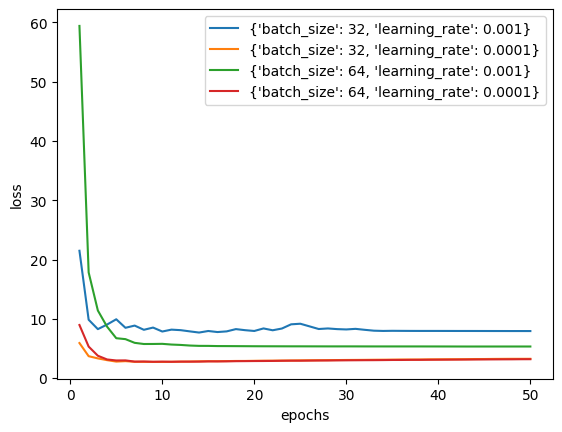

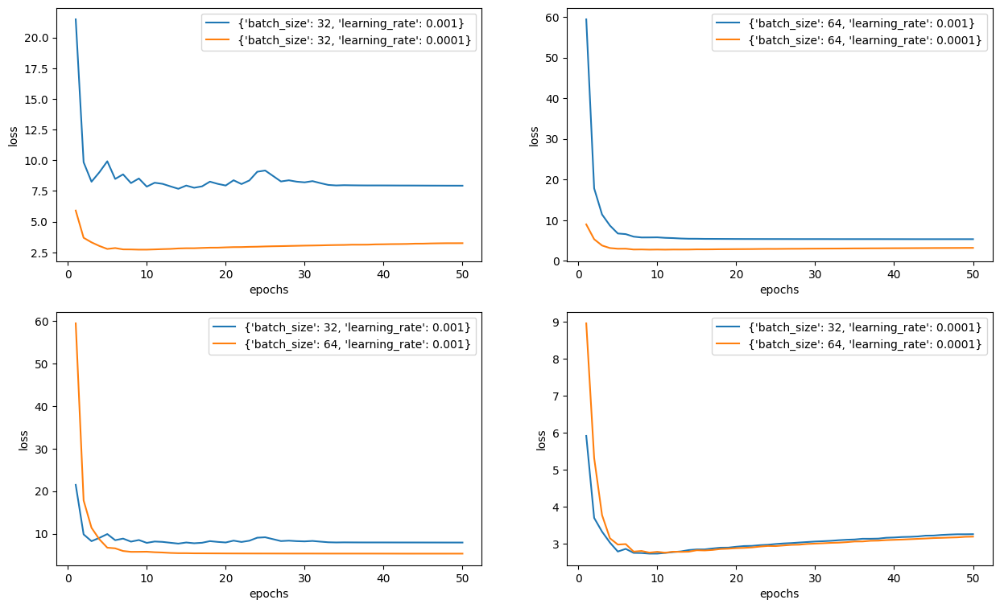


------------ Validation accuracy per epoch at ------------


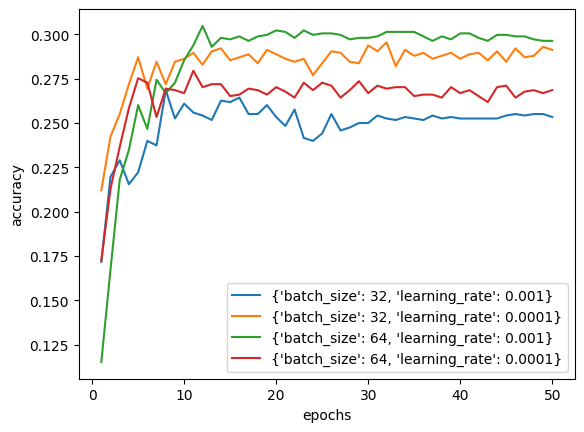

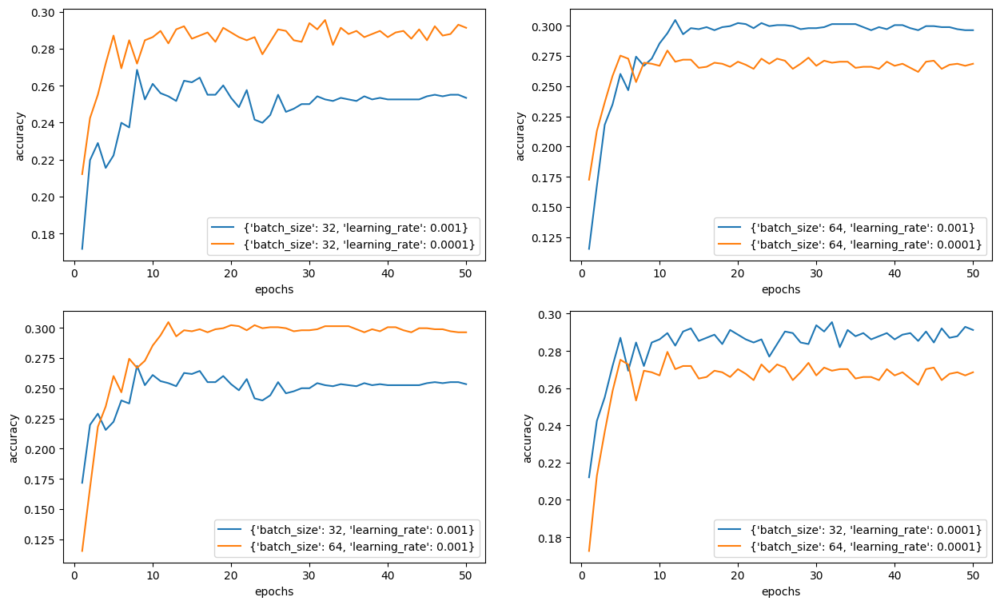

In [42]:
# get the best cross validation result
best_cv_result = get_best_cv_result(cv_history)

print('\n------------ Best cross validation result ------------')
print(best_cv_result)

plot_cv_result(cv_history)

### Training on full training data

The final model is retrained on full training data using the best parameters.

In [43]:
simpleCNN, train_history = train(simpleCNN, best_cv_result['epoch'],
                             best_cv_result['params']['batch_size'],
                             best_cv_result['params']['learning_rate'],                             
                             init_state)

Training > training data size: 1188

Epoch 1/9


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 1/9 > loss: 7.8839 - acc: 18.0135% - Time: 5.5455s

Epoch 2/9


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 2/9 > loss: 2.6803 - acc: 41.1616% - Time: 5.4322s

Epoch 3/9


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 3/9 > loss: 1.2120 - acc: 63.3838% - Time: 5.3551s

Epoch 4/9


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 4/9 > loss: 0.4926 - acc: 84.5118% - Time: 5.4372s

Epoch 5/9


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 5/9 > loss: 0.2385 - acc: 95.2020% - Time: 5.4020s

Epoch 6/9


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 6/9 > loss: 0.1326 - acc: 98.6532% - Time: 5.4524s

Epoch 7/9


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 7/9 > loss: 0.0879 - acc: 99.5791% - Time: 5.4838s

Epoch 8/9


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 8/9 > loss: 0.0524 - acc: 99.8316% - Time: 5.6114s

Epoch 9/9


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 9/9 > loss: 0.0401 - acc: 100.0000% - Time: 5.3739s
End Train > time: 49.0936s



### Result of training

loss : 0.04011388666463721
acc : 100.0


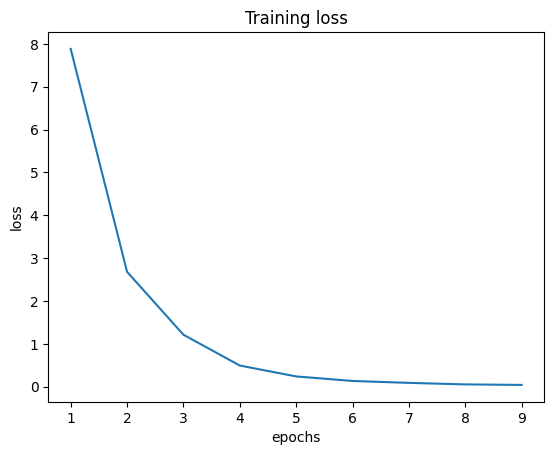

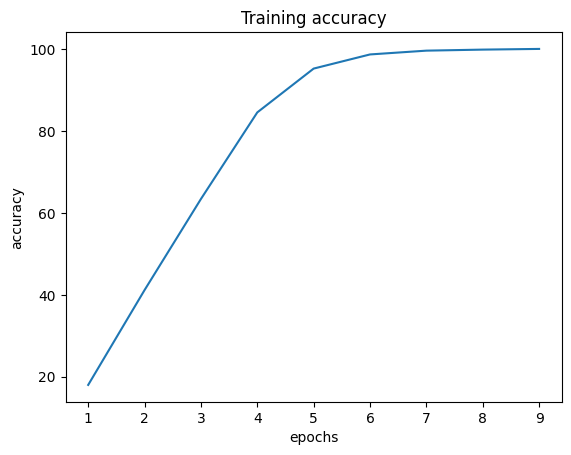

In [46]:
print('loss :',train_history[-1]['avg_train_loss'])
print('acc :',train_history[-1]['avg_train_acc']*100)

plot_train_result(train_history)

### Testing

In [54]:
results = test(simpleCNN, calc_top3_acc=True)
loss = results[0]
acc = results[1]
cm = results[2]
top3_acc = results[3]

Test data size : 1183 



Testing:   0%|          | 0/37 [00:00<?, ?it/s]


Result > loss: 2.9126 - acc: 27.0499% - time: 4.1786s


Result > top3_acc: 56.9738% 



### Result of testing

loss : 2.912607384050487
acc : 27.04987318356563
average fscore: 27.414788121402818
top3 acc : 56.97379546113066

------------ Confusion Matrix ------------


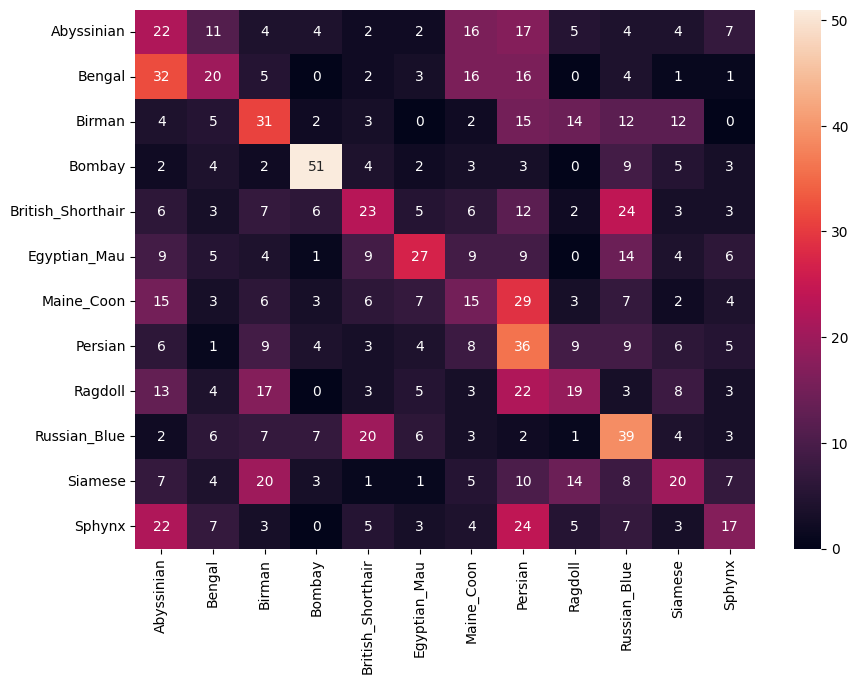


------------ FScore per class ------------


,fscore
Abyssinian,0.184874
Bengal,0.231214
Birman,0.288372
Bombay,0.603550
British_Shorthair,0.254144
Egyptian_Mau,0.333333
Maine_Coon,0.157895
Persian,0.244068
Ragdoll,0.220930
Russian_Blue,0.325000


In [55]:
recall = cm.diagonal()/cm.sum(axis=1)
precision = cm.diagonal()/cm.sum(axis=0)
fscore = 2*precision*recall/(precision+recall)

print('loss :', loss)
print('acc :',acc*100)
print('average fscore:',np.average(fscore)*100)
print('top3 acc :',top3_acc)

print('\n------------ Confusion Matrix ------------')

df_cm = pd.DataFrame(cm, index = data['test'].class_to_idx.keys(),
                  columns = data['test'].class_to_idx.keys())
plt.figure(figsize = (10,7))
sn.heatmap(df_cm, annot=True)
plt.show()

print('\n------------ FScore per class ------------')

pd.DataFrame(fscore,index = data['test'].class_to_idx.keys(),columns=['fscore'])

### Save the model

In [56]:
!mkdir ../model
save_model_state(simpleCNN, '../model/simpleCNN-model.pth')

## ResNet-50 (Pretrained)

### Build the network

In [57]:
resnet50 = torchvision.models.resnet50(pretrained=True)

# freeze model parameters
for param in resnet50.parameters():
    param.requires_grad = False
    
# change the final layer of ResNet50 model for transfer learning
fc_inputs = resnet50.fc.in_features
resnet50.fc = nn.Sequential(
    nn.Linear(fc_inputs, 12),
    nn.LogSoftmax(dim=1) # For using NLLLoss()
)
# move the model to a device
resnet50 = resnet50.to(device)

# copy initial state, used for retraining later
init_state = copy.deepcopy(resnet50.state_dict())

/home/gnaoh96/anaconda3/envs/capstone/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/gnaoh96/anaconda3/envs/capstone/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /home/gnaoh96/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 97.8M/97.8M [00:08<00:00, 11.7MB/s]


### Perform grid search & cross validation

In [58]:
cv_history = grid_search_cv(resnet50, k_fold=5, epochs=50, hyperparameters={'batch_size':[32,64],'learning_rate' : [1e-03, 1e-04]})

Hyperparameters 1/4 > bs: 32 - lr: 0.001
Fold 1/5 > training data size: 950 - validation data size: 238

Epoch 1/50
Training Batch 000 > loss: 2.6385176181793213 - acc: 0.0625
Training Batch 001 > loss: 2.5683364868164062 - acc: 0.21875
Training Batch 002 > loss: 2.7224628925323486 - acc: 0.03125
Training Batch 003 > loss: 2.4224061965942383 - acc: 0.09375
Training Batch 004 > loss: 2.308776617050171 - acc: 0.125
Training Batch 005 > loss: 2.2787575721740723 - acc: 0.21875
Training Batch 006 > loss: 2.304771900177002 - acc: 0.21875
Training Batch 007 > loss: 2.1775693893432617 - acc: 0.3125
Training Batch 008 > loss: 2.0238311290740967 - acc: 0.34375
Training Batch 009 > loss: 1.9121756553649902 - acc: 0.59375
Training Batch 010 > loss: 1.9459878206253052 - acc: 0.46875
Training Batch 011 > loss: 1.806064486503601 - acc: 0.625
Training Batch 012 > loss: 1.9067100286483765 - acc: 0.46875
Training Batch 013 > loss: 1.7599228620529175 - acc: 0.4375
Training Batch 014 > loss: 1.54048097133

Training Batch 015 > loss: 0.3580140769481659 - acc: 0.90625
Training Batch 016 > loss: 0.2287418395280838 - acc: 0.9375
Training Batch 017 > loss: 0.19238689541816711 - acc: 0.96875
Training Batch 018 > loss: 0.30420318245887756 - acc: 0.9375
Training Batch 019 > loss: 0.3146090507507324 - acc: 0.90625
Training Batch 020 > loss: 0.2701354920864105 - acc: 0.9375
Training Batch 021 > loss: 0.24266588687896729 - acc: 0.9375
Training Batch 022 > loss: 0.15334078669548035 - acc: 0.96875
Training Batch 023 > loss: 0.2777291536331177 - acc: 0.90625
Training Batch 024 > loss: 0.3118498921394348 - acc: 0.90625
Training Batch 025 > loss: 0.20786888897418976 - acc: 0.9375
Training Batch 026 > loss: 0.15482228994369507 - acc: 1.0
Training Batch 027 > loss: 0.1666330099105835 - acc: 1.0
Training Batch 028 > loss: 0.19482213258743286 - acc: 0.96875
Training Batch 029 > loss: 0.35707372426986694 - acc: 0.9047619104385376
Validation Batch 000 > valid_loss: 0.22951596975326538, valid_acc: 0.9375
Valid

Training Batch 023 > loss: 0.27323654294013977 - acc: 0.9375
Training Batch 024 > loss: 0.13338470458984375 - acc: 1.0
Training Batch 025 > loss: 0.21597881615161896 - acc: 0.96875
Training Batch 026 > loss: 0.23697799444198608 - acc: 0.9375
Training Batch 027 > loss: 0.1753377765417099 - acc: 0.96875
Training Batch 028 > loss: 0.06268799304962158 - acc: 1.0
Training Batch 029 > loss: 0.28996166586875916 - acc: 0.9047619104385376
Validation Batch 000 > valid_loss: 0.5050644278526306, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 0.2896044850349426, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.2258264124393463, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 0.3308093547821045, valid_acc: 0.84375
Validation Batch 004 > valid_loss: 0.26426953077316284, valid_acc: 0.9375
Validation Batch 005 > valid_loss: 0.13658587634563446, valid_acc: 0.96875
Validation Batch 006 > valid_loss: 0.2635400593280792, valid_acc: 0.9375
Validation Batch 007 > valid_loss: 0.520736098289

Validation Batch 001 > valid_loss: 0.22223132848739624, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.24767720699310303, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.414045512676239, valid_acc: 0.875
Validation Batch 004 > valid_loss: 0.24777910113334656, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.47785845398902893, valid_acc: 0.84375
Validation Batch 006 > valid_loss: 0.43735209107398987, valid_acc: 0.875
Validation Batch 007 > valid_loss: 0.22416608035564423, valid_acc: 0.9333333373069763
End Epoch 13/50 > loss: 0.15544265827401546 - acc: 96.1011591337001% - valid_loss: 0.31451228304637524 - valid_acc: 88.28451885339106% - Time: 9.9649s

Epoch 14/50
Training Batch 000 > loss: 0.08771946281194687 - acc: 1.0
Training Batch 001 > loss: 0.128299742937088 - acc: 0.96875
Training Batch 002 > loss: 0.11246756464242935 - acc: 1.0
Training Batch 003 > loss: 0.15348045527935028 - acc: 1.0
Training Batch 004 > loss: 0.09808647632598877 - acc: 1.0
Training Batch 0

Training Batch 000 > loss: 0.12025368213653564 - acc: 1.0
Training Batch 001 > loss: 0.09444194287061691 - acc: 0.96875
Training Batch 002 > loss: 0.08834529668092728 - acc: 0.96875
Training Batch 003 > loss: 0.1633053719997406 - acc: 0.9375
Training Batch 004 > loss: 0.07932277023792267 - acc: 1.0
Training Batch 005 > loss: 0.09335757046937943 - acc: 1.0
Training Batch 006 > loss: 0.1750098615884781 - acc: 0.96875
Training Batch 007 > loss: 0.059241291135549545 - acc: 1.0
Training Batch 008 > loss: 0.13707366585731506 - acc: 0.96875
Training Batch 009 > loss: 0.13854941725730896 - acc: 0.9375
Training Batch 010 > loss: 0.13280737400054932 - acc: 0.96875
Training Batch 011 > loss: 0.11678121984004974 - acc: 0.96875
Training Batch 012 > loss: 0.0720229521393776 - acc: 1.0
Training Batch 013 > loss: 0.043160710483789444 - acc: 1.0
Training Batch 014 > loss: 0.18971854448318481 - acc: 0.96875
Training Batch 015 > loss: 0.09122015535831451 - acc: 1.0
Training Batch 016 > loss: 0.1000473648

Training Batch 009 > loss: 0.12404302507638931 - acc: 0.9375
Training Batch 010 > loss: 0.2480849325656891 - acc: 0.90625
Training Batch 011 > loss: 0.11327388882637024 - acc: 1.0
Training Batch 012 > loss: 0.1175946593284607 - acc: 0.96875
Training Batch 013 > loss: 0.0795624628663063 - acc: 1.0
Training Batch 014 > loss: 0.05803890526294708 - acc: 1.0
Training Batch 015 > loss: 0.04485579952597618 - acc: 1.0
Training Batch 016 > loss: 0.08870266377925873 - acc: 1.0
Training Batch 017 > loss: 0.07325706630945206 - acc: 1.0
Training Batch 018 > loss: 0.07184692472219467 - acc: 1.0
Training Batch 019 > loss: 0.08236183226108551 - acc: 1.0
Training Batch 020 > loss: 0.06534966081380844 - acc: 1.0
Training Batch 021 > loss: 0.09705299884080887 - acc: 1.0
Training Batch 022 > loss: 0.10568712651729584 - acc: 1.0
Training Batch 023 > loss: 0.2199382483959198 - acc: 0.96875
Training Batch 024 > loss: 0.10000652819871902 - acc: 0.96875
Training Batch 025 > loss: 0.08266344666481018 - acc: 0.9

Training Batch 019 > loss: 0.02357153594493866 - acc: 1.0
Training Batch 020 > loss: 0.06601490825414658 - acc: 0.96875
Training Batch 021 > loss: 0.07952849566936493 - acc: 1.0
Training Batch 022 > loss: 0.063591368496418 - acc: 1.0
Training Batch 023 > loss: 0.08705271780490875 - acc: 0.96875
Training Batch 024 > loss: 0.05019628256559372 - acc: 1.0
Training Batch 025 > loss: 0.11570704728364944 - acc: 0.9375
Training Batch 026 > loss: 0.04507698491215706 - acc: 1.0
Training Batch 027 > loss: 0.05861309915781021 - acc: 0.96875
Training Batch 028 > loss: 0.05171103775501251 - acc: 0.96875
Training Batch 029 > loss: 0.08633837103843689 - acc: 1.0
Validation Batch 000 > valid_loss: 0.4606248140335083, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 0.0996716320514679, valid_acc: 0.96875
Validation Batch 002 > valid_loss: 0.2631751596927643, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.3955956697463989, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.48281663656234

Validation Batch 000 > valid_loss: 0.6219850778579712, valid_acc: 0.8125
Validation Batch 001 > valid_loss: 0.16844233870506287, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.30823415517807007, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.3480052053928375, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.3359251022338867, valid_acc: 0.8125
Validation Batch 005 > valid_loss: 0.18530836701393127, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.3724666237831116, valid_acc: 0.875
Validation Batch 007 > valid_loss: 0.05635010451078415, valid_acc: 1.0
End Epoch 26/50 > loss: 0.0680760182401026 - acc: 99.36775553213909% - valid_loss: 0.3168911774599901 - valid_acc: 88.70292887029288% - Time: 9.9906s

Epoch 27/50
Training Batch 000 > loss: 0.04649478569626808 - acc: 1.0
Training Batch 001 > loss: 0.09086158871650696 - acc: 1.0
Training Batch 002 > loss: 0.09266078472137451 - acc: 0.9375
Training Batch 003 > loss: 0.032117344439029694 - acc: 1.0
Training Batch 00

Training Batch 000 > loss: 0.04549508914351463 - acc: 1.0
Training Batch 001 > loss: 0.03441954031586647 - acc: 1.0
Training Batch 002 > loss: 0.07719253748655319 - acc: 1.0
Training Batch 003 > loss: 0.06356863677501678 - acc: 1.0
Training Batch 004 > loss: 0.09079597145318985 - acc: 1.0
Training Batch 005 > loss: 0.1600920706987381 - acc: 0.96875
Training Batch 006 > loss: 0.04486541450023651 - acc: 1.0
Training Batch 007 > loss: 0.10054221004247665 - acc: 1.0
Training Batch 008 > loss: 0.0704580619931221 - acc: 1.0
Training Batch 009 > loss: 0.052391812205314636 - acc: 1.0
Training Batch 010 > loss: 0.061276864260435104 - acc: 1.0
Training Batch 011 > loss: 0.08583778142929077 - acc: 0.96875
Training Batch 012 > loss: 0.0378301702439785 - acc: 1.0
Training Batch 013 > loss: 0.06069805845618248 - acc: 1.0
Training Batch 014 > loss: 0.08063402026891708 - acc: 1.0
Training Batch 015 > loss: 0.027087155729532242 - acc: 1.0
Training Batch 016 > loss: 0.04797215014696121 - acc: 1.0
Traini

Training Batch 011 > loss: 0.05729116126894951 - acc: 1.0
Training Batch 012 > loss: 0.13465747237205505 - acc: 0.96875
Training Batch 013 > loss: 0.06768400967121124 - acc: 1.0
Training Batch 014 > loss: 0.10678943991661072 - acc: 0.96875
Training Batch 015 > loss: 0.05617992579936981 - acc: 0.96875
Training Batch 016 > loss: 0.06233520433306694 - acc: 1.0
Training Batch 017 > loss: 0.15338611602783203 - acc: 0.96875
Training Batch 018 > loss: 0.02725617215037346 - acc: 1.0
Training Batch 019 > loss: 0.030197300016880035 - acc: 1.0
Training Batch 020 > loss: 0.050256870687007904 - acc: 1.0
Training Batch 021 > loss: 0.05479751154780388 - acc: 1.0
Training Batch 022 > loss: 0.031468939036130905 - acc: 1.0
Training Batch 023 > loss: 0.04902173951268196 - acc: 1.0
Training Batch 024 > loss: 0.06386303156614304 - acc: 0.96875
Training Batch 025 > loss: 0.026155339553952217 - acc: 1.0
Training Batch 026 > loss: 0.026235908269882202 - acc: 1.0
Training Batch 027 > loss: 0.03666771203279495 

Training Batch 022 > loss: 0.04369121789932251 - acc: 1.0
Training Batch 023 > loss: 0.021029328927397728 - acc: 1.0
Training Batch 024 > loss: 0.03101363405585289 - acc: 1.0
Training Batch 025 > loss: 0.05763612315058708 - acc: 1.0
Training Batch 026 > loss: 0.051062531769275665 - acc: 1.0
Training Batch 027 > loss: 0.09453100711107254 - acc: 0.96875
Training Batch 028 > loss: 0.02869778871536255 - acc: 1.0
Training Batch 029 > loss: 0.053364407271146774 - acc: 1.0
Validation Batch 000 > valid_loss: 0.21778655052185059, valid_acc: 0.90625
Validation Batch 001 > valid_loss: 0.1810944825410843, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.18066252768039703, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.1496349275112152, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.3279711604118347, valid_acc: 0.9375
Validation Batch 005 > valid_loss: 0.9300517439842224, valid_acc: 0.78125
Validation Batch 006 > valid_loss: 0.3733815848827362, valid_acc: 0.875
Validation Ba

Validation Batch 002 > valid_loss: 0.32136818766593933, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.4561241865158081, valid_acc: 0.875
Validation Batch 004 > valid_loss: 0.19537413120269775, valid_acc: 0.9375
Validation Batch 005 > valid_loss: 0.268998920917511, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.21293121576309204, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 0.6510578989982605, valid_acc: 0.6666666865348816
End Epoch 39/50 > loss: 0.04948265317462393 - acc: 99.57850368809274% - valid_loss: 0.3256604773728917 - valid_acc: 88.2845189531478% - Time: 10.0191s

Epoch 40/50
Training Batch 000 > loss: 0.057979803532361984 - acc: 1.0
Training Batch 001 > loss: 0.06600335985422134 - acc: 1.0
Training Batch 002 > loss: 0.027040619403123856 - acc: 1.0
Training Batch 003 > loss: 0.028948411345481873 - acc: 1.0
Training Batch 004 > loss: 0.01807822845876217 - acc: 1.0
Training Batch 005 > loss: 0.030120674520730972 - acc: 1.0
Training Batch 006 > loss: 0.03

Training Batch 001 > loss: 0.04178883880376816 - acc: 1.0
Training Batch 002 > loss: 0.024775680154561996 - acc: 1.0
Training Batch 003 > loss: 0.020879939198493958 - acc: 1.0
Training Batch 004 > loss: 0.12104283273220062 - acc: 0.96875
Training Batch 005 > loss: 0.054972972720861435 - acc: 1.0
Training Batch 006 > loss: 0.03445934131741524 - acc: 1.0
Training Batch 007 > loss: 0.040723614394664764 - acc: 1.0
Training Batch 008 > loss: 0.07246493548154831 - acc: 1.0
Training Batch 009 > loss: 0.08545108884572983 - acc: 0.96875
Training Batch 010 > loss: 0.015662716701626778 - acc: 1.0
Training Batch 011 > loss: 0.06262843310832977 - acc: 1.0
Training Batch 012 > loss: 0.031985439360141754 - acc: 1.0
Training Batch 013 > loss: 0.06668901443481445 - acc: 0.96875
Training Batch 014 > loss: 0.06989912688732147 - acc: 0.96875
Training Batch 015 > loss: 0.02158007025718689 - acc: 1.0
Training Batch 016 > loss: 0.017724035307765007 - acc: 1.0
Training Batch 017 > loss: 0.015346556901931763 -

Training Batch 012 > loss: 0.028421446681022644 - acc: 1.0
Training Batch 013 > loss: 0.03322901949286461 - acc: 1.0
Training Batch 014 > loss: 0.016988132148981094 - acc: 1.0
Training Batch 015 > loss: 0.03911186754703522 - acc: 1.0
Training Batch 016 > loss: 0.022499583661556244 - acc: 1.0
Training Batch 017 > loss: 0.011774454265832901 - acc: 1.0
Training Batch 018 > loss: 0.015465439297258854 - acc: 1.0
Training Batch 019 > loss: 0.021675052121281624 - acc: 1.0
Training Batch 020 > loss: 0.10788494348526001 - acc: 0.9375
Training Batch 021 > loss: 0.025208421051502228 - acc: 1.0
Training Batch 022 > loss: 0.04566691815853119 - acc: 1.0
Training Batch 023 > loss: 0.026393258944153786 - acc: 1.0
Training Batch 024 > loss: 0.0169792752712965 - acc: 1.0
Training Batch 025 > loss: 0.04932798072695732 - acc: 1.0
Training Batch 026 > loss: 0.07718664407730103 - acc: 0.96875
Training Batch 027 > loss: 0.04802044481039047 - acc: 1.0
Training Batch 028 > loss: 0.020358892157673836 - acc: 1.0

Training Batch 022 > loss: 0.02143748849630356 - acc: 1.0
Training Batch 023 > loss: 0.03407422453165054 - acc: 1.0
Training Batch 024 > loss: 0.031141377985477448 - acc: 1.0
Training Batch 025 > loss: 0.04027937352657318 - acc: 1.0
Training Batch 026 > loss: 0.028418082743883133 - acc: 1.0
Training Batch 027 > loss: 0.016846001148223877 - acc: 1.0
Training Batch 028 > loss: 0.014541154727339745 - acc: 1.0
Training Batch 029 > loss: 0.029136696830391884 - acc: 1.0
Validation Batch 000 > valid_loss: 0.26670700311660767, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.3186851441860199, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.23923099040985107, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 0.2721344530582428, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.3208862543106079, valid_acc: 0.875
Validation Batch 005 > valid_loss: 0.2790748178958893, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.6267303824424744, valid_acc: 0.78125
Validation Batch 

Validation Batch 000 > valid_loss: 0.5151190161705017, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.4422903060913086, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.5506280660629272, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.6026594042778015, valid_acc: 0.84375
Validation Batch 004 > valid_loss: 0.6421768665313721, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.6314335465431213, valid_acc: 0.8125
Validation Batch 006 > valid_loss: 0.6625620126724243, valid_acc: 0.84375
Validation Batch 007 > valid_loss: 0.670924961566925, valid_acc: 0.8571428656578064
End Epoch 2/50 > loss: 0.7666565218724702 - acc: 84.94736848379436% - valid_loss: 0.5835830439038637 - valid_acc: 87.39495803328121% - Time: 9.8918s

Epoch 3/50
Training Batch 000 > loss: 0.5716955065727234 - acc: 0.84375
Training Batch 001 > loss: 0.5358071327209473 - acc: 0.96875
Training Batch 002 > loss: 0.598127007484436 - acc: 0.84375
Training Batch 003 > loss: 0.5313236117362976 - acc: 0.9375

Training Batch 000 > loss: 0.17375850677490234 - acc: 1.0
Training Batch 001 > loss: 0.18926650285720825 - acc: 0.9375
Training Batch 002 > loss: 0.4265972077846527 - acc: 0.90625
Training Batch 003 > loss: 0.25014159083366394 - acc: 0.96875
Training Batch 004 > loss: 0.1877264380455017 - acc: 0.96875
Training Batch 005 > loss: 0.2256275713443756 - acc: 0.9375
Training Batch 006 > loss: 0.2636868357658386 - acc: 0.96875
Training Batch 007 > loss: 0.2627944350242615 - acc: 0.90625
Training Batch 008 > loss: 0.3518478274345398 - acc: 0.9375
Training Batch 009 > loss: 0.27801787853240967 - acc: 0.9375
Training Batch 010 > loss: 0.21896055340766907 - acc: 1.0
Training Batch 011 > loss: 0.32941779494285583 - acc: 0.875
Training Batch 012 > loss: 0.24128979444503784 - acc: 0.96875
Training Batch 013 > loss: 0.29080188274383545 - acc: 0.96875
Training Batch 014 > loss: 0.12366709113121033 - acc: 1.0
Training Batch 015 > loss: 0.4847453236579895 - acc: 0.875
Training Batch 016 > loss: 0.215684

Training Batch 009 > loss: 0.4302822947502136 - acc: 0.90625
Training Batch 010 > loss: 0.12720036506652832 - acc: 0.96875
Training Batch 011 > loss: 0.3242042362689972 - acc: 0.90625
Training Batch 012 > loss: 0.20288269221782684 - acc: 0.9375
Training Batch 013 > loss: 0.171236053109169 - acc: 0.96875
Training Batch 014 > loss: 0.2162277102470398 - acc: 0.96875
Training Batch 015 > loss: 0.23108957707881927 - acc: 0.9375
Training Batch 016 > loss: 0.31502360105514526 - acc: 0.875
Training Batch 017 > loss: 0.15944232046604156 - acc: 0.96875
Training Batch 018 > loss: 0.16863465309143066 - acc: 1.0
Training Batch 019 > loss: 0.1785675436258316 - acc: 0.96875
Training Batch 020 > loss: 0.42889049649238586 - acc: 0.78125
Training Batch 021 > loss: 0.148602694272995 - acc: 0.96875
Training Batch 022 > loss: 0.283234179019928 - acc: 0.96875
Training Batch 023 > loss: 0.22529205679893494 - acc: 1.0
Training Batch 024 > loss: 0.23079240322113037 - acc: 0.96875
Training Batch 025 > loss: 0.1

Training Batch 017 > loss: 0.14142131805419922 - acc: 0.9375
Training Batch 018 > loss: 0.13057027757167816 - acc: 0.9375
Training Batch 019 > loss: 0.2573217451572418 - acc: 0.90625
Training Batch 020 > loss: 0.16212543845176697 - acc: 0.96875
Training Batch 021 > loss: 0.07762313634157181 - acc: 1.0
Training Batch 022 > loss: 0.11987092345952988 - acc: 1.0
Training Batch 023 > loss: 0.09761795401573181 - acc: 1.0
Training Batch 024 > loss: 0.18444712460041046 - acc: 0.96875
Training Batch 025 > loss: 0.09229515492916107 - acc: 1.0
Training Batch 026 > loss: 0.11202258616685867 - acc: 1.0
Training Batch 027 > loss: 0.08451807498931885 - acc: 1.0
Training Batch 028 > loss: 0.15208800137043 - acc: 1.0
Training Batch 029 > loss: 0.0953981950879097 - acc: 1.0
Validation Batch 000 > valid_loss: 0.45494845509529114, valid_acc: 0.8125
Validation Batch 001 > valid_loss: 0.2970122694969177, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.35521116852760315, valid_acc: 0.875
Validation Ba

Training Batch 027 > loss: 0.13390353322029114 - acc: 0.9375
Training Batch 028 > loss: 0.12152276188135147 - acc: 0.9375
Training Batch 029 > loss: 0.2005479782819748 - acc: 0.9545454382896423
Validation Batch 000 > valid_loss: 0.11268969625234604, valid_acc: 1.0
Validation Batch 001 > valid_loss: 0.41675591468811035, valid_acc: 0.84375
Validation Batch 002 > valid_loss: 0.5211293697357178, valid_acc: 0.8125
Validation Batch 003 > valid_loss: 0.3434177339076996, valid_acc: 0.875
Validation Batch 004 > valid_loss: 0.5258631706237793, valid_acc: 0.84375
Validation Batch 005 > valid_loss: 0.21918094158172607, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.235725998878479, valid_acc: 0.96875
Validation Batch 007 > valid_loss: 0.11934810131788254, valid_acc: 1.0
End Epoch 15/50 > loss: 0.12976576243576252 - acc: 97.26315785709181% - valid_loss: 0.3263163186547135 - valid_acc: 90.33613445378151% - Time: 9.9219s

Epoch 16/50
Training Batch 000 > loss: 0.10310185700654984 - acc: 1.0
T

Validation Batch 005 > valid_loss: 0.2216983437538147, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.38515642285346985, valid_acc: 0.84375
Validation Batch 007 > valid_loss: 0.2361009120941162, valid_acc: 0.8571428656578064
End Epoch 18/50 > loss: 0.11217428458364387 - acc: 97.47368417288128% - valid_loss: 0.2748430195976706 - valid_acc: 89.07563030218878% - Time: 9.9143s

Epoch 19/50
Training Batch 000 > loss: 0.04451277107000351 - acc: 1.0
Training Batch 001 > loss: 0.06786132603883743 - acc: 1.0
Training Batch 002 > loss: 0.09187085926532745 - acc: 1.0
Training Batch 003 > loss: 0.07812560349702835 - acc: 0.96875
Training Batch 004 > loss: 0.1099647581577301 - acc: 0.96875
Training Batch 005 > loss: 0.14829561114311218 - acc: 0.9375
Training Batch 006 > loss: 0.11249995976686478 - acc: 1.0
Training Batch 007 > loss: 0.18257638812065125 - acc: 1.0
Training Batch 008 > loss: 0.04362471029162407 - acc: 1.0
Training Batch 009 > loss: 0.10328219830989838 - acc: 1.0
Training Bat

Training Batch 003 > loss: 0.05880795046687126 - acc: 1.0
Training Batch 004 > loss: 0.04797330126166344 - acc: 1.0
Training Batch 005 > loss: 0.14815613627433777 - acc: 0.96875
Training Batch 006 > loss: 0.05773218721151352 - acc: 1.0
Training Batch 007 > loss: 0.08864443749189377 - acc: 1.0
Training Batch 008 > loss: 0.07488426566123962 - acc: 1.0
Training Batch 009 > loss: 0.06846877932548523 - acc: 1.0
Training Batch 010 > loss: 0.06983008980751038 - acc: 1.0
Training Batch 011 > loss: 0.061684053391218185 - acc: 1.0
Training Batch 012 > loss: 0.08283400535583496 - acc: 1.0
Training Batch 013 > loss: 0.12087667733430862 - acc: 0.9375
Training Batch 014 > loss: 0.0989890918135643 - acc: 1.0
Training Batch 015 > loss: 0.11829071491956711 - acc: 1.0
Training Batch 016 > loss: 0.054779112339019775 - acc: 0.96875
Training Batch 017 > loss: 0.05583937466144562 - acc: 1.0
Training Batch 018 > loss: 0.05212540924549103 - acc: 1.0
Training Batch 019 > loss: 0.10272415727376938 - acc: 0.9687

Training Batch 013 > loss: 0.10649801790714264 - acc: 0.96875
Training Batch 014 > loss: 0.2586665451526642 - acc: 0.90625
Training Batch 015 > loss: 0.04127460718154907 - acc: 1.0
Training Batch 016 > loss: 0.06020447611808777 - acc: 1.0
Training Batch 017 > loss: 0.0852663666009903 - acc: 1.0
Training Batch 018 > loss: 0.14289918541908264 - acc: 0.9375
Training Batch 019 > loss: 0.03477790206670761 - acc: 1.0
Training Batch 020 > loss: 0.12596248090267181 - acc: 0.96875
Training Batch 021 > loss: 0.029388949275016785 - acc: 1.0
Training Batch 022 > loss: 0.04450090602040291 - acc: 1.0
Training Batch 023 > loss: 0.030046571046113968 - acc: 1.0
Training Batch 024 > loss: 0.09171700477600098 - acc: 0.96875
Training Batch 025 > loss: 0.05393383651971817 - acc: 1.0
Training Batch 026 > loss: 0.04291651397943497 - acc: 1.0
Training Batch 027 > loss: 0.10760126262903214 - acc: 0.96875
Training Batch 028 > loss: 0.0892312154173851 - acc: 1.0
Training Batch 029 > loss: 0.12855464220046997 - a

Training Batch 023 > loss: 0.09262122213840485 - acc: 1.0
Training Batch 024 > loss: 0.031837042421102524 - acc: 1.0
Training Batch 025 > loss: 0.07968174666166306 - acc: 0.96875
Training Batch 026 > loss: 0.04457412287592888 - acc: 1.0
Training Batch 027 > loss: 0.037859901785850525 - acc: 1.0
Training Batch 028 > loss: 0.1409977674484253 - acc: 0.96875
Training Batch 029 > loss: 0.11100222915410995 - acc: 1.0
Validation Batch 000 > valid_loss: 0.516497015953064, valid_acc: 0.75
Validation Batch 001 > valid_loss: 0.44673803448677063, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.4330822825431824, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.07157351821660995, valid_acc: 1.0
Validation Batch 004 > valid_loss: 0.23084105551242828, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.3121694028377533, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.19274088740348816, valid_acc: 0.96875
Validation Batch 007 > valid_loss: 0.08834514766931534, valid_acc: 1.0


Validation Batch 003 > valid_loss: 0.16929638385772705, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.3864538371562958, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.4192006289958954, valid_acc: 0.84375
Validation Batch 006 > valid_loss: 0.16799211502075195, valid_acc: 0.96875
Validation Batch 007 > valid_loss: 0.49980106949806213, valid_acc: 0.8571428656578064
End Epoch 31/50 > loss: 0.06617653804390054 - acc: 99.05263157894737% - valid_loss: 0.3105201348036277 - valid_acc: 89.91596643664256% - Time: 9.9300s

Epoch 32/50
Training Batch 000 > loss: 0.06226000562310219 - acc: 1.0
Training Batch 001 > loss: 0.044353120028972626 - acc: 1.0
Training Batch 002 > loss: 0.05214698612689972 - acc: 1.0
Training Batch 003 > loss: 0.06060315668582916 - acc: 1.0
Training Batch 004 > loss: 0.09517718851566315 - acc: 0.9375
Training Batch 005 > loss: 0.05394890159368515 - acc: 0.96875
Training Batch 006 > loss: 0.04476701468229294 - acc: 1.0
Training Batch 007 > loss: 0.1095290333

Training Batch 002 > loss: 0.0416811928153038 - acc: 1.0
Training Batch 003 > loss: 0.03258664906024933 - acc: 1.0
Training Batch 004 > loss: 0.025828063488006592 - acc: 1.0
Training Batch 005 > loss: 0.022916942834854126 - acc: 1.0
Training Batch 006 > loss: 0.07341020554304123 - acc: 1.0
Training Batch 007 > loss: 0.051131829619407654 - acc: 1.0
Training Batch 008 > loss: 0.08415865153074265 - acc: 1.0
Training Batch 009 > loss: 0.0658189207315445 - acc: 1.0
Training Batch 010 > loss: 0.03144539147615433 - acc: 1.0
Training Batch 011 > loss: 0.054128337651491165 - acc: 1.0
Training Batch 012 > loss: 0.16965718567371368 - acc: 0.90625
Training Batch 013 > loss: 0.04347480088472366 - acc: 1.0
Training Batch 014 > loss: 0.03052627667784691 - acc: 1.0
Training Batch 015 > loss: 0.03406890109181404 - acc: 1.0
Training Batch 016 > loss: 0.037099529057741165 - acc: 1.0
Training Batch 017 > loss: 0.04017321765422821 - acc: 1.0
Training Batch 018 > loss: 0.07950479537248611 - acc: 0.96875
Tra

Training Batch 013 > loss: 0.04168780893087387 - acc: 1.0
Training Batch 014 > loss: 0.04254968464374542 - acc: 1.0
Training Batch 015 > loss: 0.02412489429116249 - acc: 1.0
Training Batch 016 > loss: 0.04343828558921814 - acc: 1.0
Training Batch 017 > loss: 0.04010705649852753 - acc: 1.0
Training Batch 018 > loss: 0.04930534586310387 - acc: 1.0
Training Batch 019 > loss: 0.020166121423244476 - acc: 1.0
Training Batch 020 > loss: 0.034549180418252945 - acc: 1.0
Training Batch 021 > loss: 0.048607468605041504 - acc: 1.0
Training Batch 022 > loss: 0.05921117588877678 - acc: 1.0
Training Batch 023 > loss: 0.05638164281845093 - acc: 1.0
Training Batch 024 > loss: 0.05550180375576019 - acc: 0.96875
Training Batch 025 > loss: 0.028726425021886826 - acc: 1.0
Training Batch 026 > loss: 0.05049994960427284 - acc: 1.0
Training Batch 027 > loss: 0.019157011061906815 - acc: 1.0
Training Batch 028 > loss: 0.04140912741422653 - acc: 1.0
Training Batch 029 > loss: 0.097083680331707 - acc: 1.0
Validat

Training Batch 024 > loss: 0.040472548454999924 - acc: 0.96875
Training Batch 025 > loss: 0.03494831547141075 - acc: 1.0
Training Batch 026 > loss: 0.02034512534737587 - acc: 1.0
Training Batch 027 > loss: 0.02549998089671135 - acc: 1.0
Training Batch 028 > loss: 0.028997257351875305 - acc: 1.0
Training Batch 029 > loss: 0.07072910666465759 - acc: 1.0
Validation Batch 000 > valid_loss: 0.8437798023223877, valid_acc: 0.78125
Validation Batch 001 > valid_loss: 0.42551207542419434, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.1038096621632576, valid_acc: 0.96875
Validation Batch 003 > valid_loss: 0.1573345810174942, valid_acc: 0.96875
Validation Batch 004 > valid_loss: 0.1419679820537567, valid_acc: 0.96875
Validation Batch 005 > valid_loss: 0.4114648103713989, valid_acc: 0.875
Validation Batch 006 > valid_loss: 0.117023766040802, valid_acc: 0.96875
Validation Batch 007 > valid_loss: 0.23937976360321045, valid_acc: 0.9285714030265808
End Epoch 41/50 > loss: 0.04262964932542098 - 

Validation Batch 004 > valid_loss: 0.2842640280723572, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.7758926749229431, valid_acc: 0.75
Validation Batch 006 > valid_loss: 0.5251394510269165, valid_acc: 0.84375
Validation Batch 007 > valid_loss: 0.16422298550605774, valid_acc: 0.9285714030265808
End Epoch 44/50 > loss: 0.03787182258932214 - acc: 99.47368417288128% - valid_loss: 0.38060441913724946 - valid_acc: 88.23529396738324% - Time: 9.9644s

Epoch 45/50
Training Batch 000 > loss: 0.03014940768480301 - acc: 1.0
Training Batch 001 > loss: 0.026696573942899704 - acc: 1.0
Training Batch 002 > loss: 0.0663219541311264 - acc: 1.0
Training Batch 003 > loss: 0.03469490259885788 - acc: 1.0
Training Batch 004 > loss: 0.026715295389294624 - acc: 1.0
Training Batch 005 > loss: 0.061851467937231064 - acc: 1.0
Training Batch 006 > loss: 0.03085368685424328 - acc: 1.0
Training Batch 007 > loss: 0.01302321907132864 - acc: 1.0
Training Batch 008 > loss: 0.01498260349035263 - acc: 1.0
Traini

Training Batch 003 > loss: 0.01815146952867508 - acc: 1.0
Training Batch 004 > loss: 0.015342913568019867 - acc: 1.0
Training Batch 005 > loss: 0.027990685775876045 - acc: 1.0
Training Batch 006 > loss: 0.02072960138320923 - acc: 1.0
Training Batch 007 > loss: 0.01718035340309143 - acc: 1.0
Training Batch 008 > loss: 0.04079047963023186 - acc: 0.96875
Training Batch 009 > loss: 0.027648068964481354 - acc: 1.0
Training Batch 010 > loss: 0.014401592314243317 - acc: 1.0
Training Batch 011 > loss: 0.03836663439869881 - acc: 1.0
Training Batch 012 > loss: 0.011416766792535782 - acc: 1.0
Training Batch 013 > loss: 0.04614415392279625 - acc: 0.96875
Training Batch 014 > loss: 0.012706765905022621 - acc: 1.0
Training Batch 015 > loss: 0.012162763625383377 - acc: 1.0
Training Batch 016 > loss: 0.035878244787454605 - acc: 1.0
Training Batch 017 > loss: 0.05320032313466072 - acc: 1.0
Training Batch 018 > loss: 0.020979128777980804 - acc: 1.0
Training Batch 019 > loss: 0.04230542108416557 - acc: 1

Training Batch 012 > loss: 1.6115559339523315 - acc: 0.71875
Training Batch 013 > loss: 1.6523159742355347 - acc: 0.71875
Training Batch 014 > loss: 2.095484495162964 - acc: 0.40625
Training Batch 015 > loss: 1.5855470895767212 - acc: 0.5625
Training Batch 016 > loss: 1.578133225440979 - acc: 0.5
Training Batch 017 > loss: 1.3824381828308105 - acc: 0.75
Training Batch 018 > loss: 1.3912838697433472 - acc: 0.6875
Training Batch 019 > loss: 1.4538851976394653 - acc: 0.625
Training Batch 020 > loss: 1.5025148391723633 - acc: 0.59375
Training Batch 021 > loss: 1.4927465915679932 - acc: 0.5625
Training Batch 022 > loss: 1.4748950004577637 - acc: 0.5
Training Batch 023 > loss: 1.35004723072052 - acc: 0.71875
Training Batch 024 > loss: 1.1718902587890625 - acc: 0.71875
Training Batch 025 > loss: 1.2571412324905396 - acc: 0.65625
Training Batch 026 > loss: 1.1397862434387207 - acc: 0.75
Training Batch 027 > loss: 1.1311365365982056 - acc: 0.84375
Training Batch 028 > loss: 1.1134040355682373 -

Training Batch 020 > loss: 0.3916897475719452 - acc: 0.90625
Training Batch 021 > loss: 0.30614936351776123 - acc: 0.9375
Training Batch 022 > loss: 0.4212920665740967 - acc: 0.875
Training Batch 023 > loss: 0.4003645181655884 - acc: 0.9375
Training Batch 024 > loss: 0.3744197189807892 - acc: 0.875
Training Batch 025 > loss: 0.37452980875968933 - acc: 0.9375
Training Batch 026 > loss: 0.38512614369392395 - acc: 0.96875
Training Batch 027 > loss: 0.367336630821228 - acc: 0.9375
Training Batch 028 > loss: 0.3024160861968994 - acc: 1.0
Training Batch 029 > loss: 0.2793733775615692 - acc: 0.9545454382896423
Validation Batch 000 > valid_loss: 0.40195658802986145, valid_acc: 0.96875
Validation Batch 001 > valid_loss: 0.4029265344142914, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.38946816325187683, valid_acc: 0.96875
Validation Batch 003 > valid_loss: 0.5636288523674011, valid_acc: 0.75
Validation Batch 004 > valid_loss: 0.4474777579307556, valid_acc: 0.875
Validation Batch 005 > 

Training Batch 027 > loss: 0.22077719867229462 - acc: 0.96875
Training Batch 028 > loss: 0.24394838511943817 - acc: 1.0
Training Batch 029 > loss: 0.2898325026035309 - acc: 0.9545454382896423
Validation Batch 000 > valid_loss: 0.335737407207489, valid_acc: 0.90625
Validation Batch 001 > valid_loss: 0.42873597145080566, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.5056324005126953, valid_acc: 0.8125
Validation Batch 003 > valid_loss: 0.338156521320343, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.31348684430122375, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.3185940086841583, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.19904211163520813, valid_acc: 0.9375
Validation Batch 007 > valid_loss: 0.2050645798444748, valid_acc: 0.9285714030265808
End Epoch 7/50 > loss: 0.25066907374482406 - acc: 95.15789469919707% - valid_loss: 0.34004719580421927 - valid_acc: 89.49579816906392% - Time: 9.9474s

Epoch 8/50
Training Batch 000 > loss: 0.278968870639801 

Validation Batch 005 > valid_loss: 0.2798040211200714, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.27827486395835876, valid_acc: 0.9375
Validation Batch 007 > valid_loss: 0.18310366570949554, valid_acc: 1.0
End Epoch 10/50 > loss: 0.1832623555158314 - acc: 95.57894743116279% - valid_loss: 0.3258294599647282 - valid_acc: 89.07563025210085% - Time: 9.9895s

Epoch 11/50
Training Batch 000 > loss: 0.22273659706115723 - acc: 0.9375
Training Batch 001 > loss: 0.10901548713445663 - acc: 1.0
Training Batch 002 > loss: 0.2335403561592102 - acc: 0.9375
Training Batch 003 > loss: 0.14416135847568512 - acc: 1.0
Training Batch 004 > loss: 0.13930141925811768 - acc: 0.96875
Training Batch 005 > loss: 0.20117878913879395 - acc: 0.9375
Training Batch 006 > loss: 0.1916261911392212 - acc: 0.96875
Training Batch 007 > loss: 0.22577133774757385 - acc: 0.9375
Training Batch 008 > loss: 0.4019526243209839 - acc: 0.90625
Training Batch 009 > loss: 0.20318204164505005 - acc: 0.96875
Training Batc

Training Batch 002 > loss: 0.1834871768951416 - acc: 0.9375
Training Batch 003 > loss: 0.2422780692577362 - acc: 0.9375
Training Batch 004 > loss: 0.14301054179668427 - acc: 1.0
Training Batch 005 > loss: 0.213047593832016 - acc: 0.9375
Training Batch 006 > loss: 0.10212241113185883 - acc: 1.0
Training Batch 007 > loss: 0.32215240597724915 - acc: 0.9375
Training Batch 008 > loss: 0.1091541200876236 - acc: 1.0
Training Batch 009 > loss: 0.19098412990570068 - acc: 1.0
Training Batch 010 > loss: 0.17741209268569946 - acc: 0.90625
Training Batch 011 > loss: 0.16871517896652222 - acc: 0.96875
Training Batch 012 > loss: 0.13806107640266418 - acc: 0.96875
Training Batch 013 > loss: 0.2508313059806824 - acc: 0.96875
Training Batch 014 > loss: 0.2134452611207962 - acc: 0.9375
Training Batch 015 > loss: 0.36319735646247864 - acc: 0.90625
Training Batch 016 > loss: 0.2590286433696747 - acc: 0.90625
Training Batch 017 > loss: 0.11366507411003113 - acc: 0.96875
Training Batch 018 > loss: 0.10326848

Training Batch 011 > loss: 0.08820074796676636 - acc: 0.96875
Training Batch 012 > loss: 0.06480640172958374 - acc: 1.0
Training Batch 013 > loss: 0.1479392945766449 - acc: 0.96875
Training Batch 014 > loss: 0.1752346158027649 - acc: 0.96875
Training Batch 015 > loss: 0.0816507339477539 - acc: 1.0
Training Batch 016 > loss: 0.0856318548321724 - acc: 1.0
Training Batch 017 > loss: 0.043102920055389404 - acc: 1.0
Training Batch 018 > loss: 0.07661472260951996 - acc: 1.0
Training Batch 019 > loss: 0.06911371648311615 - acc: 1.0
Training Batch 020 > loss: 0.1256106197834015 - acc: 0.96875
Training Batch 021 > loss: 0.181860089302063 - acc: 0.90625
Training Batch 022 > loss: 0.08677805215120316 - acc: 0.96875
Training Batch 023 > loss: 0.26354333758354187 - acc: 0.90625
Training Batch 024 > loss: 0.10174831748008728 - acc: 0.96875
Training Batch 025 > loss: 0.09777386486530304 - acc: 1.0
Training Batch 026 > loss: 0.14306461811065674 - acc: 0.96875
Training Batch 027 > loss: 0.1264643669128

Training Batch 021 > loss: 0.0692472830414772 - acc: 1.0
Training Batch 022 > loss: 0.09150563180446625 - acc: 1.0
Training Batch 023 > loss: 0.0712343081831932 - acc: 1.0
Training Batch 024 > loss: 0.07587631046772003 - acc: 1.0
Training Batch 025 > loss: 0.12266827374696732 - acc: 1.0
Training Batch 026 > loss: 0.07470621168613434 - acc: 1.0
Training Batch 027 > loss: 0.08254334330558777 - acc: 1.0
Training Batch 028 > loss: 0.03615253046154976 - acc: 1.0
Training Batch 029 > loss: 0.06292163580656052 - acc: 1.0
Validation Batch 000 > valid_loss: 0.19552062451839447, valid_acc: 0.90625
Validation Batch 001 > valid_loss: 0.28635621070861816, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.19815658032894135, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 0.4099452495574951, valid_acc: 0.8125
Validation Batch 004 > valid_loss: 0.37762650847435, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.32048535346984863, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.1

Validation Batch 002 > valid_loss: 0.39689919352531433, valid_acc: 0.84375
Validation Batch 003 > valid_loss: 0.38736310601234436, valid_acc: 0.84375
Validation Batch 004 > valid_loss: 0.25421905517578125, valid_acc: 0.875
Validation Batch 005 > valid_loss: 0.24827536940574646, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.28403109312057495, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 0.19174286723136902, valid_acc: 0.9285714030265808
End Epoch 23/50 > loss: 0.07267392439277548 - acc: 99.36842105263159% - valid_loss: 0.29216912438889514 - valid_acc: 88.65546203461014% - Time: 9.9588s

Epoch 24/50
Training Batch 000 > loss: 0.10051712393760681 - acc: 1.0
Training Batch 001 > loss: 0.0876355990767479 - acc: 0.96875
Training Batch 002 > loss: 0.028246840462088585 - acc: 1.0
Training Batch 003 > loss: 0.10697467625141144 - acc: 1.0
Training Batch 004 > loss: 0.037721745669841766 - acc: 1.0
Training Batch 005 > loss: 0.04574497044086456 - acc: 1.0
Training Batch 006 > lo

Training Batch 000 > loss: 0.10383037477731705 - acc: 0.96875
Training Batch 001 > loss: 0.04132729023694992 - acc: 1.0
Training Batch 002 > loss: 0.09729653596878052 - acc: 0.96875
Training Batch 003 > loss: 0.21262744069099426 - acc: 0.9375
Training Batch 004 > loss: 0.06371233612298965 - acc: 1.0
Training Batch 005 > loss: 0.07894129306077957 - acc: 1.0
Training Batch 006 > loss: 0.13617673516273499 - acc: 0.96875
Training Batch 007 > loss: 0.06639914959669113 - acc: 1.0
Training Batch 008 > loss: 0.03430137410759926 - acc: 1.0
Training Batch 009 > loss: 0.0658102035522461 - acc: 1.0
Training Batch 010 > loss: 0.039163775742053986 - acc: 1.0
Training Batch 011 > loss: 0.09513981640338898 - acc: 1.0
Training Batch 012 > loss: 0.07283039391040802 - acc: 0.96875
Training Batch 013 > loss: 0.05144722759723663 - acc: 1.0
Training Batch 014 > loss: 0.06647869199514389 - acc: 1.0
Training Batch 015 > loss: 0.0670941025018692 - acc: 1.0
Training Batch 016 > loss: 0.10548534244298935 - acc: 

Training Batch 010 > loss: 0.039085231721401215 - acc: 1.0
Training Batch 011 > loss: 0.09104926884174347 - acc: 0.96875
Training Batch 012 > loss: 0.08220433443784714 - acc: 0.96875
Training Batch 013 > loss: 0.045480452477931976 - acc: 1.0
Training Batch 014 > loss: 0.030630502849817276 - acc: 1.0
Training Batch 015 > loss: 0.032119929790496826 - acc: 1.0
Training Batch 016 > loss: 0.04157445952296257 - acc: 1.0
Training Batch 017 > loss: 0.10969021171331406 - acc: 0.96875
Training Batch 018 > loss: 0.0825684443116188 - acc: 1.0
Training Batch 019 > loss: 0.03912179917097092 - acc: 1.0
Training Batch 020 > loss: 0.04304542765021324 - acc: 1.0
Training Batch 021 > loss: 0.04196819290518761 - acc: 1.0
Training Batch 022 > loss: 0.0329362191259861 - acc: 1.0
Training Batch 023 > loss: 0.10628993809223175 - acc: 0.9375
Training Batch 024 > loss: 0.07437559962272644 - acc: 1.0
Training Batch 025 > loss: 0.0566132627427578 - acc: 1.0
Training Batch 026 > loss: 0.018379688262939453 - acc: 1

Training Batch 021 > loss: 0.10121600329875946 - acc: 0.96875
Training Batch 022 > loss: 0.036321964114904404 - acc: 1.0
Training Batch 023 > loss: 0.031093083322048187 - acc: 1.0
Training Batch 024 > loss: 0.04437849670648575 - acc: 1.0
Training Batch 025 > loss: 0.027237651869654655 - acc: 1.0
Training Batch 026 > loss: 0.0750306025147438 - acc: 0.96875
Training Batch 027 > loss: 0.047901853919029236 - acc: 1.0
Training Batch 028 > loss: 0.01369863748550415 - acc: 1.0
Training Batch 029 > loss: 0.015014011412858963 - acc: 1.0
Validation Batch 000 > valid_loss: 0.43041080236434937, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 0.3826119899749756, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.5083808898925781, valid_acc: 0.8125
Validation Batch 003 > valid_loss: 0.15354512631893158, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.08752796798944473, valid_acc: 1.0
Validation Batch 005 > valid_loss: 0.3626939058303833, valid_acc: 0.84375
Validation Batch 006 > vali

Validation Batch 001 > valid_loss: 0.2674825191497803, valid_acc: 0.84375
Validation Batch 002 > valid_loss: 0.3637548089027405, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.48343777656555176, valid_acc: 0.84375
Validation Batch 004 > valid_loss: 0.37634754180908203, valid_acc: 0.875
Validation Batch 005 > valid_loss: 0.11767824739217758, valid_acc: 0.96875
Validation Batch 006 > valid_loss: 0.1928136944770813, valid_acc: 0.9375
Validation Batch 007 > valid_loss: 0.4809594452381134, valid_acc: 0.8571428656578064
End Epoch 36/50 > loss: 0.052887199262255116 - acc: 99.36842105263159% - valid_loss: 0.31930563705308096 - valid_acc: 87.8151261005081% - Time: 9.9994s

Epoch 37/50
Training Batch 000 > loss: 0.027831925079226494 - acc: 1.0
Training Batch 001 > loss: 0.023808378726243973 - acc: 1.0
Training Batch 002 > loss: 0.05551980435848236 - acc: 1.0
Training Batch 003 > loss: 0.06812617927789688 - acc: 1.0
Training Batch 004 > loss: 0.04867205768823624 - acc: 1.0
Training Batch 0

Training Batch 000 > loss: 0.02856113389134407 - acc: 1.0
Training Batch 001 > loss: 0.0367337241768837 - acc: 1.0
Training Batch 002 > loss: 0.03902725875377655 - acc: 1.0
Training Batch 003 > loss: 0.03466511517763138 - acc: 1.0
Training Batch 004 > loss: 0.02361953817307949 - acc: 1.0
Training Batch 005 > loss: 0.04538256302475929 - acc: 1.0
Training Batch 006 > loss: 0.022280190140008926 - acc: 1.0
Training Batch 007 > loss: 0.054356902837753296 - acc: 1.0
Training Batch 008 > loss: 0.03138427436351776 - acc: 1.0
Training Batch 009 > loss: 0.039692431688308716 - acc: 1.0
Training Batch 010 > loss: 0.032010115683078766 - acc: 1.0
Training Batch 011 > loss: 0.028012776747345924 - acc: 1.0
Training Batch 012 > loss: 0.018685318529605865 - acc: 1.0
Training Batch 013 > loss: 0.038326703011989594 - acc: 1.0
Training Batch 014 > loss: 0.0655936747789383 - acc: 1.0
Training Batch 015 > loss: 0.022051064297556877 - acc: 1.0
Training Batch 016 > loss: 0.027641315013170242 - acc: 1.0
Trainin

Training Batch 011 > loss: 0.024244636297225952 - acc: 1.0
Training Batch 012 > loss: 0.04636848717927933 - acc: 0.96875
Training Batch 013 > loss: 0.0639403760433197 - acc: 0.96875
Training Batch 014 > loss: 0.02292964980006218 - acc: 1.0
Training Batch 015 > loss: 0.09223569929599762 - acc: 1.0
Training Batch 016 > loss: 0.032529864460229874 - acc: 1.0
Training Batch 017 > loss: 0.0465388298034668 - acc: 1.0
Training Batch 018 > loss: 0.039727747440338135 - acc: 1.0
Training Batch 019 > loss: 0.029438629746437073 - acc: 1.0
Training Batch 020 > loss: 0.038555871695280075 - acc: 1.0
Training Batch 021 > loss: 0.044780828058719635 - acc: 1.0
Training Batch 022 > loss: 0.042716652154922485 - acc: 1.0
Training Batch 023 > loss: 0.04628749564290047 - acc: 1.0
Training Batch 024 > loss: 0.04773852229118347 - acc: 1.0
Training Batch 025 > loss: 0.018285557627677917 - acc: 1.0
Training Batch 026 > loss: 0.025709297508001328 - acc: 1.0
Training Batch 027 > loss: 0.02337099239230156 - acc: 1.0

Training Batch 021 > loss: 0.01217300072312355 - acc: 1.0
Training Batch 022 > loss: 0.035514362156391144 - acc: 1.0
Training Batch 023 > loss: 0.009260937571525574 - acc: 1.0
Training Batch 024 > loss: 0.05800248682498932 - acc: 1.0
Training Batch 025 > loss: 0.03153615817427635 - acc: 1.0
Training Batch 026 > loss: 0.1765499711036682 - acc: 0.9375
Training Batch 027 > loss: 0.026484858244657516 - acc: 1.0
Training Batch 028 > loss: 0.05107283964753151 - acc: 1.0
Training Batch 029 > loss: 0.12510553002357483 - acc: 0.9545454382896423
Validation Batch 000 > valid_loss: 0.5084452629089355, valid_acc: 0.8125
Validation Batch 001 > valid_loss: 0.27135956287384033, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.0419047549366951, valid_acc: 1.0
Validation Batch 003 > valid_loss: 0.23082950711250305, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.12310677766799927, valid_acc: 0.9375
Validation Batch 005 > valid_loss: 0.4839131236076355, valid_acc: 0.8125
Validation Batch 00

Validation Batch 001 > valid_loss: 0.24818025529384613, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.2614940106868744, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.34398478269577026, valid_acc: 0.84375
Validation Batch 004 > valid_loss: 0.425523579120636, valid_acc: 0.84375
Validation Batch 005 > valid_loss: 0.312142014503479, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.14652061462402344, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 0.8013314008712769, valid_acc: 0.7857142686843872
End Epoch 49/50 > loss: 0.03961745896033551 - acc: 99.26315789473684% - valid_loss: 0.35125037902543527 - valid_acc: 87.3949578830174% - Time: 9.9834s

Epoch 50/50
Training Batch 000 > loss: 0.024821102619171143 - acc: 1.0
Training Batch 001 > loss: 0.027299461886286736 - acc: 1.0
Training Batch 002 > loss: 0.0261676162481308 - acc: 1.0
Training Batch 003 > loss: 0.02591504529118538 - acc: 1.0
Training Batch 004 > loss: 0.023644180968403816 - acc: 1.0
Training Batch 005 

Training Batch 000 > loss: 0.5106886625289917 - acc: 0.90625
Training Batch 001 > loss: 0.8582087755203247 - acc: 0.65625
Training Batch 002 > loss: 0.6455965042114258 - acc: 0.75
Training Batch 003 > loss: 0.672228991985321 - acc: 0.8125
Training Batch 004 > loss: 0.5388801693916321 - acc: 0.875
Training Batch 005 > loss: 0.32749560475349426 - acc: 0.9375
Training Batch 006 > loss: 0.5468167662620544 - acc: 0.90625
Training Batch 007 > loss: 0.5860388875007629 - acc: 0.90625
Training Batch 008 > loss: 0.5501126050949097 - acc: 0.9375
Training Batch 009 > loss: 0.5662676095962524 - acc: 0.90625
Training Batch 010 > loss: 0.42357322573661804 - acc: 0.90625
Training Batch 011 > loss: 0.36864399909973145 - acc: 0.90625
Training Batch 012 > loss: 0.6444345116615295 - acc: 0.8125
Training Batch 013 > loss: 0.6180759072303772 - acc: 0.84375
Training Batch 014 > loss: 0.46489185094833374 - acc: 0.90625
Training Batch 015 > loss: 0.6310238838195801 - acc: 0.75
Training Batch 016 > loss: 0.5019

Training Batch 008 > loss: 0.3765623867511749 - acc: 0.90625
Training Batch 009 > loss: 0.2332586944103241 - acc: 0.96875
Training Batch 010 > loss: 0.2850862443447113 - acc: 0.96875
Training Batch 011 > loss: 0.22894617915153503 - acc: 0.9375
Training Batch 012 > loss: 0.20712053775787354 - acc: 1.0
Training Batch 013 > loss: 0.42807623744010925 - acc: 0.875
Training Batch 014 > loss: 0.3178309500217438 - acc: 0.9375
Training Batch 015 > loss: 0.3845943808555603 - acc: 0.90625
Training Batch 016 > loss: 0.28997892141342163 - acc: 0.9375
Training Batch 017 > loss: 0.1958789825439453 - acc: 1.0
Training Batch 018 > loss: 0.2549399137496948 - acc: 0.96875
Training Batch 019 > loss: 0.2610909938812256 - acc: 0.90625
Training Batch 020 > loss: 0.197293221950531 - acc: 0.96875
Training Batch 021 > loss: 0.25479334592819214 - acc: 0.96875
Training Batch 022 > loss: 0.2091139256954193 - acc: 0.90625
Training Batch 023 > loss: 0.2728179097175598 - acc: 0.96875
Training Batch 024 > loss: 0.1749

Training Batch 016 > loss: 0.20651301741600037 - acc: 0.9375
Training Batch 017 > loss: 0.17709815502166748 - acc: 0.96875
Training Batch 018 > loss: 0.23256784677505493 - acc: 0.9375
Training Batch 019 > loss: 0.229421004652977 - acc: 0.96875
Training Batch 020 > loss: 0.25511977076530457 - acc: 0.9375
Training Batch 021 > loss: 0.16052035987377167 - acc: 1.0
Training Batch 022 > loss: 0.22180496156215668 - acc: 0.9375
Training Batch 023 > loss: 0.25201594829559326 - acc: 0.9375
Training Batch 024 > loss: 0.12495142221450806 - acc: 1.0
Training Batch 025 > loss: 0.1920178234577179 - acc: 0.96875
Training Batch 026 > loss: 0.1518348753452301 - acc: 0.96875
Training Batch 027 > loss: 0.17449374496936798 - acc: 0.96875
Training Batch 028 > loss: 0.2591813802719116 - acc: 0.90625
Training Batch 029 > loss: 0.2990571856498718 - acc: 0.95652174949646
Validation Batch 000 > valid_loss: 0.4256311058998108, valid_acc: 0.75
Validation Batch 001 > valid_loss: 0.4140250086784363, valid_acc: 0.812

Training Batch 025 > loss: 0.14095830917358398 - acc: 0.96875
Training Batch 026 > loss: 0.11176122725009918 - acc: 1.0
Training Batch 027 > loss: 0.1318952739238739 - acc: 1.0
Training Batch 028 > loss: 0.17635270953178406 - acc: 0.9375
Training Batch 029 > loss: 0.14384080469608307 - acc: 1.0
Validation Batch 000 > valid_loss: 0.35366639494895935, valid_acc: 0.8125
Validation Batch 001 > valid_loss: 0.3721059262752533, valid_acc: 0.8125
Validation Batch 002 > valid_loss: 0.4518744945526123, valid_acc: 0.84375
Validation Batch 003 > valid_loss: 0.13573604822158813, valid_acc: 1.0
Validation Batch 004 > valid_loss: 0.37705913186073303, valid_acc: 0.84375
Validation Batch 005 > valid_loss: 0.20026353001594543, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.15203164517879486, valid_acc: 0.96875
Validation Batch 007 > valid_loss: 0.14186732470989227, valid_acc: 1.0
End Epoch 12/50 > loss: 0.15704930203131445 - acc: 96.63512092534174% - valid_loss: 0.2835943658014893 - valid_acc: 

Validation Batch 004 > valid_loss: 0.3313542306423187, valid_acc: 0.875
Validation Batch 005 > valid_loss: 0.28498977422714233, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.44616666436195374, valid_acc: 0.8125
Validation Batch 007 > valid_loss: 0.1532573401927948, valid_acc: 1.0
End Epoch 15/50 > loss: 0.12435496927529856 - acc: 97.68664563617246% - valid_loss: 0.29209882435919365 - valid_acc: 87.76371308016878% - Time: 10.0166s

Epoch 16/50
Training Batch 000 > loss: 0.18322965502738953 - acc: 0.9375
Training Batch 001 > loss: 0.07980386912822723 - acc: 1.0
Training Batch 002 > loss: 0.08813343197107315 - acc: 1.0
Training Batch 003 > loss: 0.08358881622552872 - acc: 1.0
Training Batch 004 > loss: 0.17023837566375732 - acc: 0.90625
Training Batch 005 > loss: 0.05856645479798317 - acc: 1.0
Training Batch 006 > loss: 0.11993918567895889 - acc: 1.0
Training Batch 007 > loss: 0.049004051834344864 - acc: 1.0
Training Batch 008 > loss: 0.08474196493625641 - acc: 1.0
Training Batch

Training Batch 002 > loss: 0.05010689049959183 - acc: 1.0
Training Batch 003 > loss: 0.04323511943221092 - acc: 1.0
Training Batch 004 > loss: 0.08366227895021439 - acc: 1.0
Training Batch 005 > loss: 0.1778588443994522 - acc: 0.90625
Training Batch 006 > loss: 0.07453802227973938 - acc: 1.0
Training Batch 007 > loss: 0.19318966567516327 - acc: 0.96875
Training Batch 008 > loss: 0.1231217235326767 - acc: 0.96875
Training Batch 009 > loss: 0.11364249140024185 - acc: 0.96875
Training Batch 010 > loss: 0.03881420940160751 - acc: 1.0
Training Batch 011 > loss: 0.1083255484700203 - acc: 0.96875
Training Batch 012 > loss: 0.14075422286987305 - acc: 1.0
Training Batch 013 > loss: 0.07767603546380997 - acc: 1.0
Training Batch 014 > loss: 0.05730951204895973 - acc: 1.0
Training Batch 015 > loss: 0.11387420445680618 - acc: 0.96875
Training Batch 016 > loss: 0.07688690721988678 - acc: 1.0
Training Batch 017 > loss: 0.0794081836938858 - acc: 1.0
Training Batch 018 > loss: 0.08202968537807465 - acc

Training Batch 012 > loss: 0.09902660548686981 - acc: 1.0
Training Batch 013 > loss: 0.13001158833503723 - acc: 0.96875
Training Batch 014 > loss: 0.05832231044769287 - acc: 1.0
Training Batch 015 > loss: 0.03342961519956589 - acc: 1.0
Training Batch 016 > loss: 0.10365010797977448 - acc: 1.0
Training Batch 017 > loss: 0.09474322199821472 - acc: 1.0
Training Batch 018 > loss: 0.13363415002822876 - acc: 0.96875
Training Batch 019 > loss: 0.04969283193349838 - acc: 1.0
Training Batch 020 > loss: 0.13254506886005402 - acc: 1.0
Training Batch 021 > loss: 0.07304282486438751 - acc: 1.0
Training Batch 022 > loss: 0.13790303468704224 - acc: 0.9375
Training Batch 023 > loss: 0.09950245916843414 - acc: 1.0
Training Batch 024 > loss: 0.15356051921844482 - acc: 0.96875
Training Batch 025 > loss: 0.06026872247457504 - acc: 1.0
Training Batch 026 > loss: 0.09850282967090607 - acc: 1.0
Training Batch 027 > loss: 0.08380859345197678 - acc: 1.0
Training Batch 028 > loss: 0.07361704111099243 - acc: 1.0

Training Batch 022 > loss: 0.049507901072502136 - acc: 1.0
Training Batch 023 > loss: 0.06207903474569321 - acc: 1.0
Training Batch 024 > loss: 0.07239167392253876 - acc: 0.96875
Training Batch 025 > loss: 0.049985457211732864 - acc: 1.0
Training Batch 026 > loss: 0.10021331161260605 - acc: 0.9375
Training Batch 027 > loss: 0.05959298089146614 - acc: 1.0
Training Batch 028 > loss: 0.09210922569036484 - acc: 0.96875
Training Batch 029 > loss: 0.040541138499975204 - acc: 1.0
Validation Batch 000 > valid_loss: 0.2265700101852417, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.2496441900730133, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.1814238727092743, valid_acc: 0.96875
Validation Batch 003 > valid_loss: 0.5272857546806335, valid_acc: 0.8125
Validation Batch 004 > valid_loss: 0.31556957960128784, valid_acc: 0.875
Validation Batch 005 > valid_loss: 0.387714684009552, valid_acc: 0.8125
Validation Batch 006 > valid_loss: 0.16962602734565735, valid_acc: 0.9375
Validatio

Validation Batch 002 > valid_loss: 0.4431544542312622, valid_acc: 0.84375
Validation Batch 003 > valid_loss: 0.3858686685562134, valid_acc: 0.84375
Validation Batch 004 > valid_loss: 0.20877903699874878, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.16189974546432495, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.24191109836101532, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 0.34754568338394165, valid_acc: 0.8461538553237915
End Epoch 28/50 > loss: 0.06037862409301862 - acc: 99.36908519857188% - valid_loss: 0.27104258160047895 - valid_acc: 89.87341777181827% - Time: 9.9452s

Epoch 29/50
Training Batch 000 > loss: 0.06707186996936798 - acc: 1.0
Training Batch 001 > loss: 0.06536620110273361 - acc: 0.96875
Training Batch 002 > loss: 0.04799211770296097 - acc: 1.0
Training Batch 003 > loss: 0.04877658188343048 - acc: 1.0
Training Batch 004 > loss: 0.09825900942087173 - acc: 0.9375
Training Batch 005 > loss: 0.015413764864206314 - acc: 1.0
Training Batch 006 > 

Training Batch 000 > loss: 0.05232624337077141 - acc: 0.96875
Training Batch 001 > loss: 0.06922793388366699 - acc: 0.96875
Training Batch 002 > loss: 0.04106329381465912 - acc: 1.0
Training Batch 003 > loss: 0.031135406345129013 - acc: 1.0
Training Batch 004 > loss: 0.0652286633849144 - acc: 0.96875
Training Batch 005 > loss: 0.16620206832885742 - acc: 0.9375
Training Batch 006 > loss: 0.03805020824074745 - acc: 1.0
Training Batch 007 > loss: 0.03607407212257385 - acc: 1.0
Training Batch 008 > loss: 0.05102095380425453 - acc: 1.0
Training Batch 009 > loss: 0.03885877877473831 - acc: 1.0
Training Batch 010 > loss: 0.04168008640408516 - acc: 1.0
Training Batch 011 > loss: 0.02739148959517479 - acc: 1.0
Training Batch 012 > loss: 0.0227432232350111 - acc: 1.0
Training Batch 013 > loss: 0.03681757673621178 - acc: 1.0
Training Batch 014 > loss: 0.1740516573190689 - acc: 0.90625
Training Batch 015 > loss: 0.13717536628246307 - acc: 1.0
Training Batch 016 > loss: 0.048822492361068726 - acc: 

Training Batch 011 > loss: 0.04236157238483429 - acc: 1.0
Training Batch 012 > loss: 0.08542723208665848 - acc: 1.0
Training Batch 013 > loss: 0.09903189539909363 - acc: 0.96875
Training Batch 014 > loss: 0.0749158188700676 - acc: 0.96875
Training Batch 015 > loss: 0.026831941679120064 - acc: 1.0
Training Batch 016 > loss: 0.04207572340965271 - acc: 1.0
Training Batch 017 > loss: 0.027793588116765022 - acc: 1.0
Training Batch 018 > loss: 0.07932532578706741 - acc: 0.96875
Training Batch 019 > loss: 0.02517070434987545 - acc: 1.0
Training Batch 020 > loss: 0.06163276731967926 - acc: 1.0
Training Batch 021 > loss: 0.06299470365047455 - acc: 1.0
Training Batch 022 > loss: 0.10191124677658081 - acc: 1.0
Training Batch 023 > loss: 0.1348104029893875 - acc: 0.96875
Training Batch 024 > loss: 0.03693900257349014 - acc: 1.0
Training Batch 025 > loss: 0.06786518543958664 - acc: 1.0
Training Batch 026 > loss: 0.018148105591535568 - acc: 1.0
Training Batch 027 > loss: 0.042944155633449554 - acc: 

Training Batch 021 > loss: 0.018760140985250473 - acc: 1.0
Training Batch 022 > loss: 0.058799371123313904 - acc: 0.96875
Training Batch 023 > loss: 0.03852473199367523 - acc: 1.0
Training Batch 024 > loss: 0.08379867672920227 - acc: 1.0
Training Batch 025 > loss: 0.0211264006793499 - acc: 1.0
Training Batch 026 > loss: 0.030037011951208115 - acc: 1.0
Training Batch 027 > loss: 0.047195881605148315 - acc: 1.0
Training Batch 028 > loss: 0.023382624611258507 - acc: 1.0
Training Batch 029 > loss: 0.0345490388572216 - acc: 1.0
Validation Batch 000 > valid_loss: 0.20839948952198029, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.3419770896434784, valid_acc: 0.8125
Validation Batch 002 > valid_loss: 0.37152376770973206, valid_acc: 0.84375
Validation Batch 003 > valid_loss: 0.34173232316970825, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.43729716539382935, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.23346367478370667, valid_acc: 0.875
Validation Batch 006 > val

Validation Batch 001 > valid_loss: 0.131113663315773, valid_acc: 0.96875
Validation Batch 002 > valid_loss: 0.46283435821533203, valid_acc: 0.84375
Validation Batch 003 > valid_loss: 0.2772718071937561, valid_acc: 0.875
Validation Batch 004 > valid_loss: 0.32051676511764526, valid_acc: 0.875
Validation Batch 005 > valid_loss: 0.1593906432390213, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.4776309132575989, valid_acc: 0.78125
Validation Batch 007 > valid_loss: 0.10477718710899353, valid_acc: 0.9230769276618958
End Epoch 41/50 > loss: 0.045642285559769055 - acc: 99.36908517350159% - valid_loss: 0.2607491251537066 - valid_acc: 89.87341774666862% - Time: 9.9326s

Epoch 42/50
Training Batch 000 > loss: 0.03339320793747902 - acc: 1.0
Training Batch 001 > loss: 0.05153427645564079 - acc: 0.96875
Training Batch 002 > loss: 0.05417580530047417 - acc: 1.0
Training Batch 003 > loss: 0.014186520129442215 - acc: 1.0
Training Batch 004 > loss: 0.01554066501557827 - acc: 1.0
Training Batch

Training Batch 000 > loss: 0.0277896486222744 - acc: 1.0
Training Batch 001 > loss: 0.022033005952835083 - acc: 1.0
Training Batch 002 > loss: 0.020582102239131927 - acc: 1.0
Training Batch 003 > loss: 0.04265020787715912 - acc: 1.0
Training Batch 004 > loss: 0.014993321150541306 - acc: 1.0
Training Batch 005 > loss: 0.016199514269828796 - acc: 1.0
Training Batch 006 > loss: 0.054004207253456116 - acc: 1.0
Training Batch 007 > loss: 0.04013655334711075 - acc: 1.0
Training Batch 008 > loss: 0.01835637167096138 - acc: 1.0
Training Batch 009 > loss: 0.01644868403673172 - acc: 1.0
Training Batch 010 > loss: 0.04644636809825897 - acc: 1.0
Training Batch 011 > loss: 0.024468138813972473 - acc: 1.0
Training Batch 012 > loss: 0.038054320961236954 - acc: 1.0
Training Batch 013 > loss: 0.033176783472299576 - acc: 1.0
Training Batch 014 > loss: 0.02893790602684021 - acc: 1.0
Training Batch 015 > loss: 0.018643226474523544 - acc: 1.0
Training Batch 016 > loss: 0.0223276074975729 - acc: 1.0
Trainin

Training Batch 010 > loss: 0.015031266957521439 - acc: 1.0
Training Batch 011 > loss: 0.03129827603697777 - acc: 1.0
Training Batch 012 > loss: 0.01033535785973072 - acc: 1.0
Training Batch 013 > loss: 0.02091694436967373 - acc: 1.0
Training Batch 014 > loss: 0.02742670103907585 - acc: 1.0
Training Batch 015 > loss: 0.04387297108769417 - acc: 1.0
Training Batch 016 > loss: 0.050153184682130814 - acc: 1.0
Training Batch 017 > loss: 0.04973974451422691 - acc: 1.0
Training Batch 018 > loss: 0.06024350970983505 - acc: 0.96875
Training Batch 019 > loss: 0.03405517712235451 - acc: 1.0
Training Batch 020 > loss: 0.04954031854867935 - acc: 1.0
Training Batch 021 > loss: 0.043924037367105484 - acc: 1.0
Training Batch 022 > loss: 0.02377885952591896 - acc: 1.0
Training Batch 023 > loss: 0.10506999492645264 - acc: 0.96875
Training Batch 024 > loss: 0.04062631353735924 - acc: 1.0
Training Batch 025 > loss: 0.01316204946488142 - acc: 1.0
Training Batch 026 > loss: 0.037562187761068344 - acc: 1.0
Tr

Training Batch 019 > loss: 1.3552666902542114 - acc: 0.71875
Training Batch 020 > loss: 1.6472235918045044 - acc: 0.53125
Training Batch 021 > loss: 1.4080791473388672 - acc: 0.625
Training Batch 022 > loss: 1.3148655891418457 - acc: 0.71875
Training Batch 023 > loss: 1.239658236503601 - acc: 0.84375
Training Batch 024 > loss: 1.2791298627853394 - acc: 0.71875
Training Batch 025 > loss: 1.0974050760269165 - acc: 0.9375
Training Batch 026 > loss: 1.2296615839004517 - acc: 0.75
Training Batch 027 > loss: 1.0507265329360962 - acc: 0.8125
Training Batch 028 > loss: 1.0830857753753662 - acc: 0.84375
Training Batch 029 > loss: 1.2124677896499634 - acc: 0.7083333134651184
Validation Batch 000 > valid_loss: 1.0298151969909668, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 1.0336129665374756, valid_acc: 0.78125
Validation Batch 002 > valid_loss: 1.0903146266937256, valid_acc: 0.75
Validation Batch 003 > valid_loss: 0.9828062653541565, valid_acc: 0.8125
Validation Batch 004 > valid_loss:

Training Batch 028 > loss: 0.22347164154052734 - acc: 0.96875
Training Batch 029 > loss: 0.5338399410247803 - acc: 0.8333333134651184
Validation Batch 000 > valid_loss: 0.419722318649292, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.3997431695461273, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.45851778984069824, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.6696916818618774, valid_acc: 0.71875
Validation Batch 004 > valid_loss: 0.41479578614234924, valid_acc: 0.875
Validation Batch 005 > valid_loss: 0.3261473774909973, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.5082182884216309, valid_acc: 0.84375
Validation Batch 007 > valid_loss: 0.40406516194343567, valid_acc: 0.9166666865348816
End Epoch 4/50 > loss: 0.4130732301904374 - acc: 91.3865545717608% - valid_loss: 0.4540150301941371 - valid_acc: 85.59322044000788% - Time: 10.0053s

Epoch 5/50
Training Batch 000 > loss: 0.22978398203849792 - acc: 0.9375
Training Batch 001 > loss: 0.4061385989189148 -

Validation Batch 005 > valid_loss: 0.35031911730766296, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.3031836748123169, valid_acc: 0.875
Validation Batch 007 > valid_loss: 0.30196771025657654, valid_acc: 0.8333333134651184
End Epoch 7/50 > loss: 0.2614146393387258 - acc: 95.27310924369748% - valid_loss: 0.27899976958662775 - valid_acc: 92.37288125490738% - Time: 9.9999s

Epoch 8/50
Training Batch 000 > loss: 0.19730880856513977 - acc: 0.96875
Training Batch 001 > loss: 0.282151997089386 - acc: 0.9375
Training Batch 002 > loss: 0.27230167388916016 - acc: 0.9375
Training Batch 003 > loss: 0.24768534302711487 - acc: 0.9375
Training Batch 004 > loss: 0.13886268436908722 - acc: 1.0
Training Batch 005 > loss: 0.24972876906394958 - acc: 0.875
Training Batch 006 > loss: 0.12988099455833435 - acc: 1.0
Training Batch 007 > loss: 0.2817264199256897 - acc: 0.9375
Training Batch 008 > loss: 0.2512919306755066 - acc: 0.96875
Training Batch 009 > loss: 0.2263687551021576 - acc: 0.96875
Trai

Training Batch 001 > loss: 0.08934682607650757 - acc: 1.0
Training Batch 002 > loss: 0.32122722268104553 - acc: 0.90625
Training Batch 003 > loss: 0.14798250794410706 - acc: 0.96875
Training Batch 004 > loss: 0.26724323630332947 - acc: 0.9375
Training Batch 005 > loss: 0.24724628031253815 - acc: 0.9375
Training Batch 006 > loss: 0.26228067278862 - acc: 0.90625
Training Batch 007 > loss: 0.20723645389080048 - acc: 0.90625
Training Batch 008 > loss: 0.24413958191871643 - acc: 0.90625
Training Batch 009 > loss: 0.1007172167301178 - acc: 0.96875
Training Batch 010 > loss: 0.12321598827838898 - acc: 0.96875
Training Batch 011 > loss: 0.2448015660047531 - acc: 0.84375
Training Batch 012 > loss: 0.21972690522670746 - acc: 0.90625
Training Batch 013 > loss: 0.16112855076789856 - acc: 1.0
Training Batch 014 > loss: 0.22018897533416748 - acc: 0.9375
Training Batch 015 > loss: 0.09849713742733002 - acc: 1.0
Training Batch 016 > loss: 0.1594516485929489 - acc: 1.0
Training Batch 017 > loss: 0.0663

Training Batch 010 > loss: 0.09308117628097534 - acc: 1.0
Training Batch 011 > loss: 0.11317992210388184 - acc: 1.0
Training Batch 012 > loss: 0.16155175864696503 - acc: 0.96875
Training Batch 013 > loss: 0.11760737001895905 - acc: 1.0
Training Batch 014 > loss: 0.2616650462150574 - acc: 0.9375
Training Batch 015 > loss: 0.1298062801361084 - acc: 1.0
Training Batch 016 > loss: 0.1116018146276474 - acc: 0.96875
Training Batch 017 > loss: 0.09039541333913803 - acc: 1.0
Training Batch 018 > loss: 0.17996527254581451 - acc: 0.9375
Training Batch 019 > loss: 0.12482219189405441 - acc: 0.9375
Training Batch 020 > loss: 0.22059881687164307 - acc: 0.90625
Training Batch 021 > loss: 0.18065780401229858 - acc: 0.9375
Training Batch 022 > loss: 0.15951809287071228 - acc: 0.9375
Training Batch 023 > loss: 0.13757018744945526 - acc: 1.0
Training Batch 024 > loss: 0.1364794373512268 - acc: 0.96875
Training Batch 025 > loss: 0.11562488973140717 - acc: 0.96875
Training Batch 026 > loss: 0.119607113301

Training Batch 020 > loss: 0.2833081781864166 - acc: 0.875
Training Batch 021 > loss: 0.11671163886785507 - acc: 0.96875
Training Batch 022 > loss: 0.14775553345680237 - acc: 0.96875
Training Batch 023 > loss: 0.08380089700222015 - acc: 1.0
Training Batch 024 > loss: 0.0913374125957489 - acc: 1.0
Training Batch 025 > loss: 0.18111634254455566 - acc: 0.9375
Training Batch 026 > loss: 0.15213756263256073 - acc: 0.9375
Training Batch 027 > loss: 0.1901797652244568 - acc: 0.96875
Training Batch 028 > loss: 0.06868909299373627 - acc: 1.0
Training Batch 029 > loss: 0.10723558813333511 - acc: 1.0
Validation Batch 000 > valid_loss: 0.3779113292694092, valid_acc: 0.90625
Validation Batch 001 > valid_loss: 0.2603113651275635, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.23706787824630737, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.17568457126617432, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.1487189531326294, valid_acc: 0.96875
Validation Batch 005 > valid_los

Training Batch 029 > loss: 0.23557396233081818 - acc: 0.9583333134651184
Validation Batch 000 > valid_loss: 0.15483233332633972, valid_acc: 0.96875
Validation Batch 001 > valid_loss: 0.25524795055389404, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.23129478096961975, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.09850044548511505, valid_acc: 1.0
Validation Batch 004 > valid_loss: 0.45836523175239563, valid_acc: 0.875
Validation Batch 005 > valid_loss: 0.15773926675319672, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.2329171597957611, valid_acc: 0.9375
Validation Batch 007 > valid_loss: 0.2610122859477997, valid_acc: 0.9166666865348816
End Epoch 20/50 > loss: 0.09957340948221062 - acc: 98.42436969781122% - valid_loss: 0.22871549503277924 - valid_acc: 93.22033908407566% - Time: 9.9191s

Epoch 21/50
Training Batch 000 > loss: 0.08241957426071167 - acc: 1.0
Training Batch 001 > loss: 0.058537911623716354 - acc: 1.0
Training Batch 002 > loss: 0.13126227259635925 

Training Batch 000 > loss: 0.10657069087028503 - acc: 0.96875
Training Batch 001 > loss: 0.061723075807094574 - acc: 1.0
Training Batch 002 > loss: 0.053773727267980576 - acc: 1.0
Training Batch 003 > loss: 0.10967794060707092 - acc: 0.96875
Training Batch 004 > loss: 0.06698215007781982 - acc: 1.0
Training Batch 005 > loss: 0.08784877508878708 - acc: 1.0
Training Batch 006 > loss: 0.04638557881116867 - acc: 1.0
Training Batch 007 > loss: 0.06644993275403976 - acc: 1.0
Training Batch 008 > loss: 0.07163725793361664 - acc: 1.0
Training Batch 009 > loss: 0.05287748947739601 - acc: 1.0
Training Batch 010 > loss: 0.05589870736002922 - acc: 1.0
Training Batch 011 > loss: 0.1523207277059555 - acc: 0.9375
Training Batch 012 > loss: 0.07527854293584824 - acc: 1.0
Training Batch 013 > loss: 0.11657265573740005 - acc: 0.96875
Training Batch 014 > loss: 0.07507862895727158 - acc: 0.96875
Training Batch 015 > loss: 0.11030381917953491 - acc: 0.96875
Training Batch 016 > loss: 0.08954653143882751 -

Training Batch 010 > loss: 0.036851007491350174 - acc: 1.0
Training Batch 011 > loss: 0.07101760804653168 - acc: 1.0
Training Batch 012 > loss: 0.12083272635936737 - acc: 1.0
Training Batch 013 > loss: 0.055334240198135376 - acc: 1.0
Training Batch 014 > loss: 0.07176003605127335 - acc: 1.0
Training Batch 015 > loss: 0.10217980295419693 - acc: 1.0
Training Batch 016 > loss: 0.03901868686079979 - acc: 1.0
Training Batch 017 > loss: 0.061201710253953934 - acc: 1.0
Training Batch 018 > loss: 0.036243144422769547 - acc: 1.0
Training Batch 019 > loss: 0.05634657293558121 - acc: 1.0
Training Batch 020 > loss: 0.1365828812122345 - acc: 0.96875
Training Batch 021 > loss: 0.04258536919951439 - acc: 1.0
Training Batch 022 > loss: 0.03769215568900108 - acc: 1.0
Training Batch 023 > loss: 0.16434989869594574 - acc: 0.96875
Training Batch 024 > loss: 0.047383539378643036 - acc: 1.0
Training Batch 025 > loss: 0.0700305849313736 - acc: 1.0
Training Batch 026 > loss: 0.05002943053841591 - acc: 1.0
Tra

Training Batch 020 > loss: 0.05043524131178856 - acc: 1.0
Training Batch 021 > loss: 0.05806533247232437 - acc: 1.0
Training Batch 022 > loss: 0.04994482547044754 - acc: 1.0
Training Batch 023 > loss: 0.042574960738420486 - acc: 1.0
Training Batch 024 > loss: 0.06754747778177261 - acc: 1.0
Training Batch 025 > loss: 0.041091687977313995 - acc: 1.0
Training Batch 026 > loss: 0.04411531239748001 - acc: 1.0
Training Batch 027 > loss: 0.08466148376464844 - acc: 1.0
Training Batch 028 > loss: 0.08965998888015747 - acc: 1.0
Training Batch 029 > loss: 0.053683605045080185 - acc: 1.0
Validation Batch 000 > valid_loss: 0.2124125063419342, valid_acc: 0.96875
Validation Batch 001 > valid_loss: 0.20811088383197784, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.1301206648349762, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 0.16970451176166534, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.3304174840450287, valid_acc: 0.84375
Validation Batch 005 > valid_loss: 0.1719845086

Validation Batch 001 > valid_loss: 0.1923217922449112, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.323077917098999, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.20991310477256775, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.10048020631074905, valid_acc: 1.0
Validation Batch 005 > valid_loss: 0.2653525769710541, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.27196288108825684, valid_acc: 0.9375
Validation Batch 007 > valid_loss: 0.07910100370645523, valid_acc: 1.0
End Epoch 33/50 > loss: 0.08649948752727829 - acc: 97.58403356335744% - valid_loss: 0.2374582117644407 - valid_acc: 91.94915254237289% - Time: 9.9381s

Epoch 34/50
Training Batch 000 > loss: 0.04363205283880234 - acc: 1.0
Training Batch 001 > loss: 0.055453766137361526 - acc: 1.0
Training Batch 002 > loss: 0.06504251062870026 - acc: 0.96875
Training Batch 003 > loss: 0.050361983478069305 - acc: 1.0
Training Batch 004 > loss: 0.05312896519899368 - acc: 1.0
Training Batch 005 > loss: 0

Training Batch 000 > loss: 0.03114289417862892 - acc: 1.0
Training Batch 001 > loss: 0.04738921299576759 - acc: 0.96875
Training Batch 002 > loss: 0.048262063413858414 - acc: 1.0
Training Batch 003 > loss: 0.04505988210439682 - acc: 1.0
Training Batch 004 > loss: 0.06424710154533386 - acc: 0.96875
Training Batch 005 > loss: 0.03738619387149811 - acc: 1.0
Training Batch 006 > loss: 0.043273940682411194 - acc: 1.0
Training Batch 007 > loss: 0.07509195059537888 - acc: 0.96875
Training Batch 008 > loss: 0.03326644375920296 - acc: 1.0
Training Batch 009 > loss: 0.018127435818314552 - acc: 1.0
Training Batch 010 > loss: 0.10104088485240936 - acc: 1.0
Training Batch 011 > loss: 0.15489286184310913 - acc: 1.0
Training Batch 012 > loss: 0.05518496036529541 - acc: 1.0
Training Batch 013 > loss: 0.04610708728432655 - acc: 1.0
Training Batch 014 > loss: 0.03562749922275543 - acc: 1.0
Training Batch 015 > loss: 0.03345528244972229 - acc: 1.0
Training Batch 016 > loss: 0.04917183890938759 - acc: 1.0

Training Batch 011 > loss: 0.04868188500404358 - acc: 1.0
Training Batch 012 > loss: 0.05151374638080597 - acc: 1.0
Training Batch 013 > loss: 0.039260391145944595 - acc: 1.0
Training Batch 014 > loss: 0.028718125075101852 - acc: 1.0
Training Batch 015 > loss: 0.038282860070466995 - acc: 1.0
Training Batch 016 > loss: 0.019606031477451324 - acc: 1.0
Training Batch 017 > loss: 0.03270810842514038 - acc: 1.0
Training Batch 018 > loss: 0.035886622965335846 - acc: 1.0
Training Batch 019 > loss: 0.04206960275769234 - acc: 1.0
Training Batch 020 > loss: 0.08256793022155762 - acc: 0.96875
Training Batch 021 > loss: 0.05585562437772751 - acc: 1.0
Training Batch 022 > loss: 0.07293469458818436 - acc: 1.0
Training Batch 023 > loss: 0.07368180900812149 - acc: 1.0
Training Batch 024 > loss: 0.09692118316888809 - acc: 0.96875
Training Batch 025 > loss: 0.060711994767189026 - acc: 0.96875
Training Batch 026 > loss: 0.029713761061429977 - acc: 1.0
Training Batch 027 > loss: 0.026928111910820007 - acc

Training Batch 021 > loss: 0.04173891246318817 - acc: 1.0
Training Batch 022 > loss: 0.17103785276412964 - acc: 0.90625
Training Batch 023 > loss: 0.05165402963757515 - acc: 1.0
Training Batch 024 > loss: 0.03220626711845398 - acc: 1.0
Training Batch 025 > loss: 0.07736752927303314 - acc: 1.0
Training Batch 026 > loss: 0.038463134318590164 - acc: 1.0
Training Batch 027 > loss: 0.05944500491023064 - acc: 1.0
Training Batch 028 > loss: 0.02567123994231224 - acc: 1.0
Training Batch 029 > loss: 0.02673831395804882 - acc: 1.0
Validation Batch 000 > valid_loss: 0.1379084587097168, valid_acc: 0.96875
Validation Batch 001 > valid_loss: 0.13724884390830994, valid_acc: 0.96875
Validation Batch 002 > valid_loss: 0.1312834471464157, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 0.27074530720710754, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.16490234434604645, valid_acc: 0.9375
Validation Batch 005 > valid_loss: 0.3068810999393463, valid_acc: 0.90625
Validation Batch 006 > valid_

Validation Batch 001 > valid_loss: 0.23008425533771515, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.19405263662338257, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.12040239572525024, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.20849156379699707, valid_acc: 0.875
Validation Batch 005 > valid_loss: 0.14970266819000244, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.14932891726493835, valid_acc: 0.9375
Validation Batch 007 > valid_loss: 0.142965629696846, valid_acc: 0.9166666865348816
End Epoch 46/50 > loss: 0.04635432725693999 - acc: 99.264705832265% - valid_loss: 0.17929906536967066 - valid_acc: 92.37288145695702% - Time: 10.0108s

Epoch 47/50
Training Batch 000 > loss: 0.07051418721675873 - acc: 0.96875
Training Batch 001 > loss: 0.05024614930152893 - acc: 1.0
Training Batch 002 > loss: 0.02781999669969082 - acc: 1.0
Training Batch 003 > loss: 0.02644065022468567 - acc: 1.0
Training Batch 004 > loss: 0.058285437524318695 - acc: 1.0
Training Batc

Training Batch 000 > loss: 0.0224771611392498 - acc: 1.0
Training Batch 001 > loss: 0.010382955893874168 - acc: 1.0
Training Batch 002 > loss: 0.022431086748838425 - acc: 1.0
Training Batch 003 > loss: 0.07254324853420258 - acc: 1.0
Training Batch 004 > loss: 0.03391594439744949 - acc: 1.0
Training Batch 005 > loss: 0.028152255341410637 - acc: 1.0
Training Batch 006 > loss: 0.046650342643260956 - acc: 1.0
Training Batch 007 > loss: 0.029172901064157486 - acc: 1.0
Training Batch 008 > loss: 0.02403157390654087 - acc: 1.0
Training Batch 009 > loss: 0.01670578494668007 - acc: 1.0
Training Batch 010 > loss: 0.02081427164375782 - acc: 1.0
Training Batch 011 > loss: 0.036289945244789124 - acc: 1.0
Training Batch 012 > loss: 0.10453026741743088 - acc: 0.96875
Training Batch 013 > loss: 0.01827387884259224 - acc: 1.0
Training Batch 014 > loss: 0.023203622549772263 - acc: 1.0
Training Batch 015 > loss: 0.028426531702280045 - acc: 1.0
Training Batch 016 > loss: 0.027980033308267593 - acc: 1.0
Tr

Training Batch 003 > loss: 1.950903296470642 - acc: 0.65625
Training Batch 004 > loss: 1.9960246086120605 - acc: 0.59375
Training Batch 005 > loss: 1.8979930877685547 - acc: 0.6875
Training Batch 006 > loss: 1.9498223066329956 - acc: 0.6875
Training Batch 007 > loss: 1.8542060852050781 - acc: 0.8125
Training Batch 008 > loss: 1.8639131784439087 - acc: 0.71875
Training Batch 009 > loss: 1.9085705280303955 - acc: 0.78125
Training Batch 010 > loss: 1.8055579662322998 - acc: 0.8125
Training Batch 011 > loss: 1.8791157007217407 - acc: 0.6875
Training Batch 012 > loss: 1.9994919300079346 - acc: 0.5625
Training Batch 013 > loss: 1.936691403388977 - acc: 0.625
Training Batch 014 > loss: 1.9411708116531372 - acc: 0.5
Training Batch 015 > loss: 1.8190224170684814 - acc: 0.75
Training Batch 016 > loss: 1.8576797246932983 - acc: 0.75
Training Batch 017 > loss: 1.7735778093338013 - acc: 0.75
Training Batch 018 > loss: 1.8716740608215332 - acc: 0.625
Training Batch 019 > loss: 1.8209518194198608 - a

Training Batch 012 > loss: 1.3773397207260132 - acc: 0.84375
Training Batch 013 > loss: 1.3212034702301025 - acc: 0.84375
Training Batch 014 > loss: 1.3341654539108276 - acc: 0.90625
Training Batch 015 > loss: 1.27808678150177 - acc: 0.84375
Training Batch 016 > loss: 1.3690454959869385 - acc: 0.84375
Training Batch 017 > loss: 1.342807412147522 - acc: 0.90625
Training Batch 018 > loss: 1.3254073858261108 - acc: 0.90625
Training Batch 019 > loss: 1.3059990406036377 - acc: 0.90625
Training Batch 020 > loss: 1.3251172304153442 - acc: 0.8125
Training Batch 021 > loss: 1.223900318145752 - acc: 0.90625
Training Batch 022 > loss: 1.1805139780044556 - acc: 1.0
Training Batch 023 > loss: 1.3656511306762695 - acc: 0.9375
Training Batch 024 > loss: 1.3715674877166748 - acc: 0.84375
Training Batch 025 > loss: 1.4233176708221436 - acc: 0.78125
Training Batch 026 > loss: 1.2802971601486206 - acc: 0.90625
Training Batch 027 > loss: 1.377840518951416 - acc: 0.90625
Training Batch 028 > loss: 1.297175

Training Batch 021 > loss: 0.849388599395752 - acc: 0.90625
Training Batch 022 > loss: 0.9848552346229553 - acc: 0.875
Training Batch 023 > loss: 1.1920945644378662 - acc: 0.78125
Training Batch 024 > loss: 1.078997015953064 - acc: 0.84375
Training Batch 025 > loss: 1.0007658004760742 - acc: 0.90625
Training Batch 026 > loss: 1.0455882549285889 - acc: 0.90625
Training Batch 027 > loss: 1.009938359260559 - acc: 0.90625
Training Batch 028 > loss: 0.9746405482292175 - acc: 0.90625
Training Batch 029 > loss: 1.099920392036438 - acc: 0.8571428656578064
Validation Batch 000 > valid_loss: 0.9566758275032043, valid_acc: 0.90625
Validation Batch 001 > valid_loss: 0.997668445110321, valid_acc: 0.8125
Validation Batch 002 > valid_loss: 0.9509612917900085, valid_acc: 0.78125
Validation Batch 003 > valid_loss: 0.9319294095039368, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.8948667645454407, valid_acc: 0.875
Validation Batch 005 > valid_loss: 0.8668497204780579, valid_acc: 0.9375
Validat

Validation Batch 000 > valid_loss: 0.8358767032623291, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.8218613862991333, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.8987661004066467, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.6819794178009033, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.7350087761878967, valid_acc: 0.84375
Validation Batch 005 > valid_loss: 0.7666646242141724, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.7652992010116577, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 0.8522847294807434, valid_acc: 0.8666666746139526
End Epoch 12/50 > loss: 0.827517109123246 - acc: 90.20021077955988% - valid_loss: 0.7906228855065222 - valid_acc: 88.70292892017126% - Time: 10.0086s

Epoch 13/50
Training Batch 000 > loss: 0.6791853308677673 - acc: 0.96875
Training Batch 001 > loss: 0.7974033355712891 - acc: 0.9375
Training Batch 002 > loss: 0.794438362121582 - acc: 0.875
Training Batch 003 > loss: 0.7333942651748657 - acc: 0.9687

Training Batch 000 > loss: 0.6645795702934265 - acc: 0.90625
Training Batch 001 > loss: 0.6233130693435669 - acc: 0.9375
Training Batch 002 > loss: 0.6474199891090393 - acc: 0.875
Training Batch 003 > loss: 0.681559681892395 - acc: 0.875
Training Batch 004 > loss: 0.6768367290496826 - acc: 0.90625
Training Batch 005 > loss: 0.5858364701271057 - acc: 0.96875
Training Batch 006 > loss: 0.6589723229408264 - acc: 0.875
Training Batch 007 > loss: 0.6331681609153748 - acc: 0.90625
Training Batch 008 > loss: 0.606123149394989 - acc: 0.9375
Training Batch 009 > loss: 0.528488278388977 - acc: 0.96875
Training Batch 010 > loss: 0.6337476372718811 - acc: 1.0
Training Batch 011 > loss: 0.656844973564148 - acc: 0.9375
Training Batch 012 > loss: 0.7695012092590332 - acc: 0.90625
Training Batch 013 > loss: 0.6927148699760437 - acc: 0.9375
Training Batch 014 > loss: 0.5426706075668335 - acc: 1.0
Training Batch 015 > loss: 0.5956325531005859 - acc: 0.84375
Training Batch 016 > loss: 0.5406714677810669 

Training Batch 009 > loss: 0.6220502853393555 - acc: 0.90625
Training Batch 010 > loss: 0.7826402187347412 - acc: 0.84375
Training Batch 011 > loss: 0.7139491438865662 - acc: 0.875
Training Batch 012 > loss: 0.5861900448799133 - acc: 0.96875
Training Batch 013 > loss: 0.432579904794693 - acc: 1.0
Training Batch 014 > loss: 0.648173987865448 - acc: 0.875
Training Batch 015 > loss: 0.5084173083305359 - acc: 1.0
Training Batch 016 > loss: 0.5796669721603394 - acc: 0.875
Training Batch 017 > loss: 0.6126373410224915 - acc: 0.875
Training Batch 018 > loss: 0.5472725629806519 - acc: 0.96875
Training Batch 019 > loss: 0.5087561011314392 - acc: 0.9375
Training Batch 020 > loss: 0.47638359665870667 - acc: 0.96875
Training Batch 021 > loss: 0.6337370872497559 - acc: 0.9375
Training Batch 022 > loss: 0.6541113257408142 - acc: 0.90625
Training Batch 023 > loss: 0.5734655857086182 - acc: 1.0
Training Batch 024 > loss: 0.6949276328086853 - acc: 0.8125
Training Batch 025 > loss: 0.5539546012878418 - 

Training Batch 018 > loss: 0.5092625021934509 - acc: 0.90625
Training Batch 019 > loss: 0.47629013657569885 - acc: 0.9375
Training Batch 020 > loss: 0.5062775611877441 - acc: 0.9375
Training Batch 021 > loss: 0.5234872102737427 - acc: 0.90625
Training Batch 022 > loss: 0.36758947372436523 - acc: 1.0
Training Batch 023 > loss: 0.5107753276824951 - acc: 0.9375
Training Batch 024 > loss: 0.4620681405067444 - acc: 0.875
Training Batch 025 > loss: 0.5872083306312561 - acc: 0.9375
Training Batch 026 > loss: 0.42906975746154785 - acc: 1.0
Training Batch 027 > loss: 0.6817617416381836 - acc: 0.78125
Training Batch 028 > loss: 0.5239800214767456 - acc: 0.9375
Training Batch 029 > loss: 0.45771700143814087 - acc: 0.9523809552192688
Validation Batch 000 > valid_loss: 0.46568113565444946, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.5233889818191528, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.5376211404800415, valid_acc: 0.84375
Validation Batch 003 > valid_loss: 0.587085008

Training Batch 026 > loss: 0.609952449798584 - acc: 0.8125
Training Batch 027 > loss: 0.525551974773407 - acc: 0.875
Training Batch 028 > loss: 0.44825488328933716 - acc: 0.9375
Training Batch 029 > loss: 0.40965408086776733 - acc: 0.9523809552192688
Validation Batch 000 > valid_loss: 0.47946807742118835, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.4556596875190735, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.48208916187286377, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.42742136120796204, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.47251269221305847, valid_acc: 0.875
Validation Batch 005 > valid_loss: 0.5913323760032654, valid_acc: 0.875
Validation Batch 006 > valid_loss: 0.48609042167663574, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 0.4944576323032379, valid_acc: 0.9333333373069763
End Epoch 25/50 > loss: 0.4569026227369198 - acc: 94.30979979553264% - valid_loss: 0.4855365078568957 - valid_acc: 89.53974897891408% - Time: 9.9083s


Validation Batch 004 > valid_loss: 0.60007643699646, valid_acc: 0.78125
Validation Batch 005 > valid_loss: 0.3878554403781891, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.4072435796260834, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 0.17689397931098938, valid_acc: 1.0
End Epoch 28/50 > loss: 0.4201974620055348 - acc: 93.99367755532138% - valid_loss: 0.452845205198272 - valid_acc: 89.1213389121339% - Time: 9.9311s

Epoch 29/50
Training Batch 000 > loss: 0.34902191162109375 - acc: 1.0
Training Batch 001 > loss: 0.367744117975235 - acc: 0.9375
Training Batch 002 > loss: 0.4725247919559479 - acc: 0.96875
Training Batch 003 > loss: 0.4715280532836914 - acc: 1.0
Training Batch 004 > loss: 0.5542077422142029 - acc: 0.84375
Training Batch 005 > loss: 0.4259944558143616 - acc: 0.9375
Training Batch 006 > loss: 0.37475988268852234 - acc: 0.96875
Training Batch 007 > loss: 0.3228226900100708 - acc: 1.0
Training Batch 008 > loss: 0.3148251473903656 - acc: 0.96875
Training Bat

Training Batch 000 > loss: 0.2749634385108948 - acc: 1.0
Training Batch 001 > loss: 0.4705238342285156 - acc: 0.9375
Training Batch 002 > loss: 0.46610027551651 - acc: 0.84375
Training Batch 003 > loss: 0.29363203048706055 - acc: 1.0
Training Batch 004 > loss: 0.3789728879928589 - acc: 0.96875
Training Batch 005 > loss: 0.4499528408050537 - acc: 0.90625
Training Batch 006 > loss: 0.4315199851989746 - acc: 0.90625
Training Batch 007 > loss: 0.4823372960090637 - acc: 0.90625
Training Batch 008 > loss: 0.3730994462966919 - acc: 0.875
Training Batch 009 > loss: 0.38256192207336426 - acc: 0.9375
Training Batch 010 > loss: 0.351482629776001 - acc: 0.96875
Training Batch 011 > loss: 0.37388473749160767 - acc: 0.9375
Training Batch 012 > loss: 0.365662544965744 - acc: 0.96875
Training Batch 013 > loss: 0.40651512145996094 - acc: 0.9375
Training Batch 014 > loss: 0.36171555519104004 - acc: 0.96875
Training Batch 015 > loss: 0.4533792734146118 - acc: 0.9375
Training Batch 016 > loss: 0.337640851

Training Batch 009 > loss: 0.2695233225822449 - acc: 1.0
Training Batch 010 > loss: 0.35106801986694336 - acc: 0.96875
Training Batch 011 > loss: 0.3146159052848816 - acc: 0.96875
Training Batch 012 > loss: 0.401085764169693 - acc: 0.9375
Training Batch 013 > loss: 0.26953643560409546 - acc: 1.0
Training Batch 014 > loss: 0.2900978624820709 - acc: 0.9375
Training Batch 015 > loss: 0.3111192584037781 - acc: 0.96875
Training Batch 016 > loss: 0.29790544509887695 - acc: 1.0
Training Batch 017 > loss: 0.34970009326934814 - acc: 0.9375
Training Batch 018 > loss: 0.3828231394290924 - acc: 0.96875
Training Batch 019 > loss: 0.34888583421707153 - acc: 0.9375
Training Batch 020 > loss: 0.41048580408096313 - acc: 0.84375
Training Batch 021 > loss: 0.2992064952850342 - acc: 0.96875
Training Batch 022 > loss: 0.3281865417957306 - acc: 0.9375
Training Batch 023 > loss: 0.33426788449287415 - acc: 0.9375
Training Batch 024 > loss: 0.283875048160553 - acc: 0.96875
Training Batch 025 > loss: 0.35992795

Training Batch 018 > loss: 0.2869218587875366 - acc: 0.96875
Training Batch 019 > loss: 0.26739341020584106 - acc: 1.0
Training Batch 020 > loss: 0.3091174066066742 - acc: 0.96875
Training Batch 021 > loss: 0.4359622597694397 - acc: 0.90625
Training Batch 022 > loss: 0.3432934284210205 - acc: 1.0
Training Batch 023 > loss: 0.4709511399269104 - acc: 0.90625
Training Batch 024 > loss: 0.3629775643348694 - acc: 0.96875
Training Batch 025 > loss: 0.22927109897136688 - acc: 0.96875
Training Batch 026 > loss: 0.2965822219848633 - acc: 0.875
Training Batch 027 > loss: 0.2285306453704834 - acc: 1.0
Training Batch 028 > loss: 0.2845210134983063 - acc: 0.96875
Training Batch 029 > loss: 0.3283064663410187 - acc: 1.0
Validation Batch 000 > valid_loss: 0.35949259996414185, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.4127129018306732, valid_acc: 0.84375
Validation Batch 002 > valid_loss: 0.34560006856918335, valid_acc: 0.96875
Validation Batch 003 > valid_loss: 0.40284812450408936, valid_

Training Batch 026 > loss: 0.21931543946266174 - acc: 0.96875
Training Batch 027 > loss: 0.22967830300331116 - acc: 1.0
Training Batch 028 > loss: 0.4021989107131958 - acc: 0.90625
Training Batch 029 > loss: 0.6134150624275208 - acc: 0.7142857313156128
Validation Batch 000 > valid_loss: 0.37321752309799194, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 0.5358341336250305, valid_acc: 0.78125
Validation Batch 002 > valid_loss: 0.2870001196861267, valid_acc: 0.96875
Validation Batch 003 > valid_loss: 0.3396058678627014, valid_acc: 0.96875
Validation Batch 004 > valid_loss: 0.4598279595375061, valid_acc: 0.875
Validation Batch 005 > valid_loss: 0.3125319182872772, valid_acc: 0.96875
Validation Batch 006 > valid_loss: 0.4054453670978546, valid_acc: 0.8125
Validation Batch 007 > valid_loss: 0.26717260479927063, valid_acc: 1.0
End Epoch 41/50 > loss: 0.3098599079788296 - acc: 95.36354060670473% - valid_loss: 0.3800769938335259 - valid_acc: 89.5397489539749% - Time: 9.9632s

Epoch 42/5

Validation Batch 004 > valid_loss: 0.3728121221065521, valid_acc: 0.84375
Validation Batch 005 > valid_loss: 0.3545042872428894, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.20781001448631287, valid_acc: 1.0
Validation Batch 007 > valid_loss: 0.4198523163795471, valid_acc: 0.8666666746139526
End Epoch 44/50 > loss: 0.2924842397801115 - acc: 94.83667017913592% - valid_loss: 0.361255597619332 - valid_acc: 89.53974900385326% - Time: 9.9484s

Epoch 45/50
Training Batch 000 > loss: 0.26182782649993896 - acc: 0.96875
Training Batch 001 > loss: 0.29550546407699585 - acc: 0.9375
Training Batch 002 > loss: 0.28969353437423706 - acc: 0.96875
Training Batch 003 > loss: 0.2206931710243225 - acc: 1.0
Training Batch 004 > loss: 0.3214048147201538 - acc: 0.96875
Training Batch 005 > loss: 0.28750088810920715 - acc: 0.90625
Training Batch 006 > loss: 0.30732443928718567 - acc: 0.9375
Training Batch 007 > loss: 0.25630709528923035 - acc: 0.96875
Training Batch 008 > loss: 0.2856897711753845 -

Training Batch 001 > loss: 0.2548547089099884 - acc: 0.96875
Training Batch 002 > loss: 0.22622491419315338 - acc: 0.96875
Training Batch 003 > loss: 0.31912216544151306 - acc: 0.9375
Training Batch 004 > loss: 0.21333502233028412 - acc: 0.96875
Training Batch 005 > loss: 0.2867076098918915 - acc: 0.96875
Training Batch 006 > loss: 0.278157502412796 - acc: 0.875
Training Batch 007 > loss: 0.3005954921245575 - acc: 1.0
Training Batch 008 > loss: 0.16413602232933044 - acc: 0.96875
Training Batch 009 > loss: 0.28678399324417114 - acc: 0.9375
Training Batch 010 > loss: 0.223952978849411 - acc: 0.96875
Training Batch 011 > loss: 0.27173539996147156 - acc: 0.96875
Training Batch 012 > loss: 0.2858080267906189 - acc: 0.9375
Training Batch 013 > loss: 0.2557526230812073 - acc: 0.96875
Training Batch 014 > loss: 0.24378573894500732 - acc: 0.96875
Training Batch 015 > loss: 0.24748298525810242 - acc: 0.9375
Training Batch 016 > loss: 0.2531338930130005 - acc: 1.0
Training Batch 017 > loss: 0.303

Training Batch 008 > loss: 2.455414295196533 - acc: 0.21875
Training Batch 009 > loss: 2.472006320953369 - acc: 0.125
Training Batch 010 > loss: 2.4757823944091797 - acc: 0.15625
Training Batch 011 > loss: 2.4074771404266357 - acc: 0.15625
Training Batch 012 > loss: 2.426504373550415 - acc: 0.09375
Training Batch 013 > loss: 2.388636827468872 - acc: 0.1875
Training Batch 014 > loss: 2.405010938644409 - acc: 0.25
Training Batch 015 > loss: 2.3947622776031494 - acc: 0.09375
Training Batch 016 > loss: 2.3756227493286133 - acc: 0.1875
Training Batch 017 > loss: 2.33581280708313 - acc: 0.25
Training Batch 018 > loss: 2.387289047241211 - acc: 0.09375
Training Batch 019 > loss: 2.432476758956909 - acc: 0.15625
Training Batch 020 > loss: 2.305325508117676 - acc: 0.21875
Training Batch 021 > loss: 2.3294098377227783 - acc: 0.15625
Training Batch 022 > loss: 2.330357551574707 - acc: 0.1875
Training Batch 023 > loss: 2.3093903064727783 - acc: 0.3125
Training Batch 024 > loss: 2.2654988765716553 -

Training Batch 017 > loss: 1.5627670288085938 - acc: 0.90625
Training Batch 018 > loss: 1.5886569023132324 - acc: 0.84375
Training Batch 019 > loss: 1.6675078868865967 - acc: 0.78125
Training Batch 020 > loss: 1.574331521987915 - acc: 0.875
Training Batch 021 > loss: 1.7327322959899902 - acc: 0.71875
Training Batch 022 > loss: 1.53693425655365 - acc: 0.875
Training Batch 023 > loss: 1.601967692375183 - acc: 0.78125
Training Batch 024 > loss: 1.5725184679031372 - acc: 0.90625
Training Batch 025 > loss: 1.5506548881530762 - acc: 0.84375
Training Batch 026 > loss: 1.5947712659835815 - acc: 0.84375
Training Batch 027 > loss: 1.508550763130188 - acc: 0.8125
Training Batch 028 > loss: 1.6131435632705688 - acc: 0.75
Training Batch 029 > loss: 1.5597221851348877 - acc: 0.8636363744735718
Validation Batch 000 > valid_loss: 1.496087670326233, valid_acc: 0.8125
Validation Batch 001 > valid_loss: 1.5459930896759033, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 1.52927827835083, valid_acc:

Training Batch 026 > loss: 1.0879818201065063 - acc: 0.9375
Training Batch 027 > loss: 1.2609567642211914 - acc: 0.84375
Training Batch 028 > loss: 1.295545220375061 - acc: 0.8125
Training Batch 029 > loss: 1.191429615020752 - acc: 0.9545454382896423
Validation Batch 000 > valid_loss: 1.1308530569076538, valid_acc: 0.875
Validation Batch 001 > valid_loss: 1.1810041666030884, valid_acc: 0.84375
Validation Batch 002 > valid_loss: 1.2347886562347412, valid_acc: 0.8125
Validation Batch 003 > valid_loss: 1.0535895824432373, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 1.1114087104797363, valid_acc: 0.9375
Validation Batch 005 > valid_loss: 1.1357547044754028, valid_acc: 0.84375
Validation Batch 006 > valid_loss: 1.0172940492630005, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 1.1573114395141602, valid_acc: 0.8571428656578064
End Epoch 7/50 > loss: 1.196843039863988 - acc: 87.99999996235496% - valid_loss: 1.1255148478916712 - valid_acc: 87.39495803328121% - Time: 10.0089s



Validation Batch 004 > valid_loss: 0.8866581320762634, valid_acc: 0.8125
Validation Batch 005 > valid_loss: 0.8582245707511902, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.8415533900260925, valid_acc: 0.9375
Validation Batch 007 > valid_loss: 0.8812102675437927, valid_acc: 0.8571428656578064
End Epoch 10/50 > loss: 0.9282519956638938 - acc: 88.7368421680049% - valid_loss: 0.8975180262277106 - valid_acc: 86.13445383160054% - Time: 9.9736s

Epoch 11/50
Training Batch 000 > loss: 0.935961127281189 - acc: 0.875
Training Batch 001 > loss: 0.889763593673706 - acc: 0.875
Training Batch 002 > loss: 0.7938038110733032 - acc: 1.0
Training Batch 003 > loss: 0.801192581653595 - acc: 1.0
Training Batch 004 > loss: 0.8984745740890503 - acc: 0.875
Training Batch 005 > loss: 1.0955954790115356 - acc: 0.8125
Training Batch 006 > loss: 0.8116288781166077 - acc: 0.9375
Training Batch 007 > loss: 0.8780699968338013 - acc: 0.9375
Training Batch 008 > loss: 0.8546199202537537 - acc: 0.9375
Train

Training Batch 001 > loss: 0.8651382923126221 - acc: 0.78125
Training Batch 002 > loss: 0.7417163848876953 - acc: 0.8125
Training Batch 003 > loss: 0.8105458617210388 - acc: 0.84375
Training Batch 004 > loss: 0.7050844430923462 - acc: 0.90625
Training Batch 005 > loss: 0.7985128164291382 - acc: 0.90625
Training Batch 006 > loss: 0.6292498111724854 - acc: 0.9375
Training Batch 007 > loss: 0.6564862132072449 - acc: 1.0
Training Batch 008 > loss: 0.58961421251297 - acc: 0.96875
Training Batch 009 > loss: 0.7822213172912598 - acc: 0.875
Training Batch 010 > loss: 0.5868256688117981 - acc: 1.0
Training Batch 011 > loss: 0.7080321907997131 - acc: 1.0
Training Batch 012 > loss: 0.6642031073570251 - acc: 0.96875
Training Batch 013 > loss: 0.6141824722290039 - acc: 0.96875
Training Batch 014 > loss: 0.8707300424575806 - acc: 0.84375
Training Batch 015 > loss: 0.7526747584342957 - acc: 0.90625
Training Batch 016 > loss: 0.7467333078384399 - acc: 0.84375
Training Batch 017 > loss: 0.6953476667404

Training Batch 010 > loss: 0.5485395193099976 - acc: 0.96875
Training Batch 011 > loss: 0.5820287466049194 - acc: 0.90625
Training Batch 012 > loss: 0.6299445033073425 - acc: 0.90625
Training Batch 013 > loss: 0.5366483926773071 - acc: 0.96875
Training Batch 014 > loss: 0.5952063202857971 - acc: 0.96875
Training Batch 015 > loss: 0.470426082611084 - acc: 0.9375
Training Batch 016 > loss: 0.5201589465141296 - acc: 0.96875
Training Batch 017 > loss: 0.4745038151741028 - acc: 1.0
Training Batch 018 > loss: 0.5674163699150085 - acc: 0.96875
Training Batch 019 > loss: 0.5422016382217407 - acc: 0.9375
Training Batch 020 > loss: 0.48901334404945374 - acc: 0.96875
Training Batch 021 > loss: 0.6541420817375183 - acc: 0.84375
Training Batch 022 > loss: 0.6605904698371887 - acc: 0.90625
Training Batch 023 > loss: 0.7137978076934814 - acc: 0.84375
Training Batch 024 > loss: 0.5333263278007507 - acc: 0.96875
Training Batch 025 > loss: 0.6314591765403748 - acc: 0.90625
Training Batch 026 > loss: 0.6

Training Batch 018 > loss: 0.5183134078979492 - acc: 0.9375
Training Batch 019 > loss: 0.4726800322532654 - acc: 0.9375
Training Batch 020 > loss: 0.5335662961006165 - acc: 1.0
Training Batch 021 > loss: 0.5102364420890808 - acc: 1.0
Training Batch 022 > loss: 0.5481833815574646 - acc: 0.96875
Training Batch 023 > loss: 0.5242524147033691 - acc: 0.96875
Training Batch 024 > loss: 0.661931574344635 - acc: 0.875
Training Batch 025 > loss: 0.4800175726413727 - acc: 0.9375
Training Batch 026 > loss: 0.43482306599617004 - acc: 0.96875
Training Batch 027 > loss: 0.5971694588661194 - acc: 0.875
Training Batch 028 > loss: 0.5426857471466064 - acc: 0.90625
Training Batch 029 > loss: 0.4441683888435364 - acc: 1.0
Validation Batch 000 > valid_loss: 0.509868860244751, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.5741972923278809, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.4830874502658844, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 0.612273633480072, valid_acc: 0.843

Training Batch 027 > loss: 0.49592626094818115 - acc: 0.90625
Training Batch 028 > loss: 0.3285168409347534 - acc: 1.0
Training Batch 029 > loss: 0.45182088017463684 - acc: 0.9545454382896423
Validation Batch 000 > valid_loss: 0.5961360335350037, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.4523885250091553, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.5910112857818604, valid_acc: 0.8125
Validation Batch 003 > valid_loss: 0.5548902153968811, valid_acc: 0.875
Validation Batch 004 > valid_loss: 0.565155565738678, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.4913868308067322, valid_acc: 0.84375
Validation Batch 006 > valid_loss: 0.32208776473999023, valid_acc: 1.0
Validation Batch 007 > valid_loss: 0.5759491920471191, valid_acc: 0.9285714030265808
End Epoch 23/50 > loss: 0.4708452201517005 - acc: 94.63157890972337% - valid_loss: 0.5142902847097701 - valid_acc: 89.49579816906392% - Time: 9.9382s

Epoch 24/50
Training Batch 000 > loss: 0.49254879355430603 - acc

Validation Batch 004 > valid_loss: 0.5774831771850586, valid_acc: 0.84375
Validation Batch 005 > valid_loss: 0.44355517625808716, valid_acc: 0.875
Validation Batch 006 > valid_loss: 0.5177778601646423, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 0.4553801119327545, valid_acc: 1.0
End Epoch 26/50 > loss: 0.43715912869102075 - acc: 94.10526322063647% - valid_loss: 0.4803317542336568 - valid_acc: 89.91596638655463% - Time: 9.9303s

Epoch 27/50
Training Batch 000 > loss: 0.32007908821105957 - acc: 0.9375
Training Batch 001 > loss: 0.3008878529071808 - acc: 1.0
Training Batch 002 > loss: 0.3377745747566223 - acc: 1.0
Training Batch 003 > loss: 0.4380008280277252 - acc: 0.90625
Training Batch 004 > loss: 0.4824550449848175 - acc: 0.96875
Training Batch 005 > loss: 0.42821168899536133 - acc: 0.90625
Training Batch 006 > loss: 0.3538299798965454 - acc: 0.96875
Training Batch 007 > loss: 0.3632921576499939 - acc: 0.96875
Training Batch 008 > loss: 0.40647774934768677 - acc: 0.96875
Tr

Training Batch 000 > loss: 0.2705400884151459 - acc: 1.0
Training Batch 001 > loss: 0.32148605585098267 - acc: 1.0
Training Batch 002 > loss: 0.39130735397338867 - acc: 0.96875
Training Batch 003 > loss: 0.4134843647480011 - acc: 0.9375
Training Batch 004 > loss: 0.4252339005470276 - acc: 0.9375
Training Batch 005 > loss: 0.41009992361068726 - acc: 0.9375
Training Batch 006 > loss: 0.4208412766456604 - acc: 0.9375
Training Batch 007 > loss: 0.3543916344642639 - acc: 0.96875
Training Batch 008 > loss: 0.4588747024536133 - acc: 0.875
Training Batch 009 > loss: 0.3254646062850952 - acc: 0.96875
Training Batch 010 > loss: 0.37646132707595825 - acc: 0.96875
Training Batch 011 > loss: 0.3416847586631775 - acc: 0.90625
Training Batch 012 > loss: 0.42408981919288635 - acc: 0.9375
Training Batch 013 > loss: 0.31539517641067505 - acc: 1.0
Training Batch 014 > loss: 0.4537341594696045 - acc: 0.875
Training Batch 015 > loss: 0.4679597020149231 - acc: 0.90625
Training Batch 016 > loss: 0.3615714311

Training Batch 008 > loss: 0.3350180983543396 - acc: 0.96875
Training Batch 009 > loss: 0.3464033901691437 - acc: 0.96875
Training Batch 010 > loss: 0.27780959010124207 - acc: 0.96875
Training Batch 011 > loss: 0.30683642625808716 - acc: 1.0
Training Batch 012 > loss: 0.32576435804367065 - acc: 0.96875
Training Batch 013 > loss: 0.24026264250278473 - acc: 1.0
Training Batch 014 > loss: 0.2993358373641968 - acc: 0.96875
Training Batch 015 > loss: 0.3048055171966553 - acc: 1.0
Training Batch 016 > loss: 0.2969442307949066 - acc: 1.0
Training Batch 017 > loss: 0.37594765424728394 - acc: 0.96875
Training Batch 018 > loss: 0.25702178478240967 - acc: 0.96875
Training Batch 019 > loss: 0.34330087900161743 - acc: 0.9375
Training Batch 020 > loss: 0.3608994483947754 - acc: 0.9375
Training Batch 021 > loss: 0.3714222311973572 - acc: 0.90625
Training Batch 022 > loss: 0.40040063858032227 - acc: 0.9375
Training Batch 023 > loss: 0.5104537606239319 - acc: 0.90625
Training Batch 024 > loss: 0.472648

Training Batch 016 > loss: 0.29365724325180054 - acc: 1.0
Training Batch 017 > loss: 0.37537240982055664 - acc: 0.90625
Training Batch 018 > loss: 0.3022245168685913 - acc: 0.96875
Training Batch 019 > loss: 0.346771776676178 - acc: 0.90625
Training Batch 020 > loss: 0.34500837326049805 - acc: 0.96875
Training Batch 021 > loss: 0.298753023147583 - acc: 1.0
Training Batch 022 > loss: 0.3547784090042114 - acc: 0.96875
Training Batch 023 > loss: 0.33680620789527893 - acc: 0.96875
Training Batch 024 > loss: 0.22409839928150177 - acc: 1.0
Training Batch 025 > loss: 0.27148687839508057 - acc: 0.96875
Training Batch 026 > loss: 0.3961966335773468 - acc: 0.96875
Training Batch 027 > loss: 0.3229350447654724 - acc: 1.0
Training Batch 028 > loss: 0.3907615542411804 - acc: 0.9375
Training Batch 029 > loss: 0.5023408532142639 - acc: 0.9090909361839294
Validation Batch 000 > valid_loss: 0.2658241093158722, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.27181583642959595, valid_acc: 0.96875


Training Batch 024 > loss: 0.3201361298561096 - acc: 0.96875
Training Batch 025 > loss: 0.345267653465271 - acc: 0.9375
Training Batch 026 > loss: 0.3332286477088928 - acc: 1.0
Training Batch 027 > loss: 0.3300594985485077 - acc: 0.96875
Training Batch 028 > loss: 0.295263409614563 - acc: 0.9375
Training Batch 029 > loss: 0.35761672258377075 - acc: 0.9545454382896423
Validation Batch 000 > valid_loss: 0.2864445745944977, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.4460905194282532, valid_acc: 0.84375
Validation Batch 002 > valid_loss: 0.2752567231655121, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 0.4294570982456207, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.5392197370529175, valid_acc: 0.78125
Validation Batch 005 > valid_loss: 0.3270246982574463, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.40359577536582947, valid_acc: 0.875
Validation Batch 007 > valid_loss: 0.4682736098766327, valid_acc: 0.8571428656578064
End Epoch 39/50 > loss: 0.318123

Validation Batch 002 > valid_loss: 0.34295010566711426, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.34191080927848816, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.3556285500526428, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.4223331809043884, valid_acc: 0.84375
Validation Batch 006 > valid_loss: 0.36263856291770935, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 0.3616674244403839, valid_acc: 0.9285714030265808
End Epoch 42/50 > loss: 0.29925332947781214 - acc: 94.63157901011016% - valid_loss: 0.3750544232981546 - valid_acc: 89.91596623629081% - Time: 9.9297s

Epoch 43/50
Training Batch 000 > loss: 0.26927608251571655 - acc: 0.96875
Training Batch 001 > loss: 0.21032163500785828 - acc: 1.0
Training Batch 002 > loss: 0.2951435446739197 - acc: 0.96875
Training Batch 003 > loss: 0.18670597672462463 - acc: 1.0
Training Batch 004 > loss: 0.31708890199661255 - acc: 0.9375
Training Batch 005 > loss: 0.2364935278892517 - acc: 1.0
Training Batch 006 > l

Training Batch 000 > loss: 0.3128410875797272 - acc: 0.96875
Training Batch 001 > loss: 0.1819450557231903 - acc: 1.0
Training Batch 002 > loss: 0.1724396049976349 - acc: 1.0
Training Batch 003 > loss: 0.19908806681632996 - acc: 1.0
Training Batch 004 > loss: 0.26630502939224243 - acc: 0.90625
Training Batch 005 > loss: 0.34526529908180237 - acc: 0.9375
Training Batch 006 > loss: 0.3183682858943939 - acc: 0.90625
Training Batch 007 > loss: 0.3536568284034729 - acc: 0.875
Training Batch 008 > loss: 0.3032441735267639 - acc: 0.90625
Training Batch 009 > loss: 0.281915545463562 - acc: 0.96875
Training Batch 010 > loss: 0.3442712128162384 - acc: 0.96875
Training Batch 011 > loss: 0.3380852937698364 - acc: 0.96875
Training Batch 012 > loss: 0.22783192992210388 - acc: 1.0
Training Batch 013 > loss: 0.23987428843975067 - acc: 1.0
Training Batch 014 > loss: 0.28762269020080566 - acc: 1.0
Training Batch 015 > loss: 0.28182587027549744 - acc: 0.9375
Training Batch 016 > loss: 0.3644762337207794 

Training Batch 009 > loss: 0.1962347775697708 - acc: 1.0
Training Batch 010 > loss: 0.23739758133888245 - acc: 0.96875
Training Batch 011 > loss: 0.25647446513175964 - acc: 0.96875
Training Batch 012 > loss: 0.3270624876022339 - acc: 0.90625
Training Batch 013 > loss: 0.3271947503089905 - acc: 0.90625
Training Batch 014 > loss: 0.33053499460220337 - acc: 0.875
Training Batch 015 > loss: 0.25755900144577026 - acc: 0.9375
Training Batch 016 > loss: 0.2889328598976135 - acc: 0.9375
Training Batch 017 > loss: 0.18463629484176636 - acc: 1.0
Training Batch 018 > loss: 0.21803367137908936 - acc: 1.0
Training Batch 019 > loss: 0.32895898818969727 - acc: 1.0
Training Batch 020 > loss: 0.20475462079048157 - acc: 0.96875
Training Batch 021 > loss: 0.20720811188220978 - acc: 1.0
Training Batch 022 > loss: 0.2778269350528717 - acc: 0.9375
Training Batch 023 > loss: 0.20393872261047363 - acc: 1.0
Training Batch 024 > loss: 0.2506154775619507 - acc: 0.96875
Training Batch 025 > loss: 0.30625849962234

Training Batch 017 > loss: 2.1462793350219727 - acc: 0.3125
Training Batch 018 > loss: 2.0485126972198486 - acc: 0.59375
Training Batch 019 > loss: 2.046442985534668 - acc: 0.59375
Training Batch 020 > loss: 1.9819774627685547 - acc: 0.75
Training Batch 021 > loss: 2.0291213989257812 - acc: 0.5
Training Batch 022 > loss: 2.063408136367798 - acc: 0.46875
Training Batch 023 > loss: 2.0508532524108887 - acc: 0.65625
Training Batch 024 > loss: 1.9729983806610107 - acc: 0.53125
Training Batch 025 > loss: 2.072028398513794 - acc: 0.5625
Training Batch 026 > loss: 2.053788661956787 - acc: 0.59375
Training Batch 027 > loss: 2.0107040405273438 - acc: 0.5625
Training Batch 028 > loss: 1.9966474771499634 - acc: 0.71875
Training Batch 029 > loss: 1.9886245727539062 - acc: 0.6818181872367859
Validation Batch 000 > valid_loss: 1.9622682332992554, valid_acc: 0.5625
Validation Batch 001 > valid_loss: 1.9801548719406128, valid_acc: 0.59375
Validation Batch 002 > valid_loss: 1.97226083278656, valid_acc:

Training Batch 026 > loss: 1.4152445793151855 - acc: 0.8125
Training Batch 027 > loss: 1.296377420425415 - acc: 0.9375
Training Batch 028 > loss: 1.376901388168335 - acc: 0.8125
Training Batch 029 > loss: 1.5008518695831299 - acc: 0.8181818127632141
Validation Batch 000 > valid_loss: 1.3471657037734985, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 1.3774434328079224, valid_acc: 0.84375
Validation Batch 002 > valid_loss: 1.423368215560913, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 1.398564338684082, valid_acc: 0.84375
Validation Batch 004 > valid_loss: 1.3837023973464966, valid_acc: 0.8125
Validation Batch 005 > valid_loss: 1.4518886804580688, valid_acc: 0.84375
Validation Batch 006 > valid_loss: 1.4614957571029663, valid_acc: 0.6875
Validation Batch 007 > valid_loss: 1.4721488952636719, valid_acc: 0.8571428656578064
End Epoch 5/50 > loss: 1.475816613749454 - acc: 83.78947367166218% - valid_loss: 1.4101100729293181 - valid_acc: 83.1932773610123% - Time: 9.9319s

Epoc

Validation Batch 004 > valid_loss: 1.1221153736114502, valid_acc: 0.75
Validation Batch 005 > valid_loss: 1.0685704946517944, valid_acc: 0.875
Validation Batch 006 > valid_loss: 0.9929548501968384, valid_acc: 0.9375
Validation Batch 007 > valid_loss: 1.3075840473175049, valid_acc: 0.7142857313156128
End Epoch 8/50 > loss: 1.0928013515472412 - acc: 88.84210532589962% - valid_loss: 1.0772283437873136 - valid_acc: 85.71428581446159% - Time: 9.9348s

Epoch 9/50
Training Batch 000 > loss: 1.0293564796447754 - acc: 0.9375
Training Batch 001 > loss: 1.028061032295227 - acc: 0.9375
Training Batch 002 > loss: 1.053601622581482 - acc: 0.96875
Training Batch 003 > loss: 0.9880630970001221 - acc: 0.96875
Training Batch 004 > loss: 0.9745382070541382 - acc: 0.96875
Training Batch 005 > loss: 1.1499648094177246 - acc: 0.84375
Training Batch 006 > loss: 1.065043568611145 - acc: 0.90625
Training Batch 007 > loss: 1.059481143951416 - acc: 0.84375
Training Batch 008 > loss: 1.1377980709075928 - acc: 0.7

Training Batch 001 > loss: 0.7441065311431885 - acc: 0.9375
Training Batch 002 > loss: 0.8477383852005005 - acc: 0.90625
Training Batch 003 > loss: 0.77326899766922 - acc: 0.9375
Training Batch 004 > loss: 0.7123883962631226 - acc: 1.0
Training Batch 005 > loss: 0.8311602473258972 - acc: 0.96875
Training Batch 006 > loss: 0.9487849473953247 - acc: 0.84375
Training Batch 007 > loss: 0.8356049656867981 - acc: 0.90625
Training Batch 008 > loss: 0.7977426052093506 - acc: 0.84375
Training Batch 009 > loss: 0.8655445575714111 - acc: 0.90625
Training Batch 010 > loss: 0.7436572313308716 - acc: 0.96875
Training Batch 011 > loss: 0.7263222336769104 - acc: 0.9375
Training Batch 012 > loss: 0.891930878162384 - acc: 0.90625
Training Batch 013 > loss: 0.7550727725028992 - acc: 0.9375
Training Batch 014 > loss: 0.834470272064209 - acc: 0.9375
Training Batch 015 > loss: 0.8049452304840088 - acc: 0.90625
Training Batch 016 > loss: 0.7144361734390259 - acc: 0.90625
Training Batch 017 > loss: 0.68983423

Training Batch 010 > loss: 0.6811282634735107 - acc: 0.9375
Training Batch 011 > loss: 0.6880360841751099 - acc: 1.0
Training Batch 012 > loss: 0.6180828809738159 - acc: 0.96875
Training Batch 013 > loss: 0.5901489853858948 - acc: 0.9375
Training Batch 014 > loss: 0.7427467703819275 - acc: 0.875
Training Batch 015 > loss: 0.5960449576377869 - acc: 1.0
Training Batch 016 > loss: 0.7033976316452026 - acc: 0.84375
Training Batch 017 > loss: 0.6200777292251587 - acc: 0.9375
Training Batch 018 > loss: 0.6158580780029297 - acc: 0.90625
Training Batch 019 > loss: 0.662873387336731 - acc: 0.875
Training Batch 020 > loss: 0.6032075881958008 - acc: 0.9375
Training Batch 021 > loss: 0.6272461414337158 - acc: 0.9375
Training Batch 022 > loss: 0.7204484343528748 - acc: 0.84375
Training Batch 023 > loss: 0.6429470181465149 - acc: 0.90625
Training Batch 024 > loss: 0.6893330216407776 - acc: 0.8125
Training Batch 025 > loss: 0.5217750072479248 - acc: 0.96875
Training Batch 026 > loss: 0.56537020206451

Training Batch 020 > loss: 0.5837422609329224 - acc: 0.96875
Training Batch 021 > loss: 0.6410105228424072 - acc: 0.90625
Training Batch 022 > loss: 0.5022599101066589 - acc: 0.96875
Training Batch 023 > loss: 0.568824052810669 - acc: 0.84375
Training Batch 024 > loss: 0.53987056016922 - acc: 0.875
Training Batch 025 > loss: 0.6250776648521423 - acc: 0.84375
Training Batch 026 > loss: 0.6297060251235962 - acc: 0.90625
Training Batch 027 > loss: 0.44987964630126953 - acc: 1.0
Training Batch 028 > loss: 0.5745537281036377 - acc: 0.9375
Training Batch 029 > loss: 0.6613814830780029 - acc: 0.9090909361839294
Validation Batch 000 > valid_loss: 0.7411900162696838, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 0.6132686734199524, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.46732401847839355, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 0.6566981077194214, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.4747459888458252, valid_acc: 0.96875
Validation Batch 0

Validation Batch 000 > valid_loss: 0.5473463535308838, valid_acc: 0.96875
Validation Batch 001 > valid_loss: 0.49074724316596985, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.48097288608551025, valid_acc: 0.96875
Validation Batch 003 > valid_loss: 0.5136005282402039, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.623737096786499, valid_acc: 0.875
Validation Batch 005 > valid_loss: 0.6752426624298096, valid_acc: 0.875
Validation Batch 006 > valid_loss: 0.6838912963867188, valid_acc: 0.8125
Validation Batch 007 > valid_loss: 0.5085168480873108, valid_acc: 0.9285714030265808
End Epoch 21/50 > loss: 0.5099874633236935 - acc: 93.89473679191188% - valid_loss: 0.5698170336354681 - valid_acc: 90.3361343035177% - Time: 9.9711s

Epoch 22/50
Training Batch 000 > loss: 0.4633826017379761 - acc: 1.0
Training Batch 001 > loss: 0.44363275170326233 - acc: 0.9375
Training Batch 002 > loss: 0.4063379466533661 - acc: 0.96875
Training Batch 003 > loss: 0.5306885838508606 - acc: 0.875
T

Training Batch 000 > loss: 0.3512023687362671 - acc: 1.0
Training Batch 001 > loss: 0.40036481618881226 - acc: 0.96875
Training Batch 002 > loss: 0.43918153643608093 - acc: 0.875
Training Batch 003 > loss: 0.34281015396118164 - acc: 1.0
Training Batch 004 > loss: 0.4410446286201477 - acc: 0.96875
Training Batch 005 > loss: 0.3673572838306427 - acc: 1.0
Training Batch 006 > loss: 0.5555968880653381 - acc: 0.875
Training Batch 007 > loss: 0.47566118836402893 - acc: 0.84375
Training Batch 008 > loss: 0.4038023352622986 - acc: 0.9375
Training Batch 009 > loss: 0.4271818697452545 - acc: 0.90625
Training Batch 010 > loss: 0.5010179281234741 - acc: 0.9375
Training Batch 011 > loss: 0.4208679497241974 - acc: 0.96875
Training Batch 012 > loss: 0.6110361218452454 - acc: 0.8125
Training Batch 013 > loss: 0.3909470736980438 - acc: 0.90625
Training Batch 014 > loss: 0.4498789608478546 - acc: 0.84375
Training Batch 015 > loss: 0.5510966777801514 - acc: 0.8125
Training Batch 016 > loss: 0.39784806966

Training Batch 009 > loss: 0.4139103889465332 - acc: 0.96875
Training Batch 010 > loss: 0.43792417645454407 - acc: 0.90625
Training Batch 011 > loss: 0.540238618850708 - acc: 0.875
Training Batch 012 > loss: 0.5814064145088196 - acc: 0.8125
Training Batch 013 > loss: 0.30963724851608276 - acc: 1.0
Training Batch 014 > loss: 0.3775314390659332 - acc: 0.9375
Training Batch 015 > loss: 0.3756149411201477 - acc: 0.9375
Training Batch 016 > loss: 0.29455405473709106 - acc: 0.96875
Training Batch 017 > loss: 0.3638070225715637 - acc: 0.96875
Training Batch 018 > loss: 0.4219672679901123 - acc: 0.96875
Training Batch 019 > loss: 0.485139936208725 - acc: 0.875
Training Batch 020 > loss: 0.44082796573638916 - acc: 0.96875
Training Batch 021 > loss: 0.37567052245140076 - acc: 0.9375
Training Batch 022 > loss: 0.31025442481040955 - acc: 1.0
Training Batch 023 > loss: 0.4180876612663269 - acc: 0.90625
Training Batch 024 > loss: 0.384173184633255 - acc: 0.9375
Training Batch 025 > loss: 0.416377216

Training Batch 017 > loss: 0.23197178542613983 - acc: 1.0
Training Batch 018 > loss: 0.22875869274139404 - acc: 0.96875
Training Batch 019 > loss: 0.32311898469924927 - acc: 1.0
Training Batch 020 > loss: 0.3193643391132355 - acc: 1.0
Training Batch 021 > loss: 0.31599944829940796 - acc: 0.96875
Training Batch 022 > loss: 0.3662412464618683 - acc: 0.96875
Training Batch 023 > loss: 0.5503687262535095 - acc: 0.84375
Training Batch 024 > loss: 0.3758235275745392 - acc: 1.0
Training Batch 025 > loss: 0.3961697816848755 - acc: 0.90625
Training Batch 026 > loss: 0.517102062702179 - acc: 0.84375
Training Batch 027 > loss: 0.3585052490234375 - acc: 0.90625
Training Batch 028 > loss: 0.36792561411857605 - acc: 0.96875
Training Batch 029 > loss: 0.4372755289077759 - acc: 0.9090909361839294
Validation Batch 000 > valid_loss: 0.3988414406776428, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.44127774238586426, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.46917998790740967, valid

Training Batch 025 > loss: 0.4215244650840759 - acc: 0.90625
Training Batch 026 > loss: 0.3807484209537506 - acc: 0.96875
Training Batch 027 > loss: 0.36007028818130493 - acc: 0.9375
Training Batch 028 > loss: 0.3512722849845886 - acc: 0.96875
Training Batch 029 > loss: 0.42056843638420105 - acc: 0.9545454382896423
Validation Batch 000 > valid_loss: 0.456149160861969, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.44782164692878723, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.4265739917755127, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 0.46964630484580994, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.34865716099739075, valid_acc: 0.96875
Validation Batch 005 > valid_loss: 0.5339078903198242, valid_acc: 0.875
Validation Batch 006 > valid_loss: 0.38600024580955505, valid_acc: 0.96875
Validation Batch 007 > valid_loss: 0.4157210886478424, valid_acc: 0.9285714030265808
End Epoch 34/50 > loss: 0.3441994479455446 - acc: 95.15789469919707% - valid_loss:

Validation Batch 003 > valid_loss: 0.447444349527359, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.3586600720882416, valid_acc: 0.875
Validation Batch 005 > valid_loss: 0.3894908130168915, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.44243860244750977, valid_acc: 0.96875
Validation Batch 007 > valid_loss: 0.4170551300048828, valid_acc: 0.8571428656578064
End Epoch 37/50 > loss: 0.32512022633301585 - acc: 95.47368423562301% - valid_loss: 0.4143810632849942 - valid_acc: 91.17647063832322% - Time: 9.9562s

Epoch 38/50
Training Batch 000 > loss: 0.5568773746490479 - acc: 0.78125
Training Batch 001 > loss: 0.257277250289917 - acc: 0.96875
Training Batch 002 > loss: 0.25721052289009094 - acc: 0.96875
Training Batch 003 > loss: 0.2533538341522217 - acc: 1.0
Training Batch 004 > loss: 0.3700219392776489 - acc: 0.9375
Training Batch 005 > loss: 0.3084176480770111 - acc: 0.96875
Training Batch 006 > loss: 0.2828448414802551 - acc: 1.0
Training Batch 007 > loss: 0.40763136744

Training Batch 000 > loss: 0.2689725160598755 - acc: 1.0
Training Batch 001 > loss: 0.27148112654685974 - acc: 0.96875
Training Batch 002 > loss: 0.33555868268013 - acc: 0.90625
Training Batch 003 > loss: 0.3267347812652588 - acc: 0.9375
Training Batch 004 > loss: 0.38339000940322876 - acc: 0.875
Training Batch 005 > loss: 0.2942366898059845 - acc: 0.96875
Training Batch 006 > loss: 0.38794881105422974 - acc: 0.90625
Training Batch 007 > loss: 0.29644620418548584 - acc: 0.96875
Training Batch 008 > loss: 0.25635313987731934 - acc: 0.96875
Training Batch 009 > loss: 0.3252204656600952 - acc: 0.9375
Training Batch 010 > loss: 0.24592958390712738 - acc: 1.0
Training Batch 011 > loss: 0.28708839416503906 - acc: 0.9375
Training Batch 012 > loss: 0.3367472290992737 - acc: 0.9375
Training Batch 013 > loss: 0.2461172342300415 - acc: 1.0
Training Batch 014 > loss: 0.1973632574081421 - acc: 1.0
Training Batch 015 > loss: 0.22800403833389282 - acc: 1.0
Training Batch 016 > loss: 0.324595093727111

Training Batch 009 > loss: 0.25054508447647095 - acc: 0.96875
Training Batch 010 > loss: 0.19088606536388397 - acc: 1.0
Training Batch 011 > loss: 0.24707621335983276 - acc: 0.96875
Training Batch 012 > loss: 0.39522507786750793 - acc: 0.90625
Training Batch 013 > loss: 0.27874428033828735 - acc: 0.90625
Training Batch 014 > loss: 0.32939863204956055 - acc: 0.90625
Training Batch 015 > loss: 0.1842750608921051 - acc: 1.0
Training Batch 016 > loss: 0.40673398971557617 - acc: 0.875
Training Batch 017 > loss: 0.298977255821228 - acc: 0.9375
Training Batch 018 > loss: 0.37685298919677734 - acc: 0.875
Training Batch 019 > loss: 0.1969631314277649 - acc: 1.0
Training Batch 020 > loss: 0.22826489806175232 - acc: 0.96875
Training Batch 021 > loss: 0.2396106868982315 - acc: 0.9375
Training Batch 022 > loss: 0.19794900715351105 - acc: 0.96875
Training Batch 023 > loss: 0.3304707705974579 - acc: 1.0
Training Batch 024 > loss: 0.2711135745048523 - acc: 0.96875
Training Batch 025 > loss: 0.25138503

Training Batch 018 > loss: 0.20706158876419067 - acc: 1.0
Training Batch 019 > loss: 0.22301512956619263 - acc: 1.0
Training Batch 020 > loss: 0.1590176820755005 - acc: 1.0
Training Batch 021 > loss: 0.3727085292339325 - acc: 0.9375
Training Batch 022 > loss: 0.24482867121696472 - acc: 1.0
Training Batch 023 > loss: 0.2087971568107605 - acc: 1.0
Training Batch 024 > loss: 0.25720450282096863 - acc: 0.9375
Training Batch 025 > loss: 0.20494604110717773 - acc: 0.96875
Training Batch 026 > loss: 0.2193126380443573 - acc: 1.0
Training Batch 027 > loss: 0.16445466876029968 - acc: 1.0
Training Batch 028 > loss: 0.32059282064437866 - acc: 0.96875
Training Batch 029 > loss: 0.3013681173324585 - acc: 0.9545454382896423
Validation Batch 000 > valid_loss: 0.4850097596645355, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.2556423246860504, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.33349835872650146, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 0.40969085693359375, valid

Training Batch 027 > loss: 0.2599533796310425 - acc: 0.9375
Training Batch 028 > loss: 0.25267016887664795 - acc: 0.9375
Training Batch 029 > loss: 0.23116306960582733 - acc: 1.0
Validation Batch 000 > valid_loss: 0.40775153040885925, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.38279759883880615, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.30526477098464966, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.2971433103084564, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.3271236717700958, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.4168735444545746, valid_acc: 0.875
Validation Batch 006 > valid_loss: 0.4183684289455414, valid_acc: 0.875
Validation Batch 007 > valid_loss: 0.4193420708179474, valid_acc: 0.9285714030265808
End Epoch 50/50 > loss: 0.2550548804747431 - acc: 96.0% - valid_loss: 0.3682400015722804 - valid_acc: 89.91596623629081% - Time: 9.9344s
End Fold 3/5 > time: 500.6939s

Fold 4/5 > training data size: 951 - validation data 

Validation Batch 004 > valid_loss: 1.7742505073547363, valid_acc: 0.75
Validation Batch 005 > valid_loss: 1.806064248085022, valid_acc: 0.71875
Validation Batch 006 > valid_loss: 1.7800451517105103, valid_acc: 0.8125
Validation Batch 007 > valid_loss: 1.8467496633529663, valid_acc: 0.692307710647583
End Epoch 3/50 > loss: 1.864649349081278 - acc: 72.45005250729221% - valid_loss: 1.7529002236917552 - valid_acc: 80.59071740017662% - Time: 9.9267s

Epoch 4/50
Training Batch 000 > loss: 1.8429758548736572 - acc: 0.78125
Training Batch 001 > loss: 1.7577691078186035 - acc: 0.71875
Training Batch 002 > loss: 1.7195926904678345 - acc: 0.75
Training Batch 003 > loss: 1.7035479545593262 - acc: 0.8125
Training Batch 004 > loss: 1.8285902738571167 - acc: 0.625
Training Batch 005 > loss: 1.6835153102874756 - acc: 0.84375
Training Batch 006 > loss: 1.7301980257034302 - acc: 0.6875
Training Batch 007 > loss: 1.7482426166534424 - acc: 0.78125
Training Batch 008 > loss: 1.6909356117248535 - acc: 0.812

Training Batch 001 > loss: 1.350290298461914 - acc: 0.84375
Training Batch 002 > loss: 1.262704610824585 - acc: 0.84375
Training Batch 003 > loss: 1.2317190170288086 - acc: 0.90625
Training Batch 004 > loss: 1.149463415145874 - acc: 0.90625
Training Batch 005 > loss: 1.241379737854004 - acc: 0.875
Training Batch 006 > loss: 1.277432918548584 - acc: 0.96875
Training Batch 007 > loss: 1.3032909631729126 - acc: 0.6875
Training Batch 008 > loss: 1.315752387046814 - acc: 0.84375
Training Batch 009 > loss: 1.2216447591781616 - acc: 0.875
Training Batch 010 > loss: 1.2481945753097534 - acc: 0.84375
Training Batch 011 > loss: 1.2459757328033447 - acc: 0.90625
Training Batch 012 > loss: 1.207725167274475 - acc: 0.8125
Training Batch 013 > loss: 1.208966851234436 - acc: 0.875
Training Batch 014 > loss: 1.1869306564331055 - acc: 0.875
Training Batch 015 > loss: 1.1330915689468384 - acc: 0.96875
Training Batch 016 > loss: 1.2382673025131226 - acc: 0.78125
Training Batch 017 > loss: 1.1519813537597

Training Batch 010 > loss: 0.9776833653450012 - acc: 0.84375
Training Batch 011 > loss: 0.9509441256523132 - acc: 0.90625
Training Batch 012 > loss: 0.9435985684394836 - acc: 0.875
Training Batch 013 > loss: 1.0505975484848022 - acc: 0.8125
Training Batch 014 > loss: 1.0210262537002563 - acc: 0.875
Training Batch 015 > loss: 1.222192406654358 - acc: 0.71875
Training Batch 016 > loss: 0.8706358671188354 - acc: 1.0
Training Batch 017 > loss: 0.8139696717262268 - acc: 0.9375
Training Batch 018 > loss: 0.8262403607368469 - acc: 1.0
Training Batch 019 > loss: 0.9453824162483215 - acc: 0.90625
Training Batch 020 > loss: 1.0042158365249634 - acc: 0.875
Training Batch 021 > loss: 0.8790342807769775 - acc: 0.90625
Training Batch 022 > loss: 0.8640847206115723 - acc: 0.9375
Training Batch 023 > loss: 0.9501280784606934 - acc: 0.96875
Training Batch 024 > loss: 0.831588864326477 - acc: 0.875
Training Batch 025 > loss: 0.9721863865852356 - acc: 0.75
Training Batch 026 > loss: 0.9347560405731201 - 

Training Batch 019 > loss: 0.7441531419754028 - acc: 0.90625
Training Batch 020 > loss: 0.8015430569648743 - acc: 0.90625
Training Batch 021 > loss: 0.708645224571228 - acc: 0.96875
Training Batch 022 > loss: 0.6052031517028809 - acc: 0.9375
Training Batch 023 > loss: 0.8453981280326843 - acc: 0.90625
Training Batch 024 > loss: 0.8523484468460083 - acc: 0.8125
Training Batch 025 > loss: 0.7946472764015198 - acc: 0.875
Training Batch 026 > loss: 0.6630050539970398 - acc: 0.96875
Training Batch 027 > loss: 0.601832926273346 - acc: 1.0
Training Batch 028 > loss: 0.8198702931404114 - acc: 0.8125
Training Batch 029 > loss: 0.6006121039390564 - acc: 1.0
Validation Batch 000 > valid_loss: 0.6482824087142944, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.6781830787658691, valid_acc: 1.0
Validation Batch 002 > valid_loss: 0.8046212196350098, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.8136441111564636, valid_acc: 0.84375
Validation Batch 004 > valid_loss: 0.8355041742324829

Training Batch 028 > loss: 0.619115948677063 - acc: 0.9375
Training Batch 029 > loss: 0.5732625126838684 - acc: 1.0
Validation Batch 000 > valid_loss: 0.6758410334587097, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.659652829170227, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.6123247146606445, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.6525920033454895, valid_acc: 0.96875
Validation Batch 004 > valid_loss: 0.7080220580101013, valid_acc: 0.9375
Validation Batch 005 > valid_loss: 0.7276492714881897, valid_acc: 0.8125
Validation Batch 006 > valid_loss: 0.746333658695221, valid_acc: 0.875
Validation Batch 007 > valid_loss: 0.6814218163490295, valid_acc: 0.8461538553237915
End Epoch 16/50 > loss: 0.651718772610906 - acc: 91.37749737118823% - valid_loss: 0.6831045646204728 - valid_acc: 89.87341777181827% - Time: 9.9225s

Epoch 17/50
Training Batch 000 > loss: 0.6917186975479126 - acc: 0.875
Training Batch 001 > loss: 0.6596572995185852 - acc: 0.96875
Training

Validation Batch 005 > valid_loss: 0.5568094849586487, valid_acc: 0.875
Validation Batch 006 > valid_loss: 0.6010934114456177, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 0.7174111008644104, valid_acc: 0.8461538553237915
End Epoch 19/50 > loss: 0.5726260337919843 - acc: 91.58780229455164% - valid_loss: 0.613098864062426 - valid_acc: 88.60759498700814% - Time: 9.9362s

Epoch 20/50
Training Batch 000 > loss: 0.5378361344337463 - acc: 0.96875
Training Batch 001 > loss: 0.5714923143386841 - acc: 0.875
Training Batch 002 > loss: 0.5620001554489136 - acc: 0.875
Training Batch 003 > loss: 0.7201285362243652 - acc: 0.84375
Training Batch 004 > loss: 0.48903822898864746 - acc: 0.9375
Training Batch 005 > loss: 0.4935133159160614 - acc: 0.96875
Training Batch 006 > loss: 0.5687321424484253 - acc: 0.96875
Training Batch 007 > loss: 0.5704013109207153 - acc: 0.90625
Training Batch 008 > loss: 0.563639223575592 - acc: 0.90625
Training Batch 009 > loss: 0.6351602673530579 - acc: 0.875
Trai

Training Batch 002 > loss: 0.5470110177993774 - acc: 0.9375
Training Batch 003 > loss: 0.4125247001647949 - acc: 0.96875
Training Batch 004 > loss: 0.5664122700691223 - acc: 0.875
Training Batch 005 > loss: 0.43887588381767273 - acc: 0.9375
Training Batch 006 > loss: 0.5236772298812866 - acc: 0.90625
Training Batch 007 > loss: 0.4166702926158905 - acc: 0.9375
Training Batch 008 > loss: 0.5841456055641174 - acc: 0.96875
Training Batch 009 > loss: 0.5290323495864868 - acc: 0.9375
Training Batch 010 > loss: 0.4214842617511749 - acc: 0.9375
Training Batch 011 > loss: 0.4705502986907959 - acc: 0.96875
Training Batch 012 > loss: 0.5211477875709534 - acc: 0.875
Training Batch 013 > loss: 0.4592665433883667 - acc: 0.9375
Training Batch 014 > loss: 0.4229557514190674 - acc: 0.9375
Training Batch 015 > loss: 0.5249614119529724 - acc: 0.90625
Training Batch 016 > loss: 0.4059745967388153 - acc: 1.0
Training Batch 017 > loss: 0.52533358335495 - acc: 0.875
Training Batch 018 > loss: 0.5592212080955

Training Batch 010 > loss: 0.38715773820877075 - acc: 1.0
Training Batch 011 > loss: 0.6202049851417542 - acc: 0.875
Training Batch 012 > loss: 0.38147178292274475 - acc: 0.96875
Training Batch 013 > loss: 0.4041437804698944 - acc: 0.96875
Training Batch 014 > loss: 0.42727118730545044 - acc: 0.90625
Training Batch 015 > loss: 0.4832488000392914 - acc: 0.96875
Training Batch 016 > loss: 0.3729358911514282 - acc: 0.96875
Training Batch 017 > loss: 0.44504255056381226 - acc: 1.0
Training Batch 018 > loss: 0.356372594833374 - acc: 0.96875
Training Batch 019 > loss: 0.48521900177001953 - acc: 0.90625
Training Batch 020 > loss: 0.5318218469619751 - acc: 0.9375
Training Batch 021 > loss: 0.4038654863834381 - acc: 0.96875
Training Batch 022 > loss: 0.47776880860328674 - acc: 0.90625
Training Batch 023 > loss: 0.42389872670173645 - acc: 0.9375
Training Batch 024 > loss: 0.497810423374176 - acc: 0.875
Training Batch 025 > loss: 0.5044430494308472 - acc: 0.875
Training Batch 026 > loss: 0.344678

Training Batch 018 > loss: 0.3116282820701599 - acc: 1.0
Training Batch 019 > loss: 0.3157397210597992 - acc: 0.96875
Training Batch 020 > loss: 0.2591257691383362 - acc: 0.9375
Training Batch 021 > loss: 0.501801073551178 - acc: 0.875
Training Batch 022 > loss: 0.3529864251613617 - acc: 0.96875
Training Batch 023 > loss: 0.38422298431396484 - acc: 1.0
Training Batch 024 > loss: 0.3991723358631134 - acc: 0.9375
Training Batch 025 > loss: 0.40093469619750977 - acc: 0.90625
Training Batch 026 > loss: 0.45549654960632324 - acc: 0.90625
Training Batch 027 > loss: 0.42419472336769104 - acc: 0.9375
Training Batch 028 > loss: 0.5382592678070068 - acc: 0.9375
Training Batch 029 > loss: 0.3347386419773102 - acc: 1.0
Validation Batch 000 > valid_loss: 0.4521905481815338, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.41777968406677246, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.5153144001960754, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.500056266784668, valid_ac

Training Batch 027 > loss: 0.4889470338821411 - acc: 0.875
Training Batch 028 > loss: 0.38367825746536255 - acc: 0.875
Training Batch 029 > loss: 0.27515068650245667 - acc: 0.95652174949646
Validation Batch 000 > valid_loss: 0.39947509765625, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.38246291875839233, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.6440548300743103, valid_acc: 0.71875
Validation Batch 003 > valid_loss: 0.4107123613357544, valid_acc: 0.96875
Validation Batch 004 > valid_loss: 0.3575526475906372, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.41642138361930847, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.5122690200805664, valid_acc: 0.875
Validation Batch 007 > valid_loss: 0.505846381187439, valid_acc: 0.7692307829856873
End Epoch 32/50 > loss: 0.3793694382272935 - acc: 94.3217665865845% - valid_loss: 0.44941074787815916 - valid_acc: 89.02953594042782% - Time: 9.9268s

Epoch 33/50
Training Batch 000 > loss: 0.32310950756073 - acc:

Validation Batch 004 > valid_loss: 0.3502246141433716, valid_acc: 0.9375
Validation Batch 005 > valid_loss: 0.42515885829925537, valid_acc: 0.875
Validation Batch 006 > valid_loss: 0.4279891848564148, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 0.47470715641975403, valid_acc: 0.7692307829856873
End Epoch 35/50 > loss: 0.3445003916412498 - acc: 94.95268143815322% - valid_loss: 0.425332648467414 - valid_acc: 90.29535872523795% - Time: 9.9217s

Epoch 36/50
Training Batch 000 > loss: 0.32896479964256287 - acc: 0.90625
Training Batch 001 > loss: 0.38576823472976685 - acc: 1.0
Training Batch 002 > loss: 0.3011605441570282 - acc: 0.9375
Training Batch 003 > loss: 0.26637575030326843 - acc: 0.96875
Training Batch 004 > loss: 0.29629725217819214 - acc: 1.0
Training Batch 005 > loss: 0.267331600189209 - acc: 0.96875
Training Batch 006 > loss: 0.5048129558563232 - acc: 0.875
Training Batch 007 > loss: 0.37174680829048157 - acc: 0.9375
Training Batch 008 > loss: 0.26337680220603943 - acc

Training Batch 000 > loss: 0.3413873314857483 - acc: 0.9375
Training Batch 001 > loss: 0.3925044536590576 - acc: 0.90625
Training Batch 002 > loss: 0.2575310170650482 - acc: 0.96875
Training Batch 003 > loss: 0.2943635582923889 - acc: 0.96875
Training Batch 004 > loss: 0.316449910402298 - acc: 0.96875
Training Batch 005 > loss: 0.21301871538162231 - acc: 1.0
Training Batch 006 > loss: 0.24562408030033112 - acc: 0.96875
Training Batch 007 > loss: 0.26060786843299866 - acc: 1.0
Training Batch 008 > loss: 0.4601486325263977 - acc: 0.875
Training Batch 009 > loss: 0.37172672152519226 - acc: 0.9375
Training Batch 010 > loss: 0.275565505027771 - acc: 1.0
Training Batch 011 > loss: 0.44262295961380005 - acc: 0.84375
Training Batch 012 > loss: 0.34620922803878784 - acc: 0.96875
Training Batch 013 > loss: 0.29549628496170044 - acc: 1.0
Training Batch 014 > loss: 0.34052619338035583 - acc: 0.9375
Training Batch 015 > loss: 0.24419742822647095 - acc: 1.0
Training Batch 016 > loss: 0.2777260541915

Training Batch 008 > loss: 0.2606942355632782 - acc: 0.96875
Training Batch 009 > loss: 0.3269312381744385 - acc: 1.0
Training Batch 010 > loss: 0.24502459168434143 - acc: 1.0
Training Batch 011 > loss: 0.3448069989681244 - acc: 0.96875
Training Batch 012 > loss: 0.2851388454437256 - acc: 0.96875
Training Batch 013 > loss: 0.260606974363327 - acc: 0.96875
Training Batch 014 > loss: 0.3755732774734497 - acc: 0.90625
Training Batch 015 > loss: 0.3183637857437134 - acc: 0.9375
Training Batch 016 > loss: 0.30008652806282043 - acc: 0.9375
Training Batch 017 > loss: 0.31839266419410706 - acc: 0.96875
Training Batch 018 > loss: 0.32238924503326416 - acc: 0.96875
Training Batch 019 > loss: 0.2682572305202484 - acc: 0.96875
Training Batch 020 > loss: 0.30036771297454834 - acc: 0.90625
Training Batch 021 > loss: 0.34428802132606506 - acc: 0.90625
Training Batch 022 > loss: 0.2908425033092499 - acc: 0.96875
Training Batch 023 > loss: 0.24303290247917175 - acc: 1.0
Training Batch 024 > loss: 0.352

Training Batch 017 > loss: 0.24372990429401398 - acc: 0.96875
Training Batch 018 > loss: 0.24069178104400635 - acc: 0.96875
Training Batch 019 > loss: 0.24983492493629456 - acc: 0.96875
Training Batch 020 > loss: 0.25920629501342773 - acc: 0.96875
Training Batch 021 > loss: 0.3280034363269806 - acc: 0.9375
Training Batch 022 > loss: 0.24944926798343658 - acc: 0.9375
Training Batch 023 > loss: 0.2582170069217682 - acc: 1.0
Training Batch 024 > loss: 0.2657274305820465 - acc: 1.0
Training Batch 025 > loss: 0.25865501165390015 - acc: 1.0
Training Batch 026 > loss: 0.34742942452430725 - acc: 0.90625
Training Batch 027 > loss: 0.21083766222000122 - acc: 1.0
Training Batch 028 > loss: 0.30477768182754517 - acc: 0.96875
Training Batch 029 > loss: 0.3509695529937744 - acc: 0.9130434989929199
Validation Batch 000 > valid_loss: 0.41279515624046326, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 0.3503150939941406, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.2142372727394104, va

Training Batch 026 > loss: 0.2710734009742737 - acc: 1.0
Training Batch 027 > loss: 0.21413908898830414 - acc: 0.96875
Training Batch 028 > loss: 0.2268199473619461 - acc: 1.0
Training Batch 029 > loss: 0.260114461183548 - acc: 1.0
Validation Batch 000 > valid_loss: 0.36345669627189636, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.2714596688747406, valid_acc: 0.96875
Validation Batch 002 > valid_loss: 0.45004546642303467, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.3034961521625519, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.33376914262771606, valid_acc: 0.875
Validation Batch 005 > valid_loss: 0.4745950698852539, valid_acc: 0.8125
Validation Batch 006 > valid_loss: 0.35998374223709106, valid_acc: 0.96875
Validation Batch 007 > valid_loss: 0.3761739134788513, valid_acc: 0.9230769276618958
End Epoch 48/50 > loss: 0.2485365315754707 - acc: 97.05573080967402% - valid_loss: 0.36585675488041425 - valid_acc: 89.87341774666862% - Time: 9.9518s

Epoch 49/50
Trai

Validation Batch 003 > valid_loss: 2.179649591445923, valid_acc: 0.46875
Validation Batch 004 > valid_loss: 2.257841110229492, valid_acc: 0.34375
Validation Batch 005 > valid_loss: 2.1929500102996826, valid_acc: 0.3125
Validation Batch 006 > valid_loss: 2.2343978881835938, valid_acc: 0.40625
Validation Batch 007 > valid_loss: 2.2541093826293945, valid_acc: 0.3333333432674408
End Epoch 1/50 > loss: 2.3824114559077416 - acc: 22.478991571594687% - valid_loss: 2.224676503973492 - valid_acc: 38.55932208441072% - Time: 10.0079s

Epoch 2/50
Training Batch 000 > loss: 2.164306640625 - acc: 0.625
Training Batch 001 > loss: 2.201941728591919 - acc: 0.4375
Training Batch 002 > loss: 2.185884475708008 - acc: 0.59375
Training Batch 003 > loss: 2.1745543479919434 - acc: 0.4375
Training Batch 004 > loss: 2.1767115592956543 - acc: 0.4375
Training Batch 005 > loss: 2.1709208488464355 - acc: 0.5625
Training Batch 006 > loss: 2.1823480129241943 - acc: 0.375
Training Batch 007 > loss: 2.195868492126465 - 

Training Batch 001 > loss: 1.4496431350708008 - acc: 1.0
Training Batch 002 > loss: 1.5735247135162354 - acc: 0.78125
Training Batch 003 > loss: 1.4514026641845703 - acc: 0.84375
Training Batch 004 > loss: 1.5034518241882324 - acc: 0.84375
Training Batch 005 > loss: 1.5561943054199219 - acc: 0.8125
Training Batch 006 > loss: 1.494913935661316 - acc: 0.875
Training Batch 007 > loss: 1.5791091918945312 - acc: 0.84375
Training Batch 008 > loss: 1.5594033002853394 - acc: 0.8125
Training Batch 009 > loss: 1.5067073106765747 - acc: 0.8125
Training Batch 010 > loss: 1.4999741315841675 - acc: 0.8125
Training Batch 011 > loss: 1.4166929721832275 - acc: 0.875
Training Batch 012 > loss: 1.5110059976577759 - acc: 0.78125
Training Batch 013 > loss: 1.5281423330307007 - acc: 0.78125
Training Batch 014 > loss: 1.4756381511688232 - acc: 0.78125
Training Batch 015 > loss: 1.4698858261108398 - acc: 0.75
Training Batch 016 > loss: 1.5057575702667236 - acc: 0.6875
Training Batch 017 > loss: 1.536974191665

Training Batch 010 > loss: 1.0602402687072754 - acc: 0.875
Training Batch 011 > loss: 1.195910096168518 - acc: 0.8125
Training Batch 012 > loss: 1.102348804473877 - acc: 0.96875
Training Batch 013 > loss: 1.1774628162384033 - acc: 0.84375
Training Batch 014 > loss: 1.1161996126174927 - acc: 0.9375
Training Batch 015 > loss: 1.0781065225601196 - acc: 0.84375
Training Batch 016 > loss: 1.0974327325820923 - acc: 0.84375
Training Batch 017 > loss: 1.0655152797698975 - acc: 0.84375
Training Batch 018 > loss: 1.0503273010253906 - acc: 0.90625
Training Batch 019 > loss: 1.1308871507644653 - acc: 0.84375
Training Batch 020 > loss: 1.147430419921875 - acc: 0.875
Training Batch 021 > loss: 1.2000277042388916 - acc: 0.84375
Training Batch 022 > loss: 0.9914364814758301 - acc: 0.96875
Training Batch 023 > loss: 1.0229525566101074 - acc: 0.875
Training Batch 024 > loss: 1.0941630601882935 - acc: 0.875
Training Batch 025 > loss: 1.042761206626892 - acc: 0.875
Training Batch 026 > loss: 0.94179618358

Training Batch 019 > loss: 0.9377943873405457 - acc: 0.875
Training Batch 020 > loss: 1.0327820777893066 - acc: 0.875
Training Batch 021 > loss: 0.8143958449363708 - acc: 0.9375
Training Batch 022 > loss: 0.9824690222740173 - acc: 0.90625
Training Batch 023 > loss: 0.9183348417282104 - acc: 0.9375
Training Batch 024 > loss: 0.9079205989837646 - acc: 0.9375
Training Batch 025 > loss: 0.812872052192688 - acc: 0.90625
Training Batch 026 > loss: 0.7821528911590576 - acc: 0.9375
Training Batch 027 > loss: 0.7468756437301636 - acc: 0.90625
Training Batch 028 > loss: 0.8965189456939697 - acc: 0.90625
Training Batch 029 > loss: 0.8910781741142273 - acc: 0.875
Validation Batch 000 > valid_loss: 0.8372287750244141, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 0.8681387305259705, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.8001343607902527, valid_acc: 1.0
Validation Batch 003 > valid_loss: 0.8350069522857666, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.7336856722831

Training Batch 028 > loss: 0.7533186674118042 - acc: 0.875
Training Batch 029 > loss: 0.602636992931366 - acc: 1.0
Validation Batch 000 > valid_loss: 0.6460185647010803, valid_acc: 0.96875
Validation Batch 001 > valid_loss: 0.7533674836158752, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.6302485466003418, valid_acc: 0.96875
Validation Batch 003 > valid_loss: 0.8094730377197266, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.6666771769523621, valid_acc: 0.9375
Validation Batch 005 > valid_loss: 0.8252334594726562, valid_acc: 0.84375
Validation Batch 006 > valid_loss: 0.7318108081817627, valid_acc: 0.84375
Validation Batch 007 > valid_loss: 0.6038683652877808, valid_acc: 0.9166666865348816
End Epoch 14/50 > loss: 0.712038257041899 - acc: 92.12184873949579% - valid_loss: 0.7171904697256574 - valid_acc: 91.52542382983839% - Time: 9.9812s

Epoch 15/50
Training Batch 000 > loss: 0.755571186542511 - acc: 0.9375
Training Batch 001 > loss: 0.6831825971603394 - acc: 0.90625
Tr

Validation Batch 006 > valid_loss: 0.7110875844955444, valid_acc: 0.84375
Validation Batch 007 > valid_loss: 0.6340387463569641, valid_acc: 0.9166666865348816
End Epoch 17/50 > loss: 0.6273577313463227 - acc: 92.01680672268907% - valid_loss: 0.6305026432215157 - valid_acc: 91.10169501627907% - Time: 9.9737s

Epoch 18/50
Training Batch 000 > loss: 0.5766018629074097 - acc: 0.9375
Training Batch 001 > loss: 0.6123059391975403 - acc: 0.875
Training Batch 002 > loss: 0.6250098943710327 - acc: 0.875
Training Batch 003 > loss: 0.5071108341217041 - acc: 0.9375
Training Batch 004 > loss: 0.5873971581459045 - acc: 0.84375
Training Batch 005 > loss: 0.6200995445251465 - acc: 0.90625
Training Batch 006 > loss: 0.5631750226020813 - acc: 0.9375
Training Batch 007 > loss: 0.5055935382843018 - acc: 0.9375
Training Batch 008 > loss: 0.5827640891075134 - acc: 0.9375
Training Batch 009 > loss: 0.40887928009033203 - acc: 0.96875
Training Batch 010 > loss: 0.6105759143829346 - acc: 0.96875
Training Batch 

Training Batch 003 > loss: 0.5778851509094238 - acc: 0.90625
Training Batch 004 > loss: 0.5576088428497314 - acc: 0.96875
Training Batch 005 > loss: 0.5019419193267822 - acc: 0.9375
Training Batch 006 > loss: 0.5775591731071472 - acc: 0.875
Training Batch 007 > loss: 0.5340996384620667 - acc: 0.96875
Training Batch 008 > loss: 0.575314998626709 - acc: 0.90625
Training Batch 009 > loss: 0.5679792165756226 - acc: 0.9375
Training Batch 010 > loss: 0.6576359272003174 - acc: 0.84375
Training Batch 011 > loss: 0.6238272190093994 - acc: 0.90625
Training Batch 012 > loss: 0.4602200984954834 - acc: 0.9375
Training Batch 013 > loss: 0.5665656328201294 - acc: 0.9375
Training Batch 014 > loss: 0.47905418276786804 - acc: 0.9375
Training Batch 015 > loss: 0.4943181276321411 - acc: 0.90625
Training Batch 016 > loss: 0.6431084275245667 - acc: 0.90625
Training Batch 017 > loss: 0.7639051675796509 - acc: 0.78125
Training Batch 018 > loss: 0.683434009552002 - acc: 0.8125
Training Batch 019 > loss: 0.5890

Training Batch 012 > loss: 0.6211028695106506 - acc: 0.75
Training Batch 013 > loss: 0.4507133364677429 - acc: 0.9375
Training Batch 014 > loss: 0.3891002833843231 - acc: 0.9375
Training Batch 015 > loss: 0.5233790278434753 - acc: 0.9375
Training Batch 016 > loss: 0.3814428448677063 - acc: 0.96875
Training Batch 017 > loss: 0.46482333540916443 - acc: 0.90625
Training Batch 018 > loss: 0.46742698550224304 - acc: 0.90625
Training Batch 019 > loss: 0.37766993045806885 - acc: 1.0
Training Batch 020 > loss: 0.552825391292572 - acc: 0.90625
Training Batch 021 > loss: 0.5233139991760254 - acc: 0.875
Training Batch 022 > loss: 0.4434579014778137 - acc: 0.90625
Training Batch 023 > loss: 0.353927344083786 - acc: 0.96875
Training Batch 024 > loss: 0.3834553062915802 - acc: 0.96875
Training Batch 025 > loss: 0.4472504258155823 - acc: 0.9375
Training Batch 026 > loss: 0.44826456904411316 - acc: 0.96875
Training Batch 027 > loss: 0.5065073370933533 - acc: 0.8125
Training Batch 028 > loss: 0.5135292

Training Batch 020 > loss: 0.4552065134048462 - acc: 0.90625
Training Batch 021 > loss: 0.36668336391448975 - acc: 0.9375
Training Batch 022 > loss: 0.3790194094181061 - acc: 0.96875
Training Batch 023 > loss: 0.4078705608844757 - acc: 0.9375
Training Batch 024 > loss: 0.38116326928138733 - acc: 0.96875
Training Batch 025 > loss: 0.530871570110321 - acc: 0.875
Training Batch 026 > loss: 0.45145517587661743 - acc: 0.9375
Training Batch 027 > loss: 0.35783734917640686 - acc: 0.9375
Training Batch 028 > loss: 0.49659016728401184 - acc: 0.9375
Training Batch 029 > loss: 0.39105144143104553 - acc: 0.875
Validation Batch 000 > valid_loss: 0.4256884753704071, valid_acc: 0.96875
Validation Batch 001 > valid_loss: 0.5089949369430542, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.4099896550178528, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.4443378746509552, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.4570262134075165, valid_acc: 0.96875
Validation Batch 005 > vali

Training Batch 028 > loss: 0.37312501668930054 - acc: 0.96875
Training Batch 029 > loss: 0.36821237206459045 - acc: 1.0
Validation Batch 000 > valid_loss: 0.4944695830345154, valid_acc: 0.90625
Validation Batch 001 > valid_loss: 0.4089875817298889, valid_acc: 0.96875
Validation Batch 002 > valid_loss: 0.40720680356025696, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.3877132534980774, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.47261208295822144, valid_acc: 0.84375
Validation Batch 005 > valid_loss: 0.362045019865036, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.45926976203918457, valid_acc: 0.875
Validation Batch 007 > valid_loss: 0.346456915140152, valid_acc: 0.9166666865348816
End Epoch 30/50 > loss: 0.3938456981622872 - acc: 93.27731092436974% - valid_loss: 0.42335260065935426 - valid_acc: 90.67796620271974% - Time: 10.0048s

Epoch 31/50
Training Batch 000 > loss: 0.27555134892463684 - acc: 1.0
Training Batch 001 > loss: 0.4459904134273529 - acc: 0.8

Validation Batch 005 > valid_loss: 0.37067359685897827, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.4026730954647064, valid_acc: 0.9375
Validation Batch 007 > valid_loss: 0.4680069386959076, valid_acc: 0.8333333134651184
End Epoch 33/50 > loss: 0.3650990669466868 - acc: 94.32773104234904% - valid_loss: 0.4007329097238638 - valid_acc: 92.37288125490738% - Time: 10.0054s

Epoch 34/50
Training Batch 000 > loss: 0.416138231754303 - acc: 0.84375
Training Batch 001 > loss: 0.270919531583786 - acc: 1.0
Training Batch 002 > loss: 0.3535008728504181 - acc: 0.96875
Training Batch 003 > loss: 0.39417845010757446 - acc: 0.90625
Training Batch 004 > loss: 0.32494592666625977 - acc: 0.96875
Training Batch 005 > loss: 0.3454602062702179 - acc: 0.96875
Training Batch 006 > loss: 0.34227269887924194 - acc: 0.96875
Training Batch 007 > loss: 0.4418429136276245 - acc: 0.90625
Training Batch 008 > loss: 0.3765903413295746 - acc: 0.96875
Training Batch 009 > loss: 0.34875357151031494 - acc: 1.0


Training Batch 002 > loss: 0.3343358039855957 - acc: 0.9375
Training Batch 003 > loss: 0.2933974862098694 - acc: 0.90625
Training Batch 004 > loss: 0.26506826281547546 - acc: 0.96875
Training Batch 005 > loss: 0.35857826471328735 - acc: 0.9375
Training Batch 006 > loss: 0.4862840175628662 - acc: 0.8125
Training Batch 007 > loss: 0.3833158314228058 - acc: 0.9375
Training Batch 008 > loss: 0.23688900470733643 - acc: 0.96875
Training Batch 009 > loss: 0.2166004776954651 - acc: 1.0
Training Batch 010 > loss: 0.3046143352985382 - acc: 0.96875
Training Batch 011 > loss: 0.28145813941955566 - acc: 1.0
Training Batch 012 > loss: 0.4085575044155121 - acc: 0.90625
Training Batch 013 > loss: 0.426056444644928 - acc: 0.90625
Training Batch 014 > loss: 0.39761149883270264 - acc: 0.875
Training Batch 015 > loss: 0.3066532611846924 - acc: 0.96875
Training Batch 016 > loss: 0.3159145414829254 - acc: 0.96875
Training Batch 017 > loss: 0.2185533344745636 - acc: 0.9375
Training Batch 018 > loss: 0.336573

Training Batch 010 > loss: 0.34521010518074036 - acc: 0.9375
Training Batch 011 > loss: 0.37337222695350647 - acc: 0.9375
Training Batch 012 > loss: 0.30592823028564453 - acc: 0.96875
Training Batch 013 > loss: 0.31316065788269043 - acc: 0.96875
Training Batch 014 > loss: 0.2347162812948227 - acc: 0.96875
Training Batch 015 > loss: 0.4073467552661896 - acc: 0.90625
Training Batch 016 > loss: 0.27656683325767517 - acc: 0.96875
Training Batch 017 > loss: 0.5072726011276245 - acc: 0.8125
Training Batch 018 > loss: 0.3460333049297333 - acc: 0.9375
Training Batch 019 > loss: 0.3449268937110901 - acc: 0.9375
Training Batch 020 > loss: 0.305578351020813 - acc: 0.96875
Training Batch 021 > loss: 0.38699978590011597 - acc: 0.90625
Training Batch 022 > loss: 0.3515937030315399 - acc: 0.96875
Training Batch 023 > loss: 0.23388266563415527 - acc: 0.96875
Training Batch 024 > loss: 0.323142945766449 - acc: 0.90625
Training Batch 025 > loss: 0.2534950077533722 - acc: 0.96875
Training Batch 026 > los

Training Batch 018 > loss: 0.3745969831943512 - acc: 0.875
Training Batch 019 > loss: 0.2433176040649414 - acc: 0.96875
Training Batch 020 > loss: 0.3278367519378662 - acc: 0.9375
Training Batch 021 > loss: 0.24785250425338745 - acc: 0.96875
Training Batch 022 > loss: 0.27849316596984863 - acc: 1.0
Training Batch 023 > loss: 0.25837400555610657 - acc: 0.9375
Training Batch 024 > loss: 0.21958312392234802 - acc: 1.0
Training Batch 025 > loss: 0.3809432089328766 - acc: 0.90625
Training Batch 026 > loss: 0.29822835326194763 - acc: 0.96875
Training Batch 027 > loss: 0.3273717761039734 - acc: 0.96875
Training Batch 028 > loss: 0.29741936922073364 - acc: 0.90625
Training Batch 029 > loss: 0.43823838233947754 - acc: 0.9166666865348816
Validation Batch 000 > valid_loss: 0.33381637930870056, valid_acc: 0.96875
Validation Batch 001 > valid_loss: 0.3095753490924835, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.34977275133132935, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.3809

Training Batch 026 > loss: 0.27258166670799255 - acc: 0.96875
Training Batch 027 > loss: 0.27777305245399475 - acc: 0.96875
Training Batch 028 > loss: 0.23908711969852448 - acc: 0.96875
Training Batch 029 > loss: 0.3265310525894165 - acc: 0.9166666865348816
Validation Batch 000 > valid_loss: 0.34243565797805786, valid_acc: 0.96875
Validation Batch 001 > valid_loss: 0.3429408371448517, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.2701406478881836, valid_acc: 0.96875
Validation Batch 003 > valid_loss: 0.3444540798664093, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.3557676374912262, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.31439897418022156, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.2971401512622833, valid_acc: 0.96875
Validation Batch 007 > valid_loss: 0.4142044484615326, valid_acc: 0.9166666865348816
End Epoch 46/50 > loss: 0.28003749777289 - acc: 94.85294122655853% - valid_loss: 0.3284887666419401 - valid_acc: 93.22033908407566% - Time: 

Validation Batch 003 > valid_loss: 0.26937153935432434, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.29089441895484924, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.4368850588798523, valid_acc: 0.875
Validation Batch 006 > valid_loss: 0.44184526801109314, valid_acc: 0.875
Validation Batch 007 > valid_loss: 0.33228862285614014, valid_acc: 1.0
End Epoch 49/50 > loss: 0.26843849087462707 - acc: 96.0084033112566% - valid_loss: 0.31778019161547644 - valid_acc: 92.79661016949152% - Time: 9.9831s

Epoch 50/50
Training Batch 000 > loss: 0.27827680110931396 - acc: 0.9375
Training Batch 001 > loss: 0.22985579073429108 - acc: 0.9375
Training Batch 002 > loss: 0.4008188545703888 - acc: 0.875
Training Batch 003 > loss: 0.25708675384521484 - acc: 1.0
Training Batch 004 > loss: 0.1752263754606247 - acc: 1.0
Training Batch 005 > loss: 0.22704245150089264 - acc: 1.0
Training Batch 006 > loss: 0.17435255646705627 - acc: 0.96875
Training Batch 007 > loss: 0.17628596723079681 - acc: 

Training Batch 010 > loss: 0.46410927176475525 - acc: 0.953125
Training Batch 011 > loss: 0.49831706285476685 - acc: 0.890625
Training Batch 012 > loss: 0.5497809648513794 - acc: 0.90625
Training Batch 013 > loss: 0.5403186678886414 - acc: 0.90625
Training Batch 014 > loss: 0.3737179636955261 - acc: 0.9622641801834106
Validation Batch 000 > valid_loss: 0.5171555876731873, valid_acc: 0.890625
Validation Batch 001 > valid_loss: 0.5015636682510376, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.49613645672798157, valid_acc: 0.8125
Validation Batch 003 > valid_loss: 0.40966716408729553, valid_acc: 0.936170220375061
End Epoch 4/50 > loss: 0.4932136067726087 - acc: 91.6754480031318% - valid_loss: 0.486213900928218 - valid_acc: 87.44769889440497% - Time: 9.5990s

Epoch 5/50
Training Batch 000 > loss: 0.3575000762939453 - acc: 0.9375
Training Batch 001 > loss: 0.4151042103767395 - acc: 0.890625
Training Batch 002 > loss: 0.3443393111228943 - acc: 0.953125
Training Batch 003 > loss: 0.47

Training Batch 007 > loss: 0.23404355347156525 - acc: 0.984375
Training Batch 008 > loss: 0.2632388770580292 - acc: 0.921875
Training Batch 009 > loss: 0.14732059836387634 - acc: 1.0
Training Batch 010 > loss: 0.18821492791175842 - acc: 0.984375
Training Batch 011 > loss: 0.157721146941185 - acc: 1.0
Training Batch 012 > loss: 0.2708324193954468 - acc: 0.9375
Training Batch 013 > loss: 0.2607076168060303 - acc: 0.953125
Training Batch 014 > loss: 0.22019392251968384 - acc: 0.9811320900917053
Validation Batch 000 > valid_loss: 0.34734463691711426, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.3091247081756592, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.37289005517959595, valid_acc: 0.859375
Validation Batch 003 > valid_loss: 0.2939257323741913, valid_acc: 0.914893627166748
End Epoch 10/50 > loss: 0.2232900397543912 - acc: 96.62802958639203% - valid_loss: 0.33344565288292316 - valid_acc: 88.70292906980634% - Time: 9.6067s

Epoch 11/50
Training Batch 000 > loss: 0.208

Training Batch 005 > loss: 0.13789772987365723 - acc: 0.984375
Training Batch 006 > loss: 0.0953819751739502 - acc: 0.984375
Training Batch 007 > loss: 0.16125056147575378 - acc: 0.953125
Training Batch 008 > loss: 0.19436120986938477 - acc: 0.953125
Training Batch 009 > loss: 0.16233398020267487 - acc: 0.984375
Training Batch 010 > loss: 0.13596929609775543 - acc: 0.984375
Training Batch 011 > loss: 0.13245651125907898 - acc: 0.96875
Training Batch 012 > loss: 0.13271929323673248 - acc: 0.984375
Training Batch 013 > loss: 0.19853150844573975 - acc: 0.953125
Training Batch 014 > loss: 0.1498652845621109 - acc: 0.9811320900917053
Validation Batch 000 > valid_loss: 0.2020994871854782, valid_acc: 0.921875
Validation Batch 001 > valid_loss: 0.3292554020881653, valid_acc: 0.859375
Validation Batch 002 > valid_loss: 0.31060898303985596, valid_acc: 0.921875
Validation Batch 003 > valid_loss: 0.3515278697013855, valid_acc: 0.8936170339584351
End Epoch 16/50 > loss: 0.14344486467014247 - acc: 9

Training Batch 004 > loss: 0.07536447048187256 - acc: 1.0
Training Batch 005 > loss: 0.19701184332370758 - acc: 0.953125
Training Batch 006 > loss: 0.09955981373786926 - acc: 1.0
Training Batch 007 > loss: 0.08990605175495148 - acc: 1.0
Training Batch 008 > loss: 0.08927907049655914 - acc: 0.984375
Training Batch 009 > loss: 0.08769948035478592 - acc: 0.984375
Training Batch 010 > loss: 0.12011370807886124 - acc: 1.0
Training Batch 011 > loss: 0.12783129513263702 - acc: 1.0
Training Batch 012 > loss: 0.07911823689937592 - acc: 1.0
Training Batch 013 > loss: 0.08150768280029297 - acc: 1.0
Training Batch 014 > loss: 0.08559328317642212 - acc: 1.0
Validation Batch 000 > valid_loss: 0.16846109926700592, valid_acc: 0.953125
Validation Batch 001 > valid_loss: 0.4223819971084595, valid_acc: 0.859375
Validation Batch 002 > valid_loss: 0.3438342213630676, valid_acc: 0.859375
Validation Batch 003 > valid_loss: 0.34190061688423157, valid_acc: 0.914893627166748
End Epoch 22/50 > loss: 0.0984796194

Training Batch 004 > loss: 0.06811700761318207 - acc: 1.0
Training Batch 005 > loss: 0.06991367787122726 - acc: 0.984375
Training Batch 006 > loss: 0.08065658807754517 - acc: 1.0
Training Batch 007 > loss: 0.06809868663549423 - acc: 1.0
Training Batch 008 > loss: 0.06596416234970093 - acc: 1.0
Training Batch 009 > loss: 0.09866777062416077 - acc: 1.0
Training Batch 010 > loss: 0.0779329389333725 - acc: 1.0
Training Batch 011 > loss: 0.07595108449459076 - acc: 1.0
Training Batch 012 > loss: 0.05637412518262863 - acc: 1.0
Training Batch 013 > loss: 0.05735376849770546 - acc: 1.0
Training Batch 014 > loss: 0.04789513349533081 - acc: 1.0
Validation Batch 000 > valid_loss: 0.31021204590797424, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.3456669747829437, valid_acc: 0.890625
Validation Batch 002 > valid_loss: 0.2556324899196625, valid_acc: 0.953125
Validation Batch 003 > valid_loss: 0.29922521114349365, valid_acc: 0.8936170339584351
End Epoch 28/50 > loss: 0.07325107524970309 - acc

Training Batch 005 > loss: 0.041740693151950836 - acc: 1.0
Training Batch 006 > loss: 0.09138626605272293 - acc: 0.984375
Training Batch 007 > loss: 0.060364626348018646 - acc: 1.0
Training Batch 008 > loss: 0.04951724037528038 - acc: 1.0
Training Batch 009 > loss: 0.05225107818841934 - acc: 1.0
Training Batch 010 > loss: 0.054014697670936584 - acc: 1.0
Training Batch 011 > loss: 0.07418227195739746 - acc: 1.0
Training Batch 012 > loss: 0.06251326203346252 - acc: 1.0
Training Batch 013 > loss: 0.0624459907412529 - acc: 1.0
Training Batch 014 > loss: 0.06389427185058594 - acc: 1.0
Validation Batch 000 > valid_loss: 0.43099474906921387, valid_acc: 0.859375
Validation Batch 001 > valid_loss: 0.37465420365333557, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.23460274934768677, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 0.26848718523979187, valid_acc: 0.914893627166748
End Epoch 34/50 > loss: 0.06022715241941687 - acc: 99.78925184404636% - valid_loss: 0.33135986041324406 -

Training Batch 006 > loss: 0.04857995733618736 - acc: 1.0
Training Batch 007 > loss: 0.05364248529076576 - acc: 1.0
Training Batch 008 > loss: 0.06621898710727692 - acc: 1.0
Training Batch 009 > loss: 0.038412436842918396 - acc: 1.0
Training Batch 010 > loss: 0.03739752620458603 - acc: 1.0
Training Batch 011 > loss: 0.042588118463754654 - acc: 1.0
Training Batch 012 > loss: 0.04013330861926079 - acc: 1.0
Training Batch 013 > loss: 0.06260350346565247 - acc: 1.0
Training Batch 014 > loss: 0.04389448091387749 - acc: 1.0
Validation Batch 000 > valid_loss: 0.3503997325897217, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 0.4000483751296997, valid_acc: 0.859375
Validation Batch 002 > valid_loss: 0.22683998942375183, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.33198317885398865, valid_acc: 0.914893627166748
End Epoch 40/50 > loss: 0.0480781951202796 - acc: 99.89462592202318% - valid_loss: 0.32698597331924917 - valid_acc: 87.02928890244233% - Time: 9.6417s

Epoch 41/50
Train

Training Batch 008 > loss: 0.027476729825139046 - acc: 1.0
Training Batch 009 > loss: 0.04308357834815979 - acc: 1.0
Training Batch 010 > loss: 0.03916929289698601 - acc: 1.0
Training Batch 011 > loss: 0.04980326443910599 - acc: 1.0
Training Batch 012 > loss: 0.035010211169719696 - acc: 1.0
Training Batch 013 > loss: 0.03907760977745056 - acc: 1.0
Training Batch 014 > loss: 0.06707886606454849 - acc: 0.9811320900917053
Validation Batch 000 > valid_loss: 0.3922203779220581, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.4348590672016144, valid_acc: 0.859375
Validation Batch 002 > valid_loss: 0.24937593936920166, valid_acc: 0.890625
Validation Batch 003 > valid_loss: 0.18118318915367126, valid_acc: 0.914893627166748
End Epoch 46/50 > loss: 0.04729341877304465 - acc: 99.68387784771974% - valid_loss: 0.323886002082705 - valid_acc: 88.28451902796533% - Time: 9.6109s

Epoch 47/50
Training Batch 000 > loss: 0.03504674881696701 - acc: 1.0
Training Batch 001 > loss: 0.040458399802446365 

Training Batch 007 > loss: 0.9902967810630798 - acc: 0.78125
Training Batch 008 > loss: 1.0210540294647217 - acc: 0.796875
Training Batch 009 > loss: 0.9096537232398987 - acc: 0.84375
Training Batch 010 > loss: 0.9328795075416565 - acc: 0.875
Training Batch 011 > loss: 0.8157414197921753 - acc: 0.859375
Training Batch 012 > loss: 0.9441884160041809 - acc: 0.71875
Training Batch 013 > loss: 0.8940990567207336 - acc: 0.796875
Training Batch 014 > loss: 0.8486678600311279 - acc: 0.7962962985038757
Validation Batch 000 > valid_loss: 0.8029921054840088, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.7079229950904846, valid_acc: 0.84375
Validation Batch 002 > valid_loss: 0.782576322555542, valid_acc: 0.84375
Validation Batch 003 > valid_loss: 0.7337209582328796, valid_acc: 0.8913043737411499
End Epoch 2/50 > loss: 1.0180030867927954 - acc: 80.63157895991677% - valid_loss: 0.7585488031892216 - valid_acc: 86.13445428239197% - Time: 9.5392s

Epoch 3/50
Training Batch 000 > loss: 0.716668

Training Batch 004 > loss: 0.32583916187286377 - acc: 0.9375
Training Batch 005 > loss: 0.29957252740859985 - acc: 0.921875
Training Batch 006 > loss: 0.2844407558441162 - acc: 0.953125
Training Batch 007 > loss: 0.3254687190055847 - acc: 0.953125
Training Batch 008 > loss: 0.24795176088809967 - acc: 0.953125
Training Batch 009 > loss: 0.2554381191730499 - acc: 0.921875
Training Batch 010 > loss: 0.2201053500175476 - acc: 0.953125
Training Batch 011 > loss: 0.254164457321167 - acc: 0.953125
Training Batch 012 > loss: 0.2792404890060425 - acc: 0.90625
Training Batch 013 > loss: 0.3286191523075104 - acc: 0.90625
Training Batch 014 > loss: 0.29746213555336 - acc: 0.9444444179534912
Validation Batch 000 > valid_loss: 0.40458959341049194, valid_acc: 0.890625
Validation Batch 001 > valid_loss: 0.3305439054965973, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.27755671739578247, valid_acc: 0.953125
Validation Batch 003 > valid_loss: 0.44356006383895874, valid_acc: 0.8260869383811951
En

Training Batch 000 > loss: 0.22399753332138062 - acc: 0.9375
Training Batch 001 > loss: 0.15267710387706757 - acc: 0.953125
Training Batch 002 > loss: 0.14443615078926086 - acc: 0.984375
Training Batch 003 > loss: 0.20280195772647858 - acc: 0.9375
Training Batch 004 > loss: 0.14944545924663544 - acc: 0.984375
Training Batch 005 > loss: 0.10401372611522675 - acc: 1.0
Training Batch 006 > loss: 0.1339655965566635 - acc: 0.984375
Training Batch 007 > loss: 0.16021345555782318 - acc: 0.984375
Training Batch 008 > loss: 0.11930244415998459 - acc: 0.96875
Training Batch 009 > loss: 0.20319268107414246 - acc: 0.984375
Training Batch 010 > loss: 0.18424326181411743 - acc: 0.984375
Training Batch 011 > loss: 0.19362522661685944 - acc: 0.96875
Training Batch 012 > loss: 0.1375332474708557 - acc: 0.96875
Training Batch 013 > loss: 0.192733496427536 - acc: 0.953125
Training Batch 014 > loss: 0.12701570987701416 - acc: 0.9814814925193787
Validation Batch 000 > valid_loss: 0.20777355134487152, valid

Training Batch 000 > loss: 0.10500028729438782 - acc: 1.0
Training Batch 001 > loss: 0.0730379968881607 - acc: 1.0
Training Batch 002 > loss: 0.112908273935318 - acc: 0.984375
Training Batch 003 > loss: 0.16328106820583344 - acc: 0.9375
Training Batch 004 > loss: 0.09398907423019409 - acc: 1.0
Training Batch 005 > loss: 0.09573595225811005 - acc: 0.984375
Training Batch 006 > loss: 0.10051123052835464 - acc: 1.0
Training Batch 007 > loss: 0.1206730306148529 - acc: 1.0
Training Batch 008 > loss: 0.14771747589111328 - acc: 0.96875
Training Batch 009 > loss: 0.12575186789035797 - acc: 0.96875
Training Batch 010 > loss: 0.09082651138305664 - acc: 1.0
Training Batch 011 > loss: 0.08783582597970963 - acc: 1.0
Training Batch 012 > loss: 0.07627540081739426 - acc: 1.0
Training Batch 013 > loss: 0.13876764476299286 - acc: 0.984375
Training Batch 014 > loss: 0.06900297850370407 - acc: 1.0
Validation Batch 000 > valid_loss: 0.27230504155158997, valid_acc: 0.90625
Validation Batch 001 > valid_loss

Training Batch 000 > loss: 0.06729904562234879 - acc: 1.0
Training Batch 001 > loss: 0.07591899484395981 - acc: 1.0
Training Batch 002 > loss: 0.0896524116396904 - acc: 0.96875
Training Batch 003 > loss: 0.0764298215508461 - acc: 1.0
Training Batch 004 > loss: 0.0591822974383831 - acc: 1.0
Training Batch 005 > loss: 0.05466437339782715 - acc: 1.0
Training Batch 006 > loss: 0.08347263932228088 - acc: 1.0
Training Batch 007 > loss: 0.0687437504529953 - acc: 1.0
Training Batch 008 > loss: 0.11043372750282288 - acc: 0.984375
Training Batch 009 > loss: 0.08573377132415771 - acc: 1.0
Training Batch 010 > loss: 0.08552688360214233 - acc: 1.0
Training Batch 011 > loss: 0.06962461769580841 - acc: 1.0
Training Batch 012 > loss: 0.08914406597614288 - acc: 1.0
Training Batch 013 > loss: 0.04287246987223625 - acc: 1.0
Training Batch 014 > loss: 0.10651417076587677 - acc: 1.0
Validation Batch 000 > valid_loss: 0.3402966856956482, valid_acc: 0.859375
Validation Batch 001 > valid_loss: 0.3104505836963

Training Batch 001 > loss: 0.05619924142956734 - acc: 1.0
Training Batch 002 > loss: 0.07865488529205322 - acc: 1.0
Training Batch 003 > loss: 0.05894489958882332 - acc: 1.0
Training Batch 004 > loss: 0.07348482310771942 - acc: 0.984375
Training Batch 005 > loss: 0.05027580261230469 - acc: 1.0
Training Batch 006 > loss: 0.06659866124391556 - acc: 1.0
Training Batch 007 > loss: 0.05658800154924393 - acc: 1.0
Training Batch 008 > loss: 0.08218800276517868 - acc: 0.984375
Training Batch 009 > loss: 0.06867855042219162 - acc: 1.0
Training Batch 010 > loss: 0.041723161935806274 - acc: 1.0
Training Batch 011 > loss: 0.05850793421268463 - acc: 1.0
Training Batch 012 > loss: 0.06242812052369118 - acc: 1.0
Training Batch 013 > loss: 0.05761655792593956 - acc: 1.0
Training Batch 014 > loss: 0.10405377298593521 - acc: 1.0
Validation Batch 000 > valid_loss: 0.3105626106262207, valid_acc: 0.859375
Validation Batch 001 > valid_loss: 0.28086259961128235, valid_acc: 0.890625
Validation Batch 002 > val

Training Batch 002 > loss: 0.1083812266588211 - acc: 0.984375
Training Batch 003 > loss: 0.09709888696670532 - acc: 0.96875
Training Batch 004 > loss: 0.06666187196969986 - acc: 1.0
Training Batch 005 > loss: 0.04072288051247597 - acc: 1.0
Training Batch 006 > loss: 0.05108647793531418 - acc: 1.0
Training Batch 007 > loss: 0.042006347328424454 - acc: 1.0
Training Batch 008 > loss: 0.08163812756538391 - acc: 0.984375
Training Batch 009 > loss: 0.09195372462272644 - acc: 0.984375
Training Batch 010 > loss: 0.06317347288131714 - acc: 1.0
Training Batch 011 > loss: 0.12074810266494751 - acc: 0.984375
Training Batch 012 > loss: 0.05577026680111885 - acc: 0.984375
Training Batch 013 > loss: 0.04371243342757225 - acc: 1.0
Training Batch 014 > loss: 0.04954305663704872 - acc: 1.0
Validation Batch 000 > valid_loss: 0.39976489543914795, valid_acc: 0.890625
Validation Batch 001 > valid_loss: 0.2667096257209778, valid_acc: 0.890625
Validation Batch 002 > valid_loss: 0.28094351291656494, valid_acc:

Training Batch 003 > loss: 0.030425317585468292 - acc: 1.0
Training Batch 004 > loss: 0.060993898659944534 - acc: 1.0
Training Batch 005 > loss: 0.049518048763275146 - acc: 1.0
Training Batch 006 > loss: 0.042335059493780136 - acc: 1.0
Training Batch 007 > loss: 0.0469379685819149 - acc: 1.0
Training Batch 008 > loss: 0.024820441380143166 - acc: 1.0
Training Batch 009 > loss: 0.04667370021343231 - acc: 1.0
Training Batch 010 > loss: 0.03318890556693077 - acc: 1.0
Training Batch 011 > loss: 0.03130991756916046 - acc: 1.0
Training Batch 012 > loss: 0.05584273487329483 - acc: 0.984375
Training Batch 013 > loss: 0.06506486237049103 - acc: 1.0
Training Batch 014 > loss: 0.06166742742061615 - acc: 0.9814814925193787
Validation Batch 000 > valid_loss: 0.19333995878696442, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.2309790551662445, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.4581787884235382, valid_acc: 0.828125
Validation Batch 003 > valid_loss: 0.30463847517967224, v

Training Batch 005 > loss: 0.07403137534856796 - acc: 1.0
Training Batch 006 > loss: 0.045652519911527634 - acc: 1.0
Training Batch 007 > loss: 0.04274674132466316 - acc: 1.0
Training Batch 008 > loss: 0.028543677181005478 - acc: 1.0
Training Batch 009 > loss: 0.025619756430387497 - acc: 1.0
Training Batch 010 > loss: 0.02569635398685932 - acc: 1.0
Training Batch 011 > loss: 0.04483728110790253 - acc: 1.0
Training Batch 012 > loss: 0.032789215445518494 - acc: 1.0
Training Batch 013 > loss: 0.03252977132797241 - acc: 1.0
Training Batch 014 > loss: 0.05019357427954674 - acc: 1.0
Validation Batch 000 > valid_loss: 0.38319873809814453, valid_acc: 0.890625
Validation Batch 001 > valid_loss: 0.28030717372894287, valid_acc: 0.859375
Validation Batch 002 > valid_loss: 0.12641185522079468, valid_acc: 0.953125
Validation Batch 003 > valid_loss: 0.3757205307483673, valid_acc: 0.8913043737411499
End Epoch 50/50 > loss: 0.03715045663086992 - acc: 100.0% - valid_loss: 0.28503311556928296 - valid_acc

Training Batch 002 > loss: 0.34234318137168884 - acc: 0.96875
Training Batch 003 > loss: 0.30663540959358215 - acc: 0.9375
Training Batch 004 > loss: 0.34421131014823914 - acc: 0.984375
Training Batch 005 > loss: 0.30768710374832153 - acc: 0.9375
Training Batch 006 > loss: 0.29952192306518555 - acc: 0.921875
Training Batch 007 > loss: 0.3137522339820862 - acc: 0.953125
Training Batch 008 > loss: 0.35065364837646484 - acc: 0.921875
Training Batch 009 > loss: 0.3580186367034912 - acc: 0.921875
Training Batch 010 > loss: 0.3372634947299957 - acc: 0.921875
Training Batch 011 > loss: 0.3714141547679901 - acc: 0.921875
Training Batch 012 > loss: 0.37373262643814087 - acc: 0.921875
Training Batch 013 > loss: 0.274553120136261 - acc: 0.96875
Training Batch 014 > loss: 0.3289670944213867 - acc: 0.9444444179534912
Validation Batch 000 > valid_loss: 0.4968382716178894, valid_acc: 0.921875
Validation Batch 001 > valid_loss: 0.3495354652404785, valid_acc: 0.921875
Validation Batch 002 > valid_loss:

Training Batch 000 > loss: 0.15581397712230682 - acc: 0.984375
Training Batch 001 > loss: 0.11466516554355621 - acc: 1.0
Training Batch 002 > loss: 0.19370462000370026 - acc: 0.984375
Training Batch 003 > loss: 0.15925011038780212 - acc: 1.0
Training Batch 004 > loss: 0.21163932979106903 - acc: 0.96875
Training Batch 005 > loss: 0.1696959137916565 - acc: 0.984375
Training Batch 006 > loss: 0.16060768067836761 - acc: 1.0
Training Batch 007 > loss: 0.15891103446483612 - acc: 0.984375
Training Batch 008 > loss: 0.20770733058452606 - acc: 0.953125
Training Batch 009 > loss: 0.1419472098350525 - acc: 0.984375
Training Batch 010 > loss: 0.1971598118543625 - acc: 0.96875
Training Batch 011 > loss: 0.19943799078464508 - acc: 0.96875
Training Batch 012 > loss: 0.16510137915611267 - acc: 0.984375
Training Batch 013 > loss: 0.24280273914337158 - acc: 0.984375
Training Batch 014 > loss: 0.14158017933368683 - acc: 0.9814814925193787
Validation Batch 000 > valid_loss: 0.2598898410797119, valid_acc: 

Training Batch 000 > loss: 0.12632299959659576 - acc: 0.984375
Training Batch 001 > loss: 0.11316532641649246 - acc: 1.0
Training Batch 002 > loss: 0.09777157008647919 - acc: 0.984375
Training Batch 003 > loss: 0.15749596059322357 - acc: 0.96875
Training Batch 004 > loss: 0.09000235795974731 - acc: 1.0
Training Batch 005 > loss: 0.10845689475536346 - acc: 0.96875
Training Batch 006 > loss: 0.11011384427547455 - acc: 1.0
Training Batch 007 > loss: 0.1112043708562851 - acc: 0.984375
Training Batch 008 > loss: 0.11872050166130066 - acc: 1.0
Training Batch 009 > loss: 0.11604571342468262 - acc: 0.984375
Training Batch 010 > loss: 0.10818372666835785 - acc: 1.0
Training Batch 011 > loss: 0.11606086045503616 - acc: 0.96875
Training Batch 012 > loss: 0.21245986223220825 - acc: 0.9375
Training Batch 013 > loss: 0.15008193254470825 - acc: 0.96875
Training Batch 014 > loss: 0.10796254128217697 - acc: 1.0
Validation Batch 000 > valid_loss: 0.266573429107666, valid_acc: 0.90625
Validation Batch 00

Training Batch 000 > loss: 0.09391093254089355 - acc: 1.0
Training Batch 001 > loss: 0.09204903990030289 - acc: 1.0
Training Batch 002 > loss: 0.0892481580376625 - acc: 0.984375
Training Batch 003 > loss: 0.1371312439441681 - acc: 0.984375
Training Batch 004 > loss: 0.08835701644420624 - acc: 0.984375
Training Batch 005 > loss: 0.08422265946865082 - acc: 1.0
Training Batch 006 > loss: 0.07952763140201569 - acc: 1.0
Training Batch 007 > loss: 0.11992232501506805 - acc: 1.0
Training Batch 008 > loss: 0.1188773587346077 - acc: 1.0
Training Batch 009 > loss: 0.07647966593503952 - acc: 0.984375
Training Batch 010 > loss: 0.09753619134426117 - acc: 0.984375
Training Batch 011 > loss: 0.08655146509408951 - acc: 0.984375
Training Batch 012 > loss: 0.08353345841169357 - acc: 0.984375
Training Batch 013 > loss: 0.07348190248012543 - acc: 1.0
Training Batch 014 > loss: 0.10413384437561035 - acc: 1.0
Validation Batch 000 > valid_loss: 0.22349853813648224, valid_acc: 0.953125
Validation Batch 001 >

Training Batch 000 > loss: 0.05370251461863518 - acc: 1.0
Training Batch 001 > loss: 0.0768660455942154 - acc: 1.0
Training Batch 002 > loss: 0.055020056664943695 - acc: 1.0
Training Batch 003 > loss: 0.06132907420396805 - acc: 1.0
Training Batch 004 > loss: 0.0933978259563446 - acc: 0.96875
Training Batch 005 > loss: 0.054660502821207047 - acc: 1.0
Training Batch 006 > loss: 0.04646347835659981 - acc: 1.0
Training Batch 007 > loss: 0.06911154091358185 - acc: 0.984375
Training Batch 008 > loss: 0.0886009931564331 - acc: 0.984375
Training Batch 009 > loss: 0.08357511460781097 - acc: 0.984375
Training Batch 010 > loss: 0.09462729096412659 - acc: 0.953125
Training Batch 011 > loss: 0.06430616974830627 - acc: 1.0
Training Batch 012 > loss: 0.06257720291614532 - acc: 1.0
Training Batch 013 > loss: 0.04464709013700485 - acc: 1.0
Training Batch 014 > loss: 0.054526761174201965 - acc: 1.0
Validation Batch 000 > valid_loss: 0.31059718132019043, valid_acc: 0.875
Validation Batch 001 > valid_loss

Training Batch 001 > loss: 0.03766883164644241 - acc: 1.0
Training Batch 002 > loss: 0.057072222232818604 - acc: 1.0
Training Batch 003 > loss: 0.04357273131608963 - acc: 1.0
Training Batch 004 > loss: 0.06287914514541626 - acc: 1.0
Training Batch 005 > loss: 0.06356286257505417 - acc: 1.0
Training Batch 006 > loss: 0.054047320038080215 - acc: 0.984375
Training Batch 007 > loss: 0.04647492617368698 - acc: 1.0
Training Batch 008 > loss: 0.049795206636190414 - acc: 1.0
Training Batch 009 > loss: 0.07010747492313385 - acc: 1.0
Training Batch 010 > loss: 0.06577520072460175 - acc: 1.0
Training Batch 011 > loss: 0.05750639736652374 - acc: 1.0
Training Batch 012 > loss: 0.06643199920654297 - acc: 1.0
Training Batch 013 > loss: 0.02969793975353241 - acc: 1.0
Training Batch 014 > loss: 0.058184076100587845 - acc: 1.0
Validation Batch 000 > valid_loss: 0.2892985939979553, valid_acc: 0.890625
Validation Batch 001 > valid_loss: 0.332878440618515, valid_acc: 0.875
Validation Batch 002 > valid_loss

Training Batch 003 > loss: 0.04188565909862518 - acc: 1.0
Training Batch 004 > loss: 0.031050173565745354 - acc: 1.0
Training Batch 005 > loss: 0.05355849489569664 - acc: 1.0
Training Batch 006 > loss: 0.059909652918577194 - acc: 1.0
Training Batch 007 > loss: 0.025472480803728104 - acc: 1.0
Training Batch 008 > loss: 0.05169340968132019 - acc: 1.0
Training Batch 009 > loss: 0.03280089050531387 - acc: 1.0
Training Batch 010 > loss: 0.03601985424757004 - acc: 1.0
Training Batch 011 > loss: 0.06871394068002701 - acc: 1.0
Training Batch 012 > loss: 0.058865468949079514 - acc: 1.0
Training Batch 013 > loss: 0.029608076438307762 - acc: 1.0
Training Batch 014 > loss: 0.05390653759241104 - acc: 1.0
Validation Batch 000 > valid_loss: 0.5020116567611694, valid_acc: 0.796875
Validation Batch 001 > valid_loss: 0.26086702942848206, valid_acc: 0.890625
Validation Batch 002 > valid_loss: 0.3198901414871216, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.12799932062625885, valid_acc: 0.95652

Training Batch 005 > loss: 0.0366968959569931 - acc: 1.0
Training Batch 006 > loss: 0.027632923796772957 - acc: 1.0
Training Batch 007 > loss: 0.054331351071596146 - acc: 1.0
Training Batch 008 > loss: 0.04097841680049896 - acc: 1.0
Training Batch 009 > loss: 0.03712683543562889 - acc: 1.0
Training Batch 010 > loss: 0.024636276066303253 - acc: 1.0
Training Batch 011 > loss: 0.0649835467338562 - acc: 1.0
Training Batch 012 > loss: 0.04333033785223961 - acc: 1.0
Training Batch 013 > loss: 0.022847173735499382 - acc: 1.0
Training Batch 014 > loss: 0.02645055390894413 - acc: 1.0
Validation Batch 000 > valid_loss: 0.2718205451965332, valid_acc: 0.90625
Validation Batch 001 > valid_loss: 0.29171791672706604, valid_acc: 0.890625
Validation Batch 002 > valid_loss: 0.39284437894821167, valid_acc: 0.828125
Validation Batch 003 > valid_loss: 0.2595124840736389, valid_acc: 0.9347826242446899
End Epoch 48/50 > loss: 0.03945714871742224 - acc: 99.89473684210526% - valid_loss: 0.30733645413102223 - v

Training Batch 003 > loss: 0.4846721589565277 - acc: 0.9375
Training Batch 004 > loss: 0.551072895526886 - acc: 0.921875
Training Batch 005 > loss: 0.4513377547264099 - acc: 0.9375
Training Batch 006 > loss: 0.530322790145874 - acc: 0.890625
Training Batch 007 > loss: 0.4926290512084961 - acc: 0.921875
Training Batch 008 > loss: 0.41867437958717346 - acc: 0.953125
Training Batch 009 > loss: 0.46879875659942627 - acc: 0.890625
Training Batch 010 > loss: 0.476200670003891 - acc: 0.921875
Training Batch 011 > loss: 0.3831796646118164 - acc: 0.9375
Training Batch 012 > loss: 0.42615777254104614 - acc: 0.921875
Training Batch 013 > loss: 0.4696875512599945 - acc: 0.90625
Training Batch 014 > loss: 0.49793893098831177 - acc: 0.9090909361839294
Validation Batch 000 > valid_loss: 0.60973060131073, valid_acc: 0.8125
Validation Batch 001 > valid_loss: 0.43936687707901, valid_acc: 0.953125
Validation Batch 002 > valid_loss: 0.43549832701683044, valid_acc: 0.9375
Validation Batch 003 > valid_loss:

Training Batch 000 > loss: 0.24329963326454163 - acc: 0.96875
Training Batch 001 > loss: 0.1574888527393341 - acc: 0.984375
Training Batch 002 > loss: 0.2004292607307434 - acc: 1.0
Training Batch 003 > loss: 0.20048406720161438 - acc: 0.984375
Training Batch 004 > loss: 0.2248745709657669 - acc: 0.96875
Training Batch 005 > loss: 0.2603713870048523 - acc: 0.921875
Training Batch 006 > loss: 0.2123413383960724 - acc: 0.984375
Training Batch 007 > loss: 0.26815980672836304 - acc: 0.9375
Training Batch 008 > loss: 0.2003823220729828 - acc: 0.96875
Training Batch 009 > loss: 0.16005827486515045 - acc: 0.96875
Training Batch 010 > loss: 0.2140491008758545 - acc: 0.984375
Training Batch 011 > loss: 0.22479628026485443 - acc: 0.984375
Training Batch 012 > loss: 0.20865049958229065 - acc: 0.953125
Training Batch 013 > loss: 0.3008551597595215 - acc: 0.953125
Training Batch 014 > loss: 0.1923786848783493 - acc: 0.9818181991577148
Validation Batch 000 > valid_loss: 0.3549087941646576, valid_acc:

Training Batch 000 > loss: 0.15652501583099365 - acc: 0.984375
Training Batch 001 > loss: 0.147540882229805 - acc: 1.0
Training Batch 002 > loss: 0.11824235320091248 - acc: 1.0
Training Batch 003 > loss: 0.0980093702673912 - acc: 1.0
Training Batch 004 > loss: 0.11250603199005127 - acc: 1.0
Training Batch 005 > loss: 0.12732626497745514 - acc: 1.0
Training Batch 006 > loss: 0.1408551037311554 - acc: 0.984375
Training Batch 007 > loss: 0.10511830449104309 - acc: 0.984375
Training Batch 008 > loss: 0.16388700902462006 - acc: 0.96875
Training Batch 009 > loss: 0.1481301635503769 - acc: 0.984375
Training Batch 010 > loss: 0.14219382405281067 - acc: 0.953125
Training Batch 011 > loss: 0.1569850742816925 - acc: 0.921875
Training Batch 012 > loss: 0.10847169160842896 - acc: 1.0
Training Batch 013 > loss: 0.14871950447559357 - acc: 0.953125
Training Batch 014 > loss: 0.12157000601291656 - acc: 1.0
Validation Batch 000 > valid_loss: 0.3600475788116455, valid_acc: 0.859375
Validation Batch 001 >

Training Batch 000 > loss: 0.07174529135227203 - acc: 1.0
Training Batch 001 > loss: 0.1251692920923233 - acc: 0.96875
Training Batch 002 > loss: 0.09746937453746796 - acc: 1.0
Training Batch 003 > loss: 0.07203713059425354 - acc: 1.0
Training Batch 004 > loss: 0.11473983526229858 - acc: 0.984375
Training Batch 005 > loss: 0.09324824064970016 - acc: 0.984375
Training Batch 006 > loss: 0.08423155546188354 - acc: 1.0
Training Batch 007 > loss: 0.09436246752738953 - acc: 1.0
Training Batch 008 > loss: 0.13049639761447906 - acc: 1.0
Training Batch 009 > loss: 0.07768476754426956 - acc: 0.984375
Training Batch 010 > loss: 0.12430092692375183 - acc: 0.984375
Training Batch 011 > loss: 0.09691765159368515 - acc: 0.96875
Training Batch 012 > loss: 0.07957674562931061 - acc: 1.0
Training Batch 013 > loss: 0.05767253786325455 - acc: 1.0
Training Batch 014 > loss: 0.08424000442028046 - acc: 1.0
Validation Batch 000 > valid_loss: 0.23407284915447235, valid_acc: 0.9375
Validation Batch 001 > valid_

Training Batch 000 > loss: 0.09512513875961304 - acc: 0.984375
Training Batch 001 > loss: 0.0808309018611908 - acc: 0.984375
Training Batch 002 > loss: 0.05145583301782608 - acc: 1.0
Training Batch 003 > loss: 0.07442347705364227 - acc: 1.0
Training Batch 004 > loss: 0.06566660106182098 - acc: 1.0
Training Batch 005 > loss: 0.08344320952892303 - acc: 1.0
Training Batch 006 > loss: 0.10494998842477798 - acc: 0.96875
Training Batch 007 > loss: 0.09584736078977585 - acc: 0.984375
Training Batch 008 > loss: 0.06720784306526184 - acc: 1.0
Training Batch 009 > loss: 0.05950474366545677 - acc: 1.0
Training Batch 010 > loss: 0.08905625343322754 - acc: 0.96875
Training Batch 011 > loss: 0.09756556898355484 - acc: 0.984375
Training Batch 012 > loss: 0.08429280668497086 - acc: 1.0
Training Batch 013 > loss: 0.05475418642163277 - acc: 1.0
Training Batch 014 > loss: 0.10322867333889008 - acc: 1.0
Validation Batch 000 > valid_loss: 0.3413766026496887, valid_acc: 0.890625
Validation Batch 001 > valid

Training Batch 000 > loss: 0.06674762070178986 - acc: 0.984375
Training Batch 001 > loss: 0.052345141768455505 - acc: 1.0
Training Batch 002 > loss: 0.08035314083099365 - acc: 1.0
Training Batch 003 > loss: 0.04517631232738495 - acc: 1.0
Training Batch 004 > loss: 0.050284288823604584 - acc: 1.0
Training Batch 005 > loss: 0.0620536282658577 - acc: 1.0
Training Batch 006 > loss: 0.12363029271364212 - acc: 0.984375
Training Batch 007 > loss: 0.05801207572221756 - acc: 0.984375
Training Batch 008 > loss: 0.07491745054721832 - acc: 1.0
Training Batch 009 > loss: 0.07318918406963348 - acc: 0.984375
Training Batch 010 > loss: 0.039393577724695206 - acc: 1.0
Training Batch 011 > loss: 0.07643985748291016 - acc: 0.984375
Training Batch 012 > loss: 0.04931885376572609 - acc: 1.0
Training Batch 013 > loss: 0.056909605860710144 - acc: 1.0
Training Batch 014 > loss: 0.06251902878284454 - acc: 1.0
Validation Batch 000 > valid_loss: 0.30958107113838196, valid_acc: 0.875
Validation Batch 001 > valid_

Training Batch 001 > loss: 0.07067509740591049 - acc: 1.0
Training Batch 002 > loss: 0.03081035241484642 - acc: 1.0
Training Batch 003 > loss: 0.032450877130031586 - acc: 1.0
Training Batch 004 > loss: 0.06301321089267731 - acc: 1.0
Training Batch 005 > loss: 0.056181542575359344 - acc: 1.0
Training Batch 006 > loss: 0.09970775246620178 - acc: 0.96875
Training Batch 007 > loss: 0.10172291100025177 - acc: 1.0
Training Batch 008 > loss: 0.05000355839729309 - acc: 1.0
Training Batch 009 > loss: 0.04358942434191704 - acc: 1.0
Training Batch 010 > loss: 0.062252726405858994 - acc: 1.0
Training Batch 011 > loss: 0.04030925780534744 - acc: 1.0
Training Batch 012 > loss: 0.05912454426288605 - acc: 1.0
Training Batch 013 > loss: 0.05667293071746826 - acc: 1.0
Training Batch 014 > loss: 0.04237592592835426 - acc: 1.0
Validation Batch 000 > valid_loss: 0.4102972447872162, valid_acc: 0.796875
Validation Batch 001 > valid_loss: 0.292939692735672, valid_acc: 0.890625
Validation Batch 002 > valid_los

Training Batch 002 > loss: 0.03568359836935997 - acc: 1.0
Training Batch 003 > loss: 0.03272130340337753 - acc: 1.0
Training Batch 004 > loss: 0.043314505368471146 - acc: 1.0
Training Batch 005 > loss: 0.033335696905851364 - acc: 1.0
Training Batch 006 > loss: 0.02535271644592285 - acc: 1.0
Training Batch 007 > loss: 0.03569557145237923 - acc: 1.0
Training Batch 008 > loss: 0.042076241225004196 - acc: 1.0
Training Batch 009 > loss: 0.03566763922572136 - acc: 1.0
Training Batch 010 > loss: 0.028992054983973503 - acc: 1.0
Training Batch 011 > loss: 0.03210826218128204 - acc: 1.0
Training Batch 012 > loss: 0.04678673297166824 - acc: 1.0
Training Batch 013 > loss: 0.036989424377679825 - acc: 1.0
Training Batch 014 > loss: 0.05294032022356987 - acc: 1.0
Validation Batch 000 > valid_loss: 0.27030521631240845, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 0.33911025524139404, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.246073380112648, valid_acc: 0.9375
Validation Batch 003 

Training Batch 001 > loss: 1.4296386241912842 - acc: 0.59375
Training Batch 002 > loss: 1.2601181268692017 - acc: 0.609375
Training Batch 003 > loss: 1.1207168102264404 - acc: 0.765625
Training Batch 004 > loss: 1.1517012119293213 - acc: 0.765625
Training Batch 005 > loss: 1.1754915714263916 - acc: 0.734375
Training Batch 006 > loss: 1.235985279083252 - acc: 0.671875
Training Batch 007 > loss: 1.1225886344909668 - acc: 0.765625
Training Batch 008 > loss: 1.0738105773925781 - acc: 0.703125
Training Batch 009 > loss: 0.9929955005645752 - acc: 0.78125
Training Batch 010 > loss: 0.8839444518089294 - acc: 0.875
Training Batch 011 > loss: 0.9069879651069641 - acc: 0.8125
Training Batch 012 > loss: 1.0167453289031982 - acc: 0.78125
Training Batch 013 > loss: 0.8367130756378174 - acc: 0.8125
Training Batch 014 > loss: 0.837132453918457 - acc: 0.8214285969734192
Validation Batch 000 > valid_loss: 0.7849664688110352, valid_acc: 0.859375
Validation Batch 001 > valid_loss: 0.9361456036567688, vali

Training Batch 000 > loss: 0.23958207666873932 - acc: 1.0
Training Batch 001 > loss: 0.41236716508865356 - acc: 0.859375
Training Batch 002 > loss: 0.3171681761741638 - acc: 0.921875
Training Batch 003 > loss: 0.23726294934749603 - acc: 0.96875
Training Batch 004 > loss: 0.28614091873168945 - acc: 0.953125
Training Batch 005 > loss: 0.24257922172546387 - acc: 0.953125
Training Batch 006 > loss: 0.22647050023078918 - acc: 0.953125
Training Batch 007 > loss: 0.28217822313308716 - acc: 0.953125
Training Batch 008 > loss: 0.31108590960502625 - acc: 0.921875
Training Batch 009 > loss: 0.32150015234947205 - acc: 0.90625
Training Batch 010 > loss: 0.26706767082214355 - acc: 0.953125
Training Batch 011 > loss: 0.290071040391922 - acc: 0.953125
Training Batch 012 > loss: 0.30078768730163574 - acc: 0.921875
Training Batch 013 > loss: 0.2704257071018219 - acc: 0.9375
Training Batch 014 > loss: 0.23763248324394226 - acc: 0.9821428656578064
Validation Batch 000 > valid_loss: 0.4009794294834137, val

Validation Batch 003 > valid_loss: 0.2457449585199356, valid_acc: 0.9318181872367859
End Epoch 13/50 > loss: 0.18476035690107265 - acc: 97.26890766320109% - valid_loss: 0.2687804443856417 - valid_acc: 91.10169501627907% - Time: 9.5739s

Epoch 14/50
Training Batch 000 > loss: 0.1754138469696045 - acc: 1.0
Training Batch 001 > loss: 0.14419779181480408 - acc: 0.984375
Training Batch 002 > loss: 0.1174541562795639 - acc: 1.0
Training Batch 003 > loss: 0.16679233312606812 - acc: 0.984375
Training Batch 004 > loss: 0.18784144520759583 - acc: 0.96875
Training Batch 005 > loss: 0.18154223263263702 - acc: 0.953125
Training Batch 006 > loss: 0.19318163394927979 - acc: 0.984375
Training Batch 007 > loss: 0.1249779462814331 - acc: 0.984375
Training Batch 008 > loss: 0.16843973100185394 - acc: 1.0
Training Batch 009 > loss: 0.22972574830055237 - acc: 0.96875
Training Batch 010 > loss: 0.16805309057235718 - acc: 0.984375
Training Batch 011 > loss: 0.20165462791919708 - acc: 0.921875
Training Batch 

Validation Batch 001 > valid_loss: 0.17333033680915833, valid_acc: 0.96875
Validation Batch 002 > valid_loss: 0.2223937064409256, valid_acc: 0.921875
Validation Batch 003 > valid_loss: 0.2863122820854187, valid_acc: 0.8636363744735718
End Epoch 19/50 > loss: 0.12595193682848907 - acc: 98.10924369747899% - valid_loss: 0.2308176786212598 - valid_acc: 92.37288155798184% - Time: 9.5992s

Epoch 20/50
Training Batch 000 > loss: 0.10496985167264938 - acc: 1.0
Training Batch 001 > loss: 0.1407976746559143 - acc: 0.96875
Training Batch 002 > loss: 0.11396875977516174 - acc: 0.984375
Training Batch 003 > loss: 0.12424264848232269 - acc: 0.96875
Training Batch 004 > loss: 0.09610794484615326 - acc: 1.0
Training Batch 005 > loss: 0.0997505635023117 - acc: 1.0
Training Batch 006 > loss: 0.14601878821849823 - acc: 0.96875
Training Batch 007 > loss: 0.13013015687465668 - acc: 0.984375
Training Batch 008 > loss: 0.14677117764949799 - acc: 0.953125
Training Batch 009 > loss: 0.08155055344104767 - acc: 

Validation Batch 000 > valid_loss: 0.20302312076091766, valid_acc: 0.921875
Validation Batch 001 > valid_loss: 0.3377028703689575, valid_acc: 0.890625
Validation Batch 002 > valid_loss: 0.2458893060684204, valid_acc: 0.921875
Validation Batch 003 > valid_loss: 0.09668850898742676, valid_acc: 0.9772727489471436
End Epoch 25/50 > loss: 0.10249472603577525 - acc: 98.844537865214% - valid_loss: 0.23134607379719363 - valid_acc: 92.37288176003149% - Time: 9.5927s

Epoch 26/50
Training Batch 000 > loss: 0.0932181254029274 - acc: 0.984375
Training Batch 001 > loss: 0.11936520040035248 - acc: 0.96875
Training Batch 002 > loss: 0.14004769921302795 - acc: 1.0
Training Batch 003 > loss: 0.11232014000415802 - acc: 0.984375
Training Batch 004 > loss: 0.08323420584201813 - acc: 1.0
Training Batch 005 > loss: 0.08490327000617981 - acc: 1.0
Training Batch 006 > loss: 0.09893260151147842 - acc: 1.0
Training Batch 007 > loss: 0.09865700453519821 - acc: 0.984375
Training Batch 008 > loss: 0.10055324435234

Validation Batch 000 > valid_loss: 0.22358393669128418, valid_acc: 0.90625
Validation Batch 001 > valid_loss: 0.13163284957408905, valid_acc: 0.96875
Validation Batch 002 > valid_loss: 0.23350466787815094, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.23862652480602264, valid_acc: 0.9090909361839294
End Epoch 31/50 > loss: 0.07121528077776693 - acc: 99.68487394957984% - valid_loss: 0.2041429667654684 - valid_acc: 92.37288186105631% - Time: 9.6196s

Epoch 32/50
Training Batch 000 > loss: 0.05501458793878555 - acc: 1.0
Training Batch 001 > loss: 0.06901450455188751 - acc: 1.0
Training Batch 002 > loss: 0.08847703039646149 - acc: 0.984375
Training Batch 003 > loss: 0.06408513337373734 - acc: 1.0
Training Batch 004 > loss: 0.051549721509218216 - acc: 1.0
Training Batch 005 > loss: 0.07966001331806183 - acc: 0.984375
Training Batch 006 > loss: 0.10043150186538696 - acc: 1.0
Training Batch 007 > loss: 0.05182593688368797 - acc: 1.0
Training Batch 008 > loss: 0.06696946918964386 - a

Validation Batch 001 > valid_loss: 0.19325506687164307, valid_acc: 0.953125
Validation Batch 002 > valid_loss: 0.21962308883666992, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 0.20158237218856812, valid_acc: 0.9318181872367859
End Epoch 37/50 > loss: 0.06608732251309547 - acc: 99.68487394957984% - valid_loss: 0.19248265027999878 - valid_acc: 93.64406789763498% - Time: 9.6352s

Epoch 38/50
Training Batch 000 > loss: 0.09698744863271713 - acc: 0.96875
Training Batch 001 > loss: 0.04416121914982796 - acc: 1.0
Training Batch 002 > loss: 0.05256129801273346 - acc: 1.0
Training Batch 003 > loss: 0.05258612334728241 - acc: 1.0
Training Batch 004 > loss: 0.07150326669216156 - acc: 0.984375
Training Batch 005 > loss: 0.06924283504486084 - acc: 0.984375
Training Batch 006 > loss: 0.050772085785865784 - acc: 1.0
Training Batch 007 > loss: 0.08376321196556091 - acc: 1.0
Training Batch 008 > loss: 0.058788761496543884 - acc: 1.0
Training Batch 009 > loss: 0.06063971668481827 - acc: 1.0
Tra

Validation Batch 001 > valid_loss: 0.1264597773551941, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.2354111671447754, valid_acc: 0.859375
Validation Batch 003 > valid_loss: 0.1538647562265396, valid_acc: 0.9318181872367859
End Epoch 43/50 > loss: 0.05183072287996276 - acc: 99.57983198286104% - valid_loss: 0.1859425859431089 - valid_acc: 91.52542382983839% - Time: 9.6413s

Epoch 44/50
Training Batch 000 > loss: 0.05152471736073494 - acc: 1.0
Training Batch 001 > loss: 0.032697468996047974 - acc: 1.0
Training Batch 002 > loss: 0.06133727356791496 - acc: 1.0
Training Batch 003 > loss: 0.055466119199991226 - acc: 1.0
Training Batch 004 > loss: 0.04121122881770134 - acc: 1.0
Training Batch 005 > loss: 0.04060398414731026 - acc: 1.0
Training Batch 006 > loss: 0.05531535670161247 - acc: 1.0
Training Batch 007 > loss: 0.04373371601104736 - acc: 1.0
Training Batch 008 > loss: 0.03313961625099182 - acc: 1.0
Training Batch 009 > loss: 0.0352664478123188 - acc: 1.0
Training Batch 010 > l

Validation Batch 003 > valid_loss: 0.2849913239479065, valid_acc: 0.8636363744735718
End Epoch 49/50 > loss: 0.04257145761942663 - acc: 100.0% - valid_loss: 0.1891111792144129 - valid_acc: 91.94915274442252% - Time: 9.6166s

Epoch 50/50
Training Batch 000 > loss: 0.03888658434152603 - acc: 1.0
Training Batch 001 > loss: 0.06915856152772903 - acc: 0.984375
Training Batch 002 > loss: 0.05866209417581558 - acc: 0.96875
Training Batch 003 > loss: 0.03525051102042198 - acc: 1.0
Training Batch 004 > loss: 0.07256665080785751 - acc: 1.0
Training Batch 005 > loss: 0.03156442567706108 - acc: 1.0
Training Batch 006 > loss: 0.03392491117119789 - acc: 1.0
Training Batch 007 > loss: 0.035427480936050415 - acc: 1.0
Training Batch 008 > loss: 0.03364042192697525 - acc: 1.0
Training Batch 009 > loss: 0.05088505148887634 - acc: 0.984375
Training Batch 010 > loss: 0.033725157380104065 - acc: 1.0
Training Batch 011 > loss: 0.05396703630685806 - acc: 1.0
Training Batch 012 > loss: 0.03908777981996536 - ac

Training Batch 012 > loss: 1.7341945171356201 - acc: 0.765625
Training Batch 013 > loss: 1.6733795404434204 - acc: 0.875
Training Batch 014 > loss: 1.758551836013794 - acc: 0.7924528121948242
Validation Batch 000 > valid_loss: 1.7023017406463623, valid_acc: 0.765625
Validation Batch 001 > valid_loss: 1.716520071029663, valid_acc: 0.796875
Validation Batch 002 > valid_loss: 1.7370356321334839, valid_acc: 0.765625
Validation Batch 003 > valid_loss: 1.6563324928283691, valid_acc: 0.8723404407501221
End Epoch 5/50 > loss: 1.783071624717672 - acc: 78.81981022616709% - valid_loss: 1.7063703078106358 - valid_acc: 79.49790824906098% - Time: 9.6180s

Epoch 6/50
Training Batch 000 > loss: 1.7037111520767212 - acc: 0.78125
Training Batch 001 > loss: 1.700294852256775 - acc: 0.859375
Training Batch 002 > loss: 1.672497034072876 - acc: 0.828125
Training Batch 003 > loss: 1.7005956172943115 - acc: 0.84375
Training Batch 004 > loss: 1.6384437084197998 - acc: 0.90625
Training Batch 005 > loss: 1.63857

Training Batch 010 > loss: 1.1978000402450562 - acc: 0.875
Training Batch 011 > loss: 1.120198130607605 - acc: 0.890625
Training Batch 012 > loss: 1.1623969078063965 - acc: 0.890625
Training Batch 013 > loss: 1.174170732498169 - acc: 0.875
Training Batch 014 > loss: 1.1358330249786377 - acc: 0.9622641801834106
Validation Batch 000 > valid_loss: 1.1606786251068115, valid_acc: 0.859375
Validation Batch 001 > valid_loss: 1.1489472389221191, valid_acc: 0.859375
Validation Batch 002 > valid_loss: 1.1296380758285522, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 1.1058032512664795, valid_acc: 0.8085106611251831
End Epoch 11/50 > loss: 1.1626119987982215 - acc: 89.77871459954908% - valid_loss: 1.1384336609221901 - valid_acc: 86.19246906815214% - Time: 9.5963s

Epoch 12/50
Training Batch 000 > loss: 1.115949273109436 - acc: 0.90625
Training Batch 001 > loss: 1.1278579235076904 - acc: 0.921875
Training Batch 002 > loss: 1.1132020950317383 - acc: 0.90625
Training Batch 003 > loss: 1.1990

Training Batch 008 > loss: 0.8398343920707703 - acc: 0.859375
Training Batch 009 > loss: 0.7951578497886658 - acc: 0.953125
Training Batch 010 > loss: 0.8270421624183655 - acc: 0.90625
Training Batch 011 > loss: 0.7544835209846497 - acc: 0.9375
Training Batch 012 > loss: 0.978860080242157 - acc: 0.8125
Training Batch 013 > loss: 0.8200393915176392 - acc: 0.90625
Training Batch 014 > loss: 0.7526113986968994 - acc: 0.9245283007621765
Validation Batch 000 > valid_loss: 0.8193497657775879, valid_acc: 0.890625
Validation Batch 001 > valid_loss: 0.8159568905830383, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.8397788405418396, valid_acc: 0.859375
Validation Batch 003 > valid_loss: 0.9388427138328552, valid_acc: 0.7872340679168701
End Epoch 17/50 > loss: 0.8361609906617659 - acc: 91.88619598950424% - valid_loss: 0.8474103738573305 - valid_acc: 86.6108791598715% - Time: 9.6150s

Epoch 18/50
Training Batch 000 > loss: 0.8462883830070496 - acc: 0.859375
Training Batch 001 > loss: 0.8

Training Batch 005 > loss: 0.7392066121101379 - acc: 0.90625
Training Batch 006 > loss: 0.7273089289665222 - acc: 0.84375
Training Batch 007 > loss: 0.6851914525032043 - acc: 0.84375
Training Batch 008 > loss: 0.6886129975318909 - acc: 0.953125
Training Batch 009 > loss: 0.5594465732574463 - acc: 0.96875
Training Batch 010 > loss: 0.6076228618621826 - acc: 0.9375
Training Batch 011 > loss: 0.6740856766700745 - acc: 0.9375
Training Batch 012 > loss: 0.6383334994316101 - acc: 0.890625
Training Batch 013 > loss: 0.6308786869049072 - acc: 0.953125
Training Batch 014 > loss: 0.5855351090431213 - acc: 0.9245283007621765
Validation Batch 000 > valid_loss: 0.6876711249351501, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.6493880748748779, valid_acc: 0.890625
Validation Batch 002 > valid_loss: 0.7295311093330383, valid_acc: 0.84375
Validation Batch 003 > valid_loss: 0.6744213700294495, valid_acc: 0.914893627166748
End Epoch 23/50 > loss: 0.6653385838794005 - acc: 92.20231822343472% - v

Training Batch 003 > loss: 0.5510138869285583 - acc: 0.9375
Training Batch 004 > loss: 0.4892386198043823 - acc: 0.984375
Training Batch 005 > loss: 0.543681800365448 - acc: 0.953125
Training Batch 006 > loss: 0.5627400279045105 - acc: 0.9375
Training Batch 007 > loss: 0.5888620615005493 - acc: 0.90625
Training Batch 008 > loss: 0.5319792032241821 - acc: 0.9375
Training Batch 009 > loss: 0.6112252473831177 - acc: 0.890625
Training Batch 010 > loss: 0.5291182398796082 - acc: 0.9375
Training Batch 011 > loss: 0.5559205412864685 - acc: 0.9375
Training Batch 012 > loss: 0.5069647431373596 - acc: 0.921875
Training Batch 013 > loss: 0.5369895696640015 - acc: 0.9375
Training Batch 014 > loss: 0.5506462454795837 - acc: 0.9433962106704712
Validation Batch 000 > valid_loss: 0.5777922868728638, valid_acc: 0.90625
Validation Batch 001 > valid_loss: 0.5442063212394714, valid_acc: 0.921875
Validation Batch 002 > valid_loss: 0.6183511018753052, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.58

Training Batch 000 > loss: 0.44438689947128296 - acc: 0.953125
Training Batch 001 > loss: 0.4681687355041504 - acc: 0.9375
Training Batch 002 > loss: 0.44382020831108093 - acc: 0.96875
Training Batch 003 > loss: 0.4654938578605652 - acc: 0.9375
Training Batch 004 > loss: 0.547999918460846 - acc: 0.890625
Training Batch 005 > loss: 0.4906899333000183 - acc: 0.96875
Training Batch 006 > loss: 0.38582924008369446 - acc: 0.953125
Training Batch 007 > loss: 0.3936203718185425 - acc: 0.953125
Training Batch 008 > loss: 0.44223955273628235 - acc: 0.953125
Training Batch 009 > loss: 0.3738935589790344 - acc: 0.984375
Training Batch 010 > loss: 0.46981215476989746 - acc: 0.953125
Training Batch 011 > loss: 0.4657839238643646 - acc: 0.953125
Training Batch 012 > loss: 0.47552332282066345 - acc: 0.9375
Training Batch 013 > loss: 0.5216612815856934 - acc: 0.984375
Training Batch 014 > loss: 0.4224989116191864 - acc: 0.9433962106704712
Validation Batch 000 > valid_loss: 0.4592132270336151, valid_ac

Validation Batch 003 > valid_loss: 0.5076268911361694, valid_acc: 0.8510638475418091
End Epoch 40/50 > loss: 0.4235888443832277 - acc: 93.3614329995295% - valid_loss: 0.47438832456596725 - valid_acc: 90.37656938680544% - Time: 9.6011s

Epoch 41/50
Training Batch 000 > loss: 0.35478654503822327 - acc: 0.953125
Training Batch 001 > loss: 0.38585031032562256 - acc: 0.921875
Training Batch 002 > loss: 0.35247933864593506 - acc: 0.984375
Training Batch 003 > loss: 0.3419822156429291 - acc: 0.96875
Training Batch 004 > loss: 0.36813589930534363 - acc: 0.96875
Training Batch 005 > loss: 0.44960683584213257 - acc: 0.90625
Training Batch 006 > loss: 0.4440680146217346 - acc: 0.921875
Training Batch 007 > loss: 0.4143806993961334 - acc: 0.9375
Training Batch 008 > loss: 0.432902067899704 - acc: 0.984375
Training Batch 009 > loss: 0.34504440426826477 - acc: 0.984375
Training Batch 010 > loss: 0.3555167615413666 - acc: 0.984375
Training Batch 011 > loss: 0.3889668881893158 - acc: 0.96875
Training 

Validation Batch 000 > valid_loss: 0.39096423983573914, valid_acc: 0.921875
Validation Batch 001 > valid_loss: 0.42049640417099, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.46485552191734314, valid_acc: 0.890625
Validation Batch 003 > valid_loss: 0.5006668567657471, valid_acc: 0.8723404407501221
End Epoch 46/50 > loss: 0.3570313311728587 - acc: 96.10115911485775% - valid_loss: 0.44023253927669764 - valid_acc: 89.12133921140408% - Time: 9.5843s

Epoch 47/50
Training Batch 000 > loss: 0.4106466770172119 - acc: 0.9375
Training Batch 001 > loss: 0.3027536869049072 - acc: 0.96875
Training Batch 002 > loss: 0.3742797374725342 - acc: 0.953125
Training Batch 003 > loss: 0.3910015821456909 - acc: 0.9375
Training Batch 004 > loss: 0.35296571254730225 - acc: 0.9375
Training Batch 005 > loss: 0.3494628667831421 - acc: 0.921875
Training Batch 006 > loss: 0.37256428599357605 - acc: 0.984375
Training Batch 007 > loss: 0.3128834366798401 - acc: 0.96875
Training Batch 008 > loss: 0.3520835041

Training Batch 011 > loss: 2.1844499111175537 - acc: 0.4375
Training Batch 012 > loss: 2.227398633956909 - acc: 0.40625
Training Batch 013 > loss: 2.2203338146209717 - acc: 0.359375
Training Batch 014 > loss: 2.1946065425872803 - acc: 0.46296295523643494
Validation Batch 000 > valid_loss: 2.193720579147339, valid_acc: 0.484375
Validation Batch 001 > valid_loss: 2.1913864612579346, valid_acc: 0.34375
Validation Batch 002 > valid_loss: 2.0943758487701416, valid_acc: 0.71875
Validation Batch 003 > valid_loss: 2.1447060108184814, valid_acc: 0.5
End Epoch 2/50 > loss: 2.2602939108798377 - acc: 35.36842100871237% - valid_loss: 2.1569049638860367 - valid_acc: 51.26050420168067% - Time: 9.5865s

Epoch 3/50
Training Batch 000 > loss: 2.164419651031494 - acc: 0.5
Training Batch 001 > loss: 2.1604347229003906 - acc: 0.46875
Training Batch 002 > loss: 2.106553792953491 - acc: 0.546875
Training Batch 003 > loss: 2.0999512672424316 - acc: 0.5625
Training Batch 004 > loss: 2.1621923446655273 - acc: 0

Training Batch 009 > loss: 1.413554072380066 - acc: 0.875
Training Batch 010 > loss: 1.414800763130188 - acc: 0.890625
Training Batch 011 > loss: 1.4592646360397339 - acc: 0.859375
Training Batch 012 > loss: 1.3021080493927002 - acc: 0.953125
Training Batch 013 > loss: 1.4320811033248901 - acc: 0.828125
Training Batch 014 > loss: 1.3515963554382324 - acc: 0.8333333134651184
Validation Batch 000 > valid_loss: 1.3993828296661377, valid_acc: 0.796875
Validation Batch 001 > valid_loss: 1.35671067237854, valid_acc: 0.84375
Validation Batch 002 > valid_loss: 1.3922935724258423, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 1.3827918767929077, valid_acc: 0.782608687877655
End Epoch 8/50 > loss: 1.4229240146436188 - acc: 87.26315778180172% - valid_loss: 1.3827949541957438 - valid_acc: 83.61344522788745% - Time: 9.6102s

Epoch 9/50
Training Batch 000 > loss: 1.3424029350280762 - acc: 0.90625
Training Batch 001 > loss: 1.3703432083129883 - acc: 0.890625
Training Batch 002 > loss: 1.32716

Training Batch 007 > loss: 0.9515030980110168 - acc: 0.90625
Training Batch 008 > loss: 0.9731650948524475 - acc: 0.890625
Training Batch 009 > loss: 0.9221494197845459 - acc: 0.921875
Training Batch 010 > loss: 0.9888371229171753 - acc: 0.921875
Training Batch 011 > loss: 0.9370514750480652 - acc: 0.890625
Training Batch 012 > loss: 1.0169110298156738 - acc: 0.8125
Training Batch 013 > loss: 0.9709559679031372 - acc: 0.921875
Training Batch 014 > loss: 0.8988717198371887 - acc: 1.0
Validation Batch 000 > valid_loss: 0.9495812058448792, valid_acc: 0.828125
Validation Batch 001 > valid_loss: 0.9996953010559082, valid_acc: 0.921875
Validation Batch 002 > valid_loss: 0.9474510550498962, valid_acc: 0.875
Validation Batch 003 > valid_loss: 1.030267596244812, valid_acc: 0.8260869383811951
End Epoch 14/50 > loss: 0.968400978163669 - acc: 90.42105263157895% - valid_loss: 0.9780792999668282 - valid_acc: 86.55462149812394% - Time: 9.5996s

Epoch 15/50
Training Batch 000 > loss: 0.888803422451019

Training Batch 005 > loss: 0.7600293755531311 - acc: 0.9375
Training Batch 006 > loss: 0.745823085308075 - acc: 0.921875
Training Batch 007 > loss: 0.668446958065033 - acc: 0.953125
Training Batch 008 > loss: 0.6422368884086609 - acc: 0.9375
Training Batch 009 > loss: 0.7695344090461731 - acc: 0.890625
Training Batch 010 > loss: 0.6857368350028992 - acc: 0.96875
Training Batch 011 > loss: 0.7242626547813416 - acc: 0.921875
Training Batch 012 > loss: 0.6608659029006958 - acc: 0.953125
Training Batch 013 > loss: 0.6766732931137085 - acc: 0.90625
Training Batch 014 > loss: 0.6943040490150452 - acc: 0.9259259104728699
Validation Batch 000 > valid_loss: 0.8226650953292847, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 0.7407531142234802, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.7830531597137451, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.6819342970848083, valid_acc: 0.9130434989929199
End Epoch 20/50 > loss: 0.7221068396066365 - acc: 92.42105254374053% - va

Training Batch 003 > loss: 0.5217154622077942 - acc: 0.953125
Training Batch 004 > loss: 0.6209115386009216 - acc: 0.921875
Training Batch 005 > loss: 0.6643122434616089 - acc: 0.921875
Training Batch 006 > loss: 0.6095587611198425 - acc: 0.921875
Training Batch 007 > loss: 0.5213775634765625 - acc: 0.96875
Training Batch 008 > loss: 0.5787512063980103 - acc: 0.9375
Training Batch 009 > loss: 0.6301374435424805 - acc: 0.9375
Training Batch 010 > loss: 0.5561703443527222 - acc: 0.890625
Training Batch 011 > loss: 0.5480729341506958 - acc: 0.953125
Training Batch 012 > loss: 0.5006203651428223 - acc: 0.96875
Training Batch 013 > loss: 0.6116865277290344 - acc: 0.921875
Training Batch 014 > loss: 0.5785128474235535 - acc: 0.9814814925193787
Validation Batch 000 > valid_loss: 0.6475868821144104, valid_acc: 0.90625
Validation Batch 001 > valid_loss: 0.5719093680381775, valid_acc: 0.921875
Validation Batch 002 > valid_loss: 0.5759451389312744, valid_acc: 0.9375
Validation Batch 003 > valid_l

Training Batch 000 > loss: 0.5036692023277283 - acc: 0.90625
Training Batch 001 > loss: 0.48714372515678406 - acc: 0.953125
Training Batch 002 > loss: 0.45288345217704773 - acc: 0.96875
Training Batch 003 > loss: 0.4075738191604614 - acc: 0.96875
Training Batch 004 > loss: 0.42383378744125366 - acc: 0.96875
Training Batch 005 > loss: 0.5552870035171509 - acc: 0.953125
Training Batch 006 > loss: 0.4336721897125244 - acc: 0.96875
Training Batch 007 > loss: 0.5076984763145447 - acc: 0.9375
Training Batch 008 > loss: 0.5330703854560852 - acc: 0.921875
Training Batch 009 > loss: 0.4499710500240326 - acc: 0.953125
Training Batch 010 > loss: 0.5361129641532898 - acc: 0.9375
Training Batch 011 > loss: 0.5141953825950623 - acc: 0.90625
Training Batch 012 > loss: 0.4946410357952118 - acc: 0.890625
Training Batch 013 > loss: 0.5124160647392273 - acc: 0.953125
Training Batch 014 > loss: 0.4868120551109314 - acc: 0.9259259104728699
Validation Batch 000 > valid_loss: 0.565885603427887, valid_acc: 0.

Training Batch 000 > loss: 0.39230877161026 - acc: 0.953125
Training Batch 001 > loss: 0.3995876610279083 - acc: 0.96875
Training Batch 002 > loss: 0.49788740277290344 - acc: 0.921875
Training Batch 003 > loss: 0.3750765025615692 - acc: 0.984375
Training Batch 004 > loss: 0.37146228551864624 - acc: 0.984375
Training Batch 005 > loss: 0.4046258330345154 - acc: 0.953125
Training Batch 006 > loss: 0.45698869228363037 - acc: 0.953125
Training Batch 007 > loss: 0.46068471670150757 - acc: 0.96875
Training Batch 008 > loss: 0.43802395462989807 - acc: 0.96875
Training Batch 009 > loss: 0.4175480306148529 - acc: 0.953125
Training Batch 010 > loss: 0.51143479347229 - acc: 0.921875
Training Batch 011 > loss: 0.34411218762397766 - acc: 0.96875
Training Batch 012 > loss: 0.4628673195838928 - acc: 0.890625
Training Batch 013 > loss: 0.33294937014579773 - acc: 0.984375
Training Batch 014 > loss: 0.39775288105010986 - acc: 0.9629629850387573
Validation Batch 000 > valid_loss: 0.48185405135154724, vali

Training Batch 000 > loss: 0.3570218086242676 - acc: 0.96875
Training Batch 001 > loss: 0.39287641644477844 - acc: 0.953125
Training Batch 002 > loss: 0.47295933961868286 - acc: 0.890625
Training Batch 003 > loss: 0.317269504070282 - acc: 0.96875
Training Batch 004 > loss: 0.34932947158813477 - acc: 1.0
Training Batch 005 > loss: 0.3559238910675049 - acc: 0.96875
Training Batch 006 > loss: 0.3999958634376526 - acc: 0.953125
Training Batch 007 > loss: 0.39108461141586304 - acc: 0.984375
Training Batch 008 > loss: 0.4051344692707062 - acc: 0.953125
Training Batch 009 > loss: 0.3639392554759979 - acc: 0.96875
Training Batch 010 > loss: 0.3400023281574249 - acc: 0.96875
Training Batch 011 > loss: 0.3564084768295288 - acc: 0.953125
Training Batch 012 > loss: 0.3446144461631775 - acc: 0.953125
Training Batch 013 > loss: 0.4164060950279236 - acc: 0.9375
Training Batch 014 > loss: 0.28032711148262024 - acc: 0.9814814925193787
Validation Batch 000 > valid_loss: 0.5661712288856506, valid_acc: 0.

Training Batch 000 > loss: 0.39148813486099243 - acc: 0.921875
Training Batch 001 > loss: 0.2677951753139496 - acc: 0.984375
Training Batch 002 > loss: 0.295147180557251 - acc: 0.96875
Training Batch 003 > loss: 0.36239638924598694 - acc: 0.953125
Training Batch 004 > loss: 0.3270266652107239 - acc: 0.96875
Training Batch 005 > loss: 0.3633712828159332 - acc: 0.921875
Training Batch 006 > loss: 0.2715151607990265 - acc: 0.96875
Training Batch 007 > loss: 0.2668284475803375 - acc: 0.984375
Training Batch 008 > loss: 0.2608690559864044 - acc: 0.96875
Training Batch 009 > loss: 0.3474416732788086 - acc: 0.984375
Training Batch 010 > loss: 0.329348623752594 - acc: 0.921875
Training Batch 011 > loss: 0.34787267446517944 - acc: 0.96875
Training Batch 012 > loss: 0.2914305627346039 - acc: 0.984375
Training Batch 013 > loss: 0.35249754786491394 - acc: 0.984375
Training Batch 014 > loss: 0.37409737706184387 - acc: 0.9444444179534912
Validation Batch 000 > valid_loss: 0.46799102425575256, valid_

Validation Batch 003 > valid_loss: 1.6931816339492798, valid_acc: 0.8695651888847351
End Epoch 5/50 > loss: 1.762451406780042 - acc: 78.21052626559609% - valid_loss: 1.7305600893597644 - valid_acc: 78.57142802046127% - Time: 9.6384s

Epoch 6/50
Training Batch 000 > loss: 1.66864812374115 - acc: 0.859375
Training Batch 001 > loss: 1.649916172027588 - acc: 0.796875
Training Batch 002 > loss: 1.6488467454910278 - acc: 0.796875
Training Batch 003 > loss: 1.6656357049942017 - acc: 0.875
Training Batch 004 > loss: 1.678889274597168 - acc: 0.8125
Training Batch 005 > loss: 1.665728211402893 - acc: 0.8125
Training Batch 006 > loss: 1.6781420707702637 - acc: 0.78125
Training Batch 007 > loss: 1.7045406103134155 - acc: 0.71875
Training Batch 008 > loss: 1.54842209815979 - acc: 0.828125
Training Batch 009 > loss: 1.6014368534088135 - acc: 0.78125
Training Batch 010 > loss: 1.641065239906311 - acc: 0.75
Training Batch 011 > loss: 1.562046766281128 - acc: 0.84375
Training Batch 012 > loss: 1.578388

Validation Batch 002 > valid_loss: 1.211982250213623, valid_acc: 0.828125
Validation Batch 003 > valid_loss: 1.148884892463684, valid_acc: 0.9347826242446899
End Epoch 11/50 > loss: 1.1514200704976132 - acc: 89.89473681700856% - valid_loss: 1.170177827362253 - valid_acc: 87.3949582837209% - Time: 9.6015s

Epoch 12/50
Training Batch 000 > loss: 1.101402997970581 - acc: 0.859375
Training Batch 001 > loss: 1.0621647834777832 - acc: 0.921875
Training Batch 002 > loss: 1.1738003492355347 - acc: 0.875
Training Batch 003 > loss: 1.0893150568008423 - acc: 0.953125
Training Batch 004 > loss: 1.0481798648834229 - acc: 0.953125
Training Batch 005 > loss: 1.1394859552383423 - acc: 0.859375
Training Batch 006 > loss: 1.15967857837677 - acc: 0.921875
Training Batch 007 > loss: 1.0911431312561035 - acc: 0.859375
Training Batch 008 > loss: 1.0799486637115479 - acc: 0.890625
Training Batch 009 > loss: 1.0150798559188843 - acc: 0.921875
Training Batch 010 > loss: 1.0638659000396729 - acc: 0.875
Training

Validation Batch 000 > valid_loss: 0.813793957233429, valid_acc: 0.921875
Validation Batch 001 > valid_loss: 0.840493381023407, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.8645555973052979, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 1.052403211593628, valid_acc: 0.760869562625885
End Epoch 17/50 > loss: 0.826099404661279 - acc: 91.47368424817135% - valid_loss: 0.8807415781902665 - valid_acc: 89.0756302020129% - Time: 9.5860s

Epoch 18/50
Training Batch 000 > loss: 0.821834921836853 - acc: 0.953125
Training Batch 001 > loss: 0.7663751840591431 - acc: 0.9375
Training Batch 002 > loss: 0.7729066014289856 - acc: 0.875
Training Batch 003 > loss: 0.8108139634132385 - acc: 0.875
Training Batch 004 > loss: 0.7221519947052002 - acc: 0.96875
Training Batch 005 > loss: 0.8484614491462708 - acc: 0.875
Training Batch 006 > loss: 0.8027828335762024 - acc: 0.921875
Training Batch 007 > loss: 0.7596709132194519 - acc: 0.953125
Training Batch 008 > loss: 0.7468057870864868 - acc: 

Training Batch 013 > loss: 0.6204779744148254 - acc: 0.9375
Training Batch 014 > loss: 0.6592484712600708 - acc: 0.8888888955116272
Validation Batch 000 > valid_loss: 0.7794186472892761, valid_acc: 0.859375
Validation Batch 001 > valid_loss: 0.7807111144065857, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.6341423988342285, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 0.6426185965538025, valid_acc: 0.8695651888847351
End Epoch 23/50 > loss: 0.6422139325894808 - acc: 93.89473687975031% - valid_loss: 0.7142599735941205 - valid_acc: 89.49579776836043% - Time: 9.6008s

Epoch 24/50
Training Batch 000 > loss: 0.5471943616867065 - acc: 1.0
Training Batch 001 > loss: 0.6270900368690491 - acc: 0.9375
Training Batch 002 > loss: 0.6201913356781006 - acc: 0.9375
Training Batch 003 > loss: 0.6389796733856201 - acc: 0.9375
Training Batch 004 > loss: 0.5465150475502014 - acc: 1.0
Training Batch 005 > loss: 0.5888148546218872 - acc: 0.953125
Training Batch 006 > loss: 0.6104124784469

Training Batch 011 > loss: 0.5065815448760986 - acc: 0.96875
Training Batch 012 > loss: 0.481723815202713 - acc: 0.96875
Training Batch 013 > loss: 0.4850925803184509 - acc: 0.953125
Training Batch 014 > loss: 0.48465579748153687 - acc: 0.9629629850387573
Validation Batch 000 > valid_loss: 0.5813544392585754, valid_acc: 0.953125
Validation Batch 001 > valid_loss: 0.5333638191223145, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.7052518129348755, valid_acc: 0.828125
Validation Batch 003 > valid_loss: 0.6496701836585999, valid_acc: 0.9130434989929199
End Epoch 29/50 > loss: 0.5216835540219357 - acc: 94.00000012548347% - valid_loss: 0.6149702227416158 - valid_acc: 90.75630292171189% - Time: 9.5758s

Epoch 30/50
Training Batch 000 > loss: 0.5425270795822144 - acc: 0.90625
Training Batch 001 > loss: 0.5526427030563354 - acc: 0.9375
Training Batch 002 > loss: 0.4902671277523041 - acc: 0.984375
Training Batch 003 > loss: 0.4651619791984558 - acc: 0.984375
Training Batch 004 > loss: 0

Training Batch 008 > loss: 0.48133385181427 - acc: 0.921875
Training Batch 009 > loss: 0.5131455063819885 - acc: 0.9375
Training Batch 010 > loss: 0.4721689522266388 - acc: 0.921875
Training Batch 011 > loss: 0.43741801381111145 - acc: 0.953125
Training Batch 012 > loss: 0.42102158069610596 - acc: 0.9375
Training Batch 013 > loss: 0.4962058961391449 - acc: 0.9375
Training Batch 014 > loss: 0.48606887459754944 - acc: 0.9444444179534912
Validation Batch 000 > valid_loss: 0.48529133200645447, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.52662593126297, valid_acc: 0.921875
Validation Batch 002 > valid_loss: 0.6126874089241028, valid_acc: 0.828125
Validation Batch 003 > valid_loss: 0.5720831751823425, valid_acc: 0.9347826242446899
End Epoch 35/50 > loss: 0.45570641210204677 - acc: 94.10526300731458% - valid_loss: 0.54743918100325 - valid_acc: 90.33613475430914% - Time: 9.5686s

Epoch 36/50
Training Batch 000 > loss: 0.38822993636131287 - acc: 0.96875
Training Batch 001 > loss: 0.3

Training Batch 005 > loss: 0.448462575674057 - acc: 0.90625
Training Batch 006 > loss: 0.3870702385902405 - acc: 0.96875
Training Batch 007 > loss: 0.4424295723438263 - acc: 0.921875
Training Batch 008 > loss: 0.31537866592407227 - acc: 0.984375
Training Batch 009 > loss: 0.35519206523895264 - acc: 0.9375
Training Batch 010 > loss: 0.3393086791038513 - acc: 0.96875
Training Batch 011 > loss: 0.3520270884037018 - acc: 0.9375
Training Batch 012 > loss: 0.35896435379981995 - acc: 0.96875
Training Batch 013 > loss: 0.3840067982673645 - acc: 0.984375
Training Batch 014 > loss: 0.4585627019405365 - acc: 0.9629629850387573
Validation Batch 000 > valid_loss: 0.616642951965332, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 0.45853549242019653, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.4051920771598816, valid_acc: 1.0
Validation Batch 003 > valid_loss: 0.5204968452453613, valid_acc: 0.8695651888847351
End Epoch 41/50 > loss: 0.3850735951097388 - acc: 95.57894749390452% - va

Training Batch 002 > loss: 0.42674943804740906 - acc: 0.890625
Training Batch 003 > loss: 0.34492141008377075 - acc: 0.984375
Training Batch 004 > loss: 0.31448137760162354 - acc: 0.953125
Training Batch 005 > loss: 0.28489822149276733 - acc: 1.0
Training Batch 006 > loss: 0.3913330137729645 - acc: 0.921875
Training Batch 007 > loss: 0.3864824175834656 - acc: 0.953125
Training Batch 008 > loss: 0.35629162192344666 - acc: 0.96875
Training Batch 009 > loss: 0.3910805881023407 - acc: 0.984375
Training Batch 010 > loss: 0.36741021275520325 - acc: 0.9375
Training Batch 011 > loss: 0.3658848702907562 - acc: 0.953125
Training Batch 012 > loss: 0.38123926520347595 - acc: 0.921875
Training Batch 013 > loss: 0.3487590551376343 - acc: 0.953125
Training Batch 014 > loss: 0.2932552993297577 - acc: 0.9814814925193787
Validation Batch 000 > valid_loss: 0.38781869411468506, valid_acc: 0.953125
Validation Batch 001 > valid_loss: 0.4598858952522278, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 

Training Batch 000 > loss: 2.1610755920410156 - acc: 0.515625
Training Batch 001 > loss: 2.134218215942383 - acc: 0.546875
Training Batch 002 > loss: 2.136852502822876 - acc: 0.5
Training Batch 003 > loss: 2.1127734184265137 - acc: 0.5625
Training Batch 004 > loss: 2.0413818359375 - acc: 0.65625
Training Batch 005 > loss: 2.0732309818267822 - acc: 0.5625
Training Batch 006 > loss: 2.0678889751434326 - acc: 0.609375
Training Batch 007 > loss: 2.069878339767456 - acc: 0.640625
Training Batch 008 > loss: 2.0568416118621826 - acc: 0.625
Training Batch 009 > loss: 2.075455665588379 - acc: 0.484375
Training Batch 010 > loss: 1.9785622358322144 - acc: 0.6875
Training Batch 011 > loss: 2.03928804397583 - acc: 0.609375
Training Batch 012 > loss: 1.9890031814575195 - acc: 0.6875
Training Batch 013 > loss: 2.0057477951049805 - acc: 0.65625
Training Batch 014 > loss: 1.9958523511886597 - acc: 0.6727272868156433
Validation Batch 000 > valid_loss: 1.958754062652588, valid_acc: 0.6875
Validation Batc

Training Batch 000 > loss: 1.353461742401123 - acc: 0.859375
Training Batch 001 > loss: 1.3666927814483643 - acc: 0.875
Training Batch 002 > loss: 1.3275033235549927 - acc: 0.890625
Training Batch 003 > loss: 1.3044265508651733 - acc: 0.84375
Training Batch 004 > loss: 1.3212465047836304 - acc: 0.84375
Training Batch 005 > loss: 1.3014456033706665 - acc: 0.875
Training Batch 006 > loss: 1.2687187194824219 - acc: 0.890625
Training Batch 007 > loss: 1.2477185726165771 - acc: 0.859375
Training Batch 008 > loss: 1.3300678730010986 - acc: 0.859375
Training Batch 009 > loss: 1.298665165901184 - acc: 0.859375
Training Batch 010 > loss: 1.3573462963104248 - acc: 0.84375
Training Batch 011 > loss: 1.2468626499176025 - acc: 0.90625
Training Batch 012 > loss: 1.3341814279556274 - acc: 0.875
Training Batch 013 > loss: 1.2519867420196533 - acc: 0.875
Training Batch 014 > loss: 1.2109378576278687 - acc: 0.8545454740524292
Validation Batch 000 > valid_loss: 1.3767191171646118, valid_acc: 0.828125
Val

Training Batch 000 > loss: 0.8835524916648865 - acc: 0.921875
Training Batch 001 > loss: 0.872784435749054 - acc: 0.921875
Training Batch 002 > loss: 0.9036890864372253 - acc: 0.953125
Training Batch 003 > loss: 0.962228000164032 - acc: 0.90625
Training Batch 004 > loss: 0.8600810766220093 - acc: 0.953125
Training Batch 005 > loss: 0.915325939655304 - acc: 0.875
Training Batch 006 > loss: 0.9705126285552979 - acc: 0.890625
Training Batch 007 > loss: 0.8603522181510925 - acc: 0.9375
Training Batch 008 > loss: 0.9575682878494263 - acc: 0.84375
Training Batch 009 > loss: 0.9177552461624146 - acc: 0.890625
Training Batch 010 > loss: 0.8298501372337341 - acc: 0.921875
Training Batch 011 > loss: 0.9269236922264099 - acc: 0.890625
Training Batch 012 > loss: 0.8965523838996887 - acc: 0.875
Training Batch 013 > loss: 0.8726707100868225 - acc: 0.921875
Training Batch 014 > loss: 0.944498598575592 - acc: 0.8727272748947144
Validation Batch 000 > valid_loss: 0.9428216218948364, valid_acc: 0.890625

Training Batch 000 > loss: 0.7208533883094788 - acc: 0.9375
Training Batch 001 > loss: 0.7719864249229431 - acc: 0.84375
Training Batch 002 > loss: 0.675230085849762 - acc: 0.953125
Training Batch 003 > loss: 0.6465391516685486 - acc: 0.984375
Training Batch 004 > loss: 0.7035587430000305 - acc: 0.953125
Training Batch 005 > loss: 0.7617670893669128 - acc: 0.90625
Training Batch 006 > loss: 0.6455531120300293 - acc: 0.9375
Training Batch 007 > loss: 0.6984789371490479 - acc: 0.921875
Training Batch 008 > loss: 0.6998898386955261 - acc: 0.890625
Training Batch 009 > loss: 0.62665194272995 - acc: 0.90625
Training Batch 010 > loss: 0.651427686214447 - acc: 0.921875
Training Batch 011 > loss: 0.7357061505317688 - acc: 0.953125
Training Batch 012 > loss: 0.5698965191841125 - acc: 0.953125
Training Batch 013 > loss: 0.6729157567024231 - acc: 0.90625
Training Batch 014 > loss: 0.7208262085914612 - acc: 0.9454545378684998
Validation Batch 000 > valid_loss: 0.7715904712677002, valid_acc: 0.9062

Training Batch 000 > loss: 0.6439406871795654 - acc: 0.921875
Training Batch 001 > loss: 0.5765287280082703 - acc: 0.90625
Training Batch 002 > loss: 0.5560176372528076 - acc: 0.9375
Training Batch 003 > loss: 0.533299446105957 - acc: 0.9375
Training Batch 004 > loss: 0.5092994570732117 - acc: 0.953125
Training Batch 005 > loss: 0.4803188443183899 - acc: 0.96875
Training Batch 006 > loss: 0.5680104494094849 - acc: 0.921875
Training Batch 007 > loss: 0.5431699752807617 - acc: 0.953125
Training Batch 008 > loss: 0.5465835928916931 - acc: 0.921875
Training Batch 009 > loss: 0.49736636877059937 - acc: 0.9375
Training Batch 010 > loss: 0.5684753060340881 - acc: 0.96875
Training Batch 011 > loss: 0.5176787376403809 - acc: 0.90625
Training Batch 012 > loss: 0.6122683882713318 - acc: 0.953125
Training Batch 013 > loss: 0.577348530292511 - acc: 0.875
Training Batch 014 > loss: 0.6091601252555847 - acc: 0.8727272748947144
Validation Batch 000 > valid_loss: 0.6963102221488953, valid_acc: 0.859375

Training Batch 000 > loss: 0.4493542015552521 - acc: 0.953125
Training Batch 001 > loss: 0.440986692905426 - acc: 0.953125
Training Batch 002 > loss: 0.43297168612480164 - acc: 0.953125
Training Batch 003 > loss: 0.5099616050720215 - acc: 0.890625
Training Batch 004 > loss: 0.453365296125412 - acc: 0.984375
Training Batch 005 > loss: 0.5032289028167725 - acc: 0.90625
Training Batch 006 > loss: 0.4777379631996155 - acc: 0.953125
Training Batch 007 > loss: 0.4468364417552948 - acc: 0.9375
Training Batch 008 > loss: 0.47946470975875854 - acc: 0.984375
Training Batch 009 > loss: 0.4556937515735626 - acc: 0.921875
Training Batch 010 > loss: 0.5440576076507568 - acc: 0.953125
Training Batch 011 > loss: 0.49979984760284424 - acc: 0.9375
Training Batch 012 > loss: 0.46711626648902893 - acc: 0.921875
Training Batch 013 > loss: 0.4933949112892151 - acc: 0.921875
Training Batch 014 > loss: 0.5128076672554016 - acc: 0.8909090757369995
Validation Batch 000 > valid_loss: 0.5350123047828674, valid_ac

Training Batch 000 > loss: 0.49953097105026245 - acc: 0.921875
Training Batch 001 > loss: 0.3939058482646942 - acc: 0.96875
Training Batch 002 > loss: 0.3756624758243561 - acc: 0.984375
Training Batch 003 > loss: 0.44668254256248474 - acc: 0.921875
Training Batch 004 > loss: 0.39344629645347595 - acc: 0.953125
Training Batch 005 > loss: 0.32545962929725647 - acc: 1.0
Training Batch 006 > loss: 0.40864455699920654 - acc: 0.953125
Training Batch 007 > loss: 0.4573063552379608 - acc: 0.9375
Training Batch 008 > loss: 0.3642794191837311 - acc: 0.96875
Training Batch 009 > loss: 0.40586143732070923 - acc: 0.953125
Training Batch 010 > loss: 0.3853987157344818 - acc: 0.96875
Training Batch 011 > loss: 0.4603462517261505 - acc: 0.890625
Training Batch 012 > loss: 0.4206148684024811 - acc: 0.953125
Training Batch 013 > loss: 0.37503594160079956 - acc: 0.953125
Training Batch 014 > loss: 0.3918387293815613 - acc: 0.9090909361839294
Validation Batch 000 > valid_loss: 0.5599977374076843, valid_ac

Training Batch 000 > loss: 0.37509530782699585 - acc: 0.953125
Training Batch 001 > loss: 0.3098902106285095 - acc: 0.96875
Training Batch 002 > loss: 0.36627328395843506 - acc: 0.96875
Training Batch 003 > loss: 0.3873375356197357 - acc: 0.921875
Training Batch 004 > loss: 0.3906775712966919 - acc: 0.953125
Training Batch 005 > loss: 0.34855854511260986 - acc: 0.9375
Training Batch 006 > loss: 0.28738948702812195 - acc: 0.984375
Training Batch 007 > loss: 0.4460596442222595 - acc: 0.90625
Training Batch 008 > loss: 0.38072705268859863 - acc: 0.984375
Training Batch 009 > loss: 0.31346142292022705 - acc: 0.984375
Training Batch 010 > loss: 0.4168210029602051 - acc: 0.96875
Training Batch 011 > loss: 0.3800719678401947 - acc: 0.953125
Training Batch 012 > loss: 0.34383177757263184 - acc: 0.96875
Training Batch 013 > loss: 0.28429901599884033 - acc: 0.953125
Training Batch 014 > loss: 0.350352019071579 - acc: 0.9454545378684998
Validation Batch 000 > valid_loss: 0.5198219418525696, valid


Epoch 1/50
Training Batch 000 > loss: 2.5331907272338867 - acc: 0.09375
Training Batch 001 > loss: 2.511890411376953 - acc: 0.046875
Training Batch 002 > loss: 2.529679775238037 - acc: 0.09375
Training Batch 003 > loss: 2.525002956390381 - acc: 0.046875
Training Batch 004 > loss: 2.5053224563598633 - acc: 0.109375
Training Batch 005 > loss: 2.438809633255005 - acc: 0.140625
Training Batch 006 > loss: 2.43902850151062 - acc: 0.125
Training Batch 007 > loss: 2.4099667072296143 - acc: 0.15625
Training Batch 008 > loss: 2.461881160736084 - acc: 0.140625
Training Batch 009 > loss: 2.432500123977661 - acc: 0.125
Training Batch 010 > loss: 2.4173717498779297 - acc: 0.09375
Training Batch 011 > loss: 2.386457681655884 - acc: 0.171875
Training Batch 012 > loss: 2.379040479660034 - acc: 0.1875
Training Batch 013 > loss: 2.3579678535461426 - acc: 0.15625
Training Batch 014 > loss: 2.356595516204834 - acc: 0.25
Validation Batch 000 > valid_loss: 2.361605405807495, valid_acc: 0.265625
Validation B

Training Batch 000 > loss: 1.5533043146133423 - acc: 0.8125
Training Batch 001 > loss: 1.5306041240692139 - acc: 0.8125
Training Batch 002 > loss: 1.5016939640045166 - acc: 0.859375
Training Batch 003 > loss: 1.5817514657974243 - acc: 0.859375
Training Batch 004 > loss: 1.5433077812194824 - acc: 0.859375
Training Batch 005 > loss: 1.5982613563537598 - acc: 0.796875
Training Batch 006 > loss: 1.5050301551818848 - acc: 0.859375
Training Batch 007 > loss: 1.5182942152023315 - acc: 0.875
Training Batch 008 > loss: 1.4710899591445923 - acc: 0.90625
Training Batch 009 > loss: 1.482500672340393 - acc: 0.8125
Training Batch 010 > loss: 1.4531550407409668 - acc: 0.859375
Training Batch 011 > loss: 1.3880641460418701 - acc: 0.96875
Training Batch 012 > loss: 1.441001057624817 - acc: 0.890625
Training Batch 013 > loss: 1.5096596479415894 - acc: 0.8125
Training Batch 014 > loss: 1.5463634729385376 - acc: 0.8035714030265808
Validation Batch 000 > valid_loss: 1.494913101196289, valid_acc: 0.84375
Va

Training Batch 000 > loss: 1.0206693410873413 - acc: 0.921875
Training Batch 001 > loss: 0.9731692671775818 - acc: 0.90625
Training Batch 002 > loss: 1.0706417560577393 - acc: 0.9375
Training Batch 003 > loss: 1.0064997673034668 - acc: 0.921875
Training Batch 004 > loss: 0.9877711534500122 - acc: 0.90625
Training Batch 005 > loss: 1.0207626819610596 - acc: 0.921875
Training Batch 006 > loss: 1.1563708782196045 - acc: 0.84375
Training Batch 007 > loss: 1.032579779624939 - acc: 0.890625
Training Batch 008 > loss: 1.0006448030471802 - acc: 0.84375
Training Batch 009 > loss: 1.020920991897583 - acc: 0.90625
Training Batch 010 > loss: 1.0141186714172363 - acc: 0.875
Training Batch 011 > loss: 1.0211923122406006 - acc: 0.90625
Training Batch 012 > loss: 1.0163764953613281 - acc: 0.84375
Training Batch 013 > loss: 0.9907892942428589 - acc: 0.90625
Training Batch 014 > loss: 1.0396342277526855 - acc: 0.8928571343421936
Validation Batch 000 > valid_loss: 1.0253223180770874, valid_acc: 0.90625
V

Training Batch 000 > loss: 0.7908434867858887 - acc: 0.921875
Training Batch 001 > loss: 0.817579984664917 - acc: 0.90625
Training Batch 002 > loss: 0.7437673211097717 - acc: 0.9375
Training Batch 003 > loss: 0.7390127778053284 - acc: 0.953125
Training Batch 004 > loss: 0.7319268584251404 - acc: 0.90625
Training Batch 005 > loss: 0.7428115010261536 - acc: 0.953125
Training Batch 006 > loss: 0.7464464902877808 - acc: 0.90625
Training Batch 007 > loss: 0.7209336161613464 - acc: 0.9375
Training Batch 008 > loss: 0.8741700649261475 - acc: 0.828125
Training Batch 009 > loss: 0.7420450448989868 - acc: 0.921875
Training Batch 010 > loss: 0.8041805624961853 - acc: 0.875
Training Batch 011 > loss: 0.7059053778648376 - acc: 0.875
Training Batch 012 > loss: 0.6691656112670898 - acc: 0.96875
Training Batch 013 > loss: 0.7579911947250366 - acc: 0.953125
Training Batch 014 > loss: 0.7537325620651245 - acc: 0.8928571343421936
Validation Batch 000 > valid_loss: 0.7600470185279846, valid_acc: 0.9375
Va

Training Batch 000 > loss: 0.6630738973617554 - acc: 0.90625
Training Batch 001 > loss: 0.6684145927429199 - acc: 0.953125
Training Batch 002 > loss: 0.6045482158660889 - acc: 0.890625
Training Batch 003 > loss: 0.6419240236282349 - acc: 0.921875
Training Batch 004 > loss: 0.5753669738769531 - acc: 0.90625
Training Batch 005 > loss: 0.6055320501327515 - acc: 0.921875
Training Batch 006 > loss: 0.5388281345367432 - acc: 0.96875
Training Batch 007 > loss: 0.5308538675308228 - acc: 0.953125
Training Batch 008 > loss: 0.5953257083892822 - acc: 0.921875
Training Batch 009 > loss: 0.6213568449020386 - acc: 0.921875
Training Batch 010 > loss: 0.6385723948478699 - acc: 0.859375
Training Batch 011 > loss: 0.5844754576683044 - acc: 0.9375
Training Batch 012 > loss: 0.6152692437171936 - acc: 0.90625
Training Batch 013 > loss: 0.5358883142471313 - acc: 0.953125
Training Batch 014 > loss: 0.6290236115455627 - acc: 0.9285714030265808
Validation Batch 000 > valid_loss: 0.5871419906616211, valid_acc: 

Training Batch 000 > loss: 0.5169118046760559 - acc: 0.9375
Training Batch 001 > loss: 0.4553082585334778 - acc: 0.984375
Training Batch 002 > loss: 0.642544686794281 - acc: 0.890625
Training Batch 003 > loss: 0.4673891067504883 - acc: 0.953125
Training Batch 004 > loss: 0.6157500147819519 - acc: 0.875
Training Batch 005 > loss: 0.4755886197090149 - acc: 0.921875
Training Batch 006 > loss: 0.3959474265575409 - acc: 0.984375
Training Batch 007 > loss: 0.44168704748153687 - acc: 0.984375
Training Batch 008 > loss: 0.5919399261474609 - acc: 0.890625
Training Batch 009 > loss: 0.5112898349761963 - acc: 0.9375
Training Batch 010 > loss: 0.5073738098144531 - acc: 0.953125
Training Batch 011 > loss: 0.5441784858703613 - acc: 0.90625
Training Batch 012 > loss: 0.5326248407363892 - acc: 0.90625
Training Batch 013 > loss: 0.42674344778060913 - acc: 0.9375
Training Batch 014 > loss: 0.515994131565094 - acc: 0.9464285969734192
Validation Batch 000 > valid_loss: 0.4958670735359192, valid_acc: 0.953

Training Batch 000 > loss: 0.44051772356033325 - acc: 0.90625
Training Batch 001 > loss: 0.5280917286872864 - acc: 0.953125
Training Batch 002 > loss: 0.374678373336792 - acc: 0.953125
Training Batch 003 > loss: 0.4328937232494354 - acc: 0.96875
Training Batch 004 > loss: 0.4435197114944458 - acc: 0.921875
Training Batch 005 > loss: 0.4437220096588135 - acc: 0.921875
Training Batch 006 > loss: 0.43588533997535706 - acc: 0.953125
Training Batch 007 > loss: 0.47104379534721375 - acc: 0.921875
Training Batch 008 > loss: 0.4566517472267151 - acc: 0.90625
Training Batch 009 > loss: 0.38984179496765137 - acc: 0.953125
Training Batch 010 > loss: 0.46384891867637634 - acc: 0.90625
Training Batch 011 > loss: 0.411188006401062 - acc: 0.96875
Training Batch 012 > loss: 0.4358680546283722 - acc: 0.921875
Training Batch 013 > loss: 0.4388854503631592 - acc: 0.96875
Training Batch 014 > loss: 0.4545109272003174 - acc: 0.9107142686843872
Validation Batch 000 > valid_loss: 0.45756977796554565, valid_a

Training Batch 000 > loss: 0.3832961320877075 - acc: 0.953125
Training Batch 001 > loss: 0.35618454217910767 - acc: 0.96875
Training Batch 002 > loss: 0.35737383365631104 - acc: 0.96875
Training Batch 003 > loss: 0.3914852440357208 - acc: 0.9375
Training Batch 004 > loss: 0.3265943229198456 - acc: 0.953125
Training Batch 005 > loss: 0.38597655296325684 - acc: 0.921875
Training Batch 006 > loss: 0.39170926809310913 - acc: 0.9375
Training Batch 007 > loss: 0.3763011693954468 - acc: 0.90625
Training Batch 008 > loss: 0.436454713344574 - acc: 0.9375
Training Batch 009 > loss: 0.3670646548271179 - acc: 0.953125
Training Batch 010 > loss: 0.39010265469551086 - acc: 0.953125
Training Batch 011 > loss: 0.40696412324905396 - acc: 0.9375
Training Batch 012 > loss: 0.40819934010505676 - acc: 0.9375
Training Batch 013 > loss: 0.37439781427383423 - acc: 0.953125
Training Batch 014 > loss: 0.38521936535835266 - acc: 0.9285714030265808
Validation Batch 000 > valid_loss: 0.47097644209861755, valid_acc

Training Batch 000 > loss: 0.38876548409461975 - acc: 0.953125
Training Batch 001 > loss: 0.3121984601020813 - acc: 0.953125
Training Batch 002 > loss: 0.37309789657592773 - acc: 0.90625
Training Batch 003 > loss: 0.36211997270584106 - acc: 0.9375
Training Batch 004 > loss: 0.31628185510635376 - acc: 0.96875
Training Batch 005 > loss: 0.3450671136379242 - acc: 0.953125
Training Batch 006 > loss: 0.2932584285736084 - acc: 0.984375
Training Batch 007 > loss: 0.23948487639427185 - acc: 0.984375
Training Batch 008 > loss: 0.41368532180786133 - acc: 0.921875
Training Batch 009 > loss: 0.28877541422843933 - acc: 0.96875
Training Batch 010 > loss: 0.37519538402557373 - acc: 0.953125
Training Batch 011 > loss: 0.4402390718460083 - acc: 0.875
Training Batch 012 > loss: 0.3509938418865204 - acc: 0.90625
Training Batch 013 > loss: 0.3536829352378845 - acc: 0.890625
Training Batch 014 > loss: 0.348237544298172 - acc: 0.9464285969734192
Validation Batch 000 > valid_loss: 0.41064977645874023, valid_

###  Result of grid search & cross validation


------------ Best cross validation result ------------
{'params': {'batch_size': 32, 'learning_rate': 0.001}, 'epoch': 25, 'cv_train_acc': 0.9871632996632996, 'cv_train_loss': 0.07715264449573377, 'cv_valid_acc': 0.9006734001716781, 'cv_valid_loss': 0.2651241352649951}

------------ Validation loss per epoch ------------


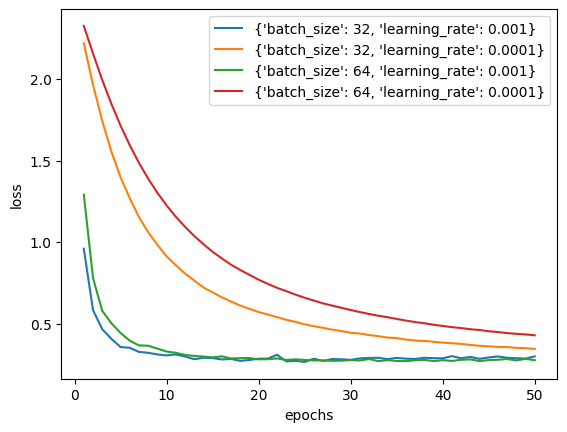

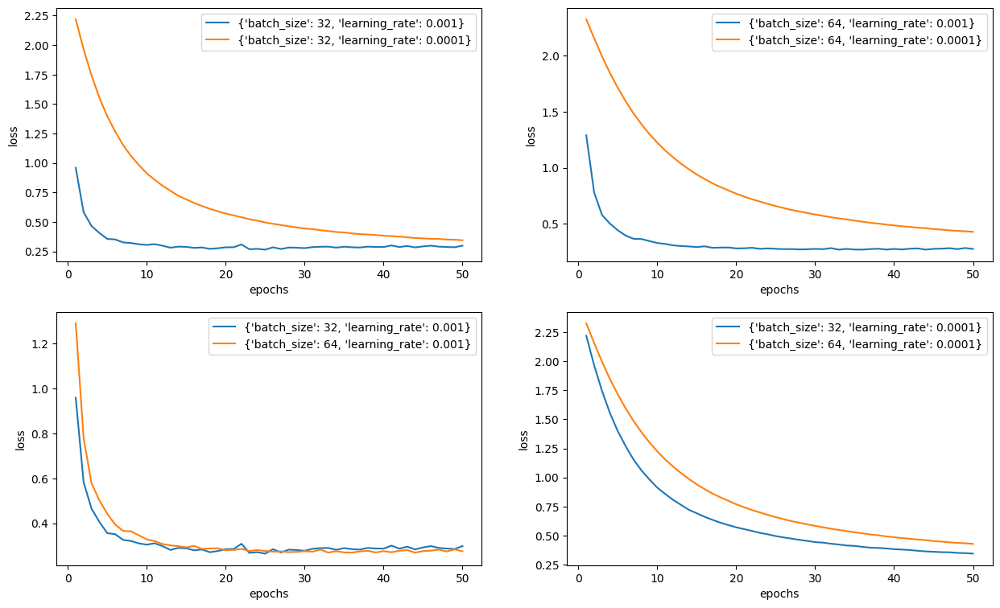


------------ Validation accuracy per epoch at ------------


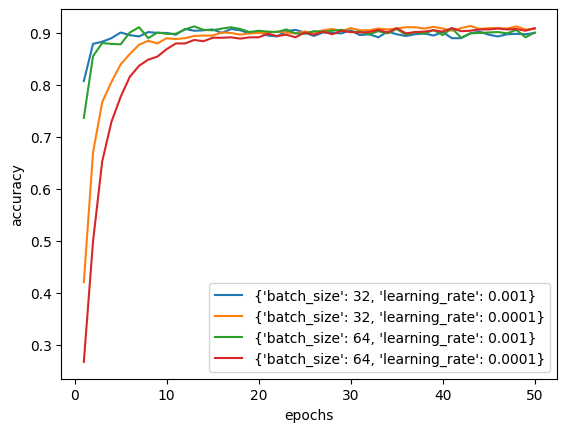

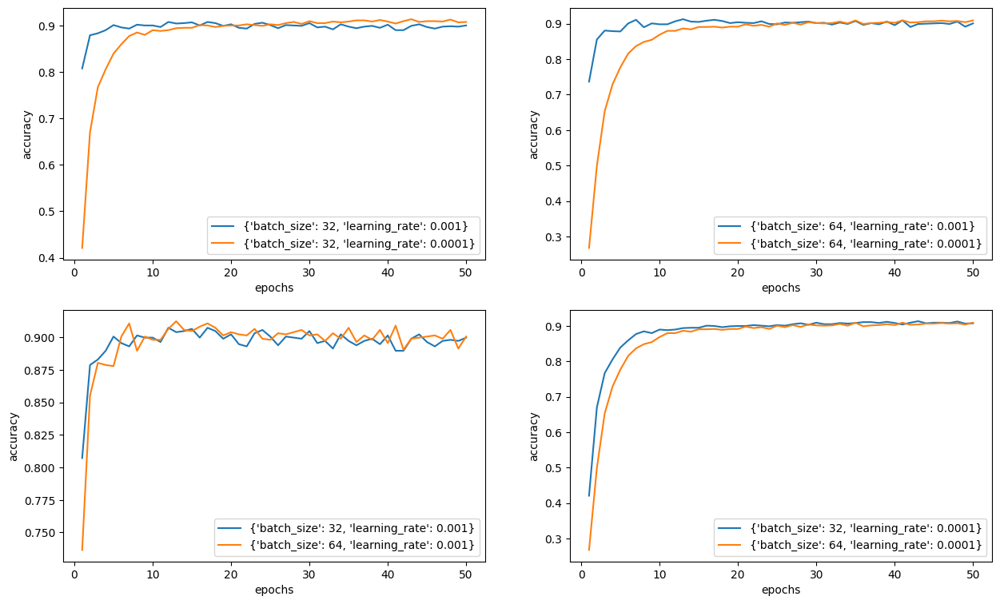

In [59]:
# get the best cross validation result
best_cv_result = get_best_cv_result(cv_history)

print('\n------------ Best cross validation result ------------')
print(best_cv_result)

plot_cv_result(cv_history)

### Training on full training data

The final model is retrained on full training data using the best parameters.

In [60]:
resnet50, train_history = train(resnet50, best_cv_result['epoch'],
                             best_cv_result['params']['batch_size'],
                             best_cv_result['params']['learning_rate'],
                             init_state)

Training > training data size: 1188

Epoch 1/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 1/25 > loss: 1.6173 - acc: 54.8822% - Time: 6.9898s

Epoch 2/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 2/25 > loss: 0.6812 - acc: 85.5219% - Time: 6.7766s

Epoch 3/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 3/25 > loss: 0.4895 - acc: 88.2155% - Time: 6.7835s

Epoch 4/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 4/25 > loss: 0.4062 - acc: 88.8047% - Time: 6.7632s

Epoch 5/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 5/25 > loss: 0.3063 - acc: 92.4242% - Time: 6.7400s

Epoch 6/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 6/25 > loss: 0.2743 - acc: 92.9293% - Time: 6.8275s

Epoch 7/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 7/25 > loss: 0.2680 - acc: 92.2559% - Time: 6.8016s

Epoch 8/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 8/25 > loss: 0.2435 - acc: 94.0236% - Time: 6.8845s

Epoch 9/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 9/25 > loss: 0.2102 - acc: 94.6970% - Time: 6.8447s

Epoch 10/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 10/25 > loss: 0.1893 - acc: 95.5387% - Time: 6.7395s

Epoch 11/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 11/25 > loss: 0.1835 - acc: 95.6229% - Time: 6.6529s

Epoch 12/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 12/25 > loss: 0.1585 - acc: 96.4646% - Time: 6.6061s

Epoch 13/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 13/25 > loss: 0.1798 - acc: 94.6128% - Time: 6.6641s

Epoch 14/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 14/25 > loss: 0.1858 - acc: 94.1919% - Time: 6.6752s

Epoch 15/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 15/25 > loss: 0.1227 - acc: 97.3906% - Time: 6.6548s

Epoch 16/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 16/25 > loss: 0.1312 - acc: 96.8855% - Time: 6.6573s

Epoch 17/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 17/25 > loss: 0.1249 - acc: 97.1380% - Time: 6.6434s

Epoch 18/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 18/25 > loss: 0.1369 - acc: 96.8013% - Time: 6.6340s

Epoch 19/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 19/25 > loss: 0.1203 - acc: 97.2222% - Time: 6.6762s

Epoch 20/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 20/25 > loss: 0.1095 - acc: 97.5589% - Time: 6.6627s

Epoch 21/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 21/25 > loss: 0.0891 - acc: 98.5690% - Time: 6.7613s

Epoch 22/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 22/25 > loss: 0.1057 - acc: 97.6431% - Time: 6.8624s

Epoch 23/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 23/25 > loss: 0.1524 - acc: 95.5387% - Time: 6.6881s

Epoch 24/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 24/25 > loss: 0.1000 - acc: 97.9798% - Time: 6.8018s

Epoch 25/25


Training:   0%|          | 0/38 [00:00<?, ?it/s]

End Epoch 25/25 > loss: 0.0944 - acc: 97.7273% - Time: 6.7006s
End Train > time: 168.4924s



### Result of training

loss : 0.09442473360986421
acc : 97.72727272727273


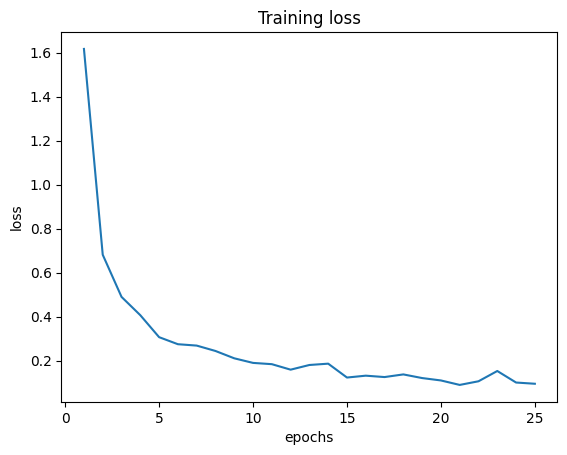

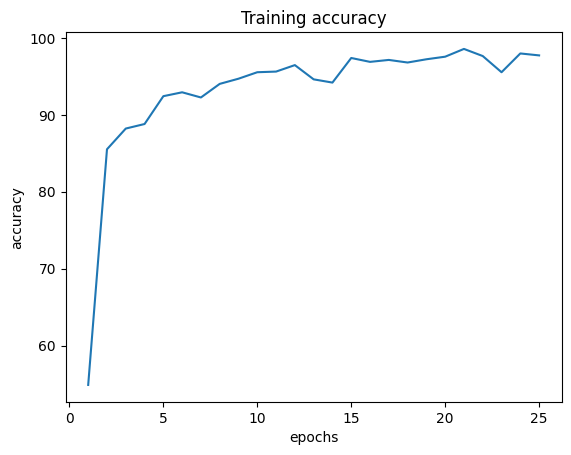

In [61]:
print('loss :',train_history[-1]['avg_train_loss'])
print('acc :',train_history[-1]['avg_train_acc']*100)

plot_train_result(train_history)

### Testing

In [62]:
results = test(resnet50, calc_top3_acc=True)
loss = results[0]
acc = results[1]
cm = results[2]
top3_acc = results[3]

Test data size : 1183 



Testing:   0%|          | 0/37 [00:00<?, ?it/s]


Result > loss: 0.4392 - acc: 85.8833% - time: 6.3291s


Result > top3_acc: 97.7177% 



### Result of testing

loss : 0.4392125998022994
acc : 85.88334735630934
average fscore: 85.8244514395189
top3 acc : 97.71766694843618

------------ Confusion Matrix ------------


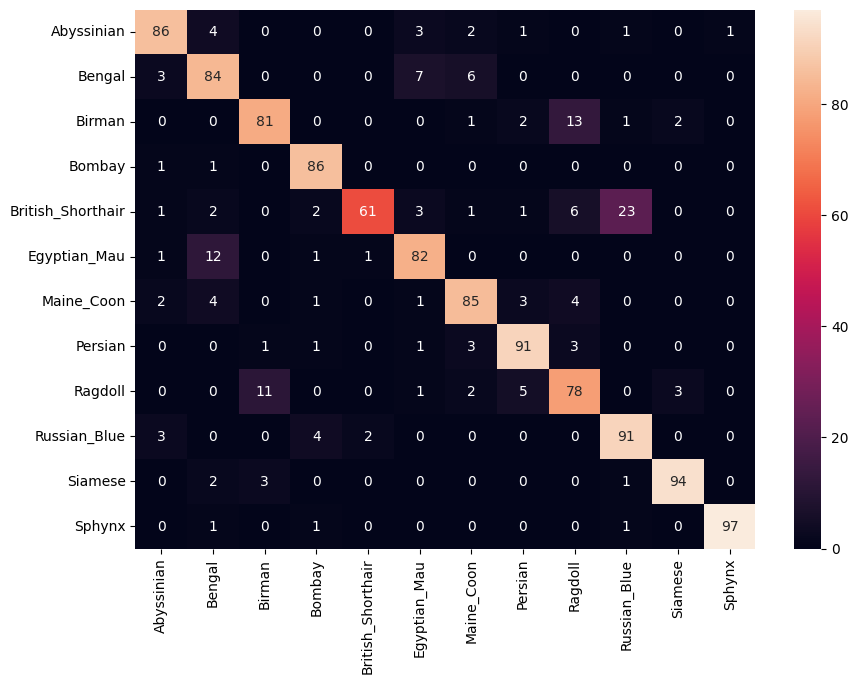


------------ FScore per class ------------


,fscore
Abyssinian,0.882051
Bengal,0.800000
Birman,0.826531
Bombay,0.934783
British_Shorthair,0.743902
Egyptian_Mau,0.841026
Maine_Coon,0.850000
Persian,0.896552
Ragdoll,0.764706
Russian_Blue,0.834862


In [63]:
recall = cm.diagonal()/cm.sum(axis=1)
precision = cm.diagonal()/cm.sum(axis=0)
fscore = 2*precision*recall/(precision+recall)

print('loss :', loss)
print('acc :',acc*100)
print('average fscore:',np.average(fscore)*100)
print('top3 acc :',top3_acc)

print('\n------------ Confusion Matrix ------------')

df_cm = pd.DataFrame(cm, index = data['test'].class_to_idx.keys(),
                  columns = data['test'].class_to_idx.keys())
plt.figure(figsize = (10,7))
sn.heatmap(df_cm, annot=True)
plt.show()

print('\n------------ FScore per class ------------')

pd.DataFrame(fscore,index = data['test'].class_to_idx.keys(),columns=['fscore'])

### Save the model

In [66]:
# !mkdir ../model
save_model_state(resnet50, '../model/resnet50-model.pth')

## ResNet-50 with image augmentation

### Build the network

In [6]:
resnet50 = None

resnet50 = torchvision.models.resnet50(pretrained=True)

# freeze model parameters
for param in resnet50.parameters():
    param.requires_grad = False
    
# change the final layer of ResNet50 model for transfer learning
fc_inputs = resnet50.fc.in_features
resnet50.fc = nn.Sequential(
    nn.Linear(fc_inputs, 12),
    nn.LogSoftmax(dim=1) # For using NLLLoss()
)
# move the model to a device
resnet50 = resnet50.to(device)

# copy initial state, used for retraining later
init_state = copy.deepcopy(resnet50.state_dict())

### Perform grid search & cross validation

In [68]:
cv_history = grid_search_cv(resnet50, k_fold=5, epochs=50, hyperparameters={'batch_size':[32,64],'learning_rate' : [1e-03, 1e-04]}, transforms=augmented_image_transforms)

Hyperparameters 1/4 > bs: 32 - lr: 0.001
Fold 1/5 > training data size: 950 - validation data size: 238

Epoch 1/50
Training Batch 000 > loss: 2.4446027278900146 - acc: 0.3125
Training Batch 001 > loss: 2.4973998069763184 - acc: 0.125
Training Batch 002 > loss: 2.4717912673950195 - acc: 0.15625
Training Batch 003 > loss: 2.4843969345092773 - acc: 0.21875
Training Batch 004 > loss: 2.236452579498291 - acc: 0.25
Training Batch 005 > loss: 2.292558193206787 - acc: 0.21875
Training Batch 006 > loss: 2.4063236713409424 - acc: 0.46875
Training Batch 007 > loss: 2.074337959289551 - acc: 0.375
Training Batch 008 > loss: 1.9121155738830566 - acc: 0.3125
Training Batch 009 > loss: 1.9361604452133179 - acc: 0.28125
Training Batch 010 > loss: 1.864129662513733 - acc: 0.40625
Training Batch 011 > loss: 1.6174838542938232 - acc: 0.65625
Training Batch 012 > loss: 1.7756140232086182 - acc: 0.5
Training Batch 013 > loss: 1.5549601316452026 - acc: 0.5625
Training Batch 014 > loss: 1.8612116575241089 - 

Training Batch 015 > loss: 0.46143198013305664 - acc: 0.90625
Training Batch 016 > loss: 0.33916816115379333 - acc: 0.875
Training Batch 017 > loss: 0.18491366505622864 - acc: 0.96875
Training Batch 018 > loss: 0.15704655647277832 - acc: 1.0
Training Batch 019 > loss: 0.3237636387348175 - acc: 0.9375
Training Batch 020 > loss: 0.15230554342269897 - acc: 1.0
Training Batch 021 > loss: 0.4810890257358551 - acc: 0.84375
Training Batch 022 > loss: 0.31219425797462463 - acc: 0.9375
Training Batch 023 > loss: 0.24398231506347656 - acc: 0.9375
Training Batch 024 > loss: 0.31612086296081543 - acc: 0.90625
Training Batch 025 > loss: 0.2775436043739319 - acc: 0.96875
Training Batch 026 > loss: 0.2526278495788574 - acc: 0.9375
Training Batch 027 > loss: 0.20802292227745056 - acc: 1.0
Training Batch 028 > loss: 0.19759275019168854 - acc: 0.9375
Training Batch 029 > loss: 0.21667639911174774 - acc: 0.9523809552192688
Validation Batch 000 > valid_loss: 0.2743561863899231, valid_acc: 0.90625
Validati

Training Batch 023 > loss: 0.22002163529396057 - acc: 0.9375
Training Batch 024 > loss: 0.20836319029331207 - acc: 0.96875
Training Batch 025 > loss: 0.1605316400527954 - acc: 1.0
Training Batch 026 > loss: 0.13529440760612488 - acc: 0.96875
Training Batch 027 > loss: 0.22834551334381104 - acc: 0.9375
Training Batch 028 > loss: 0.21946094930171967 - acc: 0.9375
Training Batch 029 > loss: 0.26255932450294495 - acc: 0.9523809552192688
Validation Batch 000 > valid_loss: 0.3364987075328827, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.2536364793777466, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.38820263743400574, valid_acc: 0.84375
Validation Batch 003 > valid_loss: 0.3728176951408386, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.42842453718185425, valid_acc: 0.8125
Validation Batch 005 > valid_loss: 0.24471403658390045, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.4215274453163147, valid_acc: 0.84375
Validation Batch 007 > valid_loss: 0.1816460

Validation Batch 001 > valid_loss: 0.1909884512424469, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.3911572992801666, valid_acc: 0.84375
Validation Batch 003 > valid_loss: 0.32071250677108765, valid_acc: 0.875
Validation Batch 004 > valid_loss: 0.36589083075523376, valid_acc: 0.8125
Validation Batch 005 > valid_loss: 0.21683913469314575, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.4219350218772888, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 0.4387816786766052, valid_acc: 0.8666666746139526
End Epoch 13/50 > loss: 0.1481023768416446 - acc: 97.04952581664911% - valid_loss: 0.3257833188048965 - valid_acc: 88.28451887833025% - Time: 9.9457s

Epoch 14/50
Training Batch 000 > loss: 0.22974254190921783 - acc: 0.96875
Training Batch 001 > loss: 0.15292032063007355 - acc: 1.0
Training Batch 002 > loss: 0.14405971765518188 - acc: 0.96875
Training Batch 003 > loss: 0.10599397122859955 - acc: 1.0
Training Batch 004 > loss: 0.25134503841400146 - acc: 0.90625
Trainin

Training Batch 000 > loss: 0.0912085548043251 - acc: 0.96875
Training Batch 001 > loss: 0.09841890633106232 - acc: 1.0
Training Batch 002 > loss: 0.130607470870018 - acc: 1.0
Training Batch 003 > loss: 0.09559906274080276 - acc: 1.0
Training Batch 004 > loss: 0.06573120504617691 - acc: 1.0
Training Batch 005 > loss: 0.11782024800777435 - acc: 1.0
Training Batch 006 > loss: 0.13241633772850037 - acc: 0.9375
Training Batch 007 > loss: 0.11094097793102264 - acc: 1.0
Training Batch 008 > loss: 0.08612558990716934 - acc: 1.0
Training Batch 009 > loss: 0.07519997656345367 - acc: 0.96875
Training Batch 010 > loss: 0.1009373888373375 - acc: 1.0
Training Batch 011 > loss: 0.16167910397052765 - acc: 0.96875
Training Batch 012 > loss: 0.06336682289838791 - acc: 1.0
Training Batch 013 > loss: 0.11100476235151291 - acc: 1.0
Training Batch 014 > loss: 0.0989953950047493 - acc: 0.96875
Training Batch 015 > loss: 0.13127562403678894 - acc: 0.96875
Training Batch 016 > loss: 0.09615583717823029 - acc: 

Training Batch 010 > loss: 0.09335076808929443 - acc: 1.0
Training Batch 011 > loss: 0.047734737396240234 - acc: 1.0
Training Batch 012 > loss: 0.1196562722325325 - acc: 0.96875
Training Batch 013 > loss: 0.11135833710432053 - acc: 1.0
Training Batch 014 > loss: 0.08735975623130798 - acc: 1.0
Training Batch 015 > loss: 0.07531478255987167 - acc: 1.0
Training Batch 016 > loss: 0.07689806818962097 - acc: 1.0
Training Batch 017 > loss: 0.06608080863952637 - acc: 1.0
Training Batch 018 > loss: 0.20284347236156464 - acc: 0.9375
Training Batch 019 > loss: 0.06883643567562103 - acc: 1.0
Training Batch 020 > loss: 0.09052306413650513 - acc: 1.0
Training Batch 021 > loss: 0.08306755870580673 - acc: 1.0
Training Batch 022 > loss: 0.1237233355641365 - acc: 1.0
Training Batch 023 > loss: 0.11168089509010315 - acc: 0.96875
Training Batch 024 > loss: 0.07484420388936996 - acc: 1.0
Training Batch 025 > loss: 0.22424675524234772 - acc: 0.90625
Training Batch 026 > loss: 0.0802859365940094 - acc: 1.0
T

Training Batch 019 > loss: 0.06104057654738426 - acc: 1.0
Training Batch 020 > loss: 0.09602157771587372 - acc: 0.9375
Training Batch 021 > loss: 0.13870935142040253 - acc: 0.96875
Training Batch 022 > loss: 0.06126883253455162 - acc: 1.0
Training Batch 023 > loss: 0.07249993830919266 - acc: 1.0
Training Batch 024 > loss: 0.2527828812599182 - acc: 0.875
Training Batch 025 > loss: 0.06684564799070358 - acc: 1.0
Training Batch 026 > loss: 0.09184879809617996 - acc: 1.0
Training Batch 027 > loss: 0.04363660514354706 - acc: 1.0
Training Batch 028 > loss: 0.051105596125125885 - acc: 1.0
Training Batch 029 > loss: 0.05156134441494942 - acc: 1.0
Validation Batch 000 > valid_loss: 0.5339322686195374, valid_acc: 0.8125
Validation Batch 001 > valid_loss: 0.2219485640525818, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.26736772060394287, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.186793714761734, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.47102296352386475, valid_

Validation Batch 000 > valid_loss: 0.10864873230457306, valid_acc: 0.96875
Validation Batch 001 > valid_loss: 0.3764899969100952, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.48707112669944763, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.35471561551094055, valid_acc: 0.84375
Validation Batch 004 > valid_loss: 0.3365969657897949, valid_acc: 0.84375
Validation Batch 005 > valid_loss: 0.451927125453949, valid_acc: 0.84375
Validation Batch 006 > valid_loss: 0.24002128839492798, valid_acc: 0.875
Validation Batch 007 > valid_loss: 0.5599192976951599, valid_acc: 0.800000011920929
End Epoch 26/50 > loss: 0.0854571002277421 - acc: 98.31401475237091% - valid_loss: 0.35051822886806155 - valid_acc: 87.44769881958742% - Time: 10.0015s

Epoch 27/50
Training Batch 000 > loss: 0.08362249284982681 - acc: 1.0
Training Batch 001 > loss: 0.031063873320817947 - acc: 1.0
Training Batch 002 > loss: 0.08993372321128845 - acc: 0.96875
Training Batch 003 > loss: 0.06535942852497101 - acc: 1

Training Batch 000 > loss: 0.04759460315108299 - acc: 1.0
Training Batch 001 > loss: 0.07139232754707336 - acc: 0.96875
Training Batch 002 > loss: 0.03599598631262779 - acc: 1.0
Training Batch 003 > loss: 0.035458918660879135 - acc: 1.0
Training Batch 004 > loss: 0.16240206360816956 - acc: 0.96875
Training Batch 005 > loss: 0.05911675840616226 - acc: 0.96875
Training Batch 006 > loss: 0.05455166473984718 - acc: 1.0
Training Batch 007 > loss: 0.0718652755022049 - acc: 1.0
Training Batch 008 > loss: 0.07787339389324188 - acc: 0.96875
Training Batch 009 > loss: 0.059062354266643524 - acc: 1.0
Training Batch 010 > loss: 0.0658222958445549 - acc: 1.0
Training Batch 011 > loss: 0.08031091094017029 - acc: 1.0
Training Batch 012 > loss: 0.08419418334960938 - acc: 1.0
Training Batch 013 > loss: 0.030708814039826393 - acc: 1.0
Training Batch 014 > loss: 0.022254789248108864 - acc: 1.0
Training Batch 015 > loss: 0.07084643840789795 - acc: 1.0
Training Batch 016 > loss: 0.06234436854720116 - acc: 

Training Batch 010 > loss: 0.02974972315132618 - acc: 1.0
Training Batch 011 > loss: 0.13063304126262665 - acc: 0.96875
Training Batch 012 > loss: 0.028539204970002174 - acc: 1.0
Training Batch 013 > loss: 0.047980450093746185 - acc: 1.0
Training Batch 014 > loss: 0.062156274914741516 - acc: 1.0
Training Batch 015 > loss: 0.07717042416334152 - acc: 0.9375
Training Batch 016 > loss: 0.0696367621421814 - acc: 1.0
Training Batch 017 > loss: 0.07375039160251617 - acc: 1.0
Training Batch 018 > loss: 0.07929914444684982 - acc: 1.0
Training Batch 019 > loss: 0.030206559225916862 - acc: 1.0
Training Batch 020 > loss: 0.026327433064579964 - acc: 1.0
Training Batch 021 > loss: 0.07332701981067657 - acc: 0.96875
Training Batch 022 > loss: 0.025202160701155663 - acc: 1.0
Training Batch 023 > loss: 0.03748565539717674 - acc: 1.0
Training Batch 024 > loss: 0.09320148825645447 - acc: 0.9375
Training Batch 025 > loss: 0.06802505999803543 - acc: 1.0
Training Batch 026 > loss: 0.07391167432069778 - acc:

Training Batch 020 > loss: 0.10706089437007904 - acc: 0.96875
Training Batch 021 > loss: 0.0500776544213295 - acc: 1.0
Training Batch 022 > loss: 0.02671046555042267 - acc: 1.0
Training Batch 023 > loss: 0.05323175713419914 - acc: 1.0
Training Batch 024 > loss: 0.05474285036325455 - acc: 0.96875
Training Batch 025 > loss: 0.046651020646095276 - acc: 0.96875
Training Batch 026 > loss: 0.06128339096903801 - acc: 0.96875
Training Batch 027 > loss: 0.137227401137352 - acc: 0.9375
Training Batch 028 > loss: 0.03183355554938316 - acc: 1.0
Training Batch 029 > loss: 0.029395384714007378 - acc: 1.0
Validation Batch 000 > valid_loss: 0.2355218380689621, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.4536232352256775, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.1484205424785614, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.691935122013092, valid_acc: 0.8125
Validation Batch 004 > valid_loss: 0.27275317907333374, valid_acc: 0.875
Validation Batch 005 > valid_loss: 0.

Validation Batch 000 > valid_loss: 0.38225847482681274, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.25995883345603943, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.15253807604312897, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 0.25207778811454773, valid_acc: 0.875
Validation Batch 004 > valid_loss: 0.6631464958190918, valid_acc: 0.8125
Validation Batch 005 > valid_loss: 0.16308006644248962, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.5122811198234558, valid_acc: 0.8125
Validation Batch 007 > valid_loss: 0.10567455738782883, valid_acc: 0.9333333373069763
End Epoch 39/50 > loss: 0.04646862328083925 - acc: 99.26238145416228% - valid_loss: 0.3260084757557973 - valid_acc: 88.70292889523206% - Time: 9.9884s

Epoch 40/50
Training Batch 000 > loss: 0.047002434730529785 - acc: 1.0
Training Batch 001 > loss: 0.07256311178207397 - acc: 1.0
Training Batch 002 > loss: 0.029132112860679626 - acc: 1.0
Training Batch 003 > loss: 0.051031507551670074 - acc: 1.0
T

Training Batch 000 > loss: 0.02516663447022438 - acc: 1.0
Training Batch 001 > loss: 0.03092246875166893 - acc: 1.0
Training Batch 002 > loss: 0.03868967294692993 - acc: 1.0
Training Batch 003 > loss: 0.04430878162384033 - acc: 0.96875
Training Batch 004 > loss: 0.10500951111316681 - acc: 0.90625
Training Batch 005 > loss: 0.029842831194400787 - acc: 1.0
Training Batch 006 > loss: 0.03603385388851166 - acc: 1.0
Training Batch 007 > loss: 0.037739288061857224 - acc: 1.0
Training Batch 008 > loss: 0.056610964238643646 - acc: 1.0
Training Batch 009 > loss: 0.038795508444309235 - acc: 1.0
Training Batch 010 > loss: 0.027340136468410492 - acc: 1.0
Training Batch 011 > loss: 0.04394882917404175 - acc: 1.0
Training Batch 012 > loss: 0.02423277497291565 - acc: 1.0
Training Batch 013 > loss: 0.04013710469007492 - acc: 1.0
Training Batch 014 > loss: 0.022461850196123123 - acc: 1.0
Training Batch 015 > loss: 0.10324937105178833 - acc: 0.9375
Training Batch 016 > loss: 0.040074389427900314 - acc: 

Training Batch 011 > loss: 0.05455009639263153 - acc: 1.0
Training Batch 012 > loss: 0.023205740377306938 - acc: 1.0
Training Batch 013 > loss: 0.04109391197562218 - acc: 1.0
Training Batch 014 > loss: 0.04283783584833145 - acc: 1.0
Training Batch 015 > loss: 0.11499438434839249 - acc: 0.96875
Training Batch 016 > loss: 0.07532913237810135 - acc: 1.0
Training Batch 017 > loss: 0.030581075698137283 - acc: 1.0
Training Batch 018 > loss: 0.02045144885778427 - acc: 1.0
Training Batch 019 > loss: 0.047682780772447586 - acc: 1.0
Training Batch 020 > loss: 0.033604223281145096 - acc: 1.0
Training Batch 021 > loss: 0.043803274631500244 - acc: 1.0
Training Batch 022 > loss: 0.02703149802982807 - acc: 1.0
Training Batch 023 > loss: 0.06109090894460678 - acc: 1.0
Training Batch 024 > loss: 0.021248867735266685 - acc: 1.0
Training Batch 025 > loss: 0.11432379484176636 - acc: 0.9375
Training Batch 026 > loss: 0.022217322140932083 - acc: 1.0
Training Batch 027 > loss: 0.10457772016525269 - acc: 0.96

Training Batch 022 > loss: 0.015845315530896187 - acc: 1.0
Training Batch 023 > loss: 0.039862245321273804 - acc: 0.96875
Training Batch 024 > loss: 0.021181795746088028 - acc: 1.0
Training Batch 025 > loss: 0.026618625968694687 - acc: 1.0
Training Batch 026 > loss: 0.03881407156586647 - acc: 1.0
Training Batch 027 > loss: 0.035141222178936005 - acc: 1.0
Training Batch 028 > loss: 0.18472450971603394 - acc: 0.9375
Training Batch 029 > loss: 0.05195152759552002 - acc: 1.0
Validation Batch 000 > valid_loss: 0.5678677558898926, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.187112495303154, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.33307939767837524, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.26957467198371887, valid_acc: 0.875
Validation Batch 004 > valid_loss: 0.4180334508419037, valid_acc: 0.8125
Validation Batch 005 > valid_loss: 0.601546049118042, valid_acc: 0.8125
Validation Batch 006 > valid_loss: 0.2003539502620697, valid_acc: 0.9375
Validation Bat

Validation Batch 000 > valid_loss: 0.7303248643875122, valid_acc: 0.6875
Validation Batch 001 > valid_loss: 0.5417908430099487, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.4288938045501709, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 0.6577348113059998, valid_acc: 0.84375
Validation Batch 004 > valid_loss: 0.6490151882171631, valid_acc: 0.875
Validation Batch 005 > valid_loss: 0.6066393256187439, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.4657983183860779, valid_acc: 0.9375
Validation Batch 007 > valid_loss: 0.6738888621330261, valid_acc: 0.7857142686843872
End Epoch 2/50 > loss: 0.7355275771492406 - acc: 86.21052630324112% - valid_loss: 0.5882384581726139 - valid_acc: 86.97478981579052% - Time: 9.9524s

Epoch 3/50
Training Batch 000 > loss: 0.6235508918762207 - acc: 0.84375
Training Batch 001 > loss: 0.5845637321472168 - acc: 0.875
Training Batch 002 > loss: 0.5388314127922058 - acc: 0.875
Training Batch 003 > loss: 0.6204215288162231 - acc: 0.875
Trai

Training Batch 000 > loss: 0.42637383937835693 - acc: 0.84375
Training Batch 001 > loss: 0.2955680787563324 - acc: 0.96875
Training Batch 002 > loss: 0.3198012709617615 - acc: 0.9375
Training Batch 003 > loss: 0.4508078694343567 - acc: 0.875
Training Batch 004 > loss: 0.1938515156507492 - acc: 1.0
Training Batch 005 > loss: 0.19062486290931702 - acc: 1.0
Training Batch 006 > loss: 0.3093215525150299 - acc: 0.9375
Training Batch 007 > loss: 0.27826350927352905 - acc: 0.96875
Training Batch 008 > loss: 0.3384406864643097 - acc: 0.9375
Training Batch 009 > loss: 0.2858465611934662 - acc: 0.875
Training Batch 010 > loss: 0.3418981730937958 - acc: 0.90625
Training Batch 011 > loss: 0.3308429718017578 - acc: 0.875
Training Batch 012 > loss: 0.26543962955474854 - acc: 0.9375
Training Batch 013 > loss: 0.3270862400531769 - acc: 0.875
Training Batch 014 > loss: 0.19729818403720856 - acc: 0.96875
Training Batch 015 > loss: 0.30081993341445923 - acc: 0.9375
Training Batch 016 > loss: 0.2017045617

Training Batch 008 > loss: 0.1885988712310791 - acc: 0.96875
Training Batch 009 > loss: 0.13340240716934204 - acc: 1.0
Training Batch 010 > loss: 0.14715413749217987 - acc: 0.96875
Training Batch 011 > loss: 0.12219088524580002 - acc: 1.0
Training Batch 012 > loss: 0.16921034455299377 - acc: 0.9375
Training Batch 013 > loss: 0.233528271317482 - acc: 0.9375
Training Batch 014 > loss: 0.21163533627986908 - acc: 0.90625
Training Batch 015 > loss: 0.19875375926494598 - acc: 0.96875
Training Batch 016 > loss: 0.21380218863487244 - acc: 0.96875
Training Batch 017 > loss: 0.19440627098083496 - acc: 1.0
Training Batch 018 > loss: 0.21320325136184692 - acc: 0.96875
Training Batch 019 > loss: 0.1985822170972824 - acc: 0.96875
Training Batch 020 > loss: 0.13137277960777283 - acc: 0.9375
Training Batch 021 > loss: 0.21364474296569824 - acc: 0.9375
Training Batch 022 > loss: 0.14303342998027802 - acc: 0.96875
Training Batch 023 > loss: 0.20746776461601257 - acc: 0.90625
Training Batch 024 > loss: 0

Training Batch 016 > loss: 0.15688809752464294 - acc: 0.96875
Training Batch 017 > loss: 0.14542192220687866 - acc: 0.96875
Training Batch 018 > loss: 0.15769824385643005 - acc: 1.0
Training Batch 019 > loss: 0.20033982396125793 - acc: 0.9375
Training Batch 020 > loss: 0.2541303038597107 - acc: 0.90625
Training Batch 021 > loss: 0.24079391360282898 - acc: 0.96875
Training Batch 022 > loss: 0.11939027160406113 - acc: 1.0
Training Batch 023 > loss: 0.1457912176847458 - acc: 0.96875
Training Batch 024 > loss: 0.12328704446554184 - acc: 1.0
Training Batch 025 > loss: 0.10445825755596161 - acc: 1.0
Training Batch 026 > loss: 0.20830880105495453 - acc: 0.90625
Training Batch 027 > loss: 0.16012907028198242 - acc: 0.9375
Training Batch 028 > loss: 0.18331053853034973 - acc: 1.0
Training Batch 029 > loss: 0.12024693936109543 - acc: 1.0
Validation Batch 000 > valid_loss: 0.36442404985427856, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.1587570309638977, valid_acc: 0.96875
Validation Ba

Training Batch 025 > loss: 0.17393746972084045 - acc: 0.9375
Training Batch 026 > loss: 0.1697479784488678 - acc: 0.9375
Training Batch 027 > loss: 0.20064762234687805 - acc: 0.9375
Training Batch 028 > loss: 0.133866548538208 - acc: 1.0
Training Batch 029 > loss: 0.23685216903686523 - acc: 0.8636363744735718
Validation Batch 000 > valid_loss: 0.3177400231361389, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.2537764310836792, valid_acc: 0.84375
Validation Batch 002 > valid_loss: 0.17794114351272583, valid_acc: 0.96875
Validation Batch 003 > valid_loss: 0.3000260889530182, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.42816126346588135, valid_acc: 0.84375
Validation Batch 005 > valid_loss: 0.15733709931373596, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.44660747051239014, valid_acc: 0.8125
Validation Batch 007 > valid_loss: 0.2988990247249603, valid_acc: 0.9285714030265808
End Epoch 15/50 > loss: 0.13836821505897923 - acc: 96.94736844614933% - valid_loss: 0.

Validation Batch 003 > valid_loss: 0.27672648429870605, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.159395232796669, valid_acc: 0.96875
Validation Batch 005 > valid_loss: 0.37478169798851013, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.2942565083503723, valid_acc: 0.875
Validation Batch 007 > valid_loss: 0.11551107466220856, valid_acc: 1.0
End Epoch 18/50 > loss: 0.11126791085067549 - acc: 98.21052631578947% - valid_loss: 0.30350901486993836 - valid_acc: 89.07563025210085% - Time: 9.9005s

Epoch 19/50
Training Batch 000 > loss: 0.11419931799173355 - acc: 0.96875
Training Batch 001 > loss: 0.10261458903551102 - acc: 0.96875
Training Batch 002 > loss: 0.06267355382442474 - acc: 1.0
Training Batch 003 > loss: 0.05540552735328674 - acc: 1.0
Training Batch 004 > loss: 0.12038865685462952 - acc: 0.96875
Training Batch 005 > loss: 0.10530390590429306 - acc: 0.96875
Training Batch 006 > loss: 0.1256067007780075 - acc: 0.96875
Training Batch 007 > loss: 0.377895057201385

Training Batch 000 > loss: 0.06229792535305023 - acc: 1.0
Training Batch 001 > loss: 0.09512414783239365 - acc: 1.0
Training Batch 002 > loss: 0.0717962384223938 - acc: 1.0
Training Batch 003 > loss: 0.08517814427614212 - acc: 0.96875
Training Batch 004 > loss: 0.04936577379703522 - acc: 1.0
Training Batch 005 > loss: 0.06751848012208939 - acc: 1.0
Training Batch 006 > loss: 0.1397016942501068 - acc: 0.96875
Training Batch 007 > loss: 0.06072433665394783 - acc: 1.0
Training Batch 008 > loss: 0.05636937916278839 - acc: 1.0
Training Batch 009 > loss: 0.06086014211177826 - acc: 1.0
Training Batch 010 > loss: 0.0631045326590538 - acc: 1.0
Training Batch 011 > loss: 0.06761693954467773 - acc: 1.0
Training Batch 012 > loss: 0.08838563412427902 - acc: 0.96875
Training Batch 013 > loss: 0.09826032817363739 - acc: 0.96875
Training Batch 014 > loss: 0.06250166893005371 - acc: 1.0
Training Batch 015 > loss: 0.11884477734565735 - acc: 1.0
Training Batch 016 > loss: 0.082707978785038 - acc: 0.96875

Training Batch 010 > loss: 0.06629446148872375 - acc: 1.0
Training Batch 011 > loss: 0.06580118834972382 - acc: 1.0
Training Batch 012 > loss: 0.10047322511672974 - acc: 0.96875
Training Batch 013 > loss: 0.05794047191739082 - acc: 1.0
Training Batch 014 > loss: 0.08250659704208374 - acc: 0.96875
Training Batch 015 > loss: 0.08315951377153397 - acc: 1.0
Training Batch 016 > loss: 0.04246717318892479 - acc: 1.0
Training Batch 017 > loss: 0.07918579876422882 - acc: 1.0
Training Batch 018 > loss: 0.07765928655862808 - acc: 1.0
Training Batch 019 > loss: 0.0466298833489418 - acc: 1.0
Training Batch 020 > loss: 0.06885208934545517 - acc: 0.96875
Training Batch 021 > loss: 0.056764326989650726 - acc: 0.96875
Training Batch 022 > loss: 0.10183483362197876 - acc: 1.0
Training Batch 023 > loss: 0.10567006468772888 - acc: 0.96875
Training Batch 024 > loss: 0.06545884907245636 - acc: 1.0
Training Batch 025 > loss: 0.09261936694383621 - acc: 0.96875
Training Batch 026 > loss: 0.10092762857675552 -

Training Batch 020 > loss: 0.046274226158857346 - acc: 1.0
Training Batch 021 > loss: 0.0708959624171257 - acc: 1.0
Training Batch 022 > loss: 0.08888766169548035 - acc: 1.0
Training Batch 023 > loss: 0.08070437610149384 - acc: 1.0
Training Batch 024 > loss: 0.050611674785614014 - acc: 1.0
Training Batch 025 > loss: 0.04141486436128616 - acc: 1.0
Training Batch 026 > loss: 0.08277516812086105 - acc: 0.9375
Training Batch 027 > loss: 0.05381011962890625 - acc: 1.0
Training Batch 028 > loss: 0.07810487598180771 - acc: 1.0
Training Batch 029 > loss: 0.05515805259346962 - acc: 1.0
Validation Batch 000 > valid_loss: 0.30160707235336304, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.2263004630804062, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.3439147472381592, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.21895702183246613, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.646240234375, valid_acc: 0.78125
Validation Batch 005 > valid_loss: 0.2049296647310257

Validation Batch 000 > valid_loss: 0.3103533387184143, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 0.4354878067970276, valid_acc: 0.84375
Validation Batch 002 > valid_loss: 0.301121324300766, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.29739803075790405, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.15570068359375, valid_acc: 0.9375
Validation Batch 005 > valid_loss: 0.37097999453544617, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.16209161281585693, valid_acc: 0.9375
Validation Batch 007 > valid_loss: 0.05679036304354668, valid_acc: 1.0
End Epoch 31/50 > loss: 0.05713296535768007 - acc: 99.36842101498654% - valid_loss: 0.27670300172782747 - valid_acc: 90.75630252100841% - Time: 9.9356s

Epoch 32/50
Training Batch 000 > loss: 0.08647892624139786 - acc: 0.96875
Training Batch 001 > loss: 0.06382080912590027 - acc: 0.96875
Training Batch 002 > loss: 0.04641594737768173 - acc: 1.0
Training Batch 003 > loss: 0.04071781039237976 - acc: 1.0
Training 

Training Batch 000 > loss: 0.04641839861869812 - acc: 1.0
Training Batch 001 > loss: 0.05344463512301445 - acc: 1.0
Training Batch 002 > loss: 0.0547281838953495 - acc: 1.0
Training Batch 003 > loss: 0.11208087205886841 - acc: 0.96875
Training Batch 004 > loss: 0.03678053244948387 - acc: 1.0
Training Batch 005 > loss: 0.051447175443172455 - acc: 1.0
Training Batch 006 > loss: 0.07128512859344482 - acc: 0.96875
Training Batch 007 > loss: 0.027744680643081665 - acc: 1.0
Training Batch 008 > loss: 0.052888914942741394 - acc: 1.0
Training Batch 009 > loss: 0.03150174021720886 - acc: 1.0
Training Batch 010 > loss: 0.04553293064236641 - acc: 1.0
Training Batch 011 > loss: 0.026470184326171875 - acc: 1.0
Training Batch 012 > loss: 0.06444573402404785 - acc: 1.0
Training Batch 013 > loss: 0.07123148441314697 - acc: 1.0
Training Batch 014 > loss: 0.03905486688017845 - acc: 1.0
Training Batch 015 > loss: 0.03182126209139824 - acc: 1.0
Training Batch 016 > loss: 0.05964025855064392 - acc: 1.0
Tra

Training Batch 011 > loss: 0.051969014108181 - acc: 1.0
Training Batch 012 > loss: 0.044137731194496155 - acc: 1.0
Training Batch 013 > loss: 0.052106887102127075 - acc: 1.0
Training Batch 014 > loss: 0.03258228302001953 - acc: 1.0
Training Batch 015 > loss: 0.036356113851070404 - acc: 1.0
Training Batch 016 > loss: 0.04660104215145111 - acc: 1.0
Training Batch 017 > loss: 0.019272062927484512 - acc: 1.0
Training Batch 018 > loss: 0.08736993372440338 - acc: 0.96875
Training Batch 019 > loss: 0.03362128511071205 - acc: 1.0
Training Batch 020 > loss: 0.021059563383460045 - acc: 1.0
Training Batch 021 > loss: 0.03136821091175079 - acc: 1.0
Training Batch 022 > loss: 0.02028641849756241 - acc: 1.0
Training Batch 023 > loss: 0.039619967341423035 - acc: 1.0
Training Batch 024 > loss: 0.050012923777103424 - acc: 1.0
Training Batch 025 > loss: 0.03405675292015076 - acc: 1.0
Training Batch 026 > loss: 0.10886774212121964 - acc: 0.96875
Training Batch 027 > loss: 0.14390014111995697 - acc: 0.968

Training Batch 021 > loss: 0.05203332006931305 - acc: 1.0
Training Batch 022 > loss: 0.07513070851564407 - acc: 0.96875
Training Batch 023 > loss: 0.008063379675149918 - acc: 1.0
Training Batch 024 > loss: 0.04402187839150429 - acc: 1.0
Training Batch 025 > loss: 0.047510966658592224 - acc: 1.0
Training Batch 026 > loss: 0.017246240749955177 - acc: 1.0
Training Batch 027 > loss: 0.04852741211652756 - acc: 1.0
Training Batch 028 > loss: 0.08298053592443466 - acc: 1.0
Training Batch 029 > loss: 0.13160257041454315 - acc: 1.0
Validation Batch 000 > valid_loss: 0.2755923867225647, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 0.25867360830307007, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.3513997793197632, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 0.480610728263855, valid_acc: 0.875
Validation Batch 004 > valid_loss: 0.15604837238788605, valid_acc: 0.9375
Validation Batch 005 > valid_loss: 0.2492363154888153, valid_acc: 0.9375
Validation Batch 006 > valid_loss

Validation Batch 002 > valid_loss: 0.19336748123168945, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 0.28342097997665405, valid_acc: 0.875
Validation Batch 004 > valid_loss: 0.20160606503486633, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.40085047483444214, valid_acc: 0.84375
Validation Batch 006 > valid_loss: 0.16822870075702667, valid_acc: 0.9375
Validation Batch 007 > valid_loss: 0.6983604431152344, valid_acc: 0.8571428656578064
End Epoch 44/50 > loss: 0.03355786394131811 - acc: 99.78947368421053% - valid_loss: 0.3038097049007897 - valid_acc: 89.49579836941567% - Time: 9.9665s

Epoch 45/50
Training Batch 000 > loss: 0.07181714475154877 - acc: 0.96875
Training Batch 001 > loss: 0.05567488074302673 - acc: 0.96875
Training Batch 002 > loss: 0.1096072569489479 - acc: 0.96875
Training Batch 003 > loss: 0.04783573001623154 - acc: 1.0
Training Batch 004 > loss: 0.05158846080303192 - acc: 1.0
Training Batch 005 > loss: 0.06496315449476242 - acc: 1.0
Training Batch 006 > 

Training Batch 000 > loss: 0.06015884131193161 - acc: 1.0
Training Batch 001 > loss: 0.019313618540763855 - acc: 1.0
Training Batch 002 > loss: 0.025326479226350784 - acc: 1.0
Training Batch 003 > loss: 0.024044610559940338 - acc: 1.0
Training Batch 004 > loss: 0.01320069283246994 - acc: 1.0
Training Batch 005 > loss: 0.07581795752048492 - acc: 1.0
Training Batch 006 > loss: 0.0514855831861496 - acc: 0.96875
Training Batch 007 > loss: 0.020125921815633774 - acc: 1.0
Training Batch 008 > loss: 0.01687026023864746 - acc: 1.0
Training Batch 009 > loss: 0.03545476123690605 - acc: 1.0
Training Batch 010 > loss: 0.01331312209367752 - acc: 1.0
Training Batch 011 > loss: 0.019683394581079483 - acc: 1.0
Training Batch 012 > loss: 0.016601789742708206 - acc: 1.0
Training Batch 013 > loss: 0.035165827721357346 - acc: 1.0
Training Batch 014 > loss: 0.019142691045999527 - acc: 1.0
Training Batch 015 > loss: 0.038008447736501694 - acc: 1.0
Training Batch 016 > loss: 0.03982573747634888 - acc: 1.0
Tr

Training Batch 009 > loss: 2.128169536590576 - acc: 0.375
Training Batch 010 > loss: 1.9389121532440186 - acc: 0.375
Training Batch 011 > loss: 2.1215341091156006 - acc: 0.40625
Training Batch 012 > loss: 1.809791922569275 - acc: 0.4375
Training Batch 013 > loss: 1.5601712465286255 - acc: 0.71875
Training Batch 014 > loss: 1.7884047031402588 - acc: 0.40625
Training Batch 015 > loss: 1.5784273147583008 - acc: 0.5625
Training Batch 016 > loss: 1.6482490301132202 - acc: 0.5
Training Batch 017 > loss: 1.3884263038635254 - acc: 0.65625
Training Batch 018 > loss: 1.4613012075424194 - acc: 0.65625
Training Batch 019 > loss: 1.4298784732818604 - acc: 0.71875
Training Batch 020 > loss: 1.4981037378311157 - acc: 0.5
Training Batch 021 > loss: 1.410017728805542 - acc: 0.625
Training Batch 022 > loss: 1.4374229907989502 - acc: 0.625
Training Batch 023 > loss: 1.259666085243225 - acc: 0.6875
Training Batch 024 > loss: 1.3579990863800049 - acc: 0.5
Training Batch 025 > loss: 1.0847218036651611 - acc

Training Batch 018 > loss: 0.5953195691108704 - acc: 0.84375
Training Batch 019 > loss: 0.44759827852249146 - acc: 0.9375
Training Batch 020 > loss: 0.5112243890762329 - acc: 0.90625
Training Batch 021 > loss: 0.2951200008392334 - acc: 0.9375
Training Batch 022 > loss: 0.4407450556755066 - acc: 0.90625
Training Batch 023 > loss: 0.31153354048728943 - acc: 0.9375
Training Batch 024 > loss: 0.3730729818344116 - acc: 0.90625
Training Batch 025 > loss: 0.24011582136154175 - acc: 1.0
Training Batch 026 > loss: 0.333848774433136 - acc: 0.9375
Training Batch 027 > loss: 0.32285407185554504 - acc: 0.96875
Training Batch 028 > loss: 0.38149744272232056 - acc: 0.90625
Training Batch 029 > loss: 0.49039986729621887 - acc: 0.8181818127632141
Validation Batch 000 > valid_loss: 0.46662577986717224, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.4902828633785248, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.4611644744873047, valid_acc: 0.75
Validation Batch 003 > valid_loss: 0.32205

Training Batch 026 > loss: 0.16779011487960815 - acc: 0.96875
Training Batch 027 > loss: 0.43027156591415405 - acc: 0.84375
Training Batch 028 > loss: 0.29984039068222046 - acc: 0.9375
Training Batch 029 > loss: 0.33988067507743835 - acc: 0.8636363744735718
Validation Batch 000 > valid_loss: 0.28699666261672974, valid_acc: 0.90625
Validation Batch 001 > valid_loss: 0.3975474238395691, valid_acc: 0.78125
Validation Batch 002 > valid_loss: 0.48407915234565735, valid_acc: 0.75
Validation Batch 003 > valid_loss: 0.3143012821674347, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.3992619216442108, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.4094918370246887, valid_acc: 0.84375
Validation Batch 006 > valid_loss: 0.28113269805908203, valid_acc: 0.875
Validation Batch 007 > valid_loss: 0.3595960736274719, valid_acc: 0.9285714030265808
End Epoch 7/50 > loss: 0.25481397760541813 - acc: 94.84210528825459% - valid_loss: 0.367076875281935 - valid_acc: 86.1344536312488% - Time: 9.

Validation Batch 003 > valid_loss: 0.2569829225540161, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.4128117859363556, valid_acc: 0.8125
Validation Batch 005 > valid_loss: 0.20606526732444763, valid_acc: 0.96875
Validation Batch 006 > valid_loss: 0.27880802750587463, valid_acc: 0.9375
Validation Batch 007 > valid_loss: 0.3481704592704773, valid_acc: 0.7857142686843872
End Epoch 10/50 > loss: 0.1856504016487222 - acc: 95.578947330776% - valid_loss: 0.3225915737512733 - valid_acc: 88.65546208469807% - Time: 10.0047s

Epoch 11/50
Training Batch 000 > loss: 0.11891286075115204 - acc: 0.96875
Training Batch 001 > loss: 0.13280531764030457 - acc: 1.0
Training Batch 002 > loss: 0.13259845972061157 - acc: 1.0
Training Batch 003 > loss: 0.3213619589805603 - acc: 0.875
Training Batch 004 > loss: 0.1245436742901802 - acc: 0.96875
Training Batch 005 > loss: 0.16830970346927643 - acc: 0.96875
Training Batch 006 > loss: 0.15065829455852509 - acc: 0.96875
Training Batch 007 > loss: 0.138678

Training Batch 000 > loss: 0.11936943978071213 - acc: 0.96875
Training Batch 001 > loss: 0.17749208211898804 - acc: 0.96875
Training Batch 002 > loss: 0.16940593719482422 - acc: 1.0
Training Batch 003 > loss: 0.14693927764892578 - acc: 1.0
Training Batch 004 > loss: 0.06769059598445892 - acc: 1.0
Training Batch 005 > loss: 0.16454094648361206 - acc: 0.9375
Training Batch 006 > loss: 0.14475972950458527 - acc: 0.9375
Training Batch 007 > loss: 0.16837593913078308 - acc: 0.96875
Training Batch 008 > loss: 0.12385686486959457 - acc: 0.96875
Training Batch 009 > loss: 0.0860719382762909 - acc: 1.0
Training Batch 010 > loss: 0.10820551216602325 - acc: 1.0
Training Batch 011 > loss: 0.14419877529144287 - acc: 1.0
Training Batch 012 > loss: 0.15164870023727417 - acc: 0.96875
Training Batch 013 > loss: 0.13662128150463104 - acc: 0.96875
Training Batch 014 > loss: 0.07276621460914612 - acc: 1.0
Training Batch 015 > loss: 0.10305381566286087 - acc: 1.0
Training Batch 016 > loss: 0.15911194682121

Training Batch 009 > loss: 0.09900776296854019 - acc: 1.0
Training Batch 010 > loss: 0.1347997784614563 - acc: 0.96875
Training Batch 011 > loss: 0.2728513479232788 - acc: 0.96875
Training Batch 012 > loss: 0.08904176950454712 - acc: 1.0
Training Batch 013 > loss: 0.1556181013584137 - acc: 1.0
Training Batch 014 > loss: 0.11675751954317093 - acc: 0.96875
Training Batch 015 > loss: 0.0762903243303299 - acc: 1.0
Training Batch 016 > loss: 0.1395571529865265 - acc: 0.96875
Training Batch 017 > loss: 0.0973559096455574 - acc: 1.0
Training Batch 018 > loss: 0.0980881005525589 - acc: 1.0
Training Batch 019 > loss: 0.12889546155929565 - acc: 1.0
Training Batch 020 > loss: 0.1904812604188919 - acc: 0.96875
Training Batch 021 > loss: 0.29582297801971436 - acc: 0.90625
Training Batch 022 > loss: 0.19596150517463684 - acc: 0.9375
Training Batch 023 > loss: 0.08036285638809204 - acc: 1.0
Training Batch 024 > loss: 0.11593425273895264 - acc: 0.96875
Training Batch 025 > loss: 0.10655641555786133 - 

Training Batch 019 > loss: 0.0766017884016037 - acc: 1.0
Training Batch 020 > loss: 0.07875796407461166 - acc: 1.0
Training Batch 021 > loss: 0.04217272251844406 - acc: 1.0
Training Batch 022 > loss: 0.10965503752231598 - acc: 0.96875
Training Batch 023 > loss: 0.11307913810014725 - acc: 1.0
Training Batch 024 > loss: 0.18477162718772888 - acc: 0.9375
Training Batch 025 > loss: 0.14764443039894104 - acc: 0.9375
Training Batch 026 > loss: 0.16166770458221436 - acc: 0.96875
Training Batch 027 > loss: 0.044004932045936584 - acc: 1.0
Training Batch 028 > loss: 0.04894842952489853 - acc: 1.0
Training Batch 029 > loss: 0.16196765005588531 - acc: 0.9545454382896423
Validation Batch 000 > valid_loss: 0.3226579427719116, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.331939160823822, valid_acc: 0.84375
Validation Batch 002 > valid_loss: 0.28502869606018066, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 0.5417145490646362, valid_acc: 0.71875
Validation Batch 004 > valid_loss: 0.182

Validation Batch 000 > valid_loss: 0.3873935341835022, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.31700944900512695, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.11936041712760925, valid_acc: 1.0
Validation Batch 003 > valid_loss: 0.35268276929855347, valid_acc: 0.875
Validation Batch 004 > valid_loss: 0.5743348002433777, valid_acc: 0.78125
Validation Batch 005 > valid_loss: 0.33994656801223755, valid_acc: 0.875
Validation Batch 006 > valid_loss: 0.38694292306900024, valid_acc: 0.875
Validation Batch 007 > valid_loss: 0.18557950854301453, valid_acc: 0.9285714030265808
End Epoch 23/50 > loss: 0.08861948077615939 - acc: 98.73684210526315% - valid_loss: 0.34404860449438335 - valid_acc: 88.65546203461014% - Time: 9.9662s

Epoch 24/50
Training Batch 000 > loss: 0.05002915859222412 - acc: 1.0
Training Batch 001 > loss: 0.08411772549152374 - acc: 1.0
Training Batch 002 > loss: 0.03176087141036987 - acc: 1.0
Training Batch 003 > loss: 0.048104919493198395 - acc: 1.0
Train

Training Batch 000 > loss: 0.034162700176239014 - acc: 1.0
Training Batch 001 > loss: 0.07075333595275879 - acc: 1.0
Training Batch 002 > loss: 0.11598102748394012 - acc: 0.96875
Training Batch 003 > loss: 0.040898386389017105 - acc: 1.0
Training Batch 004 > loss: 0.06886894255876541 - acc: 1.0
Training Batch 005 > loss: 0.08640818297863007 - acc: 0.96875
Training Batch 006 > loss: 0.0654694065451622 - acc: 1.0
Training Batch 007 > loss: 0.0533890426158905 - acc: 1.0
Training Batch 008 > loss: 0.05232071876525879 - acc: 1.0
Training Batch 009 > loss: 0.04537228122353554 - acc: 1.0
Training Batch 010 > loss: 0.032264623790979385 - acc: 1.0
Training Batch 011 > loss: 0.05576477572321892 - acc: 1.0
Training Batch 012 > loss: 0.07960139214992523 - acc: 0.96875
Training Batch 013 > loss: 0.13666021823883057 - acc: 0.96875
Training Batch 014 > loss: 0.15571343898773193 - acc: 0.9375
Training Batch 015 > loss: 0.02922217920422554 - acc: 1.0
Training Batch 016 > loss: 0.10793939232826233 - acc

Training Batch 010 > loss: 0.06572278589010239 - acc: 0.96875
Training Batch 011 > loss: 0.05225241556763649 - acc: 1.0
Training Batch 012 > loss: 0.05959085747599602 - acc: 1.0
Training Batch 013 > loss: 0.23338042199611664 - acc: 0.90625
Training Batch 014 > loss: 0.059532396495342255 - acc: 1.0
Training Batch 015 > loss: 0.02548651583492756 - acc: 1.0
Training Batch 016 > loss: 0.03529226779937744 - acc: 1.0
Training Batch 017 > loss: 0.13732914626598358 - acc: 0.96875
Training Batch 018 > loss: 0.06759413331747055 - acc: 1.0
Training Batch 019 > loss: 0.056600287556648254 - acc: 1.0
Training Batch 020 > loss: 0.06875444948673248 - acc: 1.0
Training Batch 021 > loss: 0.05278545245528221 - acc: 1.0
Training Batch 022 > loss: 0.026464398950338364 - acc: 1.0
Training Batch 023 > loss: 0.06198554486036301 - acc: 0.96875
Training Batch 024 > loss: 0.044956646859645844 - acc: 1.0
Training Batch 025 > loss: 0.10431363433599472 - acc: 0.96875
Training Batch 026 > loss: 0.1014602780342102 - 

Training Batch 020 > loss: 0.056661807000637054 - acc: 1.0
Training Batch 021 > loss: 0.05723831057548523 - acc: 1.0
Training Batch 022 > loss: 0.05971653014421463 - acc: 1.0
Training Batch 023 > loss: 0.03020041435956955 - acc: 1.0
Training Batch 024 > loss: 0.09126599878072739 - acc: 1.0
Training Batch 025 > loss: 0.03561197593808174 - acc: 1.0
Training Batch 026 > loss: 0.06810777634382248 - acc: 0.96875
Training Batch 027 > loss: 0.04665113613009453 - acc: 1.0
Training Batch 028 > loss: 0.055513717234134674 - acc: 1.0
Training Batch 029 > loss: 0.13412316143512726 - acc: 0.9545454382896423
Validation Batch 000 > valid_loss: 0.3306073844432831, valid_acc: 0.8125
Validation Batch 001 > valid_loss: 0.14724642038345337, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.24740338325500488, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.33506807684898376, valid_acc: 0.875
Validation Batch 004 > valid_loss: 0.3928697109222412, valid_acc: 0.84375
Validation Batch 005 > valid_l

Validation Batch 000 > valid_loss: 0.4000394940376282, valid_acc: 0.78125
Validation Batch 001 > valid_loss: 0.2970800995826721, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.3996138274669647, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.24190546572208405, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.11675667017698288, valid_acc: 1.0
Validation Batch 005 > valid_loss: 0.3015317916870117, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.5380144119262695, valid_acc: 0.78125
Validation Batch 007 > valid_loss: 0.32557061314582825, valid_acc: 0.8571428656578064
End Epoch 36/50 > loss: 0.05097932731634692 - acc: 99.57894736842105% - valid_loss: 0.3277148106018034 - valid_acc: 87.8151261005081% - Time: 9.9759s

Epoch 37/50
Training Batch 000 > loss: 0.05831431597471237 - acc: 1.0
Training Batch 001 > loss: 0.03431713953614235 - acc: 1.0
Training Batch 002 > loss: 0.03221797198057175 - acc: 1.0
Training Batch 003 > loss: 0.02462276816368103 - acc: 1.0
Train

Training Batch 000 > loss: 0.034874919801950455 - acc: 1.0
Training Batch 001 > loss: 0.049073923379182816 - acc: 1.0
Training Batch 002 > loss: 0.03366795927286148 - acc: 1.0
Training Batch 003 > loss: 0.06650848686695099 - acc: 0.96875
Training Batch 004 > loss: 0.05201854184269905 - acc: 1.0
Training Batch 005 > loss: 0.02557169273495674 - acc: 1.0
Training Batch 006 > loss: 0.051046665757894516 - acc: 0.96875
Training Batch 007 > loss: 0.03675902634859085 - acc: 1.0
Training Batch 008 > loss: 0.032669734209775925 - acc: 1.0
Training Batch 009 > loss: 0.09406529366970062 - acc: 0.96875
Training Batch 010 > loss: 0.03122805245220661 - acc: 1.0
Training Batch 011 > loss: 0.08207784593105316 - acc: 0.96875
Training Batch 012 > loss: 0.022883011028170586 - acc: 1.0
Training Batch 013 > loss: 0.0694616436958313 - acc: 0.96875
Training Batch 014 > loss: 0.02693929150700569 - acc: 1.0
Training Batch 015 > loss: 0.015020339749753475 - acc: 1.0
Training Batch 016 > loss: 0.055074382573366165

Training Batch 011 > loss: 0.043081123381853104 - acc: 1.0
Training Batch 012 > loss: 0.028354771435260773 - acc: 1.0
Training Batch 013 > loss: 0.03866107761859894 - acc: 1.0
Training Batch 014 > loss: 0.031378358602523804 - acc: 1.0
Training Batch 015 > loss: 0.03353108838200569 - acc: 1.0
Training Batch 016 > loss: 0.023839196190238 - acc: 1.0
Training Batch 017 > loss: 0.04863446205854416 - acc: 1.0
Training Batch 018 > loss: 0.0317864865064621 - acc: 1.0
Training Batch 019 > loss: 0.011820930056273937 - acc: 1.0
Training Batch 020 > loss: 0.027368001639842987 - acc: 1.0
Training Batch 021 > loss: 0.04923997074365616 - acc: 1.0
Training Batch 022 > loss: 0.044031232595443726 - acc: 1.0
Training Batch 023 > loss: 0.14946049451828003 - acc: 0.9375
Training Batch 024 > loss: 0.026218397542834282 - acc: 1.0
Training Batch 025 > loss: 0.020321005955338478 - acc: 1.0
Training Batch 026 > loss: 0.057616155594587326 - acc: 1.0
Training Batch 027 > loss: 0.023076504468917847 - acc: 1.0
Trai

Training Batch 021 > loss: 0.02782224863767624 - acc: 1.0
Training Batch 022 > loss: 0.08331785351037979 - acc: 0.96875
Training Batch 023 > loss: 0.040484458208084106 - acc: 1.0
Training Batch 024 > loss: 0.07524064183235168 - acc: 1.0
Training Batch 025 > loss: 0.017943117767572403 - acc: 1.0
Training Batch 026 > loss: 0.09112569689750671 - acc: 0.96875
Training Batch 027 > loss: 0.09977187216281891 - acc: 0.9375
Training Batch 028 > loss: 0.03235166519880295 - acc: 1.0
Training Batch 029 > loss: 0.01934056356549263 - acc: 1.0
Validation Batch 000 > valid_loss: 0.3128741383552551, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 0.1783064603805542, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.6011620759963989, valid_acc: 0.75
Validation Batch 003 > valid_loss: 0.5750147700309753, valid_acc: 0.78125
Validation Batch 004 > valid_loss: 0.5099199414253235, valid_acc: 0.8125
Validation Batch 005 > valid_loss: 0.14395858347415924, valid_acc: 0.96875
Validation Batch 006 > va

Validation Batch 001 > valid_loss: 0.2468823492527008, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.48314839601516724, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.4033470153808594, valid_acc: 0.875
Validation Batch 004 > valid_loss: 0.24238891899585724, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.22500987350940704, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.7021979093551636, valid_acc: 0.71875
Validation Batch 007 > valid_loss: 0.5605103373527527, valid_acc: 0.7857142686843872
End Epoch 49/50 > loss: 0.044623386075622155 - acc: 99.36842101498654% - valid_loss: 0.3674413682032032 - valid_acc: 87.3949578830174% - Time: 9.9639s

Epoch 50/50
Training Batch 000 > loss: 0.022533327341079712 - acc: 1.0
Training Batch 001 > loss: 0.03121020272374153 - acc: 1.0
Training Batch 002 > loss: 0.03446657955646515 - acc: 1.0
Training Batch 003 > loss: 0.038938820362091064 - acc: 1.0
Training Batch 004 > loss: 0.017967738211154938 - acc: 1.0
Training Batch 0

Training Batch 000 > loss: 0.6203201413154602 - acc: 0.875
Training Batch 001 > loss: 0.5921052694320679 - acc: 0.9375
Training Batch 002 > loss: 0.5549622178077698 - acc: 0.84375
Training Batch 003 > loss: 0.5772992372512817 - acc: 0.875
Training Batch 004 > loss: 0.670430600643158 - acc: 0.8125
Training Batch 005 > loss: 0.6550427079200745 - acc: 0.8125
Training Batch 006 > loss: 0.4768870770931244 - acc: 0.9375
Training Batch 007 > loss: 0.5394423007965088 - acc: 0.875
Training Batch 008 > loss: 0.4288039207458496 - acc: 0.90625
Training Batch 009 > loss: 0.7145393490791321 - acc: 0.84375
Training Batch 010 > loss: 0.8854808211326599 - acc: 0.75
Training Batch 011 > loss: 0.6192871928215027 - acc: 0.84375
Training Batch 012 > loss: 0.43963563442230225 - acc: 0.90625
Training Batch 013 > loss: 0.5709154605865479 - acc: 0.90625
Training Batch 014 > loss: 0.4211823642253876 - acc: 0.875
Training Batch 015 > loss: 0.5796043872833252 - acc: 0.90625
Training Batch 016 > loss: 0.6812424063

Training Batch 008 > loss: 0.27616453170776367 - acc: 0.96875
Training Batch 009 > loss: 0.30625098943710327 - acc: 0.9375
Training Batch 010 > loss: 0.16642573475837708 - acc: 0.96875
Training Batch 011 > loss: 0.24769578874111176 - acc: 0.9375
Training Batch 012 > loss: 0.3634810745716095 - acc: 0.90625
Training Batch 013 > loss: 0.29873305559158325 - acc: 0.96875
Training Batch 014 > loss: 0.30164751410484314 - acc: 0.9375
Training Batch 015 > loss: 0.26711755990982056 - acc: 0.9375
Training Batch 016 > loss: 0.3495662212371826 - acc: 0.875
Training Batch 017 > loss: 0.21203772723674774 - acc: 1.0
Training Batch 018 > loss: 0.3333534598350525 - acc: 0.9375
Training Batch 019 > loss: 0.22267137467861176 - acc: 0.9375
Training Batch 020 > loss: 0.39516374468803406 - acc: 0.875
Training Batch 021 > loss: 0.27210116386413574 - acc: 0.9375
Training Batch 022 > loss: 0.19358006119728088 - acc: 1.0
Training Batch 023 > loss: 0.24785880744457245 - acc: 0.96875
Training Batch 024 > loss: 0.2

Training Batch 016 > loss: 0.1545354425907135 - acc: 0.96875
Training Batch 017 > loss: 0.2775452733039856 - acc: 0.9375
Training Batch 018 > loss: 0.18624843657016754 - acc: 0.96875
Training Batch 019 > loss: 0.1522580087184906 - acc: 1.0
Training Batch 020 > loss: 0.17913664877414703 - acc: 1.0
Training Batch 021 > loss: 0.28153058886528015 - acc: 0.9375
Training Batch 022 > loss: 0.22600626945495605 - acc: 0.9375
Training Batch 023 > loss: 0.24764715135097504 - acc: 0.90625
Training Batch 024 > loss: 0.1345950961112976 - acc: 0.96875
Training Batch 025 > loss: 0.2393302470445633 - acc: 0.90625
Training Batch 026 > loss: 0.14681658148765564 - acc: 1.0
Training Batch 027 > loss: 0.2661333680152893 - acc: 0.90625
Training Batch 028 > loss: 0.211772620677948 - acc: 0.96875
Training Batch 029 > loss: 0.17782534658908844 - acc: 1.0
Validation Batch 000 > valid_loss: 0.3808053135871887, valid_acc: 0.8125
Validation Batch 001 > valid_loss: 0.3689526915550232, valid_acc: 0.8125
Validation Ba

Training Batch 024 > loss: 0.11730276793241501 - acc: 1.0
Training Batch 025 > loss: 0.16496524214744568 - acc: 0.9375
Training Batch 026 > loss: 0.23025231063365936 - acc: 0.9375
Training Batch 027 > loss: 0.20209795236587524 - acc: 0.96875
Training Batch 028 > loss: 0.14520972967147827 - acc: 0.96875
Training Batch 029 > loss: 0.1778636872768402 - acc: 0.95652174949646
Validation Batch 000 > valid_loss: 0.2563585042953491, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.3517879247665405, valid_acc: 0.84375
Validation Batch 002 > valid_loss: 0.3068388104438782, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.32003089785575867, valid_acc: 0.875
Validation Batch 004 > valid_loss: 0.33646249771118164, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.5027156472206116, valid_acc: 0.78125
Validation Batch 006 > valid_loss: 0.5871836543083191, valid_acc: 0.78125
Validation Batch 007 > valid_loss: 0.17432396113872528, valid_acc: 1.0
End Epoch 12/50 > loss: 0.187961571756

Validation Batch 002 > valid_loss: 0.42024922370910645, valid_acc: 0.8125
Validation Batch 003 > valid_loss: 0.2766228914260864, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.3908778429031372, valid_acc: 0.84375
Validation Batch 005 > valid_loss: 0.1958506852388382, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.23228922486305237, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 0.4858150780200958, valid_acc: 0.7692307829856873
End Epoch 15/50 > loss: 0.159824925720629 - acc: 96.10935859499669% - valid_loss: 0.2969512231490783 - valid_acc: 88.18565408388773% - Time: 9.9177s

Epoch 16/50
Training Batch 000 > loss: 0.20159804821014404 - acc: 0.9375
Training Batch 001 > loss: 0.1867319792509079 - acc: 0.9375
Training Batch 002 > loss: 0.1000928208231926 - acc: 1.0
Training Batch 003 > loss: 0.20058773458003998 - acc: 0.90625
Training Batch 004 > loss: 0.108278289437294 - acc: 1.0
Training Batch 005 > loss: 0.12953484058380127 - acc: 1.0
Training Batch 006 > loss: 0.1

Training Batch 000 > loss: 0.06974529474973679 - acc: 1.0
Training Batch 001 > loss: 0.08394812792539597 - acc: 1.0
Training Batch 002 > loss: 0.1062578335404396 - acc: 0.96875
Training Batch 003 > loss: 0.09779734164476395 - acc: 1.0
Training Batch 004 > loss: 0.07464388757944107 - acc: 1.0
Training Batch 005 > loss: 0.09834914654493332 - acc: 0.96875
Training Batch 006 > loss: 0.08160147070884705 - acc: 0.96875
Training Batch 007 > loss: 0.06674522161483765 - acc: 1.0
Training Batch 008 > loss: 0.07750465720891953 - acc: 1.0
Training Batch 009 > loss: 0.16391219198703766 - acc: 0.96875
Training Batch 010 > loss: 0.11108363419771194 - acc: 0.96875
Training Batch 011 > loss: 0.12618954479694366 - acc: 1.0
Training Batch 012 > loss: 0.05295562744140625 - acc: 1.0
Training Batch 013 > loss: 0.05364057049155235 - acc: 1.0
Training Batch 014 > loss: 0.07212672382593155 - acc: 1.0
Training Batch 015 > loss: 0.06423589587211609 - acc: 1.0
Training Batch 016 > loss: 0.07500910758972168 - acc:

Training Batch 010 > loss: 0.13234493136405945 - acc: 0.96875
Training Batch 011 > loss: 0.09267564862966537 - acc: 1.0
Training Batch 012 > loss: 0.13563969731330872 - acc: 0.9375
Training Batch 013 > loss: 0.06800529360771179 - acc: 1.0
Training Batch 014 > loss: 0.08645632117986679 - acc: 0.96875
Training Batch 015 > loss: 0.06516530364751816 - acc: 1.0
Training Batch 016 > loss: 0.05031057447195053 - acc: 1.0
Training Batch 017 > loss: 0.14761587977409363 - acc: 0.9375
Training Batch 018 > loss: 0.08583147078752518 - acc: 1.0
Training Batch 019 > loss: 0.11560767889022827 - acc: 1.0
Training Batch 020 > loss: 0.09107175469398499 - acc: 1.0
Training Batch 021 > loss: 0.07755761593580246 - acc: 1.0
Training Batch 022 > loss: 0.1283121109008789 - acc: 0.96875
Training Batch 023 > loss: 0.0712624043226242 - acc: 1.0
Training Batch 024 > loss: 0.08011490851640701 - acc: 1.0
Training Batch 025 > loss: 0.07552818953990936 - acc: 1.0
Training Batch 026 > loss: 0.06017862632870674 - acc: 1.

Training Batch 021 > loss: 0.0501311793923378 - acc: 1.0
Training Batch 022 > loss: 0.057086534798145294 - acc: 1.0
Training Batch 023 > loss: 0.06241261586546898 - acc: 1.0
Training Batch 024 > loss: 0.04654907435178757 - acc: 1.0
Training Batch 025 > loss: 0.09706708788871765 - acc: 0.96875
Training Batch 026 > loss: 0.09545165300369263 - acc: 1.0
Training Batch 027 > loss: 0.18103961646556854 - acc: 0.90625
Training Batch 028 > loss: 0.08270794153213501 - acc: 0.96875
Training Batch 029 > loss: 0.21829165518283844 - acc: 0.9130434989929199
Validation Batch 000 > valid_loss: 0.25141486525535583, valid_acc: 0.90625
Validation Batch 001 > valid_loss: 0.25782641768455505, valid_acc: 0.84375
Validation Batch 002 > valid_loss: 0.2710515558719635, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.32719162106513977, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.37257179617881775, valid_acc: 0.84375
Validation Batch 005 > valid_loss: 0.402414470911026, valid_acc: 0.75
Validati

Validation Batch 001 > valid_loss: 0.31405702233314514, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.2756426930427551, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.3024672567844391, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.40396252274513245, valid_acc: 0.78125
Validation Batch 005 > valid_loss: 0.12088832259178162, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.24078930914402008, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 0.48982536792755127, valid_acc: 0.9230769276618958
End Epoch 28/50 > loss: 0.06832688246176948 - acc: 99.36908519857188% - valid_loss: 0.3152079808561108 - valid_acc: 86.91983124877834% - Time: 9.9281s

Epoch 29/50
Training Batch 000 > loss: 0.059475526213645935 - acc: 1.0
Training Batch 001 > loss: 0.06370653212070465 - acc: 1.0
Training Batch 002 > loss: 0.043533213436603546 - acc: 1.0
Training Batch 003 > loss: 0.06005598604679108 - acc: 1.0
Training Batch 004 > loss: 0.03585493937134743 - acc: 1.0
Training Batch

Training Batch 000 > loss: 0.04861472547054291 - acc: 1.0
Training Batch 001 > loss: 0.02733571268618107 - acc: 1.0
Training Batch 002 > loss: 0.06227779760956764 - acc: 1.0
Training Batch 003 > loss: 0.06256190687417984 - acc: 1.0
Training Batch 004 > loss: 0.04905012995004654 - acc: 1.0
Training Batch 005 > loss: 0.0730181634426117 - acc: 1.0
Training Batch 006 > loss: 0.10005547851324081 - acc: 1.0
Training Batch 007 > loss: 0.04259376972913742 - acc: 1.0
Training Batch 008 > loss: 0.03614070639014244 - acc: 1.0
Training Batch 009 > loss: 0.040281571447849274 - acc: 1.0
Training Batch 010 > loss: 0.03177183121442795 - acc: 1.0
Training Batch 011 > loss: 0.08789796382188797 - acc: 1.0
Training Batch 012 > loss: 0.1297912746667862 - acc: 0.96875
Training Batch 013 > loss: 0.10934454202651978 - acc: 1.0
Training Batch 014 > loss: 0.05341722071170807 - acc: 1.0
Training Batch 015 > loss: 0.08034634590148926 - acc: 0.96875
Training Batch 016 > loss: 0.0528876930475235 - acc: 1.0
Training

Training Batch 011 > loss: 0.07721912115812302 - acc: 1.0
Training Batch 012 > loss: 0.06286272406578064 - acc: 0.96875
Training Batch 013 > loss: 0.06249185651540756 - acc: 1.0
Training Batch 014 > loss: 0.04912672936916351 - acc: 1.0
Training Batch 015 > loss: 0.0318988673388958 - acc: 1.0
Training Batch 016 > loss: 0.07037575542926788 - acc: 1.0
Training Batch 017 > loss: 0.021786442026495934 - acc: 1.0
Training Batch 018 > loss: 0.03619901090860367 - acc: 1.0
Training Batch 019 > loss: 0.07391620427370071 - acc: 1.0
Training Batch 020 > loss: 0.05361523851752281 - acc: 1.0
Training Batch 021 > loss: 0.054012153297662735 - acc: 1.0
Training Batch 022 > loss: 0.051207371056079865 - acc: 1.0
Training Batch 023 > loss: 0.051885224878787994 - acc: 1.0
Training Batch 024 > loss: 0.07421718537807465 - acc: 1.0
Training Batch 025 > loss: 0.0630079060792923 - acc: 1.0
Training Batch 026 > loss: 0.0399370975792408 - acc: 1.0
Training Batch 027 > loss: 0.026209769770503044 - acc: 1.0
Training

Training Batch 021 > loss: 0.03803110122680664 - acc: 1.0
Training Batch 022 > loss: 0.03322414681315422 - acc: 1.0
Training Batch 023 > loss: 0.052879419177770615 - acc: 0.96875
Training Batch 024 > loss: 0.018008839339017868 - acc: 1.0
Training Batch 025 > loss: 0.032225966453552246 - acc: 1.0
Training Batch 026 > loss: 0.09171024709939957 - acc: 1.0
Training Batch 027 > loss: 0.03784612566232681 - acc: 1.0
Training Batch 028 > loss: 0.06156299263238907 - acc: 1.0
Training Batch 029 > loss: 0.03497008606791496 - acc: 1.0
Validation Batch 000 > valid_loss: 0.4282788634300232, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 0.40920770168304443, valid_acc: 0.84375
Validation Batch 002 > valid_loss: 0.2939998507499695, valid_acc: 0.8125
Validation Batch 003 > valid_loss: 0.19355270266532898, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.29461854696273804, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.18980935215950012, valid_acc: 0.96875
Validation Batch 006 > va

Validation Batch 001 > valid_loss: 0.24252678453922272, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.14753775298595428, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.44321292638778687, valid_acc: 0.84375
Validation Batch 004 > valid_loss: 0.5514456033706665, valid_acc: 0.78125
Validation Batch 005 > valid_loss: 0.3123582899570465, valid_acc: 0.84375
Validation Batch 006 > valid_loss: 0.254443883895874, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 0.026617269963026047, valid_acc: 1.0
End Epoch 41/50 > loss: 0.04271333121726942 - acc: 99.6845425867508% - valid_loss: 0.3018502263423008 - valid_acc: 87.34177215189874% - Time: 9.9291s

Epoch 42/50
Training Batch 000 > loss: 0.024980716407299042 - acc: 1.0
Training Batch 001 > loss: 0.031188352033495903 - acc: 1.0
Training Batch 002 > loss: 0.03393276780843735 - acc: 1.0
Training Batch 003 > loss: 0.026769600808620453 - acc: 1.0
Training Batch 004 > loss: 0.02954798750579357 - acc: 1.0
Training Batch 005 > loss: 0

Training Batch 000 > loss: 0.04368465393781662 - acc: 1.0
Training Batch 001 > loss: 0.03011350892484188 - acc: 1.0
Training Batch 002 > loss: 0.05416298285126686 - acc: 0.96875
Training Batch 003 > loss: 0.03220445290207863 - acc: 1.0
Training Batch 004 > loss: 0.021501213312149048 - acc: 1.0
Training Batch 005 > loss: 0.02496126852929592 - acc: 1.0
Training Batch 006 > loss: 0.035985030233860016 - acc: 1.0
Training Batch 007 > loss: 0.0494624525308609 - acc: 1.0
Training Batch 008 > loss: 0.049008212983608246 - acc: 0.96875
Training Batch 009 > loss: 0.13027778267860413 - acc: 0.9375
Training Batch 010 > loss: 0.012368341907858849 - acc: 1.0
Training Batch 011 > loss: 0.04549630731344223 - acc: 1.0
Training Batch 012 > loss: 0.04296597093343735 - acc: 1.0
Training Batch 013 > loss: 0.03244003653526306 - acc: 1.0
Training Batch 014 > loss: 0.049927134066820145 - acc: 0.96875
Training Batch 015 > loss: 0.028044991195201874 - acc: 1.0
Training Batch 016 > loss: 0.04271306097507477 - acc

Training Batch 011 > loss: 0.0604882575571537 - acc: 1.0
Training Batch 012 > loss: 0.0213739313185215 - acc: 1.0
Training Batch 013 > loss: 0.0305439755320549 - acc: 1.0
Training Batch 014 > loss: 0.038025740534067154 - acc: 1.0
Training Batch 015 > loss: 0.021811803802847862 - acc: 1.0
Training Batch 016 > loss: 0.05640626698732376 - acc: 1.0
Training Batch 017 > loss: 0.01345086470246315 - acc: 1.0
Training Batch 018 > loss: 0.07010141760110855 - acc: 1.0
Training Batch 019 > loss: 0.024949517101049423 - acc: 1.0
Training Batch 020 > loss: 0.03759339451789856 - acc: 1.0
Training Batch 021 > loss: 0.030193030834197998 - acc: 1.0
Training Batch 022 > loss: 0.024600936099886894 - acc: 1.0
Training Batch 023 > loss: 0.035595521330833435 - acc: 1.0
Training Batch 024 > loss: 0.03475969657301903 - acc: 1.0
Training Batch 025 > loss: 0.032350391149520874 - acc: 1.0
Training Batch 026 > loss: 0.04043256491422653 - acc: 1.0
Training Batch 027 > loss: 0.035835955291986465 - acc: 1.0
Training 

Training Batch 020 > loss: 1.3730409145355225 - acc: 0.65625
Training Batch 021 > loss: 1.4765628576278687 - acc: 0.59375
Training Batch 022 > loss: 1.297350287437439 - acc: 0.78125
Training Batch 023 > loss: 1.3376882076263428 - acc: 0.625
Training Batch 024 > loss: 1.3118960857391357 - acc: 0.75
Training Batch 025 > loss: 1.3610548973083496 - acc: 0.625
Training Batch 026 > loss: 1.082700490951538 - acc: 0.6875
Training Batch 027 > loss: 1.2262582778930664 - acc: 0.625
Training Batch 028 > loss: 1.408941626548767 - acc: 0.5625
Training Batch 029 > loss: 1.4139909744262695 - acc: 0.5833333134651184
Validation Batch 000 > valid_loss: 1.0308738946914673, valid_acc: 0.8125
Validation Batch 001 > valid_loss: 1.2565646171569824, valid_acc: 0.71875
Validation Batch 002 > valid_loss: 0.881890058517456, valid_acc: 0.875
Validation Batch 003 > valid_loss: 1.0807920694351196, valid_acc: 0.75
Validation Batch 004 > valid_loss: 1.1044933795928955, valid_acc: 0.6875
Validation Batch 005 > valid_lo

Training Batch 029 > loss: 0.7235137820243835 - acc: 0.7916666865348816
Validation Batch 000 > valid_loss: 0.4161439836025238, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.3673175871372223, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.28980255126953125, valid_acc: 0.96875
Validation Batch 003 > valid_loss: 0.3329703211784363, valid_acc: 0.96875
Validation Batch 004 > valid_loss: 0.48423048853874207, valid_acc: 0.84375
Validation Batch 005 > valid_loss: 0.27927738428115845, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.5202843546867371, valid_acc: 0.875
Validation Batch 007 > valid_loss: 0.3333064317703247, valid_acc: 1.0
End Epoch 4/50 > loss: 0.41752399566794646 - acc: 90.126050470256% - valid_loss: 0.38169716374348783 - valid_acc: 91.52542372881356% - Time: 9.9191s

Epoch 5/50
Training Batch 000 > loss: 0.368949294090271 - acc: 0.875
Training Batch 001 > loss: 0.19021078944206238 - acc: 1.0
Training Batch 002 > loss: 0.3010097146034241 - acc: 1.0
Training

Validation Batch 006 > valid_loss: 0.201948344707489, valid_acc: 1.0
Validation Batch 007 > valid_loss: 0.4312002658843994, valid_acc: 0.9166666865348816
End Epoch 7/50 > loss: 0.29087191544661 - acc: 92.33193277310924% - valid_loss: 0.2799615415476136 - valid_acc: 94.06779671119432% - Time: 9.9174s

Epoch 8/50
Training Batch 000 > loss: 0.17512042820453644 - acc: 0.9375
Training Batch 001 > loss: 0.2351526916027069 - acc: 0.96875
Training Batch 002 > loss: 0.16349288821220398 - acc: 1.0
Training Batch 003 > loss: 0.18223226070404053 - acc: 0.9375
Training Batch 004 > loss: 0.29085561633110046 - acc: 0.9375
Training Batch 005 > loss: 0.31838881969451904 - acc: 0.875
Training Batch 006 > loss: 0.30060920119285583 - acc: 0.90625
Training Batch 007 > loss: 0.370589017868042 - acc: 0.875
Training Batch 008 > loss: 0.20949165523052216 - acc: 0.9375
Training Batch 009 > loss: 0.24403467774391174 - acc: 0.9375
Training Batch 010 > loss: 0.2905389368534088 - acc: 0.90625
Training Batch 011 > l

Training Batch 003 > loss: 0.22433140873908997 - acc: 1.0
Training Batch 004 > loss: 0.2684701085090637 - acc: 0.875
Training Batch 005 > loss: 0.13009557127952576 - acc: 1.0
Training Batch 006 > loss: 0.1881456822156906 - acc: 0.96875
Training Batch 007 > loss: 0.19609872996807098 - acc: 0.96875
Training Batch 008 > loss: 0.33632025122642517 - acc: 0.90625
Training Batch 009 > loss: 0.1761840283870697 - acc: 1.0
Training Batch 010 > loss: 0.1485975682735443 - acc: 1.0
Training Batch 011 > loss: 0.29876983165740967 - acc: 0.90625
Training Batch 012 > loss: 0.20706579089164734 - acc: 0.9375
Training Batch 013 > loss: 0.23606258630752563 - acc: 0.9375
Training Batch 014 > loss: 0.12582343816757202 - acc: 1.0
Training Batch 015 > loss: 0.30129098892211914 - acc: 0.875
Training Batch 016 > loss: 0.22291028499603271 - acc: 0.9375
Training Batch 017 > loss: 0.1455475389957428 - acc: 1.0
Training Batch 018 > loss: 0.1671181321144104 - acc: 0.9375
Training Batch 019 > loss: 0.13368400931358337

Training Batch 011 > loss: 0.17697608470916748 - acc: 0.96875
Training Batch 012 > loss: 0.12461608648300171 - acc: 1.0
Training Batch 013 > loss: 0.22067305445671082 - acc: 0.96875
Training Batch 014 > loss: 0.09232742339372635 - acc: 1.0
Training Batch 015 > loss: 0.180458664894104 - acc: 0.9375
Training Batch 016 > loss: 0.11987778544425964 - acc: 1.0
Training Batch 017 > loss: 0.1488223373889923 - acc: 0.96875
Training Batch 018 > loss: 0.22521883249282837 - acc: 0.9375
Training Batch 019 > loss: 0.10884355008602142 - acc: 1.0
Training Batch 020 > loss: 0.23587892949581146 - acc: 0.96875
Training Batch 021 > loss: 0.23851361870765686 - acc: 0.875
Training Batch 022 > loss: 0.13625407218933105 - acc: 1.0
Training Batch 023 > loss: 0.11028802394866943 - acc: 1.0
Training Batch 024 > loss: 0.15132394433021545 - acc: 0.9375
Training Batch 025 > loss: 0.1384817659854889 - acc: 0.96875
Training Batch 026 > loss: 0.07595768570899963 - acc: 1.0
Training Batch 027 > loss: 0.1477316021919250

Training Batch 020 > loss: 0.0778060182929039 - acc: 1.0
Training Batch 021 > loss: 0.1166892722249031 - acc: 1.0
Training Batch 022 > loss: 0.13798217475414276 - acc: 0.96875
Training Batch 023 > loss: 0.10793054103851318 - acc: 0.96875
Training Batch 024 > loss: 0.1512940675020218 - acc: 0.96875
Training Batch 025 > loss: 0.12275178730487823 - acc: 0.9375
Training Batch 026 > loss: 0.1835559904575348 - acc: 0.90625
Training Batch 027 > loss: 0.1786142736673355 - acc: 0.9375
Training Batch 028 > loss: 0.14801441133022308 - acc: 1.0
Training Batch 029 > loss: 0.21081173419952393 - acc: 0.9166666865348816
Validation Batch 000 > valid_loss: 0.08453898131847382, valid_acc: 1.0
Validation Batch 001 > valid_loss: 0.2648451328277588, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.3675214350223541, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.10689470171928406, valid_acc: 1.0
Validation Batch 004 > valid_loss: 0.07783354073762894, valid_acc: 1.0
Validation Batch 005 > valid_

Validation Batch 000 > valid_loss: 0.1935279667377472, valid_acc: 0.96875
Validation Batch 001 > valid_loss: 0.23792091012001038, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.2479032427072525, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.21988263726234436, valid_acc: 0.96875
Validation Batch 004 > valid_loss: 0.08327128738164902, valid_acc: 1.0
Validation Batch 005 > valid_loss: 0.19389986991882324, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.1204424723982811, valid_acc: 0.96875
Validation Batch 007 > valid_loss: 0.4055592119693756, valid_acc: 0.8333333134651184
End Epoch 20/50 > loss: 0.12116335338654638 - acc: 96.74369747899159% - valid_loss: 0.19646550386638964 - valid_acc: 94.49152532270399% - Time: 10.0097s

Epoch 21/50
Training Batch 000 > loss: 0.10762204974889755 - acc: 0.96875
Training Batch 001 > loss: 0.1213470920920372 - acc: 1.0
Training Batch 002 > loss: 0.09040091931819916 - acc: 1.0
Training Batch 003 > loss: 0.06608720123767853 - acc: 1

Training Batch 000 > loss: 0.0411759689450264 - acc: 1.0
Training Batch 001 > loss: 0.09208908677101135 - acc: 0.96875
Training Batch 002 > loss: 0.06784245371818542 - acc: 1.0
Training Batch 003 > loss: 0.07224348932504654 - acc: 1.0
Training Batch 004 > loss: 0.1698513925075531 - acc: 0.90625
Training Batch 005 > loss: 0.09829772263765335 - acc: 1.0
Training Batch 006 > loss: 0.11772138625383377 - acc: 0.96875
Training Batch 007 > loss: 0.061880867928266525 - acc: 1.0
Training Batch 008 > loss: 0.0713205486536026 - acc: 1.0
Training Batch 009 > loss: 0.055789727717638016 - acc: 1.0
Training Batch 010 > loss: 0.05692650377750397 - acc: 1.0
Training Batch 011 > loss: 0.07841592282056808 - acc: 1.0
Training Batch 012 > loss: 0.22729259729385376 - acc: 0.9375
Training Batch 013 > loss: 0.12296424061059952 - acc: 0.96875
Training Batch 014 > loss: 0.10382647067308426 - acc: 0.96875
Training Batch 015 > loss: 0.08194325119256973 - acc: 1.0
Training Batch 016 > loss: 0.0575430803000927 - ac

Training Batch 010 > loss: 0.059118662029504776 - acc: 1.0
Training Batch 011 > loss: 0.10328204929828644 - acc: 1.0
Training Batch 012 > loss: 0.05566943436861038 - acc: 1.0
Training Batch 013 > loss: 0.08786900341510773 - acc: 0.96875
Training Batch 014 > loss: 0.12523625791072845 - acc: 0.96875
Training Batch 015 > loss: 0.15954037010669708 - acc: 0.9375
Training Batch 016 > loss: 0.1434018909931183 - acc: 0.9375
Training Batch 017 > loss: 0.028741225600242615 - acc: 1.0
Training Batch 018 > loss: 0.0325407013297081 - acc: 1.0
Training Batch 019 > loss: 0.0766620859503746 - acc: 1.0
Training Batch 020 > loss: 0.03965555131435394 - acc: 1.0
Training Batch 021 > loss: 0.08370887488126755 - acc: 0.96875
Training Batch 022 > loss: 0.0723382830619812 - acc: 0.96875
Training Batch 023 > loss: 0.05035052075982094 - acc: 1.0
Training Batch 024 > loss: 0.04929876700043678 - acc: 1.0
Training Batch 025 > loss: 0.12309546023607254 - acc: 0.96875
Training Batch 026 > loss: 0.101108118891716 - a

Training Batch 020 > loss: 0.062381595373153687 - acc: 1.0
Training Batch 021 > loss: 0.05626320093870163 - acc: 1.0
Training Batch 022 > loss: 0.0447518453001976 - acc: 1.0
Training Batch 023 > loss: 0.16795262694358826 - acc: 0.90625
Training Batch 024 > loss: 0.08293651789426804 - acc: 1.0
Training Batch 025 > loss: 0.05941001698374748 - acc: 1.0
Training Batch 026 > loss: 0.07624223083257675 - acc: 1.0
Training Batch 027 > loss: 0.1992211937904358 - acc: 0.96875
Training Batch 028 > loss: 0.06957302242517471 - acc: 1.0
Training Batch 029 > loss: 0.07397188991308212 - acc: 1.0
Validation Batch 000 > valid_loss: 0.08404664695262909, valid_acc: 1.0
Validation Batch 001 > valid_loss: 0.17259454727172852, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.23121516406536102, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.198013037443161, valid_acc: 0.96875
Validation Batch 004 > valid_loss: 0.1079682856798172, valid_acc: 0.96875
Validation Batch 005 > valid_loss: 0.397994786

Validation Batch 001 > valid_loss: 0.2763800024986267, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.10328846424818039, valid_acc: 0.96875
Validation Batch 003 > valid_loss: 0.1866099089384079, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.26941320300102234, valid_acc: 0.875
Validation Batch 005 > valid_loss: 0.14866188168525696, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.1526145488023758, valid_acc: 0.96875
Validation Batch 007 > valid_loss: 0.653905987739563, valid_acc: 0.8333333134651184
End Epoch 33/50 > loss: 0.0675608775570613 - acc: 99.78991596638656% - valid_loss: 0.20437342534630987 - valid_acc: 92.7966100684667% - Time: 9.9589s

Epoch 34/50
Training Batch 000 > loss: 0.051670655608177185 - acc: 1.0
Training Batch 001 > loss: 0.061083659529685974 - acc: 1.0
Training Batch 002 > loss: 0.05165208503603935 - acc: 1.0
Training Batch 003 > loss: 0.0340333953499794 - acc: 1.0
Training Batch 004 > loss: 0.11580710858106613 - acc: 0.9375
Training Batch 005

Training Batch 000 > loss: 0.028151588514447212 - acc: 1.0
Training Batch 001 > loss: 0.019831471145153046 - acc: 1.0
Training Batch 002 > loss: 0.06879095733165741 - acc: 0.96875
Training Batch 003 > loss: 0.048872098326683044 - acc: 1.0
Training Batch 004 > loss: 0.08053434640169144 - acc: 0.96875
Training Batch 005 > loss: 0.12309005111455917 - acc: 0.96875
Training Batch 006 > loss: 0.06019926816225052 - acc: 1.0
Training Batch 007 > loss: 0.09913624823093414 - acc: 0.9375
Training Batch 008 > loss: 0.05140915513038635 - acc: 1.0
Training Batch 009 > loss: 0.04501161351799965 - acc: 1.0
Training Batch 010 > loss: 0.04007215052843094 - acc: 1.0
Training Batch 011 > loss: 0.036953460425138474 - acc: 1.0
Training Batch 012 > loss: 0.06159509718418121 - acc: 0.96875
Training Batch 013 > loss: 0.018900295719504356 - acc: 1.0
Training Batch 014 > loss: 0.05205940082669258 - acc: 1.0
Training Batch 015 > loss: 0.050969481468200684 - acc: 1.0
Training Batch 016 > loss: 0.031246580183506012

Training Batch 011 > loss: 0.060208484530448914 - acc: 1.0
Training Batch 012 > loss: 0.07152760028839111 - acc: 0.96875
Training Batch 013 > loss: 0.0468917191028595 - acc: 1.0
Training Batch 014 > loss: 0.060634225606918335 - acc: 1.0
Training Batch 015 > loss: 0.034817829728126526 - acc: 1.0
Training Batch 016 > loss: 0.06603540480136871 - acc: 1.0
Training Batch 017 > loss: 0.041709329932928085 - acc: 1.0
Training Batch 018 > loss: 0.10399967432022095 - acc: 0.96875
Training Batch 019 > loss: 0.06832900643348694 - acc: 1.0
Training Batch 020 > loss: 0.1611824333667755 - acc: 0.9375
Training Batch 021 > loss: 0.014899909496307373 - acc: 1.0
Training Batch 022 > loss: 0.052121639251708984 - acc: 1.0
Training Batch 023 > loss: 0.04829643666744232 - acc: 1.0
Training Batch 024 > loss: 0.027584675699472427 - acc: 1.0
Training Batch 025 > loss: 0.04734449088573456 - acc: 1.0
Training Batch 026 > loss: 0.039665337651968 - acc: 1.0
Training Batch 027 > loss: 0.07918396592140198 - acc: 1.0


Training Batch 022 > loss: 0.053948335349559784 - acc: 0.96875
Training Batch 023 > loss: 0.042670588940382004 - acc: 1.0
Training Batch 024 > loss: 0.039243534207344055 - acc: 1.0
Training Batch 025 > loss: 0.045799922198057175 - acc: 0.96875
Training Batch 026 > loss: 0.08897911757230759 - acc: 0.96875
Training Batch 027 > loss: 0.030774066224694252 - acc: 1.0
Training Batch 028 > loss: 0.0877217948436737 - acc: 1.0
Training Batch 029 > loss: 0.03600814938545227 - acc: 1.0
Validation Batch 000 > valid_loss: 0.16307038068771362, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.14381347596645355, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.06041096895933151, valid_acc: 1.0
Validation Batch 003 > valid_loss: 0.13319368660449982, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.2719550132751465, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.13365134596824646, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.36229920387268066, valid_acc: 0.875
Valida

Validation Batch 002 > valid_loss: 0.3314172625541687, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.24692490696907043, valid_acc: 0.875
Validation Batch 004 > valid_loss: 0.1557571291923523, valid_acc: 0.96875
Validation Batch 005 > valid_loss: 0.2929655611515045, valid_acc: 0.875
Validation Batch 006 > valid_loss: 0.18959695100784302, valid_acc: 0.9375
Validation Batch 007 > valid_loss: 0.5045530200004578, valid_acc: 0.8333333134651184
End Epoch 46/50 > loss: 0.05361286040489413 - acc: 98.84453781512606% - valid_loss: 0.21051236532502254 - valid_acc: 92.7966100684667% - Time: 9.9904s

Epoch 47/50
Training Batch 000 > loss: 0.054506249725818634 - acc: 1.0
Training Batch 001 > loss: 0.10415134578943253 - acc: 0.96875
Training Batch 002 > loss: 0.06833897531032562 - acc: 1.0
Training Batch 003 > loss: 0.03520125895738602 - acc: 1.0
Training Batch 004 > loss: 0.042267683893442154 - acc: 1.0
Training Batch 005 > loss: 0.05534670501947403 - acc: 0.96875
Training Batch 006 > loss:

Training Batch 001 > loss: 0.03638383373618126 - acc: 1.0
Training Batch 002 > loss: 0.03022826462984085 - acc: 1.0
Training Batch 003 > loss: 0.02486700937151909 - acc: 1.0
Training Batch 004 > loss: 0.06434929370880127 - acc: 1.0
Training Batch 005 > loss: 0.038419611752033234 - acc: 1.0
Training Batch 006 > loss: 0.018644846975803375 - acc: 1.0
Training Batch 007 > loss: 0.04052787646651268 - acc: 1.0
Training Batch 008 > loss: 0.04518978297710419 - acc: 1.0
Training Batch 009 > loss: 0.035119857639074326 - acc: 1.0
Training Batch 010 > loss: 0.02268195152282715 - acc: 1.0
Training Batch 011 > loss: 0.04163843393325806 - acc: 1.0
Training Batch 012 > loss: 0.020176414400339127 - acc: 1.0
Training Batch 013 > loss: 0.018875986337661743 - acc: 1.0
Training Batch 014 > loss: 0.03548099100589752 - acc: 1.0
Training Batch 015 > loss: 0.03746616840362549 - acc: 0.96875
Training Batch 016 > loss: 0.02268141321837902 - acc: 1.0
Training Batch 017 > loss: 0.02075713500380516 - acc: 1.0
Train

Training Batch 004 > loss: 1.992639183998108 - acc: 0.59375
Training Batch 005 > loss: 1.9263768196105957 - acc: 0.71875
Training Batch 006 > loss: 1.9638535976409912 - acc: 0.59375
Training Batch 007 > loss: 1.98505699634552 - acc: 0.5625
Training Batch 008 > loss: 1.9373916387557983 - acc: 0.59375
Training Batch 009 > loss: 1.8999181985855103 - acc: 0.65625
Training Batch 010 > loss: 1.8530369997024536 - acc: 0.71875
Training Batch 011 > loss: 1.9861664772033691 - acc: 0.625
Training Batch 012 > loss: 1.905609130859375 - acc: 0.59375
Training Batch 013 > loss: 1.898861289024353 - acc: 0.75
Training Batch 014 > loss: 1.8525153398513794 - acc: 0.71875
Training Batch 015 > loss: 1.8904129266738892 - acc: 0.625
Training Batch 016 > loss: 1.9203351736068726 - acc: 0.71875
Training Batch 017 > loss: 1.9085030555725098 - acc: 0.53125
Training Batch 018 > loss: 1.88460111618042 - acc: 0.59375
Training Batch 019 > loss: 1.8887302875518799 - acc: 0.625
Training Batch 020 > loss: 1.926121711730

Training Batch 013 > loss: 1.346563696861267 - acc: 0.84375
Training Batch 014 > loss: 1.4479107856750488 - acc: 0.6875
Training Batch 015 > loss: 1.2967129945755005 - acc: 0.9375
Training Batch 016 > loss: 1.3168258666992188 - acc: 0.875
Training Batch 017 > loss: 1.3468561172485352 - acc: 0.84375
Training Batch 018 > loss: 1.2826753854751587 - acc: 0.875
Training Batch 019 > loss: 1.4180970191955566 - acc: 0.75
Training Batch 020 > loss: 1.240193247795105 - acc: 0.90625
Training Batch 021 > loss: 1.4908865690231323 - acc: 0.75
Training Batch 022 > loss: 1.3358972072601318 - acc: 0.875
Training Batch 023 > loss: 1.4640125036239624 - acc: 0.84375
Training Batch 024 > loss: 1.2817214727401733 - acc: 0.875
Training Batch 025 > loss: 1.2755539417266846 - acc: 0.90625
Training Batch 026 > loss: 1.3446346521377563 - acc: 0.875
Training Batch 027 > loss: 1.356141448020935 - acc: 0.84375
Training Batch 028 > loss: 1.3824747800827026 - acc: 0.84375
Training Batch 029 > loss: 1.2744734287261963

Training Batch 022 > loss: 0.9446147084236145 - acc: 0.9375
Training Batch 023 > loss: 1.135483980178833 - acc: 0.8125
Training Batch 024 > loss: 1.0301998853683472 - acc: 0.90625
Training Batch 025 > loss: 1.0906716585159302 - acc: 0.9375
Training Batch 026 > loss: 1.0164743661880493 - acc: 0.9375
Training Batch 027 > loss: 1.0076850652694702 - acc: 0.875
Training Batch 028 > loss: 1.0695503950119019 - acc: 0.9375
Training Batch 029 > loss: 1.0417357683181763 - acc: 0.8571428656578064
Validation Batch 000 > valid_loss: 0.9656037092208862, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 1.020546793937683, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 1.108031153678894, valid_acc: 0.8125
Validation Batch 003 > valid_loss: 0.962770938873291, valid_acc: 0.875
Validation Batch 004 > valid_loss: 0.8935631513595581, valid_acc: 0.875
Validation Batch 005 > valid_loss: 1.032702088356018, valid_acc: 0.84375
Validation Batch 006 > valid_loss: 0.973304271697998, valid_acc: 0.90625
V

Validation Batch 000 > valid_loss: 0.8489364981651306, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 0.7841230034828186, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.8992964029312134, valid_acc: 0.84375
Validation Batch 003 > valid_loss: 0.7280803322792053, valid_acc: 0.96875
Validation Batch 004 > valid_loss: 0.7752572298049927, valid_acc: 1.0
Validation Batch 005 > valid_loss: 0.786991536617279, valid_acc: 0.875
Validation Batch 006 > valid_loss: 0.8294600248336792, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 0.7689349055290222, valid_acc: 0.8666666746139526
End Epoch 12/50 > loss: 0.8530430587124398 - acc: 89.5679662991374% - valid_loss: 0.8050320689648265 - valid_acc: 89.95815904569426% - Time: 9.9804s

Epoch 13/50
Training Batch 000 > loss: 0.7593935132026672 - acc: 0.9375
Training Batch 001 > loss: 0.7637807726860046 - acc: 0.875
Training Batch 002 > loss: 0.8634048104286194 - acc: 0.96875
Training Batch 003 > loss: 0.9114393591880798 - acc: 0.84375
Tra

Training Batch 000 > loss: 0.6225118637084961 - acc: 0.9375
Training Batch 001 > loss: 0.6005045175552368 - acc: 0.96875
Training Batch 002 > loss: 0.5579805374145508 - acc: 0.96875
Training Batch 003 > loss: 0.692170262336731 - acc: 0.875
Training Batch 004 > loss: 0.6471172571182251 - acc: 0.96875
Training Batch 005 > loss: 0.7479267120361328 - acc: 0.9375
Training Batch 006 > loss: 0.7121545672416687 - acc: 0.90625
Training Batch 007 > loss: 0.7403503656387329 - acc: 0.875
Training Batch 008 > loss: 0.6985984444618225 - acc: 0.96875
Training Batch 009 > loss: 0.7679712772369385 - acc: 0.8125
Training Batch 010 > loss: 0.5813552737236023 - acc: 0.9375
Training Batch 011 > loss: 0.6202625036239624 - acc: 0.90625
Training Batch 012 > loss: 0.7320539355278015 - acc: 0.90625
Training Batch 013 > loss: 0.7132135033607483 - acc: 0.875
Training Batch 014 > loss: 0.8075706362724304 - acc: 0.875
Training Batch 015 > loss: 0.6063966155052185 - acc: 0.9375
Training Batch 016 > loss: 0.648912847

Training Batch 008 > loss: 0.5024576783180237 - acc: 1.0
Training Batch 009 > loss: 0.6486364006996155 - acc: 0.875
Training Batch 010 > loss: 0.5800236463546753 - acc: 0.90625
Training Batch 011 > loss: 0.7717537879943848 - acc: 0.8125
Training Batch 012 > loss: 0.6077203750610352 - acc: 0.96875
Training Batch 013 > loss: 0.443244993686676 - acc: 0.96875
Training Batch 014 > loss: 0.6167483329772949 - acc: 0.84375
Training Batch 015 > loss: 0.6120722889900208 - acc: 0.9375
Training Batch 016 > loss: 0.6102798581123352 - acc: 0.9375
Training Batch 017 > loss: 0.6810095310211182 - acc: 0.90625
Training Batch 018 > loss: 0.5137948393821716 - acc: 0.9375
Training Batch 019 > loss: 0.603702962398529 - acc: 0.90625
Training Batch 020 > loss: 0.8072801232337952 - acc: 0.84375
Training Batch 021 > loss: 0.4625432789325714 - acc: 0.9375
Training Batch 022 > loss: 0.5386121869087219 - acc: 0.96875
Training Batch 023 > loss: 0.5689829587936401 - acc: 0.96875
Training Batch 024 > loss: 0.64891362

Training Batch 017 > loss: 0.6230437159538269 - acc: 0.84375
Training Batch 018 > loss: 0.46787676215171814 - acc: 0.96875
Training Batch 019 > loss: 0.45090344548225403 - acc: 0.9375
Training Batch 020 > loss: 0.4429422616958618 - acc: 1.0
Training Batch 021 > loss: 0.5126872658729553 - acc: 0.9375
Training Batch 022 > loss: 0.5516067743301392 - acc: 0.9375
Training Batch 023 > loss: 0.46014684438705444 - acc: 0.96875
Training Batch 024 > loss: 0.6692569851875305 - acc: 0.84375
Training Batch 025 > loss: 0.36824920773506165 - acc: 1.0
Training Batch 026 > loss: 0.4943287968635559 - acc: 0.9375
Training Batch 027 > loss: 0.5290191173553467 - acc: 0.96875
Training Batch 028 > loss: 0.46413928270339966 - acc: 0.9375
Training Batch 029 > loss: 0.7039530873298645 - acc: 0.8095238208770752
Validation Batch 000 > valid_loss: 0.508967936038971, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.509451150894165, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.7179727554321289, vali

Training Batch 025 > loss: 0.4449194669723511 - acc: 0.90625
Training Batch 026 > loss: 0.39105480909347534 - acc: 0.9375
Training Batch 027 > loss: 0.43984895944595337 - acc: 0.96875
Training Batch 028 > loss: 0.622596025466919 - acc: 0.9375
Training Batch 029 > loss: 0.3816711902618408 - acc: 0.9047619104385376
Validation Batch 000 > valid_loss: 0.50127774477005, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.34975141286849976, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.2982015013694763, valid_acc: 0.96875
Validation Batch 003 > valid_loss: 0.5779274702072144, valid_acc: 0.84375
Validation Batch 004 > valid_loss: 0.5802971124649048, valid_acc: 0.84375
Validation Batch 005 > valid_loss: 0.4966214895248413, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.6025827527046204, valid_acc: 0.9375
Validation Batch 007 > valid_loss: 0.5501638650894165, valid_acc: 0.800000011920929
End Epoch 25/50 > loss: 0.4752129073891675 - acc: 93.46680717799887% - valid_loss: 0.49

Validation Batch 003 > valid_loss: 0.47919800877571106, valid_acc: 0.875
Validation Batch 004 > valid_loss: 0.3977426290512085, valid_acc: 0.9375
Validation Batch 005 > valid_loss: 0.5203300714492798, valid_acc: 0.8125
Validation Batch 006 > valid_loss: 0.366414874792099, valid_acc: 1.0
Validation Batch 007 > valid_loss: 0.5224977731704712, valid_acc: 0.8666666746139526
End Epoch 28/50 > loss: 0.4364532320843607 - acc: 93.0453108660916% - valid_loss: 0.4605941468202918 - valid_acc: 89.12133896201226% - Time: 9.9322s

Epoch 29/50
Training Batch 000 > loss: 0.2781882584095001 - acc: 1.0
Training Batch 001 > loss: 0.5190044641494751 - acc: 0.84375
Training Batch 002 > loss: 0.40264835953712463 - acc: 0.96875
Training Batch 003 > loss: 0.4120669364929199 - acc: 0.96875
Training Batch 004 > loss: 0.2217864990234375 - acc: 1.0
Training Batch 005 > loss: 0.5418047904968262 - acc: 0.9375
Training Batch 006 > loss: 0.4862104654312134 - acc: 0.9375
Training Batch 007 > loss: 0.46647679805755615 

Training Batch 000 > loss: 0.30880698561668396 - acc: 0.9375
Training Batch 001 > loss: 0.533261775970459 - acc: 0.84375
Training Batch 002 > loss: 0.2900993824005127 - acc: 0.96875
Training Batch 003 > loss: 0.3882114589214325 - acc: 1.0
Training Batch 004 > loss: 0.3299454152584076 - acc: 0.90625
Training Batch 005 > loss: 0.40361836552619934 - acc: 0.96875
Training Batch 006 > loss: 0.3675832152366638 - acc: 0.9375
Training Batch 007 > loss: 0.3685573935508728 - acc: 1.0
Training Batch 008 > loss: 0.4370141923427582 - acc: 0.90625
Training Batch 009 > loss: 0.38814735412597656 - acc: 0.90625
Training Batch 010 > loss: 0.4129648804664612 - acc: 0.90625
Training Batch 011 > loss: 0.3193463087081909 - acc: 0.9375
Training Batch 012 > loss: 0.5561119914054871 - acc: 0.84375
Training Batch 013 > loss: 0.36794784665107727 - acc: 0.96875
Training Batch 014 > loss: 0.28545594215393066 - acc: 1.0
Training Batch 015 > loss: 0.3962332308292389 - acc: 0.96875
Training Batch 016 > loss: 0.391469

Training Batch 008 > loss: 0.4374292492866516 - acc: 0.90625
Training Batch 009 > loss: 0.4594934582710266 - acc: 0.8125
Training Batch 010 > loss: 0.5439790487289429 - acc: 0.875
Training Batch 011 > loss: 0.2953174412250519 - acc: 1.0
Training Batch 012 > loss: 0.40238136053085327 - acc: 0.9375
Training Batch 013 > loss: 0.3485822081565857 - acc: 0.96875
Training Batch 014 > loss: 0.4339088797569275 - acc: 0.875
Training Batch 015 > loss: 0.3592959940433502 - acc: 0.9375
Training Batch 016 > loss: 0.46126556396484375 - acc: 0.84375
Training Batch 017 > loss: 0.27774569392204285 - acc: 1.0
Training Batch 018 > loss: 0.4607630670070648 - acc: 0.9375
Training Batch 019 > loss: 0.3322073221206665 - acc: 0.96875
Training Batch 020 > loss: 0.33210501074790955 - acc: 0.9375
Training Batch 021 > loss: 0.33397600054740906 - acc: 0.90625
Training Batch 022 > loss: 0.4355543255805969 - acc: 0.90625
Training Batch 023 > loss: 0.3306092917919159 - acc: 0.96875
Training Batch 024 > loss: 0.2622289

Training Batch 016 > loss: 0.2517184615135193 - acc: 1.0
Training Batch 017 > loss: 0.24318206310272217 - acc: 1.0
Training Batch 018 > loss: 0.3918885588645935 - acc: 0.90625
Training Batch 019 > loss: 0.35094353556632996 - acc: 0.96875
Training Batch 020 > loss: 0.3010033667087555 - acc: 0.96875
Training Batch 021 > loss: 0.2802339196205139 - acc: 0.96875
Training Batch 022 > loss: 0.3103935718536377 - acc: 0.9375
Training Batch 023 > loss: 0.37055703997612 - acc: 0.9375
Training Batch 024 > loss: 0.30219805240631104 - acc: 1.0
Training Batch 025 > loss: 0.48507511615753174 - acc: 0.875
Training Batch 026 > loss: 0.3899243175983429 - acc: 0.90625
Training Batch 027 > loss: 0.212379589676857 - acc: 0.96875
Training Batch 028 > loss: 0.39245158433914185 - acc: 0.90625
Training Batch 029 > loss: 0.48559805750846863 - acc: 0.8095238208770752
Validation Batch 000 > valid_loss: 0.2728579640388489, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.3899851441383362, valid_acc: 0.9375
Va

Training Batch 024 > loss: 0.36660927534103394 - acc: 0.9375
Training Batch 025 > loss: 0.5543564558029175 - acc: 0.8125
Training Batch 026 > loss: 0.3733150362968445 - acc: 0.875
Training Batch 027 > loss: 0.20048677921295166 - acc: 1.0
Training Batch 028 > loss: 0.3350295424461365 - acc: 0.84375
Training Batch 029 > loss: 0.3501918315887451 - acc: 0.9523809552192688
Validation Batch 000 > valid_loss: 0.3571154475212097, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.4887586832046509, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.4865567088127136, valid_acc: 0.84375
Validation Batch 003 > valid_loss: 0.3512389659881592, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.29966580867767334, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.40965041518211365, valid_acc: 0.8125
Validation Batch 006 > valid_loss: 0.29629841446876526, valid_acc: 0.96875
Validation Batch 007 > valid_loss: 0.40785619616508484, valid_acc: 0.8666666746139526
End Epoch 41/50 > loss: 0.3

Validation Batch 001 > valid_loss: 0.45195263624191284, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.38744330406188965, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.42298418283462524, valid_acc: 0.78125
Validation Batch 004 > valid_loss: 0.3659910559654236, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.3674681782722473, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.24946065247058868, valid_acc: 1.0
Validation Batch 007 > valid_loss: 0.43269914388656616, valid_acc: 0.9333333373069763
End Epoch 44/50 > loss: 0.2977211174208698 - acc: 95.36354058158159% - valid_loss: 0.3688736024262017 - valid_acc: 90.37656906259609% - Time: 9.9195s

Epoch 45/50
Training Batch 000 > loss: 0.1937015801668167 - acc: 1.0
Training Batch 001 > loss: 0.3246520161628723 - acc: 0.9375
Training Batch 002 > loss: 0.28327998518943787 - acc: 1.0
Training Batch 003 > loss: 0.24773988127708435 - acc: 0.96875
Training Batch 004 > loss: 0.2565869688987732 - acc: 1.0
Training Batch 005

Training Batch 000 > loss: 0.23823538422584534 - acc: 0.96875
Training Batch 001 > loss: 0.23097094893455505 - acc: 0.96875
Training Batch 002 > loss: 0.34642016887664795 - acc: 0.90625
Training Batch 003 > loss: 0.1724196821451187 - acc: 1.0
Training Batch 004 > loss: 0.3190527558326721 - acc: 1.0
Training Batch 005 > loss: 0.36182016134262085 - acc: 0.9375
Training Batch 006 > loss: 0.34875109791755676 - acc: 0.90625
Training Batch 007 > loss: 0.2332606017589569 - acc: 0.9375
Training Batch 008 > loss: 0.23483887314796448 - acc: 0.96875
Training Batch 009 > loss: 0.43247124552726746 - acc: 0.84375
Training Batch 010 > loss: 0.3034228980541229 - acc: 0.9375
Training Batch 011 > loss: 0.23712807893753052 - acc: 0.96875
Training Batch 012 > loss: 0.3385625183582306 - acc: 0.90625
Training Batch 013 > loss: 0.26807311177253723 - acc: 1.0
Training Batch 014 > loss: 0.25117775797843933 - acc: 0.96875
Training Batch 015 > loss: 0.2688748836517334 - acc: 1.0
Training Batch 016 > loss: 0.3241

Training Batch 007 > loss: 2.5333590507507324 - acc: 0.125
Training Batch 008 > loss: 2.445775270462036 - acc: 0.25
Training Batch 009 > loss: 2.5091071128845215 - acc: 0.15625
Training Batch 010 > loss: 2.4818761348724365 - acc: 0.1875
Training Batch 011 > loss: 2.52191424369812 - acc: 0.0625
Training Batch 012 > loss: 2.4684484004974365 - acc: 0.15625
Training Batch 013 > loss: 2.4543421268463135 - acc: 0.21875
Training Batch 014 > loss: 2.4286763668060303 - acc: 0.125
Training Batch 015 > loss: 2.3771471977233887 - acc: 0.21875
Training Batch 016 > loss: 2.4236197471618652 - acc: 0.0625
Training Batch 017 > loss: 2.3754422664642334 - acc: 0.21875
Training Batch 018 > loss: 2.3799972534179688 - acc: 0.1875
Training Batch 019 > loss: 2.457956075668335 - acc: 0.09375
Training Batch 020 > loss: 2.325693130493164 - acc: 0.15625
Training Batch 021 > loss: 2.3354947566986084 - acc: 0.25
Training Batch 022 > loss: 2.349241018295288 - acc: 0.15625
Training Batch 023 > loss: 2.276712894439697

Training Batch 016 > loss: 1.6547356843948364 - acc: 0.8125
Training Batch 017 > loss: 1.703961968421936 - acc: 0.84375
Training Batch 018 > loss: 1.7109553813934326 - acc: 0.78125
Training Batch 019 > loss: 1.6565477848052979 - acc: 0.8125
Training Batch 020 > loss: 1.713632583618164 - acc: 0.71875
Training Batch 021 > loss: 1.7429009675979614 - acc: 0.75
Training Batch 022 > loss: 1.6133017539978027 - acc: 0.8125
Training Batch 023 > loss: 1.578169584274292 - acc: 0.8125
Training Batch 024 > loss: 1.7030560970306396 - acc: 0.71875
Training Batch 025 > loss: 1.5760040283203125 - acc: 0.84375
Training Batch 026 > loss: 1.6402318477630615 - acc: 0.875
Training Batch 027 > loss: 1.6360538005828857 - acc: 0.71875
Training Batch 028 > loss: 1.546492099761963 - acc: 0.8125
Training Batch 029 > loss: 1.6454685926437378 - acc: 0.8636363744735718
Validation Batch 000 > valid_loss: 1.6126346588134766, valid_acc: 0.78125
Validation Batch 001 > valid_loss: 1.5205470323562622, valid_acc: 0.84375
V

Training Batch 025 > loss: 1.1117264032363892 - acc: 0.9375
Training Batch 026 > loss: 1.2600035667419434 - acc: 0.8125
Training Batch 027 > loss: 1.1864399909973145 - acc: 0.84375
Training Batch 028 > loss: 1.1296638250350952 - acc: 0.96875
Training Batch 029 > loss: 1.1342580318450928 - acc: 0.7727272510528564
Validation Batch 000 > valid_loss: 1.064785361289978, valid_acc: 0.8125
Validation Batch 001 > valid_loss: 1.241638422012329, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 1.187453269958496, valid_acc: 0.8125
Validation Batch 003 > valid_loss: 1.1994737386703491, valid_acc: 0.875
Validation Batch 004 > valid_loss: 1.2386648654937744, valid_acc: 0.78125
Validation Batch 005 > valid_loss: 1.175302505493164, valid_acc: 0.875
Validation Batch 006 > valid_loss: 1.2100108861923218, valid_acc: 0.84375
Validation Batch 007 > valid_loss: 1.1013108491897583, valid_acc: 1.0
End Epoch 7/50 > loss: 1.2510097649222927 - acc: 86.63157889717503% - valid_loss: 1.1830793338663437 - valid

Validation Batch 003 > valid_loss: 0.9783769249916077, valid_acc: 0.84375
Validation Batch 004 > valid_loss: 0.9672752618789673, valid_acc: 0.875
Validation Batch 005 > valid_loss: 1.0337224006652832, valid_acc: 0.8125
Validation Batch 006 > valid_loss: 0.9104395508766174, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 0.9964026808738708, valid_acc: 0.7142857313156128
End Epoch 10/50 > loss: 0.971042265390095 - acc: 89.36842105263158% - valid_loss: 0.9430138929551389 - valid_acc: 86.55462194891537% - Time: 9.9347s

Epoch 11/50
Training Batch 000 > loss: 1.0361058712005615 - acc: 0.8125
Training Batch 001 > loss: 0.8353299498558044 - acc: 0.90625
Training Batch 002 > loss: 0.8891698122024536 - acc: 0.875
Training Batch 003 > loss: 0.9590728282928467 - acc: 0.90625
Training Batch 004 > loss: 0.8172230124473572 - acc: 0.90625
Training Batch 005 > loss: 0.8665825724601746 - acc: 0.9375
Training Batch 006 > loss: 0.94952392578125 - acc: 0.9375
Training Batch 007 > loss: 0.97034817934

Training Batch 000 > loss: 0.7758747339248657 - acc: 0.96875
Training Batch 001 > loss: 0.8323643803596497 - acc: 0.8125
Training Batch 002 > loss: 0.7910911440849304 - acc: 0.84375
Training Batch 003 > loss: 0.8563694357872009 - acc: 0.875
Training Batch 004 > loss: 0.6780707836151123 - acc: 1.0
Training Batch 005 > loss: 0.7023163437843323 - acc: 0.9375
Training Batch 006 > loss: 0.6522216200828552 - acc: 0.90625
Training Batch 007 > loss: 0.8465229868888855 - acc: 0.8125
Training Batch 008 > loss: 0.7600933313369751 - acc: 0.90625
Training Batch 009 > loss: 0.7910601496696472 - acc: 0.90625
Training Batch 010 > loss: 0.6385347843170166 - acc: 0.96875
Training Batch 011 > loss: 0.9934547543525696 - acc: 0.71875
Training Batch 012 > loss: 0.705275297164917 - acc: 0.96875
Training Batch 013 > loss: 0.6891969442367554 - acc: 0.96875
Training Batch 014 > loss: 0.687270998954773 - acc: 0.96875
Training Batch 015 > loss: 0.7137075066566467 - acc: 0.90625
Training Batch 016 > loss: 0.765707

Training Batch 008 > loss: 0.5894700884819031 - acc: 0.90625
Training Batch 009 > loss: 0.48325368762016296 - acc: 0.96875
Training Batch 010 > loss: 0.5509282946586609 - acc: 0.96875
Training Batch 011 > loss: 0.5973775386810303 - acc: 0.90625
Training Batch 012 > loss: 0.6135128736495972 - acc: 0.875
Training Batch 013 > loss: 0.6218605637550354 - acc: 0.96875
Training Batch 014 > loss: 0.649844765663147 - acc: 1.0
Training Batch 015 > loss: 0.6351807713508606 - acc: 0.9375
Training Batch 016 > loss: 0.6725315451622009 - acc: 0.96875
Training Batch 017 > loss: 0.5843713879585266 - acc: 0.96875
Training Batch 018 > loss: 0.5816266536712646 - acc: 0.90625
Training Batch 019 > loss: 0.7384097576141357 - acc: 0.78125
Training Batch 020 > loss: 0.7855727672576904 - acc: 0.8125
Training Batch 021 > loss: 0.6132839918136597 - acc: 0.96875
Training Batch 022 > loss: 0.5521416664123535 - acc: 0.9375
Training Batch 023 > loss: 0.6351105570793152 - acc: 0.96875
Training Batch 024 > loss: 0.5320

Training Batch 016 > loss: 0.5859808325767517 - acc: 0.90625
Training Batch 017 > loss: 0.7375452518463135 - acc: 0.8125
Training Batch 018 > loss: 0.6135268211364746 - acc: 0.84375
Training Batch 019 > loss: 0.42238348722457886 - acc: 0.9375
Training Batch 020 > loss: 0.5476570725440979 - acc: 0.90625
Training Batch 021 > loss: 0.46733760833740234 - acc: 1.0
Training Batch 022 > loss: 0.5392671227455139 - acc: 0.90625
Training Batch 023 > loss: 0.6294357776641846 - acc: 0.875
Training Batch 024 > loss: 0.6010339856147766 - acc: 0.9375
Training Batch 025 > loss: 0.41648221015930176 - acc: 1.0
Training Batch 026 > loss: 0.5073572397232056 - acc: 0.9375
Training Batch 027 > loss: 0.5167974233627319 - acc: 0.96875
Training Batch 028 > loss: 0.6438186764717102 - acc: 0.90625
Training Batch 029 > loss: 0.43398380279541016 - acc: 1.0
Validation Batch 000 > valid_loss: 0.5122710466384888, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.6015946269035339, valid_acc: 0.84375
Validation Ba

Training Batch 025 > loss: 0.442391037940979 - acc: 0.96875
Training Batch 026 > loss: 0.6517884731292725 - acc: 0.78125
Training Batch 027 > loss: 0.538411021232605 - acc: 0.9375
Training Batch 028 > loss: 0.5443105101585388 - acc: 0.90625
Training Batch 029 > loss: 0.585863471031189 - acc: 0.9545454382896423
Validation Batch 000 > valid_loss: 0.5324335694313049, valid_acc: 0.90625
Validation Batch 001 > valid_loss: 0.5633087754249573, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.5428453087806702, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.5035651922225952, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.5971933603286743, valid_acc: 0.875
Validation Batch 005 > valid_loss: 0.47547271847724915, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.5492881536483765, valid_acc: 0.8125
Validation Batch 007 > valid_loss: 0.49994343519210815, valid_acc: 1.0
End Epoch 23/50 > loss: 0.5090629529953002 - acc: 92.63157890972337% - valid_loss: 0.5355068680618992 - va

Validation Batch 003 > valid_loss: 0.48465827107429504, valid_acc: 0.84375
Validation Batch 004 > valid_loss: 0.37045925855636597, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.5992511510848999, valid_acc: 0.84375
Validation Batch 006 > valid_loss: 0.4699491858482361, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 0.7602840662002563, valid_acc: 0.8571428656578064
End Epoch 26/50 > loss: 0.4686282344868309 - acc: 92.42105269432068% - valid_loss: 0.4999828769379303 - valid_acc: 88.235294167735% - Time: 9.9876s

Epoch 27/50
Training Batch 000 > loss: 0.6209375858306885 - acc: 0.84375
Training Batch 001 > loss: 0.48766982555389404 - acc: 0.9375
Training Batch 002 > loss: 0.4309454560279846 - acc: 0.90625
Training Batch 003 > loss: 0.5441941022872925 - acc: 0.875
Training Batch 004 > loss: 0.3924620747566223 - acc: 1.0
Training Batch 005 > loss: 0.4358372390270233 - acc: 0.9375
Training Batch 006 > loss: 0.38581910729408264 - acc: 1.0
Training Batch 007 > loss: 0.4322040975

Training Batch 000 > loss: 0.4656139314174652 - acc: 0.9375
Training Batch 001 > loss: 0.4618666172027588 - acc: 0.9375
Training Batch 002 > loss: 0.32443320751190186 - acc: 0.9375
Training Batch 003 > loss: 0.3831777572631836 - acc: 0.90625
Training Batch 004 > loss: 0.34891074895858765 - acc: 0.90625
Training Batch 005 > loss: 0.36488378047943115 - acc: 0.96875
Training Batch 006 > loss: 0.4732082486152649 - acc: 0.9375
Training Batch 007 > loss: 0.458004891872406 - acc: 0.90625
Training Batch 008 > loss: 0.3391875624656677 - acc: 0.9375
Training Batch 009 > loss: 0.34315362572669983 - acc: 0.9375
Training Batch 010 > loss: 0.589371383190155 - acc: 0.8125
Training Batch 011 > loss: 0.3379759192466736 - acc: 0.96875
Training Batch 012 > loss: 0.36571362614631653 - acc: 0.96875
Training Batch 013 > loss: 0.3767729103565216 - acc: 1.0
Training Batch 014 > loss: 0.4321802854537964 - acc: 0.9375
Training Batch 015 > loss: 0.4230327308177948 - acc: 0.96875
Training Batch 016 > loss: 0.3184

Training Batch 008 > loss: 0.25605615973472595 - acc: 0.96875
Training Batch 009 > loss: 0.36525800824165344 - acc: 0.9375
Training Batch 010 > loss: 0.3277812600135803 - acc: 1.0
Training Batch 011 > loss: 0.4947212338447571 - acc: 0.8125
Training Batch 012 > loss: 0.36149364709854126 - acc: 0.96875
Training Batch 013 > loss: 0.3560715615749359 - acc: 0.90625
Training Batch 014 > loss: 0.30540260672569275 - acc: 0.96875
Training Batch 015 > loss: 0.3468201756477356 - acc: 0.9375
Training Batch 016 > loss: 0.36171042919158936 - acc: 0.90625
Training Batch 017 > loss: 0.3234200179576874 - acc: 0.96875
Training Batch 018 > loss: 0.39133089780807495 - acc: 0.96875
Training Batch 019 > loss: 0.35607779026031494 - acc: 0.90625
Training Batch 020 > loss: 0.3656211197376251 - acc: 0.9375
Training Batch 021 > loss: 0.28231507539749146 - acc: 0.96875
Training Batch 022 > loss: 0.4136933982372284 - acc: 0.90625
Training Batch 023 > loss: 0.36145538091659546 - acc: 0.96875
Training Batch 024 > lo

Training Batch 015 > loss: 0.34745290875434875 - acc: 0.9375
Training Batch 016 > loss: 0.3999205529689789 - acc: 0.9375
Training Batch 017 > loss: 0.24167217314243317 - acc: 1.0
Training Batch 018 > loss: 0.3375564515590668 - acc: 0.96875
Training Batch 019 > loss: 0.3068676292896271 - acc: 0.90625
Training Batch 020 > loss: 0.4006979167461395 - acc: 0.96875
Training Batch 021 > loss: 0.4380515217781067 - acc: 0.875
Training Batch 022 > loss: 0.4626302719116211 - acc: 0.875
Training Batch 023 > loss: 0.34142816066741943 - acc: 0.9375
Training Batch 024 > loss: 0.22961890697479248 - acc: 1.0
Training Batch 025 > loss: 0.3019566535949707 - acc: 1.0
Training Batch 026 > loss: 0.26882874965667725 - acc: 0.96875
Training Batch 027 > loss: 0.32083481550216675 - acc: 0.9375
Training Batch 028 > loss: 0.4018819332122803 - acc: 0.96875
Training Batch 029 > loss: 0.3364517390727997 - acc: 0.9090909361839294
Validation Batch 000 > valid_loss: 0.3782693147659302, valid_acc: 0.875
Validation Batch

Training Batch 023 > loss: 0.25400394201278687 - acc: 1.0
Training Batch 024 > loss: 0.2916492521762848 - acc: 0.9375
Training Batch 025 > loss: 0.38452714681625366 - acc: 0.875
Training Batch 026 > loss: 0.2928439676761627 - acc: 0.96875
Training Batch 027 > loss: 0.23368191719055176 - acc: 1.0
Training Batch 028 > loss: 0.3339155614376068 - acc: 0.96875
Training Batch 029 > loss: 0.24051176011562347 - acc: 1.0
Validation Batch 000 > valid_loss: 0.36800214648246765, valid_acc: 0.90625
Validation Batch 001 > valid_loss: 0.42623189091682434, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.4741098880767822, valid_acc: 0.8125
Validation Batch 003 > valid_loss: 0.3804134726524353, valid_acc: 0.875
Validation Batch 004 > valid_loss: 0.3186795115470886, valid_acc: 1.0
Validation Batch 005 > valid_loss: 0.40398359298706055, valid_acc: 0.875
Validation Batch 006 > valid_loss: 0.40199369192123413, valid_acc: 0.875
Validation Batch 007 > valid_loss: 0.5038353800773621, valid_acc: 0.8571428

Validation Batch 001 > valid_loss: 0.3578491806983948, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.3505287170410156, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.4246888756752014, valid_acc: 0.84375
Validation Batch 004 > valid_loss: 0.475388765335083, valid_acc: 0.78125
Validation Batch 005 > valid_loss: 0.45786118507385254, valid_acc: 0.875
Validation Batch 006 > valid_loss: 0.41793012619018555, valid_acc: 0.875
Validation Batch 007 > valid_loss: 0.39627546072006226, valid_acc: 0.9285714030265808
End Epoch 42/50 > loss: 0.30696872667262426 - acc: 95.47368417288128% - valid_loss: 0.3949514281849901 - valid_acc: 87.81512590015636% - Time: 9.9654s

Epoch 43/50
Training Batch 000 > loss: 0.3381301760673523 - acc: 0.9375
Training Batch 001 > loss: 0.2923932671546936 - acc: 0.96875
Training Batch 002 > loss: 0.343904584646225 - acc: 0.9375
Training Batch 003 > loss: 0.3947332501411438 - acc: 0.90625
Training Batch 004 > loss: 0.2567470669746399 - acc: 1.0
Training Ba

Training Batch 000 > loss: 0.2636350989341736 - acc: 0.96875
Training Batch 001 > loss: 0.3542807400226593 - acc: 0.90625
Training Batch 002 > loss: 0.3155193328857422 - acc: 0.9375
Training Batch 003 > loss: 0.249679297208786 - acc: 1.0
Training Batch 004 > loss: 0.2113828957080841 - acc: 1.0
Training Batch 005 > loss: 0.23706687986850739 - acc: 0.96875
Training Batch 006 > loss: 0.2655806541442871 - acc: 0.9375
Training Batch 007 > loss: 0.23567435145378113 - acc: 1.0
Training Batch 008 > loss: 0.3702913820743561 - acc: 0.9375
Training Batch 009 > loss: 0.23278462886810303 - acc: 0.96875
Training Batch 010 > loss: 0.2488914430141449 - acc: 1.0
Training Batch 011 > loss: 0.23983365297317505 - acc: 1.0
Training Batch 012 > loss: 0.269361674785614 - acc: 0.9375
Training Batch 013 > loss: 0.2624364197254181 - acc: 0.96875
Training Batch 014 > loss: 0.36949422955513 - acc: 0.90625
Training Batch 015 > loss: 0.24867936968803406 - acc: 0.9375
Training Batch 016 > loss: 0.33778122067451477 -

Training Batch 008 > loss: 0.2406182885169983 - acc: 1.0
Training Batch 009 > loss: 0.24099916219711304 - acc: 0.96875
Training Batch 010 > loss: 0.2325449436903 - acc: 1.0
Training Batch 011 > loss: 0.2355838119983673 - acc: 0.96875
Training Batch 012 > loss: 0.18358756601810455 - acc: 1.0
Training Batch 013 > loss: 0.29624640941619873 - acc: 0.9375
Training Batch 014 > loss: 0.2580963671207428 - acc: 0.9375
Training Batch 015 > loss: 0.3597756028175354 - acc: 0.96875
Training Batch 016 > loss: 0.24108019471168518 - acc: 0.96875
Training Batch 017 > loss: 0.3470380902290344 - acc: 0.9375
Training Batch 018 > loss: 0.2812438905239105 - acc: 1.0
Training Batch 019 > loss: 0.25525742769241333 - acc: 0.9375
Training Batch 020 > loss: 0.35470741987228394 - acc: 0.9375
Training Batch 021 > loss: 0.3090692162513733 - acc: 0.9375
Training Batch 022 > loss: 0.32840245962142944 - acc: 0.90625
Training Batch 023 > loss: 0.27775511145591736 - acc: 0.9375
Training Batch 024 > loss: 0.2856793403625

Training Batch 015 > loss: 2.209536552429199 - acc: 0.375
Training Batch 016 > loss: 2.1663930416107178 - acc: 0.40625
Training Batch 017 > loss: 2.164997100830078 - acc: 0.28125
Training Batch 018 > loss: 2.050891876220703 - acc: 0.5625
Training Batch 019 > loss: 1.99199378490448 - acc: 0.5
Training Batch 020 > loss: 2.066767692565918 - acc: 0.59375
Training Batch 021 > loss: 2.019660234451294 - acc: 0.625
Training Batch 022 > loss: 2.002584457397461 - acc: 0.53125
Training Batch 023 > loss: 2.042318105697632 - acc: 0.46875
Training Batch 024 > loss: 2.110013008117676 - acc: 0.4375
Training Batch 025 > loss: 2.060264825820923 - acc: 0.625
Training Batch 026 > loss: 2.024775743484497 - acc: 0.5625
Training Batch 027 > loss: 1.9779139757156372 - acc: 0.65625
Training Batch 028 > loss: 1.983801245689392 - acc: 0.625
Training Batch 029 > loss: 1.9983291625976562 - acc: 0.6818181872367859
Validation Batch 000 > valid_loss: 1.9714455604553223, valid_acc: 0.6875
Validation Batch 001 > valid_

Training Batch 024 > loss: 1.3852661848068237 - acc: 0.78125
Training Batch 025 > loss: 1.3885542154312134 - acc: 0.8125
Training Batch 026 > loss: 1.5730786323547363 - acc: 0.8125
Training Batch 027 > loss: 1.4534094333648682 - acc: 0.875
Training Batch 028 > loss: 1.3894450664520264 - acc: 0.90625
Training Batch 029 > loss: 1.4880362749099731 - acc: 0.7727272510528564
Validation Batch 000 > valid_loss: 1.4052417278289795, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 1.4324878454208374, valid_acc: 0.6875
Validation Batch 002 > valid_loss: 1.3514938354492188, valid_acc: 0.8125
Validation Batch 003 > valid_loss: 1.3684686422348022, valid_acc: 0.84375
Validation Batch 004 > valid_loss: 1.4074314832687378, valid_acc: 0.875
Validation Batch 005 > valid_loss: 1.4764995574951172, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 1.4934685230255127, valid_acc: 0.78125
Validation Batch 007 > valid_loss: 1.4430103302001953, valid_acc: 0.8571428656578064
End Epoch 5/50 > loss: 1.498

Validation Batch 002 > valid_loss: 1.135872483253479, valid_acc: 0.875
Validation Batch 003 > valid_loss: 1.0494186878204346, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 1.0257568359375, valid_acc: 0.875
Validation Batch 005 > valid_loss: 1.0974137783050537, valid_acc: 0.84375
Validation Batch 006 > valid_loss: 1.012925386428833, valid_acc: 0.9375
Validation Batch 007 > valid_loss: 1.1461139917373657, valid_acc: 0.7857142686843872
End Epoch 8/50 > loss: 1.1145323871311388 - acc: 87.89473686720196% - valid_loss: 1.0870330824571497 - valid_acc: 86.97478981579052% - Time: 9.9214s

Epoch 9/50
Training Batch 000 > loss: 1.1887166500091553 - acc: 0.90625
Training Batch 001 > loss: 0.9168968796730042 - acc: 0.9375
Training Batch 002 > loss: 1.1971198320388794 - acc: 0.84375
Training Batch 003 > loss: 1.0875581502914429 - acc: 0.875
Training Batch 004 > loss: 1.0360345840454102 - acc: 0.90625
Training Batch 005 > loss: 0.9915009140968323 - acc: 0.9375
Training Batch 006 > loss: 1.0635

Training Batch 000 > loss: 0.895022988319397 - acc: 0.90625
Training Batch 001 > loss: 0.8802510499954224 - acc: 0.875
Training Batch 002 > loss: 0.9089835286140442 - acc: 0.78125
Training Batch 003 > loss: 0.9049575328826904 - acc: 0.84375
Training Batch 004 > loss: 0.938113808631897 - acc: 0.875
Training Batch 005 > loss: 0.8636199235916138 - acc: 0.90625
Training Batch 006 > loss: 0.7876055240631104 - acc: 0.9375
Training Batch 007 > loss: 0.8545374274253845 - acc: 0.875
Training Batch 008 > loss: 0.869762659072876 - acc: 0.9375
Training Batch 009 > loss: 0.7093964219093323 - acc: 0.96875
Training Batch 010 > loss: 0.8997550010681152 - acc: 0.875
Training Batch 011 > loss: 0.7233930826187134 - acc: 0.96875
Training Batch 012 > loss: 0.8637654185295105 - acc: 0.875
Training Batch 013 > loss: 0.652650773525238 - acc: 0.96875
Training Batch 014 > loss: 0.8747962713241577 - acc: 0.90625
Training Batch 015 > loss: 0.7699213027954102 - acc: 0.9375
Training Batch 016 > loss: 0.917335271835

Training Batch 008 > loss: 0.6960930228233337 - acc: 0.96875
Training Batch 009 > loss: 0.6654566526412964 - acc: 0.96875
Training Batch 010 > loss: 0.7083505392074585 - acc: 0.96875
Training Batch 011 > loss: 0.8251168727874756 - acc: 0.9375
Training Batch 012 > loss: 0.6657835841178894 - acc: 0.9375
Training Batch 013 > loss: 0.8389516472816467 - acc: 0.9375
Training Batch 014 > loss: 0.6760815978050232 - acc: 0.875
Training Batch 015 > loss: 0.6836068630218506 - acc: 0.90625
Training Batch 016 > loss: 0.5907012224197388 - acc: 0.9375
Training Batch 017 > loss: 0.768852949142456 - acc: 0.90625
Training Batch 018 > loss: 0.6686513423919678 - acc: 0.9375
Training Batch 019 > loss: 0.6129291653633118 - acc: 0.9375
Training Batch 020 > loss: 0.716474175453186 - acc: 0.90625
Training Batch 021 > loss: 0.6578710675239563 - acc: 0.90625
Training Batch 022 > loss: 0.7133442163467407 - acc: 0.9375
Training Batch 023 > loss: 0.7039290070533752 - acc: 0.90625
Training Batch 024 > loss: 0.650578

Training Batch 017 > loss: 0.6672758460044861 - acc: 0.875
Training Batch 018 > loss: 0.6601898074150085 - acc: 0.875
Training Batch 019 > loss: 0.6750631332397461 - acc: 0.875
Training Batch 020 > loss: 0.6630901098251343 - acc: 0.90625
Training Batch 021 > loss: 0.711519181728363 - acc: 0.84375
Training Batch 022 > loss: 0.7950571775436401 - acc: 0.8125
Training Batch 023 > loss: 0.6936222910881042 - acc: 0.90625
Training Batch 024 > loss: 0.5322735905647278 - acc: 1.0
Training Batch 025 > loss: 0.4629443883895874 - acc: 1.0
Training Batch 026 > loss: 0.6504517793655396 - acc: 0.9375
Training Batch 027 > loss: 0.5321605801582336 - acc: 0.96875
Training Batch 028 > loss: 0.576414942741394 - acc: 1.0
Training Batch 029 > loss: 0.6348223090171814 - acc: 0.8636363744735718
Validation Batch 000 > valid_loss: 0.6068089604377747, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.6206302642822266, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.44813767075538635, valid_acc: 0.9687

Training Batch 026 > loss: 0.5947644710540771 - acc: 0.90625
Training Batch 027 > loss: 0.5107222199440002 - acc: 1.0
Training Batch 028 > loss: 0.4554326832294464 - acc: 1.0
Training Batch 029 > loss: 0.6842299103736877 - acc: 0.8636363744735718
Validation Batch 000 > valid_loss: 0.5304851531982422, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.5640931725502014, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.5030626058578491, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 0.616534948348999, valid_acc: 0.875
Validation Batch 004 > valid_loss: 0.6320136785507202, valid_acc: 0.84375
Validation Batch 005 > valid_loss: 0.5010764598846436, valid_acc: 0.96875
Validation Batch 006 > valid_loss: 0.564074695110321, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 0.7779345512390137, valid_acc: 0.9285714030265808
End Epoch 21/50 > loss: 0.5313878123383773 - acc: 92.6315789724651% - valid_loss: 0.5716554056696531 - valid_acc: 91.17647043797147% - Time: 9.9388s

Epoch 

Validation Batch 004 > valid_loss: 0.530271053314209, valid_acc: 0.9375
Validation Batch 005 > valid_loss: 0.6493678092956543, valid_acc: 0.8125
Validation Batch 006 > valid_loss: 0.47277525067329407, valid_acc: 0.9375
Validation Batch 007 > valid_loss: 0.5133112668991089, valid_acc: 0.9285714030265808
End Epoch 24/50 > loss: 0.487173525785145 - acc: 93.894736904847% - valid_loss: 0.531063301222665 - valid_acc: 89.49579816906392% - Time: 9.9472s

Epoch 25/50
Training Batch 000 > loss: 0.4095243811607361 - acc: 0.9375
Training Batch 001 > loss: 0.48003020882606506 - acc: 0.875
Training Batch 002 > loss: 0.44417208433151245 - acc: 0.96875
Training Batch 003 > loss: 0.3915075659751892 - acc: 0.96875
Training Batch 004 > loss: 0.6016720533370972 - acc: 0.84375
Training Batch 005 > loss: 0.43557724356651306 - acc: 0.96875
Training Batch 006 > loss: 0.4180465042591095 - acc: 0.96875
Training Batch 007 > loss: 0.50504070520401 - acc: 0.96875
Training Batch 008 > loss: 0.39720019698143005 - ac

Training Batch 000 > loss: 0.3339625895023346 - acc: 1.0
Training Batch 001 > loss: 0.4322460889816284 - acc: 0.9375
Training Batch 002 > loss: 0.434211790561676 - acc: 0.96875
Training Batch 003 > loss: 0.39961445331573486 - acc: 0.875
Training Batch 004 > loss: 0.49954846501350403 - acc: 0.84375
Training Batch 005 > loss: 0.3919481039047241 - acc: 0.9375
Training Batch 006 > loss: 0.34998831152915955 - acc: 0.90625
Training Batch 007 > loss: 0.36670607328414917 - acc: 0.96875
Training Batch 008 > loss: 0.3593887984752655 - acc: 0.96875
Training Batch 009 > loss: 0.46087685227394104 - acc: 0.9375
Training Batch 010 > loss: 0.2589416801929474 - acc: 1.0
Training Batch 011 > loss: 0.32876840233802795 - acc: 0.96875
Training Batch 012 > loss: 0.3510156571865082 - acc: 0.90625
Training Batch 013 > loss: 0.4384329915046692 - acc: 0.90625
Training Batch 014 > loss: 0.39784955978393555 - acc: 0.9375
Training Batch 015 > loss: 0.4867718815803528 - acc: 0.875
Training Batch 016 > loss: 0.38546

Training Batch 007 > loss: 0.44230103492736816 - acc: 0.9375
Training Batch 008 > loss: 0.33376872539520264 - acc: 0.9375
Training Batch 009 > loss: 0.279634952545166 - acc: 0.96875
Training Batch 010 > loss: 0.36229994893074036 - acc: 0.90625
Training Batch 011 > loss: 0.6087032556533813 - acc: 0.875
Training Batch 012 > loss: 0.3942275047302246 - acc: 0.9375
Training Batch 013 > loss: 0.299651563167572 - acc: 1.0
Training Batch 014 > loss: 0.3927214741706848 - acc: 0.9375
Training Batch 015 > loss: 0.3402824401855469 - acc: 1.0
Training Batch 016 > loss: 0.44755804538726807 - acc: 0.90625
Training Batch 017 > loss: 0.3169392943382263 - acc: 0.96875
Training Batch 018 > loss: 0.35149121284484863 - acc: 0.96875
Training Batch 019 > loss: 0.4302245080471039 - acc: 0.9375
Training Batch 020 > loss: 0.41069352626800537 - acc: 0.9375
Training Batch 021 > loss: 0.3476387858390808 - acc: 0.9375
Training Batch 022 > loss: 0.4824778139591217 - acc: 0.90625
Training Batch 023 > loss: 0.36735171

Training Batch 016 > loss: 0.42722734808921814 - acc: 0.9375
Training Batch 017 > loss: 0.29495134949684143 - acc: 1.0
Training Batch 018 > loss: 0.41112110018730164 - acc: 0.9375
Training Batch 019 > loss: 0.3313264548778534 - acc: 0.9375
Training Batch 020 > loss: 0.3861366808414459 - acc: 0.9375
Training Batch 021 > loss: 0.37606847286224365 - acc: 0.96875
Training Batch 022 > loss: 0.2913033962249756 - acc: 0.96875
Training Batch 023 > loss: 0.4533839821815491 - acc: 0.90625
Training Batch 024 > loss: 0.35558533668518066 - acc: 0.9375
Training Batch 025 > loss: 0.38415202498435974 - acc: 0.9375
Training Batch 026 > loss: 0.2480335533618927 - acc: 1.0
Training Batch 027 > loss: 0.30395299196243286 - acc: 1.0
Training Batch 028 > loss: 0.3966658115386963 - acc: 0.96875
Training Batch 029 > loss: 0.4403059780597687 - acc: 0.9090909361839294
Validation Batch 000 > valid_loss: 0.37755322456359863, valid_acc: 0.96875
Validation Batch 001 > valid_loss: 0.33399343490600586, valid_acc: 1.0


Training Batch 025 > loss: 0.35506004095077515 - acc: 0.96875
Training Batch 026 > loss: 0.3368987739086151 - acc: 0.9375
Training Batch 027 > loss: 0.36160916090011597 - acc: 0.9375
Training Batch 028 > loss: 0.43441513180732727 - acc: 0.90625
Training Batch 029 > loss: 0.3523658812046051 - acc: 1.0
Validation Batch 000 > valid_loss: 0.3944075405597687, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.4699089825153351, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.43521973490715027, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 0.3639400601387024, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.39190873503685, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.3360394239425659, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.4981992244720459, valid_acc: 0.875
Validation Batch 007 > valid_loss: 0.5384233593940735, valid_acc: 0.7857142686843872
End Epoch 37/50 > loss: 0.34533255821780157 - acc: 95.05263157894737% - valid_loss: 0.420192796142161

Validation Batch 003 > valid_loss: 0.520649254322052, valid_acc: 0.875
Validation Batch 004 > valid_loss: 0.5502655506134033, valid_acc: 0.6875
Validation Batch 005 > valid_loss: 0.365847110748291, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.3168196678161621, valid_acc: 0.96875
Validation Batch 007 > valid_loss: 0.29816436767578125, valid_acc: 0.9285714030265808
End Epoch 40/50 > loss: 0.3037817184548629 - acc: 95.36842105263158% - valid_loss: 0.3998641206436798 - valid_acc: 90.3361343035177% - Time: 9.9446s

Epoch 41/50
Training Batch 000 > loss: 0.2225298136472702 - acc: 0.9375
Training Batch 001 > loss: 0.2615433633327484 - acc: 0.96875
Training Batch 002 > loss: 0.3138010799884796 - acc: 0.9375
Training Batch 003 > loss: 0.262218713760376 - acc: 0.96875
Training Batch 004 > loss: 0.2693849802017212 - acc: 0.96875
Training Batch 005 > loss: 0.33823496103286743 - acc: 0.96875
Training Batch 006 > loss: 0.25979021191596985 - acc: 0.9375
Training Batch 007 > loss: 0.44807678

Training Batch 000 > loss: 0.21112968027591705 - acc: 0.96875
Training Batch 001 > loss: 0.3893485963344574 - acc: 0.9375
Training Batch 002 > loss: 0.3603973090648651 - acc: 0.9375
Training Batch 003 > loss: 0.3885532021522522 - acc: 0.84375
Training Batch 004 > loss: 0.299637109041214 - acc: 0.96875
Training Batch 005 > loss: 0.22973692417144775 - acc: 0.96875
Training Batch 006 > loss: 0.24991729855537415 - acc: 0.9375
Training Batch 007 > loss: 0.310996413230896 - acc: 0.96875
Training Batch 008 > loss: 0.340078741312027 - acc: 0.9375
Training Batch 009 > loss: 0.3118998408317566 - acc: 0.9375
Training Batch 010 > loss: 0.3502272963523865 - acc: 0.96875
Training Batch 011 > loss: 0.2661532461643219 - acc: 1.0
Training Batch 012 > loss: 0.2913520038127899 - acc: 0.96875
Training Batch 013 > loss: 0.32648953795433044 - acc: 0.9375
Training Batch 014 > loss: 0.25123053789138794 - acc: 0.9375
Training Batch 015 > loss: 0.39231234788894653 - acc: 0.9375
Training Batch 016 > loss: 0.3543

Training Batch 009 > loss: 0.3427848219871521 - acc: 0.90625
Training Batch 010 > loss: 0.19297948479652405 - acc: 1.0
Training Batch 011 > loss: 0.3062002956867218 - acc: 0.9375
Training Batch 012 > loss: 0.3579869866371155 - acc: 0.9375
Training Batch 013 > loss: 0.3697890043258667 - acc: 1.0
Training Batch 014 > loss: 0.3527255654335022 - acc: 0.90625
Training Batch 015 > loss: 0.20651111006736755 - acc: 0.96875
Training Batch 016 > loss: 0.32728269696235657 - acc: 0.9375
Training Batch 017 > loss: 0.3081474304199219 - acc: 0.875
Training Batch 018 > loss: 0.2981390058994293 - acc: 0.9375
Training Batch 019 > loss: 0.2707579731941223 - acc: 0.9375
Training Batch 020 > loss: 0.25960609316825867 - acc: 0.96875
Training Batch 021 > loss: 0.3880006670951843 - acc: 0.96875
Training Batch 022 > loss: 0.269949734210968 - acc: 0.96875
Training Batch 023 > loss: 0.24726560711860657 - acc: 0.90625
Training Batch 024 > loss: 0.23872137069702148 - acc: 0.96875
Training Batch 025 > loss: 0.31150

Training Batch 017 > loss: 0.16052648425102234 - acc: 1.0
Training Batch 018 > loss: 0.24894051253795624 - acc: 0.9375
Training Batch 019 > loss: 0.2105618715286255 - acc: 1.0
Training Batch 020 > loss: 0.19886934757232666 - acc: 1.0
Training Batch 021 > loss: 0.2720443606376648 - acc: 0.9375
Training Batch 022 > loss: 0.1978379189968109 - acc: 0.96875
Training Batch 023 > loss: 0.22523440420627594 - acc: 1.0
Training Batch 024 > loss: 0.2661854028701782 - acc: 0.9375
Training Batch 025 > loss: 0.31093093752861023 - acc: 0.96875
Training Batch 026 > loss: 0.22411507368087769 - acc: 0.96875
Training Batch 027 > loss: 0.17453953623771667 - acc: 1.0
Training Batch 028 > loss: 0.22054128348827362 - acc: 0.96875
Training Batch 029 > loss: 0.33281415700912476 - acc: 0.9545454382896423
Validation Batch 000 > valid_loss: 0.2965273857116699, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.30434927344322205, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.41315698623657227, valid_a

Training Batch 025 > loss: 1.8171342611312866 - acc: 0.65625
Training Batch 026 > loss: 1.774476408958435 - acc: 0.875
Training Batch 027 > loss: 1.749488115310669 - acc: 0.8125
Training Batch 028 > loss: 1.8808561563491821 - acc: 0.65625
Training Batch 029 > loss: 1.7896062135696411 - acc: 0.6086956262588501
Validation Batch 000 > valid_loss: 1.7564548254013062, valid_acc: 0.75
Validation Batch 001 > valid_loss: 1.6911513805389404, valid_acc: 0.875
Validation Batch 002 > valid_loss: 1.7744611501693726, valid_acc: 0.78125
Validation Batch 003 > valid_loss: 1.746643304824829, valid_acc: 0.75
Validation Batch 004 > valid_loss: 1.8204567432403564, valid_acc: 0.875
Validation Batch 005 > valid_loss: 1.863785982131958, valid_acc: 0.6875
Validation Batch 006 > valid_loss: 1.8196483850479126, valid_acc: 0.625
Validation Batch 007 > valid_loss: 1.8244049549102783, valid_acc: 0.7692307829856873
End Epoch 3/50 > loss: 1.9001029311169084 - acc: 66.98212401724012% - valid_loss: 1.7841372198193386 

Validation Batch 003 > valid_loss: 1.3525416851043701, valid_acc: 0.78125
Validation Batch 004 > valid_loss: 1.4694695472717285, valid_acc: 0.75
Validation Batch 005 > valid_loss: 1.334794282913208, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 1.2964165210723877, valid_acc: 0.8125
Validation Batch 007 > valid_loss: 1.2087509632110596, valid_acc: 0.9230769276618958
End Epoch 6/50 > loss: 1.3727390892748828 - acc: 83.70136691318075% - valid_loss: 1.3242818222770207 - valid_acc: 83.96624475088802% - Time: 9.9258s

Epoch 7/50
Training Batch 000 > loss: 1.206112027168274 - acc: 0.875
Training Batch 001 > loss: 1.3899040222167969 - acc: 0.8125
Training Batch 002 > loss: 1.2843414545059204 - acc: 0.71875
Training Batch 003 > loss: 1.270402193069458 - acc: 0.8125
Training Batch 004 > loss: 1.415038824081421 - acc: 0.8125
Training Batch 005 > loss: 1.248369574546814 - acc: 0.875
Training Batch 006 > loss: 1.250646948814392 - acc: 0.84375
Training Batch 007 > loss: 1.1393603086471558 - a

Training Batch 000 > loss: 0.9328274726867676 - acc: 0.90625
Training Batch 001 > loss: 0.9949551224708557 - acc: 0.875
Training Batch 002 > loss: 1.0427041053771973 - acc: 0.90625
Training Batch 003 > loss: 1.0982609987258911 - acc: 0.75
Training Batch 004 > loss: 0.9573192596435547 - acc: 0.84375
Training Batch 005 > loss: 1.090330719947815 - acc: 0.875
Training Batch 006 > loss: 0.9496236443519592 - acc: 0.90625
Training Batch 007 > loss: 1.0400437116622925 - acc: 0.875
Training Batch 008 > loss: 0.924603283405304 - acc: 0.90625
Training Batch 009 > loss: 1.0066289901733398 - acc: 0.84375
Training Batch 010 > loss: 0.9365689754486084 - acc: 0.875
Training Batch 011 > loss: 0.9191776514053345 - acc: 0.9375
Training Batch 012 > loss: 1.0156034231185913 - acc: 0.875
Training Batch 013 > loss: 1.0520994663238525 - acc: 0.90625
Training Batch 014 > loss: 0.957321047782898 - acc: 0.875
Training Batch 015 > loss: 1.0387516021728516 - acc: 0.90625
Training Batch 016 > loss: 0.94324487447738

Training Batch 009 > loss: 0.8429861068725586 - acc: 0.875
Training Batch 010 > loss: 0.848388135433197 - acc: 0.9375
Training Batch 011 > loss: 0.6472947001457214 - acc: 0.9375
Training Batch 012 > loss: 0.7164490222930908 - acc: 0.9375
Training Batch 013 > loss: 0.7929823398590088 - acc: 0.90625
Training Batch 014 > loss: 0.7879654169082642 - acc: 0.9375
Training Batch 015 > loss: 0.7834513187408447 - acc: 0.9375
Training Batch 016 > loss: 0.7078689932823181 - acc: 0.96875
Training Batch 017 > loss: 0.7015594840049744 - acc: 0.9375
Training Batch 018 > loss: 0.7032426595687866 - acc: 0.875
Training Batch 019 > loss: 0.6949179768562317 - acc: 0.9375
Training Batch 020 > loss: 0.8661720752716064 - acc: 0.84375
Training Batch 021 > loss: 0.721946656703949 - acc: 0.90625
Training Batch 022 > loss: 0.8569603562355042 - acc: 0.90625
Training Batch 023 > loss: 0.7717378735542297 - acc: 0.90625
Training Batch 024 > loss: 0.8466322422027588 - acc: 0.78125
Training Batch 025 > loss: 0.88543957

Training Batch 018 > loss: 0.6348869800567627 - acc: 0.9375
Training Batch 019 > loss: 0.7156539559364319 - acc: 0.84375
Training Batch 020 > loss: 0.7297526001930237 - acc: 0.9375
Training Batch 021 > loss: 0.6251692175865173 - acc: 0.9375
Training Batch 022 > loss: 0.6713252663612366 - acc: 0.9375
Training Batch 023 > loss: 0.7443061470985413 - acc: 0.9375
Training Batch 024 > loss: 0.5695745348930359 - acc: 0.9375
Training Batch 025 > loss: 0.5960257649421692 - acc: 0.9375
Training Batch 026 > loss: 0.6584912538528442 - acc: 0.9375
Training Batch 027 > loss: 0.786534309387207 - acc: 0.84375
Training Batch 028 > loss: 0.7112262845039368 - acc: 0.90625
Training Batch 029 > loss: 0.6513980627059937 - acc: 0.9130434989929199
Validation Batch 000 > valid_loss: 0.7405544519424438, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.6327505707740784, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.779162585735321, valid_acc: 0.84375
Validation Batch 003 > valid_loss: 0.6874439716

Training Batch 027 > loss: 0.8007471561431885 - acc: 0.84375
Training Batch 028 > loss: 0.7588530778884888 - acc: 0.8125
Training Batch 029 > loss: 0.6716001629829407 - acc: 0.9130434989929199
Validation Batch 000 > valid_loss: 0.6807490587234497, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 0.6733964085578918, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.6222317218780518, valid_acc: 0.78125
Validation Batch 003 > valid_loss: 0.6523350477218628, valid_acc: 0.875
Validation Batch 004 > valid_loss: 0.6199567914009094, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.7179047465324402, valid_acc: 0.84375
Validation Batch 006 > valid_loss: 0.4640101492404938, valid_acc: 0.9375
Validation Batch 007 > valid_loss: 0.6898174285888672, valid_acc: 0.9230769276618958
End Epoch 19/50 > loss: 0.5859675118474429 - acc: 92.5341746032426% - valid_loss: 0.6360603887823564 - valid_acc: 87.34177217704837% - Time: 9.9555s

Epoch 20/50
Training Batch 000 > loss: 0.4438735246658325

Validation Batch 005 > valid_loss: 0.5911973118782043, valid_acc: 0.875
Validation Batch 006 > valid_loss: 0.5318769812583923, valid_acc: 0.9375
Validation Batch 007 > valid_loss: 0.5738597512245178, valid_acc: 0.9230769276618958
End Epoch 22/50 > loss: 0.5213450825803538 - acc: 93.05993693358765% - valid_loss: 0.5688787223417547 - valid_acc: 88.60759496185851% - Time: 9.9314s

Epoch 23/50
Training Batch 000 > loss: 0.40269920229911804 - acc: 1.0
Training Batch 001 > loss: 0.6526932716369629 - acc: 0.78125
Training Batch 002 > loss: 0.4368176758289337 - acc: 0.96875
Training Batch 003 > loss: 0.534330427646637 - acc: 0.875
Training Batch 004 > loss: 0.47619280219078064 - acc: 0.96875
Training Batch 005 > loss: 0.6277071833610535 - acc: 0.75
Training Batch 006 > loss: 0.48463180661201477 - acc: 0.96875
Training Batch 007 > loss: 0.42041662335395813 - acc: 1.0
Training Batch 008 > loss: 0.5064970850944519 - acc: 0.9375
Training Batch 009 > loss: 0.4319840967655182 - acc: 0.96875
Training

Training Batch 002 > loss: 0.4243695139884949 - acc: 0.9375
Training Batch 003 > loss: 0.5459124445915222 - acc: 0.84375
Training Batch 004 > loss: 0.4464566707611084 - acc: 0.9375
Training Batch 005 > loss: 0.469488263130188 - acc: 0.96875
Training Batch 006 > loss: 0.3892679214477539 - acc: 0.96875
Training Batch 007 > loss: 0.37306591868400574 - acc: 1.0
Training Batch 008 > loss: 0.5574212670326233 - acc: 0.875
Training Batch 009 > loss: 0.4416908323764801 - acc: 0.9375
Training Batch 010 > loss: 0.4938451647758484 - acc: 0.96875
Training Batch 011 > loss: 0.43859782814979553 - acc: 0.90625
Training Batch 012 > loss: 0.49535396695137024 - acc: 0.9375
Training Batch 013 > loss: 0.37219515442848206 - acc: 1.0
Training Batch 014 > loss: 0.5080191493034363 - acc: 0.96875
Training Batch 015 > loss: 0.3529375493526459 - acc: 0.96875
Training Batch 016 > loss: 0.5296937823295593 - acc: 0.875
Training Batch 017 > loss: 0.4441305100917816 - acc: 0.96875
Training Batch 018 > loss: 0.50122928

Training Batch 010 > loss: 0.37996989488601685 - acc: 0.90625
Training Batch 011 > loss: 0.40700507164001465 - acc: 0.90625
Training Batch 012 > loss: 0.32202500104904175 - acc: 1.0
Training Batch 013 > loss: 0.557917594909668 - acc: 0.8125
Training Batch 014 > loss: 0.36220023036003113 - acc: 0.90625
Training Batch 015 > loss: 0.4712660312652588 - acc: 0.90625
Training Batch 016 > loss: 0.46497681736946106 - acc: 0.90625
Training Batch 017 > loss: 0.3510103225708008 - acc: 1.0
Training Batch 018 > loss: 0.3942262828350067 - acc: 0.96875
Training Batch 019 > loss: 0.3676937222480774 - acc: 0.96875
Training Batch 020 > loss: 0.335336834192276 - acc: 0.96875
Training Batch 021 > loss: 0.4654412269592285 - acc: 0.90625
Training Batch 022 > loss: 0.3300355076789856 - acc: 0.9375
Training Batch 023 > loss: 0.48519593477249146 - acc: 0.96875
Training Batch 024 > loss: 0.6204735636711121 - acc: 0.8125
Training Batch 025 > loss: 0.3395458459854126 - acc: 0.90625
Training Batch 026 > loss: 0.36

Training Batch 018 > loss: 0.3422446846961975 - acc: 0.9375
Training Batch 019 > loss: 0.4348677694797516 - acc: 0.90625
Training Batch 020 > loss: 0.3779224753379822 - acc: 0.9375
Training Batch 021 > loss: 0.4019201695919037 - acc: 0.90625
Training Batch 022 > loss: 0.451686829328537 - acc: 0.90625
Training Batch 023 > loss: 0.42207643389701843 - acc: 0.96875
Training Batch 024 > loss: 0.3248867988586426 - acc: 0.96875
Training Batch 025 > loss: 0.3073413670063019 - acc: 0.96875
Training Batch 026 > loss: 0.369552344083786 - acc: 0.9375
Training Batch 027 > loss: 0.594553530216217 - acc: 0.90625
Training Batch 028 > loss: 0.46363383531570435 - acc: 0.875
Training Batch 029 > loss: 0.4899120628833771 - acc: 0.95652174949646
Validation Batch 000 > valid_loss: 0.4801885485649109, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.3364969789981842, valid_acc: 0.96875
Validation Batch 002 > valid_loss: 0.5599609613418579, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.4455092549

Training Batch 026 > loss: 0.3326817452907562 - acc: 1.0
Training Batch 027 > loss: 0.28702202439308167 - acc: 1.0
Training Batch 028 > loss: 0.3601330816745758 - acc: 0.9375
Training Batch 029 > loss: 0.37989163398742676 - acc: 0.95652174949646
Validation Batch 000 > valid_loss: 0.5338494181632996, valid_acc: 0.75
Validation Batch 001 > valid_loss: 0.41531994938850403, valid_acc: 0.96875
Validation Batch 002 > valid_loss: 0.5618278384208679, valid_acc: 0.78125
Validation Batch 003 > valid_loss: 0.3640686273574829, valid_acc: 0.90625
Validation Batch 004 > valid_loss: 0.3213026523590088, valid_acc: 0.9375
Validation Batch 005 > valid_loss: 0.3742433786392212, valid_acc: 0.96875
Validation Batch 006 > valid_loss: 0.4932903051376343, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 0.40448182821273804, valid_acc: 1.0
End Epoch 35/50 > loss: 0.363819596393878 - acc: 93.69085176008608% - valid_loss: 0.4358781991125662 - valid_acc: 89.45147679324894% - Time: 9.9262s

Epoch 36/50
Traini

Validation Batch 003 > valid_loss: 0.3196676969528198, valid_acc: 0.96875
Validation Batch 004 > valid_loss: 0.36397552490234375, valid_acc: 0.9375
Validation Batch 005 > valid_loss: 0.42791593074798584, valid_acc: 0.875
Validation Batch 006 > valid_loss: 0.4468269646167755, valid_acc: 0.875
Validation Batch 007 > valid_loss: 0.6930016875267029, valid_acc: 0.7692307829856873
End Epoch 38/50 > loss: 0.3251085595690991 - acc: 95.37329129741521% - valid_loss: 0.41634948822013434 - valid_acc: 89.45147686869787% - Time: 9.9418s

Epoch 39/50
Training Batch 000 > loss: 0.2736995220184326 - acc: 1.0
Training Batch 001 > loss: 0.4323796331882477 - acc: 0.90625
Training Batch 002 > loss: 0.2506483495235443 - acc: 1.0
Training Batch 003 > loss: 0.36250823736190796 - acc: 0.9375
Training Batch 004 > loss: 0.2938612103462219 - acc: 0.96875
Training Batch 005 > loss: 0.41500699520111084 - acc: 0.90625
Training Batch 006 > loss: 0.6031321287155151 - acc: 0.75
Training Batch 007 > loss: 0.310527533292

Training Batch 000 > loss: 0.3208794593811035 - acc: 0.9375
Training Batch 001 > loss: 0.20691603422164917 - acc: 1.0
Training Batch 002 > loss: 0.23526377975940704 - acc: 1.0
Training Batch 003 > loss: 0.3817806839942932 - acc: 0.90625
Training Batch 004 > loss: 0.284119188785553 - acc: 0.96875
Training Batch 005 > loss: 0.291386216878891 - acc: 0.96875
Training Batch 006 > loss: 0.2836364209651947 - acc: 0.9375
Training Batch 007 > loss: 0.3060759902000427 - acc: 0.96875
Training Batch 008 > loss: 0.2658025920391083 - acc: 1.0
Training Batch 009 > loss: 0.4514524042606354 - acc: 0.84375
Training Batch 010 > loss: 0.31180423498153687 - acc: 0.9375
Training Batch 011 > loss: 0.2822149395942688 - acc: 0.96875
Training Batch 012 > loss: 0.38834965229034424 - acc: 0.875
Training Batch 013 > loss: 0.3584331274032593 - acc: 0.875
Training Batch 014 > loss: 0.28056636452674866 - acc: 0.9375
Training Batch 015 > loss: 0.31071245670318604 - acc: 0.90625
Training Batch 016 > loss: 0.18376842141

Training Batch 008 > loss: 0.3884533643722534 - acc: 0.90625
Training Batch 009 > loss: 0.2672245502471924 - acc: 0.90625
Training Batch 010 > loss: 0.25427648425102234 - acc: 0.9375
Training Batch 011 > loss: 0.3557845652103424 - acc: 0.90625
Training Batch 012 > loss: 0.27402839064598083 - acc: 0.96875
Training Batch 013 > loss: 0.26739293336868286 - acc: 1.0
Training Batch 014 > loss: 0.31086108088493347 - acc: 0.90625
Training Batch 015 > loss: 0.307586669921875 - acc: 0.96875
Training Batch 016 > loss: 0.33438611030578613 - acc: 0.9375
Training Batch 017 > loss: 0.2051319181919098 - acc: 0.96875
Training Batch 018 > loss: 0.2626602053642273 - acc: 0.96875
Training Batch 019 > loss: 0.2429901361465454 - acc: 0.96875
Training Batch 020 > loss: 0.22214731574058533 - acc: 0.96875
Training Batch 021 > loss: 0.2835652232170105 - acc: 0.96875
Training Batch 022 > loss: 0.2701144814491272 - acc: 0.96875
Training Batch 023 > loss: 0.3938688039779663 - acc: 1.0
Training Batch 024 > loss: 0.

Training Batch 016 > loss: 0.22082148492336273 - acc: 1.0
Training Batch 017 > loss: 0.3044404685497284 - acc: 0.9375
Training Batch 018 > loss: 0.25828319787979126 - acc: 1.0
Training Batch 019 > loss: 0.3039529025554657 - acc: 0.96875
Training Batch 020 > loss: 0.22934813797473907 - acc: 0.96875
Training Batch 021 > loss: 0.2989826798439026 - acc: 0.96875
Training Batch 022 > loss: 0.34362223744392395 - acc: 0.9375
Training Batch 023 > loss: 0.22488224506378174 - acc: 0.9375
Training Batch 024 > loss: 0.2662448585033417 - acc: 0.9375
Training Batch 025 > loss: 0.31822648644447327 - acc: 0.90625
Training Batch 026 > loss: 0.24153035879135132 - acc: 0.9375
Training Batch 027 > loss: 0.33748599886894226 - acc: 0.84375
Training Batch 028 > loss: 0.39112862944602966 - acc: 0.90625
Training Batch 029 > loss: 0.2205599695444107 - acc: 0.95652174949646
Validation Batch 000 > valid_loss: 0.24224931001663208, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.4117090106010437, valid_acc: 0

Training Batch 023 > loss: 2.379903793334961 - acc: 0.3125
Training Batch 024 > loss: 2.324805736541748 - acc: 0.25
Training Batch 025 > loss: 2.3251805305480957 - acc: 0.28125
Training Batch 026 > loss: 2.265108585357666 - acc: 0.34375
Training Batch 027 > loss: 2.2618513107299805 - acc: 0.3125
Training Batch 028 > loss: 2.292276620864868 - acc: 0.28125
Training Batch 029 > loss: 2.2707748413085938 - acc: 0.3333333432674408
Validation Batch 000 > valid_loss: 2.2419798374176025, valid_acc: 0.28125
Validation Batch 001 > valid_loss: 2.2147154808044434, valid_acc: 0.53125
Validation Batch 002 > valid_loss: 2.2577030658721924, valid_acc: 0.46875
Validation Batch 003 > valid_loss: 2.243540048599243, valid_acc: 0.28125
Validation Batch 004 > valid_loss: 2.283374071121216, valid_acc: 0.375
Validation Batch 005 > valid_loss: 2.216169595718384, valid_acc: 0.46875
Validation Batch 006 > valid_loss: 2.267127513885498, valid_acc: 0.3125
Validation Batch 007 > valid_loss: 2.2780520915985107, valid

Validation Batch 002 > valid_loss: 1.5896445512771606, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 1.5832481384277344, valid_acc: 0.875
Validation Batch 004 > valid_loss: 1.5965474843978882, valid_acc: 0.875
Validation Batch 005 > valid_loss: 1.6268868446350098, valid_acc: 0.71875
Validation Batch 006 > valid_loss: 1.5862170457839966, valid_acc: 0.84375
Validation Batch 007 > valid_loss: 1.69590425491333, valid_acc: 0.75
End Epoch 4/50 > loss: 1.6898274612026054 - acc: 78.78151255495408% - valid_loss: 1.5969981581477795 - valid_acc: 83.89830508474576% - Time: 9.9514s

Epoch 5/50
Training Batch 000 > loss: 1.6799304485321045 - acc: 0.84375
Training Batch 001 > loss: 1.6127251386642456 - acc: 0.78125
Training Batch 002 > loss: 1.568086862564087 - acc: 0.6875
Training Batch 003 > loss: 1.5943093299865723 - acc: 0.75
Training Batch 004 > loss: 1.5306743383407593 - acc: 0.8125
Training Batch 005 > loss: 1.616068959236145 - acc: 0.78125
Training Batch 006 > loss: 1.616222620010376 

Training Batch 000 > loss: 1.1595665216445923 - acc: 0.8125
Training Batch 001 > loss: 1.2126621007919312 - acc: 0.875
Training Batch 002 > loss: 1.174639105796814 - acc: 0.875
Training Batch 003 > loss: 1.122631311416626 - acc: 0.9375
Training Batch 004 > loss: 1.136157512664795 - acc: 0.90625
Training Batch 005 > loss: 1.1041923761367798 - acc: 0.90625
Training Batch 006 > loss: 1.2889678478240967 - acc: 0.84375
Training Batch 007 > loss: 1.1899327039718628 - acc: 0.78125
Training Batch 008 > loss: 1.0470019578933716 - acc: 0.875
Training Batch 009 > loss: 1.13357412815094 - acc: 0.84375
Training Batch 010 > loss: 1.183382272720337 - acc: 0.84375
Training Batch 011 > loss: 1.0701525211334229 - acc: 0.90625
Training Batch 012 > loss: 1.0761864185333252 - acc: 0.84375
Training Batch 013 > loss: 1.160780906677246 - acc: 0.8125
Training Batch 014 > loss: 1.035330057144165 - acc: 0.875
Training Batch 015 > loss: 1.1540324687957764 - acc: 0.875
Training Batch 016 > loss: 1.0123430490493774

Training Batch 009 > loss: 0.8791267275810242 - acc: 0.875
Training Batch 010 > loss: 0.9395125508308411 - acc: 0.8125
Training Batch 011 > loss: 0.9780997633934021 - acc: 0.90625
Training Batch 012 > loss: 0.8895667195320129 - acc: 0.90625
Training Batch 013 > loss: 0.9198222160339355 - acc: 0.84375
Training Batch 014 > loss: 0.9544515609741211 - acc: 0.875
Training Batch 015 > loss: 1.0365068912506104 - acc: 0.875
Training Batch 016 > loss: 0.9308961629867554 - acc: 0.9375
Training Batch 017 > loss: 0.8225271105766296 - acc: 0.9375
Training Batch 018 > loss: 0.9469865560531616 - acc: 0.84375
Training Batch 019 > loss: 0.8468956351280212 - acc: 0.96875
Training Batch 020 > loss: 0.9005613923072815 - acc: 0.90625
Training Batch 021 > loss: 0.8266664743423462 - acc: 0.90625
Training Batch 022 > loss: 0.9569272994995117 - acc: 0.84375
Training Batch 023 > loss: 0.9133946299552917 - acc: 1.0
Training Batch 024 > loss: 1.005853295326233 - acc: 0.875
Training Batch 025 > loss: 0.85562831163

Training Batch 018 > loss: 0.7451134324073792 - acc: 0.96875
Training Batch 019 > loss: 0.8139883279800415 - acc: 0.90625
Training Batch 020 > loss: 0.9210764765739441 - acc: 0.78125
Training Batch 021 > loss: 0.6536187529563904 - acc: 0.875
Training Batch 022 > loss: 0.79274982213974 - acc: 0.90625
Training Batch 023 > loss: 0.7178187370300293 - acc: 0.875
Training Batch 024 > loss: 0.6743900179862976 - acc: 0.90625
Training Batch 025 > loss: 0.8000894784927368 - acc: 0.90625
Training Batch 026 > loss: 0.8675905466079712 - acc: 0.875
Training Batch 027 > loss: 0.8639311194419861 - acc: 0.875
Training Batch 028 > loss: 0.9026337265968323 - acc: 0.90625
Training Batch 029 > loss: 0.7696313858032227 - acc: 0.7916666865348816
Validation Batch 000 > valid_loss: 0.7702236771583557, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.6625941395759583, valid_acc: 0.96875
Validation Batch 002 > valid_loss: 0.8770039081573486, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.711064100265

Training Batch 027 > loss: 0.5932992696762085 - acc: 0.9375
Training Batch 028 > loss: 0.6170283555984497 - acc: 0.9375
Training Batch 029 > loss: 0.6319208741188049 - acc: 1.0
Validation Batch 000 > valid_loss: 0.49396389722824097, valid_acc: 1.0
Validation Batch 001 > valid_loss: 0.6723088026046753, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.7290961146354675, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.5678688287734985, valid_acc: 0.96875
Validation Batch 004 > valid_loss: 0.8142615556716919, valid_acc: 0.84375
Validation Batch 005 > valid_loss: 0.6551745533943176, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.5699774026870728, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 0.5435004234313965, valid_acc: 1.0
End Epoch 17/50 > loss: 0.6577529120845955 - acc: 90.54621848739495% - valid_loss: 0.6381645849195577 - valid_acc: 91.94915254237289% - Time: 9.9191s

Epoch 18/50
Training Batch 000 > loss: 0.6714791059494019 - acc: 0.875
Training Batch 001 > 

Validation Batch 005 > valid_loss: 0.4830438196659088, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.5719683170318604, valid_acc: 0.96875
Validation Batch 007 > valid_loss: 0.8481547236442566, valid_acc: 0.9166666865348816
End Epoch 20/50 > loss: 0.5863438308739862 - acc: 91.59663870555012% - valid_loss: 0.5646816279928563 - valid_acc: 92.37288145695702% - Time: 9.9421s

Epoch 21/50
Training Batch 000 > loss: 0.6078202724456787 - acc: 0.90625
Training Batch 001 > loss: 0.5855733156204224 - acc: 0.875
Training Batch 002 > loss: 0.48256441950798035 - acc: 0.96875
Training Batch 003 > loss: 0.513201117515564 - acc: 0.90625
Training Batch 004 > loss: 0.5821261405944824 - acc: 0.96875
Training Batch 005 > loss: 0.6153833270072937 - acc: 0.90625
Training Batch 006 > loss: 0.5538979768753052 - acc: 0.96875
Training Batch 007 > loss: 0.7630032300949097 - acc: 0.78125
Training Batch 008 > loss: 0.6215728521347046 - acc: 0.875
Training Batch 009 > loss: 0.48657292127609253 - acc: 0.9687

Training Batch 002 > loss: 0.48899656534194946 - acc: 0.96875
Training Batch 003 > loss: 0.6179977655410767 - acc: 0.875
Training Batch 004 > loss: 0.5044313669204712 - acc: 0.9375
Training Batch 005 > loss: 0.5153115391731262 - acc: 0.9375
Training Batch 006 > loss: 0.5122579336166382 - acc: 0.9375
Training Batch 007 > loss: 0.4039333164691925 - acc: 0.9375
Training Batch 008 > loss: 0.5117493867874146 - acc: 0.90625
Training Batch 009 > loss: 0.5138581991195679 - acc: 0.84375
Training Batch 010 > loss: 0.4643757939338684 - acc: 0.90625
Training Batch 011 > loss: 0.4397101104259491 - acc: 1.0
Training Batch 012 > loss: 0.4658719301223755 - acc: 0.9375
Training Batch 013 > loss: 0.4504868984222412 - acc: 0.9375
Training Batch 014 > loss: 0.47954899072647095 - acc: 0.9375
Training Batch 015 > loss: 0.5973426699638367 - acc: 0.875
Training Batch 016 > loss: 0.4880833625793457 - acc: 0.9375
Training Batch 017 > loss: 0.6003826856613159 - acc: 0.90625
Training Batch 018 > loss: 0.537135004

Training Batch 011 > loss: 0.5744452476501465 - acc: 0.84375
Training Batch 012 > loss: 0.6194846034049988 - acc: 0.8125
Training Batch 013 > loss: 0.442970335483551 - acc: 0.96875
Training Batch 014 > loss: 0.3720472455024719 - acc: 0.9375
Training Batch 015 > loss: 0.650301992893219 - acc: 0.875
Training Batch 016 > loss: 0.5101478695869446 - acc: 0.90625
Training Batch 017 > loss: 0.4476773738861084 - acc: 0.90625
Training Batch 018 > loss: 0.4762974977493286 - acc: 0.875
Training Batch 019 > loss: 0.3970729112625122 - acc: 0.96875
Training Batch 020 > loss: 0.34069374203681946 - acc: 0.96875
Training Batch 021 > loss: 0.4269404709339142 - acc: 1.0
Training Batch 022 > loss: 0.6077107787132263 - acc: 0.78125
Training Batch 023 > loss: 0.620890200138092 - acc: 0.84375
Training Batch 024 > loss: 0.4019126296043396 - acc: 0.96875
Training Batch 025 > loss: 0.30072635412216187 - acc: 0.96875
Training Batch 026 > loss: 0.41925960779190063 - acc: 0.96875
Training Batch 027 > loss: 0.42404

Training Batch 019 > loss: 0.3922455608844757 - acc: 0.90625
Training Batch 020 > loss: 0.43981966376304626 - acc: 0.90625
Training Batch 021 > loss: 0.4973814785480499 - acc: 0.875
Training Batch 022 > loss: 0.37113648653030396 - acc: 0.90625
Training Batch 023 > loss: 0.4721590578556061 - acc: 0.9375
Training Batch 024 > loss: 0.39843061566352844 - acc: 0.96875
Training Batch 025 > loss: 0.31866538524627686 - acc: 1.0
Training Batch 026 > loss: 0.5355799198150635 - acc: 0.8125
Training Batch 027 > loss: 0.3520353138446808 - acc: 0.9375
Training Batch 028 > loss: 0.3856627643108368 - acc: 0.96875
Training Batch 029 > loss: 0.4675941467285156 - acc: 0.9166666865348816
Validation Batch 000 > valid_loss: 0.521523118019104, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 0.3260381519794464, valid_acc: 1.0
Validation Batch 002 > valid_loss: 0.3484254479408264, valid_acc: 0.96875
Validation Batch 003 > valid_loss: 0.4998199939727783, valid_acc: 0.875
Validation Batch 004 > valid_loss:

Training Batch 027 > loss: 0.4048652648925781 - acc: 0.96875
Training Batch 028 > loss: 0.2545526921749115 - acc: 1.0
Training Batch 029 > loss: 0.4220503568649292 - acc: 0.875
Validation Batch 000 > valid_loss: 0.33890312910079956, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.4819059371948242, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.4105488061904907, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 0.3208136558532715, valid_acc: 0.96875
Validation Batch 004 > valid_loss: 0.4591720998287201, valid_acc: 0.90625
Validation Batch 005 > valid_loss: 0.4705335795879364, valid_acc: 0.90625
Validation Batch 006 > valid_loss: 0.3242042064666748, valid_acc: 0.9375
Validation Batch 007 > valid_loss: 0.40505900979042053, valid_acc: 0.9166666865348816
End Epoch 33/50 > loss: 0.3794311720783971 - acc: 92.75210084033614% - valid_loss: 0.40108183632462713 - valid_acc: 93.22033908407566% - Time: 9.9543s

Epoch 34/50
Training Batch 000 > loss: 0.4212227761745453 - acc: 0.906

Validation Batch 004 > valid_loss: 0.4389011561870575, valid_acc: 0.9375
Validation Batch 005 > valid_loss: 0.4568208158016205, valid_acc: 0.8125
Validation Batch 006 > valid_loss: 0.33992528915405273, valid_acc: 0.96875
Validation Batch 007 > valid_loss: 0.179030179977417, valid_acc: 1.0
End Epoch 36/50 > loss: 0.3578558256145285 - acc: 94.11764710891146% - valid_loss: 0.3787012544728942 - valid_acc: 93.64406779661016% - Time: 9.9306s

Epoch 37/50
Training Batch 000 > loss: 0.25643202662467957 - acc: 1.0
Training Batch 001 > loss: 0.3288681209087372 - acc: 0.96875
Training Batch 002 > loss: 0.3712512254714966 - acc: 1.0
Training Batch 003 > loss: 0.38290998339653015 - acc: 0.9375
Training Batch 004 > loss: 0.2723432779312134 - acc: 0.96875
Training Batch 005 > loss: 0.366729736328125 - acc: 0.9375
Training Batch 006 > loss: 0.35368242859840393 - acc: 0.90625
Training Batch 007 > loss: 0.42906516790390015 - acc: 0.90625
Training Batch 008 > loss: 0.3140851557254791 - acc: 1.0
Training 

Training Batch 001 > loss: 0.2290799617767334 - acc: 1.0
Training Batch 002 > loss: 0.32296180725097656 - acc: 0.96875
Training Batch 003 > loss: 0.38604918122291565 - acc: 0.9375
Training Batch 004 > loss: 0.21842333674430847 - acc: 1.0
Training Batch 005 > loss: 0.3503020107746124 - acc: 0.90625
Training Batch 006 > loss: 0.3315085470676422 - acc: 0.9375
Training Batch 007 > loss: 0.33858609199523926 - acc: 0.9375
Training Batch 008 > loss: 0.27968400716781616 - acc: 0.96875
Training Batch 009 > loss: 0.284164696931839 - acc: 0.96875
Training Batch 010 > loss: 0.34968313574790955 - acc: 0.90625
Training Batch 011 > loss: 0.2956027388572693 - acc: 0.9375
Training Batch 012 > loss: 0.3177128732204437 - acc: 0.9375
Training Batch 013 > loss: 0.2926621437072754 - acc: 0.9375
Training Batch 014 > loss: 0.22437256574630737 - acc: 0.96875
Training Batch 015 > loss: 0.3903558552265167 - acc: 0.9375
Training Batch 016 > loss: 0.39843544363975525 - acc: 0.90625
Training Batch 017 > loss: 0.366

Training Batch 009 > loss: 0.3507896661758423 - acc: 0.96875
Training Batch 010 > loss: 0.2465854287147522 - acc: 0.96875
Training Batch 011 > loss: 0.2865806519985199 - acc: 0.9375
Training Batch 012 > loss: 0.326335072517395 - acc: 1.0
Training Batch 013 > loss: 0.2630367875099182 - acc: 0.9375
Training Batch 014 > loss: 0.357229083776474 - acc: 0.9375
Training Batch 015 > loss: 0.27289316058158875 - acc: 0.96875
Training Batch 016 > loss: 0.37892505526542664 - acc: 0.875
Training Batch 017 > loss: 0.2943092882633209 - acc: 0.9375
Training Batch 018 > loss: 0.36319175362586975 - acc: 0.875
Training Batch 019 > loss: 0.3285718262195587 - acc: 0.90625
Training Batch 020 > loss: 0.2930722236633301 - acc: 0.9375
Training Batch 021 > loss: 0.24505506455898285 - acc: 0.90625
Training Batch 022 > loss: 0.269241601228714 - acc: 0.96875
Training Batch 023 > loss: 0.3372557759284973 - acc: 0.9375
Training Batch 024 > loss: 0.3191775679588318 - acc: 0.875
Training Batch 025 > loss: 0.3487444519

Training Batch 017 > loss: 0.29775270819664 - acc: 0.96875
Training Batch 018 > loss: 0.28148171305656433 - acc: 0.9375
Training Batch 019 > loss: 0.2798105478286743 - acc: 0.9375
Training Batch 020 > loss: 0.20439937710762024 - acc: 1.0
Training Batch 021 > loss: 0.2830093502998352 - acc: 0.96875
Training Batch 022 > loss: 0.31697380542755127 - acc: 0.9375
Training Batch 023 > loss: 0.26476019620895386 - acc: 0.90625
Training Batch 024 > loss: 0.16424274444580078 - acc: 1.0
Training Batch 025 > loss: 0.41955071687698364 - acc: 0.90625
Training Batch 026 > loss: 0.3235182464122772 - acc: 0.96875
Training Batch 027 > loss: 0.39586859941482544 - acc: 0.90625
Training Batch 028 > loss: 0.2541944980621338 - acc: 0.96875
Training Batch 029 > loss: 0.2736603319644928 - acc: 0.9583333134651184
Validation Batch 000 > valid_loss: 0.3487904667854309, valid_acc: 0.90625
Validation Batch 001 > valid_loss: 0.28776487708091736, valid_acc: 0.96875
Validation Batch 002 > valid_loss: 0.4054175615310669

Training Batch 025 > loss: 0.2636043131351471 - acc: 0.96875
Training Batch 026 > loss: 0.17524626851081848 - acc: 1.0
Training Batch 027 > loss: 0.20831002295017242 - acc: 1.0
Training Batch 028 > loss: 0.26614856719970703 - acc: 0.96875
Training Batch 029 > loss: 0.46022525429725647 - acc: 0.875
Validation Batch 000 > valid_loss: 0.29594850540161133, valid_acc: 0.96875
Validation Batch 001 > valid_loss: 0.3885124921798706, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.216569185256958, valid_acc: 0.96875
Validation Batch 003 > valid_loss: 0.3355747163295746, valid_acc: 0.9375
Validation Batch 004 > valid_loss: 0.2648191750049591, valid_acc: 0.9375
Validation Batch 005 > valid_loss: 0.3516784608364105, valid_acc: 0.9375
Validation Batch 006 > valid_loss: 0.34486123919487, valid_acc: 0.90625
Validation Batch 007 > valid_loss: 0.348858505487442, valid_acc: 0.9166666865348816
End Epoch 49/50 > loss: 0.2762010706072094 - acc: 95.58823529411765% - valid_loss: 0.31576755440841286 - v

Training Batch 001 > loss: 0.5363485813140869 - acc: 0.890625
Training Batch 002 > loss: 0.4933508634567261 - acc: 0.921875
Training Batch 003 > loss: 0.6154608130455017 - acc: 0.859375
Training Batch 004 > loss: 0.6791185140609741 - acc: 0.8125
Training Batch 005 > loss: 0.5991367101669312 - acc: 0.875
Training Batch 006 > loss: 0.5223895311355591 - acc: 0.90625
Training Batch 007 > loss: 0.43851009011268616 - acc: 0.921875
Training Batch 008 > loss: 0.48142263293266296 - acc: 0.96875
Training Batch 009 > loss: 0.4448204040527344 - acc: 0.9375
Training Batch 010 > loss: 0.46939539909362793 - acc: 0.875
Training Batch 011 > loss: 0.4334588646888733 - acc: 0.96875
Training Batch 012 > loss: 0.5138736367225647 - acc: 0.875
Training Batch 013 > loss: 0.4317948520183563 - acc: 0.921875
Training Batch 014 > loss: 0.3601553440093994 - acc: 0.9622641801834106
Validation Batch 000 > valid_loss: 0.49337735772132874, valid_acc: 0.859375
Validation Batch 001 > valid_loss: 0.5019670724868774, vali

Training Batch 000 > loss: 0.20853956043720245 - acc: 0.984375
Training Batch 001 > loss: 0.23169133067131042 - acc: 0.9375
Training Batch 002 > loss: 0.16961795091629028 - acc: 1.0
Training Batch 003 > loss: 0.295028954744339 - acc: 0.921875
Training Batch 004 > loss: 0.22886568307876587 - acc: 0.96875
Training Batch 005 > loss: 0.23861178755760193 - acc: 0.984375
Training Batch 006 > loss: 0.17477773129940033 - acc: 0.984375
Training Batch 007 > loss: 0.25704464316368103 - acc: 0.921875
Training Batch 008 > loss: 0.19879426062107086 - acc: 0.984375
Training Batch 009 > loss: 0.205855593085289 - acc: 0.984375
Training Batch 010 > loss: 0.23168636858463287 - acc: 0.9375
Training Batch 011 > loss: 0.21975308656692505 - acc: 0.96875
Training Batch 012 > loss: 0.26644718647003174 - acc: 0.953125
Training Batch 013 > loss: 0.18648040294647217 - acc: 0.96875
Training Batch 014 > loss: 0.2531011998653412 - acc: 0.9811320900917053
Validation Batch 000 > valid_loss: 0.35710105299949646, valid_

Training Batch 000 > loss: 0.21017222106456757 - acc: 0.953125
Training Batch 001 > loss: 0.18460622429847717 - acc: 0.9375
Training Batch 002 > loss: 0.11761057376861572 - acc: 1.0
Training Batch 003 > loss: 0.13746190071105957 - acc: 0.96875
Training Batch 004 > loss: 0.27747419476509094 - acc: 0.90625
Training Batch 005 > loss: 0.15057995915412903 - acc: 1.0
Training Batch 006 > loss: 0.18235012888908386 - acc: 0.984375
Training Batch 007 > loss: 0.12144233286380768 - acc: 1.0
Training Batch 008 > loss: 0.18330752849578857 - acc: 0.96875
Training Batch 009 > loss: 0.1519114375114441 - acc: 1.0
Training Batch 010 > loss: 0.15020577609539032 - acc: 0.984375
Training Batch 011 > loss: 0.11392754316329956 - acc: 0.984375
Training Batch 012 > loss: 0.13593417406082153 - acc: 0.984375
Training Batch 013 > loss: 0.22198699414730072 - acc: 0.9375
Training Batch 014 > loss: 0.1160215437412262 - acc: 1.0
Validation Batch 000 > valid_loss: 0.3113938570022583, valid_acc: 0.875
Validation Batch 

Training Batch 000 > loss: 0.08416050672531128 - acc: 1.0
Training Batch 001 > loss: 0.16004431247711182 - acc: 0.953125
Training Batch 002 > loss: 0.078435517847538 - acc: 1.0
Training Batch 003 > loss: 0.09458889812231064 - acc: 1.0
Training Batch 004 > loss: 0.13802392780780792 - acc: 1.0
Training Batch 005 > loss: 0.1473771035671234 - acc: 0.984375
Training Batch 006 > loss: 0.099254310131073 - acc: 1.0
Training Batch 007 > loss: 0.12386690080165863 - acc: 0.984375
Training Batch 008 > loss: 0.12434659898281097 - acc: 0.96875
Training Batch 009 > loss: 0.09009907394647598 - acc: 1.0
Training Batch 010 > loss: 0.08679911494255066 - acc: 1.0
Training Batch 011 > loss: 0.09900397807359695 - acc: 0.984375
Training Batch 012 > loss: 0.11547815799713135 - acc: 0.984375
Training Batch 013 > loss: 0.1002630740404129 - acc: 1.0
Training Batch 014 > loss: 0.11962626129388809 - acc: 1.0
Validation Batch 000 > valid_loss: 0.24275332689285278, valid_acc: 0.90625
Validation Batch 001 > valid_los

Training Batch 000 > loss: 0.09042499959468842 - acc: 0.984375
Training Batch 001 > loss: 0.12563762068748474 - acc: 0.984375
Training Batch 002 > loss: 0.06175222247838974 - acc: 1.0
Training Batch 003 > loss: 0.11437574028968811 - acc: 0.96875
Training Batch 004 > loss: 0.07232429832220078 - acc: 0.984375
Training Batch 005 > loss: 0.07950027287006378 - acc: 0.984375
Training Batch 006 > loss: 0.12672553956508636 - acc: 1.0
Training Batch 007 > loss: 0.06873629242181778 - acc: 1.0
Training Batch 008 > loss: 0.13196294009685516 - acc: 0.96875
Training Batch 009 > loss: 0.06314313411712646 - acc: 1.0
Training Batch 010 > loss: 0.11081628501415253 - acc: 0.96875
Training Batch 011 > loss: 0.0846765786409378 - acc: 1.0
Training Batch 012 > loss: 0.10683862864971161 - acc: 1.0
Training Batch 013 > loss: 0.09019989520311356 - acc: 1.0
Training Batch 014 > loss: 0.10962516814470291 - acc: 0.9811320900917053
Validation Batch 000 > valid_loss: 0.3070009648799896, valid_acc: 0.875
Validation B

Training Batch 000 > loss: 0.09985204041004181 - acc: 0.984375
Training Batch 001 > loss: 0.08460880070924759 - acc: 0.984375
Training Batch 002 > loss: 0.06790636479854584 - acc: 0.984375
Training Batch 003 > loss: 0.06736401468515396 - acc: 1.0
Training Batch 004 > loss: 0.07069335877895355 - acc: 1.0
Training Batch 005 > loss: 0.04621386155486107 - acc: 1.0
Training Batch 006 > loss: 0.0714716836810112 - acc: 1.0
Training Batch 007 > loss: 0.1387985348701477 - acc: 0.984375
Training Batch 008 > loss: 0.05169356241822243 - acc: 1.0
Training Batch 009 > loss: 0.08352146297693253 - acc: 1.0
Training Batch 010 > loss: 0.03591165691614151 - acc: 1.0
Training Batch 011 > loss: 0.07439562678337097 - acc: 1.0
Training Batch 012 > loss: 0.062115345150232315 - acc: 1.0
Training Batch 013 > loss: 0.05382964387536049 - acc: 1.0
Training Batch 014 > loss: 0.07160361111164093 - acc: 1.0
Validation Batch 000 > valid_loss: 0.4521648585796356, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.19

Training Batch 001 > loss: 0.04124262556433678 - acc: 1.0
Training Batch 002 > loss: 0.03244199603796005 - acc: 1.0
Training Batch 003 > loss: 0.047208789736032486 - acc: 1.0
Training Batch 004 > loss: 0.05285823717713356 - acc: 1.0
Training Batch 005 > loss: 0.05403132736682892 - acc: 1.0
Training Batch 006 > loss: 0.04541675001382828 - acc: 1.0
Training Batch 007 > loss: 0.038985081017017365 - acc: 1.0
Training Batch 008 > loss: 0.026021234691143036 - acc: 1.0
Training Batch 009 > loss: 0.046881988644599915 - acc: 1.0
Training Batch 010 > loss: 0.04056069627404213 - acc: 1.0
Training Batch 011 > loss: 0.0453951470553875 - acc: 1.0
Training Batch 012 > loss: 0.0680847316980362 - acc: 1.0
Training Batch 013 > loss: 0.05483710393309593 - acc: 1.0
Training Batch 014 > loss: 0.05955413728952408 - acc: 1.0
Validation Batch 000 > valid_loss: 0.34136253595352173, valid_acc: 0.890625
Validation Batch 001 > valid_loss: 0.2791934013366699, valid_acc: 0.890625
Validation Batch 002 > valid_loss: 

Training Batch 002 > loss: 0.043192870914936066 - acc: 1.0
Training Batch 003 > loss: 0.041548021137714386 - acc: 1.0
Training Batch 004 > loss: 0.041430167853832245 - acc: 1.0
Training Batch 005 > loss: 0.04233174026012421 - acc: 1.0
Training Batch 006 > loss: 0.04923700541257858 - acc: 1.0
Training Batch 007 > loss: 0.036011260002851486 - acc: 1.0
Training Batch 008 > loss: 0.04110534489154816 - acc: 1.0
Training Batch 009 > loss: 0.03587936609983444 - acc: 1.0
Training Batch 010 > loss: 0.030440447852015495 - acc: 1.0
Training Batch 011 > loss: 0.033404264599084854 - acc: 1.0
Training Batch 012 > loss: 0.05075206607580185 - acc: 1.0
Training Batch 013 > loss: 0.045830681920051575 - acc: 1.0
Training Batch 014 > loss: 0.03357432410120964 - acc: 1.0
Validation Batch 000 > valid_loss: 0.34118926525115967, valid_acc: 0.859375
Validation Batch 001 > valid_loss: 0.19428691267967224, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.48012155294418335, valid_acc: 0.875
Validation Batch

Training Batch 001 > loss: 1.3004449605941772 - acc: 0.65625
Training Batch 002 > loss: 1.2179208993911743 - acc: 0.6875
Training Batch 003 > loss: 1.2245123386383057 - acc: 0.703125
Training Batch 004 > loss: 1.195676326751709 - acc: 0.796875
Training Batch 005 > loss: 1.1784104108810425 - acc: 0.796875
Training Batch 006 > loss: 1.0274384021759033 - acc: 0.8125
Training Batch 007 > loss: 0.9479727149009705 - acc: 0.890625
Training Batch 008 > loss: 0.9058926701545715 - acc: 0.859375
Training Batch 009 > loss: 1.0519932508468628 - acc: 0.703125
Training Batch 010 > loss: 0.9220957159996033 - acc: 0.859375
Training Batch 011 > loss: 0.9578242301940918 - acc: 0.828125
Training Batch 012 > loss: 0.9199042916297913 - acc: 0.84375
Training Batch 013 > loss: 0.8215928673744202 - acc: 0.875
Training Batch 014 > loss: 0.8026869297027588 - acc: 0.8518518805503845
Validation Batch 000 > valid_loss: 0.8811764717102051, valid_acc: 0.8125
Validation Batch 001 > valid_loss: 0.808419406414032, valid

Training Batch 000 > loss: 0.32173675298690796 - acc: 0.9375
Training Batch 001 > loss: 0.32479286193847656 - acc: 0.9375
Training Batch 002 > loss: 0.2330310046672821 - acc: 0.96875
Training Batch 003 > loss: 0.24477270245552063 - acc: 1.0
Training Batch 004 > loss: 0.25665754079818726 - acc: 0.9375
Training Batch 005 > loss: 0.3198218047618866 - acc: 0.96875
Training Batch 006 > loss: 0.30046334862709045 - acc: 0.9375
Training Batch 007 > loss: 0.19847549498081207 - acc: 0.96875
Training Batch 008 > loss: 0.2609305679798126 - acc: 0.953125
Training Batch 009 > loss: 0.31709569692611694 - acc: 0.875
Training Batch 010 > loss: 0.3118653893470764 - acc: 0.953125
Training Batch 011 > loss: 0.2285958081483841 - acc: 0.9375
Training Batch 012 > loss: 0.2530798316001892 - acc: 0.984375
Training Batch 013 > loss: 0.18669120967388153 - acc: 0.984375
Training Batch 014 > loss: 0.2722305357456207 - acc: 0.9259259104728699
Validation Batch 000 > valid_loss: 0.32905104756355286, valid_acc: 0.9218

Training Batch 000 > loss: 0.16360458731651306 - acc: 0.96875
Training Batch 001 > loss: 0.15313509106636047 - acc: 0.984375
Training Batch 002 > loss: 0.18220187723636627 - acc: 0.96875
Training Batch 003 > loss: 0.13494108617305756 - acc: 0.984375
Training Batch 004 > loss: 0.17335769534111023 - acc: 0.96875
Training Batch 005 > loss: 0.16601884365081787 - acc: 0.96875
Training Batch 006 > loss: 0.1210910901427269 - acc: 0.984375
Training Batch 007 > loss: 0.1659763753414154 - acc: 0.953125
Training Batch 008 > loss: 0.2001277357339859 - acc: 0.984375
Training Batch 009 > loss: 0.1479274481534958 - acc: 0.984375
Training Batch 010 > loss: 0.14228905737400055 - acc: 0.984375
Training Batch 011 > loss: 0.15855549275875092 - acc: 0.984375
Training Batch 012 > loss: 0.16672036051750183 - acc: 0.96875
Training Batch 013 > loss: 0.17512792348861694 - acc: 0.96875
Training Batch 014 > loss: 0.20123539865016937 - acc: 0.9444444179534912
Validation Batch 000 > valid_loss: 0.3541644215583801, 

Training Batch 000 > loss: 0.1039799302816391 - acc: 1.0
Training Batch 001 > loss: 0.10760074853897095 - acc: 0.984375
Training Batch 002 > loss: 0.10465320944786072 - acc: 1.0
Training Batch 003 > loss: 0.16080306470394135 - acc: 0.9375
Training Batch 004 > loss: 0.13257935643196106 - acc: 0.984375
Training Batch 005 > loss: 0.1208370104432106 - acc: 1.0
Training Batch 006 > loss: 0.13617461919784546 - acc: 0.9375
Training Batch 007 > loss: 0.09744440019130707 - acc: 0.984375
Training Batch 008 > loss: 0.12624570727348328 - acc: 1.0
Training Batch 009 > loss: 0.125417560338974 - acc: 0.984375
Training Batch 010 > loss: 0.11802832782268524 - acc: 1.0
Training Batch 011 > loss: 0.10639780014753342 - acc: 1.0
Training Batch 012 > loss: 0.1192169263958931 - acc: 0.96875
Training Batch 013 > loss: 0.11120685935020447 - acc: 0.984375
Training Batch 014 > loss: 0.09643512964248657 - acc: 1.0
Validation Batch 000 > valid_loss: 0.24787402153015137, valid_acc: 0.9375
Validation Batch 001 > val

Training Batch 000 > loss: 0.07098497450351715 - acc: 1.0
Training Batch 001 > loss: 0.07162433862686157 - acc: 1.0
Training Batch 002 > loss: 0.10789158940315247 - acc: 0.984375
Training Batch 003 > loss: 0.06701736152172089 - acc: 1.0
Training Batch 004 > loss: 0.0864696130156517 - acc: 1.0
Training Batch 005 > loss: 0.09811858832836151 - acc: 1.0
Training Batch 006 > loss: 0.06854301691055298 - acc: 0.984375
Training Batch 007 > loss: 0.10110947489738464 - acc: 1.0
Training Batch 008 > loss: 0.06426171213388443 - acc: 1.0
Training Batch 009 > loss: 0.08001777529716492 - acc: 0.984375
Training Batch 010 > loss: 0.07995443791151047 - acc: 1.0
Training Batch 011 > loss: 0.12994441390037537 - acc: 1.0
Training Batch 012 > loss: 0.07951722294092178 - acc: 1.0
Training Batch 013 > loss: 0.0834430605173111 - acc: 1.0
Training Batch 014 > loss: 0.07944279164075851 - acc: 0.9814814925193787
Validation Batch 000 > valid_loss: 0.29461896419525146, valid_acc: 0.90625
Validation Batch 001 > vali

Training Batch 000 > loss: 0.08422653377056122 - acc: 1.0
Training Batch 001 > loss: 0.05004673823714256 - acc: 1.0
Training Batch 002 > loss: 0.07375247031450272 - acc: 0.984375
Training Batch 003 > loss: 0.07676947861909866 - acc: 1.0
Training Batch 004 > loss: 0.07299397140741348 - acc: 0.984375
Training Batch 005 > loss: 0.053328804671764374 - acc: 1.0
Training Batch 006 > loss: 0.08763015270233154 - acc: 1.0
Training Batch 007 > loss: 0.048020001500844955 - acc: 1.0
Training Batch 008 > loss: 0.04049986973404884 - acc: 1.0
Training Batch 009 > loss: 0.0704776793718338 - acc: 0.984375
Training Batch 010 > loss: 0.05984769016504288 - acc: 1.0
Training Batch 011 > loss: 0.07966993749141693 - acc: 1.0
Training Batch 012 > loss: 0.05784229934215546 - acc: 1.0
Training Batch 013 > loss: 0.0809679627418518 - acc: 1.0
Training Batch 014 > loss: 0.04773576185107231 - acc: 1.0
Validation Batch 000 > valid_loss: 0.3410417139530182, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.194157

Training Batch 001 > loss: 0.06480064988136292 - acc: 1.0
Training Batch 002 > loss: 0.07055714726448059 - acc: 1.0
Training Batch 003 > loss: 0.032302215695381165 - acc: 1.0
Training Batch 004 > loss: 0.04036003723740578 - acc: 1.0
Training Batch 005 > loss: 0.05718670412898064 - acc: 1.0
Training Batch 006 > loss: 0.06664298474788666 - acc: 1.0
Training Batch 007 > loss: 0.054573796689510345 - acc: 1.0
Training Batch 008 > loss: 0.06197505444288254 - acc: 1.0
Training Batch 009 > loss: 0.03577808290719986 - acc: 1.0
Training Batch 010 > loss: 0.037120521068573 - acc: 1.0
Training Batch 011 > loss: 0.03404387831687927 - acc: 1.0
Training Batch 012 > loss: 0.06451444327831268 - acc: 1.0
Training Batch 013 > loss: 0.07316219061613083 - acc: 1.0
Training Batch 014 > loss: 0.061736878007650375 - acc: 1.0
Validation Batch 000 > valid_loss: 0.21711409091949463, valid_acc: 0.953125
Validation Batch 001 > valid_loss: 0.19874857366085052, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0

Training Batch 003 > loss: 0.05654580891132355 - acc: 1.0
Training Batch 004 > loss: 0.03858853876590729 - acc: 1.0
Training Batch 005 > loss: 0.03865006938576698 - acc: 1.0
Training Batch 006 > loss: 0.04087559133768082 - acc: 0.984375
Training Batch 007 > loss: 0.055406976491212845 - acc: 1.0
Training Batch 008 > loss: 0.06332039833068848 - acc: 1.0
Training Batch 009 > loss: 0.07515637576580048 - acc: 1.0
Training Batch 010 > loss: 0.05062364414334297 - acc: 1.0
Training Batch 011 > loss: 0.056572265923023224 - acc: 1.0
Training Batch 012 > loss: 0.05001939833164215 - acc: 1.0
Training Batch 013 > loss: 0.053377192467451096 - acc: 0.984375
Training Batch 014 > loss: 0.046961721032857895 - acc: 1.0
Validation Batch 000 > valid_loss: 0.18560267984867096, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.1825832724571228, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.44316908717155457, valid_acc: 0.8125
Validation Batch 003 > valid_loss: 0.24222432076931, valid_acc: 0.913

Training Batch 005 > loss: 0.03810340166091919 - acc: 1.0
Training Batch 006 > loss: 0.053535304963588715 - acc: 1.0
Training Batch 007 > loss: 0.046912454068660736 - acc: 1.0
Training Batch 008 > loss: 0.05138073116540909 - acc: 1.0
Training Batch 009 > loss: 0.04952199384570122 - acc: 1.0
Training Batch 010 > loss: 0.029404621571302414 - acc: 1.0
Training Batch 011 > loss: 0.05076131224632263 - acc: 0.984375
Training Batch 012 > loss: 0.02406763844192028 - acc: 1.0
Training Batch 013 > loss: 0.04415900260210037 - acc: 1.0
Training Batch 014 > loss: 0.03489287570118904 - acc: 1.0
Validation Batch 000 > valid_loss: 0.3731285333633423, valid_acc: 0.890625
Validation Batch 001 > valid_loss: 0.30364781618118286, valid_acc: 0.859375
Validation Batch 002 > valid_loss: 0.14093150198459625, valid_acc: 0.96875
Validation Batch 003 > valid_loss: 0.2290179282426834, valid_acc: 0.9347826242446899
End Epoch 50/50 > loss: 0.04192172332029594 - acc: 99.78947368421053% - valid_loss: 0.264151794945492

Training Batch 001 > loss: 0.38286635279655457 - acc: 0.9375
Training Batch 002 > loss: 0.40410560369491577 - acc: 0.9375
Training Batch 003 > loss: 0.41581177711486816 - acc: 0.859375
Training Batch 004 > loss: 0.47321203351020813 - acc: 0.875
Training Batch 005 > loss: 0.31430426239967346 - acc: 0.921875
Training Batch 006 > loss: 0.373648464679718 - acc: 0.90625
Training Batch 007 > loss: 0.3810189664363861 - acc: 0.921875
Training Batch 008 > loss: 0.35297226905822754 - acc: 0.921875
Training Batch 009 > loss: 0.36992353200912476 - acc: 0.90625
Training Batch 010 > loss: 0.408089280128479 - acc: 0.921875
Training Batch 011 > loss: 0.4102213382720947 - acc: 0.890625
Training Batch 012 > loss: 0.32016128301620483 - acc: 0.953125
Training Batch 013 > loss: 0.23748290538787842 - acc: 0.96875
Training Batch 014 > loss: 0.35129058361053467 - acc: 0.9259259104728699
Validation Batch 000 > valid_loss: 0.34689363837242126, valid_acc: 0.953125
Validation Batch 001 > valid_loss: 0.43579751253

Training Batch 000 > loss: 0.17296886444091797 - acc: 0.984375
Training Batch 001 > loss: 0.11910952627658844 - acc: 1.0
Training Batch 002 > loss: 0.20827807486057281 - acc: 0.953125
Training Batch 003 > loss: 0.19725945591926575 - acc: 0.96875
Training Batch 004 > loss: 0.26881858706474304 - acc: 0.9375
Training Batch 005 > loss: 0.16216379404067993 - acc: 0.984375
Training Batch 006 > loss: 0.21816934645175934 - acc: 0.96875
Training Batch 007 > loss: 0.11871787905693054 - acc: 1.0
Training Batch 008 > loss: 0.22572514414787292 - acc: 0.9375
Training Batch 009 > loss: 0.2124791443347931 - acc: 0.96875
Training Batch 010 > loss: 0.25806546211242676 - acc: 0.953125
Training Batch 011 > loss: 0.18923965096473694 - acc: 0.96875
Training Batch 012 > loss: 0.216197207570076 - acc: 0.96875
Training Batch 013 > loss: 0.1980912685394287 - acc: 0.953125
Training Batch 014 > loss: 0.20514418184757233 - acc: 0.9814814925193787
Validation Batch 000 > valid_loss: 0.3658975064754486, valid_acc: 0.

Training Batch 000 > loss: 0.12541422247886658 - acc: 1.0
Training Batch 001 > loss: 0.13954827189445496 - acc: 0.96875
Training Batch 002 > loss: 0.12034254521131516 - acc: 1.0
Training Batch 003 > loss: 0.11532421410083771 - acc: 1.0
Training Batch 004 > loss: 0.1468556970357895 - acc: 0.96875
Training Batch 005 > loss: 0.1428718864917755 - acc: 0.984375
Training Batch 006 > loss: 0.12945102155208588 - acc: 0.984375
Training Batch 007 > loss: 0.11729423701763153 - acc: 1.0
Training Batch 008 > loss: 0.1382177770137787 - acc: 0.984375
Training Batch 009 > loss: 0.11581485718488693 - acc: 1.0
Training Batch 010 > loss: 0.12367318570613861 - acc: 0.984375
Training Batch 011 > loss: 0.17072482407093048 - acc: 0.96875
Training Batch 012 > loss: 0.1251373440027237 - acc: 0.96875
Training Batch 013 > loss: 0.09749926626682281 - acc: 1.0
Training Batch 014 > loss: 0.20918451249599457 - acc: 0.9444444179534912
Validation Batch 000 > valid_loss: 0.2528285086154938, valid_acc: 0.9375
Validation

Training Batch 000 > loss: 0.09280937910079956 - acc: 1.0
Training Batch 001 > loss: 0.07072176784276962 - acc: 1.0
Training Batch 002 > loss: 0.10307753086090088 - acc: 1.0
Training Batch 003 > loss: 0.09528931975364685 - acc: 1.0
Training Batch 004 > loss: 0.07271012663841248 - acc: 1.0
Training Batch 005 > loss: 0.07834291458129883 - acc: 1.0
Training Batch 006 > loss: 0.09368931502103806 - acc: 1.0
Training Batch 007 > loss: 0.09299013018608093 - acc: 1.0
Training Batch 008 > loss: 0.06305360794067383 - acc: 1.0
Training Batch 009 > loss: 0.13398206233978271 - acc: 0.953125
Training Batch 010 > loss: 0.10639139264822006 - acc: 1.0
Training Batch 011 > loss: 0.08813054859638214 - acc: 1.0
Training Batch 012 > loss: 0.10980252176523209 - acc: 1.0
Training Batch 013 > loss: 0.12580248713493347 - acc: 0.96875
Training Batch 014 > loss: 0.13941289484500885 - acc: 0.9814814925193787
Validation Batch 000 > valid_loss: 0.37799614667892456, valid_acc: 0.84375
Validation Batch 001 > valid_lo

Training Batch 000 > loss: 0.07693424820899963 - acc: 1.0
Training Batch 001 > loss: 0.07285675406455994 - acc: 1.0
Training Batch 002 > loss: 0.06957976520061493 - acc: 1.0
Training Batch 003 > loss: 0.055204618722200394 - acc: 1.0
Training Batch 004 > loss: 0.05295248329639435 - acc: 1.0
Training Batch 005 > loss: 0.05603073909878731 - acc: 1.0
Training Batch 006 > loss: 0.06549227237701416 - acc: 1.0
Training Batch 007 > loss: 0.0630846619606018 - acc: 1.0
Training Batch 008 > loss: 0.06625650078058243 - acc: 1.0
Training Batch 009 > loss: 0.08139307796955109 - acc: 0.984375
Training Batch 010 > loss: 0.06766295433044434 - acc: 1.0
Training Batch 011 > loss: 0.0708899050951004 - acc: 1.0
Training Batch 012 > loss: 0.0774131715297699 - acc: 1.0
Training Batch 013 > loss: 0.06271803379058838 - acc: 0.984375
Training Batch 014 > loss: 0.07019270956516266 - acc: 1.0
Validation Batch 000 > valid_loss: 0.21925786137580872, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.28637379407

Training Batch 000 > loss: 0.06903722882270813 - acc: 1.0
Training Batch 001 > loss: 0.03794706612825394 - acc: 1.0
Training Batch 002 > loss: 0.0421530045568943 - acc: 1.0
Training Batch 003 > loss: 0.12396997213363647 - acc: 0.96875
Training Batch 004 > loss: 0.1022244244813919 - acc: 0.984375
Training Batch 005 > loss: 0.04575783759355545 - acc: 1.0
Training Batch 006 > loss: 0.06863167136907578 - acc: 1.0
Training Batch 007 > loss: 0.07690311968326569 - acc: 0.984375
Training Batch 008 > loss: 0.07732559740543365 - acc: 0.984375
Training Batch 009 > loss: 0.06330364942550659 - acc: 1.0
Training Batch 010 > loss: 0.06536579877138138 - acc: 1.0
Training Batch 011 > loss: 0.09781262278556824 - acc: 0.96875
Training Batch 012 > loss: 0.0740155279636383 - acc: 1.0
Training Batch 013 > loss: 0.06606079638004303 - acc: 1.0
Training Batch 014 > loss: 0.06980467587709427 - acc: 1.0
Validation Batch 000 > valid_loss: 0.3195560574531555, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.2

Training Batch 001 > loss: 0.07279840111732483 - acc: 1.0
Training Batch 002 > loss: 0.07278867065906525 - acc: 1.0
Training Batch 003 > loss: 0.04395809769630432 - acc: 1.0
Training Batch 004 > loss: 0.04671831056475639 - acc: 1.0
Training Batch 005 > loss: 0.05576826259493828 - acc: 0.984375
Training Batch 006 > loss: 0.03970200568437576 - acc: 1.0
Training Batch 007 > loss: 0.029392363503575325 - acc: 1.0
Training Batch 008 > loss: 0.0390426442027092 - acc: 1.0
Training Batch 009 > loss: 0.04812197759747505 - acc: 1.0
Training Batch 010 > loss: 0.06758030503988266 - acc: 1.0
Training Batch 011 > loss: 0.06311364471912384 - acc: 1.0
Training Batch 012 > loss: 0.03635844588279724 - acc: 1.0
Training Batch 013 > loss: 0.053146250545978546 - acc: 1.0
Training Batch 014 > loss: 0.049235694110393524 - acc: 1.0
Validation Batch 000 > valid_loss: 0.26297473907470703, valid_acc: 0.890625
Validation Batch 001 > valid_loss: 0.3018786907196045, valid_acc: 0.828125
Validation Batch 002 > valid_l

Training Batch 003 > loss: 0.05046188458800316 - acc: 1.0
Training Batch 004 > loss: 0.04826059192419052 - acc: 1.0
Training Batch 005 > loss: 0.03992076218128204 - acc: 1.0
Training Batch 006 > loss: 0.03107069805264473 - acc: 1.0
Training Batch 007 > loss: 0.0442441888153553 - acc: 1.0
Training Batch 008 > loss: 0.059476327151060104 - acc: 1.0
Training Batch 009 > loss: 0.02600317820906639 - acc: 1.0
Training Batch 010 > loss: 0.039475686848163605 - acc: 1.0
Training Batch 011 > loss: 0.05256161838769913 - acc: 0.984375
Training Batch 012 > loss: 0.04303821921348572 - acc: 1.0
Training Batch 013 > loss: 0.057057224214076996 - acc: 1.0
Training Batch 014 > loss: 0.045796867460012436 - acc: 1.0
Validation Batch 000 > valid_loss: 0.3166552782058716, valid_acc: 0.796875
Validation Batch 001 > valid_loss: 0.26625943183898926, valid_acc: 0.890625
Validation Batch 002 > valid_loss: 0.33040153980255127, valid_acc: 0.84375
Validation Batch 003 > valid_loss: 0.24134944379329681, valid_acc: 0.9

Training Batch 001 > loss: 0.46727192401885986 - acc: 0.953125
Training Batch 002 > loss: 0.48806440830230713 - acc: 0.890625
Training Batch 003 > loss: 0.5191522836685181 - acc: 0.90625
Training Batch 004 > loss: 0.6429211497306824 - acc: 0.859375
Training Batch 005 > loss: 0.38018712401390076 - acc: 0.9375
Training Batch 006 > loss: 0.4229571521282196 - acc: 0.96875
Training Batch 007 > loss: 0.5492702722549438 - acc: 0.84375
Training Batch 008 > loss: 0.4840677082538605 - acc: 0.9375
Training Batch 009 > loss: 0.4516308307647705 - acc: 0.9375
Training Batch 010 > loss: 0.4458151161670685 - acc: 0.9375
Training Batch 011 > loss: 0.5361155867576599 - acc: 0.84375
Training Batch 012 > loss: 0.43594688177108765 - acc: 0.921875
Training Batch 013 > loss: 0.5239711999893188 - acc: 0.921875
Training Batch 014 > loss: 0.3725326657295227 - acc: 0.9636363387107849
Validation Batch 000 > valid_loss: 0.4746381342411041, valid_acc: 0.890625
Validation Batch 001 > valid_loss: 0.5766951441764832, 

Training Batch 000 > loss: 0.20020483434200287 - acc: 0.984375
Training Batch 001 > loss: 0.1939743310213089 - acc: 0.984375
Training Batch 002 > loss: 0.20751073956489563 - acc: 0.953125
Training Batch 003 > loss: 0.17776784300804138 - acc: 1.0
Training Batch 004 > loss: 0.27451038360595703 - acc: 0.953125
Training Batch 005 > loss: 0.2150905430316925 - acc: 0.953125
Training Batch 006 > loss: 0.1827220916748047 - acc: 0.984375
Training Batch 007 > loss: 0.23162111639976501 - acc: 0.921875
Training Batch 008 > loss: 0.2094479352235794 - acc: 0.984375
Training Batch 009 > loss: 0.25444748997688293 - acc: 0.921875
Training Batch 010 > loss: 0.2471446543931961 - acc: 0.953125
Training Batch 011 > loss: 0.1939833164215088 - acc: 0.984375
Training Batch 012 > loss: 0.2093620002269745 - acc: 0.984375
Training Batch 013 > loss: 0.274875283241272 - acc: 0.953125
Training Batch 014 > loss: 0.17663386464118958 - acc: 1.0
Validation Batch 000 > valid_loss: 0.33298224210739136, valid_acc: 0.85937

Training Batch 000 > loss: 0.12950526177883148 - acc: 0.984375
Training Batch 001 > loss: 0.19493114948272705 - acc: 0.953125
Training Batch 002 > loss: 0.15047329664230347 - acc: 1.0
Training Batch 003 > loss: 0.11831052601337433 - acc: 0.984375
Training Batch 004 > loss: 0.1075029969215393 - acc: 1.0
Training Batch 005 > loss: 0.12921662628650665 - acc: 1.0
Training Batch 006 > loss: 0.18335656821727753 - acc: 0.96875
Training Batch 007 > loss: 0.15254880487918854 - acc: 0.984375
Training Batch 008 > loss: 0.14699365198612213 - acc: 0.96875
Training Batch 009 > loss: 0.12424200773239136 - acc: 0.984375
Training Batch 010 > loss: 0.1013714149594307 - acc: 1.0
Training Batch 011 > loss: 0.15110212564468384 - acc: 1.0
Training Batch 012 > loss: 0.16607612371444702 - acc: 0.984375
Training Batch 013 > loss: 0.11865686625242233 - acc: 1.0
Training Batch 014 > loss: 0.19004330039024353 - acc: 0.9454545378684998
Validation Batch 000 > valid_loss: 0.2923681139945984, valid_acc: 0.953125
Vali

Training Batch 000 > loss: 0.12336423993110657 - acc: 0.96875
Training Batch 001 > loss: 0.0800490751862526 - acc: 1.0
Training Batch 002 > loss: 0.09534049034118652 - acc: 1.0
Training Batch 003 > loss: 0.10899071395397186 - acc: 0.984375
Training Batch 004 > loss: 0.09507971256971359 - acc: 1.0
Training Batch 005 > loss: 0.14612188935279846 - acc: 0.96875
Training Batch 006 > loss: 0.12384910136461258 - acc: 0.984375
Training Batch 007 > loss: 0.12332677096128464 - acc: 0.984375
Training Batch 008 > loss: 0.10085826367139816 - acc: 1.0
Training Batch 009 > loss: 0.09164182841777802 - acc: 0.984375
Training Batch 010 > loss: 0.08980175107717514 - acc: 1.0
Training Batch 011 > loss: 0.11703894287347794 - acc: 0.984375
Training Batch 012 > loss: 0.12020417302846909 - acc: 0.984375
Training Batch 013 > loss: 0.08915320038795471 - acc: 0.984375
Training Batch 014 > loss: 0.20286156237125397 - acc: 0.9454545378684998
Validation Batch 000 > valid_loss: 0.19795845448970795, valid_acc: 0.9375

Training Batch 000 > loss: 0.10103592276573181 - acc: 1.0
Training Batch 001 > loss: 0.07287141680717468 - acc: 1.0
Training Batch 002 > loss: 0.06172271445393562 - acc: 1.0
Training Batch 003 > loss: 0.06212548166513443 - acc: 1.0
Training Batch 004 > loss: 0.07413845509290695 - acc: 0.984375
Training Batch 005 > loss: 0.047361019998788834 - acc: 1.0
Training Batch 006 > loss: 0.11535986512899399 - acc: 0.984375
Training Batch 007 > loss: 0.0651552677154541 - acc: 0.984375
Training Batch 008 > loss: 0.06639841198921204 - acc: 1.0
Training Batch 009 > loss: 0.08808182179927826 - acc: 0.984375
Training Batch 010 > loss: 0.06229060888290405 - acc: 1.0
Training Batch 011 > loss: 0.08135201781988144 - acc: 0.984375
Training Batch 012 > loss: 0.09873537719249725 - acc: 0.984375
Training Batch 013 > loss: 0.05586493760347366 - acc: 1.0
Training Batch 014 > loss: 0.09077055752277374 - acc: 1.0
Validation Batch 000 > valid_loss: 0.30417725443840027, valid_acc: 0.875
Validation Batch 001 > vali

Training Batch 001 > loss: 0.044212568551301956 - acc: 1.0
Training Batch 002 > loss: 0.17539392411708832 - acc: 0.953125
Training Batch 003 > loss: 0.05786880478262901 - acc: 1.0
Training Batch 004 > loss: 0.051012393087148666 - acc: 1.0
Training Batch 005 > loss: 0.05153915658593178 - acc: 1.0
Training Batch 006 > loss: 0.046355247497558594 - acc: 1.0
Training Batch 007 > loss: 0.07857735455036163 - acc: 0.984375
Training Batch 008 > loss: 0.058522533625364304 - acc: 1.0
Training Batch 009 > loss: 0.05419286713004112 - acc: 1.0
Training Batch 010 > loss: 0.034878700971603394 - acc: 1.0
Training Batch 011 > loss: 0.08597099781036377 - acc: 1.0
Training Batch 012 > loss: 0.06118415668606758 - acc: 1.0
Training Batch 013 > loss: 0.04727533832192421 - acc: 1.0
Training Batch 014 > loss: 0.06300284713506699 - acc: 1.0
Validation Batch 000 > valid_loss: 0.2516760528087616, valid_acc: 0.890625
Validation Batch 001 > valid_loss: 0.2514614462852478, valid_acc: 0.90625
Validation Batch 002 > v

Training Batch 002 > loss: 0.05333729088306427 - acc: 0.984375
Training Batch 003 > loss: 0.05791162699460983 - acc: 1.0
Training Batch 004 > loss: 0.06584951281547546 - acc: 0.984375
Training Batch 005 > loss: 0.0678170695900917 - acc: 1.0
Training Batch 006 > loss: 0.06877956539392471 - acc: 0.984375
Training Batch 007 > loss: 0.052808426320552826 - acc: 1.0
Training Batch 008 > loss: 0.0455479696393013 - acc: 1.0
Training Batch 009 > loss: 0.04774370789527893 - acc: 1.0
Training Batch 010 > loss: 0.05895800143480301 - acc: 1.0
Training Batch 011 > loss: 0.04920344427227974 - acc: 1.0
Training Batch 012 > loss: 0.04577348381280899 - acc: 1.0
Training Batch 013 > loss: 0.04511212185025215 - acc: 1.0
Training Batch 014 > loss: 0.05604913458228111 - acc: 1.0
Validation Batch 000 > valid_loss: 0.19371090829372406, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.27100086212158203, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.3525015115737915, valid_acc: 0.875
Validation 

Training Batch 004 > loss: 0.04003501683473587 - acc: 1.0
Training Batch 005 > loss: 0.035393670201301575 - acc: 1.0
Training Batch 006 > loss: 0.03450233116745949 - acc: 1.0
Training Batch 007 > loss: 0.040919430553913116 - acc: 1.0
Training Batch 008 > loss: 0.03434641659259796 - acc: 1.0
Training Batch 009 > loss: 0.034607913345098495 - acc: 1.0
Training Batch 010 > loss: 0.044132232666015625 - acc: 1.0
Training Batch 011 > loss: 0.030027296394109726 - acc: 1.0
Training Batch 012 > loss: 0.04501888155937195 - acc: 1.0
Training Batch 013 > loss: 0.04909820854663849 - acc: 0.984375
Training Batch 014 > loss: 0.0323173888027668 - acc: 1.0
Validation Batch 000 > valid_loss: 0.21571701765060425, valid_acc: 0.9375
Validation Batch 001 > valid_loss: 0.3125629127025604, valid_acc: 0.859375
Validation Batch 002 > valid_loss: 0.30272176861763, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.3109511733055115, valid_acc: 0.8444444537162781
End Epoch 46/50 > loss: 0.03716745296910358 - acc

Training Batch 004 > loss: 1.210295557975769 - acc: 0.78125
Training Batch 005 > loss: 1.115175724029541 - acc: 0.765625
Training Batch 006 > loss: 1.1146897077560425 - acc: 0.84375
Training Batch 007 > loss: 1.112898826599121 - acc: 0.75
Training Batch 008 > loss: 1.0403423309326172 - acc: 0.78125
Training Batch 009 > loss: 0.9972575306892395 - acc: 0.8125
Training Batch 010 > loss: 1.0740537643432617 - acc: 0.71875
Training Batch 011 > loss: 0.9517979025840759 - acc: 0.84375
Training Batch 012 > loss: 0.9327100515365601 - acc: 0.828125
Training Batch 013 > loss: 0.9149484038352966 - acc: 0.84375
Training Batch 014 > loss: 0.7828950881958008 - acc: 0.9642857313156128
Validation Batch 000 > valid_loss: 0.7709541916847229, valid_acc: 0.921875
Validation Batch 001 > valid_loss: 0.9650739431381226, valid_acc: 0.765625
Validation Batch 002 > valid_loss: 0.8274965286254883, valid_acc: 0.890625
Validation Batch 003 > valid_loss: 0.8546336889266968, valid_acc: 0.8409090638160706
End Epoch 2/5

Training Batch 001 > loss: 0.28638142347335815 - acc: 0.90625
Training Batch 002 > loss: 0.2818477153778076 - acc: 0.96875
Training Batch 003 > loss: 0.28899213671684265 - acc: 0.90625
Training Batch 004 > loss: 0.3378189206123352 - acc: 0.921875
Training Batch 005 > loss: 0.3218165636062622 - acc: 0.90625
Training Batch 006 > loss: 0.37006813287734985 - acc: 0.90625
Training Batch 007 > loss: 0.2896408140659332 - acc: 0.953125
Training Batch 008 > loss: 0.3313405215740204 - acc: 0.921875
Training Batch 009 > loss: 0.22032971680164337 - acc: 0.984375
Training Batch 010 > loss: 0.25398147106170654 - acc: 0.9375
Training Batch 011 > loss: 0.31381475925445557 - acc: 0.953125
Training Batch 012 > loss: 0.27697813510894775 - acc: 0.953125
Training Batch 013 > loss: 0.24564877152442932 - acc: 0.9375
Training Batch 014 > loss: 0.24010488390922546 - acc: 0.9821428656578064
Validation Batch 000 > valid_loss: 0.3639208674430847, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.3449803590774

Training Batch 000 > loss: 0.13442456722259521 - acc: 0.984375
Training Batch 001 > loss: 0.1731918752193451 - acc: 0.9375
Training Batch 002 > loss: 0.17272299528121948 - acc: 0.96875
Training Batch 003 > loss: 0.12443571537733078 - acc: 1.0
Training Batch 004 > loss: 0.19491496682167053 - acc: 0.953125
Training Batch 005 > loss: 0.17644229531288147 - acc: 0.953125
Training Batch 006 > loss: 0.1424366533756256 - acc: 1.0
Training Batch 007 > loss: 0.17713850736618042 - acc: 0.96875
Training Batch 008 > loss: 0.23742398619651794 - acc: 0.96875
Training Batch 009 > loss: 0.16629087924957275 - acc: 0.9375
Training Batch 010 > loss: 0.1860305219888687 - acc: 0.953125
Training Batch 011 > loss: 0.24601507186889648 - acc: 0.90625
Training Batch 012 > loss: 0.1687580645084381 - acc: 0.984375
Training Batch 013 > loss: 0.2236696034669876 - acc: 0.953125
Training Batch 014 > loss: 0.1386885941028595 - acc: 1.0
Validation Batch 000 > valid_loss: 0.22702352702617645, valid_acc: 0.9375
Validation

Training Batch 000 > loss: 0.11671081185340881 - acc: 1.0
Training Batch 001 > loss: 0.13229438662528992 - acc: 1.0
Training Batch 002 > loss: 0.12067027390003204 - acc: 0.984375
Training Batch 003 > loss: 0.13763777911663055 - acc: 0.953125
Training Batch 004 > loss: 0.11330784857273102 - acc: 0.984375
Training Batch 005 > loss: 0.1808168590068817 - acc: 0.9375
Training Batch 006 > loss: 0.1486053168773651 - acc: 0.984375
Training Batch 007 > loss: 0.11685685813426971 - acc: 1.0
Training Batch 008 > loss: 0.15964531898498535 - acc: 0.953125
Training Batch 009 > loss: 0.10045645385980606 - acc: 1.0
Training Batch 010 > loss: 0.14321431517601013 - acc: 0.984375
Training Batch 011 > loss: 0.1558816134929657 - acc: 0.96875
Training Batch 012 > loss: 0.1331167370080948 - acc: 0.984375
Training Batch 013 > loss: 0.12022673338651657 - acc: 0.984375
Training Batch 014 > loss: 0.13347892463207245 - acc: 0.9642857313156128
Validation Batch 000 > valid_loss: 0.19607879221439362, valid_acc: 0.921

Training Batch 000 > loss: 0.0895458534359932 - acc: 1.0
Training Batch 001 > loss: 0.11913973093032837 - acc: 1.0
Training Batch 002 > loss: 0.10190807282924652 - acc: 0.96875
Training Batch 003 > loss: 0.13105317950248718 - acc: 0.96875
Training Batch 004 > loss: 0.08649347722530365 - acc: 1.0
Training Batch 005 > loss: 0.0777754932641983 - acc: 1.0
Training Batch 006 > loss: 0.13635854423046112 - acc: 0.96875
Training Batch 007 > loss: 0.06917363405227661 - acc: 1.0
Training Batch 008 > loss: 0.10064397752285004 - acc: 0.984375
Training Batch 009 > loss: 0.07492715120315552 - acc: 1.0
Training Batch 010 > loss: 0.08509168028831482 - acc: 1.0
Training Batch 011 > loss: 0.09706227481365204 - acc: 1.0
Training Batch 012 > loss: 0.13101297616958618 - acc: 0.984375
Training Batch 013 > loss: 0.0799412652850151 - acc: 1.0
Training Batch 014 > loss: 0.10810559242963791 - acc: 1.0
Validation Batch 000 > valid_loss: 0.1604371815919876, valid_acc: 0.953125
Validation Batch 001 > valid_loss: 0

Training Batch 000 > loss: 0.06734117865562439 - acc: 1.0
Training Batch 001 > loss: 0.09899739176034927 - acc: 0.984375
Training Batch 002 > loss: 0.09231819957494736 - acc: 0.984375
Training Batch 003 > loss: 0.08161226660013199 - acc: 0.984375
Training Batch 004 > loss: 0.0678783729672432 - acc: 1.0
Training Batch 005 > loss: 0.0796487107872963 - acc: 1.0
Training Batch 006 > loss: 0.10768595337867737 - acc: 0.984375
Training Batch 007 > loss: 0.04309524968266487 - acc: 1.0
Training Batch 008 > loss: 0.09513801336288452 - acc: 1.0
Training Batch 009 > loss: 0.048430994153022766 - acc: 1.0
Training Batch 010 > loss: 0.07471948862075806 - acc: 1.0
Training Batch 011 > loss: 0.05376550182700157 - acc: 1.0
Training Batch 012 > loss: 0.12452007830142975 - acc: 0.953125
Training Batch 013 > loss: 0.0764641985297203 - acc: 1.0
Training Batch 014 > loss: 0.09901013225317001 - acc: 0.9821428656578064
Validation Batch 000 > valid_loss: 0.19013169407844543, valid_acc: 0.9375
Validation Batch 0

Training Batch 000 > loss: 0.05669449269771576 - acc: 1.0
Training Batch 001 > loss: 0.07499323785305023 - acc: 0.984375
Training Batch 002 > loss: 0.0946454405784607 - acc: 1.0
Training Batch 003 > loss: 0.05244617164134979 - acc: 1.0
Training Batch 004 > loss: 0.058290235698223114 - acc: 1.0
Training Batch 005 > loss: 0.04112080857157707 - acc: 1.0
Training Batch 006 > loss: 0.06947332620620728 - acc: 1.0
Training Batch 007 > loss: 0.044192492961883545 - acc: 1.0
Training Batch 008 > loss: 0.08533941209316254 - acc: 0.96875
Training Batch 009 > loss: 0.0756574273109436 - acc: 1.0
Training Batch 010 > loss: 0.053722281008958817 - acc: 1.0
Training Batch 011 > loss: 0.05630879104137421 - acc: 0.984375
Training Batch 012 > loss: 0.043126288801431656 - acc: 1.0
Training Batch 013 > loss: 0.05044104903936386 - acc: 1.0
Training Batch 014 > loss: 0.10314084589481354 - acc: 0.9642857313156128
Validation Batch 000 > valid_loss: 0.2142670601606369, valid_acc: 0.921875
Validation Batch 001 > v

Training Batch 001 > loss: 0.055046483874320984 - acc: 1.0
Training Batch 002 > loss: 0.057524118572473526 - acc: 1.0
Training Batch 003 > loss: 0.037412431091070175 - acc: 1.0
Training Batch 004 > loss: 0.06619901210069656 - acc: 1.0
Training Batch 005 > loss: 0.05422775819897652 - acc: 1.0
Training Batch 006 > loss: 0.04108085855841637 - acc: 1.0
Training Batch 007 > loss: 0.054259225726127625 - acc: 0.984375
Training Batch 008 > loss: 0.04428136348724365 - acc: 1.0
Training Batch 009 > loss: 0.05213150754570961 - acc: 0.984375
Training Batch 010 > loss: 0.042085912078619 - acc: 1.0
Training Batch 011 > loss: 0.041356779634952545 - acc: 1.0
Training Batch 012 > loss: 0.0696663185954094 - acc: 1.0
Training Batch 013 > loss: 0.055399905890226364 - acc: 1.0
Training Batch 014 > loss: 0.05139119178056717 - acc: 1.0
Validation Batch 000 > valid_loss: 0.21062028408050537, valid_acc: 0.921875
Validation Batch 001 > valid_loss: 0.2213319092988968, valid_acc: 0.921875
Validation Batch 002 > v

Training Batch 003 > loss: 0.027980903163552284 - acc: 1.0
Training Batch 004 > loss: 0.03825284540653229 - acc: 1.0
Training Batch 005 > loss: 0.040115632116794586 - acc: 1.0
Training Batch 006 > loss: 0.047644954174757004 - acc: 1.0
Training Batch 007 > loss: 0.04466592147946358 - acc: 1.0
Training Batch 008 > loss: 0.03174199163913727 - acc: 1.0
Training Batch 009 > loss: 0.06658729910850525 - acc: 1.0
Training Batch 010 > loss: 0.039548829197883606 - acc: 1.0
Training Batch 011 > loss: 0.04207547381520271 - acc: 1.0
Training Batch 012 > loss: 0.032241471111774445 - acc: 1.0
Training Batch 013 > loss: 0.043256726115942 - acc: 0.984375
Training Batch 014 > loss: 0.049472127109766006 - acc: 0.9821428656578064
Validation Batch 000 > valid_loss: 0.2934376001358032, valid_acc: 0.90625
Validation Batch 001 > valid_loss: 0.1775352656841278, valid_acc: 0.921875
Validation Batch 002 > valid_loss: 0.15674512088298798, valid_acc: 0.9375
Validation Batch 003 > valid_loss: 0.09939846396446228, v

Validation Batch 003 > valid_loss: 1.6551792621612549, valid_acc: 0.8297872543334961
End Epoch 5/50 > loss: 1.8009234560051004 - acc: 75.97471011451222% - valid_loss: 1.721017617062046 - valid_acc: 80.75313847434072% - Time: 9.5934s

Epoch 6/50
Training Batch 000 > loss: 1.7243072986602783 - acc: 0.8125
Training Batch 001 > loss: 1.6836668252944946 - acc: 0.859375
Training Batch 002 > loss: 1.7109938859939575 - acc: 0.828125
Training Batch 003 > loss: 1.6517281532287598 - acc: 0.828125
Training Batch 004 > loss: 1.6442105770111084 - acc: 0.84375
Training Batch 005 > loss: 1.705676555633545 - acc: 0.859375
Training Batch 006 > loss: 1.685163140296936 - acc: 0.78125
Training Batch 007 > loss: 1.6600691080093384 - acc: 0.84375
Training Batch 008 > loss: 1.61826491355896 - acc: 0.859375
Training Batch 009 > loss: 1.7296847105026245 - acc: 0.734375
Training Batch 010 > loss: 1.6637399196624756 - acc: 0.75
Training Batch 011 > loss: 1.6199891567230225 - acc: 0.84375
Training Batch 012 > loss

Validation Batch 001 > valid_loss: 1.1966973543167114, valid_acc: 0.84375
Validation Batch 002 > valid_loss: 1.1369496583938599, valid_acc: 0.890625
Validation Batch 003 > valid_loss: 1.176856279373169, valid_acc: 0.8723404407501221
End Epoch 11/50 > loss: 1.1799789340528724 - acc: 89.46259235305706% - valid_loss: 1.1490591071140817 - valid_acc: 88.28451912772206% - Time: 9.5820s

Epoch 12/50
Training Batch 000 > loss: 1.1504855155944824 - acc: 0.921875
Training Batch 001 > loss: 1.1361943483352661 - acc: 0.890625
Training Batch 002 > loss: 1.0773273706436157 - acc: 0.90625
Training Batch 003 > loss: 1.1174029111862183 - acc: 0.875
Training Batch 004 > loss: 1.1491491794586182 - acc: 0.84375
Training Batch 005 > loss: 1.1519025564193726 - acc: 0.890625
Training Batch 006 > loss: 1.0628923177719116 - acc: 0.875
Training Batch 007 > loss: 1.157685399055481 - acc: 0.84375
Training Batch 008 > loss: 1.0987111330032349 - acc: 0.859375
Training Batch 009 > loss: 1.067061424255371 - acc: 0.92

Training Batch 014 > loss: 0.8622151613235474 - acc: 0.8867924809455872
Validation Batch 000 > valid_loss: 0.9262398481369019, valid_acc: 0.8125
Validation Batch 001 > valid_loss: 0.8565741777420044, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.7646031975746155, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.8551360368728638, valid_acc: 0.8723404407501221
End Epoch 17/50 > loss: 0.8564207165711044 - acc: 90.83245537303647% - valid_loss: 0.8503183934479079 - valid_acc: 88.28451912772206% - Time: 9.5951s

Epoch 18/50
Training Batch 000 > loss: 0.8310045003890991 - acc: 0.890625
Training Batch 001 > loss: 0.7885020971298218 - acc: 0.9375
Training Batch 002 > loss: 0.7648329138755798 - acc: 0.96875
Training Batch 003 > loss: 0.788223922252655 - acc: 0.921875
Training Batch 004 > loss: 0.7426207661628723 - acc: 0.9375
Training Batch 005 > loss: 0.7958447337150574 - acc: 0.921875
Training Batch 006 > loss: 0.8821608424186707 - acc: 0.90625
Training Batch 007 > loss: 0.7822

Training Batch 012 > loss: 0.7108920216560364 - acc: 0.921875
Training Batch 013 > loss: 0.5703117251396179 - acc: 0.953125
Training Batch 014 > loss: 0.6915626525878906 - acc: 0.849056601524353
Validation Batch 000 > valid_loss: 0.7211346626281738, valid_acc: 0.921875
Validation Batch 001 > valid_loss: 0.6740559339523315, valid_acc: 0.859375
Validation Batch 002 > valid_loss: 0.613074541091919, valid_acc: 0.921875
Validation Batch 003 > valid_loss: 0.7490537166595459, valid_acc: 0.8936170339584351
End Epoch 23/50 > loss: 0.6734701705305544 - acc: 92.62381452906119% - valid_loss: 0.6850815627365432 - valid_acc: 89.95815924520771% - Time: 9.5837s

Epoch 24/50
Training Batch 000 > loss: 0.598471999168396 - acc: 1.0
Training Batch 001 > loss: 0.5390503406524658 - acc: 0.96875
Training Batch 002 > loss: 0.6628827452659607 - acc: 0.90625
Training Batch 003 > loss: 0.6998752355575562 - acc: 0.859375
Training Batch 004 > loss: 0.6636233329772949 - acc: 0.921875
Training Batch 005 > loss: 0.73

Training Batch 009 > loss: 0.5560256242752075 - acc: 0.96875
Training Batch 010 > loss: 0.5344223976135254 - acc: 0.90625
Training Batch 011 > loss: 0.5003413558006287 - acc: 0.96875
Training Batch 012 > loss: 0.541285514831543 - acc: 0.90625
Training Batch 013 > loss: 0.5455390810966492 - acc: 0.953125
Training Batch 014 > loss: 0.5778402090072632 - acc: 0.8867924809455872
Validation Batch 000 > valid_loss: 0.5492486953735352, valid_acc: 0.859375
Validation Batch 001 > valid_loss: 0.6167319416999817, valid_acc: 0.890625
Validation Batch 002 > valid_loss: 0.5214595794677734, valid_acc: 0.953125
Validation Batch 003 > valid_loss: 0.673744797706604, valid_acc: 0.8723404407501221
End Epoch 29/50 > loss: 0.5508377256835599 - acc: 92.93993693257283% - valid_loss: 0.5843605830579622 - valid_acc: 89.53974925324508% - Time: 9.5724s

Epoch 30/50
Training Batch 000 > loss: 0.5221036076545715 - acc: 0.90625
Training Batch 001 > loss: 0.5715340971946716 - acc: 0.9375
Training Batch 002 > loss: 0.5

Training Batch 006 > loss: 0.5218846797943115 - acc: 0.96875
Training Batch 007 > loss: 0.42327001690864563 - acc: 0.96875
Training Batch 008 > loss: 0.42068418860435486 - acc: 0.953125
Training Batch 009 > loss: 0.45617157220840454 - acc: 0.921875
Training Batch 010 > loss: 0.4477073550224304 - acc: 0.953125
Training Batch 011 > loss: 0.5137125253677368 - acc: 0.9375
Training Batch 012 > loss: 0.5168264508247375 - acc: 0.921875
Training Batch 013 > loss: 0.4268456995487213 - acc: 0.953125
Training Batch 014 > loss: 0.4467262029647827 - acc: 0.9433962106704712
Validation Batch 000 > valid_loss: 0.5305442810058594, valid_acc: 0.890625
Validation Batch 001 > valid_loss: 0.4089334011077881, valid_acc: 0.9375
Validation Batch 002 > valid_loss: 0.5349435806274414, valid_acc: 0.859375
Validation Batch 003 > valid_loss: 0.6433692574501038, valid_acc: 0.8510638475418091
End Epoch 35/50 > loss: 0.47444014742703533 - acc: 94.41517377929767% - valid_loss: 0.5213444180568392 - valid_acc: 88.702929

Training Batch 003 > loss: 0.4080638587474823 - acc: 0.953125
Training Batch 004 > loss: 0.4203248918056488 - acc: 0.9375
Training Batch 005 > loss: 0.41819679737091064 - acc: 0.953125
Training Batch 006 > loss: 0.44874995946884155 - acc: 0.90625
Training Batch 007 > loss: 0.411806583404541 - acc: 0.953125
Training Batch 008 > loss: 0.4182285666465759 - acc: 0.921875
Training Batch 009 > loss: 0.511674702167511 - acc: 0.84375
Training Batch 010 > loss: 0.40358966588974 - acc: 0.9375
Training Batch 011 > loss: 0.3367560803890228 - acc: 0.96875
Training Batch 012 > loss: 0.35841426253318787 - acc: 0.984375
Training Batch 013 > loss: 0.40235635638237 - acc: 0.953125
Training Batch 014 > loss: 0.42654502391815186 - acc: 0.9433962106704712
Validation Batch 000 > valid_loss: 0.38427096605300903, valid_acc: 0.90625
Validation Batch 001 > valid_loss: 0.613785445690155, valid_acc: 0.859375
Validation Batch 002 > valid_loss: 0.4943963289260864, valid_acc: 0.875
Validation Batch 003 > valid_loss:

Training Batch 000 > loss: 0.30698391795158386 - acc: 0.984375
Training Batch 001 > loss: 0.3979007601737976 - acc: 0.890625
Training Batch 002 > loss: 0.3921222388744354 - acc: 0.921875
Training Batch 003 > loss: 0.3191990256309509 - acc: 0.953125
Training Batch 004 > loss: 0.4334315061569214 - acc: 0.9375
Training Batch 005 > loss: 0.38470402359962463 - acc: 0.96875
Training Batch 006 > loss: 0.4256291389465332 - acc: 0.9375
Training Batch 007 > loss: 0.3860325813293457 - acc: 0.921875
Training Batch 008 > loss: 0.42671099305152893 - acc: 0.96875
Training Batch 009 > loss: 0.34366685152053833 - acc: 1.0
Training Batch 010 > loss: 0.2753448486328125 - acc: 0.984375
Training Batch 011 > loss: 0.3316105306148529 - acc: 0.953125
Training Batch 012 > loss: 0.2985449433326721 - acc: 0.9375
Training Batch 013 > loss: 0.3873983919620514 - acc: 0.921875
Training Batch 014 > loss: 0.3348320424556732 - acc: 0.9622641801834106
Validation Batch 000 > valid_loss: 0.42544764280319214, valid_acc: 0.

Validation Batch 003 > valid_loss: 2.1769697666168213, valid_acc: 0.45652174949645996
End Epoch 2/50 > loss: 2.2831498793551797 - acc: 30.73684216800489% - valid_loss: 2.2001549195842585 - valid_acc: 42.016806923040825% - Time: 9.5262s

Epoch 3/50
Training Batch 000 > loss: 2.1665759086608887 - acc: 0.484375
Training Batch 001 > loss: 2.138786554336548 - acc: 0.421875
Training Batch 002 > loss: 2.1610817909240723 - acc: 0.5
Training Batch 003 > loss: 2.1535675525665283 - acc: 0.515625
Training Batch 004 > loss: 2.1266682147979736 - acc: 0.53125
Training Batch 005 > loss: 2.167267084121704 - acc: 0.53125
Training Batch 006 > loss: 2.0981903076171875 - acc: 0.640625
Training Batch 007 > loss: 2.10356068611145 - acc: 0.546875
Training Batch 008 > loss: 2.144076108932495 - acc: 0.46875
Training Batch 009 > loss: 2.10575532913208 - acc: 0.578125
Training Batch 010 > loss: 2.116896867752075 - acc: 0.4375
Training Batch 011 > loss: 2.0966975688934326 - acc: 0.546875
Training Batch 012 > loss:

Validation Batch 002 > valid_loss: 1.490588903427124, valid_acc: 0.796875
Validation Batch 003 > valid_loss: 1.3854293823242188, valid_acc: 0.8478260636329651
End Epoch 8/50 > loss: 1.4671513956471494 - acc: 85.6842106894443% - valid_loss: 1.4399717314904477 - valid_acc: 83.19327686013294% - Time: 9.5703s

Epoch 9/50
Training Batch 000 > loss: 1.3939043283462524 - acc: 0.921875
Training Batch 001 > loss: 1.4252647161483765 - acc: 0.84375
Training Batch 002 > loss: 1.4408602714538574 - acc: 0.890625
Training Batch 003 > loss: 1.3749593496322632 - acc: 0.921875
Training Batch 004 > loss: 1.3373353481292725 - acc: 0.90625
Training Batch 005 > loss: 1.4317586421966553 - acc: 0.796875
Training Batch 006 > loss: 1.3380991220474243 - acc: 0.84375
Training Batch 007 > loss: 1.3109837770462036 - acc: 0.921875
Training Batch 008 > loss: 1.3794054985046387 - acc: 0.9375
Training Batch 009 > loss: 1.4065748453140259 - acc: 0.875
Training Batch 010 > loss: 1.3332421779632568 - acc: 0.921875
Trainin

Validation Batch 000 > valid_loss: 1.0076086521148682, valid_acc: 0.890625
Validation Batch 001 > valid_loss: 1.056470513343811, valid_acc: 0.796875
Validation Batch 002 > valid_loss: 1.0209019184112549, valid_acc: 0.84375
Validation Batch 003 > valid_loss: 1.0213024616241455, valid_acc: 0.8478260636329651
End Epoch 14/50 > loss: 1.0115258881920262 - acc: 91.05263149110895% - valid_loss: 1.0269693386654895 - valid_acc: 84.45378106181361% - Time: 9.5916s

Epoch 15/50
Training Batch 000 > loss: 1.021065592765808 - acc: 0.875
Training Batch 001 > loss: 0.9264802932739258 - acc: 0.96875
Training Batch 002 > loss: 0.9948613047599792 - acc: 0.921875
Training Batch 003 > loss: 1.0001933574676514 - acc: 0.9375
Training Batch 004 > loss: 1.0933773517608643 - acc: 0.796875
Training Batch 005 > loss: 0.88005530834198 - acc: 0.953125
Training Batch 006 > loss: 0.9964839220046997 - acc: 0.890625
Training Batch 007 > loss: 0.9498245716094971 - acc: 0.9375
Training Batch 008 > loss: 0.931719005107879

Training Batch 013 > loss: 0.8419856429100037 - acc: 0.90625
Training Batch 014 > loss: 0.7778862118721008 - acc: 0.8703703880310059
Validation Batch 000 > valid_loss: 0.7724515199661255, valid_acc: 0.859375
Validation Batch 001 > valid_loss: 0.8075171113014221, valid_acc: 0.859375
Validation Batch 002 > valid_loss: 0.8350390195846558, valid_acc: 0.875
Validation Batch 003 > valid_loss: 0.7995821833610535, valid_acc: 0.9130434989929199
End Epoch 20/50 > loss: 0.7658510548190066 - acc: 91.78947378459729% - valid_loss: 0.8039549163409642 - valid_acc: 87.39495838389676% - Time: 9.5827s

Epoch 21/50
Training Batch 000 > loss: 0.6813551783561707 - acc: 0.9375
Training Batch 001 > loss: 0.7143898606300354 - acc: 0.90625
Training Batch 002 > loss: 0.7028293013572693 - acc: 0.890625
Training Batch 003 > loss: 0.7214382290840149 - acc: 0.90625
Training Batch 004 > loss: 0.7633764743804932 - acc: 0.875
Training Batch 005 > loss: 0.7667297720909119 - acc: 0.875
Training Batch 006 > loss: 0.656930

Training Batch 011 > loss: 0.6410765051841736 - acc: 0.921875
Training Batch 012 > loss: 0.6228508353233337 - acc: 0.921875
Training Batch 013 > loss: 0.6077942848205566 - acc: 0.921875
Training Batch 014 > loss: 0.6368975639343262 - acc: 0.9074074029922485
Validation Batch 000 > valid_loss: 0.6750133037567139, valid_acc: 0.875
Validation Batch 001 > valid_loss: 0.6579360961914062, valid_acc: 0.84375
Validation Batch 002 > valid_loss: 0.6337992548942566, valid_acc: 0.921875
Validation Batch 003 > valid_loss: 0.7198361158370972, valid_acc: 0.8913043737411499
End Epoch 26/50 > loss: 0.6199081993103027 - acc: 92.73684208016647% - valid_loss: 0.6680015766320109 - valid_acc: 88.23529461852642% - Time: 9.5921s

Epoch 27/50
Training Batch 000 > loss: 0.6217573285102844 - acc: 0.90625
Training Batch 001 > loss: 0.5486688613891602 - acc: 0.984375
Training Batch 002 > loss: 0.5685577392578125 - acc: 0.90625
Training Batch 003 > loss: 0.5923786759376526 - acc: 0.953125
Training Batch 004 > loss: 

Training Batch 009 > loss: 0.5394164323806763 - acc: 0.953125
Training Batch 010 > loss: 0.5413392186164856 - acc: 0.875
Training Batch 011 > loss: 0.5851744413375854 - acc: 0.875
Training Batch 012 > loss: 0.503810703754425 - acc: 0.921875
Training Batch 013 > loss: 0.46207213401794434 - acc: 0.96875
Training Batch 014 > loss: 0.6524077653884888 - acc: 0.8518518805503845
Validation Batch 000 > valid_loss: 0.6069400310516357, valid_acc: 0.859375
Validation Batch 001 > valid_loss: 0.5419074296951294, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.5879244804382324, valid_acc: 0.921875
Validation Batch 003 > valid_loss: 0.5779682993888855, valid_acc: 0.8695651888847351
End Epoch 32/50 > loss: 0.5233124348991796 - acc: 93.68421068944428% - valid_loss: 0.578739268940036 - valid_acc: 89.07562970113354% - Time: 9.5920s

Epoch 33/50
Training Batch 000 > loss: 0.4464549422264099 - acc: 0.953125
Training Batch 001 > loss: 0.49028196930885315 - acc: 0.9375
Training Batch 002 > loss: 0.58

Training Batch 006 > loss: 0.4179467558860779 - acc: 0.96875
Training Batch 007 > loss: 0.5166539549827576 - acc: 0.84375
Training Batch 008 > loss: 0.5161893963813782 - acc: 0.921875
Training Batch 009 > loss: 0.40884652733802795 - acc: 0.953125
Training Batch 010 > loss: 0.5002447366714478 - acc: 0.90625
Training Batch 011 > loss: 0.4552292823791504 - acc: 0.96875
Training Batch 012 > loss: 0.4936484098434448 - acc: 0.96875
Training Batch 013 > loss: 0.4678862392902374 - acc: 0.953125
Training Batch 014 > loss: 0.5333981513977051 - acc: 0.8703703880310059
Validation Batch 000 > valid_loss: 0.6726102828979492, valid_acc: 0.78125
Validation Batch 001 > valid_loss: 0.43866872787475586, valid_acc: 0.96875
Validation Batch 002 > valid_loss: 0.5158169865608215, valid_acc: 0.90625
Validation Batch 003 > valid_loss: 0.4421705901622772, valid_acc: 0.9347826242446899
End Epoch 38/50 > loss: 0.4493315094395688 - acc: 94.52631588986046% - valid_loss: 0.5229999620874389 - valid_acc: 89.4957986198

Training Batch 003 > loss: 0.39536333084106445 - acc: 0.90625
Training Batch 004 > loss: 0.4284430146217346 - acc: 0.9375
Training Batch 005 > loss: 0.38541746139526367 - acc: 0.96875
Training Batch 006 > loss: 0.3992217481136322 - acc: 0.984375
Training Batch 007 > loss: 0.40360403060913086 - acc: 0.921875
Training Batch 008 > loss: 0.46171054244041443 - acc: 0.90625
Training Batch 009 > loss: 0.37954214215278625 - acc: 0.96875
Training Batch 010 > loss: 0.4483815133571625 - acc: 0.90625
Training Batch 011 > loss: 0.3018236756324768 - acc: 0.984375
Training Batch 012 > loss: 0.38890624046325684 - acc: 0.921875
Training Batch 013 > loss: 0.35537925362586975 - acc: 0.984375
Training Batch 014 > loss: 0.30629798769950867 - acc: 0.9629629850387573
Validation Batch 000 > valid_loss: 0.4416971802711487, valid_acc: 0.953125
Validation Batch 001 > valid_loss: 0.5212146639823914, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.44444531202316284, valid_acc: 0.90625
Validation Batch 003 > 

Training Batch 000 > loss: 0.38573139905929565 - acc: 0.921875
Training Batch 001 > loss: 0.2837921380996704 - acc: 1.0
Training Batch 002 > loss: 0.3241324722766876 - acc: 0.984375
Training Batch 003 > loss: 0.3376571834087372 - acc: 0.953125
Training Batch 004 > loss: 0.37090247869491577 - acc: 0.9375
Training Batch 005 > loss: 0.32243117690086365 - acc: 0.984375
Training Batch 006 > loss: 0.3715038001537323 - acc: 0.9375
Training Batch 007 > loss: 0.35593050718307495 - acc: 0.96875
Training Batch 008 > loss: 0.44859299063682556 - acc: 0.90625
Training Batch 009 > loss: 0.29490482807159424 - acc: 0.984375
Training Batch 010 > loss: 0.3633466064929962 - acc: 0.9375
Training Batch 011 > loss: 0.30077260732650757 - acc: 1.0
Training Batch 012 > loss: 0.40788793563842773 - acc: 0.921875
Training Batch 013 > loss: 0.3754830062389374 - acc: 0.921875
Training Batch 014 > loss: 0.41282474994659424 - acc: 0.9259259104728699
Validation Batch 000 > valid_loss: 0.4631142318248749, valid_acc: 0.8

Training Batch 000 > loss: 1.7228682041168213 - acc: 0.765625
Training Batch 001 > loss: 1.6946161985397339 - acc: 0.84375
Training Batch 002 > loss: 1.6283985376358032 - acc: 0.875
Training Batch 003 > loss: 1.664095163345337 - acc: 0.875
Training Batch 004 > loss: 1.6940577030181885 - acc: 0.828125
Training Batch 005 > loss: 1.6602981090545654 - acc: 0.859375
Training Batch 006 > loss: 1.7140246629714966 - acc: 0.78125
Training Batch 007 > loss: 1.7155098915100098 - acc: 0.6875
Training Batch 008 > loss: 1.6777656078338623 - acc: 0.828125
Training Batch 009 > loss: 1.6886364221572876 - acc: 0.84375
Training Batch 010 > loss: 1.63353431224823 - acc: 0.828125
Training Batch 011 > loss: 1.639695405960083 - acc: 0.828125
Training Batch 012 > loss: 1.7133384943008423 - acc: 0.671875
Training Batch 013 > loss: 1.5954086780548096 - acc: 0.84375
Training Batch 014 > loss: 1.617764949798584 - acc: 0.7777777910232544
Validation Batch 000 > valid_loss: 1.6423813104629517, valid_acc: 0.875
Valid

Training Batch 000 > loss: 1.1497018337249756 - acc: 0.859375
Training Batch 001 > loss: 1.1419864892959595 - acc: 0.9375
Training Batch 002 > loss: 1.14111328125 - acc: 0.875
Training Batch 003 > loss: 1.109751582145691 - acc: 0.90625
Training Batch 004 > loss: 1.1165465116500854 - acc: 0.90625
Training Batch 005 > loss: 1.1739237308502197 - acc: 0.859375
Training Batch 006 > loss: 1.1081328392028809 - acc: 0.953125
Training Batch 007 > loss: 1.1362146139144897 - acc: 0.921875
Training Batch 008 > loss: 1.1893113851547241 - acc: 0.859375
Training Batch 009 > loss: 1.1236772537231445 - acc: 0.875
Training Batch 010 > loss: 1.0882526636123657 - acc: 0.9375
Training Batch 011 > loss: 1.1177958250045776 - acc: 0.859375
Training Batch 012 > loss: 1.1485958099365234 - acc: 0.890625
Training Batch 013 > loss: 0.9916725158691406 - acc: 0.953125
Training Batch 014 > loss: 1.0835634469985962 - acc: 0.8518518805503845
Validation Batch 000 > valid_loss: 1.0772112607955933, valid_acc: 0.90625
Vali

Training Batch 000 > loss: 0.9378083348274231 - acc: 0.875
Training Batch 001 > loss: 0.7656018733978271 - acc: 0.953125
Training Batch 002 > loss: 0.7730433940887451 - acc: 0.90625
Training Batch 003 > loss: 0.826460599899292 - acc: 0.9375
Training Batch 004 > loss: 0.9389076828956604 - acc: 0.875
Training Batch 005 > loss: 0.8116641640663147 - acc: 0.90625
Training Batch 006 > loss: 0.8289180397987366 - acc: 0.921875
Training Batch 007 > loss: 0.8108989596366882 - acc: 0.9375
Training Batch 008 > loss: 0.8102763891220093 - acc: 0.96875
Training Batch 009 > loss: 0.7316600680351257 - acc: 0.96875
Training Batch 010 > loss: 0.8546628355979919 - acc: 0.859375
Training Batch 011 > loss: 0.8344751596450806 - acc: 0.875
Training Batch 012 > loss: 0.8043660521507263 - acc: 0.9375
Training Batch 013 > loss: 0.784665584564209 - acc: 0.9375
Training Batch 014 > loss: 0.7593860030174255 - acc: 0.9444444179534912
Validation Batch 000 > valid_loss: 0.8704694509506226, valid_acc: 0.890625
Validati

Training Batch 000 > loss: 0.6784300208091736 - acc: 0.9375
Training Batch 001 > loss: 0.6141356229782104 - acc: 0.953125
Training Batch 002 > loss: 0.7170656323432922 - acc: 0.875
Training Batch 003 > loss: 0.6698346138000488 - acc: 0.96875
Training Batch 004 > loss: 0.6128746271133423 - acc: 0.9375
Training Batch 005 > loss: 0.6814020276069641 - acc: 0.921875
Training Batch 006 > loss: 0.6041431427001953 - acc: 0.9375
Training Batch 007 > loss: 0.5866173505783081 - acc: 0.96875
Training Batch 008 > loss: 0.6673595905303955 - acc: 0.875
Training Batch 009 > loss: 0.6965285539627075 - acc: 0.90625
Training Batch 010 > loss: 0.6161304712295532 - acc: 0.921875
Training Batch 011 > loss: 0.6339027285575867 - acc: 0.9375
Training Batch 012 > loss: 0.6220060586929321 - acc: 0.9375
Training Batch 013 > loss: 0.6397944092750549 - acc: 0.96875
Training Batch 014 > loss: 0.5856284499168396 - acc: 0.8888888955116272
Validation Batch 000 > valid_loss: 0.7284221053123474, valid_acc: 0.921875
Valid

Training Batch 000 > loss: 0.5188416242599487 - acc: 0.96875
Training Batch 001 > loss: 0.6105077266693115 - acc: 0.875
Training Batch 002 > loss: 0.6050853729248047 - acc: 0.921875
Training Batch 003 > loss: 0.5872409343719482 - acc: 0.9375
Training Batch 004 > loss: 0.4734596908092499 - acc: 0.953125
Training Batch 005 > loss: 0.5543249249458313 - acc: 0.875
Training Batch 006 > loss: 0.5217949748039246 - acc: 1.0
Training Batch 007 > loss: 0.505598247051239 - acc: 0.953125
Training Batch 008 > loss: 0.5314782857894897 - acc: 0.9375
Training Batch 009 > loss: 0.5792012214660645 - acc: 0.875
Training Batch 010 > loss: 0.5428023934364319 - acc: 0.921875
Training Batch 011 > loss: 0.4913691282272339 - acc: 0.96875
Training Batch 012 > loss: 0.5321264863014221 - acc: 0.96875
Training Batch 013 > loss: 0.5313332080841064 - acc: 0.921875
Training Batch 014 > loss: 0.5074137449264526 - acc: 0.9074074029922485
Validation Batch 000 > valid_loss: 0.6291961073875427, valid_acc: 0.890625
Validat

Training Batch 000 > loss: 0.4420344829559326 - acc: 0.953125
Training Batch 001 > loss: 0.41670873761177063 - acc: 0.96875
Training Batch 002 > loss: 0.4374263286590576 - acc: 0.96875
Training Batch 003 > loss: 0.4697422385215759 - acc: 0.953125
Training Batch 004 > loss: 0.38392719626426697 - acc: 0.96875
Training Batch 005 > loss: 0.4666668772697449 - acc: 0.9375
Training Batch 006 > loss: 0.4929802715778351 - acc: 0.953125
Training Batch 007 > loss: 0.5332762598991394 - acc: 0.921875
Training Batch 008 > loss: 0.5029077529907227 - acc: 0.921875
Training Batch 009 > loss: 0.4346469044685364 - acc: 0.9375
Training Batch 010 > loss: 0.4728891849517822 - acc: 0.90625
Training Batch 011 > loss: 0.4245016872882843 - acc: 0.953125
Training Batch 012 > loss: 0.5383384823799133 - acc: 0.9375
Training Batch 013 > loss: 0.46859291195869446 - acc: 0.953125
Training Batch 014 > loss: 0.4556427597999573 - acc: 0.9074074029922485
Validation Batch 000 > valid_loss: 0.5837729573249817, valid_acc: 0

Training Batch 000 > loss: 0.3835074305534363 - acc: 0.953125
Training Batch 001 > loss: 0.41063880920410156 - acc: 0.921875
Training Batch 002 > loss: 0.3773775100708008 - acc: 0.96875
Training Batch 003 > loss: 0.3418184518814087 - acc: 0.96875
Training Batch 004 > loss: 0.40535613894462585 - acc: 0.953125
Training Batch 005 > loss: 0.43418315052986145 - acc: 0.921875
Training Batch 006 > loss: 0.3693448305130005 - acc: 0.984375
Training Batch 007 > loss: 0.2934130132198334 - acc: 0.984375
Training Batch 008 > loss: 0.5194921493530273 - acc: 0.90625
Training Batch 009 > loss: 0.38177230954170227 - acc: 0.953125
Training Batch 010 > loss: 0.4518071711063385 - acc: 0.9375
Training Batch 011 > loss: 0.3962220847606659 - acc: 0.953125
Training Batch 012 > loss: 0.39932501316070557 - acc: 0.96875
Training Batch 013 > loss: 0.38588353991508484 - acc: 0.953125
Training Batch 014 > loss: 0.3879522383213043 - acc: 0.9814814925193787
Validation Batch 000 > valid_loss: 0.5249664187431335, valid

Training Batch 000 > loss: 0.35190901160240173 - acc: 0.921875
Training Batch 001 > loss: 0.29150789976119995 - acc: 0.984375
Training Batch 002 > loss: 0.3392726182937622 - acc: 0.9375
Training Batch 003 > loss: 0.36683389544487 - acc: 0.953125
Training Batch 004 > loss: 0.36801648139953613 - acc: 0.953125
Training Batch 005 > loss: 0.3000503182411194 - acc: 0.96875
Training Batch 006 > loss: 0.35017356276512146 - acc: 0.953125
Training Batch 007 > loss: 0.3053249716758728 - acc: 0.953125
Training Batch 008 > loss: 0.35988321900367737 - acc: 0.984375
Training Batch 009 > loss: 0.3617245554924011 - acc: 0.953125
Training Batch 010 > loss: 0.3840455412864685 - acc: 0.90625
Training Batch 011 > loss: 0.37648800015449524 - acc: 0.921875
Training Batch 012 > loss: 0.4185350239276886 - acc: 0.9375
Training Batch 013 > loss: 0.39041081070899963 - acc: 0.984375
Training Batch 014 > loss: 0.34092286229133606 - acc: 0.9814814925193787
Validation Batch 000 > valid_loss: 0.44869229197502136, vali

Validation Batch 003 > valid_loss: 2.0038514137268066, valid_acc: 0.644444465637207
End Epoch 3/50 > loss: 2.087850225962048 - acc: 57.09779180437483% - valid_loss: 2.0070312938609707 - valid_acc: 64.55696242771069% - Time: 9.5492s

Epoch 4/50
Training Batch 000 > loss: 2.0169970989227295 - acc: 0.578125
Training Batch 001 > loss: 1.9481173753738403 - acc: 0.734375
Training Batch 002 > loss: 1.9950168132781982 - acc: 0.671875
Training Batch 003 > loss: 1.9877270460128784 - acc: 0.671875
Training Batch 004 > loss: 1.9435844421386719 - acc: 0.765625
Training Batch 005 > loss: 1.9656816720962524 - acc: 0.75
Training Batch 006 > loss: 1.912049651145935 - acc: 0.734375
Training Batch 007 > loss: 1.9096468687057495 - acc: 0.703125
Training Batch 008 > loss: 1.9117059707641602 - acc: 0.71875
Training Batch 009 > loss: 1.9327223300933838 - acc: 0.6875
Training Batch 010 > loss: 1.9065120220184326 - acc: 0.703125
Training Batch 011 > loss: 1.8744122982025146 - acc: 0.75
Training Batch 012 > los

Validation Batch 002 > valid_loss: 1.3276864290237427, valid_acc: 0.8125
Validation Batch 003 > valid_loss: 1.3553229570388794, valid_acc: 0.8222222328186035
End Epoch 9/50 > loss: 1.3330576344619414 - acc: 87.59200832445163% - valid_loss: 1.3316274418609555 - valid_acc: 83.54430399866547% - Time: 9.5740s

Epoch 10/50
Training Batch 000 > loss: 1.260647177696228 - acc: 0.90625
Training Batch 001 > loss: 1.2192271947860718 - acc: 0.984375
Training Batch 002 > loss: 1.2791156768798828 - acc: 0.890625
Training Batch 003 > loss: 1.3982141017913818 - acc: 0.84375
Training Batch 004 > loss: 1.2543964385986328 - acc: 0.90625
Training Batch 005 > loss: 1.2351834774017334 - acc: 0.921875
Training Batch 006 > loss: 1.1853835582733154 - acc: 0.9375
Training Batch 007 > loss: 1.1919124126434326 - acc: 0.875
Training Batch 008 > loss: 1.308222770690918 - acc: 0.890625
Training Batch 009 > loss: 1.2736555337905884 - acc: 0.84375
Training Batch 010 > loss: 1.1799743175506592 - acc: 0.84375
Training B

Validation Batch 000 > valid_loss: 0.9947719573974609, valid_acc: 0.859375
Validation Batch 001 > valid_loss: 0.893615186214447, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 1.0297387838363647, valid_acc: 0.765625
Validation Batch 003 > valid_loss: 0.9655522704124451, valid_acc: 0.8888888955116272
End Epoch 15/50 > loss: 0.9293822933822776 - acc: 90.53627765893184% - valid_loss: 0.9713498376592805 - valid_acc: 85.23206763629672% - Time: 9.5617s

Epoch 16/50
Training Batch 000 > loss: 0.8870710730552673 - acc: 0.9375
Training Batch 001 > loss: 0.8960657715797424 - acc: 0.875
Training Batch 002 > loss: 0.8951472640037537 - acc: 0.921875
Training Batch 003 > loss: 0.877465546131134 - acc: 0.90625
Training Batch 004 > loss: 0.9215584993362427 - acc: 0.9375
Training Batch 005 > loss: 0.7694875001907349 - acc: 0.9375
Training Batch 006 > loss: 0.8065664768218994 - acc: 0.96875
Training Batch 007 > loss: 0.9436277747154236 - acc: 0.953125
Training Batch 008 > loss: 0.8583911657333374

Training Batch 013 > loss: 0.7425845265388489 - acc: 0.875
Training Batch 014 > loss: 0.753057599067688 - acc: 0.9272727370262146
Validation Batch 000 > valid_loss: 0.7784624099731445, valid_acc: 0.84375
Validation Batch 001 > valid_loss: 0.8220489621162415, valid_acc: 0.84375
Validation Batch 002 > valid_loss: 0.7423135042190552, valid_acc: 0.890625
Validation Batch 003 > valid_loss: 0.7441564798355103, valid_acc: 0.8666666746139526
End Epoch 21/50 > loss: 0.7222741513848931 - acc: 91.27234495651334% - valid_loss: 0.7739571041195704 - valid_acc: 86.07594951798644% - Time: 9.5801s

Epoch 22/50
Training Batch 000 > loss: 0.6448714733123779 - acc: 0.890625
Training Batch 001 > loss: 0.7080082893371582 - acc: 0.921875
Training Batch 002 > loss: 0.7017219066619873 - acc: 0.953125
Training Batch 003 > loss: 0.7143266797065735 - acc: 0.921875
Training Batch 004 > loss: 0.6256600618362427 - acc: 0.984375
Training Batch 005 > loss: 0.7395534515380859 - acc: 0.875
Training Batch 006 > loss: 0.6

Training Batch 011 > loss: 0.603660523891449 - acc: 0.9375
Training Batch 012 > loss: 0.617877721786499 - acc: 0.90625
Training Batch 013 > loss: 0.5277180671691895 - acc: 0.953125
Training Batch 014 > loss: 0.5421149134635925 - acc: 0.9454545378684998
Validation Batch 000 > valid_loss: 0.7398595213890076, valid_acc: 0.828125
Validation Batch 001 > valid_loss: 0.6739106178283691, valid_acc: 0.921875
Validation Batch 002 > valid_loss: 0.6071618795394897, valid_acc: 0.890625
Validation Batch 003 > valid_loss: 0.5890962481498718, valid_acc: 0.8666666746139526
End Epoch 27/50 > loss: 0.5817645358863814 - acc: 93.16508933572739% - valid_loss: 0.6575906344606907 - valid_acc: 87.7637132310666% - Time: 9.5582s

Epoch 28/50
Training Batch 000 > loss: 0.6221392750740051 - acc: 0.875
Training Batch 001 > loss: 0.5844898223876953 - acc: 0.953125
Training Batch 002 > loss: 0.5552325248718262 - acc: 0.9375
Training Batch 003 > loss: 0.4956308901309967 - acc: 0.96875
Training Batch 004 > loss: 0.6430

Training Batch 008 > loss: 0.5013295412063599 - acc: 0.9375
Training Batch 009 > loss: 0.528214693069458 - acc: 0.921875
Training Batch 010 > loss: 0.42727482318878174 - acc: 0.9375
Training Batch 011 > loss: 0.6429688334465027 - acc: 0.875
Training Batch 012 > loss: 0.5175455212593079 - acc: 0.9375
Training Batch 013 > loss: 0.475766658782959 - acc: 0.9375
Training Batch 014 > loss: 0.5020594596862793 - acc: 0.9454545378684998
Validation Batch 000 > valid_loss: 0.6266611814498901, valid_acc: 0.859375
Validation Batch 001 > valid_loss: 0.5863730311393738, valid_acc: 0.890625
Validation Batch 002 > valid_loss: 0.5251655578613281, valid_acc: 0.921875
Validation Batch 003 > valid_loss: 0.5554008483886719, valid_acc: 0.8888888955116272
End Epoch 33/50 > loss: 0.49478335586130684 - acc: 93.58569922005967% - valid_loss: 0.5748431370731144 - valid_acc: 89.0295359907271% - Time: 9.6074s

Epoch 34/50
Training Batch 000 > loss: 0.4839404821395874 - acc: 0.9375
Training Batch 001 > loss: 0.559227

Training Batch 005 > loss: 0.46963050961494446 - acc: 0.953125
Training Batch 006 > loss: 0.5076941847801208 - acc: 0.890625
Training Batch 007 > loss: 0.4324445426464081 - acc: 0.9375
Training Batch 008 > loss: 0.3803502023220062 - acc: 0.984375
Training Batch 009 > loss: 0.4131590723991394 - acc: 0.96875
Training Batch 010 > loss: 0.4579240679740906 - acc: 0.921875
Training Batch 011 > loss: 0.32852476835250854 - acc: 0.984375
Training Batch 012 > loss: 0.43111926317214966 - acc: 0.984375
Training Batch 013 > loss: 0.4535784125328064 - acc: 0.90625
Training Batch 014 > loss: 0.4396154582500458 - acc: 0.9636363387107849
Validation Batch 000 > valid_loss: 0.4662589728832245, valid_acc: 0.921875
Validation Batch 001 > valid_loss: 0.556300163269043, valid_acc: 0.90625
Validation Batch 002 > valid_loss: 0.493204802274704, valid_acc: 0.890625
Validation Batch 003 > valid_loss: 0.5623800754547119, valid_acc: 0.8666666746139526
End Epoch 39/50 > loss: 0.4205254255221093 - acc: 94.95268124385

Training Batch 002 > loss: 0.30165383219718933 - acc: 1.0
Training Batch 003 > loss: 0.494655042886734 - acc: 0.90625
Training Batch 004 > loss: 0.42534613609313965 - acc: 0.953125
Training Batch 005 > loss: 0.333601176738739 - acc: 0.984375
Training Batch 006 > loss: 0.3745662569999695 - acc: 0.9375
Training Batch 007 > loss: 0.3311719596385956 - acc: 0.984375
Training Batch 008 > loss: 0.3533287048339844 - acc: 0.953125
Training Batch 009 > loss: 0.38756904006004333 - acc: 1.0
Training Batch 010 > loss: 0.38452401757240295 - acc: 0.96875
Training Batch 011 > loss: 0.47444429993629456 - acc: 0.875
Training Batch 012 > loss: 0.3849400281906128 - acc: 0.9375
Training Batch 013 > loss: 0.3253839313983917 - acc: 0.953125
Training Batch 014 > loss: 0.431222528219223 - acc: 0.9272727370262146
Validation Batch 000 > valid_loss: 0.5196864604949951, valid_acc: 0.890625
Validation Batch 001 > valid_loss: 0.5137712359428406, valid_acc: 0.875
Validation Batch 002 > valid_loss: 0.44080913066864014


Epoch 1/50
Training Batch 000 > loss: 2.636352062225342 - acc: 0.046875
Training Batch 001 > loss: 2.5673608779907227 - acc: 0.09375
Training Batch 002 > loss: 2.508361577987671 - acc: 0.078125
Training Batch 003 > loss: 2.4909396171569824 - acc: 0.125
Training Batch 004 > loss: 2.491710901260376 - acc: 0.109375
Training Batch 005 > loss: 2.4626471996307373 - acc: 0.125
Training Batch 006 > loss: 2.5042974948883057 - acc: 0.03125
Training Batch 007 > loss: 2.472033739089966 - acc: 0.09375
Training Batch 008 > loss: 2.4586129188537598 - acc: 0.15625
Training Batch 009 > loss: 2.410491466522217 - acc: 0.140625
Training Batch 010 > loss: 2.449544668197632 - acc: 0.1875
Training Batch 011 > loss: 2.411558151245117 - acc: 0.125
Training Batch 012 > loss: 2.4272117614746094 - acc: 0.171875
Training Batch 013 > loss: 2.4036734104156494 - acc: 0.171875
Training Batch 014 > loss: 2.3852994441986084 - acc: 0.2321428507566452
Validation Batch 000 > valid_loss: 2.3675498962402344, valid_acc: 0.17

Training Batch 000 > loss: 1.575222134590149 - acc: 0.84375
Training Batch 001 > loss: 1.6460410356521606 - acc: 0.78125
Training Batch 002 > loss: 1.5947892665863037 - acc: 0.828125
Training Batch 003 > loss: 1.541313886642456 - acc: 0.921875
Training Batch 004 > loss: 1.5870143175125122 - acc: 0.828125
Training Batch 005 > loss: 1.6283341646194458 - acc: 0.8125
Training Batch 006 > loss: 1.521277904510498 - acc: 0.96875
Training Batch 007 > loss: 1.5512123107910156 - acc: 0.8125
Training Batch 008 > loss: 1.539825439453125 - acc: 0.859375
Training Batch 009 > loss: 1.5986875295639038 - acc: 0.8125
Training Batch 010 > loss: 1.4870132207870483 - acc: 0.875
Training Batch 011 > loss: 1.505711555480957 - acc: 0.875
Training Batch 012 > loss: 1.4510074853897095 - acc: 0.90625
Training Batch 013 > loss: 1.510387659072876 - acc: 0.8125
Training Batch 014 > loss: 1.5946671962738037 - acc: 0.8214285969734192
Validation Batch 000 > valid_loss: 1.5431077480316162, valid_acc: 0.875
Validation B

Training Batch 000 > loss: 1.0321167707443237 - acc: 0.9375
Training Batch 001 > loss: 1.053223967552185 - acc: 0.9375
Training Batch 002 > loss: 0.9840480089187622 - acc: 0.953125
Training Batch 003 > loss: 0.9703167676925659 - acc: 0.9375
Training Batch 004 > loss: 1.0657901763916016 - acc: 0.875
Training Batch 005 > loss: 1.1141129732131958 - acc: 0.90625
Training Batch 006 > loss: 1.0928568840026855 - acc: 0.890625
Training Batch 007 > loss: 1.1187115907669067 - acc: 0.84375
Training Batch 008 > loss: 1.0449697971343994 - acc: 0.921875
Training Batch 009 > loss: 1.0647809505462646 - acc: 0.859375
Training Batch 010 > loss: 1.0417855978012085 - acc: 0.90625
Training Batch 011 > loss: 1.0292160511016846 - acc: 0.875
Training Batch 012 > loss: 1.0790742635726929 - acc: 0.859375
Training Batch 013 > loss: 1.0311628580093384 - acc: 0.875
Training Batch 014 > loss: 1.064660668373108 - acc: 0.8928571343421936
Validation Batch 000 > valid_loss: 1.1162279844284058, valid_acc: 0.859375
Valid

Training Batch 000 > loss: 0.770150899887085 - acc: 0.890625
Training Batch 001 > loss: 0.7542871832847595 - acc: 0.953125
Training Batch 002 > loss: 0.7651466131210327 - acc: 0.90625
Training Batch 003 > loss: 0.8018410801887512 - acc: 0.890625
Training Batch 004 > loss: 0.8378939628601074 - acc: 0.890625
Training Batch 005 > loss: 0.7752912640571594 - acc: 0.859375
Training Batch 006 > loss: 0.8073933124542236 - acc: 0.875
Training Batch 007 > loss: 0.7453355193138123 - acc: 0.890625
Training Batch 008 > loss: 0.7877988815307617 - acc: 0.953125
Training Batch 009 > loss: 0.77143394947052 - acc: 0.890625
Training Batch 010 > loss: 0.750515341758728 - acc: 0.9375
Training Batch 011 > loss: 0.7990136742591858 - acc: 0.921875
Training Batch 012 > loss: 0.8329384326934814 - acc: 0.890625
Training Batch 013 > loss: 0.8109540343284607 - acc: 0.90625
Training Batch 014 > loss: 0.8541232943534851 - acc: 0.8392857313156128
Validation Batch 000 > valid_loss: 0.8354421257972717, valid_acc: 0.906

Training Batch 000 > loss: 0.5544939637184143 - acc: 0.921875
Training Batch 001 > loss: 0.6305012106895447 - acc: 0.890625
Training Batch 002 > loss: 0.6790841817855835 - acc: 0.953125
Training Batch 003 > loss: 0.6544167399406433 - acc: 0.890625
Training Batch 004 > loss: 0.5223134160041809 - acc: 0.96875
Training Batch 005 > loss: 0.7813044190406799 - acc: 0.859375
Training Batch 006 > loss: 0.584705114364624 - acc: 0.921875
Training Batch 007 > loss: 0.612789511680603 - acc: 0.921875
Training Batch 008 > loss: 0.582732617855072 - acc: 0.96875
Training Batch 009 > loss: 0.6569141745567322 - acc: 0.875
Training Batch 010 > loss: 0.5657801032066345 - acc: 0.921875
Training Batch 011 > loss: 0.5743775367736816 - acc: 0.953125
Training Batch 012 > loss: 0.6310965418815613 - acc: 0.921875
Training Batch 013 > loss: 0.6882437467575073 - acc: 0.890625
Training Batch 014 > loss: 0.6817317605018616 - acc: 0.8928571343421936
Validation Batch 000 > valid_loss: 0.720779538154602, valid_acc: 0.8

Training Batch 000 > loss: 0.5321172475814819 - acc: 0.890625
Training Batch 001 > loss: 0.4516447186470032 - acc: 0.984375
Training Batch 002 > loss: 0.5744839310646057 - acc: 0.984375
Training Batch 003 > loss: 0.5082455277442932 - acc: 0.984375
Training Batch 004 > loss: 0.6160176396369934 - acc: 0.90625
Training Batch 005 > loss: 0.5351194739341736 - acc: 0.90625
Training Batch 006 > loss: 0.5636210441589355 - acc: 0.9375
Training Batch 007 > loss: 0.5629799365997314 - acc: 0.9375
Training Batch 008 > loss: 0.4715617299079895 - acc: 0.9375
Training Batch 009 > loss: 0.5429264307022095 - acc: 0.875
Training Batch 010 > loss: 0.5079071521759033 - acc: 0.984375
Training Batch 011 > loss: 0.504803478717804 - acc: 0.921875
Training Batch 012 > loss: 0.5262751579284668 - acc: 0.921875
Training Batch 013 > loss: 0.49839821457862854 - acc: 0.96875
Training Batch 014 > loss: 0.5052515864372253 - acc: 0.9464285969734192
Validation Batch 000 > valid_loss: 0.47936272621154785, valid_acc: 1.0
V

Training Batch 000 > loss: 0.42685040831565857 - acc: 0.953125
Training Batch 001 > loss: 0.5646619200706482 - acc: 0.90625
Training Batch 002 > loss: 0.4051893651485443 - acc: 1.0
Training Batch 003 > loss: 0.44642016291618347 - acc: 0.921875
Training Batch 004 > loss: 0.439871609210968 - acc: 0.921875
Training Batch 005 > loss: 0.43837979435920715 - acc: 0.875
Training Batch 006 > loss: 0.42423513531684875 - acc: 1.0
Training Batch 007 > loss: 0.4290424585342407 - acc: 0.90625
Training Batch 008 > loss: 0.42813581228256226 - acc: 0.953125
Training Batch 009 > loss: 0.44043678045272827 - acc: 0.90625
Training Batch 010 > loss: 0.45378243923187256 - acc: 0.96875
Training Batch 011 > loss: 0.5041562914848328 - acc: 0.9375
Training Batch 012 > loss: 0.45893535017967224 - acc: 0.9375
Training Batch 013 > loss: 0.4822065234184265 - acc: 0.9375
Training Batch 014 > loss: 0.4735477566719055 - acc: 0.8928571343421936
Validation Batch 000 > valid_loss: 0.45471563935279846, valid_acc: 0.9375
Va

Training Batch 000 > loss: 0.4186965525150299 - acc: 0.921875
Training Batch 001 > loss: 0.4045768082141876 - acc: 0.96875
Training Batch 002 > loss: 0.3500218093395233 - acc: 0.96875
Training Batch 003 > loss: 0.32033270597457886 - acc: 0.96875
Training Batch 004 > loss: 0.5018128752708435 - acc: 0.890625
Training Batch 005 > loss: 0.37120896577835083 - acc: 0.96875
Training Batch 006 > loss: 0.38930100202560425 - acc: 0.921875
Training Batch 007 > loss: 0.46819475293159485 - acc: 0.875
Training Batch 008 > loss: 0.358260840177536 - acc: 0.984375
Training Batch 009 > loss: 0.46493056416511536 - acc: 0.90625
Training Batch 010 > loss: 0.3837229013442993 - acc: 0.984375
Training Batch 011 > loss: 0.41978248953819275 - acc: 0.9375
Training Batch 012 > loss: 0.4197181761264801 - acc: 0.953125
Training Batch 013 > loss: 0.4436439275741577 - acc: 0.953125
Training Batch 014 > loss: 0.33011937141418457 - acc: 0.9642857313156128
Validation Batch 000 > valid_loss: 0.43045559525489807, valid_ac

Training Batch 000 > loss: 0.36801254749298096 - acc: 0.9375
Training Batch 001 > loss: 0.3015976548194885 - acc: 0.96875
Training Batch 002 > loss: 0.29764440655708313 - acc: 0.96875
Training Batch 003 > loss: 0.37566882371902466 - acc: 0.9375
Training Batch 004 > loss: 0.34055790305137634 - acc: 0.953125
Training Batch 005 > loss: 0.3478924632072449 - acc: 0.953125
Training Batch 006 > loss: 0.354583740234375 - acc: 0.953125
Training Batch 007 > loss: 0.4054020345211029 - acc: 0.90625
Training Batch 008 > loss: 0.30741527676582336 - acc: 0.984375
Training Batch 009 > loss: 0.3908538818359375 - acc: 0.953125
Training Batch 010 > loss: 0.3563801646232605 - acc: 0.9375
Training Batch 011 > loss: 0.3179011940956116 - acc: 0.953125
Training Batch 012 > loss: 0.4138277769088745 - acc: 0.921875
Training Batch 013 > loss: 0.4200439155101776 - acc: 0.90625
Training Batch 014 > loss: 0.3120247721672058 - acc: 1.0
Validation Batch 000 > valid_loss: 0.41751107573509216, valid_acc: 0.9375
Validat

### Result of grid seach & cross validation


------------ Best cross validation result ------------
{'params': {'batch_size': 64, 'learning_rate': 0.001}, 'epoch': 32, 'cv_train_acc': 0.9943181821443015, 'cv_train_loss': 0.07192587789997885, 'cv_valid_acc': 0.904882155484222, 'cv_valid_loss': 0.26077946589049267}

------------ Validation loss per epoch ------------


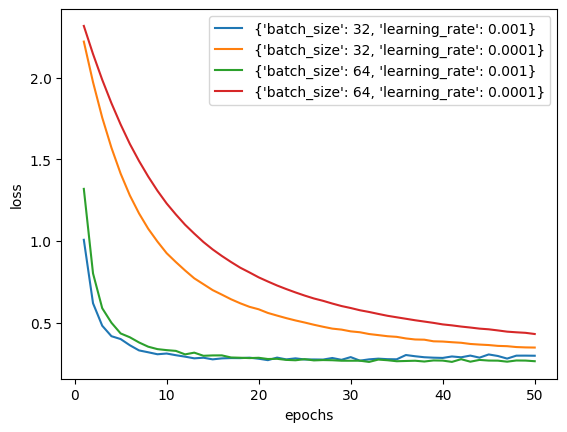

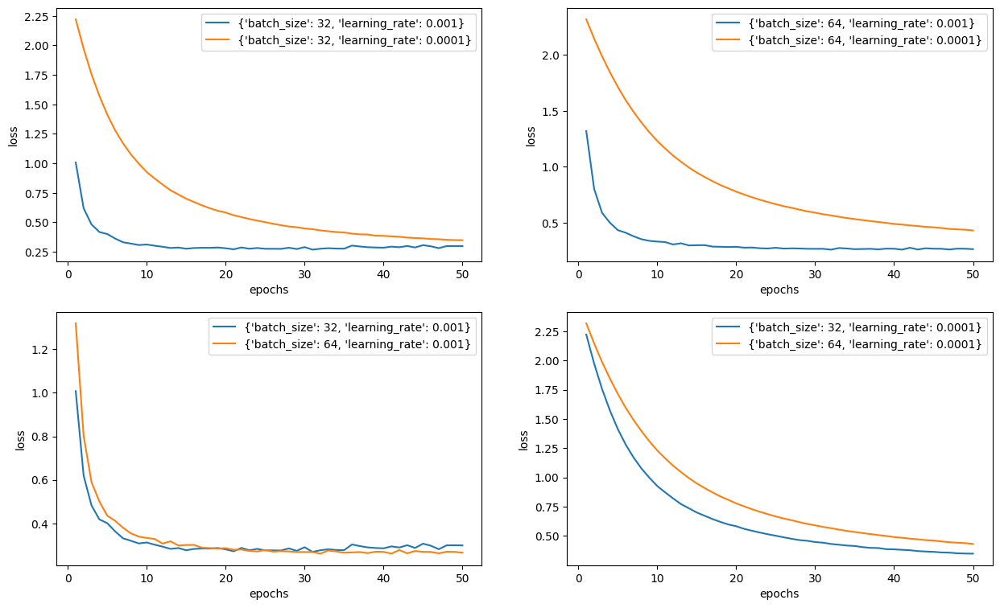


------------ Validation accuracy per epoch at ------------


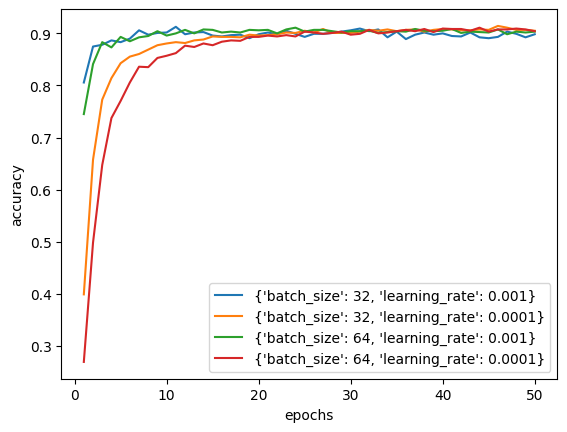

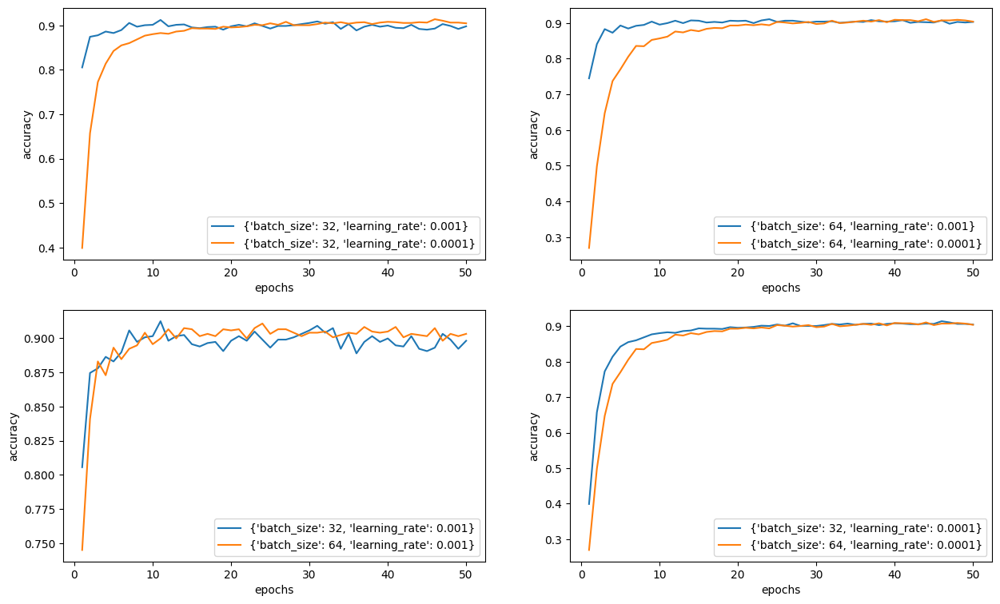

In [69]:
# get the best cross validation result
best_cv_result = get_best_cv_result(cv_history)

print('\n------------ Best cross validation result ------------')
print(best_cv_result)

plot_cv_result(cv_history)

### Training on full training data

The final model is retrained on full training data using the best parameters.

In [70]:
resnet50, train_history = train(resnet50, best_cv_result['epoch'],
                             best_cv_result['params']['batch_size'],
                             best_cv_result['params']['learning_rate'],
                             init_state,
                             transforms=augmented_image_transforms)

Training > training data size: 1188

Epoch 1/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 1/32 > loss: 1.8712 - acc: 46.2121% - Time: 7.2970s

Epoch 2/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 2/32 > loss: 0.8983 - acc: 84.5960% - Time: 7.2031s

Epoch 3/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 3/32 > loss: 0.5806 - acc: 89.7306% - Time: 7.3681s

Epoch 4/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 4/32 > loss: 0.4431 - acc: 91.0774% - Time: 7.2248s

Epoch 5/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 5/32 > loss: 0.3770 - acc: 91.0774% - Time: 7.6230s

Epoch 6/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 6/32 > loss: 0.3438 - acc: 90.9091% - Time: 7.5528s

Epoch 7/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 7/32 > loss: 0.2890 - acc: 93.6869% - Time: 7.5685s

Epoch 8/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 8/32 > loss: 0.2569 - acc: 95.0337% - Time: 7.4482s

Epoch 9/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 9/32 > loss: 0.2411 - acc: 94.6970% - Time: 7.3543s

Epoch 10/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 10/32 > loss: 0.2239 - acc: 94.9495% - Time: 7.2191s

Epoch 11/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 11/32 > loss: 0.2123 - acc: 95.1178% - Time: 7.3445s

Epoch 12/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 12/32 > loss: 0.2046 - acc: 94.8653% - Time: 7.2670s

Epoch 13/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 13/32 > loss: 0.1965 - acc: 95.2020% - Time: 7.2497s

Epoch 14/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 14/32 > loss: 0.1670 - acc: 96.6330% - Time: 7.4242s

Epoch 15/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 15/32 > loss: 0.1562 - acc: 96.8855% - Time: 7.7123s

Epoch 16/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 16/32 > loss: 0.1489 - acc: 96.8013% - Time: 7.9614s

Epoch 17/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 17/32 > loss: 0.1406 - acc: 97.1380% - Time: 7.7709s

Epoch 18/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 18/32 > loss: 0.1420 - acc: 96.9697% - Time: 7.8396s

Epoch 19/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 19/32 > loss: 0.1417 - acc: 96.6330% - Time: 7.6633s

Epoch 20/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 20/32 > loss: 0.1350 - acc: 97.1380% - Time: 8.0817s

Epoch 21/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 21/32 > loss: 0.1200 - acc: 98.0640% - Time: 7.3697s

Epoch 22/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 22/32 > loss: 0.1230 - acc: 97.4747% - Time: 7.4005s

Epoch 23/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 23/32 > loss: 0.1090 - acc: 98.4007% - Time: 7.3563s

Epoch 24/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 24/32 > loss: 0.1076 - acc: 98.1481% - Time: 7.5245s

Epoch 25/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 25/32 > loss: 0.1110 - acc: 98.2323% - Time: 7.4329s

Epoch 26/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 26/32 > loss: 0.1109 - acc: 97.7273% - Time: 7.5213s

Epoch 27/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 27/32 > loss: 0.1020 - acc: 98.4848% - Time: 7.4534s

Epoch 28/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 28/32 > loss: 0.1062 - acc: 97.8956% - Time: 7.4045s

Epoch 29/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 29/32 > loss: 0.1001 - acc: 97.9798% - Time: 7.5808s

Epoch 30/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 30/32 > loss: 0.0904 - acc: 98.3165% - Time: 7.7528s

Epoch 31/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 31/32 > loss: 0.0938 - acc: 98.3165% - Time: 8.0387s

Epoch 32/32


Training:   0%|          | 0/19 [00:00<?, ?it/s]

End Epoch 32/32 > loss: 0.0771 - acc: 98.5690% - Time: 7.8671s
End Train > time: 240.8770s



### Result of training

loss : 0.07705542806423071
acc : 98.56902348874796


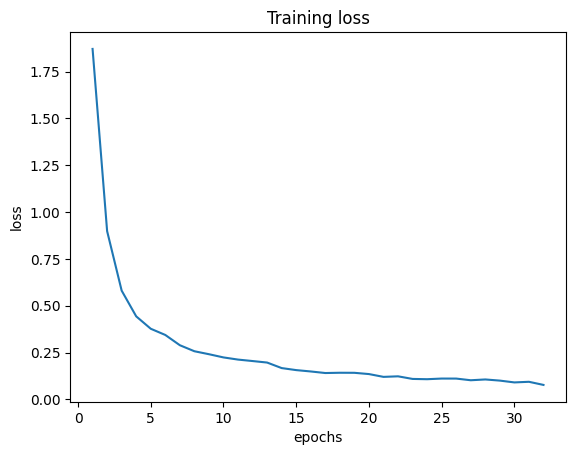

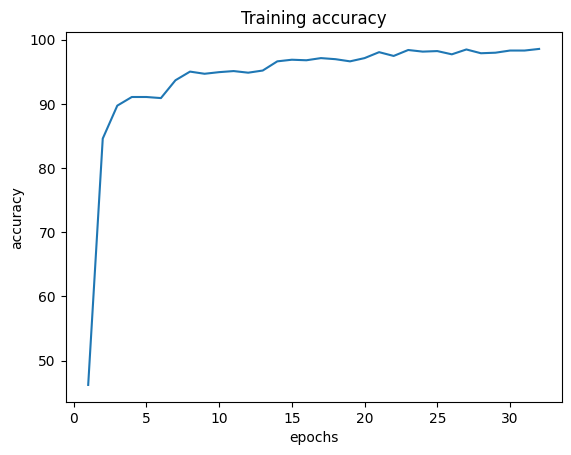

In [71]:
print('loss :',train_history[-1]['avg_train_loss'])
print('acc :',train_history[-1]['avg_train_acc']*100)

plot_train_result(train_history)

### Testing

In [72]:
results = test(resnet50, calc_top3_acc=True)
loss = results[0]
acc = results[1]
cm = results[2]
top3_acc = results[3]

Test data size : 1183 



Testing:   0%|          | 0/37 [00:00<?, ?it/s]


Result > loss: 0.4011 - acc: 88.4193% - time: 6.3770s


Result > top3_acc: 97.4641% 



### Result of testing

loss : 0.401140905948181
acc : 88.41927296915803
average fscore: 88.39983622066082
top3 acc : 97.46407438715131

------------ Confusion Matrix ------------


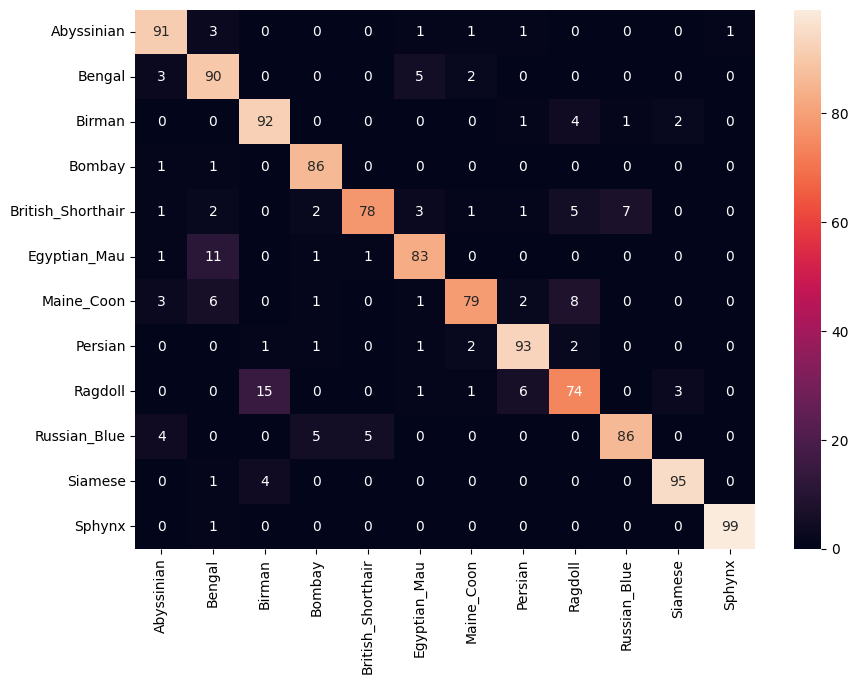


------------ FScore per class ------------


,fscore
Abyssinian,0.900990
Bengal,0.837209
Birman,0.867925
Bombay,0.934783
British_Shorthair,0.847826
Egyptian_Mau,0.864583
Maine_Coon,0.849462
Persian,0.911765
Ragdoll,0.766839
Russian_Blue,0.886598


In [73]:
recall = cm.diagonal()/cm.sum(axis=1)
precision = cm.diagonal()/cm.sum(axis=0)
fscore = 2*precision*recall/(precision+recall)

print('loss :', loss)
print('acc :',acc*100)
print('average fscore:',np.average(fscore)*100)
print('top3 acc :',top3_acc)

print('\n------------ Confusion Matrix ------------')

df_cm = pd.DataFrame(cm, index = data['test'].class_to_idx.keys(),
                  columns = data['test'].class_to_idx.keys())
plt.figure(figsize = (10,7))
sn.heatmap(df_cm, annot=True)
plt.show()

print('\n------------ FScore per class ------------')

pd.DataFrame(fscore,index = data['test'].class_to_idx.keys(),columns=['fscore'])

### Save the model

In [74]:
#!mkdir model
save_model_state(resnet50, '../model/resnet50-model-augmentation.pth')

## Visualize some predictions

### Load the saved model for inference

Here, the resnet50 with augmentation data will be used for the inference.

In [7]:
# get the pretrained resnet50
resnet50 = torchvision.models.resnet50(pretrained=True)

# freeze model parameters
for param in resnet50.parameters():
    param.requires_grad = False
    
# change the final layer of ResNet50 model for transfer learning
fc_inputs = resnet50.fc.in_features
resnet50.fc = nn.Sequential(
    nn.Linear(fc_inputs, 12),
    nn.LogSoftmax(dim=1) # For using NLLLoss()
)

# load the model state
resnet50 = load_model_state(resnet50, '../model/resnet50-model-augmentation.pth')

### Prediction function

In [8]:
def predict(model, img, k, actual_label):
    ''' display an image along with the top k predictions'''
    predict_image = None
    try:
        img.verify() # verify img is an image (not string of path)
        predict_image = img
    except Exception:
        predict_image = Image.open(img)
    
    # open and transform the image
    transform = augmented_image_transforms['test']
    
    predict_image_tensor = transform(predict_image)
    predict_image_tensor = predict_image_tensor.view(1, 3, 224, 224)
    predict_image_tensor = predict_image_tensor.to(device)

    with torch.no_grad():

        model.eval()       
        out = model(predict_image_tensor)
        ps = torch.exp(out)
        
        # get the topk result
        topprob, topclass = ps.topk(k, dim=1)
        topprob_np = topprob.cpu().numpy()[0]
        topclass_np = topclass.cpu().numpy()[0]
        
        # print the prediction result
        print('Actual :')
        print('-',actual_label,'\n')
        print('Top',k,'prediction :')
        for idx,prob in enumerate(topprob_np):
            print('-',idx_to_class[topclass_np[idx]],':', f"{prob*100:.2f}%")
        
        # display the image
        plt.figure()
        plt.imshow(predict_image)
        plt.show()
        print('------------------------------------------------------')

### Visualize a correct prediction for each breed

Actual :
- Abyssinian 

Top 3 prediction :
- Abyssinian : 99.97%
- Russian_Blue : 0.01%
- Siamese : 0.01%


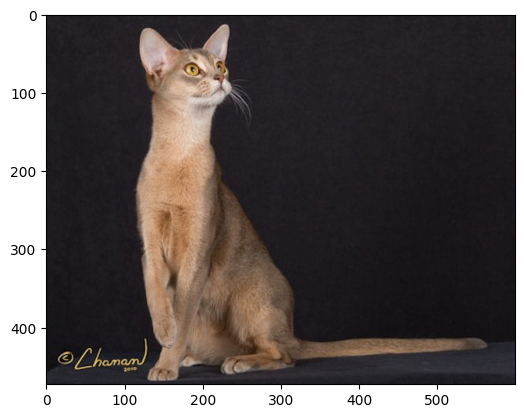

------------------------------------------------------
Actual :
- Bengal 

Top 3 prediction :
- Bengal : 90.60%
- Egyptian_Mau : 6.62%
- Abyssinian : 1.23%


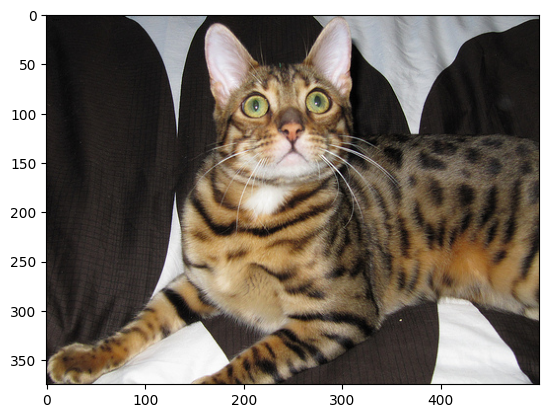

------------------------------------------------------
Actual :
- Birman 

Top 3 prediction :
- Birman : 99.27%
- Ragdoll : 0.69%
- Siamese : 0.02%


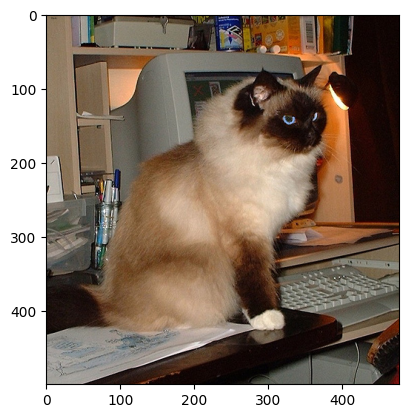

------------------------------------------------------
Actual :
- Bombay 

Top 3 prediction :
- Bombay : 94.68%
- Russian_Blue : 2.87%
- British_Shorthair : 1.39%


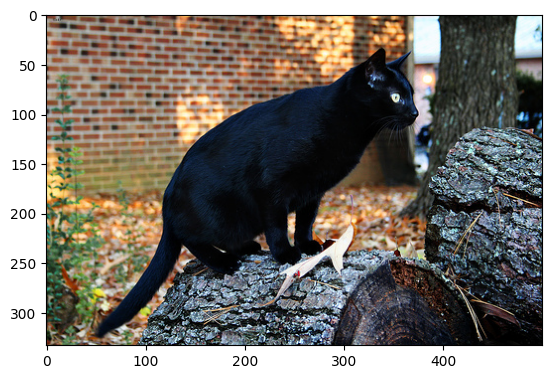

------------------------------------------------------
Actual :
- British_Shorthair 

Top 3 prediction :
- British_Shorthair : 88.62%
- Russian_Blue : 11.18%
- Egyptian_Mau : 0.07%


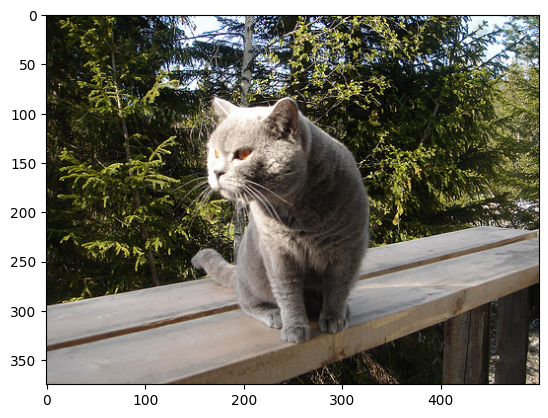

------------------------------------------------------
Actual :
- Egyptian_Mau 

Top 3 prediction :
- Egyptian_Mau : 99.98%
- British_Shorthair : 0.01%
- Bengal : 0.01%


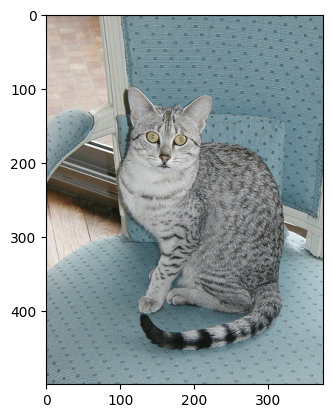

------------------------------------------------------
Actual :
- Maine_Coon 

Top 3 prediction :
- Maine_Coon : 98.63%
- Persian : 1.21%
- Birman : 0.06%


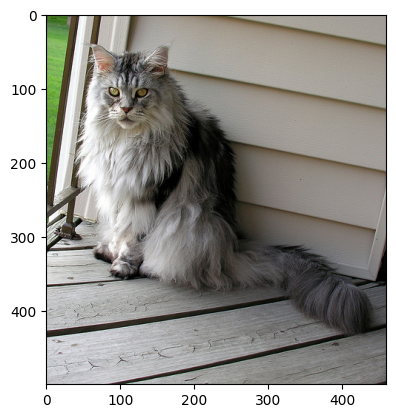

------------------------------------------------------
Actual :
- Persian 

Top 3 prediction :
- Persian : 99.87%
- Maine_Coon : 0.07%
- Birman : 0.02%


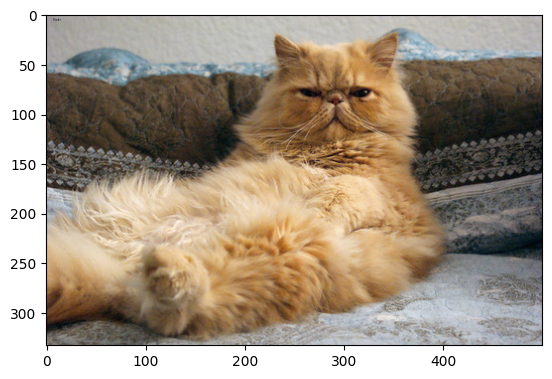

------------------------------------------------------
Actual :
- Ragdoll 

Top 3 prediction :
- Ragdoll : 97.20%
- Birman : 2.56%
- Maine_Coon : 0.19%


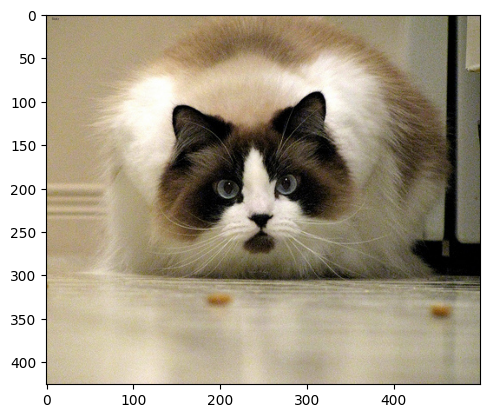

------------------------------------------------------
Actual :
- Russian_Blue 

Top 3 prediction :
- Russian_Blue : 93.53%
- British_Shorthair : 3.71%
- Egyptian_Mau : 1.37%


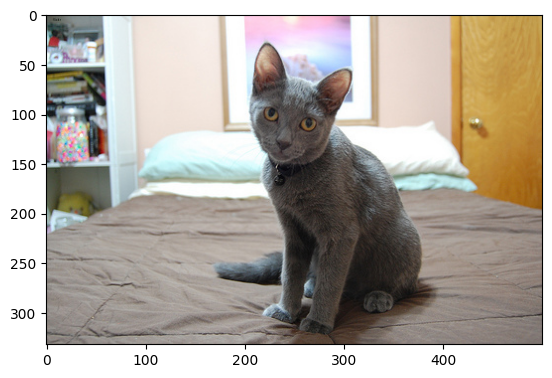

------------------------------------------------------
Actual :
- Siamese 

Top 3 prediction :
- Siamese : 93.27%
- Birman : 6.65%
- Ragdoll : 0.06%


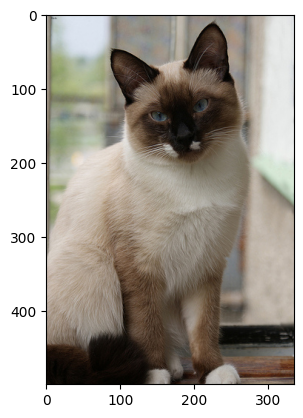

------------------------------------------------------
Actual :
- Sphynx 

Top 3 prediction :
- Sphynx : 99.99%
- Egyptian_Mau : 0.00%
- Persian : 0.00%


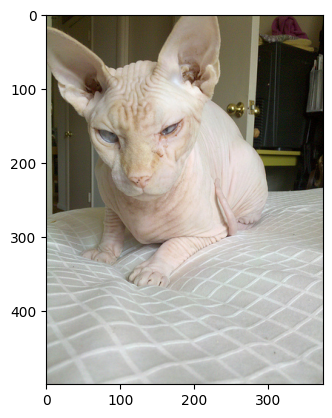

------------------------------------------------------


In [10]:
predict(resnet50, '../data/test/Abyssinian/Abyssinian_2.jpg', k=3, actual_label='Abyssinian')
predict(resnet50, '../data/test/Bengal/Bengal_46.jpg', k=3, actual_label='Bengal')
predict(resnet50, '../data/test/Birman/Birman_29.jpg', k=3, actual_label='Birman')
predict(resnet50, '../data/test/Bombay/Bombay_47.jpg', k=3, actual_label='Bombay')
predict(resnet50, '../data/test/British_Shorthair/British_Shorthair_37.jpg', k=3, actual_label='British_Shorthair')
predict(resnet50, '../data/test/Egyptian_Mau/Egyptian_Mau_62.jpg', k=3, actual_label='Egyptian_Mau')
predict(resnet50, '../data/test/Maine_Coon/Maine_Coon_52.jpg', k=3, actual_label='Maine_Coon')
predict(resnet50, '../data/test/Persian/Persian_63.jpg', k=3, actual_label='Persian')
predict(resnet50, '../data/test/Ragdoll/Ragdoll_205.jpg', k=3, actual_label='Ragdoll')
predict(resnet50, '../data/test/Russian_Blue/Russian_Blue_57.jpg', k=3, actual_label='Russian_Blue')
predict(resnet50, '../data/test/Siamese/Siamese_78.jpg', k=3, actual_label='Siamese')
predict(resnet50, '../data/test/Sphynx/Sphynx_95.jpg', k=3, actual_label='Sphynx')

### Visualize the misclassified predictions

#### Top 3 misclassified predictions


In [ ]:
idx_to_class = {val: key for key, val in data['test'].class_to_idx.items()}

misclass = []
for i in range(len(cm)):
    for j in range(len(cm[i])):
        if i!=j:
            misclass.append([idx_to_class[i],idx_to_class[j], cm[i][j]])

df_misclass = pd.DataFrame(misclass,columns=['actual','prediction','count'])
df_misclass = df_misclass.sort_values(by=['count'], ascending=False)
df_misclass.head(3)

#### Visualize the top 3 misclassified predictions

Here, we want to see the top misclassied images, such as Ragdoll predicted as Birman, British Shorthair predicted as Russian Blue, Egyptian Mau predicted as Bengal, and vice versa.

Actual :
- Birman 

Top 3 prediction :
- Ragdoll : 58.53133201599121
- Birman : 31.097140908241272
- Persian : 9.171959012746811


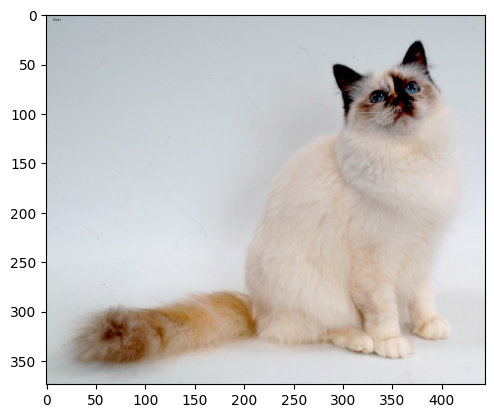

------------------------------------------------------
Actual :
- Ragdoll 

Top 3 prediction :
- Birman : 96.27399444580078
- Siamese : 2.8580814599990845
- Ragdoll : 0.6394441239535809


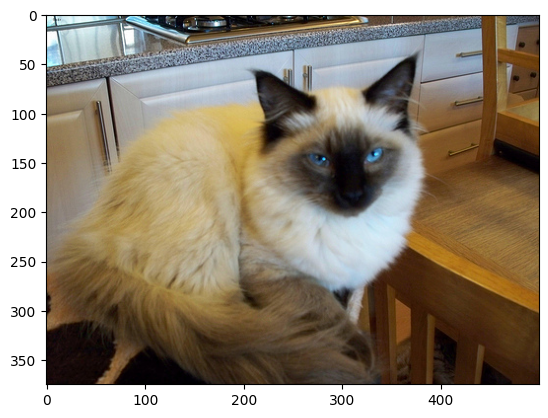

------------------------------------------------------
Actual :
- British_Shorthair 

Top 3 prediction :
- British_Shorthair : 59.84894037246704
- Russian_Blue : 37.40116357803345
- Persian : 1.9242942333221436


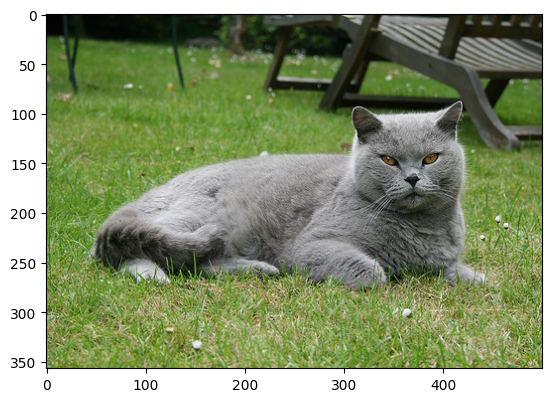

------------------------------------------------------
Actual :
- Russian_Blue 

Top 3 prediction :
- British_Shorthair : 66.44958257675171
- Russian_Blue : 21.924446523189545
- Siamese : 6.816593557596207


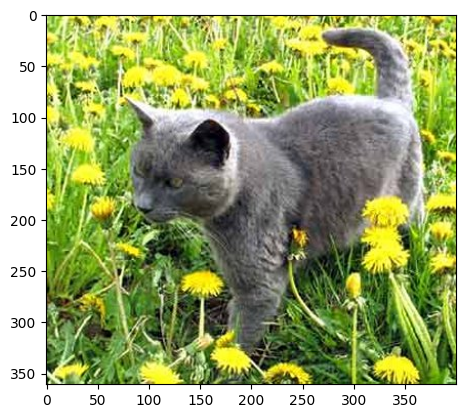

------------------------------------------------------
Actual :
- Egyptian_Mau 

Top 3 prediction :
- Bengal : 70.36694884300232
- Egyptian_Mau : 28.20514440536499
- Abyssinian : 0.98261758685112


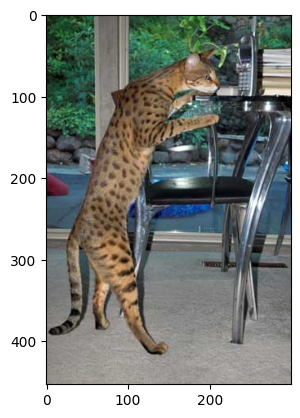

------------------------------------------------------
Actual :
- Bengal 

Top 3 prediction :
- Egyptian_Mau : 94.96052861213684
- Bengal : 5.006872117519379
- Maine_Coon : 0.015228732081595808


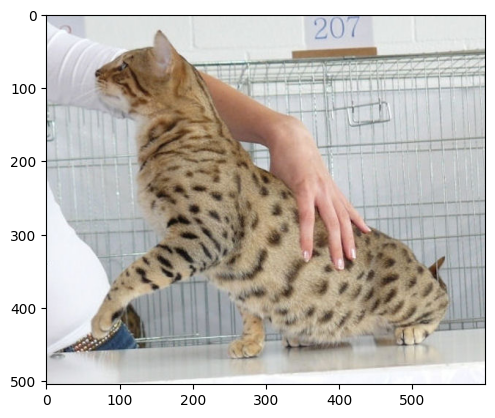

------------------------------------------------------


In [14]:
predict(resnet50, '../data/test/Birman/Birman_99.jpg', k=3, actual_label='Birman')
predict(resnet50, '../data/test/Ragdoll/Ragdoll_35.jpg', k=3, actual_label='Ragdoll')
predict(resnet50, '../data/test/British_Shorthair/British_Shorthair_28.jpg', k=3, actual_label='British_Shorthair')
predict(resnet50, '../data/test/Russian_Blue/Russian_Blue_264.jpg', k=3, actual_label='Russian_Blue')
predict(resnet50, '../data/test/Egyptian_Mau/Egyptian_Mau_85.jpg', k=3, actual_label='Egyptian_Mau')
predict(resnet50, '../data/test/Bengal/Bengal_2.jpg', k=3, actual_label='Bengal')